Generate a gene level transcriptome.

# 1. Install and import packages

In [14]:
#!pip install setuptools

In [7]:
# in terminal cd to the path of MERFISH_probe_design
# then:
# pip install the setup.py

ERROR: Could not find a version that satisfies the requirement MERFISH_probe_design (from versions: none)
ERROR: No matching distribution found for MERFISH_probe_design


In [17]:
import setuptools

In [8]:

import gzip
import shutil
import os
import sys
import setuptools


In [9]:
import numpy as np
import pandas as pd
from Bio import SeqIO

import MERFISH_probe_design.IO.file_io as fio
import MERFISH_probe_design.probe_design.probe_dict as p_d
import MERFISH_probe_design.probe_design.OTTable_dict as ot
from MERFISH_probe_design.probe_design import filters
from MERFISH_probe_design.probe_design import plot

# 2. Define input files

In [12]:
# Unzip gz file for fasta


gz_folder = r'\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\Genomes\human\hg38\Transcriptome\Ensembl_release-106'


cdna_gz = os.path.join(gz_folder,r'Homo_sapiens.GRCh38.cdna.all.fa.gz')
cdna_fasta_file =cdna_gz [:-3]
print(cdna_fasta_file)

ncrna_gz = os.path.join(gz_folder,r'Homo_sapiens.GRCh38.ncrna.fa.gz')
ncrna_fasta_file =ncrna_gz [:-3]
print(ncrna_fasta_file)

\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\Genomes\human\hg38\Transcriptome\Ensembl_release-106\Homo_sapiens.GRCh38.cdna.all.fa
\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\Genomes\human\hg38\Transcriptome\Ensembl_release-106\Homo_sapiens.GRCh38.ncrna.fa


In [13]:
# Other input files
# APPRIS for major transcript annotation
APPRIS_file = os.path.join(gz_folder, r'human_appris_data.principal.txt')


# Output file
gene_level_transcriptome_file = os.path.join(gz_folder,'gene_level_transcriptome.csv')

# 3. Define function(s)

In [10]:
def load_transcriptome_fasta_into_dataframe(fasta_file):
    d = {'transcript_id':[], 'seq_type':[], 'location':[], 'gene_id':[],
        'gene_biotype':[], 'transcript_biotype':[], 'gene_symbol':[],
        'description':[], 'seq_length':[], 'sequence':[]}
    
    try:
        for record in SeqIO.parse(fasta_file, 'fasta'):
            split_rd = record.description.split()            
            d['transcript_id'].append(split_rd[0].split('.')[0])
            d['seq_type'].append(split_rd[1])
            d['location'].append(split_rd[2])
            d['gene_id'].append(split_rd[3][5:].split('.')[0])
            d['gene_biotype'].append(split_rd[4][13:])
            d['transcript_biotype'].append(split_rd[5][19:])
            if len(split_rd) > 6:
                d['gene_symbol'].append(split_rd[6][12:])
            else:
                d['gene_symbol'].append(pd.NA)
            if len(split_rd) > 7:
                d['description'].append(' '.join(split_rd[7:])[12:])
            else:
                d['description'].append(pd.NA)
            
            d['seq_length'].append(len(str(record.seq)))
            d['sequence'].append(str(record.seq))
    
    except:
        print(split_rd)
        raise
    
    df = pd.DataFrame.from_dict(d)
    df = df.set_index('transcript_id')
    return df

# 4. Find the unique transcripts for individual genes

In [14]:
# Load the transcriptome fasta
transcriptome_cdna = load_transcriptome_fasta_into_dataframe(cdna_fasta_file)
transcriptome_ncrna = load_transcriptome_fasta_into_dataframe(ncrna_fasta_file)
transcriptome = pd.concat((transcriptome_cdna, transcriptome_ncrna), axis=0) 

In [15]:
# Load the annotating principal splice isoforms (APPRIS) data
APPRIS = pd.read_csv(APPRIS_file, sep='\t', header=None)
# Find the main isoforms of protein coding each gene
transcriptome = transcriptome.merge(APPRIS.set_index(2).rename(
                   columns={4:'APPRIS'})['APPRIS'],
                   how='left', left_index=True, right_index=True)

# Find a unique transcript for each gene
transcriptome_grouped = transcriptome.groupby(transcriptome['gene_id'])
unique_transcripts = []
for i in np.unique(transcriptome['gene_id']):
    df = transcriptome_grouped.get_group(i)
    # Only consider the main isoforms if the annotation exists
    df_main_isoforms = df.loc[df['APPRIS'].notnull()]
    if df_main_isoforms.shape[0] == 0:
        df_main_isoforms = df
    # Find the shortest isoforms    
    unique_transcripts.append(df_main_isoforms[['seq_length']].idxmin()[0])

transcriptome_unique = transcriptome.loc[unique_transcripts]

In [16]:
transcriptome_unique

,seq_type,location,gene_id,gene_biotype,transcript_biotype,gene_symbol,description,seq_length,sequence,APPRIS
transcript_id,,,,,,,,,,
ENST00000373020,cdna,chromosome:GRCh38:X:100627108:100636806:-1,ENSG00000000003,protein_coding,protein_coding,TSPAN6,tetraspanin 6 [Source:HGNC Symbol;Acc:HGNC:11858],3768,AGTTGTGGACGCTCGTAAGTTTTCGGCAGTTTCCGGGGAGACTCGG...,PRINCIPAL:1
ENST00000373031,cdna,chromosome:GRCh38:X:100584936:100599885:1,ENSG00000000005,protein_coding,protein_coding,TNMD,tenomodulin [Source:HGNC Symbol;Acc:HGNC:17757],1205,AGCCGACTCACTTGCAACTCCACCTCAGCAGTGGTCTCTCAGTCCT...,PRINCIPAL:1
ENST00000371588,cdna,chromosome:GRCh38:20:50934870:50958532:-1,ENSG00000000419,protein_coding,protein_coding,DPM1,dolichyl-phosphate mannosyltransferase subunit...,1054,AGTTCCGCCATGGCCTCCTTGGAAGTCAGTCGTAGTCCTCGCAGGT...,PRINCIPAL:1
ENST00000367770,cdna,chromosome:GRCh38:1:169853074:169888888:-1,ENSG00000000457,protein_coding,protein_coding,SCYL3,SCY1 like pseudokinase 3 [Source:HGNC Symbol;A...,2916,CTGCTTGGCTTTGAGGAAGAGTGGCAGTACTGCCTCACTGCATAAG...,ALTERNATIVE:1
ENST00000359326,cdna,chromosome:GRCh38:1:169795040:169854080:1,ENSG00000000460,protein_coding,protein_coding,C1orf112,chromosome 1 open reading frame 112 [Source:HG...,4011,ACTGCGAGTTTCCGGTCTGGGCTTTGGCGGGTCTGGTTTGAAGCTC...,PRINCIPAL:1
...,...,...,...,...,...,...,...,...,...,...
ENST00000696746,cdna,chromosome:GRCh38:11:7950420:7950672:-1,ENSG00000289714,unprocessed_pseudogene,unprocessed_pseudogene,novel,eudogene,253,TTTTGCTATTGTGGCTGTAATGAAATTAATGGTCCCTATTGTGAAA...,NaN
ENST00000696766,cdna,chromosome:GRCh38:1:21547404:21554002:1,ENSG00000289715,protein_coding,protein_coding,novel,,144,ATGGCCCTCCTGTCCCCCATCCTGGATGTGGTCCTCACGGTGGCCC...,PRINCIPAL:1
ENST00000696864,cdna,chromosome:GRCh38:11:71806230:71928455:-1,ENSG00000289716,protein_coding,nonsense_mediated_decay,XNDC1N-ZNF705EP-ALG1L9P,XNDC1N-ZNF705EP-ALG1L9P readthrough [Source:HG...,2551,GGCGAAGGTCAGAAGGCCGAATTGGCGGGAGAATAGGTTTGGTGGT...,ALTERNATIVE:2


# 5. Screen the targetable regions for each gene

## This step 5 can also be skipped since the probe design will be done later only for genes of interest

In [17]:
# Initialize the probe dictionary for all genes
transcriptome_test = transcriptome_unique.reset_index()
gene_ids = np.unique(transcriptome_test['gene_id'])
probe_dict = p_d.init_probe_dict(gene_ids, transcriptome_test, 'gene_id', K=30)

Found 66902 transcripts for 66902 target genes.


In [18]:
# Initialize the off-target counting tables
# OTTable for rRNA/tRNAs
ncRNAs =  fio.load_fasta_into_df(ncrna_fasta_file)
ottable_rtRNAs = ot.get_OTTable_for_rtRNAs(ncRNAs, 15)

Found 95 rRNAs/tRNAs from 62602 non-coding RNAs.


In [19]:
p_d.print_probe_dict(probe_dict)

Gene	Transcript	N_probes
ENSG00000000003
	ENST00000373020	3739
ENSG00000000005
	ENST00000373031	1176
ENSG00000000419
	ENST00000371588	1025
ENSG00000000457
	ENST00000367770	2887
ENSG00000000460
	ENST00000359326	3982
ENSG00000000938
	ENST00000374003	1992
ENSG00000000971
	ENST00000367429	3933
ENSG00000001036
	ENST00000002165	2356
ENSG00000001084
	ENST00000650454	3756
ENSG00000001167
	ENST00000353205	1631
ENSG00000001460
	ENST00000337248	2697
ENSG00000001461
	ENST00000374399	5343
ENSG00000001497
	ENST00000677969	1928
ENSG00000001561
	ENST00000321037	4615
ENSG00000001617
	ENST00000434342	3512
ENSG00000001626
	ENST00000003084	6041
ENSG00000001629
	ENST00000265742	6311
ENSG00000001630
	ENST00000003100	3126
ENSG00000001631
	ENST00000412043	3349
ENSG00000002016
	ENST00000536177	1110
ENSG00000002079
	ENST00000429079	387
ENSG00000002330
	ENST00000309032	900
ENSG00000002549
	ENST00000618908	2071
ENSG00000002586
	ENST00000482405	813
ENSG00000002587
	ENST00000002596	7131
ENSG00000002726
	ENST0000041

	ENST00000360961	875
ENSG00000060971
	ENST00000333167	1670
ENSG00000060982
	ENST00000538118	4665
ENSG00000061273
	ENST00000427332	2987
ENSG00000061337
	ENST00000265801	5430
ENSG00000061455
	ENST00000407847	9118
ENSG00000061492
	ENST00000398754	1469
ENSG00000061656
	ENST00000679710	1513
ENSG00000061676
	ENST00000360982	4960
ENSG00000061794
	ENST00000081029	1800
ENSG00000061918
	ENST00000264424	3353
ENSG00000061936
	ENST00000541286	3190
ENSG00000061938
	ENST00000672887	4041
ENSG00000061987
	ENST00000393629	5583
ENSG00000062038
	ENST00000264012	4423
ENSG00000062096
	ENST00000359361	1962
ENSG00000062194
	ENST00000264779	1757
ENSG00000062282
	ENST00000228027	2378
ENSG00000062370
	ENST00000337401	3292
ENSG00000062485
	ENST00000351328	2886
ENSG00000062524
	ENST00000561619	1792
ENSG00000062582
	ENST00000317534	638
ENSG00000062598
	ENST00000352077	2128
ENSG00000062650
	ENST00000298767	6281
ENSG00000062716
	ENST00000262291	3657
ENSG00000062725
	ENST00000083182	6463
ENSG00000062822
	ENST000004402

ENSG00000087589
	ENST00000679529	2493
ENSG00000087842
	ENST00000380420	1245
ENSG00000087884
	ENST00000393427	493
ENSG00000087903
	ENST00000592546	2549
ENSG00000087995
	ENST00000311506	5770
ENSG00000088002
	ENST00000201586	1167
ENSG00000088035
	ENST00000263440	3296
ENSG00000088038
	ENST00000221232	2789
ENSG00000088053
	ENST00000417454	2235
ENSG00000088179
	ENST00000263708	11061
ENSG00000088205
	ENST00000263239	3724
ENSG00000088247
	ENST00000398148	2964
ENSG00000088256
	ENST00000078429	4161
ENSG00000088280
	ENST00000336689	4022
ENSG00000088298
	ENST00000374492	1855
ENSG00000088305
	ENST00000353855	4208
ENSG00000088320
	ENST00000201979	1631
ENSG00000088325
	ENST00000300403	3444
ENSG00000088340
	ENST00000452272	231
ENSG00000088356
	ENST00000202017	1928
ENSG00000088367
	ENST00000373941	2623
ENSG00000088386
	ENST00000376503	3095
ENSG00000088387
	ENST00000682017	7602
ENSG00000088448
	ENST00000267339	2466
ENSG00000088451
	ENST00000261296	1768
ENSG00000088538
	ENST00000266037	9040
ENSG000000885

ENSG00000102362
	ENST00000263033	2306
ENSG00000102383
	ENST00000373367	5549
ENSG00000102384
	ENST00000372926	2346
ENSG00000102385
	ENST00000538510	6823
ENSG00000102387
	ENST00000324762	2078
ENSG00000102390
	ENST00000373358	1156
ENSG00000102393
	ENST00000218516	1289
ENSG00000102401
	ENST00000537169	3289
ENSG00000102409
	ENST00000372691	1037
ENSG00000102445
	ENST00000631139	1919
ENSG00000102452
	ENST00000251127	6942
ENSG00000102466
	ENST00000376131	12853
ENSG00000102468
	ENST00000542664	5386
ENSG00000102471
	ENST00000218652	4595
ENSG00000102524
	ENST00000375887	2547
ENSG00000102531
	ENST00000398316	5685
ENSG00000102539
	ENST00000218721	1210
ENSG00000102543
	ENST00000251108	3357
ENSG00000102547
	ENST00000410043	1598
ENSG00000102554
	ENST00000539231	2922
ENSG00000102572
	ENST00000539966	9576
ENSG00000102575
	ENST00000648477	1352
ENSG00000102580
	ENST00000602402	5561
ENSG00000102595
	ENST00000376747	4821
ENSG00000102606
	ENST00000646102	5396
ENSG00000102678
	ENST00000382353	4501
ENSG0000010

ENSG00000108861
	ENST00000226004	4066
ENSG00000108878
	ENST00000226021	1273
ENSG00000108883
	ENST00000591382	3646
ENSG00000108924
	ENST00000226067	5692
ENSG00000108932
	ENST00000580666	3662
ENSG00000108946
	ENST00000586397	1911
ENSG00000108947
	ENST00000226091	3187
ENSG00000108950
	ENST00000592554	4659
ENSG00000108953
	ENST00000264335	2023
ENSG00000108958
	ENST00000451056	379
ENSG00000108960
	ENST00000262065	2540
ENSG00000108961
	ENST00000226105	802
ENSG00000108963
	ENST00000263083	2617
ENSG00000108984
	ENST00000590474	13376
ENSG00000109016
	ENST00000395511	1224
ENSG00000109046
	ENST00000262394	5076
ENSG00000109047
	ENST00000226193	2440
ENSG00000109061
	ENST00000226207	5994
ENSG00000109062
	ENST00000262613	1964
ENSG00000109063
	ENST00000583535	6003
ENSG00000109065
	ENST00000580301	1831
ENSG00000109066
	ENST00000582330	4647
ENSG00000109072
	ENST00000226218	1597
ENSG00000109079
	ENST00000226225	3541
ENSG00000109083
	ENST00000585313	823
ENSG00000109084
	ENST00000226230	2434
ENSG0000010908

ENSG00000115998
	ENST00000420306	2164
ENSG00000116001
	ENST00000282574	3794
ENSG00000116005
	ENST00000433351	5310
ENSG00000116014
	ENST00000234371	1595
ENSG00000116016
	ENST00000263734	5126
ENSG00000116017
	ENST00000263620	5919
ENSG00000116030
	ENST00000392245	1042
ENSG00000116031
	ENST00000410009	1837
ENSG00000116032
	ENST00000234389	3252
ENSG00000116035
	ENST00000234392	1132
ENSG00000116039
	ENST00000234396	1878
ENSG00000116044
	ENST00000397062	2417
ENSG00000116062
	ENST00000234420	4236
ENSG00000116095
	ENST00000234453	13863
ENSG00000116096
	ENST00000234454	1403
ENSG00000116106
	ENST00000409938	3334
ENSG00000116117
	ENST00000406610	8463
ENSG00000116120
	ENST00000281828	6732
ENSG00000116127
	ENST00000484298	12566
ENSG00000116128
	ENST00000684121	5610
ENSG00000116132
	ENST00000239461	4032
ENSG00000116133
	ENST00000436604	1998
ENSG00000116138
	ENST00000375847	6005
ENSG00000116141
	ENST00000402574	5244
ENSG00000116147
	ENST00000263525	5161
ENSG00000116151
	ENST00000378529	1471
ENSG000001

ENSG00000124098
	ENST00000371384	2958
ENSG00000124102
	ENST00000243924	522
ENSG00000124103
	ENST00000371328	634
ENSG00000124104
	ENST00000372542	1795
ENSG00000124107
	ENST00000338380	567
ENSG00000124116
	ENST00000243938	941
ENSG00000124120
	ENST00000262605	6195
ENSG00000124126
	ENST00000371941	6723
ENSG00000124134
	ENST00000306117	4509
ENSG00000124140
	ENST00000454036	3564
ENSG00000124143
	ENST00000373345	2938
ENSG00000124145
	ENST00000372733	2584
ENSG00000124151
	ENST00000371997	6721
ENSG00000124155
	ENST00000279036	2139
ENSG00000124157
	ENST00000372769	1949
ENSG00000124159
	ENST00000372754	2171
ENSG00000124160
	ENST00000290231	3195
ENSG00000124164
	ENST00000475243	7800
ENSG00000124171
	ENST00000371610	4550
ENSG00000124172
	ENST00000395663	668
ENSG00000124177
	ENST00000373233	10690
ENSG00000124181
	ENST00000244007	5256
ENSG00000124191
	ENST00000423191	1680
ENSG00000124193
	ENST00000662078	978
ENSG00000124194
	ENST00000342560	2749
ENSG00000124196
	ENST00000373005	430
ENSG00000124198
	E

ENSG00000130988
	ENST00000336169	1327
ENSG00000130997
	ENST00000382865	2870
ENSG00000131002
	ENST00000587095	307
ENSG00000131007
	ENST00000545582	1472
ENSG00000131013
	ENST00000253329	2446
ENSG00000131015
	ENST00000367351	1306
ENSG00000131016
	ENST00000359755	6161
ENSG00000131018
	ENST00000367255	27679
ENSG00000131019
	ENST00000438272	706
ENSG00000131023
	ENST00000253339	4227
ENSG00000131037
	ENST00000201647	2540
ENSG00000131042
	ENST00000391746	1911
ENSG00000131043
	ENST00000320849	2388
ENSG00000131044
	ENST00000375938	2594
ENSG00000131050
	ENST00000354932	1013
ENSG00000131051
	ENST00000361162	2802
ENSG00000131055
	ENST00000376075	640
ENSG00000131059
	ENST00000375454	1110
ENSG00000131061
	ENST00000375200	3314
ENSG00000131067
	ENST00000336431	2609
ENSG00000131068
	ENST00000253381	1146
ENSG00000131069
	ENST00000360596	2856
ENSG00000131080
	ENST00000374719	3426
ENSG00000131089
	ENST00000671741	4673
ENSG00000131094
	ENST00000253407	1498
ENSG00000131095
	ENST00000588735	5472
ENSG0000013109

ENSG00000136546
	ENST00000441411	5936
ENSG00000136560
	ENST00000392749	2069
ENSG00000136573
	ENST00000259089	2186
ENSG00000136574
	ENST00000335135	3385
ENSG00000136603
	ENST00000259119	7126
ENSG00000136628
	ENST00000366923	4833
ENSG00000136630
	ENST00000366903	2208
ENSG00000136631
	ENST00000644510	2299
ENSG00000136634
	ENST00000423557	1601
ENSG00000136636
	ENST00000259154	3990
ENSG00000136643
	ENST00000366960	5476
ENSG00000136682
	ENST00000259199	1798
ENSG00000136688
	ENST00000259205	1182
ENSG00000136689
	ENST00000409930	1675
ENSG00000136694
	ENST00000259211	861
ENSG00000136695
	ENST00000437409	491
ENSG00000136696
	ENST00000327407	1023
ENSG00000136697
	ENST00000341010	984
ENSG00000136698
	ENST00000259216	1643
ENSG00000136699
	ENST00000680298	3720
ENSG00000136709
	ENST00000322313	9461
ENSG00000136710
	ENST00000259229	1740
ENSG00000136715
	ENST00000643581	4055
ENSG00000136717
	ENST00000393040	2264
ENSG00000136718
	ENST00000259239	2382
ENSG00000136720
	ENST00000259241	4194
ENSG00000136731

ENSG00000142207
	ENST00000382751	10789
ENSG00000142208
	ENST00000554848	1566
ENSG00000142224
	ENST00000340758	902
ENSG00000142227
	ENST00000270221	620
ENSG00000142230
	ENST00000270225	2493
ENSG00000142233
	ENST00000270235	1817
ENSG00000142235
	ENST00000650440	4781
ENSG00000142252
	ENST00000591747	547
ENSG00000142273
	ENST00000647358	1547
ENSG00000142279
	ENST00000590071	13516
ENSG00000142303
	ENST00000270328	4165
ENSG00000142319
	ENST00000270349	3913
ENSG00000142327
	ENST00000270357	5732
ENSG00000142330
	ENST00000404753	2541
ENSG00000142347
	ENST00000644032	4151
ENSG00000142396
	ENST00000427361	893
ENSG00000142405
	ENST00000324134	3605
ENSG00000142408
	ENST00000270458	8821
ENSG00000142409
	ENST00000610935	1911
ENSG00000142444
	ENST00000270502	1318
ENSG00000142449
	ENST00000651877	9061
ENSG00000142453
	ENST00000344150	2693
ENSG00000142459
	ENST00000270530	3826
ENSG00000142484
	ENST00000270560	685
ENSG00000142494
	ENST00000395585	1969
ENSG00000142507
	ENST00000270586	795
ENSG00000142511


ENSG00000148843
	ENST00000649849	6438
ENSG00000148848
	ENST00000368676	3284
ENSG00000148908
	ENST00000392865	823
ENSG00000148925
	ENST00000278174	2410
ENSG00000148926
	ENST00000525063	838
ENSG00000148935
	ENST00000278187	2141
ENSG00000148942
	ENST00000396005	6256
ENSG00000148943
	ENST00000278193	4813
ENSG00000148948
	ENST00000619527	2257
ENSG00000148950
	ENST00000532287	704
ENSG00000148965
	ENST00000278222	601
ENSG00000148985
	ENST00000463452	902
ENSG00000149016
	ENST00000476907	2676
ENSG00000149021
	ENST00000278282	414
ENSG00000149043
	ENST00000341958	1341
ENSG00000149050
	ENST00000536068	2533
ENSG00000149054
	ENST00000414517	3228
ENSG00000149084
	ENST00000278353	2367
ENSG00000149089
	ENST00000395787	1217
ENSG00000149090
	ENST00000619888	2694
ENSG00000149091
	ENST00000421244	2833
ENSG00000149100
	ENST00000531120	5018
ENSG00000149115
	ENST00000358252	5791
ENSG00000149124
	ENST00000529732	1041
ENSG00000149131
	ENST00000378323	1704
ENSG00000149133
	ENST00000278409	916
ENSG00000149136
	EN

	ENST00000610401	3247
ENSG00000157219
	ENST00000287907	4526
ENSG00000157224
	ENST00000394605	3459
ENSG00000157227
	ENST00000311852	3672
ENSG00000157240
	ENST00000287934	6865
ENSG00000157259
	ENST00000287957	4542
ENSG00000157303
	ENST00000375469	1085
ENSG00000157306
	ENST00000557568	394
ENSG00000157315
	ENST00000288025	884
ENSG00000157322
	ENST00000288040	1720
ENSG00000157326
	ENST00000313250	1235
ENSG00000157330
	ENST00000614859	3535
ENSG00000157335
	ENST00000536907	1836
ENSG00000157343
	ENST00000288065	1140
ENSG00000157349
	ENST00000288071	3246
ENSG00000157350
	ENST00000342907	7891
ENSG00000157353
	ENST00000288078	3878
ENSG00000157368
	ENST00000288098	1584
ENSG00000157379
	ENST00000288111	1398
ENSG00000157388
	ENST00000636570	6412
ENSG00000157399
	ENST00000381134	2190
ENSG00000157404
	ENST00000690543	5092
ENSG00000157423
	ENST00000393567	21017
ENSG00000157426
	ENST00000205214	3552
ENSG00000157429
	ENST00000564230	2176
ENSG00000157445
	ENST00000415676	3632
ENSG00000157450
	ENST00000561

ENSG00000163516
	ENST00000410034	2457
ENSG00000163517
	ENST00000295757	2790
ENSG00000163518
	ENST00000271532	3437
ENSG00000163519
	ENST00000295756	1802
ENSG00000163520
	ENST00000492059	4164
ENSG00000163521
	ENST00000392089	2545
ENSG00000163527
	ENST00000295770	4078
ENSG00000163528
	ENST00000396914	1404
ENSG00000163530
	ENST00000478945	1354
ENSG00000163531
	ENST00000513543	4151
ENSG00000163534
	ENST00000491942	1525
ENSG00000163535
	ENST00000409203	1012
ENSG00000163536
	ENST00000446050	1571
ENSG00000163539
	ENST00000468888	6949
ENSG00000163541
	ENST00000393868	1241
ENSG00000163545
	ENST00000367157	3362
ENSG00000163554
	ENST00000643759	7989
ENSG00000163558
	ENST00000295797	4858
ENSG00000163563
	ENST00000368141	1687
ENSG00000163564
	ENST00000392252	1568
ENSG00000163565
	ENST00000448393	2216
ENSG00000163568
	ENST00000368130	1365
ENSG00000163576
	ENST00000344838	2360
ENSG00000163577
	ENST00000295822	5505
ENSG00000163581
	ENST00000314251	3152
ENSG00000163584
	ENST00000463836	477
ENSG000001635

ENSG00000166825
	ENST00000300060	3633
ENSG00000166828
	ENST00000300061	3448
ENSG00000166831
	ENST00000300069	1988
ENSG00000166833
	ENST00000360655	10638
ENSG00000166839
	ENST00000319580	3072
ENSG00000166840
	ENST00000612196	880
ENSG00000166845
	ENST00000382911	4027
ENSG00000166847
	ENST00000300087	10925
ENSG00000166848
	ENST00000300086	2102
ENSG00000166851
	ENST00000300093	2131
ENSG00000166855
	ENST00000300107	4666
ENSG00000166856
	ENST00000300098	3382
ENSG00000166860
	ENST00000300101	6239
ENSG00000166862
	ENST00000300105	5613
ENSG00000166863
	ENST00000415231	559
ENSG00000166866
	ENST00000300119	3604
ENSG00000166869
	ENST00000300113	1938
ENSG00000166881
	ENST00000300128	5588
ENSG00000166884
	ENST00000300127	916
ENSG00000166886
	ENST00000342556	2289
ENSG00000166887
	ENST00000318006	4803
ENSG00000166888
	ENST00000556155	2895
ENSG00000166889
	ENST00000300146	4100
ENSG00000166896
	ENST00000300145	3105
ENSG00000166897
	ENST00000402918	8341
ENSG00000166900
	ENST00000633708	3082
ENSG000001669

ENSG00000170667
	ENST00000465829	6066
ENSG00000170677
	ENST00000582322	2596
ENSG00000170681
	ENST00000307584	3069
ENSG00000170683
	ENST00000642047	2621
ENSG00000170684
	ENST00000303809	1605
ENSG00000170688
	ENST00000305754	898
ENSG00000170689
	ENST00000311177	2557
ENSG00000170703
	ENST00000393382	3544
ENSG00000170734
	ENST00000372236	8339
ENSG00000170743
	ENST00000318881	3973
ENSG00000170745
	ENST00000304101	2312
ENSG00000170748
	ENST00000306904	2122
ENSG00000170759
	ENST00000302418	5837
ENSG00000170775
	ENST00000303921	5269
ENSG00000170776
	ENST00000394510	9099
ENSG00000170777
	ENST00000344545	2267
ENSG00000170779
	ENST00000392590	1507
ENSG00000170782
	ENST00000379829	966
ENSG00000170786
	ENST00000303749	2507
ENSG00000170788
	ENST00000372202	609
ENSG00000170790
	ENST00000641461	5361
ENSG00000170791
	ENST00000355315	1668
ENSG00000170801
	ENST00000307358	2510
ENSG00000170802
	ENST00000340553	5408
ENSG00000170807
	ENST00000458573	2258
ENSG00000170819
	ENST00000302334	1483
ENSG00000170820

ENSG00000174950
	ENST00000374030	917
ENSG00000174951
	ENST00000645652	3396
ENSG00000174953
	ENST00000496811	6694
ENSG00000174957
	ENST00000312298	910
ENSG00000174963
	ENST00000473123	1452
ENSG00000174970
	ENST00000312345	987
ENSG00000174977
	ENST00000447794	1319
ENSG00000174982
	ENST00000641692	2182
ENSG00000174989
	ENST00000652555	4832
ENSG00000174990
	ENST00000649794	1084
ENSG00000174992
	ENST00000400752	3087
ENSG00000174996
	ENST00000394067	2924
ENSG00000175003
	ENST00000366963	1893
ENSG00000175018
	ENST00000368821	912
ENSG00000175029
	ENST00000531469	1889
ENSG00000175040
	ENST00000309575	4113
ENSG00000175048
	ENST00000414563	3105
ENSG00000175054
	ENST00000350721	8129
ENSG00000175061
	ENST00000578380	281
ENSG00000175063
	ENST00000356455	748
ENSG00000175065
	ENST00000359747	4497
ENSG00000175066
	ENST00000392993	9786
ENSG00000175073
	ENST00000310421	9927
ENSG00000175077
	ENST00000312295	2185
ENSG00000175084
	ENST00000373960	2214
ENSG00000175087
	ENST00000374269	4084
ENSG00000175093
	E

ENSG00000179676
	ENST00000456505	188
ENSG00000179695
	ENST00000641516	1653
ENSG00000179698
	ENST00000323662	6887
ENSG00000179709
	ENST00000590542	3061
ENSG00000179715
	ENST00000432328	1833
ENSG00000179743
	ENST00000317122	2444
ENSG00000179750
	ENST00000333467	1561
ENSG00000179751
	ENST00000318438	547
ENSG00000179755
	ENST00000319817	2452
ENSG00000179761
	ENST00000323372	2140
ENSG00000179766
	ENST00000650605	1663
ENSG00000179772
	ENST00000375978	1273
ENSG00000179774
	ENST00000373673	1490
ENSG00000179776
	ENST00000341529	4028
ENSG00000179796
	ENST00000456208	1522
ENSG00000179799
	ENST00000478335	1006
ENSG00000179813
	ENST00000313851	3245
ENSG00000179817
	ENST00000314254	1415
ENSG00000179818
	ENST00000627019	179
ENSG00000179820
	ENST00000391768	1463
ENSG00000179826
	ENST00000621697	1451
ENSG00000179832
	ENST00000534366	5063
ENSG00000179833
	ENST00000313349	5520
ENSG00000179840
	ENST00000377320	1794
ENSG00000179841
	ENST00000320636	2572
ENSG00000179846
	ENST00000589776	1921
ENSG00000179855

ENSG00000184185
	ENST00000331718	2169
ENSG00000184188
	ENST00000507366	1072
ENSG00000184194
	ENST00000332582	4758
ENSG00000184203
	ENST00000618156	3357
ENSG00000184205
	ENST00000375442	2786
ENSG00000184206
	ENST00000510439	4524
ENSG00000184207
	ENST00000333503	3135
ENSG00000184208
	ENST00000660688	2257
ENSG00000184209
	ENST00000350887	913
ENSG00000184210
	ENST00000333026	1683
ENSG00000184216
	ENST00000369980	3552
ENSG00000184220
	ENST00000421999	4273
ENSG00000184221
	ENST00000382348	2244
ENSG00000184224
	ENST00000446232	1097
ENSG00000184226
	ENST00000544246	6205
ENSG00000184227
	ENST00000311148	1657
ENSG00000184232
	ENST00000328965	2233
ENSG00000184254
	ENST00000329841	3440
ENSG00000184260
	ENST00000331380	465
ENSG00000184261
	ENST00000327876	13535
ENSG00000184270
	ENST00000331128	468
ENSG00000184271
	ENST00000333640	5586
ENSG00000184274
	ENST00000441947	2294
ENSG00000184276
	ENST00000328698	341
ENSG00000184277
	ENST00000347970	1300
ENSG00000184281
	ENST00000451491	1394
ENSG00000184292

ENSG00000187979
	ENST00000434390	1830
ENSG00000187980
	ENST00000679259	1592
ENSG00000187984
	ENST00000492083	397
ENSG00000187987
	ENST00000289788	3121
ENSG00000187988
	ENST00000434597	1140
ENSG00000187994
	ENST00000598904	1817
ENSG00000187997
	ENST00000340363	1043
ENSG00000187999
	ENST00000342073	895
ENSG00000188000
	ENST00000642043	3128
ENSG00000188001
	ENST00000433971	2267
ENSG00000188002
	ENST00000502273	444
ENSG00000188004
	ENST00000676338	349
ENSG00000188010
	ENST00000644631	698
ENSG00000188011
	ENST00000343216	2267
ENSG00000188013
	ENST00000418141	1046
ENSG00000188015
	ENST00000368712	550
ENSG00000188021
	ENST00000338222	4213
ENSG00000188026
	ENST00000636882	2229
ENSG00000188029
	ENST00000354530	628
ENSG00000188032
	ENST00000548523	1414
ENSG00000188033
	ENST00000311437	6079
ENSG00000188037
	ENST00000650516	3143
ENSG00000188038
	ENST00000339176	597
ENSG00000188039
	ENST00000552788	6935
ENSG00000188042
	ENST00000390645	3984
ENSG00000188050
	ENST00000340112	1354
ENSG00000188051
	ENS

ENSG00000197713
	ENST00000359429	3151
ENSG00000197714
	ENST00000360338	3821
ENSG00000197721
	ENST00000508064	1800
ENSG00000197724
	ENST00000359246	5363
ENSG00000197728
	ENST00000552361	594
ENSG00000197734
	ENST00000557011	445
ENSG00000197744
	ENST00000397627	298
ENSG00000197745
	ENST00000358585	417
ENSG00000197746
	ENST00000394936	2719
ENSG00000197747
	ENST00000368809	587
ENSG00000197748
	ENST00000357060	5338
ENSG00000197753
	ENST00000651676	2021
ENSG00000197756
	ENST00000491306	2963
ENSG00000197757
	ENST00000243108	1622
ENSG00000197763
	ENST00000524230	2892
ENSG00000197766
	ENST00000592860	992
ENSG00000197768
	ENST00000620243	996
ENSG00000197769
	ENST00000357246	1178
ENSG00000197771
	ENST00000360003	4140
ENSG00000197774
	ENST00000568449	6993
ENSG00000197776
	ENST00000359332	2645
ENSG00000197779
	ENST00000338637	11201
ENSG00000197780
	ENST00000338366	785
ENSG00000197782
	ENST00000594395	2015
ENSG00000197785
	ENST00000378756	2452
ENSG00000197786
	ENST00000357377	917
ENSG00000197790
	ENS

ENSG00000200135
	ENST00000363265	84
ENSG00000200138
	ENST00000363268	84
ENSG00000200139
	ENST00000363269	74
ENSG00000200142
	ENST00000363272	69
ENSG00000200146
	ENST00000363276	78
ENSG00000200150
	ENST00000363280	44
ENSG00000200151
	ENST00000363281	248
ENSG00000200152
	ENST00000363282	75
ENSG00000200153
	ENST00000363283	78
ENSG00000200156
	ENST00000363286	87
ENSG00000200161
	ENST00000363291	274
ENSG00000200162
	ENST00000363292	74
ENSG00000200163
	ENST00000363293	53
ENSG00000200164
	ENST00000363294	72
ENSG00000200168
	ENST00000363298	82
ENSG00000200169
	ENST00000363299	87
ENSG00000200170
	ENST00000363300	72
ENSG00000200171
	ENST00000363301	67
ENSG00000200174
	ENST00000363304	81
ENSG00000200175
	ENST00000363305	79
ENSG00000200176
	ENST00000363306	136
ENSG00000200179
	ENST00000363309	84
ENSG00000200183
	ENST00000363313	77
ENSG00000200184
	ENST00000363314	133
ENSG00000200189
	ENST00000363319	78
ENSG00000200191
	ENST00000363321	103
ENSG00000200197
	ENST00000363327	134
ENSG00000200198
	ENST0

ENSG00000202211
	ENST00000365341	73
ENSG00000202215
	ENST00000365345	147
ENSG00000202216
	ENST00000365346	97
ENSG00000202217
	ENST00000365347	299
ENSG00000202222
	ENST00000365352	84
ENSG00000202224
	ENST00000365354	83
ENSG00000202225
	ENST00000365355	99
ENSG00000202227
	ENST00000365357	74
ENSG00000202229
	ENST00000365359	77
ENSG00000202231
	ENST00000365361	104
ENSG00000202233
	ENST00000365363	198
ENSG00000202237
	ENST00000365367	77
ENSG00000202239
	ENST00000365369	76
ENSG00000202240
	ENST00000365370	78
ENSG00000202241
	ENST00000365371	274
ENSG00000202242
	ENST00000365372	75
ENSG00000202245
	ENST00000365375	75
ENSG00000202249
	ENST00000365379	87
ENSG00000202250
	ENST00000365380	78
ENSG00000202251
	ENST00000365381	83
ENSG00000202252
	ENST00000365382	59
ENSG00000202254
	ENST00000365384	63
ENSG00000202255
	ENST00000365385	83
ENSG00000202257
	ENST00000365387	90
ENSG00000202259
	ENST00000365389	74
ENSG00000202260
	ENST00000365390	276
ENSG00000202261
	ENST00000365391	53
ENSG00000202263
	ENST0

ENSG00000205853
	ENST00000461833	305
ENSG00000205856
	ENST00000382097	1349
ENSG00000205857
	ENST00000640040	795
ENSG00000205858
	ENST00000401542	1042
ENSG00000205861
	ENST00000417034	439
ENSG00000205863
	ENST00000382137	1183
ENSG00000205864
	ENST00000382160	532
ENSG00000205865
	ENST00000382166	1038
ENSG00000205866
	ENST00000660644	704
ENSG00000205867
	ENST00000412090	1089
ENSG00000205869
	ENST00000382171	913
ENSG00000205871
	ENST00000487100	763
ENSG00000205879
	ENST00000511144	1366
ENSG00000205882
	ENST00000382205	527
ENSG00000205883
	ENST00000382208	270
ENSG00000205884
	ENST00000382209	208
ENSG00000205885
	ENST00000536679	521
ENSG00000205890
	ENST00000382225	3032
ENSG00000205897
	ENST00000496207	986
ENSG00000205898
	ENST00000382242	545
ENSG00000205899
	ENST00000391429	1343
ENSG00000205903
	ENST00000382252	7214
ENSG00000205913
	ENST00000570677	648
ENSG00000205916
	ENST00000634662	1803
ENSG00000205918
	ENST00000562415	1162
ENSG00000205922
	ENST00000382349	7156
ENSG00000205923
	ENST00000

ENSG00000207453
	ENST00000384722	78
ENSG00000207454
	ENST00000384723	75
ENSG00000207455
	ENST00000384724	78
ENSG00000207456
	ENST00000384725	78
ENSG00000207457
	ENST00000384726	78
ENSG00000207458
	ENST00000384727	77
ENSG00000207459
	ENST00000384728	78
ENSG00000207460
	ENST00000384729	63
ENSG00000207461
	ENST00000384730	76
ENSG00000207462
	ENST00000384731	77
ENSG00000207466
	ENST00000384735	72
ENSG00000207467
	ENST00000384736	77
ENSG00000207468
	ENST00000384737	99
ENSG00000207472
	ENST00000384741	78
ENSG00000207473
	ENST00000384742	84
ENSG00000207474
	ENST00000384743	81
ENSG00000207475
	ENST00000384744	108
ENSG00000207476
	ENST00000384745	78
ENSG00000207477
	ENST00000384746	74
ENSG00000207480
	ENST00000384749	74
ENSG00000207481
	ENST00000384750	72
ENSG00000207483
	ENST00000384752	78
ENSG00000207484
	ENST00000384753	69
ENSG00000207486
	ENST00000384755	78
ENSG00000207488
	ENST00000384757	69
ENSG00000207490
	ENST00000384759	75
ENSG00000207492
	ENST00000384761	78
ENSG00000207493
	ENST000003

	ENST00000391257	100
ENSG00000212560
	ENST00000391258	77
ENSG00000212561
	ENST00000391259	79
ENSG00000212564
	ENST00000391262	78
ENSG00000212565
	ENST00000391263	99
ENSG00000212567
	ENST00000391265	99
ENSG00000212568
	ENST00000391266	75
ENSG00000212569
	ENST00000391267	69
ENSG00000212571
	ENST00000391269	89
ENSG00000212572
	ENST00000391270	80
ENSG00000212576
	ENST00000391274	89
ENSG00000212579
	ENST00000391277	99
ENSG00000212580
	ENST00000391278	90
ENSG00000212581
	ENST00000391279	104
ENSG00000212584
	ENST00000391282	77
ENSG00000212586
	ENST00000391284	69
ENSG00000212587
	ENST00000391285	99
ENSG00000212588
	ENST00000391286	93
ENSG00000212589
	ENST00000391287	103
ENSG00000212590
	ENST00000391288	93
ENSG00000212593
	ENST00000391291	52
ENSG00000212594
	ENST00000391292	103
ENSG00000212595
	ENST00000391293	83
ENSG00000212597
	ENST00000391295	75
ENSG00000212598
	ENST00000391296	183
ENSG00000212599
	ENST00000391297	72
ENSG00000212601
	ENST00000391299	91
ENSG00000212604
	ENST00000391302	106
EN

ENSG00000214867
	ENST00000399149	501
ENSG00000214869
	ENST00000425942	726
ENSG00000214870
	ENST00000420774	467
ENSG00000214872
	ENST00000527972	1666
ENSG00000214875
	ENST00000399158	542
ENSG00000214878
	ENST00000399168	606
ENSG00000214880
	ENST00000529916	677
ENSG00000214881
	ENST00000422205	316
ENSG00000214883
	ENST00000532521	1013
ENSG00000214886
	ENST00000503598	444
ENSG00000214888
	ENST00000647565	1468
ENSG00000214889
	ENST00000419943	554
ENSG00000214890
	ENST00000519677	984
ENSG00000214891
	ENST00000617704	1324
ENSG00000214892
	ENST00000494673	3154
ENSG00000214894
	ENST00000419357	678
ENSG00000214896
	ENST00000477347	847
ENSG00000214897
	ENST00000445091	3360
ENSG00000214900
	ENST00000553463	328
ENSG00000214903
	ENST00000497800	360
ENSG00000214904
	ENST00000418412	460
ENSG00000214908
	ENST00000422735	712
ENSG00000214914
	ENST00000453844	439
ENSG00000214915
	ENST00000454307	453
ENSG00000214917
	ENST00000484967	359
ENSG00000214919
	ENST00000399242	1556
ENSG00000214922
	ENST0000043408

ENSG00000220758
	ENST00000447106	846
ENSG00000220771
	ENST00000404566	227
ENSG00000220773
	ENST00000406712	855
ENSG00000220785
	ENST00000690395	873
ENSG00000220793
	ENST00000484462	451
ENSG00000220804
	ENST00000416103	383
ENSG00000220831
	ENST00000472609	311
ENSG00000220842
	ENST00000495531	454
ENSG00000220848
	ENST00000482817	431
ENSG00000220867
	ENST00000405341	246
ENSG00000220868
	ENST00000404272	543
ENSG00000220871
	ENST00000401853	251
ENSG00000220875
	ENST00000404612	388
ENSG00000220884
	ENST00000404287	965
ENSG00000220890
	ENST00000446297	642
ENSG00000220891
	ENST00000407120	3082
ENSG00000220908
	ENST00000404689	564
ENSG00000220913
	ENST00000405580	460
ENSG00000220918
	ENST00000403623	920
ENSG00000220920
	ENST00000407932	330
ENSG00000220924
	ENST00000424397	420
ENSG00000220925
	ENST00000403371	484
ENSG00000220937
	ENST00000397777	899
ENSG00000220948
	ENST00000534741	1330
ENSG00000220949
	ENST00000436907	1354
ENSG00000220960
	ENST00000403367	453
ENSG00000220986
	ENST00000408059	10

ENSG00000223552
	ENST00000686150	763
ENSG00000223553
	ENST00000433066	454
ENSG00000223554
	ENST00000415918	269
ENSG00000223555
	ENST00000455085	378
ENSG00000223557
	ENST00000448488	194
ENSG00000223558
	ENST00000415181	690
ENSG00000223559
	ENST00000449426	2855
ENSG00000223560
	ENST00000417446	1140
ENSG00000223561
	ENST00000653704	576
ENSG00000223563
	ENST00000426771	332
ENSG00000223564
	ENST00000426492	475
ENSG00000223565
	ENST00000446320	959
ENSG00000223566
	ENST00000417666	2685
ENSG00000223568
	ENST00000434028	1117
ENSG00000223569
	ENST00000456464	1633
ENSG00000223570
	ENST00000429867	323
ENSG00000223571
	ENST00000437244	622
ENSG00000223572
	ENST00000413453	1550
ENSG00000223573
	ENST00000646160	574
ENSG00000223574
	ENST00000450749	649
ENSG00000223575
	ENST00000450122	928
ENSG00000223576
	ENST00000422148	415
ENSG00000223577
	ENST00000420800	642
ENSG00000223581
	ENST00000420049	700
ENSG00000223583
	ENST00000446498	506
ENSG00000223584
	ENST00000450317	610
ENSG00000223586
	ENST00000662850

ENSG00000224748
	ENST00000470021	1002
ENSG00000224750
	ENST00000414903	433
ENSG00000224751
	ENST00000419974	1283
ENSG00000224752
	ENST00000426703	736
ENSG00000224753
	ENST00000416535	848
ENSG00000224755
	ENST00000413023	261
ENSG00000224758
	ENST00000423232	575
ENSG00000224760
	ENST00000455013	394
ENSG00000224761
	ENST00000419779	399
ENSG00000224762
	ENST00000441254	758
ENSG00000224763
	ENST00000438304	1060
ENSG00000224764
	ENST00000439872	458
ENSG00000224765
	ENST00000689992	243
ENSG00000224766
	ENST00000416010	194
ENSG00000224769
	ENST00000457750	1651
ENSG00000224770
	ENST00000433988	304
ENSG00000224771
	ENST00000419591	837
ENSG00000224773
	ENST00000443628	1919
ENSG00000224774
	ENST00000469352	550
ENSG00000224775
	ENST00000445336	2674
ENSG00000224776
	ENST00000481955	823
ENSG00000224777
	ENST00000424047	909
ENSG00000224778
	ENST00000425713	873
ENSG00000224781
	ENST00000458691	1167
ENSG00000224782
	ENST00000442285	492
ENSG00000224783
	ENST00000422560	1790
ENSG00000224784
	ENST000004216

ENSG00000225959
	ENST00000417829	512
ENSG00000225960
	ENST00000454204	353
ENSG00000225963
	ENST00000594622	524
ENSG00000225964
	ENST00000414795	477
ENSG00000225965
	ENST00000430475	151
ENSG00000225967
	ENST00000490587	245
ENSG00000225968
	ENST00000691883	3243
ENSG00000225969
	ENST00000641969	329
ENSG00000225970
	ENST00000423667	289
ENSG00000225971
	ENST00000451219	760
ENSG00000225972
	ENST00000416931	343
ENSG00000225973
	ENST00000567948	772
ENSG00000225974
	ENST00000438923	283
ENSG00000225975
	ENST00000433232	525
ENSG00000225976
	ENST00000497342	211
ENSG00000225978
	ENST00000433161	1853
ENSG00000225979
	ENST00000442984	423
ENSG00000225980
	ENST00000589942	815
ENSG00000225981
	ENST00000686501	461
ENSG00000225982
	ENST00000428646	1116
ENSG00000225984
	ENST00000452520	599
ENSG00000225987
	ENST00000494427	551
ENSG00000225988
	ENST00000443469	1899
ENSG00000225989
	ENST00000473708	577
ENSG00000225990
	ENST00000438350	191
ENSG00000225991
	ENST00000423483	381
ENSG00000225992
	ENST00000413819	2

	ENST00000582689	510
ENSG00000227117
	ENST00000453743	551
ENSG00000227118
	ENST00000513224	461
ENSG00000227120
	ENST00000442165	395
ENSG00000227121
	ENST00000444155	386
ENSG00000227122
	ENST00000465468	464
ENSG00000227123
	ENST00000442319	473
ENSG00000227124
	ENST00000652011	3894
ENSG00000227125
	ENST00000447864	533
ENSG00000227128
	ENST00000434878	389
ENSG00000227129
	ENST00000473255	1733
ENSG00000227131
	ENST00000444731	510
ENSG00000227132
	ENST00000431875	583
ENSG00000227133
	ENST00000431448	405
ENSG00000227134
	ENST00000424233	658
ENSG00000227137
	ENST00000548546	1019
ENSG00000227138
	ENST00000441805	140
ENSG00000227139
	ENST00000431525	417
ENSG00000227140
	ENST00000507227	1564
ENSG00000227141
	ENST00000427215	2442
ENSG00000227143
	ENST00000429809	2835
ENSG00000227144
	ENST00000462834	529
ENSG00000227145
	ENST00000668520	963
ENSG00000227147
	ENST00000478964	397
ENSG00000227148
	ENST00000450891	390
ENSG00000227149
	ENST00000441935	214
ENSG00000227150
	ENST00000446184	251
ENSG0000022

ENSG00000228351
	ENST00000428171	537
ENSG00000228352
	ENST00000448245	606
ENSG00000228353
	ENST00000415358	284
ENSG00000228354
	ENST00000450868	722
ENSG00000228355
	ENST00000416468	159
ENSG00000228357
	ENST00000481255	904
ENSG00000228358
	ENST00000662639	351
ENSG00000228360
	ENST00000451614	246
ENSG00000228361
	ENST00000434596	441
ENSG00000228363
	ENST00000439077	485
ENSG00000228364
	ENST00000455287	567
ENSG00000228365
	ENST00000437718	455
ENSG00000228366
	ENST00000443781	463
ENSG00000228367
	ENST00000506543	962
ENSG00000228368
	ENST00000420664	430
ENSG00000228369
	ENST00000428794	362
ENSG00000228370
	ENST00000439971	848
ENSG00000228371
	ENST00000450322	394
ENSG00000228372
	ENST00000608079	531
ENSG00000228373
	ENST00000454946	231
ENSG00000228374
	ENST00000429392	546
ENSG00000228375
	ENST00000412447	323
ENSG00000228376
	ENST00000436355	1327
ENSG00000228377
	ENST00000420035	1108
ENSG00000228379
	ENST00000449963	419
ENSG00000228380
	ENST00000429485	586
ENSG00000228382
	ENST00000443422	690

	ENST00000434440	491
ENSG00000229544
	ENST00000451024	3182
ENSG00000229546
	ENST00000415620	198
ENSG00000229547
	ENST00000474922	193
ENSG00000229549
	ENST00000287721	1132
ENSG00000229550
	ENST00000442831	578
ENSG00000229551
	ENST00000449858	972
ENSG00000229552
	ENST00000430243	432
ENSG00000229553
	ENST00000444617	667
ENSG00000229554
	ENST00000413752	419
ENSG00000229557
	ENST00000427717	402
ENSG00000229558
	ENST00000443092	2205
ENSG00000229559
	ENST00000434901	344
ENSG00000229560
	ENST00000436977	1472
ENSG00000229562
	ENST00000416133	1695
ENSG00000229563
	ENST00000657964	409
ENSG00000229565
	ENST00000442020	547
ENSG00000229567
	ENST00000423010	140
ENSG00000229568
	ENST00000414479	498
ENSG00000229569
	ENST00000427035	1989
ENSG00000229570
	ENST00000438477	977
ENSG00000229571
	ENST00000619661	1811
ENSG00000229572
	ENST00000441847	1751
ENSG00000229573
	ENST00000445800	962
ENSG00000229575
	ENST00000453240	701
ENSG00000229578
	ENST00000662481	637
ENSG00000229579
	ENST00000509660	1564
ENSG0000

ENSG00000230706
	ENST00000433554	1226
ENSG00000230707
	ENST00000453380	1205
ENSG00000230708
	ENST00000487685	392
ENSG00000230709
	ENST00000428142	2172
ENSG00000230710
	ENST00000662208	950
ENSG00000230711
	ENST00000416709	2417
ENSG00000230712
	ENST00000402176	646
ENSG00000230714
	ENST00000420347	186
ENSG00000230715
	ENST00000471258	374
ENSG00000230716
	ENST00000533003	1403
ENSG00000230718
	ENST00000441166	329
ENSG00000230720
	ENST00000416310	379
ENSG00000230721
	ENST00000447415	526
ENSG00000230722
	ENST00000434590	392
ENSG00000230724
	ENST00000527683	654
ENSG00000230725
	ENST00000426854	263
ENSG00000230726
	ENST00000493431	262
ENSG00000230727
	ENST00000424230	865
ENSG00000230728
	ENST00000416119	594
ENSG00000230729
	ENST00000439960	602
ENSG00000230730
	ENST00000431376	552
ENSG00000230731
	ENST00000421190	3307
ENSG00000230732
	ENST00000432047	1384
ENSG00000230733
	ENST00000444210	3222
ENSG00000230734
	ENST00000431607	439
ENSG00000230735
	ENST00000429074	408
ENSG00000230736
	ENST000004201

ENSG00000231939
	ENST00000414518	1614
ENSG00000231940
	ENST00000443360	551
ENSG00000231941
	ENST00000428321	962
ENSG00000231942
	ENST00000521313	926
ENSG00000231943
	ENST00000416758	375
ENSG00000231944
	ENST00000420998	569
ENSG00000231945
	ENST00000455956	255
ENSG00000231947
	ENST00000453434	777
ENSG00000231948
	ENST00000449391	571
ENSG00000231949
	ENST00000420354	452
ENSG00000231951
	ENST00000420748	536
ENSG00000231952
	ENST00000426647	886
ENSG00000231953
	ENST00000455902	959
ENSG00000231954
	ENST00000444325	1004
ENSG00000231955
	ENST00000453039	1382
ENSG00000231956
	ENST00000450624	921
ENSG00000231957
	ENST00000417003	887
ENSG00000231960
	ENST00000458522	360
ENSG00000231961
	ENST00000421490	303
ENSG00000231963
	ENST00000454388	1138
ENSG00000231964
	ENST00000435635	433
ENSG00000231965
	ENST00000488887	491
ENSG00000231966
	ENST00000442108	324
ENSG00000231967
	ENST00000415892	185
ENSG00000231968
	ENST00000421519	961
ENSG00000231969
	ENST00000660089	703
ENSG00000231970
	ENST00000422848	5

ENSG00000233144
	ENST00000427492	372
ENSG00000233145
	ENST00000417426	553
ENSG00000233146
	ENST00000457066	1070
ENSG00000233148
	ENST00000417620	554
ENSG00000233149
	ENST00000416161	569
ENSG00000233151
	ENST00000466113	553
ENSG00000233153
	ENST00000452251	458
ENSG00000233154
	ENST00000434879	407
ENSG00000233155
	ENST00000414130	292
ENSG00000233156
	ENST00000437934	289
ENSG00000233157
	ENST00000419730	683
ENSG00000233158
	ENST00000452670	371
ENSG00000233159
	ENST00000415722	327
ENSG00000233160
	ENST00000452727	931
ENSG00000233161
	ENST00000420841	518
ENSG00000233162
	ENST00000418771	239
ENSG00000233163
	ENST00000438591	348
ENSG00000233164
	ENST00000482135	416
ENSG00000233167
	ENST00000458319	1334
ENSG00000233168
	ENST00000454067	850
ENSG00000233169
	ENST00000440820	644
ENSG00000233170
	ENST00000521192	638
ENSG00000233173
	ENST00000447387	854
ENSG00000233175
	ENST00000393507	348
ENSG00000233176
	ENST00000494376	882
ENSG00000233178
	ENST00000629181	601
ENSG00000233179
	ENST00000453866	539

ENSG00000234347
	ENST00000551986	2200
ENSG00000234349
	ENST00000420997	1144
ENSG00000234350
	ENST00000624200	82
ENSG00000234351
	ENST00000412338	931
ENSG00000234352
	ENST00000592183	505
ENSG00000234353
	ENST00000425948	354
ENSG00000234354
	ENST00000427219	319
ENSG00000234355
	ENST00000449509	522
ENSG00000234356
	ENST00000453188	269
ENSG00000234358
	ENST00000413552	738
ENSG00000234359
	ENST00000485699	551
ENSG00000234360
	ENST00000437701	238
ENSG00000234361
	ENST00000411838	652
ENSG00000234362
	ENST00000427054	611
ENSG00000234363
	ENST00000453800	236
ENSG00000234364
	ENST00000422397	100
ENSG00000234365
	ENST00000440517	857
ENSG00000234367
	ENST00000443612	373
ENSG00000234369
	ENST00000414123	862
ENSG00000234370
	ENST00000454718	569
ENSG00000234371
	ENST00000445165	687
ENSG00000234372
	ENST00000416558	200
ENSG00000234373
	ENST00000454116	606
ENSG00000234376
	ENST00000411859	1162
ENSG00000234377
	ENST00000606187	434
ENSG00000234378
	ENST00000430429	717
ENSG00000234379
	ENST00000446155	569

ENSG00000235511
	ENST00000420889	930
ENSG00000235512
	ENST00000445240	263
ENSG00000235513
	ENST00000451176	751
ENSG00000235514
	ENST00000436405	367
ENSG00000235516
	ENST00000422865	642
ENSG00000235518
	ENST00000451816	566
ENSG00000235519
	ENST00000657869	616
ENSG00000235521
	ENST00000418455	409
ENSG00000235522
	ENST00000615184	519
ENSG00000235523
	ENST00000427901	332
ENSG00000235524
	ENST00000415223	1497
ENSG00000235525
	ENST00000449155	497
ENSG00000235526
	ENST00000440688	479
ENSG00000235527
	ENST00000441071	542
ENSG00000235528
	ENST00000425823	704
ENSG00000235529
	ENST00000440498	635
ENSG00000235530
	ENST00000439136	458
ENSG00000235531
	ENST00000518700	441
ENSG00000235532
	ENST00000419499	3367
ENSG00000235533
	ENST00000442260	407
ENSG00000235534
	ENST00000431896	1185
ENSG00000235535
	ENST00000615864	226
ENSG00000235536
	ENST00000444019	100
ENSG00000235537
	ENST00000458359	1304
ENSG00000235538
	ENST00000657138	535
ENSG00000235539
	ENST00000446251	888
ENSG00000235540
	ENST00000444909	8

ENSG00000236701
	ENST00000447378	983
ENSG00000236703
	ENST00000455534	420
ENSG00000236704
	ENST00000417432	1170
ENSG00000236706
	ENST00000415983	156
ENSG00000236708
	ENST00000437354	953
ENSG00000236709
	ENST00000431813	673
ENSG00000236710
	ENST00000431546	701
ENSG00000236711
	ENST00000437983	475
ENSG00000236712
	ENST00000449377	344
ENSG00000236713
	ENST00000283110	344
ENSG00000236714
	ENST00000659596	730
ENSG00000236716
	ENST00000456082	488
ENSG00000236717
	ENST00000415471	181
ENSG00000236718
	ENST00000429799	1118
ENSG00000236719
	ENST00000660699	1402
ENSG00000236720
	ENST00000654430	1145
ENSG00000236722
	ENST00000412199	338
ENSG00000236723
	ENST00000452466	495
ENSG00000236724
	ENST00000422150	214
ENSG00000236727
	ENST00000430706	1026
ENSG00000236729
	ENST00000439166	97
ENSG00000236731
	ENST00000445687	476
ENSG00000236732
	ENST00000434678	443
ENSG00000236733
	ENST00000442103	487
ENSG00000236735
	ENST00000422565	346
ENSG00000236736
	ENST00000417777	1303
ENSG00000236737
	ENST00000361446	

ENSG00000237917
	ENST00000435945	2308
ENSG00000237918
	ENST00000489292	532
ENSG00000237919
	ENST00000414132	494
ENSG00000237920
	ENST00000449634	288
ENSG00000237921
	ENST00000418764	340
ENSG00000237922
	ENST00000423792	627
ENSG00000237923
	ENST00000442852	770
ENSG00000237924
	ENST00000434403	434
ENSG00000237926
	ENST00000428996	785
ENSG00000237927
	ENST00000430078	1973
ENSG00000237928
	ENST00000418662	620
ENSG00000237929
	ENST00000458430	303
ENSG00000237930
	ENST00000433233	342
ENSG00000237931
	ENST00000422221	723
ENSG00000237934
	ENST00000427046	544
ENSG00000237936
	ENST00000441292	407
ENSG00000237937
	ENST00000444123	554
ENSG00000237938
	ENST00000453804	616
ENSG00000237939
	ENST00000435551	623
ENSG00000237940
	ENST00000426962	401
ENSG00000237941
	ENST00000441418	1064
ENSG00000237943
	ENST00000414894	336
ENSG00000237945
	ENST00000610236	167
ENSG00000237947
	ENST00000438818	584
ENSG00000237948
	ENST00000414147	533
ENSG00000237949
	ENST00000432535	448
ENSG00000237950
	ENST00000657883	21

	ENST00000488297	740
ENSG00000240084
	ENST00000435146	262
ENSG00000240086
	ENST00000657821	712
ENSG00000240087
	ENST00000435879	859
ENSG00000240089
	ENST00000372011	903
ENSG00000240093
	ENST00000467050	545
ENSG00000240095
	ENST00000494509	540
ENSG00000240096
	ENST00000469219	513
ENSG00000240097
	ENST00000467363	1229
ENSG00000240098
	ENST00000469306	219
ENSG00000240100
	ENST00000468934	287
ENSG00000240103
	ENST00000463573	2218
ENSG00000240106
	ENST00000472338	268
ENSG00000240107
	ENST00000478559	1824
ENSG00000240108
	ENST00000486162	262
ENSG00000240110
	ENST00000444899	281
ENSG00000240111
	ENST00000443582	288
ENSG00000240116
	ENST00000469773	222
ENSG00000240118
	ENST00000415658	410
ENSG00000240121
	ENST00000492051	217
ENSG00000240122
	ENST00000430910	368
ENSG00000240125
	ENST00000491601	422
ENSG00000240128
	ENST00000469825	1252
ENSG00000240130
	ENST00000453123	189
ENSG00000240131
	ENST00000465411	127
ENSG00000240132
	ENST00000478788	1557
ENSG00000240135
	ENST00000490962	1337
ENSG0000024

ENSG00000242244
	ENST00000463301	381
ENSG00000242246
	ENST00000406098	172
ENSG00000242247
	ENST00000263245	2699
ENSG00000242248
	ENST00000497708	755
ENSG00000242251
	ENST00000488827	268
ENSG00000242252
	ENST00000368272	477
ENSG00000242255
	ENST00000477141	127
ENSG00000242256
	ENST00000493687	261
ENSG00000242258
	ENST00000486954	543
ENSG00000242259
	ENST00000399562	3691
ENSG00000242261
	ENST00000468292	1001
ENSG00000242262
	ENST00000487352	587
ENSG00000242265
	ENST00000612748	2556
ENSG00000242266
	ENST00000469290	266
ENSG00000242267
	ENST00000604015	511
ENSG00000242268
	ENST00000484765	681
ENSG00000242272
	ENST00000439142	376
ENSG00000242276
	ENST00000493817	860
ENSG00000242278
	ENST00000470389	752
ENSG00000242279
	ENST00000474462	765
ENSG00000242280
	ENST00000486743	1481
ENSG00000242281
	ENST00000485164	263
ENSG00000242282
	ENST00000416463	407
ENSG00000242285
	ENST00000490136	814
ENSG00000242288
	ENST00000399449	3781
ENSG00000242289
	ENST00000451227	189
ENSG00000242290
	ENST00000627586

ENSG00000244399
	ENST00000464175	268
ENSG00000244400
	ENST00000461747	680
ENSG00000244402
	ENST00000490735	263
ENSG00000244404
	ENST00000471607	269
ENSG00000244405
	ENST00000434744	2184
ENSG00000244411
	ENST00000398536	1374
ENSG00000244413
	ENST00000460778	424
ENSG00000244414
	ENST00000320493	1268
ENSG00000244422
	ENST00000484463	184
ENSG00000244425
	ENST00000491172	269
ENSG00000244427
	ENST00000498840	752
ENSG00000244429
	ENST00000468627	569
ENSG00000244432
	ENST00000465655	126
ENSG00000244436
	ENST00000498198	275
ENSG00000244437
	ENST00000390252	413
ENSG00000244441
	ENST00000496098	310
ENSG00000244444
	ENST00000479403	426
ENSG00000244451
	ENST00000487566	258
ENSG00000244456
	ENST00000435925	217
ENSG00000244457
	ENST00000366587	1275
ENSG00000244459
	ENST00000687209	464
ENSG00000244461
	ENST00000465795	380
ENSG00000244462
	ENST00000374104	5184
ENSG00000244464
	ENST00000666141	787
ENSG00000244468
	ENST00000489011	522
ENSG00000244470
	ENST00000474399	809
ENSG00000244471
	ENST00000446689	

ENSG00000248935
	ENST00000508696	310
ENSG00000248936
	ENST00000503034	505
ENSG00000248939
	ENST00000505575	577
ENSG00000248942
	ENST00000507890	1220
ENSG00000248943
	ENST00000515739	655
ENSG00000248944
	ENST00000515148	1365
ENSG00000248946
	ENST00000510932	214
ENSG00000248949
	ENST00000507989	530
ENSG00000248950
	ENST00000514909	793
ENSG00000248951
	ENST00000514865	374
ENSG00000248954
	ENST00000515692	1787
ENSG00000248955
	ENST00000505749	131
ENSG00000248956
	ENST00000508597	543
ENSG00000248958
	ENST00000511265	2714
ENSG00000248962
	ENST00000513859	530
ENSG00000248964
	ENST00000669943	1441
ENSG00000248965
	ENST00000514811	336
ENSG00000248966
	ENST00000505813	2723
ENSG00000248967
	ENST00000506122	452
ENSG00000248968
	ENST00000509915	659
ENSG00000248969
	ENST00000510433	511
ENSG00000248971
	ENST00000512037	1397
ENSG00000248973
	ENST00000515656	266
ENSG00000248975
	ENST00000548124	204
ENSG00000248977
	ENST00000507583	139
ENSG00000248978
	ENST00000506703	512
ENSG00000248979
	ENST0000050447

ENSG00000250383
	ENST00000510935	369
ENSG00000250384
	ENST00000502715	421
ENSG00000250385
	ENST00000515085	413
ENSG00000250386
	ENST00000510454	380
ENSG00000250387
	ENST00000517705	936
ENSG00000250389
	ENST00000512226	495
ENSG00000250390
	ENST00000511947	541
ENSG00000250391
	ENST00000511386	1260
ENSG00000250392
	ENST00000505122	613
ENSG00000250393
	ENST00000511779	260
ENSG00000250397
	ENST00000506172	2032
ENSG00000250398
	ENST00000502884	317
ENSG00000250402
	ENST00000511631	583
ENSG00000250403
	ENST00000511857	712
ENSG00000250405
	ENST00000508316	1883
ENSG00000250406
	ENST00000660332	731
ENSG00000250407
	ENST00000512730	662
ENSG00000250409
	ENST00000507964	246
ENSG00000250410
	ENST00000514884	558
ENSG00000250412
	ENST00000508691	492
ENSG00000250413
	ENST00000503493	430
ENSG00000250415
	ENST00000504935	675
ENSG00000250416
	ENST00000503863	1910
ENSG00000250417
	ENST00000509455	464
ENSG00000250418
	ENST00000505050	420
ENSG00000250420
	ENST00000521412	1066
ENSG00000250421
	ENST00000510621	

ENSG00000251766
	ENST00000515957	90
ENSG00000251767
	ENST00000515958	33
ENSG00000251768
	ENST00000515959	62
ENSG00000251770
	ENST00000515961	54
ENSG00000251771
	ENST00000515962	75
ENSG00000251773
	ENST00000515964	75
ENSG00000251774
	ENST00000515965	73
ENSG00000251775
	ENST00000515966	114
ENSG00000251776
	ENST00000515967	260
ENSG00000251778
	ENST00000515969	67
ENSG00000251779
	ENST00000515970	69
ENSG00000251781
	ENST00000515972	65
ENSG00000251783
	ENST00000515974	77
ENSG00000251785
	ENST00000515976	55
ENSG00000251787
	ENST00000515978	33
ENSG00000251788
	ENST00000515979	87
ENSG00000251789
	ENST00000515980	106
ENSG00000251791
	ENST00000515982	236
ENSG00000251792
	ENST00000515983	73
ENSG00000251794
	ENST00000515985	42
ENSG00000251796
	ENST00000515987	109
ENSG00000251798
	ENST00000515989	75
ENSG00000251799
	ENST00000515990	68
ENSG00000251802
	ENST00000515993	104
ENSG00000251803
	ENST00000515994	84
ENSG00000251804
	ENST00000515995	52
ENSG00000251805
	ENST00000515996	99
ENSG00000251807
	ENST0

	ENST00000517288	55
ENSG00000253098
	ENST00000517289	33
ENSG00000253099
	ENST00000517290	99
ENSG00000253100
	ENST00000657953	566
ENSG00000253102
	ENST00000511627	686
ENSG00000253103
	ENST00000669352	347
ENSG00000253104
	ENST00000524042	472
ENSG00000253105
	ENST00000523862	1747
ENSG00000253106
	ENST00000518639	2326
ENSG00000253107
	ENST00000523800	1082
ENSG00000253108
	ENST00000522460	553
ENSG00000253109
	ENST00000519073	461
ENSG00000253110
	ENST00000524175	676
ENSG00000253111
	ENST00000522815	601
ENSG00000253112
	ENST00000522640	378
ENSG00000253114
	ENST00000520784	701
ENSG00000253115
	ENST00000522498	400
ENSG00000253116
	ENST00000518536	596
ENSG00000253117
	ENST00000254627	1759
ENSG00000253118
	ENST00000522089	208
ENSG00000253119
	ENST00000521638	953
ENSG00000253120
	ENST00000490007	254
ENSG00000253121
	ENST00000521556	638
ENSG00000253122
	ENST00000523264	173
ENSG00000253123
	ENST00000518765	684
ENSG00000253124
	ENST00000517589	380
ENSG00000253125
	ENST00000519624	263
ENSG00000253126


	ENST00000521814	860
ENSG00000254182
	ENST00000520706	539
ENSG00000254183
	ENST00000523974	722
ENSG00000254185
	ENST00000518703	958
ENSG00000254186
	ENST00000503615	308
ENSG00000254187
	ENST00000522956	1095
ENSG00000254189
	ENST00000519275	842
ENSG00000254190
	ENST00000521633	116
ENSG00000254192
	ENST00000520041	781
ENSG00000254193
	ENST00000520478	116
ENSG00000254194
	ENST00000518163	382
ENSG00000254195
	ENST00000521343	325
ENSG00000254197
	ENST00000520606	265
ENSG00000254198
	ENST00000517759	374
ENSG00000254200
	ENST00000521552	559
ENSG00000254201
	ENST00000519185	150
ENSG00000254202
	ENST00000523678	611
ENSG00000254203
	ENST00000524010	251
ENSG00000254204
	ENST00000521930	440
ENSG00000254205
	ENST00000522494	335
ENSG00000254206
	ENST00000524087	3624
ENSG00000254207
	ENST00000520760	287
ENSG00000254208
	ENST00000520129	439
ENSG00000254209
	ENST00000518922	385
ENSG00000254211
	ENST00000518675	343
ENSG00000254212
	ENST00000521595	211
ENSG00000254213
	ENST00000521579	654
ENSG00000254215

ENSG00000255256
	ENST00000534594	465
ENSG00000255258
	ENST00000526254	946
ENSG00000255259
	ENST00000531501	1167
ENSG00000255260
	ENST00000524855	397
ENSG00000255261
	ENST00000530317	984
ENSG00000255262
	ENST00000526184	326
ENSG00000255265
	ENST00000529148	589
ENSG00000255266
	ENST00000530974	221
ENSG00000255267
	ENST00000664257	943
ENSG00000255268
	ENST00000528639	575
ENSG00000255269
	ENST00000634991	452
ENSG00000255270
	ENST00000528204	477
ENSG00000255271
	ENST00000527984	360
ENSG00000255272
	ENST00000528779	457
ENSG00000255273
	ENST00000526806	329
ENSG00000255274
	ENST00000689828	3211
ENSG00000255276
	ENST00000529323	317
ENSG00000255277
	ENST00000526069	561
ENSG00000255279
	ENST00000526179	402
ENSG00000255280
	ENST00000526967	261
ENSG00000255281
	ENST00000265458	1644
ENSG00000255282
	ENST00000537774	371
ENSG00000255283
	ENST00000532369	770
ENSG00000255284
	ENST00000526588	262
ENSG00000255285
	ENST00000531893	293
ENSG00000255286
	ENST00000530827	324
ENSG00000255287
	ENST00000533275	19

ENSG00000257159
	ENST00000550830	604
ENSG00000257162
	ENST00000552070	547
ENSG00000257164
	ENST00000546982	536
ENSG00000257165
	ENST00000547089	249
ENSG00000257167
	ENST00000546421	1603
ENSG00000257169
	ENST00000547580	348
ENSG00000257171
	ENST00000547576	1496
ENSG00000257173
	ENST00000549020	442
ENSG00000257175
	ENST00000548656	2225
ENSG00000257176
	ENST00000612816	524
ENSG00000257178
	ENST00000548801	2601
ENSG00000257179
	ENST00000551091	244
ENSG00000257180
	ENST00000549303	747
ENSG00000257181
	ENST00000553141	756
ENSG00000257183
	ENST00000552046	500
ENSG00000257184
	ENST00000470747	736
ENSG00000257185
	ENST00000548385	329
ENSG00000257191
	ENST00000548384	687
ENSG00000257193
	ENST00000547554	399
ENSG00000257194
	ENST00000548722	897
ENSG00000257195
	ENST00000546565	899
ENSG00000257198
	ENST00000378786	377
ENSG00000257199
	ENST00000552481	562
ENSG00000257202
	ENST00000551918	535
ENSG00000257207
	ENST00000603767	3173
ENSG00000257210
	ENST00000552100	452
ENSG00000257215
	ENST00000552607	

ENSG00000258707
	ENST00000553844	518
ENSG00000258708
	ENST00000556667	1895
ENSG00000258710
	ENST00000655788	264
ENSG00000258711
	ENST00000553648	4685
ENSG00000258712
	ENST00000556905	1060
ENSG00000258713
	ENST00000603872	588
ENSG00000258716
	ENST00000553712	1925
ENSG00000258717
	ENST00000557546	693
ENSG00000258718
	ENST00000556819	448
ENSG00000258719
	ENST00000555954	671
ENSG00000258721
	ENST00000554547	954
ENSG00000258722
	ENST00000555477	2020
ENSG00000258723
	ENST00000554219	496
ENSG00000258724
	ENST00000554914	1724
ENSG00000258725
	ENST00000657141	539
ENSG00000258726
	ENST00000553858	572
ENSG00000258727
	ENST00000555968	3214
ENSG00000258728
	ENST00000556278	873
ENSG00000258729
	ENST00000623367	1648
ENSG00000258730
	ENST00000553639	4672
ENSG00000258731
	ENST00000554235	1047
ENSG00000258732
	ENST00000556034	349
ENSG00000258733
	ENST00000554647	493
ENSG00000258734
	ENST00000555790	469
ENSG00000258735
	ENST00000556586	2027
ENSG00000258736
	ENST00000554954	457
ENSG00000258737
	ENST000005

	ENST00000562716	454
ENSG00000259793
	ENST00000563747	2256
ENSG00000259797
	ENST00000563203	399
ENSG00000259798
	ENST00000567556	454
ENSG00000259800
	ENST00000567426	179
ENSG00000259802
	ENST00000561606	872
ENSG00000259803
	ENST00000682282	1586
ENSG00000259804
	ENST00000562846	870
ENSG00000259805
	ENST00000566841	725
ENSG00000259807
	ENST00000664554	945
ENSG00000259810
	ENST00000570073	2763
ENSG00000259813
	ENST00000561699	184
ENSG00000259814
	ENST00000567616	1508
ENSG00000259815
	ENST00000567538	256
ENSG00000259817
	ENST00000565061	424
ENSG00000259818
	ENST00000569869	3562
ENSG00000259819
	ENST00000566236	376
ENSG00000259820
	ENST00000568248	6224
ENSG00000259821
	ENST00000564193	715
ENSG00000259822
	ENST00000565277	221
ENSG00000259823
	ENST00000590317	1133
ENSG00000259826
	ENST00000569710	2205
ENSG00000259827
	ENST00000567563	522
ENSG00000259828
	ENST00000565399	3967
ENSG00000259831
	ENST00000569854	3380
ENSG00000259832
	ENST00000563017	167
ENSG00000259833
	ENST00000563968	522
ENSG000

	ENST00000561999	337
ENSG00000261065
	ENST00000565388	415
ENSG00000261066
	ENST00000562516	185
ENSG00000261067
	ENST00000569969	5267
ENSG00000261069
	ENST00000567527	1207
ENSG00000261070
	ENST00000562772	961
ENSG00000261071
	ENST00000566170	1016
ENSG00000261072
	ENST00000565846	881
ENSG00000261075
	ENST00000570118	422
ENSG00000261076
	ENST00000562575	1388
ENSG00000261077
	ENST00000567945	374
ENSG00000261078
	ENST00000566019	345
ENSG00000261079
	ENST00000563701	2336
ENSG00000261080
	ENST00000563807	1484
ENSG00000261081
	ENST00000562061	941
ENSG00000261082
	ENST00000567966	594
ENSG00000261083
	ENST00000657976	192
ENSG00000261084
	ENST00000561752	368
ENSG00000261087
	ENST00000565617	2796
ENSG00000261089
	ENST00000562287	1000
ENSG00000261090
	ENST00000656295	841
ENSG00000261092
	ENST00000566876	396
ENSG00000261093
	ENST00000562166	1809
ENSG00000261094
	ENST00000566531	885
ENSG00000261095
	ENST00000566092	1418
ENSG00000261096
	ENST00000563949	2478
ENSG00000261097
	ENST00000566370	1371
ENSG0

	ENST00000575647	322
ENSG00000262874
	ENST00000574814	1306
ENSG00000262877
	ENST00000608155	385
ENSG00000262879
	ENST00000571665	226
ENSG00000262880
	ENST00000575310	1946
ENSG00000262881
	ENST00000574252	730
ENSG00000262884
	ENST00000574885	2517
ENSG00000262885
	ENST00000570988	398
ENSG00000262892
	ENST00000572768	880
ENSG00000262896
	ENST00000570861	938
ENSG00000262898
	ENST00000574856	410
ENSG00000262899
	ENST00000574245	792
ENSG00000262902
	ENST00000574371	596
ENSG00000262903
	ENST00000575741	845
ENSG00000262904
	ENST00000575258	1172
ENSG00000262905
	ENST00000574008	563
ENSG00000262911
	ENST00000572540	1325
ENSG00000262919
	ENST00000576892	1224
ENSG00000262920
	ENST00000572998	278
ENSG00000262921
	ENST00000574133	508
ENSG00000262922
	ENST00000574861	74
ENSG00000262927
	ENST00000570604	1035
ENSG00000262938
	ENST00000573131	849
ENSG00000262943
	ENST00000572357	408
ENSG00000262946
	ENST00000575382	496
ENSG00000262950
	ENST00000576671	645
ENSG00000262953
	ENST00000576035	1178
ENSG000002

ENSG00000264876
	ENST00000582531	899
ENSG00000264879
	ENST00000582087	211
ENSG00000264880
	ENST00000581690	496
ENSG00000264881
	ENST00000577266	57
ENSG00000264887
	ENST00000580858	60
ENSG00000264892
	ENST00000582696	176
ENSG00000264893
	ENST00000584018	119
ENSG00000264895
	ENST00000581917	2141
ENSG00000264897
	ENST00000577308	56
ENSG00000264901
	ENST00000584070	63
ENSG00000264902
	ENST00000578890	53
ENSG00000264906
	ENST00000577654	55
ENSG00000264907
	ENST00000584963	516
ENSG00000264909
	ENST00000583936	118
ENSG00000264910
	ENST00000579267	251
ENSG00000264911
	ENST00000582910	629
ENSG00000264914
	ENST00000580184	213
ENSG00000264915
	ENST00000580495	85
ENSG00000264916
	ENST00000580835	274
ENSG00000264920
	ENST00000577279	441
ENSG00000264922
	ENST00000583532	26
ENSG00000264924
	ENST00000583782	478
ENSG00000264926
	ENST00000578143	49
ENSG00000264930
	ENST00000584626	287
ENSG00000264931
	ENST00000585238	53
ENSG00000264932
	ENST00000578640	534
ENSG00000264933
	ENST00000582519	228
ENSG000002

ENSG00000266691
	ENST00000583997	1394
ENSG00000266692
	ENST00000581669	26
ENSG00000266693
	ENST00000578842	1019
ENSG00000266695
	ENST00000583605	322
ENSG00000266696
	ENST00000577641	443
ENSG00000266698
	ENST00000581853	69
ENSG00000266703
	ENST00000582647	55
ENSG00000266704
	ENST00000577599	37
ENSG00000266705
	ENST00000581331	31
ENSG00000266707
	ENST00000579375	517
ENSG00000266708
	ENST00000580267	751
ENSG00000266709
	ENST00000583262	1623
ENSG00000266710
	ENST00000579283	264
ENSG00000266711
	ENST00000583980	518
ENSG00000266712
	ENST00000584629	54
ENSG00000266714
	ENST00000645453	9885
ENSG00000266716
	ENST00000584417	85
ENSG00000266717
	ENST00000577385	680
ENSG00000266718
	ENST00000581360	2451
ENSG00000266719
	ENST00000583078	43
ENSG00000266720
	ENST00000579715	269
ENSG00000266721
	ENST00000579717	56
ENSG00000266726
	ENST00000580910	92
ENSG00000266728
	ENST00000579290	503
ENSG00000266729
	ENST00000578119	424
ENSG00000266733
	ENST00000584297	573
ENSG00000266736
	ENST00000583143	512
ENSG00

ENSG00000268209
	ENST00000508771	699
ENSG00000268218
	ENST00000602042	3631
ENSG00000268221
	ENST00000595290	1969
ENSG00000268222
	ENST00000596811	1365
ENSG00000268223
	ENST00000686077	1015
ENSG00000268230
	ENST00000596636	407
ENSG00000268231
	ENST00000596350	784
ENSG00000268234
	ENST00000457486	1303
ENSG00000268235
	ENST00000622971	1759
ENSG00000268238
	ENST00000593820	301
ENSG00000268240
	ENST00000599524	408
ENSG00000268243
	ENST00000600975	82
ENSG00000268257
	ENST00000609176	1460
ENSG00000268266
	ENST00000594562	484
ENSG00000268267
	ENST00000599873	1085
ENSG00000268272
	ENST00000597393	535
ENSG00000268278
	ENST00000600907	1338
ENSG00000268279
	ENST00000608606	624
ENSG00000268282
	ENST00000597698	1082
ENSG00000268287
	ENST00000599209	569
ENSG00000268288
	ENST00000596133	486
ENSG00000268289
	ENST00000598893	251
ENSG00000268292
	ENST00000600090	554
ENSG00000268293
	ENST00000600438	313
ENSG00000268295
	ENST00000594073	232
ENSG00000268296
	ENST00000600673	354
ENSG00000268297
	ENST00000596

ENSG00000270598
	ENST00000605837	140
ENSG00000270601
	ENST00000622421	1691
ENSG00000270604
	ENST00000455957	321
ENSG00000270605
	ENST00000604716	1916
ENSG00000270606
	ENST00000605229	463
ENSG00000270607
	ENST00000603468	1657
ENSG00000270610
	ENST00000603975	572
ENSG00000270611
	ENST00000603806	434
ENSG00000270612
	ENST00000604371	248
ENSG00000270614
	ENST00000604303	569
ENSG00000270615
	ENST00000603525	1418
ENSG00000270617
	ENST00000603700	766
ENSG00000270618
	ENST00000604114	984
ENSG00000270619
	ENST00000605342	161
ENSG00000270620
	ENST00000604816	182
ENSG00000270623
	ENST00000603270	579
ENSG00000270624
	ENST00000605481	539
ENSG00000270625
	ENST00000603762	653
ENSG00000270627
	ENST00000605266	353
ENSG00000270629
	ENST00000619423	10750
ENSG00000270631
	ENST00000605135	529
ENSG00000270632
	ENST00000603008	254
ENSG00000270634
	ENST00000603254	253
ENSG00000270638
	ENST00000603994	1620
ENSG00000270639
	ENST00000604092	1250
ENSG00000270640
	ENST00000604052	267
ENSG00000270641
	ENST000006044

	ENST00000606629	1407
ENSG00000272130
	ENST00000606105	262
ENSG00000272134
	ENST00000607821	62
ENSG00000272137
	ENST00000607718	442
ENSG00000272138
	ENST00000693037	457
ENSG00000272139
	ENST00000607804	348
ENSG00000272140
	ENST00000580623	531
ENSG00000272141
	ENST00000606993	958
ENSG00000272142
	ENST00000606767	412
ENSG00000272143
	ENST00000606448	1045
ENSG00000272144
	ENST00000607250	1018
ENSG00000272145
	ENST00000606277	1658
ENSG00000272146
	ENST00000606192	298
ENSG00000272148
	ENST00000607659	451
ENSG00000272149
	ENST00000607832	276
ENSG00000272150
	ENST00000606775	1990
ENSG00000272153
	ENST00000607459	502
ENSG00000272154
	ENST00000624802	386
ENSG00000272155
	ENST00000606067	416
ENSG00000272156
	ENST00000606436	703
ENSG00000272157
	ENST00000607735	461
ENSG00000272158
	ENST00000606934	414
ENSG00000272159
	ENST00000606593	666
ENSG00000272160
	ENST00000607255	106
ENSG00000272161
	ENST00000607720	464
ENSG00000272162
	ENST00000480294	1560
ENSG00000272163
	ENST00000607058	2524
ENSG0000027

ENSG00000273664
	ENST00000617349	395
ENSG00000273666
	ENST00000621852	1354
ENSG00000273668
	ENST00000612653	197
ENSG00000273669
	ENST00000613588	634
ENSG00000273670
	ENST00000612586	154
ENSG00000273673
	ENST00000631659	550
ENSG00000273674
	ENST00000617693	450
ENSG00000273675
	ENST00000614375	795
ENSG00000273677
	ENST00000613208	108
ENSG00000273679
	ENST00000616872	1806
ENSG00000273680
	ENST00000610917	622
ENSG00000273681
	ENST00000619084	545
ENSG00000273682
	ENST00000617367	100
ENSG00000273686
	ENST00000633158	378
ENSG00000273687
	ENST00000612426	303
ENSG00000273688
	ENST00000612178	634
ENSG00000273691
	ENST00000614119	1020
ENSG00000273692
	ENST00000619798	637
ENSG00000273693
	ENST00000618128	557
ENSG00000273694
	ENST00000618978	116
ENSG00000273696
	ENST00000620885	549
ENSG00000273698
	ENST00000621486	236
ENSG00000273700
	ENST00000617342	39
ENSG00000273701
	ENST00000611761	188
ENSG00000273702
	ENST00000611877	1133
ENSG00000273703
	ENST00000621112	439
ENSG00000273704
	ENST00000618994	33

ENSG00000274892
	ENST00000616855	496
ENSG00000274893
	ENST00000619851	2225
ENSG00000274894
	ENST00000619439	2154
ENSG00000274895
	ENST00000610409	2598
ENSG00000274898
	ENST00000620512	510
ENSG00000274899
	ENST00000619436	386
ENSG00000274901
	ENST00000622603	260
ENSG00000274902
	ENST00000614562	415
ENSG00000274903
	ENST00000619095	159
ENSG00000274904
	ENST00000617969	491
ENSG00000274905
	ENST00000612712	2383
ENSG00000274906
	ENST00000618115	240
ENSG00000274912
	ENST00000619180	1053
ENSG00000274914
	ENST00000613559	893
ENSG00000274915
	ENST00000459583	89
ENSG00000274917
	ENST00000611446	124
ENSG00000274918
	ENST00000613153	424
ENSG00000274919
	ENST00000612950	355
ENSG00000274920
	ENST00000621759	1781
ENSG00000274921
	ENST00000613022	1336
ENSG00000274922
	ENST00000688937	698
ENSG00000274923
	ENST00000616145	180
ENSG00000274925
	ENST00000612792	3086
ENSG00000274926
	ENST00000613762	547
ENSG00000274927
	ENST00000614100	1203
ENSG00000274928
	ENST00000621314	516
ENSG00000274929
	ENST000006129

ENSG00000276096
	ENST00000622471	267
ENSG00000276097
	ENST00000612495	549
ENSG00000276098
	ENST00000611900	471
ENSG00000276099
	ENST00000611813	293
ENSG00000276100
	ENST00000615542	264
ENSG00000276101
	ENST00000611259	581
ENSG00000276102
	ENST00000617193	32
ENSG00000276103
	ENST00000620626	88
ENSG00000276105
	ENST00000619507	167
ENSG00000276107
	ENST00000478845	704
ENSG00000276109
	ENST00000620418	531
ENSG00000276110
	ENST00000611044	685
ENSG00000276111
	ENST00000630755	1507
ENSG00000276114
	ENST00000631414	373
ENSG00000276115
	ENST00000614539	1767
ENSG00000276116
	ENST00000621019	1492
ENSG00000276118
	ENST00000612151	67
ENSG00000276119
	ENST00000542196	928
ENSG00000276120
	ENST00000611805	208
ENSG00000276121
	ENST00000611946	497
ENSG00000276122
	ENST00000611525	2047
ENSG00000276123
	ENST00000621610	271
ENSG00000276124
	ENST00000622178	38
ENSG00000276125
	ENST00000622783	508
ENSG00000276126
	ENST00000632847	1141
ENSG00000276127
	ENST00000616471	1202
ENSG00000276128
	ENST00000620059	506

ENSG00000277315
	ENST00000611756	259
ENSG00000277316
	ENST00000610444	1214
ENSG00000277317
	ENST00000619995	1282
ENSG00000277318
	ENST00000560724	349
ENSG00000277319
	ENST00000611867	257
ENSG00000277320
	ENST00000612507	380
ENSG00000277322
	ENST00000619213	3984
ENSG00000277324
	ENST00000621167	1654
ENSG00000277327
	ENST00000616891	603
ENSG00000277332
	ENST00000612629	474
ENSG00000277334
	ENST00000611122	332
ENSG00000277335
	ENST00000621280	509
ENSG00000277336
	ENST00000634179	519
ENSG00000277339
	ENST00000612646	1323
ENSG00000277340
	ENST00000616895	269
ENSG00000277341
	ENST00000618289	78
ENSG00000277342
	ENST00000619744	498
ENSG00000277344
	ENST00000516290	115
ENSG00000277345
	ENST00000613379	1293
ENSG00000277349
	ENST00000621407	1775
ENSG00000277350
	ENST00000614936	439
ENSG00000277351
	ENST00000612943	586
ENSG00000277352
	ENST00000622854	617
ENSG00000277354
	ENST00000619072	124
ENSG00000277355
	ENST00000613442	1519
ENSG00000277356
	ENST00000618987	1291
ENSG00000277357
	ENST000006130

ENSG00000278519
	ENST00000612053	2363
ENSG00000278520
	ENST00000610611	131
ENSG00000278522
	ENST00000611217	5787
ENSG00000278523
	ENST00000618813	42
ENSG00000278524
	ENST00000622701	41
ENSG00000278525
	ENST00000461220	270
ENSG00000278526
	ENST00000617884	108
ENSG00000278527
	ENST00000516331	96
ENSG00000278528
	ENST00000619561	226
ENSG00000278529
	ENST00000616510	59
ENSG00000278530
	ENST00000399581	568
ENSG00000278531
	ENST00000619383	853
ENSG00000278532
	ENST00000619582	495
ENSG00000278533
	ENST00000611322	1329
ENSG00000278535
	ENST00000618403	1486
ENSG00000278537
	ENST00000558710	271
ENSG00000278540
	ENST00000614428	9525
ENSG00000278541
	ENST00000616705	177
ENSG00000278543
	ENST00000613083	1875
ENSG00000278545
	ENST00000612386	85
ENSG00000278546
	ENST00000612557	413
ENSG00000278548
	ENST00000632669	509
ENSG00000278549
	ENST00000616799	30
ENSG00000278550
	ENST00000632084	460
ENSG00000278551
	ENST00000620928	78
ENSG00000278552
	ENST00000614524	371
ENSG00000278553
	ENST00000612693	252
EN

	ENST00000628546	319
ENSG00000281092
	ENST00000627790	275
ENSG00000281093
	ENST00000629623	482
ENSG00000281094
	ENST00000631354	1655
ENSG00000281095
	ENST00000630013	75
ENSG00000281097
	ENST00000631195	953
ENSG00000281099
	ENST00000626673	2294
ENSG00000281102
	ENST00000629735	1924
ENSG00000281103
	ENST00000687175	350
ENSG00000281104
	ENST00000630703	452
ENSG00000281106
	ENST00000629372	4124
ENSG00000281107
	ENST00000631283	907
ENSG00000281111
	ENST00000629396	559
ENSG00000281112
	ENST00000628958	55
ENSG00000281113
	ENST00000630145	539
ENSG00000281118
	ENST00000627138	682
ENSG00000281120
	ENST00000629240	288
ENSG00000281121
	ENST00000629649	1110
ENSG00000281122
	ENST00000630351	374
ENSG00000281123
	ENST00000628705	16360
ENSG00000281127
	ENST00000625731	88
ENSG00000281128
	ENST00000627688	844
ENSG00000281131
	ENST00000629145	1407
ENSG00000281133
	ENST00000630128	67
ENSG00000281139
	ENST00000629377	416
ENSG00000281141
	ENST00000630213	371
ENSG00000281144
	ENST00000627691	269
ENSG000002811

ENSG00000282408
	ENST00000632749	386
ENSG00000282409
	ENST00000634062	23
ENSG00000282410
	ENST00000633427	315
ENSG00000282411
	ENST00000632642	1139
ENSG00000282412
	ENST00000631685	507
ENSG00000282413
	ENST00000634073	239
ENSG00000282414
	ENST00000633224	311
ENSG00000282415
	ENST00000633244	318
ENSG00000282416
	ENST00000632679	728
ENSG00000282417
	ENST00000633450	725
ENSG00000282418
	ENST00000632561	530
ENSG00000282419
	ENST00000632372	4175
ENSG00000282420
	ENST00000633553	19
ENSG00000282421
	ENST00000632390	313
ENSG00000282422
	ENST00000632579	130
ENSG00000282423
	ENST00000633270	255
ENSG00000282424
	ENST00000633074	1691
ENSG00000282425
	ENST00000631785	398
ENSG00000282426
	ENST00000632019	884
ENSG00000282427
	ENST00000633186	550
ENSG00000282428
	ENST00000632382	156
ENSG00000282429
	ENST00000633478	655
ENSG00000282430
	ENST00000633907	519
ENSG00000282431
	ENST00000632684	0
ENSG00000282432
	ENST00000633717	92
ENSG00000282433
	ENST00000632278	409
ENSG00000282435
	ENST00000631890	533
ENS

ENSG00000283510
	ENST00000637545	724
ENSG00000283511
	ENST00000636329	591
ENSG00000283513
	ENST00000637366	43
ENSG00000283514
	ENST00000636650	41
ENSG00000283515
	ENST00000637310	1434
ENSG00000283516
	ENST00000637237	672
ENSG00000283517
	ENST00000637627	674
ENSG00000283518
	ENST00000637598	2045
ENSG00000283519
	ENST00000637295	52
ENSG00000283522
	ENST00000636546	51
ENSG00000283523
	ENST00000636821	34
ENSG00000283524
	ENST00000637931	911
ENSG00000283525
	ENST00000637093	1514
ENSG00000283526
	ENST00000636672	1283
ENSG00000283527
	ENST00000636093	54
ENSG00000283528
	ENST00000636941	2548
ENSG00000283529
	ENST00000637575	553
ENSG00000283530
	ENST00000635762	473
ENSG00000283532
	ENST00000637586	36
ENSG00000283534
	ENST00000637743	41
ENSG00000283535
	ENST00000637740	526
ENSG00000283536
	ENST00000635789	806
ENSG00000283537
	ENST00000638055	608
ENSG00000283538
	ENST00000581596	883
ENSG00000283539
	ENST00000636303	399
ENSG00000283540
	ENST00000384824	58
ENSG00000283541
	ENST00000637145	1489
ENSG

ENSG00000284523
	ENST00000671330	765
ENSG00000284524
	ENST00000640947	78
ENSG00000284525
	ENST00000583618	51
ENSG00000284526
	ENST00000640006	5625
ENSG00000284527
	ENST00000640933	534
ENSG00000284528
	ENST00000638389	1517
ENSG00000284530
	ENST00000640106	1174
ENSG00000284532
	ENST00000585070	52
ENSG00000284533
	ENST00000640737	1302
ENSG00000284534
	ENST00000639687	744
ENSG00000284535
	ENST00000610433	42
ENSG00000284536
	ENST00000385012	55
ENSG00000284538
	ENST00000385299	46
ENSG00000284539
	ENST00000638507	590
ENSG00000284541
	ENST00000578855	50
ENSG00000284542
	ENST00000581261	57
ENSG00000284543
	ENST00000639946	325
ENSG00000284544
	ENST00000362196	65
ENSG00000284545
	ENST00000638544	78
ENSG00000284546
	ENST00000640302	556
ENSG00000284547
	ENST00000636310	61
ENSG00000284548
	ENST00000638391	817
ENSG00000284549
	ENST00000640758	1113
ENSG00000284550
	ENST00000616627	57
ENSG00000284551
	ENST00000639974	1174
ENSG00000284553
	ENST00000619864	32
ENSG00000284554
	ENST00000381568	2092
ENSG000

ENSG00000285550
	ENST00000649259	914
ENSG00000285551
	ENST00000395249	404
ENSG00000285552
	ENST00000649894	783
ENSG00000285553
	ENST00000648584	1675
ENSG00000285554
	ENST00000647691	1126
ENSG00000285555
	ENST00000648763	1517
ENSG00000285556
	ENST00000649497	921
ENSG00000285557
	ENST00000648979	658
ENSG00000285558
	ENST00000648835	727
ENSG00000285559
	ENST00000649470	943
ENSG00000285560
	ENST00000648196	859
ENSG00000285561
	ENST00000647864	4947
ENSG00000285562
	ENST00000648470	2686
ENSG00000285563
	ENST00000649025	3671
ENSG00000285564
	ENST00000655491	2053
ENSG00000285565
	ENST00000649802	1309
ENSG00000285566
	ENST00000648713	1142
ENSG00000285567
	ENST00000650622	914
ENSG00000285568
	ENST00000647625	1023
ENSG00000285569
	ENST00000688947	567
ENSG00000285570
	ENST00000650347	927
ENSG00000285571
	ENST00000647995	1085
ENSG00000285572
	ENST00000648060	1743
ENSG00000285573
	ENST00000650410	945
ENSG00000285575
	ENST00000649240	1561
ENSG00000285576
	ENST00000453638	254
ENSG00000285577
	ENST0000

ENSG00000286502
	ENST00000666389	4450
ENSG00000286503
	ENST00000662770	652
ENSG00000286504
	ENST00000656887	3237
ENSG00000286505
	ENST00000657848	2155
ENSG00000286506
	ENST00000656631	232
ENSG00000286507
	ENST00000661238	584
ENSG00000286508
	ENST00000661649	210
ENSG00000286509
	ENST00000663805	1003
ENSG00000286510
	ENST00000665365	1275
ENSG00000286511
	ENST00000667858	1958
ENSG00000286512
	ENST00000657544	3513
ENSG00000286513
	ENST00000666258	956
ENSG00000286514
	ENST00000658137	717
ENSG00000286515
	ENST00000658792	666
ENSG00000286516
	ENST00000662488	873
ENSG00000286517
	ENST00000478313	510
ENSG00000286518
	ENST00000665088	2755
ENSG00000286519
	ENST00000663266	1239
ENSG00000286520
	ENST00000653672	4241
ENSG00000286521
	ENST00000656758	693
ENSG00000286522
	ENST00000621411	482
ENSG00000286523
	ENST00000656440	2707
ENSG00000286524
	ENST00000657432	1641
ENSG00000286525
	ENST00000685729	1134
ENSG00000286526
	ENST00000661178	1055
ENSG00000286527
	ENST00000670017	1275
ENSG00000286528
	ENST00

ENSG00000287425
	ENST00000660751	2085
ENSG00000287426
	ENST00000656097	1269
ENSG00000287427
	ENST00000670526	1984
ENSG00000287428
	ENST00000657119	1335
ENSG00000287429
	ENST00000653530	462
ENSG00000287430
	ENST00000660042	1825
ENSG00000287431
	ENST00000665286	6755
ENSG00000287432
	ENST00000658867	743
ENSG00000287433
	ENST00000662866	2758
ENSG00000287434
	ENST00000664253	941
ENSG00000287435
	ENST00000661452	1081
ENSG00000287436
	ENST00000657434	302
ENSG00000287437
	ENST00000654072	2651
ENSG00000287438
	ENST00000668831	1185
ENSG00000287439
	ENST00000657831	3993
ENSG00000287440
	ENST00000652931	1363
ENSG00000287441
	ENST00000659076	401
ENSG00000287442
	ENST00000671057	941
ENSG00000287443
	ENST00000665980	908
ENSG00000287444
	ENST00000657788	1075
ENSG00000287445
	ENST00000666901	1698
ENSG00000287446
	ENST00000667786	1073
ENSG00000287447
	ENST00000671167	3168
ENSG00000287448
	ENST00000656703	1057
ENSG00000287449
	ENST00000669079	1442
ENSG00000287450
	ENST00000668434	109
ENSG00000287451
	ENS

ENSG00000288379
	ENST00000671900	241
ENSG00000288381
	ENST00000671758	805
ENSG00000288382
	ENST00000673107	808
ENSG00000288383
	ENST00000672808	706
ENSG00000288384
	ENST00000673140	1764
ENSG00000288385
	ENST00000673306	244
ENSG00000288387
	ENST00000673592	124
ENSG00000288388
	ENST00000672272	539
ENSG00000288389
	ENST00000673404	325
ENSG00000288390
	ENST00000672508	347
ENSG00000288391
	ENST00000673166	277
ENSG00000288392
	ENST00000671721	274
ENSG00000288393
	ENST00000672296	810
ENSG00000288394
	ENST00000672763	575
ENSG00000288396
	ENST00000671926	412
ENSG00000288397
	ENST00000671759	81
ENSG00000288398
	ENST00000671994	2633
ENSG00000288399
	ENST00000673447	2895
ENSG00000288400
	ENST00000673119	426
ENSG00000288401
	ENST00000672113	452
ENSG00000288402
	ENST00000672704	1367
ENSG00000288403
	ENST00000672925	563
ENSG00000288404
	ENST00000672550	7174
ENSG00000288405
	ENST00000671821	517
ENSG00000288406
	ENST00000672344	115
ENSG00000288407
	ENST00000672048	279
ENSG00000288408
	ENST00000673370	4

ENSG00000289324
	ENST00000687869	303
ENSG00000289325
	ENST00000689253	10
ENSG00000289326
	ENST00000690893	606
ENSG00000289327
	ENST00000685766	1323
ENSG00000289328
	ENST00000684874	1472
ENSG00000289329
	ENST00000689617	437
ENSG00000289330
	ENST00000684991	434
ENSG00000289331
	ENST00000691617	201
ENSG00000289332
	ENST00000691844	1155
ENSG00000289333
	ENST00000687001	360
ENSG00000289334
	ENST00000692612	1018
ENSG00000289335
	ENST00000692895	2239
ENSG00000289336
	ENST00000685284	684
ENSG00000289337
	ENST00000693347	1061
ENSG00000289338
	ENST00000687818	1381
ENSG00000289339
	ENST00000687405	523
ENSG00000289340
	ENST00000692096	765
ENSG00000289341
	ENST00000685356	902
ENSG00000289342
	ENST00000689735	331
ENSG00000289343
	ENST00000688243	341
ENSG00000289344
	ENST00000689535	444
ENSG00000289345
	ENST00000686417	531
ENSG00000289346
	ENST00000625377	4317
ENSG00000289347
	ENST00000684836	1000
ENSG00000289348
	ENST00000690647	388
ENSG00000289349
	ENST00000692740	511
ENSG00000289350
	ENST000006872

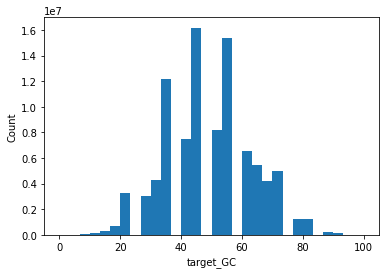

Wall time: 10min 53s


In [20]:
%%time
# Calculate and plot the GC contents of the target regions
filters.calc_gc_for_probe_dict(probe_dict, column_key_seq='target_sequence', column_key_write='target_GC')
plot.plot_hist(probe_dict, column_key='target_GC')

ENSG00000000003
	ENST00000373020: 1373 / 3739 probes passed the filter 43 < target_GC <  70.
ENSG00000000005
	ENST00000373031: 590 / 1176 probes passed the filter 43 < target_GC <  70.
ENSG00000000419
	ENST00000371588: 322 / 1025 probes passed the filter 43 < target_GC <  70.
ENSG00000000457
	ENST00000367770: 1764 / 2887 probes passed the filter 43 < target_GC <  70.
ENSG00000000460
	ENST00000359326: 1905 / 3982 probes passed the filter 43 < target_GC <  70.
ENSG00000000938
	ENST00000374003: 1807 / 1992 probes passed the filter 43 < target_GC <  70.
ENSG00000000971
	ENST00000367429: 1491 / 3933 probes passed the filter 43 < target_GC <  70.
ENSG00000001036
	ENST00000002165: 1081 / 2356 probes passed the filter 43 < target_GC <  70.
ENSG00000001084
	ENST00000650454: 1365 / 3756 probes passed the filter 43 < target_GC <  70.
ENSG00000001167
	ENST00000353205: 1326 / 1631 probes passed the filter 43 < target_GC <  70.
ENSG00000001460
	ENST00000337248: 1901 / 2697 probes passed the filter 4

	ENST00000005284: 1393 / 1888 probes passed the filter 43 < target_GC <  70.
ENSG00000006118
	ENST00000005286: 1861 / 3451 probes passed the filter 43 < target_GC <  70.
ENSG00000006125
	ENST00000618940: 2386 / 3386 probes passed the filter 43 < target_GC <  70.
ENSG00000006128
	ENST00000346867: 331 / 982 probes passed the filter 43 < target_GC <  70.
ENSG00000006194
	ENST00000219069: 2456 / 3253 probes passed the filter 43 < target_GC <  70.
ENSG00000006210
	ENST00000006053: 2532 / 3256 probes passed the filter 43 < target_GC <  70.
ENSG00000006282
	ENST00000634597: 2162 / 2558 probes passed the filter 43 < target_GC <  70.
ENSG00000006283
	ENST00000507896: 4743 / 6571 probes passed the filter 43 < target_GC <  70.
ENSG00000006327
	ENST00000326577: 532 / 948 probes passed the filter 43 < target_GC <  70.
ENSG00000006377
	ENST00000518156: 1177 / 2271 probes passed the filter 43 < target_GC <  70.
ENSG00000006432
	ENST00000381250: 2961 / 3996 probes passed the filter 43 < target_GC <  7

	ENST00000313777: 1157 / 1699 probes passed the filter 43 < target_GC <  70.
ENSG00000010379
	ENST00000343164: 1918 / 2159 probes passed the filter 43 < target_GC <  70.
ENSG00000010404
	ENST00000340855: 3962 / 7551 probes passed the filter 43 < target_GC <  70.
ENSG00000010438
	ENST00000379405: 755 / 779 probes passed the filter 43 < target_GC <  70.
ENSG00000010539
	ENST00000575948: 850 / 1321 probes passed the filter 43 < target_GC <  70.
ENSG00000010610
	ENST00000011653: 2621 / 3020 probes passed the filter 43 < target_GC <  70.
ENSG00000010626
	ENST00000007969: 1345 / 1586 probes passed the filter 43 < target_GC <  70.
ENSG00000010671
	ENST00000695623: 1923 / 2529 probes passed the filter 43 < target_GC <  70.
ENSG00000010704
	ENST00000357618: 2549 / 5147 probes passed the filter 43 < target_GC <  70.
ENSG00000010803
	ENST00000337495: 2670 / 3079 probes passed the filter 43 < target_GC <  70.
ENSG00000010810
	ENST00000368667: 1674 / 2387 probes passed the filter 43 < target_GC <  

	ENST00000261245: 796 / 2619 probes passed the filter 43 < target_GC <  70.
ENSG00000020577
	ENST00000251091: 3487 / 6536 probes passed the filter 43 < target_GC <  70.
ENSG00000020633
	ENST00000338888: 1606 / 2600 probes passed the filter 43 < target_GC <  70.
ENSG00000020922
	ENST00000393241: 980 / 2575 probes passed the filter 43 < target_GC <  70.
ENSG00000021300
	ENST00000535129: 733 / 1020 probes passed the filter 43 < target_GC <  70.
ENSG00000021355
	ENST00000380739: 1242 / 2447 probes passed the filter 43 < target_GC <  70.
ENSG00000021461
	ENST00000222382: 707 / 1486 probes passed the filter 43 < target_GC <  70.
ENSG00000021488
	ENST00000587772: 1201 / 1539 probes passed the filter 43 < target_GC <  70.
ENSG00000021574
	ENST00000621856: 971 / 2055 probes passed the filter 43 < target_GC <  70.
ENSG00000021645
	ENST00000335750: 6638 / 12019 probes passed the filter 43 < target_GC <  70.
ENSG00000021762
	ENST00000263650: 2525 / 3825 probes passed the filter 43 < target_GC <  7

ENSG00000037897
	ENST00000324871: 1199 / 1349 probes passed the filter 43 < target_GC <  70.
ENSG00000037965
	ENST00000040584: 1242 / 2388 probes passed the filter 43 < target_GC <  70.
ENSG00000038002
	ENST00000264595: 812 / 2008 probes passed the filter 43 < target_GC <  70.
ENSG00000038210
	ENST00000512921: 509 / 1359 probes passed the filter 43 < target_GC <  70.
ENSG00000038219
	ENST00000040738: 5426 / 10538 probes passed the filter 43 < target_GC <  70.
ENSG00000038274
	ENST00000321757: 748 / 2035 probes passed the filter 43 < target_GC <  70.
ENSG00000038295
	ENST00000061240: 2660 / 7262 probes passed the filter 43 < target_GC <  70.
ENSG00000038358
	ENST00000358933: 3891 / 4738 probes passed the filter 43 < target_GC <  70.
ENSG00000038382
	ENST00000344204: 7319 / 11431 probes passed the filter 43 < target_GC <  70.
ENSG00000038427
	ENST00000502527: 1502 / 2058 probes passed the filter 43 < target_GC <  70.
ENSG00000038532
	ENST00000409790: 4688 / 6783 probes passed the filter 

	ENST00000056233: 1169 / 3711 probes passed the filter 43 < target_GC <  70.
ENSG00000050393
	ENST00000379170: 2395 / 5431 probes passed the filter 43 < target_GC <  70.
ENSG00000050405
	ENST00000552909: 1387 / 2133 probes passed the filter 43 < target_GC <  70.
ENSG00000050426
	ENST00000262055: 1445 / 2077 probes passed the filter 43 < target_GC <  70.
ENSG00000050438
	ENST00000453097: 7651 / 11735 probes passed the filter 43 < target_GC <  70.
ENSG00000050555
	ENST00000361069: 5529 / 7426 probes passed the filter 43 < target_GC <  70.
ENSG00000050628
	ENST00000460330: 762 / 1418 probes passed the filter 43 < target_GC <  70.
ENSG00000050730
	ENST00000509841: 758 / 1546 probes passed the filter 43 < target_GC <  70.
ENSG00000050748
	ENST00000393360: 1805 / 4297 probes passed the filter 43 < target_GC <  70.
ENSG00000050767
	ENST00000390654: 1632 / 2870 probes passed the filter 43 < target_GC <  70.
ENSG00000050820
	ENST00000538440: 1754 / 3163 probes passed the filter 43 < target_GC <

	ENST00000265872: 1958 / 4629 probes passed the filter 43 < target_GC <  70.
ENSG00000060491
	ENST00000290291: 1175 / 2381 probes passed the filter 43 < target_GC <  70.
ENSG00000060558
	ENST00000262958: 1521 / 2244 probes passed the filter 43 < target_GC <  70.
ENSG00000060566
	ENST00000602257: 1079 / 1446 probes passed the filter 43 < target_GC <  70.
ENSG00000060642
	ENST00000078527: 1655 / 2037 probes passed the filter 43 < target_GC <  70.
ENSG00000060656
	ENST00000345512: 3266 / 4441 probes passed the filter 43 < target_GC <  70.
ENSG00000060688
	ENST00000263694: 1049 / 1586 probes passed the filter 43 < target_GC <  70.
ENSG00000060709
	ENST00000690669: 3383 / 4917 probes passed the filter 43 < target_GC <  70.
ENSG00000060718
	ENST00000370096: 4353 / 7282 probes passed the filter 43 < target_GC <  70.
ENSG00000060749
	ENST00000399302: 3134 / 9242 probes passed the filter 43 < target_GC <  70.
ENSG00000060762
	ENST00000360961: 340 / 875 probes passed the filter 43 < target_GC < 

	ENST00000440014: 1960 / 2449 probes passed the filter 43 < target_GC <  70.
ENSG00000066027
	ENST00000261461: 934 / 3216 probes passed the filter 43 < target_GC <  70.
ENSG00000066032
	ENST00000496558: 2384 / 3810 probes passed the filter 43 < target_GC <  70.
ENSG00000066044
	ENST00000596459: 1031 / 1444 probes passed the filter 43 < target_GC <  70.
ENSG00000066056
	ENST00000372476: 2993 / 3864 probes passed the filter 43 < target_GC <  70.
ENSG00000066084
	ENST00000301180: 5236 / 8676 probes passed the filter 43 < target_GC <  70.
ENSG00000066117
	ENST00000394963: 2493 / 3254 probes passed the filter 43 < target_GC <  70.
ENSG00000066135
	ENST00000372396: 3673 / 4457 probes passed the filter 43 < target_GC <  70.
ENSG00000066136
	ENST00000372651: 909 / 1173 probes passed the filter 43 < target_GC <  70.
ENSG00000066185
	ENST00000372565: 893 / 1501 probes passed the filter 43 < target_GC <  70.
ENSG00000066230
	ENST00000264938: 3315 / 5526 probes passed the filter 43 < target_GC <  

	ENST00000176195: 184 / 497 probes passed the filter 43 < target_GC <  70.
ENSG00000070047
	ENST00000533464: 3148 / 5189 probes passed the filter 43 < target_GC <  70.
ENSG00000070061
	ENST00000675406: 3259 / 5850 probes passed the filter 43 < target_GC <  70.
ENSG00000070081
	ENST00000323688: 449 / 1876 probes passed the filter 43 < target_GC <  70.
ENSG00000070087
	ENST00000452853: 695 / 1751 probes passed the filter 43 < target_GC <  70.
ENSG00000070159
	ENST00000374541: 4027 / 6675 probes passed the filter 43 < target_GC <  70.
ENSG00000070182
	ENST00000389722: 8310 / 10034 probes passed the filter 43 < target_GC <  70.
ENSG00000070190
	ENST00000512369: 1296 / 2906 probes passed the filter 43 < target_GC <  70.
ENSG00000070193
	ENST00000264664: 2196 / 6084 probes passed the filter 43 < target_GC <  70.
ENSG00000070214
	ENST00000374720: 3694 / 10453 probes passed the filter 43 < target_GC <  70.
ENSG00000070269
	ENST00000261556: 1984 / 4230 probes passed the filter 43 < target_GC < 

	ENST00000394179: 1180 / 1398 probes passed the filter 43 < target_GC <  70.
ENSG00000073614
	ENST00000399788: 5738 / 10672 probes passed the filter 43 < target_GC <  70.
ENSG00000073670
	ENST00000200557: 3270 / 4585 probes passed the filter 43 < target_GC <  70.
ENSG00000073711
	ENST00000334546: 1200 / 2167 probes passed the filter 43 < target_GC <  70.
ENSG00000073712
	ENST00000553373: 997 / 2035 probes passed the filter 43 < target_GC <  70.
ENSG00000073734
	ENST00000650372: 4344 / 6905 probes passed the filter 43 < target_GC <  70.
ENSG00000073737
	ENST00000412271: 893 / 1436 probes passed the filter 43 < target_GC <  70.
ENSG00000073754
	ENST00000368174: 1434 / 2175 probes passed the filter 43 < target_GC <  70.
ENSG00000073756
	ENST00000367468: 1486 / 4481 probes passed the filter 43 < target_GC <  70.
ENSG00000073792
	ENST00000382199: 2760 / 4254 probes passed the filter 43 < target_GC <  70.
ENSG00000073803
	ENST00000424227: 2409 / 3127 probes passed the filter 43 < target_GC <

	ENST00000189444: 2033 / 2983 probes passed the filter 43 < target_GC <  70.
ENSG00000077152
	ENST00000646651: 530 / 849 probes passed the filter 43 < target_GC <  70.
ENSG00000077157
	ENST00000608999: 10160 / 15215 probes passed the filter 43 < target_GC <  70.
ENSG00000077232
	ENST00000264065: 6538 / 20115 probes passed the filter 43 < target_GC <  70.
ENSG00000077235
	ENST00000561623: 5516 / 6986 probes passed the filter 43 < target_GC <  70.
ENSG00000077238
	ENST00000543915: 2830 / 3510 probes passed the filter 43 < target_GC <  70.
ENSG00000077254
	ENST00000370794: 1481 / 4298 probes passed the filter 43 < target_GC <  70.
ENSG00000077264
	ENST00000425146: 1423 / 2448 probes passed the filter 43 < target_GC <  70.
ENSG00000077274
	ENST00000324068: 2681 / 3503 probes passed the filter 43 < target_GC <  70.
ENSG00000077279
	ENST00000496551: 1005 / 1291 probes passed the filter 43 < target_GC <  70.
ENSG00000077312
	ENST00000243563: 913 / 1248 probes passed the filter 43 < target_GC 

	ENST00000522874: 1129 / 1861 probes passed the filter 43 < target_GC <  70.
ENSG00000080824
	ENST00000216281: 1548 / 3199 probes passed the filter 43 < target_GC <  70.
ENSG00000080839
	ENST00000373664: 2213 / 5657 probes passed the filter 43 < target_GC <  70.
ENSG00000080845
	ENST00000340491: 1753 / 2363 probes passed the filter 43 < target_GC <  70.
ENSG00000080854
	ENST00000533871: 13026 / 17130 probes passed the filter 43 < target_GC <  70.
ENSG00000080910
	ENST00000367421: 554 / 1296 probes passed the filter 43 < target_GC <  70.
ENSG00000080947
	ENST00000589964: 160 / 226 probes passed the filter 43 < target_GC <  70.
ENSG00000080986
	ENST00000261597: 771 / 2097 probes passed the filter 43 < target_GC <  70.
ENSG00000081014
	ENST00000261842: 2352 / 6714 probes passed the filter 43 < target_GC <  70.
ENSG00000081019
	ENST00000612242: 1810 / 6563 probes passed the filter 43 < target_GC <  70.
ENSG00000081026
	ENST00000369611: 2174 / 3567 probes passed the filter 43 < target_GC < 

	ENST00000395603: 2826 / 10189 probes passed the filter 43 < target_GC <  70.
ENSG00000085231
	ENST00000380822: 437 / 1597 probes passed the filter 43 < target_GC <  70.
ENSG00000085265
	ENST00000371806: 4182 / 7559 probes passed the filter 43 < target_GC <  70.
ENSG00000085274
	ENST00000356716: 931 / 2804 probes passed the filter 43 < target_GC <  70.
ENSG00000085276
	ENST00000494292: 2854 / 4215 probes passed the filter 43 < target_GC <  70.
ENSG00000085365
	ENST00000621999: 1290 / 6114 probes passed the filter 43 < target_GC <  70.
ENSG00000085377
	ENST00000652536: 3970 / 7221 probes passed the filter 43 < target_GC <  70.
ENSG00000085382
	ENST00000262903: 1408 / 4546 probes passed the filter 43 < target_GC <  70.
ENSG00000085415
	ENST00000399892: 877 / 1822 probes passed the filter 43 < target_GC <  70.
ENSG00000085433
	ENST00000400794: 1829 / 4105 probes passed the filter 43 < target_GC <  70.
ENSG00000085449
	ENST00000233055: 1981 / 4578 probes passed the filter 43 < target_GC < 

	ENST00000400137: 874 / 1485 probes passed the filter 43 < target_GC <  70.
ENSG00000088833
	ENST00000216879: 2115 / 2692 probes passed the filter 43 < target_GC <  70.
ENSG00000088836
	ENST00000644011: 2305 / 2932 probes passed the filter 43 < target_GC <  70.
ENSG00000088854
	ENST00000252032: 4411 / 6883 probes passed the filter 43 < target_GC <  70.
ENSG00000088876
	ENST00000278772: 2742 / 3386 probes passed the filter 43 < target_GC <  70.
ENSG00000088881
	ENST00000609451: 1086 / 1983 probes passed the filter 43 < target_GC <  70.
ENSG00000088882
	ENST00000380605: 1723 / 2347 probes passed the filter 43 < target_GC <  70.
ENSG00000088888
	ENST00000428216: 8703 / 11702 probes passed the filter 43 < target_GC <  70.
ENSG00000088899
	ENST00000337576: 2638 / 4167 probes passed the filter 43 < target_GC <  70.
ENSG00000088926
	ENST00000403665: 1678 / 3024 probes passed the filter 43 < target_GC <  70.
ENSG00000088930
	ENST00000377191: 1689 / 3379 probes passed the filter 43 < target_GC 

	ENST00000399138: 1980 / 3130 probes passed the filter 43 < target_GC <  70.
ENSG00000091583
	ENST00000205948: 678 / 1145 probes passed the filter 43 < target_GC <  70.
ENSG00000091592
	ENST00000617618: 4119 / 4759 probes passed the filter 43 < target_GC <  70.
ENSG00000091622
	ENST00000421306: 4948 / 6916 probes passed the filter 43 < target_GC <  70.
ENSG00000091640
	ENST00000206020: 709 / 976 probes passed the filter 43 < target_GC <  70.
ENSG00000091651
	ENST00000219097: 807 / 1586 probes passed the filter 43 < target_GC <  70.
ENSG00000091656
	ENST00000518282: 7984 / 12146 probes passed the filter 43 < target_GC <  70.
ENSG00000091664
	ENST00000263160: 1227 / 3636 probes passed the filter 43 < target_GC <  70.
ENSG00000091704
	ENST00000011292: 1209 / 1355 probes passed the filter 43 < target_GC <  70.
ENSG00000091732
	ENST00000358303: 1504 / 1860 probes passed the filter 43 < target_GC <  70.
ENSG00000091831
	ENST00000338799: 2287 / 3306 probes passed the filter 43 < target_GC <  

	ENST00000370558: 2116 / 6342 probes passed the filter 43 < target_GC <  70.
ENSG00000097046
	ENST00000234626: 1118 / 3186 probes passed the filter 43 < target_GC <  70.
ENSG00000097096
	ENST00000341460: 1803 / 5437 probes passed the filter 43 < target_GC <  70.
ENSG00000099139
	ENST00000545128: 6209 / 9509 probes passed the filter 43 < target_GC <  70.
ENSG00000099194
	ENST00000370355: 3393 / 5216 probes passed the filter 43 < target_GC <  70.
ENSG00000099203
	ENST00000214869: 1197 / 1604 probes passed the filter 43 < target_GC <  70.
ENSG00000099204
	ENST00000369256: 2425 / 3174 probes passed the filter 43 < target_GC <  70.
ENSG00000099219
	ENST00000339450: 2647 / 5348 probes passed the filter 43 < target_GC <  70.
ENSG00000099246
	ENST00000356940: 1173 / 4846 probes passed the filter 43 < target_GC <  70.
ENSG00000099250
	ENST00000374867: 3258 / 5611 probes passed the filter 43 < target_GC <  70.
ENSG00000099251
	ENST00000471365: 670 / 1004 probes passed the filter 43 < target_GC <

	ENST00000216027: 641 / 1077 probes passed the filter 43 < target_GC <  70.
ENSG00000100211
	ENST00000216029: 929 / 1117 probes passed the filter 43 < target_GC <  70.
ENSG00000100216
	ENST00000216034: 1273 / 2002 probes passed the filter 43 < target_GC <  70.
ENSG00000100218
	ENST00000216036: 1029 / 1159 probes passed the filter 43 < target_GC <  70.
ENSG00000100219
	ENST00000344347: 770 / 1102 probes passed the filter 43 < target_GC <  70.
ENSG00000100220
	ENST00000216038: 1575 / 1990 probes passed the filter 43 < target_GC <  70.
ENSG00000100221
	ENST00000216039: 2654 / 3619 probes passed the filter 43 < target_GC <  70.
ENSG00000100225
	ENST00000452138: 979 / 1506 probes passed the filter 43 < target_GC <  70.
ENSG00000100226
	ENST00000216044: 3898 / 4876 probes passed the filter 43 < target_GC <  70.
ENSG00000100227
	ENST00000252115: 2914 / 3333 probes passed the filter 43 < target_GC <  70.
ENSG00000100228
	ENST00000263116: 4057 / 4961 probes passed the filter 43 < target_GC <  7

	ENST00000557154: 812 / 1467 probes passed the filter 43 < target_GC <  70.
ENSG00000100652
	ENST00000216540: 1301 / 1973 probes passed the filter 43 < target_GC <  70.
ENSG00000100664
	ENST00000392715: 1327 / 3388 probes passed the filter 43 < target_GC <  70.
ENSG00000100665
	ENST00000557004: 1407 / 1636 probes passed the filter 43 < target_GC <  70.
ENSG00000100678
	ENST00000534137: 2329 / 2808 probes passed the filter 43 < target_GC <  70.
ENSG00000100697
	ENST00000527414: 3125 / 6150 probes passed the filter 43 < target_GC <  70.
ENSG00000100711
	ENST00000311141: 770 / 1354 probes passed the filter 43 < target_GC <  70.
ENSG00000100714
	ENST00000652337: 2272 / 3125 probes passed the filter 43 < target_GC <  70.
ENSG00000100721
	ENST00000555202: 513 / 688 probes passed the filter 43 < target_GC <  70.
ENSG00000100722
	ENST00000318308: 568 / 1355 probes passed the filter 43 < target_GC <  70.
ENSG00000100726
	ENST00000262319: 1826 / 3285 probes passed the filter 43 < target_GC <  70

	ENST00000329276: 1608 / 1884 probes passed the filter 43 < target_GC <  70.
ENSG00000101363
	ENST00000373606: 1020 / 1162 probes passed the filter 43 < target_GC <  70.
ENSG00000101365
	ENST00000380851: 971 / 1201 probes passed the filter 43 < target_GC <  70.
ENSG00000101367
	ENST00000375571: 1340 / 2533 probes passed the filter 43 < target_GC <  70.
ENSG00000101384
	ENST00000254958: 3811 / 5911 probes passed the filter 43 < target_GC <  70.
ENSG00000101391
	ENST00000346416: 1699 / 2051 probes passed the filter 43 < target_GC <  70.
ENSG00000101400
	ENST00000217381: 1329 / 2182 probes passed the filter 43 < target_GC <  70.
ENSG00000101405
	ENST00000217386: 157 / 484 probes passed the filter 43 < target_GC <  70.
ENSG00000101407
	ENST00000449821: 2655 / 3762 probes passed the filter 43 < target_GC <  70.
ENSG00000101412
	ENST00000343380: 1838 / 2661 probes passed the filter 43 < target_GC <  70.
ENSG00000101413
	ENST00000373433: 1964 / 3643 probes passed the filter 43 < target_GC <  

ENSG00000102287
	ENST00000370328: 2458 / 3120 probes passed the filter 43 < target_GC <  70.
ENSG00000102290
	ENST00000504220: 2409 / 3988 probes passed the filter 43 < target_GC <  70.
ENSG00000102302
	ENST00000375135: 2641 / 4314 probes passed the filter 43 < target_GC <  70.
ENSG00000102309
	ENST00000373669: 531 / 1210 probes passed the filter 43 < target_GC <  70.
ENSG00000102312
	ENST00000361988: 1399 / 1643 probes passed the filter 43 < target_GC <  70.
ENSG00000102313
	ENST00000218436: 4056 / 4935 probes passed the filter 43 < target_GC <  70.
ENSG00000102316
	ENST00000218439: 1712 / 1929 probes passed the filter 43 < target_GC <  70.
ENSG00000102317
	ENST00000376755: 633 / 1101 probes passed the filter 43 < target_GC <  70.
ENSG00000102349
	ENST00000468660: 4339 / 9067 probes passed the filter 43 < target_GC <  70.
ENSG00000102359
	ENST00000373004: 4325 / 6617 probes passed the filter 43 < target_GC <  70.
ENSG00000102362
	ENST00000263033: 1861 / 2306 probes passed the filter 4

	ENST00000574091: 1859 / 2266 probes passed the filter 43 < target_GC <  70.
ENSG00000103313
	ENST00000536379: 1387 / 1684 probes passed the filter 43 < target_GC <  70.
ENSG00000103316
	ENST00000572914: 874 / 1215 probes passed the filter 43 < target_GC <  70.
ENSG00000103319
	ENST00000263026: 4904 / 7369 probes passed the filter 43 < target_GC <  70.
ENSG00000103326
	ENST00000219611: 2049 / 4859 probes passed the filter 43 < target_GC <  70.
ENSG00000103335
	ENST00000301015: 5232 / 8060 probes passed the filter 43 < target_GC <  70.
ENSG00000103342
	ENST00000420576: 863 / 1574 probes passed the filter 43 < target_GC <  70.
ENSG00000103343
	ENST00000571936: 1366 / 1557 probes passed the filter 43 < target_GC <  70.
ENSG00000103351
	ENST00000341633: 1013 / 1614 probes passed the filter 43 < target_GC <  70.
ENSG00000103353
	ENST00000395878: 2888 / 4716 probes passed the filter 43 < target_GC <  70.
ENSG00000103355
	ENST00000682474: 929 / 1590 probes passed the filter 43 < target_GC <  

ENSG00000104611
	ENST00000519207: 1364 / 1955 probes passed the filter 43 < target_GC <  70.
ENSG00000104613
	ENST00000397977: 1161 / 2488 probes passed the filter 43 < target_GC <  70.
ENSG00000104626
	ENST00000519292: 839 / 2078 probes passed the filter 43 < target_GC <  70.
ENSG00000104635
	ENST00000289952: 1568 / 2108 probes passed the filter 43 < target_GC <  70.
ENSG00000104643
	ENST00000221086: 2862 / 7052 probes passed the filter 43 < target_GC <  70.
ENSG00000104660
	ENST00000321250: 827 / 3134 probes passed the filter 43 < target_GC <  70.
ENSG00000104671
	ENST00000221114: 313 / 1025 probes passed the filter 43 < target_GC <  70.
ENSG00000104679
	ENST00000411463: 1118 / 1438 probes passed the filter 43 < target_GC <  70.
ENSG00000104687
	ENST00000221130: 1611 / 3005 probes passed the filter 43 < target_GC <  70.
ENSG00000104689
	ENST00000221132: 1855 / 2661 probes passed the filter 43 < target_GC <  70.
ENSG00000104691
	ENST00000265616: 556 / 1422 probes passed the filter 43 

	ENST00000221978: 590 / 745 probes passed the filter 43 < target_GC <  70.
ENSG00000105376
	ENST00000221980: 1551 / 3000 probes passed the filter 43 < target_GC <  70.
ENSG00000105379
	ENST00000309244: 685 / 843 probes passed the filter 43 < target_GC <  70.
ENSG00000105383
	ENST00000391796: 946 / 1060 probes passed the filter 43 < target_GC <  70.
ENSG00000105388
	ENST00000617332: 1943 / 2199 probes passed the filter 43 < target_GC <  70.
ENSG00000105392
	ENST00000539067: 1735 / 2246 probes passed the filter 43 < target_GC <  70.
ENSG00000105393
	ENST00000601043: 1047 / 1337 probes passed the filter 43 < target_GC <  70.
ENSG00000105397
	ENST00000264818: 2909 / 3942 probes passed the filter 43 < target_GC <  70.
ENSG00000105398
	ENST00000222002: 998 / 1875 probes passed the filter 43 < target_GC <  70.
ENSG00000105401
	ENST00000222005: 1167 / 1589 probes passed the filter 43 < target_GC <  70.
ENSG00000105402
	ENST00000263354: 1329 / 1633 probes passed the filter 43 < target_GC <  70.

	ENST00000222725: 1360 / 2416 probes passed the filter 43 < target_GC <  70.
ENSG00000106004
	ENST00000222726: 724 / 1641 probes passed the filter 43 < target_GC <  70.
ENSG00000106006
	ENST00000222728: 602 / 960 probes passed the filter 43 < target_GC <  70.
ENSG00000106009
	ENST00000340611: 1432 / 2750 probes passed the filter 43 < target_GC <  70.
ENSG00000106012
	ENST00000404984: 1522 / 2057 probes passed the filter 43 < target_GC <  70.
ENSG00000106013
	ENST00000417525: 310 / 1213 probes passed the filter 43 < target_GC <  70.
ENSG00000106018
	ENST00000402066: 1100 / 1897 probes passed the filter 43 < target_GC <  70.
ENSG00000106025
	ENST00000415871: 766 / 1466 probes passed the filter 43 < target_GC <  70.
ENSG00000106028
	ENST00000498107: 323 / 607 probes passed the filter 43 < target_GC <  70.
ENSG00000106031
	ENST00000649031: 1542 / 4986 probes passed the filter 43 < target_GC <  70.
ENSG00000106034
	ENST00000310396: 2137 / 5275 probes passed the filter 43 < target_GC <  70.


	ENST00000414202: 3473 / 6757 probes passed the filter 43 < target_GC <  70.
ENSG00000107077
	ENST00000381309: 2708 / 4309 probes passed the filter 43 < target_GC <  70.
ENSG00000107099
	ENST00000453981: 5058 / 7208 probes passed the filter 43 < target_GC <  70.
ENSG00000107104
	ENST00000382297: 3799 / 5041 probes passed the filter 43 < target_GC <  70.
ENSG00000107105
	ENST00000380110: 1226 / 3662 probes passed the filter 43 < target_GC <  70.
ENSG00000107130
	ENST00000372398: 3503 / 5135 probes passed the filter 43 < target_GC <  70.
ENSG00000107140
	ENST00000620767: 1496 / 2409 probes passed the filter 43 < target_GC <  70.
ENSG00000107147
	ENST00000488444: 2719 / 3667 probes passed the filter 43 < target_GC <  70.
ENSG00000107159
	ENST00000378357: 1155 / 1517 probes passed the filter 43 < target_GC <  70.
ENSG00000107164
	ENST00000319725: 1446 / 3124 probes passed the filter 43 < target_GC <  70.
ENSG00000107165
	ENST00000388918: 1356 / 2867 probes passed the filter 43 < target_GC 

	ENST00000225538: 2159 / 2633 probes passed the filter 43 < target_GC <  70.
ENSG00000108406
	ENST00000251241: 1375 / 3546 probes passed the filter 43 < target_GC <  70.
ENSG00000108417
	ENST00000225550: 1438 / 1714 probes passed the filter 43 < target_GC <  70.
ENSG00000108423
	ENST00000592426: 644 / 1431 probes passed the filter 43 < target_GC <  70.
ENSG00000108424
	ENST00000290158: 3549 / 6029 probes passed the filter 43 < target_GC <  70.
ENSG00000108433
	ENST00000576910: 1411 / 1862 probes passed the filter 43 < target_GC <  70.
ENSG00000108439
	ENST00000642017: 2671 / 3388 probes passed the filter 43 < target_GC <  70.
ENSG00000108442
	ENST00000455082: 201 / 586 probes passed the filter 43 < target_GC <  70.
ENSG00000108443
	ENST00000225577: 1576 / 5399 probes passed the filter 43 < target_GC <  70.
ENSG00000108448
	ENST00000578086: 145 / 168 probes passed the filter 43 < target_GC <  70.
ENSG00000108452
	ENST00000225587: 105 / 139 probes passed the filter 43 < target_GC <  70.


	ENST00000226725: 1276 / 3156 probes passed the filter 43 < target_GC <  70.
ENSG00000109471
	ENST00000226730: 219 / 1000 probes passed the filter 43 < target_GC <  70.
ENSG00000109472
	ENST00000402744: 1130 / 2553 probes passed the filter 43 < target_GC <  70.
ENSG00000109475
	ENST00000394665: 345 / 500 probes passed the filter 43 < target_GC <  70.
ENSG00000109501
	ENST00000684054: 304 / 524 probes passed the filter 43 < target_GC <  70.
ENSG00000109511
	ENST00000359299: 692 / 1412 probes passed the filter 43 < target_GC <  70.
ENSG00000109519
	ENST00000264954: 1614 / 2624 probes passed the filter 43 < target_GC <  70.
ENSG00000109534
	ENST00000394631: 456 / 982 probes passed the filter 43 < target_GC <  70.
ENSG00000109536
	ENST00000226798: 419 / 949 probes passed the filter 43 < target_GC <  70.
ENSG00000109572
	ENST00000613795: 2510 / 5845 probes passed the filter 43 < target_GC <  70.
ENSG00000109576
	ENST00000353187: 871 / 2072 probes passed the filter 43 < target_GC <  70.
ENSG

	ENST00000456145: 1083 / 1337 probes passed the filter 43 < target_GC <  70.
ENSG00000110675
	ENST00000443271: 1092 / 1961 probes passed the filter 43 < target_GC <  70.
ENSG00000110680
	ENST00000486207: 494 / 822 probes passed the filter 43 < target_GC <  70.
ENSG00000110693
	ENST00000528429: 2101 / 2627 probes passed the filter 43 < target_GC <  70.
ENSG00000110696
	ENST00000228136: 1281 / 3891 probes passed the filter 43 < target_GC <  70.
ENSG00000110697
	ENST00000534749: 2629 / 4160 probes passed the filter 43 < target_GC <  70.
ENSG00000110700
	ENST00000525634: 326 / 498 probes passed the filter 43 < target_GC <  70.
ENSG00000110711
	ENST00000279146: 976 / 1207 probes passed the filter 43 < target_GC <  70.
ENSG00000110713
	ENST00000324932: 4817 / 6697 probes passed the filter 43 < target_GC <  70.
ENSG00000110717
	ENST00000313468: 479 / 708 probes passed the filter 43 < target_GC <  70.
ENSG00000110719
	ENST00000265686: 1686 / 2639 probes passed the filter 43 < target_GC <  70.


	ENST00000261195: 1554 / 3185 probes passed the filter 43 < target_GC <  70.
ENSG00000111716
	ENST00000350669: 701 / 1274 probes passed the filter 43 < target_GC <  70.
ENSG00000111725
	ENST00000229328: 1546 / 2190 probes passed the filter 43 < target_GC <  70.
ENSG00000111726
	ENST00000229329: 579 / 1719 probes passed the filter 43 < target_GC <  70.
ENSG00000111727
	ENST00000229330: 1571 / 5631 probes passed the filter 43 < target_GC <  70.
ENSG00000111728
	ENST00000396037: 3429 / 9678 probes passed the filter 43 < target_GC <  70.
ENSG00000111729
	ENST00000229332: 586 / 1267 probes passed the filter 43 < target_GC <  70.
ENSG00000111731
	ENST00000542676: 1593 / 3409 probes passed the filter 43 < target_GC <  70.
ENSG00000111732
	ENST00000229335: 1293 / 2774 probes passed the filter 43 < target_GC <  70.
ENSG00000111737
	ENST00000229340: 1820 / 2826 probes passed the filter 43 < target_GC <  70.
ENSG00000111752
	ENST00000543824: 3369 / 4263 probes passed the filter 43 < target_GC <  

	ENST00000361195: 723 / 1034 probes passed the filter 43 < target_GC <  70.
ENSG00000112539
	ENST00000230301: 876 / 1793 probes passed the filter 43 < target_GC <  70.
ENSG00000112541
	ENST00000672859: 2611 / 4728 probes passed the filter 43 < target_GC <  70.
ENSG00000112559
	ENST00000230321: 931 / 1577 probes passed the filter 43 < target_GC <  70.
ENSG00000112561
	ENST00000403298: 1366 / 2134 probes passed the filter 43 < target_GC <  70.
ENSG00000112562
	ENST00000356284: 1802 / 3053 probes passed the filter 43 < target_GC <  70.
ENSG00000112576
	ENST00000372991: 1428 / 1997 probes passed the filter 43 < target_GC <  70.
ENSG00000112578
	ENST00000230340: 1463 / 1689 probes passed the filter 43 < target_GC <  70.
ENSG00000112584
	ENST00000625626: 1046 / 1765 probes passed the filter 43 < target_GC <  70.
ENSG00000112592
	ENST00000540980: 985 / 1672 probes passed the filter 43 < target_GC <  70.
ENSG00000112599
	ENST00000230361: 1751 / 2241 probes passed the filter 43 < target_GC <  7

	ENST00000393784: 2253 / 2874 probes passed the filter 43 < target_GC <  70.
ENSG00000113721
	ENST00000261799: 4581 / 5671 probes passed the filter 43 < target_GC <  70.
ENSG00000113722
	ENST00000231656: 1015 / 1746 probes passed the filter 43 < target_GC <  70.
ENSG00000113732
	ENST00000517669: 314 / 473 probes passed the filter 43 < target_GC <  70.
ENSG00000113734
	ENST00000351486: 850 / 1139 probes passed the filter 43 < target_GC <  70.
ENSG00000113739
	ENST00000265087: 2516 / 4225 probes passed the filter 43 < target_GC <  70.
ENSG00000113742
	ENST00000520867: 1667 / 2578 probes passed the filter 43 < target_GC <  70.
ENSG00000113749
	ENST00000377291: 2076 / 2532 probes passed the filter 43 < target_GC <  70.
ENSG00000113758
	ENST00000309007: 1769 / 2966 probes passed the filter 43 < target_GC <  70.
ENSG00000113761
	ENST00000358149: 3476 / 4285 probes passed the filter 43 < target_GC <  70.
ENSG00000113763
	ENST00000509580: 2453 / 3912 probes passed the filter 43 < target_GC <  

	ENST00000245680: 3304 / 10285 probes passed the filter 43 < target_GC <  70.
ENSG00000115085
	ENST00000264972: 1726 / 2392 probes passed the filter 43 < target_GC <  70.
ENSG00000115091
	ENST00000263238: 1428 / 6560 probes passed the filter 43 < target_GC <  70.
ENSG00000115107
	ENST00000393107: 1237 / 1842 probes passed the filter 43 < target_GC <  70.
ENSG00000115109
	ENST00000331393: 894 / 1748 probes passed the filter 43 < target_GC <  70.
ENSG00000115112
	ENST00000263707: 6474 / 9258 probes passed the filter 43 < target_GC <  70.
ENSG00000115128
	ENST00000233468: 236 / 622 probes passed the filter 43 < target_GC <  70.
ENSG00000115129
	ENST00000335934: 1169 / 1606 probes passed the filter 43 < target_GC <  70.
ENSG00000115137
	ENST00000264711: 2350 / 4818 probes passed the filter 43 < target_GC <  70.
ENSG00000115138
	ENST00000264708: 558 / 1045 probes passed the filter 43 < target_GC <  70.
ENSG00000115145
	ENST00000263904: 1343 / 5443 probes passed the filter 43 < target_GC <  

	ENST00000234296: 1732 / 4259 probes passed the filter 43 < target_GC <  70.
ENSG00000115944
	ENST00000234301: 814 / 2253 probes passed the filter 43 < target_GC <  70.
ENSG00000115946
	ENST00000263657: 870 / 2213 probes passed the filter 43 < target_GC <  70.
ENSG00000115947
	ENST00000392857: 1952 / 6518 probes passed the filter 43 < target_GC <  70.
ENSG00000115956
	ENST00000234313: 1851 / 2731 probes passed the filter 43 < target_GC <  70.
ENSG00000115963
	ENST00000263895: 1045 / 2655 probes passed the filter 43 < target_GC <  70.
ENSG00000115966
	ENST00000392544: 1230 / 1890 probes passed the filter 43 < target_GC <  70.
ENSG00000115970
	ENST00000405975: 3510 / 6062 probes passed the filter 43 < target_GC <  70.
ENSG00000115977
	ENST00000606389: 6131 / 11125 probes passed the filter 43 < target_GC <  70.
ENSG00000115993
	ENST00000332624: 3184 / 6360 probes passed the filter 43 < target_GC <  70.
ENSG00000115998
	ENST00000420306: 1473 / 2164 probes passed the filter 43 < target_GC <

	ENST00000366639: 799 / 2605 probes passed the filter 43 < target_GC <  70.
ENSG00000116922
	ENST00000464085: 655 / 890 probes passed the filter 43 < target_GC <  70.
ENSG00000116954
	ENST00000373001: 1052 / 2652 probes passed the filter 43 < target_GC <  70.
ENSG00000116962
	ENST00000264187: 3961 / 5763 probes passed the filter 43 < target_GC <  70.
ENSG00000116977
	ENST00000527974: 713 / 1320 probes passed the filter 43 < target_GC <  70.
ENSG00000116981
	ENST00000235628: 6803 / 9039 probes passed the filter 43 < target_GC <  70.
ENSG00000116983
	ENST00000372844: 3160 / 4571 probes passed the filter 43 < target_GC <  70.
ENSG00000116984
	ENST00000366577: 6047 / 10518 probes passed the filter 43 < target_GC <  70.
ENSG00000116985
	ENST00000372827: 2886 / 4797 probes passed the filter 43 < target_GC <  70.
ENSG00000116990
	ENST00000397332: 2161 / 3227 probes passed the filter 43 < target_GC <  70.
ENSG00000116991
	ENST00000675685: 4628 / 6608 probes passed the filter 43 < target_GC <  

	ENST00000679886: 1387 / 2397 probes passed the filter 43 < target_GC <  70.
ENSG00000118231
	ENST00000264376: 413 / 613 probes passed the filter 43 < target_GC <  70.
ENSG00000118242
	ENST00000620139: 1165 / 2589 probes passed the filter 43 < target_GC <  70.
ENSG00000118245
	ENST00000236979: 288 / 378 probes passed the filter 43 < target_GC <  70.
ENSG00000118246
	ENST00000403094: 906 / 2315 probes passed the filter 43 < target_GC <  70.
ENSG00000118257
	ENST00000357785: 4605 / 6615 probes passed the filter 43 < target_GC <  70.
ENSG00000118260
	ENST00000430624: 1036 / 1976 probes passed the filter 43 < target_GC <  70.
ENSG00000118263
	ENST00000309446: 4741 / 8336 probes passed the filter 43 < target_GC <  70.
ENSG00000118271
	ENST00000237014: 442 / 587 probes passed the filter 43 < target_GC <  70.
ENSG00000118276
	ENST00000306851: 1220 / 4643 probes passed the filter 43 < target_GC <  70.
ENSG00000118292
	ENST00000369099: 321 / 480 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000394009: 1190 / 3084 probes passed the filter 43 < target_GC <  70.
ENSG00000119638
	ENST00000238616: 5096 / 8249 probes passed the filter 43 < target_GC <  70.
ENSG00000119640
	ENST00000555694: 213 / 536 probes passed the filter 43 < target_GC <  70.
ENSG00000119650
	ENST00000314067: 566 / 787 probes passed the filter 43 < target_GC <  70.
ENSG00000119655
	ENST00000238633: 496 / 767 probes passed the filter 43 < target_GC <  70.
ENSG00000119660
	ENST00000559021: 305 / 336 probes passed the filter 43 < target_GC <  70.
ENSG00000119661
	ENST00000553645: 3340 / 8388 probes passed the filter 43 < target_GC <  70.
ENSG00000119669
	ENST00000238647: 1711 / 4137 probes passed the filter 43 < target_GC <  70.
ENSG00000119673
	ENST00000613168: 979 / 1524 probes passed the filter 43 < target_GC <  70.
ENSG00000119681
	ENST00000261978: 5260 / 8431 probes passed the filter 43 < target_GC <  70.
ENSG00000119682
	ENST00000356357: 3915 / 5388 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000689843: 670 / 1070 probes passed the filter 43 < target_GC <  70.
ENSG00000120658
	ENST00000261488: 1682 / 2953 probes passed the filter 43 < target_GC <  70.
ENSG00000120659
	ENST00000398795: 759 / 2172 probes passed the filter 43 < target_GC <  70.
ENSG00000120662
	ENST00000379477: 1020 / 1919 probes passed the filter 43 < target_GC <  70.
ENSG00000120664
	ENST00000379848: 265 / 479 probes passed the filter 43 < target_GC <  70.
ENSG00000120669
	ENST00000379881: 973 / 2096 probes passed the filter 43 < target_GC <  70.
ENSG00000120675
	ENST00000379221: 2415 / 7430 probes passed the filter 43 < target_GC <  70.
ENSG00000120685
	ENST00000352251: 2801 / 5153 probes passed the filter 43 < target_GC <  70.
ENSG00000120686
	ENST00000239878: 754 / 3139 probes passed the filter 43 < target_GC <  70.
ENSG00000120688
	ENST00000379487: 746 / 2359 probes passed the filter 43 < target_GC <  70.
ENSG00000120690
	ENST00000239882: 1473 / 3649 probes passed the filter 43 < target_GC <  70.


	ENST00000344850: 1334 / 2578 probes passed the filter 43 < target_GC <  70.
ENSG00000121966
	ENST00000696136: 1154 / 1609 probes passed the filter 43 < target_GC <  70.
ENSG00000121988
	ENST00000264159: 3198 / 6683 probes passed the filter 43 < target_GC <  70.
ENSG00000121989
	ENST00000404590: 1131 / 2338 probes passed the filter 43 < target_GC <  70.
ENSG00000122008
	ENST00000241436: 1330 / 5882 probes passed the filter 43 < target_GC <  70.
ENSG00000122012
	ENST00000502798: 6250 / 10795 probes passed the filter 43 < target_GC <  70.
ENSG00000122025
	ENST00000241453: 1869 / 3797 probes passed the filter 43 < target_GC <  70.
ENSG00000122026
	ENST00000311549: 284 / 537 probes passed the filter 43 < target_GC <  70.
ENSG00000122033
	ENST00000405591: 340 / 860 probes passed the filter 43 < target_GC <  70.
ENSG00000122034
	ENST00000381140: 760 / 1414 probes passed the filter 43 < target_GC <  70.
ENSG00000122035
	ENST00000241463: 1479 / 2513 probes passed the filter 43 < target_GC <  7

	ENST00000397146: 4332 / 6687 probes passed the filter 43 < target_GC <  70.
ENSG00000123268
	ENST00000262053: 704 / 2383 probes passed the filter 43 < target_GC <  70.
ENSG00000123297
	ENST00000323833: 856 / 1189 probes passed the filter 43 < target_GC <  70.
ENSG00000123307
	ENST00000242994: 1805 / 3898 probes passed the filter 43 < target_GC <  70.
ENSG00000123329
	ENST00000430041: 1657 / 2294 probes passed the filter 43 < target_GC <  70.
ENSG00000123338
	ENST00000293373: 6237 / 8951 probes passed the filter 43 < target_GC <  70.
ENSG00000123342
	ENST00000322569: 2626 / 3207 probes passed the filter 43 < target_GC <  70.
ENSG00000123349
	ENST00000334478: 506 / 567 probes passed the filter 43 < target_GC <  70.
ENSG00000123352
	ENST00000321898: 1830 / 3129 probes passed the filter 43 < target_GC <  70.
ENSG00000123353
	ENST00000548974: 557 / 642 probes passed the filter 43 < target_GC <  70.
ENSG00000123358
	ENST00000394825: 1716 / 2456 probes passed the filter 43 < target_GC <  70.

	ENST00000244137: 1292 / 1878 probes passed the filter 43 < target_GC <  70.
ENSG00000124302
	ENST00000438847: 1085 / 2104 probes passed the filter 43 < target_GC <  70.
ENSG00000124313
	ENST00000375365: 2799 / 3975 probes passed the filter 43 < target_GC <  70.
ENSG00000124333
	ENST00000286448: 734 / 2565 probes passed the filter 43 < target_GC <  70.
ENSG00000124334
	ENST00000244174: 1690 / 2009 probes passed the filter 43 < target_GC <  70.
ENSG00000124343
	ENST00000381174: 1063 / 2284 probes passed the filter 43 < target_GC <  70.
ENSG00000124356
	ENST00000409707: 1079 / 1639 probes passed the filter 43 < target_GC <  70.
ENSG00000124357
	ENST00000443938: 953 / 1192 probes passed the filter 43 < target_GC <  70.
ENSG00000124370
	ENST00000244217: 366 / 795 probes passed the filter 43 < target_GC <  70.
ENSG00000124374
	ENST00000244221: 3410 / 6271 probes passed the filter 43 < target_GC <  70.
ENSG00000124380
	ENST00000244227: 394 / 1396 probes passed the filter 43 < target_GC <  70

	ENST00000245564: 1964 / 2393 probes passed the filter 43 < target_GC <  70.
ENSG00000125462
	ENST00000464238: 322 / 383 probes passed the filter 43 < target_GC <  70.
ENSG00000125482
	ENST00000612514: 910 / 1751 probes passed the filter 43 < target_GC <  70.
ENSG00000125484
	ENST00000372146: 4244 / 8583 probes passed the filter 43 < target_GC <  70.
ENSG00000125485
	ENST00000372159: 2765 / 4130 probes passed the filter 43 < target_GC <  70.
ENSG00000125492
	ENST00000542090: 592 / 1168 probes passed the filter 43 < target_GC <  70.
ENSG00000125498
	ENST00000291633: 1068 / 1174 probes passed the filter 43 < target_GC <  70.
ENSG00000125503
	ENST00000263433: 1595 / 2968 probes passed the filter 43 < target_GC <  70.
ENSG00000125505
	ENST00000245615: 1364 / 2265 probes passed the filter 43 < target_GC <  70.
ENSG00000125508
	ENST00000217188: 2428 / 4053 probes passed the filter 43 < target_GC <  70.
ENSG00000125510
	ENST00000355631: 2425 / 3118 probes passed the filter 43 < target_GC <  7

	ENST00000246515: 356 / 498 probes passed the filter 43 < target_GC <  70.
ENSG00000126243
	ENST00000588831: 2336 / 3660 probes passed the filter 43 < target_GC <  70.
ENSG00000126246
	ENST00000588992: 468 / 701 probes passed the filter 43 < target_GC <  70.
ENSG00000126247
	ENST00000246533: 1015 / 1399 probes passed the filter 43 < target_GC <  70.
ENSG00000126249
	ENST00000246535: 652 / 1128 probes passed the filter 43 < target_GC <  70.
ENSG00000126251
	ENST00000597214: 943 / 1153 probes passed the filter 43 < target_GC <  70.
ENSG00000126254
	ENST00000588161: 965 / 1580 probes passed the filter 43 < target_GC <  70.
ENSG00000126259
	ENST00000360202: 2059 / 2951 probes passed the filter 43 < target_GC <  70.
ENSG00000126261
	ENST00000246548: 1982 / 3976 probes passed the filter 43 < target_GC <  70.
ENSG00000126262
	ENST00000246549: 1605 / 2022 probes passed the filter 43 < target_GC <  70.
ENSG00000126264
	ENST00000437550: 316 / 416 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000248306: 777 / 2035 probes passed the filter 43 < target_GC <  70.
ENSG00000127743
	ENST00000261796: 452 / 683 probes passed the filter 43 < target_GC <  70.
ENSG00000127774
	ENST00000248378: 349 / 627 probes passed the filter 43 < target_GC <  70.
ENSG00000127780
	ENST00000248384: 811 / 943 probes passed the filter 43 < target_GC <  70.
ENSG00000127804
	ENST00000263092: 3771 / 5711 probes passed the filter 43 < target_GC <  70.
ENSG00000127824
	ENST00000248437: 1818 / 2020 probes passed the filter 43 < target_GC <  70.
ENSG00000127831
	ENST00000248444: 3508 / 6471 probes passed the filter 43 < target_GC <  70.
ENSG00000127837
	ENST00000248450: 1450 / 1731 probes passed the filter 43 < target_GC <  70.
ENSG00000127838
	ENST00000685415: 2472 / 3071 probes passed the filter 43 < target_GC <  70.
ENSG00000127863
	ENST00000382263: 1976 / 4122 probes passed the filter 43 < target_GC <  70.
ENSG00000127870
	ENST00000346166: 1323 / 3253 probes passed the filter 43 < target_GC <  70.


ENSG00000128951
	ENST00000455976: 550 / 1906 probes passed the filter 43 < target_GC <  70.
ENSG00000128965
	ENST00000617768: 1098 / 1491 probes passed the filter 43 < target_GC <  70.
ENSG00000128973
	ENST00000249806: 1639 / 2199 probes passed the filter 43 < target_GC <  70.
ENSG00000128989
	ENST00000569281: 308 / 632 probes passed the filter 43 < target_GC <  70.
ENSG00000129003
	ENST00000249837: 4885 / 13271 probes passed the filter 43 < target_GC <  70.
ENSG00000129007
	ENST00000467889: 2054 / 3828 probes passed the filter 43 < target_GC <  70.
ENSG00000129009
	ENST00000395118: 1678 / 2146 probes passed the filter 43 < target_GC <  70.
ENSG00000129028
	ENST00000249861: 550 / 2018 probes passed the filter 43 < target_GC <  70.
ENSG00000129038
	ENST00000261921: 968 / 2317 probes passed the filter 43 < target_GC <  70.
ENSG00000129048
	ENST00000249887: 670 / 2281 probes passed the filter 43 < target_GC <  70.
ENSG00000129055
	ENST00000511751: 411 / 867 probes passed the filter 43 < t

	ENST00000247005: 995 / 2550 probes passed the filter 43 < target_GC <  70.
ENSG00000130287
	ENST00000252575: 4567 / 6373 probes passed the filter 43 < target_GC <  70.
ENSG00000130294
	ENST00000650053: 4194 / 5595 probes passed the filter 43 < target_GC <  70.
ENSG00000130299
	ENST00000324894: 1516 / 2537 probes passed the filter 43 < target_GC <  70.
ENSG00000130300
	ENST00000252590: 1738 / 2261 probes passed the filter 43 < target_GC <  70.
ENSG00000130303
	ENST00000252593: 778 / 972 probes passed the filter 43 < target_GC <  70.
ENSG00000130304
	ENST00000252595: 2318 / 3485 probes passed the filter 43 < target_GC <  70.
ENSG00000130305
	ENST00000310326: 1132 / 1573 probes passed the filter 43 < target_GC <  70.
ENSG00000130307
	ENST00000252597: 2512 / 3260 probes passed the filter 43 < target_GC <  70.
ENSG00000130309
	ENST00000252599: 2584 / 3618 probes passed the filter 43 < target_GC <  70.
ENSG00000130311
	ENST00000359866: 2830 / 4014 probes passed the filter 43 < target_GC <  

	ENST00000367255: 17835 / 27679 probes passed the filter 43 < target_GC <  70.
ENSG00000131019
	ENST00000438272: 620 / 706 probes passed the filter 43 < target_GC <  70.
ENSG00000131023
	ENST00000253339: 1870 / 4227 probes passed the filter 43 < target_GC <  70.
ENSG00000131037
	ENST00000201647: 1410 / 2540 probes passed the filter 43 < target_GC <  70.
ENSG00000131042
	ENST00000391746: 1484 / 1911 probes passed the filter 43 < target_GC <  70.
ENSG00000131043
	ENST00000320849: 2078 / 2388 probes passed the filter 43 < target_GC <  70.
ENSG00000131044
	ENST00000375938: 1983 / 2594 probes passed the filter 43 < target_GC <  70.
ENSG00000131050
	ENST00000354932: 895 / 1013 probes passed the filter 43 < target_GC <  70.
ENSG00000131051
	ENST00000361162: 1289 / 2802 probes passed the filter 43 < target_GC <  70.
ENSG00000131055
	ENST00000376075: 508 / 640 probes passed the filter 43 < target_GC <  70.
ENSG00000131059
	ENST00000375454: 883 / 1110 probes passed the filter 43 < target_GC <  7

	ENST00000393261: 1203 / 1698 probes passed the filter 43 < target_GC <  70.
ENSG00000132005
	ENST00000254325: 2300 / 4346 probes passed the filter 43 < target_GC <  70.
ENSG00000132010
	ENST00000334213: 1346 / 2975 probes passed the filter 43 < target_GC <  70.
ENSG00000132016
	ENST00000586783: 2091 / 2856 probes passed the filter 43 < target_GC <  70.
ENSG00000132017
	ENST00000254337: 1408 / 2232 probes passed the filter 43 < target_GC <  70.
ENSG00000132024
	ENST00000589606: 2129 / 3088 probes passed the filter 43 < target_GC <  70.
ENSG00000132026
	ENST00000393233: 672 / 971 probes passed the filter 43 < target_GC <  70.
ENSG00000132031
	ENST00000407540: 1036 / 2528 probes passed the filter 43 < target_GC <  70.
ENSG00000132109
	ENST00000254436: 1589 / 1906 probes passed the filter 43 < target_GC <  70.
ENSG00000132122
	ENST00000371843: 934 / 2268 probes passed the filter 43 < target_GC <  70.
ENSG00000132128
	ENST00000343304: 2222 / 2918 probes passed the filter 43 < target_GC <  

	ENST00000371129: 395 / 2897 probes passed the filter 43 < target_GC <  70.
ENSG00000132872
	ENST00000255224: 1335 / 3907 probes passed the filter 43 < target_GC <  70.
ENSG00000132874
	ENST00000586448: 3014 / 3511 probes passed the filter 43 < target_GC <  70.
ENSG00000132879
	ENST00000251547: 2375 / 2899 probes passed the filter 43 < target_GC <  70.
ENSG00000132881
	ENST00000375599: 1065 / 1545 probes passed the filter 43 < target_GC <  70.
ENSG00000132906
	ENST00000333868: 2229 / 2779 probes passed the filter 43 < target_GC <  70.
ENSG00000132911
	ENST00000255262: 1392 / 2030 probes passed the filter 43 < target_GC <  70.
ENSG00000132912
	ENST00000446090: 1318 / 1708 probes passed the filter 43 < target_GC <  70.
ENSG00000132915
	ENST00000255266: 3674 / 5616 probes passed the filter 43 < target_GC <  70.
ENSG00000132932
	ENST00000684424: 5464 / 8727 probes passed the filter 43 < target_GC <  70.
ENSG00000132938
	ENST00000380808: 989 / 1764 probes passed the filter 43 < target_GC < 

	ENST00000554963: 536 / 946 probes passed the filter 43 < target_GC <  70.
ENSG00000134001
	ENST00000466499: 748 / 2361 probes passed the filter 43 < target_GC <  70.
ENSG00000134007
	ENST00000256389: 1466 / 2755 probes passed the filter 43 < target_GC <  70.
ENSG00000134013
	ENST00000389131: 2755 / 3692 probes passed the filter 43 < target_GC <  70.
ENSG00000134014
	ENST00000256398: 2071 / 3119 probes passed the filter 43 < target_GC <  70.
ENSG00000134020
	ENST00000256404: 758 / 872 probes passed the filter 43 < target_GC <  70.
ENSG00000134028
	ENST00000256412: 1019 / 2319 probes passed the filter 43 < target_GC <  70.
ENSG00000134030
	ENST00000382998: 3250 / 4378 probes passed the filter 43 < target_GC <  70.
ENSG00000134042
	ENST00000428869: 1007 / 1937 probes passed the filter 43 < target_GC <  70.
ENSG00000134046
	ENST00000256429: 2144 / 5035 probes passed the filter 43 < target_GC <  70.
ENSG00000134049
	ENST00000256433: 1033 / 3650 probes passed the filter 43 < target_GC <  70

	ENST00000359247: 3344 / 4489 probes passed the filter 43 < target_GC <  70.
ENSG00000134779
	ENST00000587129: 610 / 812 probes passed the filter 43 < target_GC <  70.
ENSG00000134780
	ENST00000257215: 3901 / 5770 probes passed the filter 43 < target_GC <  70.
ENSG00000134802
	ENST00000529554: 1858 / 2178 probes passed the filter 43 < target_GC <  70.
ENSG00000134809
	ENST00000525587: 434 / 457 probes passed the filter 43 < target_GC <  70.
ENSG00000134812
	ENST00000257248: 1049 / 1482 probes passed the filter 43 < target_GC <  70.
ENSG00000134815
	ENST00000328771: 3075 / 4309 probes passed the filter 43 < target_GC <  70.
ENSG00000134817
	ENST00000606794: 3011 / 3631 probes passed the filter 43 < target_GC <  70.
ENSG00000134824
	ENST00000278840: 2370 / 3062 probes passed the filter 43 < target_GC <  70.
ENSG00000134825
	ENST00000537328: 436 / 549 probes passed the filter 43 < target_GC <  70.
ENSG00000134827
	ENST00000257264: 776 / 1457 probes passed the filter 43 < target_GC <  70.


	ENST00000611373: 1393 / 2288 probes passed the filter 43 < target_GC <  70.
ENSG00000135535
	ENST00000504373: 647 / 2963 probes passed the filter 43 < target_GC <  70.
ENSG00000135537
	ENST00000368977: 1939 / 5019 probes passed the filter 43 < target_GC <  70.
ENSG00000135540
	ENST00000343505: 4647 / 7034 probes passed the filter 43 < target_GC <  70.
ENSG00000135541
	ENST00000681301: 1258 / 3409 probes passed the filter 43 < target_GC <  70.
ENSG00000135547
	ENST00000368364: 1034 / 2597 probes passed the filter 43 < target_GC <  70.
ENSG00000135549
	ENST00000354275: 270 / 1014 probes passed the filter 43 < target_GC <  70.
ENSG00000135569
	ENST00000258034: 961 / 1121 probes passed the filter 43 < target_GC <  70.
ENSG00000135577
	ENST00000258042: 1521 / 3050 probes passed the filter 43 < target_GC <  70.
ENSG00000135587
	ENST00000258052: 1165 / 1655 probes passed the filter 43 < target_GC <  70.
ENSG00000135596
	ENST00000358807: 2620 / 3401 probes passed the filter 43 < target_GC <  

	ENST00000258729: 1828 / 4245 probes passed the filter 43 < target_GC <  70.
ENSG00000136235
	ENST00000647578: 1702 / 2722 probes passed the filter 43 < target_GC <  70.
ENSG00000136237
	ENST00000665637: 3626 / 6887 probes passed the filter 43 < target_GC <  70.
ENSG00000136238
	ENST00000348035: 1018 / 2280 probes passed the filter 43 < target_GC <  70.
ENSG00000136240
	ENST00000258739: 1274 / 2757 probes passed the filter 43 < target_GC <  70.
ENSG00000136243
	ENST00000258742: 720 / 1542 probes passed the filter 43 < target_GC <  70.
ENSG00000136244
	ENST00000258743: 643 / 1098 probes passed the filter 43 < target_GC <  70.
ENSG00000136247
	ENST00000405731: 985 / 1319 probes passed the filter 43 < target_GC <  70.
ENSG00000136250
	ENST00000617537: 1639 / 2356 probes passed the filter 43 < target_GC <  70.
ENSG00000136261
	ENST00000258761: 946 / 1775 probes passed the filter 43 < target_GC <  70.
ENSG00000136267
	ENST00000407950: 1863 / 3622 probes passed the filter 43 < target_GC <  7

	ENST00000348462: 324 / 423 probes passed the filter 43 < target_GC <  70.
ENSG00000136943
	ENST00000680221: 869 / 1343 probes passed the filter 43 < target_GC <  70.
ENSG00000136944
	ENST00000526117: 4377 / 6262 probes passed the filter 43 < target_GC <  70.
ENSG00000136950
	ENST00000259477: 675 / 1296 probes passed the filter 43 < target_GC <  70.
ENSG00000136960
	ENST00000522826: 1642 / 2638 probes passed the filter 43 < target_GC <  70.
ENSG00000136982
	ENST00000313655: 554 / 2169 probes passed the filter 43 < target_GC <  70.
ENSG00000136986
	ENST00000259512: 1545 / 3184 probes passed the filter 43 < target_GC <  70.
ENSG00000136997
	ENST00000652288: 1067 / 1848 probes passed the filter 43 < target_GC <  70.
ENSG00000136999
	ENST00000259526: 1324 / 2434 probes passed the filter 43 < target_GC <  70.
ENSG00000137033
	ENST00000381434: 719 / 2612 probes passed the filter 43 < target_GC <  70.
ENSG00000137038
	ENST00000358227: 874 / 2427 probes passed the filter 43 < target_GC <  70.


	ENST00000444749: 780 / 1208 probes passed the filter 43 < target_GC <  70.
ENSG00000137760
	ENST00000417449: 1203 / 2085 probes passed the filter 43 < target_GC <  70.
ENSG00000137764
	ENST00000178640: 1336 / 2315 probes passed the filter 43 < target_GC <  70.
ENSG00000137766
	ENST00000260323: 3672 / 8851 probes passed the filter 43 < target_GC <  70.
ENSG00000137767
	ENST00000260324: 1228 / 1672 probes passed the filter 43 < target_GC <  70.
ENSG00000137770
	ENST00000558966: 700 / 1866 probes passed the filter 43 < target_GC <  70.
ENSG00000137776
	ENST00000380516: 1971 / 4139 probes passed the filter 43 < target_GC <  70.
ENSG00000137801
	ENST00000260356: 4430 / 7760 probes passed the filter 43 < target_GC <  70.
ENSG00000137802
	ENST00000456763: 5876 / 7129 probes passed the filter 43 < target_GC <  70.
ENSG00000137804
	ENST00000560177: 1083 / 2203 probes passed the filter 43 < target_GC <  70.
ENSG00000137806
	ENST00000560978: 723 / 1335 probes passed the filter 43 < target_GC <  

	ENST00000284719: 1435 / 4222 probes passed the filter 43 < target_GC <  70.
ENSG00000138433
	ENST00000342016: 783 / 1889 probes passed the filter 43 < target_GC <  70.
ENSG00000138434
	ENST00000320370: 2230 / 4936 probes passed the filter 43 < target_GC <  70.
ENSG00000138435
	ENST00000348749: 1326 / 1955 probes passed the filter 43 < target_GC <  70.
ENSG00000138439
	ENST00000392238: 2314 / 5953 probes passed the filter 43 < target_GC <  70.
ENSG00000138442
	ENST00000261015: 3488 / 8039 probes passed the filter 43 < target_GC <  70.
ENSG00000138443
	ENST00000261017: 2911 / 6455 probes passed the filter 43 < target_GC <  70.
ENSG00000138448
	ENST00000433736: 1878 / 3259 probes passed the filter 43 < target_GC <  70.
ENSG00000138449
	ENST00000261024: 1532 / 3301 probes passed the filter 43 < target_GC <  70.
ENSG00000138459
	ENST00000492406: 1719 / 4337 probes passed the filter 43 < target_GC <  70.
ENSG00000138463
	ENST00000261038: 1441 / 3293 probes passed the filter 43 < target_GC <

	ENST00000266673: 2341 / 5633 probes passed the filter 43 < target_GC <  70.
ENSG00000139292
	ENST00000266674: 2079 / 4554 probes passed the filter 43 < target_GC <  70.
ENSG00000139304
	ENST00000616559: 2827 / 8136 probes passed the filter 43 < target_GC <  70.
ENSG00000139318
	ENST00000279488: 1862 / 3598 probes passed the filter 43 < target_GC <  70.
ENSG00000139323
	ENST00000313546: 946 / 2995 probes passed the filter 43 < target_GC <  70.
ENSG00000139324
	ENST00000266712: 1258 / 7163 probes passed the filter 43 < target_GC <  70.
ENSG00000139329
	ENST00000266718: 671 / 2642 probes passed the filter 43 < target_GC <  70.
ENSG00000139330
	ENST00000266719: 678 / 2174 probes passed the filter 43 < target_GC <  70.
ENSG00000139343
	ENST00000266735: 235 / 423 probes passed the filter 43 < target_GC <  70.
ENSG00000139344
	ENST00000266736: 987 / 2197 probes passed the filter 43 < target_GC <  70.
ENSG00000139350
	ENST00000429527: 862 / 3337 probes passed the filter 43 < target_GC <  70.


	ENST00000356231: 3344 / 4628 probes passed the filter 43 < target_GC <  70.
ENSG00000140332
	ENST00000557907: 1653 / 2266 probes passed the filter 43 < target_GC <  70.
ENSG00000140350
	ENST00000465139: 1309 / 2411 probes passed the filter 43 < target_GC <  70.
ENSG00000140365
	ENST00000267935: 709 / 866 probes passed the filter 43 < target_GC <  70.
ENSG00000140367
	ENST00000267938: 807 / 2939 probes passed the filter 43 < target_GC <  70.
ENSG00000140368
	ENST00000379595: 1326 / 1811 probes passed the filter 43 < target_GC <  70.
ENSG00000140374
	ENST00000557943: 1151 / 2260 probes passed the filter 43 < target_GC <  70.
ENSG00000140379
	ENST00000267953: 324 / 751 probes passed the filter 43 < target_GC <  70.
ENSG00000140382
	ENST00000336216: 2346 / 3776 probes passed the filter 43 < target_GC <  70.
ENSG00000140386
	ENST00000324767: 2359 / 4678 probes passed the filter 43 < target_GC <  70.
ENSG00000140391
	ENST00000267970: 4027 / 6319 probes passed the filter 43 < target_GC <  70

	ENST00000649863: 3326 / 4442 probes passed the filter 43 < target_GC <  70.
ENSG00000141314
	ENST00000269051: 3751 / 4974 probes passed the filter 43 < target_GC <  70.
ENSG00000141316
	ENST00000269053: 738 / 810 probes passed the filter 43 < target_GC <  70.
ENSG00000141337
	ENST00000621439: 1947 / 2525 probes passed the filter 43 < target_GC <  70.
ENSG00000141338
	ENST00000430352: 2512 / 5794 probes passed the filter 43 < target_GC <  70.
ENSG00000141349
	ENST00000269097: 1179 / 1544 probes passed the filter 43 < target_GC <  70.
ENSG00000141367
	ENST00000269122: 3865 / 8340 probes passed the filter 43 < target_GC <  70.
ENSG00000141371
	ENST00000269127: 707 / 946 probes passed the filter 43 < target_GC <  70.
ENSG00000141376
	ENST00000588874: 2401 / 2919 probes passed the filter 43 < target_GC <  70.
ENSG00000141378
	ENST00000393038: 464 / 702 probes passed the filter 43 < target_GC <  70.
ENSG00000141380
	ENST00000269137: 1196 / 1807 probes passed the filter 43 < target_GC <  70.

	ENST00000427361: 734 / 893 probes passed the filter 43 < target_GC <  70.
ENSG00000142405
	ENST00000324134: 3005 / 3605 probes passed the filter 43 < target_GC <  70.
ENSG00000142408
	ENST00000270458: 6162 / 8821 probes passed the filter 43 < target_GC <  70.
ENSG00000142409
	ENST00000610935: 716 / 1911 probes passed the filter 43 < target_GC <  70.
ENSG00000142444
	ENST00000270502: 632 / 1318 probes passed the filter 43 < target_GC <  70.
ENSG00000142449
	ENST00000651877: 7086 / 9061 probes passed the filter 43 < target_GC <  70.
ENSG00000142453
	ENST00000344150: 1795 / 2693 probes passed the filter 43 < target_GC <  70.
ENSG00000142459
	ENST00000270530: 2492 / 3826 probes passed the filter 43 < target_GC <  70.
ENSG00000142484
	ENST00000270560: 598 / 685 probes passed the filter 43 < target_GC <  70.
ENSG00000142494
	ENST00000395585: 1598 / 1969 probes passed the filter 43 < target_GC <  70.
ENSG00000142507
	ENST00000270586: 701 / 795 probes passed the filter 43 < target_GC <  70.
E

	ENST00000366928: 269 / 1828 probes passed the filter 43 < target_GC <  70.
ENSG00000143355
	ENST00000367387: 2067 / 7836 probes passed the filter 43 < target_GC <  70.
ENSG00000143363
	ENST00000271620: 2036 / 2996 probes passed the filter 43 < target_GC <  70.
ENSG00000143365
	ENST00000318247: 2466 / 2967 probes passed the filter 43 < target_GC <  70.
ENSG00000143367
	ENST00000368848: 2385 / 3004 probes passed the filter 43 < target_GC <  70.
ENSG00000143368
	ENST00000271628: 994 / 1515 probes passed the filter 43 < target_GC <  70.
ENSG00000143369
	ENST00000369047: 1690 / 2017 probes passed the filter 43 < target_GC <  70.
ENSG00000143373
	ENST00000336715: 3635 / 4766 probes passed the filter 43 < target_GC <  70.
ENSG00000143374
	ENST00000369064: 2332 / 2698 probes passed the filter 43 < target_GC <  70.
ENSG00000143375
	ENST00000271636: 4131 / 5072 probes passed the filter 43 < target_GC <  70.
ENSG00000143376
	ENST00000458013: 3912 / 6412 probes passed the filter 43 < target_GC < 

	ENST00000634650: 1347 / 2554 probes passed the filter 43 < target_GC <  70.
ENSG00000144040
	ENST00000272433: 3031 / 3987 probes passed the filter 43 < target_GC <  70.
ENSG00000144043
	ENST00000272438: 2608 / 3336 probes passed the filter 43 < target_GC <  70.
ENSG00000144045
	ENST00000393951: 2228 / 2511 probes passed the filter 43 < target_GC <  70.
ENSG00000144048
	ENST00000272444: 659 / 1541 probes passed the filter 43 < target_GC <  70.
ENSG00000144057
	ENST00000409382: 2691 / 6771 probes passed the filter 43 < target_GC <  70.
ENSG00000144061
	ENST00000676028: 1048 / 2196 probes passed the filter 43 < target_GC <  70.
ENSG00000144063
	ENST00000272462: 1407 / 2288 probes passed the filter 43 < target_GC <  70.
ENSG00000144115
	ENST00000324166: 1784 / 1951 probes passed the filter 43 < target_GC <  70.
ENSG00000144118
	ENST00000420510: 687 / 1223 probes passed the filter 43 < target_GC <  70.
ENSG00000144119
	ENST00000272520: 814 / 1876 probes passed the filter 43 < target_GC <  

	ENST00000273610: 1208 / 1469 probes passed the filter 43 < target_GC <  70.
ENSG00000145041
	ENST00000684031: 3828 / 5620 probes passed the filter 43 < target_GC <  70.
ENSG00000145050
	ENST00000528157: 556 / 880 probes passed the filter 43 < target_GC <  70.
ENSG00000145063
	ENST00000590373: 518 / 548 probes passed the filter 43 < target_GC <  70.
ENSG00000145075
	ENST00000471307: 425 / 754 probes passed the filter 43 < target_GC <  70.
ENSG00000145087
	ENST00000471454: 3171 / 9262 probes passed the filter 43 < target_GC <  70.
ENSG00000145088
	ENST00000273668: 396 / 969 probes passed the filter 43 < target_GC <  70.
ENSG00000145103
	ENST00000273691: 1894 / 2630 probes passed the filter 43 < target_GC <  70.
ENSG00000145107
	ENST00000273695: 735 / 997 probes passed the filter 43 < target_GC <  70.
ENSG00000145113
	ENST00000349607: 3034 / 3800 probes passed the filter 43 < target_GC <  70.
ENSG00000145147
	ENST00000503837: 2955 / 4723 probes passed the filter 43 < target_GC <  70.
ENS

ENSG00000146066
	ENST00000274787: 442 / 625 probes passed the filter 43 < target_GC <  70.
ENSG00000146067
	ENST00000514747: 2033 / 2939 probes passed the filter 43 < target_GC <  70.
ENSG00000146070
	ENST00000537365: 768 / 1718 probes passed the filter 43 < target_GC <  70.
ENSG00000146072
	ENST00000296861: 2191 / 3566 probes passed the filter 43 < target_GC <  70.
ENSG00000146083
	ENST00000274811: 2199 / 4093 probes passed the filter 43 < target_GC <  70.
ENSG00000146085
	ENST00000274813: 1480 / 3782 probes passed the filter 43 < target_GC <  70.
ENSG00000146090
	ENST00000361132: 1597 / 2268 probes passed the filter 43 < target_GC <  70.
ENSG00000146094
	ENST00000357198: 880 / 1700 probes passed the filter 43 < target_GC <  70.
ENSG00000146109
	ENST00000274849: 1586 / 2914 probes passed the filter 43 < target_GC <  70.
ENSG00000146112
	ENST00000399199: 2133 / 2824 probes passed the filter 43 < target_GC <  70.
ENSG00000146122
	ENST00000274867: 5033 / 6156 probes passed the filter 43 

	ENST00000373701: 2220 / 3281 probes passed the filter 43 < target_GC <  70.
ENSG00000147164
	ENST00000276105: 521 / 691 probes passed the filter 43 < target_GC <  70.
ENSG00000147166
	ENST00000373829: 1050 / 1251 probes passed the filter 43 < target_GC <  70.
ENSG00000147168
	ENST00000374202: 1175 / 1451 probes passed the filter 43 < target_GC <  70.
ENSG00000147174
	ENST00000373696: 1893 / 2736 probes passed the filter 43 < target_GC <  70.
ENSG00000147180
	ENST00000674551: 1327 / 4530 probes passed the filter 43 < target_GC <  70.
ENSG00000147183
	ENST00000614120: 454 / 1456 probes passed the filter 43 < target_GC <  70.
ENSG00000147202
	ENST00000373049: 1294 / 3701 probes passed the filter 43 < target_GC <  70.
ENSG00000147206
	ENST00000395065: 1561 / 1927 probes passed the filter 43 < target_GC <  70.
ENSG00000147223
	ENST00000276173: 1085 / 1167 probes passed the filter 43 < target_GC <  70.
ENSG00000147224
	ENST00000372435: 1414 / 2041 probes passed the filter 43 < target_GC <  

	ENST00000684074: 2700 / 3581 probes passed the filter 43 < target_GC <  70.
ENSG00000148344
	ENST00000340607: 1244 / 1722 probes passed the filter 43 < target_GC <  70.
ENSG00000148346
	ENST00000372998: 507 / 602 probes passed the filter 43 < target_GC <  70.
ENSG00000148356
	ENST00000373322: 2128 / 2820 probes passed the filter 43 < target_GC <  70.
ENSG00000148357
	ENST00000683500: 10579 / 15760 probes passed the filter 43 < target_GC <  70.
ENSG00000148358
	ENST00000347136: 4471 / 6700 probes passed the filter 43 < target_GC <  70.
ENSG00000148362
	ENST00000371620: 471 / 779 probes passed the filter 43 < target_GC <  70.
ENSG00000148377
	ENST00000277517: 896 / 1327 probes passed the filter 43 < target_GC <  70.
ENSG00000148384
	ENST00000371712: 1845 / 3388 probes passed the filter 43 < target_GC <  70.
ENSG00000148386
	ENST00000619315: 1136 / 1568 probes passed the filter 43 < target_GC <  70.
ENSG00000148396
	ENST00000690691: 4587 / 6522 probes passed the filter 43 < target_GC <  

	ENST00000419816: 2949 / 4808 probes passed the filter 43 < target_GC <  70.
ENSG00000149531
	ENST00000278882: 268 / 732 probes passed the filter 43 < target_GC <  70.
ENSG00000149532
	ENST00000448745: 1441 / 1720 probes passed the filter 43 < target_GC <  70.
ENSG00000149534
	ENST00000278888: 1198 / 3619 probes passed the filter 43 < target_GC <  70.
ENSG00000149541
	ENST00000265471: 968 / 1423 probes passed the filter 43 < target_GC <  70.
ENSG00000149547
	ENST00000620753: 1175 / 1689 probes passed the filter 43 < target_GC <  70.
ENSG00000149548
	ENST00000344762: 1604 / 3783 probes passed the filter 43 < target_GC <  70.
ENSG00000149554
	ENST00000428830: 1016 / 1816 probes passed the filter 43 < target_GC <  70.
ENSG00000149557
	ENST00000278919: 3536 / 4554 probes passed the filter 43 < target_GC <  70.
ENSG00000149564
	ENST00000278927: 1333 / 1800 probes passed the filter 43 < target_GC <  70.
ENSG00000149571
	ENST00000525144: 3048 / 3791 probes passed the filter 43 < target_GC <  

	ENST00000547242: 483 / 782 probes passed the filter 43 < target_GC <  70.
ENSG00000151136
	ENST00000357167: 2681 / 4078 probes passed the filter 43 < target_GC <  70.
ENSG00000151148
	ENST00000434735: 4235 / 5591 probes passed the filter 43 < target_GC <  70.
ENSG00000151150
	ENST00000280772: 9182 / 16990 probes passed the filter 43 < target_GC <  70.
ENSG00000151151
	ENST00000373935: 889 / 6064 probes passed the filter 43 < target_GC <  70.
ENSG00000151164
	ENST00000392672: 632 / 1817 probes passed the filter 43 < target_GC <  70.
ENSG00000151176
	ENST00000280800: 3540 / 4758 probes passed the filter 43 < target_GC <  70.
ENSG00000151208
	ENST00000372391: 5579 / 7615 probes passed the filter 43 < target_GC <  70.
ENSG00000151224
	ENST00000372213: 2747 / 3355 probes passed the filter 43 < target_GC <  70.
ENSG00000151229
	ENST00000280871: 1601 / 7192 probes passed the filter 43 < target_GC <  70.
ENSG00000151233
	ENST00000280876: 382 / 1908 probes passed the filter 43 < target_GC <  7

	ENST00000282026: 2011 / 3523 probes passed the filter 43 < target_GC <  70.
ENSG00000152214
	ENST00000326695: 563 / 1057 probes passed the filter 43 < target_GC <  70.
ENSG00000152217
	ENST00000426838: 1155 / 1756 probes passed the filter 43 < target_GC <  70.
ENSG00000152219
	ENST00000282032: 747 / 2344 probes passed the filter 43 < target_GC <  70.
ENSG00000152223
	ENST00000696489: 7915 / 12554 probes passed the filter 43 < target_GC <  70.
ENSG00000152229
	ENST00000409746: 1487 / 2971 probes passed the filter 43 < target_GC <  70.
ENSG00000152234
	ENST00000282050: 1286 / 1916 probes passed the filter 43 < target_GC <  70.
ENSG00000152240
	ENST00000282058: 441 / 1043 probes passed the filter 43 < target_GC <  70.
ENSG00000152242
	ENST00000615052: 2469 / 5427 probes passed the filter 43 < target_GC <  70.
ENSG00000152253
	ENST00000282074: 426 / 1313 probes passed the filter 43 < target_GC <  70.
ENSG00000152254
	ENST00000375363: 1601 / 3001 probes passed the filter 43 < target_GC <  

	ENST00000371253: 3031 / 5403 probes passed the filter 43 < target_GC <  70.
ENSG00000153294
	ENST00000327753: 1867 / 3045 probes passed the filter 43 < target_GC <  70.
ENSG00000153303
	ENST00000644440: 4089 / 5638 probes passed the filter 43 < target_GC <  70.
ENSG00000153310
	ENST00000517654: 577 / 1788 probes passed the filter 43 < target_GC <  70.
ENSG00000153317
	ENST00000518721: 3287 / 6230 probes passed the filter 43 < target_GC <  70.
ENSG00000153339
	ENST00000283351: 2382 / 6201 probes passed the filter 43 < target_GC <  70.
ENSG00000153347
	ENST00000283357: 609 / 1513 probes passed the filter 43 < target_GC <  70.
ENSG00000153363
	ENST00000610948: 281 / 440 probes passed the filter 43 < target_GC <  70.
ENSG00000153391
	ENST00000334598: 598 / 914 probes passed the filter 43 < target_GC <  70.
ENSG00000153395
	ENST00000283415: 2190 / 3916 probes passed the filter 43 < target_GC <  70.
ENSG00000153404
	ENST00000637938: 8554 / 12562 probes passed the filter 43 < target_GC <  70

	ENST00000415576: 478 / 1765 probes passed the filter 43 < target_GC <  70.
ENSG00000154620
	ENST00000284856: 618 / 1308 probes passed the filter 43 < target_GC <  70.
ENSG00000154639
	ENST00000400169: 543 / 1416 probes passed the filter 43 < target_GC <  70.
ENSG00000154640
	ENST00000348354: 458 / 1381 probes passed the filter 43 < target_GC <  70.
ENSG00000154642
	ENST00000400559: 469 / 1564 probes passed the filter 43 < target_GC <  70.
ENSG00000154645
	ENST00000299295: 995 / 2516 probes passed the filter 43 < target_GC <  70.
ENSG00000154646
	ENST00000284885: 1534 / 4047 probes passed the filter 43 < target_GC <  70.
ENSG00000154654
	ENST00000400546: 1906 / 8012 probes passed the filter 43 < target_GC <  70.
ENSG00000154655
	ENST00000400105: 2059 / 3517 probes passed the filter 43 < target_GC <  70.
ENSG00000154678
	ENST00000396182: 1719 / 2391 probes passed the filter 43 < target_GC <  70.
ENSG00000154710
	ENST00000450873: 1232 / 2252 probes passed the filter 43 < target_GC <  70.

	ENST00000369454: 1538 / 3384 probes passed the filter 43 < target_GC <  70.
ENSG00000155962
	ENST00000369449: 850 / 2594 probes passed the filter 43 < target_GC <  70.
ENSG00000155966
	ENST00000370460: 6694 / 13719 probes passed the filter 43 < target_GC <  70.
ENSG00000155970
	ENST00000318063: 495 / 3961 probes passed the filter 43 < target_GC <  70.
ENSG00000155974
	ENST00000359742: 3220 / 5118 probes passed the filter 43 < target_GC <  70.
ENSG00000155975
	ENST00000324849: 992 / 4490 probes passed the filter 43 < target_GC <  70.
ENSG00000155980
	ENST00000455537: 4472 / 5750 probes passed the filter 43 < target_GC <  70.
ENSG00000156006
	ENST00000286479: 554 / 1256 probes passed the filter 43 < target_GC <  70.
ENSG00000156009
	ENST00000286482: 1235 / 1752 probes passed the filter 43 < target_GC <  70.
ENSG00000156011
	ENST00000286485: 2995 / 6636 probes passed the filter 43 < target_GC <  70.
ENSG00000156017
	ENST00000376834: 875 / 4230 probes passed the filter 43 < target_GC <  7

	ENST00000430046: 1220 / 4892 probes passed the filter 43 < target_GC <  70.
ENSG00000157110
	ENST00000397323: 1541 / 2845 probes passed the filter 43 < target_GC <  70.
ENSG00000157111
	ENST00000454765: 863 / 1215 probes passed the filter 43 < target_GC <  70.
ENSG00000157119
	ENST00000287777: 1919 / 2470 probes passed the filter 43 < target_GC <  70.
ENSG00000157131
	ENST00000361249: 1465 / 2338 probes passed the filter 43 < target_GC <  70.
ENSG00000157150
	ENST00000287814: 835 / 1165 probes passed the filter 43 < target_GC <  70.
ENSG00000157152
	ENST00000621198: 2404 / 3291 probes passed the filter 43 < target_GC <  70.
ENSG00000157168
	ENST00000287842: 1612 / 2006 probes passed the filter 43 < target_GC <  70.
ENSG00000157181
	ENST00000287859: 1194 / 3791 probes passed the filter 43 < target_GC <  70.
ENSG00000157184
	ENST00000371486: 1943 / 2670 probes passed the filter 43 < target_GC <  70.
ENSG00000157191
	ENST00000337132: 1546 / 1989 probes passed the filter 43 < target_GC < 

	ENST00000650567: 2473 / 4303 probes passed the filter 43 < target_GC <  70.
ENSG00000158089
	ENST00000349752: 1861 / 2418 probes passed the filter 43 < target_GC <  70.
ENSG00000158092
	ENST00000288986: 617 / 1908 probes passed the filter 43 < target_GC <  70.
ENSG00000158104
	ENST00000289004: 1189 / 1390 probes passed the filter 43 < target_GC <  70.
ENSG00000158106
	ENST00000289013: 2117 / 3666 probes passed the filter 43 < target_GC <  70.
ENSG00000158109
	ENST00000378344: 1554 / 2372 probes passed the filter 43 < target_GC <  70.
ENSG00000158113
	ENST00000339777: 1476 / 1993 probes passed the filter 43 < target_GC <  70.
ENSG00000158122
	ENST00000375234: 1272 / 2870 probes passed the filter 43 < target_GC <  70.
ENSG00000158125
	ENST00000379416: 4263 / 5686 probes passed the filter 43 < target_GC <  70.
ENSG00000158156
	ENST00000373884: 1487 / 2149 probes passed the filter 43 < target_GC <  70.
ENSG00000158158
	ENST00000377075: 3793 / 4754 probes passed the filter 43 < target_GC <

	ENST00000290330: 735 / 922 probes passed the filter 43 < target_GC <  70.
ENSG00000159212
	ENST00000360731: 1457 / 3831 probes passed the filter 43 < target_GC <  70.
ENSG00000159214
	ENST00000372318: 999 / 1443 probes passed the filter 43 < target_GC <  70.
ENSG00000159216
	ENST00000437180: 2431 / 5938 probes passed the filter 43 < target_GC <  70.
ENSG00000159217
	ENST00000290341: 5645 / 8767 probes passed the filter 43 < target_GC <  70.
ENSG00000159224
	ENST00000357424: 572 / 687 probes passed the filter 43 < target_GC <  70.
ENSG00000159228
	ENST00000290349: 734 / 1179 probes passed the filter 43 < target_GC <  70.
ENSG00000159231
	ENST00000290354: 593 / 969 probes passed the filter 43 < target_GC <  70.
ENSG00000159239
	ENST00000517883: 3940 / 7004 probes passed the filter 43 < target_GC <  70.
ENSG00000159247
	ENST00000635438: 230 / 536 probes passed the filter 43 < target_GC <  70.
ENSG00000159248
	ENST00000290374: 1628 / 2893 probes passed the filter 43 < target_GC <  70.
ENS

	ENST00000291592: 4067 / 5816 probes passed the filter 43 < target_GC <  70.
ENSG00000160255
	ENST00000397852: 2043 / 2740 probes passed the filter 43 < target_GC <  70.
ENSG00000160256
	ENST00000397826: 480 / 851 probes passed the filter 43 < target_GC <  70.
ENSG00000160271
	ENST00000372062: 2414 / 2890 probes passed the filter 43 < target_GC <  70.
ENSG00000160282
	ENST00000397746: 1079 / 1861 probes passed the filter 43 < target_GC <  70.
ENSG00000160284
	ENST00000291672: 1277 / 2275 probes passed the filter 43 < target_GC <  70.
ENSG00000160285
	ENST00000356396: 2117 / 2966 probes passed the filter 43 < target_GC <  70.
ENSG00000160293
	ENST00000406606: 3300 / 4662 probes passed the filter 43 < target_GC <  70.
ENSG00000160294
	ENST00000397708: 4771 / 6304 probes passed the filter 43 < target_GC <  70.
ENSG00000160298
	ENST00000397683: 1139 / 1645 probes passed the filter 43 < target_GC <  70.
ENSG00000160299
	ENST00000480896: 6882 / 10456 probes passed the filter 43 < target_GC <

	ENST00000293190: 2484 / 4242 probes passed the filter 43 < target_GC <  70.
ENSG00000161513
	ENST00000581530: 1269 / 1798 probes passed the filter 43 < target_GC <  70.
ENSG00000161526
	ENST00000584667: 1924 / 2471 probes passed the filter 43 < target_GC <  70.
ENSG00000161533
	ENST00000301608: 1597 / 2186 probes passed the filter 43 < target_GC <  70.
ENSG00000161542
	ENST00000446526: 2047 / 3406 probes passed the filter 43 < target_GC <  70.
ENSG00000161544
	ENST00000293230: 1162 / 1933 probes passed the filter 43 < target_GC <  70.
ENSG00000161547
	ENST00000359995: 788 / 1859 probes passed the filter 43 < target_GC <  70.
ENSG00000161551
	ENST00000451628: 4296 / 7151 probes passed the filter 43 < target_GC <  70.
ENSG00000161558
	ENST00000293261: 1629 / 2234 probes passed the filter 43 < target_GC <  70.
ENSG00000161594
	ENST00000293303: 1386 / 1983 probes passed the filter 43 < target_GC <  70.
ENSG00000161609
	ENST00000447857: 1859 / 2314 probes passed the filter 43 < target_GC <

	ENST00000373703: 1363 / 1585 probes passed the filter 43 < target_GC <  70.
ENSG00000162520
	ENST00000373484: 1444 / 1795 probes passed the filter 43 < target_GC <  70.
ENSG00000162521
	ENST00000414241: 907 / 1759 probes passed the filter 43 < target_GC <  70.
ENSG00000162522
	ENST00000294521: 695 / 849 probes passed the filter 43 < target_GC <  70.
ENSG00000162526
	ENST00000373534: 874 / 997 probes passed the filter 43 < target_GC <  70.
ENSG00000162542
	ENST00000375127: 1930 / 2374 probes passed the filter 43 < target_GC <  70.
ENSG00000162543
	ENST00000375099: 3833 / 5533 probes passed the filter 43 < target_GC <  70.
ENSG00000162545
	ENST00000375078: 827 / 2297 probes passed the filter 43 < target_GC <  70.
ENSG00000162551
	ENST00000374832: 1647 / 2164 probes passed the filter 43 < target_GC <  70.
ENSG00000162552
	ENST00000290167: 3141 / 3939 probes passed the filter 43 < target_GC <  70.
ENSG00000162571
	ENST00000379289: 1328 / 2259 probes passed the filter 43 < target_GC <  70.

	ENST00000295133: 4810 / 6899 probes passed the filter 43 < target_GC <  70.
ENSG00000163016
	ENST00000428767: 638 / 892 probes passed the filter 43 < target_GC <  70.
ENSG00000163017
	ENST00000345517: 1224 / 1472 probes passed the filter 43 < target_GC <  70.
ENSG00000163026
	ENST00000295148: 2323 / 3819 probes passed the filter 43 < target_GC <  70.
ENSG00000163029
	ENST00000402989: 1352 / 3700 probes passed the filter 43 < target_GC <  70.
ENSG00000163032
	ENST00000404666: 751 / 963 probes passed the filter 43 < target_GC <  70.
ENSG00000163040
	ENST00000409856: 820 / 1261 probes passed the filter 43 < target_GC <  70.
ENSG00000163041
	ENST00000666609: 460 / 578 probes passed the filter 43 < target_GC <  70.
ENSG00000163046
	ENST00000409867: 917 / 1535 probes passed the filter 43 < target_GC <  70.
ENSG00000163050
	ENST00000366777: 2065 / 2837 probes passed the filter 43 < target_GC <  70.
ENSG00000163053
	ENST00000295190: 1794 / 4286 probes passed the filter 43 < target_GC <  70.
E

	ENST00000491942: 1241 / 1525 probes passed the filter 43 < target_GC <  70.
ENSG00000163535
	ENST00000409203: 189 / 1012 probes passed the filter 43 < target_GC <  70.
ENSG00000163536
	ENST00000446050: 607 / 1571 probes passed the filter 43 < target_GC <  70.
ENSG00000163539
	ENST00000468888: 2853 / 6949 probes passed the filter 43 < target_GC <  70.
ENSG00000163541
	ENST00000393868: 841 / 1241 probes passed the filter 43 < target_GC <  70.
ENSG00000163545
	ENST00000367157: 2472 / 3362 probes passed the filter 43 < target_GC <  70.
ENSG00000163554
	ENST00000643759: 6001 / 7989 probes passed the filter 43 < target_GC <  70.
ENSG00000163558
	ENST00000295797: 1529 / 4858 probes passed the filter 43 < target_GC <  70.
ENSG00000163563
	ENST00000368141: 568 / 1687 probes passed the filter 43 < target_GC <  70.
ENSG00000163564
	ENST00000392252: 638 / 1568 probes passed the filter 43 < target_GC <  70.
ENSG00000163565
	ENST00000448393: 921 / 2216 probes passed the filter 43 < target_GC <  70.

	ENST00000296302: 2810 / 5116 probes passed the filter 43 < target_GC <  70.
ENSG00000163945
	ENST00000507531: 1873 / 2568 probes passed the filter 43 < target_GC <  70.
ENSG00000163946
	ENST00000355628: 1589 / 5210 probes passed the filter 43 < target_GC <  70.
ENSG00000163947
	ENST00000296315: 2091 / 3553 probes passed the filter 43 < target_GC <  70.
ENSG00000163950
	ENST00000489418: 731 / 1781 probes passed the filter 43 < target_GC <  70.
ENSG00000163956
	ENST00000650182: 7234 / 10417 probes passed the filter 43 < target_GC <  70.
ENSG00000163958
	ENST00000296326: 943 / 1279 probes passed the filter 43 < target_GC <  70.
ENSG00000163959
	ENST00000296327: 1101 / 1401 probes passed the filter 43 < target_GC <  70.
ENSG00000163960
	ENST00000296328: 4335 / 10492 probes passed the filter 43 < target_GC <  70.
ENSG00000163961
	ENST00000318037: 2759 / 5318 probes passed the filter 43 < target_GC <  70.
ENSG00000163964
	ENST00000392391: 982 / 3009 probes passed the filter 43 < target_GC <

ENSG00000164325
	ENST00000296776: 1367 / 1732 probes passed the filter 43 < target_GC <  70.
ENSG00000164326
	ENST00000296777: 371 / 771 probes passed the filter 43 < target_GC <  70.
ENSG00000164327
	ENST00000296782: 2582 / 7476 probes passed the filter 43 < target_GC <  70.
ENSG00000164329
	ENST00000428308: 946 / 2175 probes passed the filter 43 < target_GC <  70.
ENSG00000164330
	ENST00000313708: 2362 / 5376 probes passed the filter 43 < target_GC <  70.
ENSG00000164331
	ENST00000296785: 845 / 2132 probes passed the filter 43 < target_GC <  70.
ENSG00000164332
	ENST00000296786: 465 / 2150 probes passed the filter 43 < target_GC <  70.
ENSG00000164334
	ENST00000335286: 1080 / 1307 probes passed the filter 43 < target_GC <  70.
ENSG00000164338
	ENST00000296792: 1945 / 5067 probes passed the filter 43 < target_GC <  70.
ENSG00000164342
	ENST00000296795: 2119 / 5986 probes passed the filter 43 < target_GC <  70.
ENSG00000164344
	ENST00000264690: 1279 / 2229 probes passed the filter 43 <

	ENST00000297524: 799 / 1838 probes passed the filter 43 < target_GC <  70.
ENSG00000164896
	ENST00000297532: 1229 / 1765 probes passed the filter 43 < target_GC <  70.
ENSG00000164897
	ENST00000476627: 482 / 853 probes passed the filter 43 < target_GC <  70.
ENSG00000164898
	ENST00000297534: 589 / 985 probes passed the filter 43 < target_GC <  70.
ENSG00000164900
	ENST00000297537: 1096 / 1789 probes passed the filter 43 < target_GC <  70.
ENSG00000164902
	ENST00000297540: 1741 / 3580 probes passed the filter 43 < target_GC <  70.
ENSG00000164904
	ENST00000637272: 1805 / 2525 probes passed the filter 43 < target_GC <  70.
ENSG00000164916
	ENST00000328914: 6928 / 11165 probes passed the filter 43 < target_GC <  70.
ENSG00000164919
	ENST00000517682: 205 / 400 probes passed the filter 43 < target_GC <  70.
ENSG00000164920
	ENST00000522510: 959 / 1499 probes passed the filter 43 < target_GC <  70.
ENSG00000164924
	ENST00000419477: 450 / 862 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000525361: 1155 / 1801 probes passed the filter 43 < target_GC <  70.
ENSG00000165494
	ENST00000690938: 2882 / 6241 probes passed the filter 43 < target_GC <  70.
ENSG00000165495
	ENST00000298282: 2968 / 3613 probes passed the filter 43 < target_GC <  70.
ENSG00000165496
	ENST00000298283: 660 / 743 probes passed the filter 43 < target_GC <  70.
ENSG00000165501
	ENST00000298288: 562 / 1473 probes passed the filter 43 < target_GC <  70.
ENSG00000165502
	ENST00000298289: 343 / 647 probes passed the filter 43 < target_GC <  70.
ENSG00000165506
	ENST00000406043: 827 / 2790 probes passed the filter 43 < target_GC <  70.
ENSG00000165507
	ENST00000298295: 1566 / 2091 probes passed the filter 43 < target_GC <  70.
ENSG00000165509
	ENST00000298296: 1573 / 1903 probes passed the filter 43 < target_GC <  70.
ENSG00000165511
	ENST00000625168: 1780 / 3049 probes passed the filter 43 < target_GC <  70.
ENSG00000165512
	ENST00000298299: 746 / 2074 probes passed the filter 43 < target_GC <  70.


	ENST00000299084: 1742 / 7241 probes passed the filter 43 < target_GC <  70.
ENSG00000166069
	ENST00000319669: 664 / 1183 probes passed the filter 43 < target_GC <  70.
ENSG00000166073
	ENST00000561100: 2724 / 3883 probes passed the filter 43 < target_GC <  70.
ENSG00000166086
	ENST00000299106: 2415 / 3736 probes passed the filter 43 < target_GC <  70.
ENSG00000166090
	ENST00000397242: 543 / 715 probes passed the filter 43 < target_GC <  70.
ENSG00000166091
	ENST00000649278: 578 / 689 probes passed the filter 43 < target_GC <  70.
ENSG00000166104
	ENST00000561706: 421 / 582 probes passed the filter 43 < target_GC <  70.
ENSG00000166105
	ENST00000431683: 1699 / 2917 probes passed the filter 43 < target_GC <  70.
ENSG00000166106
	ENST00000299164: 4420 / 5977 probes passed the filter 43 < target_GC <  70.
ENSG00000166111
	ENST00000610966: 4712 / 6612 probes passed the filter 43 < target_GC <  70.
ENSG00000166118
	ENST00000532889: 553 / 624 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000561796: 801 / 1049 probes passed the filter 43 < target_GC <  70.
ENSG00000166548
	ENST00000544898: 3405 / 4795 probes passed the filter 43 < target_GC <  70.
ENSG00000166557
	ENST00000299705: 1069 / 1389 probes passed the filter 43 < target_GC <  70.
ENSG00000166558
	ENST00000299709: 1376 / 1643 probes passed the filter 43 < target_GC <  70.
ENSG00000166562
	ENST00000587834: 334 / 762 probes passed the filter 43 < target_GC <  70.
ENSG00000166569
	ENST00000299721: 1007 / 1937 probes passed the filter 43 < target_GC <  70.
ENSG00000166573
	ENST00000299727: 4516 / 10720 probes passed the filter 43 < target_GC <  70.
ENSG00000166575
	ENST00000305494: 3049 / 8951 probes passed the filter 43 < target_GC <  70.
ENSG00000166578
	ENST00000416617: 1417 / 1641 probes passed the filter 43 < target_GC <  70.
ENSG00000166579
	ENST00000334527: 1219 / 2323 probes passed the filter 43 < target_GC <  70.
ENSG00000166582
	ENST00000299736: 583 / 1103 probes passed the filter 43 < target_GC <  

	ENST00000372838: 1632 / 2279 probes passed the filter 43 < target_GC <  70.
ENSG00000167130
	ENST00000372546: 1590 / 2140 probes passed the filter 43 < target_GC <  70.
ENSG00000167131
	ENST00000410006: 766 / 892 probes passed the filter 43 < target_GC <  70.
ENSG00000167136
	ENST00000372642: 585 / 1116 probes passed the filter 43 < target_GC <  70.
ENSG00000167139
	ENST00000300504: 1135 / 1241 probes passed the filter 43 < target_GC <  70.
ENSG00000167157
	ENST00000372469: 564 / 1276 probes passed the filter 43 < target_GC <  70.
ENSG00000167165
	ENST00000305139: 1318 / 2426 probes passed the filter 43 < target_GC <  70.
ENSG00000167173
	ENST00000567617: 3213 / 4220 probes passed the filter 43 < target_GC <  70.
ENSG00000167178
	ENST00000565540: 1759 / 2751 probes passed the filter 43 < target_GC <  70.
ENSG00000167182
	ENST00000376741: 2057 / 2997 probes passed the filter 43 < target_GC <  70.
ENSG00000167183
	ENST00000300557: 1225 / 1495 probes passed the filter 43 < target_GC <  7

	ENST00000616276: 981 / 1551 probes passed the filter 43 < target_GC <  70.
ENSG00000167740
	ENST00000301391: 1343 / 1940 probes passed the filter 43 < target_GC <  70.
ENSG00000167741
	ENST00000381550: 1854 / 2615 probes passed the filter 43 < target_GC <  70.
ENSG00000167747
	ENST00000602125: 184 / 263 probes passed the filter 43 < target_GC <  70.
ENSG00000167748
	ENST00000301420: 757 / 847 probes passed the filter 43 < target_GC <  70.
ENSG00000167749
	ENST00000324041: 978 / 1387 probes passed the filter 43 < target_GC <  70.
ENSG00000167751
	ENST00000325321: 2242 / 2800 probes passed the filter 43 < target_GC <  70.
ENSG00000167754
	ENST00000593428: 1121 / 1336 probes passed the filter 43 < target_GC <  70.
ENSG00000167755
	ENST00000594641: 791 / 813 probes passed the filter 43 < target_GC <  70.
ENSG00000167757
	ENST00000453757: 864 / 1147 probes passed the filter 43 < target_GC <  70.
ENSG00000167759
	ENST00000595793: 1240 / 1791 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000302746: 844 / 1478 probes passed the filter 43 < target_GC <  70.
ENSG00000168297
	ENST00000356151: 1169 / 2972 probes passed the filter 43 < target_GC <  70.
ENSG00000168298
	ENST00000304218: 601 / 758 probes passed the filter 43 < target_GC <  70.
ENSG00000168300
	ENST00000522514: 833 / 4015 probes passed the filter 43 < target_GC <  70.
ENSG00000168301
	ENST00000404589: 646 / 1526 probes passed the filter 43 < target_GC <  70.
ENSG00000168303
	ENST00000306984: 2834 / 7598 probes passed the filter 43 < target_GC <  70.
ENSG00000168306
	ENST00000302819: 1909 / 2268 probes passed the filter 43 < target_GC <  70.
ENSG00000168309
	ENST00000447756: 979 / 1403 probes passed the filter 43 < target_GC <  70.
ENSG00000168310
	ENST00000696849: 1289 / 2065 probes passed the filter 43 < target_GC <  70.
ENSG00000168314
	ENST00000428261: 380 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000168329
	ENST00000399220: 2101 / 3077 probes passed the filter 43 < target_GC <  70.
E

	ENST00000306315: 3829 / 5929 probes passed the filter 43 < target_GC <  70.
ENSG00000168917
	ENST00000393079: 500 / 1548 probes passed the filter 43 < target_GC <  70.
ENSG00000168918
	ENST00000445964: 3851 / 4873 probes passed the filter 43 < target_GC <  70.
ENSG00000168924
	ENST00000302787: 3842 / 5342 probes passed the filter 43 < target_GC <  70.
ENSG00000168925
	ENST00000361017: 543 / 841 probes passed the filter 43 < target_GC <  70.
ENSG00000168928
	ENST00000303037: 531 / 841 probes passed the filter 43 < target_GC <  70.
ENSG00000168930
	ENST00000532501: 860 / 1408 probes passed the filter 43 < target_GC <  70.
ENSG00000168936
	ENST00000536901: 1356 / 2143 probes passed the filter 43 < target_GC <  70.
ENSG00000168938
	ENST00000306442: 538 / 1335 probes passed the filter 43 < target_GC <  70.
ENSG00000168939
	ENST00000675360: 2360 / 3395 probes passed the filter 43 < target_GC <  70.
ENSG00000168944
	ENST00000328236: 1719 / 4638 probes passed the filter 43 < target_GC <  70.


	ENST00000407364: 1556 / 4179 probes passed the filter 43 < target_GC <  70.
ENSG00000169548
	ENST00000302097: 1296 / 2119 probes passed the filter 43 < target_GC <  70.
ENSG00000169550
	ENST00000455601: 924 / 3127 probes passed the filter 43 < target_GC <  70.
ENSG00000169551
	ENST00000276241: 793 / 1412 probes passed the filter 43 < target_GC <  70.
ENSG00000169554
	ENST00000303660: 2522 / 3884 probes passed the filter 43 < target_GC <  70.
ENSG00000169562
	ENST00000647424: 1314 / 1574 probes passed the filter 43 < target_GC <  70.
ENSG00000169564
	ENST00000303577: 951 / 1698 probes passed the filter 43 < target_GC <  70.
ENSG00000169567
	ENST00000304043: 311 / 823 probes passed the filter 43 < target_GC <  70.
ENSG00000169570
	ENST00000510708: 1828 / 5747 probes passed the filter 43 < target_GC <  70.
ENSG00000169575
	ENST00000302273: 481 / 597 probes passed the filter 43 < target_GC <  70.
ENSG00000169583
	ENST00000494426: 381 / 780 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000306324: 535 / 1107 probes passed the filter 43 < target_GC <  70.
ENSG00000170175
	ENST00000306071: 1898 / 2531 probes passed the filter 43 < target_GC <  70.
ENSG00000170178
	ENST00000406506: 1842 / 2520 probes passed the filter 43 < target_GC <  70.
ENSG00000170180
	ENST00000642713: 247 / 607 probes passed the filter 43 < target_GC <  70.
ENSG00000170185
	ENST00000307017: 2408 / 7052 probes passed the filter 43 < target_GC <  70.
ENSG00000170190
	ENST00000538213: 1370 / 1813 probes passed the filter 43 < target_GC <  70.
ENSG00000170191
	ENST00000304788: 1407 / 3774 probes passed the filter 43 < target_GC <  70.
ENSG00000170209
	ENST00000303941: 1904 / 2524 probes passed the filter 43 < target_GC <  70.
ENSG00000170214
	ENST00000306675: 1510 / 2478 probes passed the filter 43 < target_GC <  70.
ENSG00000170222
	ENST00000379774: 705 / 1505 probes passed the filter 43 < target_GC <  70.
ENSG00000170231
	ENST00000402432: 400 / 467 probes passed the filter 43 < target_GC <  70.

	ENST00000406846: 1739 / 2733 probes passed the filter 43 < target_GC <  70.
ENSG00000170827
	ENST00000421286: 923 / 1096 probes passed the filter 43 < target_GC <  70.
ENSG00000170832
	ENST00000300896: 3566 / 6908 probes passed the filter 43 < target_GC <  70.
ENSG00000170835
	ENST00000372080: 1609 / 2352 probes passed the filter 43 < target_GC <  70.
ENSG00000170836
	ENST00000305921: 2247 / 4739 probes passed the filter 43 < target_GC <  70.
ENSG00000170837
	ENST00000304411: 817 / 2613 probes passed the filter 43 < target_GC <  70.
ENSG00000170846
	ENST00000635031: 1040 / 2016 probes passed the filter 43 < target_GC <  70.
ENSG00000170848
	ENST00000292125: 1114 / 1362 probes passed the filter 43 < target_GC <  70.
ENSG00000170852
	ENST00000304056: 1512 / 3579 probes passed the filter 43 < target_GC <  70.
ENSG00000170854
	ENST00000360258: 1245 / 2203 probes passed the filter 43 < target_GC <  70.
ENSG00000170855
	ENST00000546954: 578 / 1122 probes passed the filter 43 < target_GC <  

	ENST00000408903: 4748 / 8266 probes passed the filter 43 < target_GC <  70.
ENSG00000171446
	ENST00000301656: 1132 / 1599 probes passed the filter 43 < target_GC <  70.
ENSG00000171448
	ENST00000373654: 913 / 2018 probes passed the filter 43 < target_GC <  70.
ENSG00000171450
	ENST00000302625: 1214 / 2461 probes passed the filter 43 < target_GC <  70.
ENSG00000171451
	ENST00000310045: 3165 / 9237 probes passed the filter 43 < target_GC <  70.
ENSG00000171453
	ENST00000642195: 1041 / 1246 probes passed the filter 43 < target_GC <  70.
ENSG00000171456
	ENST00000620121: 4238 / 5345 probes passed the filter 43 < target_GC <  70.
ENSG00000171459
	ENST00000304720: 810 / 991 probes passed the filter 43 < target_GC <  70.
ENSG00000171462
	ENST00000372488: 973 / 1519 probes passed the filter 43 < target_GC <  70.
ENSG00000171466
	ENST00000590155: 803 / 1683 probes passed the filter 43 < target_GC <  70.
ENSG00000171467
	ENST00000361428: 5312 / 8181 probes passed the filter 43 < target_GC <  70

	ENST00000519664: 3385 / 4542 probes passed the filter 43 < target_GC <  70.
ENSG00000171999
	ENST00000527287: 880 / 926 probes passed the filter 43 < target_GC <  70.
ENSG00000172000
	ENST00000586426: 1144 / 1614 probes passed the filter 43 < target_GC <  70.
ENSG00000172005
	ENST00000309988: 775 / 1055 probes passed the filter 43 < target_GC <  70.
ENSG00000172006
	ENST00000317243: 2580 / 3675 probes passed the filter 43 < target_GC <  70.
ENSG00000172007
	ENST00000305626: 1120 / 4219 probes passed the filter 43 < target_GC <  70.
ENSG00000172009
	ENST00000307741: 3278 / 4732 probes passed the filter 43 < target_GC <  70.
ENSG00000172014
	ENST00000357336: 1341 / 4108 probes passed the filter 43 < target_GC <  70.
ENSG00000172016
	ENST00000409839: 621 / 759 probes passed the filter 43 < target_GC <  70.
ENSG00000172020
	ENST00000305124: 971 / 1469 probes passed the filter 43 < target_GC <  70.
ENSG00000172023
	ENST00000305089: 535 / 746 probes passed the filter 43 < target_GC <  70.
E

	ENST00000397496: 861 / 1082 probes passed the filter 43 < target_GC <  70.
ENSG00000172594
	ENST00000368440: 540 / 1734 probes passed the filter 43 < target_GC <  70.
ENSG00000172602
	ENST00000309739: 1299 / 1624 probes passed the filter 43 < target_GC <  70.
ENSG00000172613
	ENST00000307980: 1489 / 2057 probes passed the filter 43 < target_GC <  70.
ENSG00000172638
	ENST00000307998: 1412 / 1905 probes passed the filter 43 < target_GC <  70.
ENSG00000172640
	ENST00000310248: 861 / 925 probes passed the filter 43 < target_GC <  70.
ENSG00000172650
	ENST00000443782: 1682 / 2401 probes passed the filter 43 < target_GC <  70.
ENSG00000172661
	ENST00000623400: 2952 / 4613 probes passed the filter 43 < target_GC <  70.
ENSG00000172663
	ENST00000308022: 2130 / 3522 probes passed the filter 43 < target_GC <  70.
ENSG00000172667
	ENST00000432729: 1718 / 2915 probes passed the filter 43 < target_GC <  70.
ENSG00000172671
	ENST00000344646: 1430 / 3731 probes passed the filter 43 < target_GC <  7

	ENST00000310430: 4538 / 9593 probes passed the filter 43 < target_GC <  70.
ENSG00000173275
	ENST00000339249: 1496 / 4005 probes passed the filter 43 < target_GC <  70.
ENSG00000173276
	ENST00000398511: 2417 / 5579 probes passed the filter 43 < target_GC <  70.
ENSG00000173281
	ENST00000519699: 1808 / 2305 probes passed the filter 43 < target_GC <  70.
ENSG00000173285
	ENST00000641460: 1053 / 1936 probes passed the filter 43 < target_GC <  70.
ENSG00000173295
	ENST00000587202: 308 / 370 probes passed the filter 43 < target_GC <  70.
ENSG00000173302
	ENST00000309926: 1003 / 1238 probes passed the filter 43 < target_GC <  70.
ENSG00000173320
	ENST00000308497: 5245 / 10478 probes passed the filter 43 < target_GC <  70.
ENSG00000173327
	ENST00000309100: 2049 / 3514 probes passed the filter 43 < target_GC <  70.
ENSG00000173334
	ENST00000311922: 1958 / 3567 probes passed the filter 43 < target_GC <  70.
ENSG00000173335
	ENST00000376971: 1324 / 1604 probes passed the filter 43 < target_GC <

	ENST00000610924: 968 / 1476 probes passed the filter 43 < target_GC <  70.
ENSG00000174016
	ENST00000308293: 602 / 2982 probes passed the filter 43 < target_GC <  70.
ENSG00000174021
	ENST00000370645: 366 / 777 probes passed the filter 43 < target_GC <  70.
ENSG00000174028
	ENST00000312214: 299 / 652 probes passed the filter 43 < target_GC <  70.
ENSG00000174032
	ENST00000519676: 1477 / 3634 probes passed the filter 43 < target_GC <  70.
ENSG00000174038
	ENST00000354479: 2891 / 3155 probes passed the filter 43 < target_GC <  70.
ENSG00000174059
	ENST00000310833: 4953 / 7940 probes passed the filter 43 < target_GC <  70.
ENSG00000174080
	ENST00000524994: 1158 / 1680 probes passed the filter 43 < target_GC <  70.
ENSG00000174099
	ENST00000535664: 559 / 935 probes passed the filter 43 < target_GC <  70.
ENSG00000174106
	ENST00000308330: 1672 / 4751 probes passed the filter 43 < target_GC <  70.
ENSG00000174109
	ENST00000442039: 614 / 888 probes passed the filter 43 < target_GC <  70.
ENS

	ENST00000308961: 371 / 546 probes passed the filter 43 < target_GC <  70.
ENSG00000174891
	ENST00000480820: 658 / 1381 probes passed the filter 43 < target_GC <  70.
ENSG00000174898
	ENST00000381624: 1688 / 2527 probes passed the filter 43 < target_GC <  70.
ENSG00000174899
	ENST00000461040: 276 / 534 probes passed the filter 43 < target_GC <  70.
ENSG00000174903
	ENST00000311481: 1449 / 1872 probes passed the filter 43 < target_GC <  70.
ENSG00000174912
	ENST00000481421: 509 / 1016 probes passed the filter 43 < target_GC <  70.
ENSG00000174914
	ENST00000642097: 1206 / 3582 probes passed the filter 43 < target_GC <  70.
ENSG00000174915
	ENST00000308020: 1634 / 2429 probes passed the filter 43 < target_GC <  70.
ENSG00000174917
	ENST00000309324: 319 / 487 probes passed the filter 43 < target_GC <  70.
ENSG00000174928
	ENST00000534941: 648 / 1775 probes passed the filter 43 < target_GC <  70.
ENSG00000174930
	ENST00000449668: 1102 / 1714 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000312019: 1526 / 1945 probes passed the filter 43 < target_GC <  70.
ENSG00000175606
	ENST00000312184: 729 / 2003 probes passed the filter 43 < target_GC <  70.
ENSG00000175611
	ENST00000691767: 352 / 636 probes passed the filter 43 < target_GC <  70.
ENSG00000175619
	ENST00000309562: 670 / 901 probes passed the filter 43 < target_GC <  70.
ENSG00000175634
	ENST00000312629: 1242 / 1704 probes passed the filter 43 < target_GC <  70.
ENSG00000175643
	ENST00000312499: 572 / 1398 probes passed the filter 43 < target_GC <  70.
ENSG00000175646
	ENST00000312511: 297 / 370 probes passed the filter 43 < target_GC <  70.
ENSG00000175658
	ENST00000421395: 1234 / 1983 probes passed the filter 43 < target_GC <  70.
ENSG00000175662
	ENST00000379504: 4494 / 5706 probes passed the filter 43 < target_GC <  70.
ENSG00000175664
	ENST00000380473: 401 / 1494 probes passed the filter 43 < target_GC <  70.
ENSG00000175676
	ENST00000530246: 1537 / 1930 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000326152: 1235 / 1867 probes passed the filter 43 < target_GC <  70.
ENSG00000176390
	ENST00000324238: 1223 / 2844 probes passed the filter 43 < target_GC <  70.
ENSG00000176393
	ENST00000295640: 1556 / 2370 probes passed the filter 43 < target_GC <  70.
ENSG00000176396
	ENST00000390658: 482 / 1426 probes passed the filter 43 < target_GC <  70.
ENSG00000176399
	ENST00000325870: 1472 / 5557 probes passed the filter 43 < target_GC <  70.
ENSG00000176401
	ENST00000326282: 945 / 1837 probes passed the filter 43 < target_GC <  70.
ENSG00000176402
	ENST00000312891: 766 / 1090 probes passed the filter 43 < target_GC <  70.
ENSG00000176406
	ENST00000504942: 2589 / 4199 probes passed the filter 43 < target_GC <  70.
ENSG00000176407
	ENST00000409785: 3175 / 7471 probes passed the filter 43 < target_GC <  70.
ENSG00000176410
	ENST00000395176: 1772 / 2507 probes passed the filter 43 < target_GC <  70.
ENSG00000176422
	ENST00000338146: 7895 / 10740 probes passed the filter 43 < target_GC < 

	ENST00000533217: 737 / 857 probes passed the filter 43 < target_GC <  70.
ENSG00000177106
	ENST00000530636: 1559 / 2440 probes passed the filter 43 < target_GC <  70.
ENSG00000177108
	ENST00000319374: 2778 / 3379 probes passed the filter 43 < target_GC <  70.
ENSG00000177112
	ENST00000529829: 405 / 574 probes passed the filter 43 < target_GC <  70.
ENSG00000177119
	ENST00000423947: 2730 / 5475 probes passed the filter 43 < target_GC <  70.
ENSG00000177125
	ENST00000319119: 3207 / 6561 probes passed the filter 43 < target_GC <  70.
ENSG00000177133
	ENST00000415573: 115 / 251 probes passed the filter 43 < target_GC <  70.
ENSG00000177138
	ENST00000428477: 394 / 1035 probes passed the filter 43 < target_GC <  70.
ENSG00000177143
	ENST00000327228: 956 / 1706 probes passed the filter 43 < target_GC <  70.
ENSG00000177144
	ENST00000322209: 1121 / 3613 probes passed the filter 43 < target_GC <  70.
ENSG00000177150
	ENST00000651643: 1470 / 4181 probes passed the filter 43 < target_GC <  70.
E

	ENST00000554490: 488 / 572 probes passed the filter 43 < target_GC <  70.
ENSG00000177788
	ENST00000429227: 575 / 839 probes passed the filter 43 < target_GC <  70.
ENSG00000177791
	ENST00000359322: 1029 / 1271 probes passed the filter 43 < target_GC <  70.
ENSG00000177800
	ENST00000323223: 1225 / 2146 probes passed the filter 43 < target_GC <  70.
ENSG00000177803
	ENST00000436268: 414 / 628 probes passed the filter 43 < target_GC <  70.
ENSG00000177807
	ENST00000638868: 3006 / 3854 probes passed the filter 43 < target_GC <  70.
ENSG00000177822
	ENST00000505537: 310 / 521 probes passed the filter 43 < target_GC <  70.
ENSG00000177830
	ENST00000436108: 1260 / 1448 probes passed the filter 43 < target_GC <  70.
ENSG00000177839
	ENST00000316105: 2028 / 4352 probes passed the filter 43 < target_GC <  70.
ENSG00000177842
	ENST00000314529: 1840 / 3262 probes passed the filter 43 < target_GC <  70.
ENSG00000177853
	ENST00000624776: 1697 / 7972 probes passed the filter 43 < target_GC <  70.
E

	ENST00000374111: 1795 / 3230 probes passed the filter 43 < target_GC <  70.
ENSG00000178654
	ENST00000441944: 410 / 526 probes passed the filter 43 < target_GC <  70.
ENSG00000178660
	ENST00000313754: 314 / 826 probes passed the filter 43 < target_GC <  70.
ENSG00000178662
	ENST00000342316: 3960 / 11655 probes passed the filter 43 < target_GC <  70.
ENSG00000178665
	ENST00000633730: 1098 / 2036 probes passed the filter 43 < target_GC <  70.
ENSG00000178685
	ENST00000525773: 2074 / 3375 probes passed the filter 43 < target_GC <  70.
ENSG00000178690
	ENST00000585973: 432 / 1073 probes passed the filter 43 < target_GC <  70.
ENSG00000178691
	ENST00000322652: 1018 / 4466 probes passed the filter 43 < target_GC <  70.
ENSG00000178694
	ENST00000314622: 2410 / 6402 probes passed the filter 43 < target_GC <  70.
ENSG00000178695
	ENST00000377474: 1800 / 6202 probes passed the filter 43 < target_GC <  70.
ENSG00000178700
	ENST00000619045: 869 / 1773 probes passed the filter 43 < target_GC <  70

	ENST00000431829: 548 / 947 probes passed the filter 43 < target_GC <  70.
ENSG00000179387
	ENST00000323570: 741 / 4370 probes passed the filter 43 < target_GC <  70.
ENSG00000179388
	ENST00000522910: 952 / 1524 probes passed the filter 43 < target_GC <  70.
ENSG00000179397
	ENST00000366531: 894 / 3009 probes passed the filter 43 < target_GC <  70.
ENSG00000179399
	ENST00000377067: 1470 / 2914 probes passed the filter 43 < target_GC <  70.
ENSG00000179403
	ENST00000476993: 2461 / 4463 probes passed the filter 43 < target_GC <  70.
ENSG00000179406
	ENST00000690079: 311 / 363 probes passed the filter 43 < target_GC <  70.
ENSG00000179407
	ENST00000319153: 1582 / 2083 probes passed the filter 43 < target_GC <  70.
ENSG00000179409
	ENST00000319004: 3033 / 3715 probes passed the filter 43 < target_GC <  70.
ENSG00000179412
	ENST00000323770: 1073 / 1689 probes passed the filter 43 < target_GC <  70.
ENSG00000179420
	ENST00000490285: 1018 / 1069 probes passed the filter 43 < target_GC <  70.


	ENST00000311907: 1641 / 1961 probes passed the filter 43 < target_GC <  70.
ENSG00000180211
	ENST00000325612: 330 / 391 probes passed the filter 43 < target_GC <  70.
ENSG00000180219
	ENST00000324341: 1463 / 1835 probes passed the filter 43 < target_GC <  70.
ENSG00000180221
	ENST00000312966: 215 / 467 probes passed the filter 43 < target_GC <  70.
ENSG00000180228
	ENST00000325748: 640 / 1741 probes passed the filter 43 < target_GC <  70.
ENSG00000180229
	ENST00000414804: 241 / 493 probes passed the filter 43 < target_GC <  70.
ENSG00000180230
	ENST00000318548: 339 / 595 probes passed the filter 43 < target_GC <  70.
ENSG00000180233
	ENST00000323037: 532 / 3138 probes passed the filter 43 < target_GC <  70.
ENSG00000180245
	ENST00000317735: 708 / 1786 probes passed the filter 43 < target_GC <  70.
ENSG00000180251
	ENST00000295269: 2373 / 4186 probes passed the filter 43 < target_GC <  70.
ENSG00000180257
	ENST00000444460: 1050 / 2531 probes passed the filter 43 < target_GC <  70.
ENSG

	ENST00000641645: 1147 / 2516 probes passed the filter 43 < target_GC <  70.
ENSG00000181004
	ENST00000314218: 1511 / 3209 probes passed the filter 43 < target_GC <  70.
ENSG00000181007
	ENST00000392161: 2529 / 5912 probes passed the filter 43 < target_GC <  70.
ENSG00000181009
	ENST00000317093: 612 / 1005 probes passed the filter 43 < target_GC <  70.
ENSG00000181016
	ENST00000439068: 464 / 701 probes passed the filter 43 < target_GC <  70.
ENSG00000181017
	ENST00000641377: 1089 / 2424 probes passed the filter 43 < target_GC <  70.
ENSG00000181019
	ENST00000320623: 1330 / 2492 probes passed the filter 43 < target_GC <  70.
ENSG00000181023
	ENST00000317121: 1064 / 2047 probes passed the filter 43 < target_GC <  70.
ENSG00000181026
	ENST00000332810: 2228 / 3043 probes passed the filter 43 < target_GC <  70.
ENSG00000181027
	ENST00000391909: 1470 / 2772 probes passed the filter 43 < target_GC <  70.
ENSG00000181029
	ENST00000426877: 330 / 736 probes passed the filter 43 < target_GC <  70

	ENST00000397317: 911 / 1199 probes passed the filter 43 < target_GC <  70.
ENSG00000181894
	ENST00000358067: 2176 / 3261 probes passed the filter 43 < target_GC <  70.
ENSG00000181896
	ENST00000592502: 2614 / 4613 probes passed the filter 43 < target_GC <  70.
ENSG00000181903
	ENST00000314259: 656 / 991 probes passed the filter 43 < target_GC <  70.
ENSG00000181904
	ENST00000435259: 618 / 822 probes passed the filter 43 < target_GC <  70.
ENSG00000181908
	ENST00000316124: 1620 / 2311 probes passed the filter 43 < target_GC <  70.
ENSG00000181915
	ENST00000373783: 1222 / 3731 probes passed the filter 43 < target_GC <  70.
ENSG00000181924
	ENST00000537289: 481 / 553 probes passed the filter 43 < target_GC <  70.
ENSG00000181927
	ENST00000641760: 713 / 2057 probes passed the filter 43 < target_GC <  70.
ENSG00000181929
	ENST00000548065: 1192 / 1628 probes passed the filter 43 < target_GC <  70.
ENSG00000181938
	ENST00000318129: 1501 / 2171 probes passed the filter 43 < target_GC <  70.
E

	ENST00000327435: 919 / 2152 probes passed the filter 43 < target_GC <  70.
ENSG00000182552
	ENST00000327570: 472 / 2561 probes passed the filter 43 < target_GC <  70.
ENSG00000182557
	ENST00000355530: 1232 / 1848 probes passed the filter 43 < target_GC <  70.
ENSG00000182565
	ENST00000530855: 447 / 1035 probes passed the filter 43 < target_GC <  70.
ENSG00000182566
	ENST00000328853: 830 / 1270 probes passed the filter 43 < target_GC <  70.
ENSG00000182568
	ENST00000454909: 1908 / 3726 probes passed the filter 43 < target_GC <  70.
ENSG00000182574
	ENST00000332270: 448 / 917 probes passed the filter 43 < target_GC <  70.
ENSG00000182575
	ENST00000328741: 4340 / 5606 probes passed the filter 43 < target_GC <  70.
ENSG00000182578
	ENST00000675795: 3313 / 3791 probes passed the filter 43 < target_GC <  70.
ENSG00000182580
	ENST00000330394: 3111 / 4205 probes passed the filter 43 < target_GC <  70.
ENSG00000182583
	ENST00000688183: 568 / 752 probes passed the filter 43 < target_GC <  70.
E

	ENST00000367262: 1650 / 3090 probes passed the filter 43 < target_GC <  70.
ENSG00000183160
	ENST00000392806: 1809 / 2633 probes passed the filter 43 < target_GC <  70.
ENSG00000183161
	ENST00000327470: 1392 / 3262 probes passed the filter 43 < target_GC <  70.
ENSG00000183166
	ENST00000431984: 670 / 748 probes passed the filter 43 < target_GC <  70.
ENSG00000183169
	ENST00000605258: 1574 / 1806 probes passed the filter 43 < target_GC <  70.
ENSG00000183171
	ENST00000332359: 836 / 2114 probes passed the filter 43 < target_GC <  70.
ENSG00000183172
	ENST00000331479: 967 / 1533 probes passed the filter 43 < target_GC <  70.
ENSG00000183185
	ENST00000472788: 1385 / 3084 probes passed the filter 43 < target_GC <  70.
ENSG00000183186
	ENST00000332235: 1317 / 3070 probes passed the filter 43 < target_GC <  70.
ENSG00000183196
	ENST00000390664: 1213 / 2040 probes passed the filter 43 < target_GC <  70.
ENSG00000183199
	ENST00000505987: 1556 / 2144 probes passed the filter 43 < target_GC <  7

	ENST00000677641: 964 / 2972 probes passed the filter 43 < target_GC <  70.
ENSG00000183741
	ENST00000216083: 1925 / 3162 probes passed the filter 43 < target_GC <  70.
ENSG00000183742
	ENST00000589011: 1098 / 2657 probes passed the filter 43 < target_GC <  70.
ENSG00000183747
	ENST00000219054: 1565 / 1959 probes passed the filter 43 < target_GC <  70.
ENSG00000183751
	ENST00000568546: 4547 / 6754 probes passed the filter 43 < target_GC <  70.
ENSG00000183753
	ENST00000382585: 190 / 292 probes passed the filter 43 < target_GC <  70.
ENSG00000183760
	ENST00000331256: 2319 / 2874 probes passed the filter 43 < target_GC <  70.
ENSG00000183762
	ENST00000407188: 1093 / 1393 probes passed the filter 43 < target_GC <  70.
ENSG00000183763
	ENST00000331456: 1738 / 1994 probes passed the filter 43 < target_GC <  70.
ENSG00000183765
	ENST00000404276: 992 / 1815 probes passed the filter 43 < target_GC <  70.
ENSG00000183770
	ENST00000648323: 1137 / 2885 probes passed the filter 43 < target_GC <  7

	ENST00000331442: 643 / 768 probes passed the filter 43 < target_GC <  70.
ENSG00000184361
	ENST00000331780: 1047 / 1237 probes passed the filter 43 < target_GC <  70.
ENSG00000184363
	ENST00000331563: 1624 / 2788 probes passed the filter 43 < target_GC <  70.
ENSG00000184368
	ENST00000452324: 1710 / 2204 probes passed the filter 43 < target_GC <  70.
ENSG00000184371
	ENST00000420111: 743 / 1054 probes passed the filter 43 < target_GC <  70.
ENSG00000184374
	ENST00000332843: 1409 / 3104 probes passed the filter 43 < target_GC <  70.
ENSG00000184378
	ENST00000330368: 944 / 1642 probes passed the filter 43 < target_GC <  70.
ENSG00000184381
	ENST00000667521: 2299 / 2784 probes passed the filter 43 < target_GC <  70.
ENSG00000184384
	ENST00000524717: 3767 / 7092 probes passed the filter 43 < target_GC <  70.
ENSG00000184385
	ENST00000329015: 1702 / 2112 probes passed the filter 43 < target_GC <  70.
ENSG00000184388
	ENST00000373521: 1511 / 3139 probes passed the filter 43 < target_GC <  7

	ENST00000448696: 448 / 1446 probes passed the filter 43 < target_GC <  70.
ENSG00000184999
	ENST00000332793: 1332 / 2609 probes passed the filter 43 < target_GC <  70.
ENSG00000185000
	ENST00000528718: 2520 / 3624 probes passed the filter 43 < target_GC <  70.
ENSG00000185002
	ENST00000332958: 1789 / 3447 probes passed the filter 43 < target_GC <  70.
ENSG00000185008
	ENST00000475334: 3394 / 5370 probes passed the filter 43 < target_GC <  70.
ENSG00000185009
	ENST00000372745: 1122 / 2291 probes passed the filter 43 < target_GC <  70.
ENSG00000185010
	ENST00000360256: 4373 / 9003 probes passed the filter 43 < target_GC <  70.
ENSG00000185013
	ENST00000359846: 1355 / 2446 probes passed the filter 43 < target_GC <  70.
ENSG00000185015
	ENST00000321764: 1551 / 3855 probes passed the filter 43 < target_GC <  70.
ENSG00000185019
	ENST00000217173: 3158 / 4271 probes passed the filter 43 < target_GC <  70.
ENSG00000185022
	ENST00000426621: 1433 / 2187 probes passed the filter 43 < target_GC <

	ENST00000288815: 4513 / 5935 probes passed the filter 43 < target_GC <  70.
ENSG00000185591
	ENST00000426431: 4680 / 7574 probes passed the filter 43 < target_GC <  70.
ENSG00000185594
	ENST00000558553: 739 / 870 probes passed the filter 43 < target_GC <  70.
ENSG00000185596
	ENST00000559884: 225 / 398 probes passed the filter 43 < target_GC <  70.
ENSG00000185607
	ENST00000418351: 1033 / 1095 probes passed the filter 43 < target_GC <  70.
ENSG00000185608
	ENST00000333130: 563 / 715 probes passed the filter 43 < target_GC <  70.
ENSG00000185610
	ENST00000332700: 1031 / 2777 probes passed the filter 43 < target_GC <  70.
ENSG00000185614
	ENST00000333323: 747 / 1004 probes passed the filter 43 < target_GC <  70.
ENSG00000185615
	ENST00000404312: 1096 / 1546 probes passed the filter 43 < target_GC <  70.
ENSG00000185619
	ENST00000470161: 984 / 1623 probes passed the filter 43 < target_GC <  70.
ENSG00000185621
	ENST00000332636: 1176 / 1783 probes passed the filter 43 < target_GC <  70.
E

ENSG00000186113
	ENST00000335605: 565 / 916 probes passed the filter 43 < target_GC <  70.
ENSG00000186115
	ENST00000011989: 1416 / 2038 probes passed the filter 43 < target_GC <  70.
ENSG00000186118
	ENST00000334122: 744 / 811 probes passed the filter 43 < target_GC <  70.
ENSG00000186119
	ENST00000333976: 629 / 913 probes passed the filter 43 < target_GC <  70.
ENSG00000186124
	ENST00000459641: 449 / 892 probes passed the filter 43 < target_GC <  70.
ENSG00000186130
	ENST00000373659: 1065 / 4070 probes passed the filter 43 < target_GC <  70.
ENSG00000186132
	ENST00000334816: 214 / 656 probes passed the filter 43 < target_GC <  70.
ENSG00000186136
	ENST00000334266: 379 / 916 probes passed the filter 43 < target_GC <  70.
ENSG00000186141
	ENST00000334163: 2179 / 3748 probes passed the filter 43 < target_GC <  70.
ENSG00000186143
	ENST00000335524: 1569 / 1979 probes passed the filter 43 < target_GC <  70.
ENSG00000186146
	ENST00000334879: 138 / 456 probes passed the filter 43 < target_G

	ENST00000334920: 884 / 1095 probes passed the filter 43 < target_GC <  70.
ENSG00000186732
	ENST00000443721: 2299 / 3407 probes passed the filter 43 < target_GC <  70.
ENSG00000186743
	ENST00000335020: 665 / 711 probes passed the filter 43 < target_GC <  70.
ENSG00000186765
	ENST00000417245: 846 / 1655 probes passed the filter 43 < target_GC <  70.
ENSG00000186766
	ENST00000388920: 2169 / 3235 probes passed the filter 43 < target_GC <  70.
ENSG00000186767
	ENST00000374884: 1163 / 4076 probes passed the filter 43 < target_GC <  70.
ENSG00000186777
	ENST00000419098: 891 / 2317 probes passed the filter 43 < target_GC <  70.
ENSG00000186787
	ENST00000275988: 588 / 1123 probes passed the filter 43 < target_GC <  70.
ENSG00000186788
	ENST00000445385: 3537 / 4897 probes passed the filter 43 < target_GC <  70.
ENSG00000186790
	ENST00000335071: 713 / 1739 probes passed the filter 43 < target_GC <  70.
ENSG00000186792
	ENST00000621157: 1339 / 1667 probes passed the filter 43 < target_GC <  70.


	ENST00000342280: 1206 / 1592 probes passed the filter 43 < target_GC <  70.
ENSG00000187514
	ENST00000409683: 584 / 904 probes passed the filter 43 < target_GC <  70.
ENSG00000187516
	ENST00000341016: 397 / 507 probes passed the filter 43 < target_GC <  70.
ENSG00000187522
	ENST00000378372: 681 / 1733 probes passed the filter 43 < target_GC <  70.
ENSG00000187527
	ENST00000342358: 2435 / 3909 probes passed the filter 43 < target_GC <  70.
ENSG00000187531
	ENST00000328666: 1098 / 1696 probes passed the filter 43 < target_GC <  70.
ENSG00000187533
	ENST00000502294: 1211 / 2978 probes passed the filter 43 < target_GC <  70.
ENSG00000187534
	ENST00000596581: 308 / 413 probes passed the filter 43 < target_GC <  70.
ENSG00000187535
	ENST00000426508: 3763 / 5203 probes passed the filter 43 < target_GC <  70.
ENSG00000187536
	ENST00000338274: 508 / 703 probes passed the filter 43 < target_GC <  70.
ENSG00000187537
	ENST00000547848: 1298 / 2175 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000650516: 2543 / 3143 probes passed the filter 43 < target_GC <  70.
ENSG00000188038
	ENST00000339176: 384 / 597 probes passed the filter 43 < target_GC <  70.
ENSG00000188039
	ENST00000552788: 5438 / 6935 probes passed the filter 43 < target_GC <  70.
ENSG00000188042
	ENST00000390645: 1788 / 3984 probes passed the filter 43 < target_GC <  70.
ENSG00000188050
	ENST00000340112: 618 / 1354 probes passed the filter 43 < target_GC <  70.
ENSG00000188051
	ENST00000341130: 1306 / 2002 probes passed the filter 43 < target_GC <  70.
ENSG00000188056
	ENST00000448827: 680 / 739 probes passed the filter 43 < target_GC <  70.
ENSG00000188060
	ENST00000465518: 1585 / 2207 probes passed the filter 43 < target_GC <  70.
ENSG00000188064
	ENST00000409496: 1332 / 2256 probes passed the filter 43 < target_GC <  70.
ENSG00000188070
	ENST00000433688: 2378 / 5687 probes passed the filter 43 < target_GC <  70.
ENSG00000188076
	ENST00000342878: 352 / 406 probes passed the filter 43 < target_GC <  70.


	ENST00000646931: 1828 / 6128 probes passed the filter 43 < target_GC <  70.
ENSG00000188655
	ENST00000338904: 517 / 1020 probes passed the filter 43 < target_GC <  70.
ENSG00000188656
	ENST00000431358: 694 / 1085 probes passed the filter 43 < target_GC <  70.
ENSG00000188659
	ENST00000566205: 242 / 311 probes passed the filter 43 < target_GC <  70.
ENSG00000188660
	ENST00000342757: 1842 / 2984 probes passed the filter 43 < target_GC <  70.
ENSG00000188662
	ENST00000545329: 344 / 394 probes passed the filter 43 < target_GC <  70.
ENSG00000188668
	ENST00000454836: 776 / 1000 probes passed the filter 43 < target_GC <  70.
ENSG00000188672
	ENST00000294413: 1145 / 1542 probes passed the filter 43 < target_GC <  70.
ENSG00000188674
	ENST00000341287: 564 / 1166 probes passed the filter 43 < target_GC <  70.
ENSG00000188676
	ENST00000502986: 1654 / 2570 probes passed the filter 43 < target_GC <  70.
ENSG00000188677
	ENST00000338758: 4138 / 5365 probes passed the filter 43 < target_GC <  70.
E

	ENST00000342623: 745 / 978 probes passed the filter 43 < target_GC <  70.
ENSG00000189182
	ENST00000341809: 2704 / 3337 probes passed the filter 43 < target_GC <  70.
ENSG00000189184
	ENST00000412923: 2529 / 5073 probes passed the filter 43 < target_GC <  70.
ENSG00000189186
	ENST00000545306: 1554 / 1984 probes passed the filter 43 < target_GC <  70.
ENSG00000189190
	ENST00000688329: 1310 / 2945 probes passed the filter 43 < target_GC <  70.
ENSG00000189195
	ENST00000636805: 2013 / 5970 probes passed the filter 43 < target_GC <  70.
ENSG00000189196
	ENST00000485805: 1435 / 2100 probes passed the filter 43 < target_GC <  70.
ENSG00000189212
	ENST00000690392: 336 / 1112 probes passed the filter 43 < target_GC <  70.
ENSG00000189221
	ENST00000338702: 2083 / 3902 probes passed the filter 43 < target_GC <  70.
ENSG00000189223
	ENST00000624706: 258 / 405 probes passed the filter 43 < target_GC <  70.
ENSG00000189227
	ENST00000342683: 947 / 4164 probes passed the filter 43 < target_GC <  70.

	ENST00000409357: 1163 / 1650 probes passed the filter 43 < target_GC <  70.
ENSG00000196295
	ENST00000579024: 114 / 312 probes passed the filter 43 < target_GC <  70.
ENSG00000196296
	ENST00000395503: 2895 / 3464 probes passed the filter 43 < target_GC <  70.
ENSG00000196299
	ENST00000420948: 432 / 671 probes passed the filter 43 < target_GC <  70.
ENSG00000196301
	ENST00000449413: 276 / 314 probes passed the filter 43 < target_GC <  70.
ENSG00000196302
	ENST00000508439: 311 / 389 probes passed the filter 43 < target_GC <  70.
ENSG00000196305
	ENST00000443024: 2469 / 4454 probes passed the filter 43 < target_GC <  70.
ENSG00000196312
	ENST00000650909: 206 / 366 probes passed the filter 43 < target_GC <  70.
ENSG00000196313
	ENST00000434423: 4104 / 5813 probes passed the filter 43 < target_GC <  70.
ENSG00000196323
	ENST00000527478: 2931 / 9726 probes passed the filter 43 < target_GC <  70.
ENSG00000196329
	ENST00000358647: 1453 / 1775 probes passed the filter 43 < target_GC <  70.
ENS

	ENST00000369888: 3874 / 5953 probes passed the filter 43 < target_GC <  70.
ENSG00000196704
	ENST00000580753: 643 / 1310 probes passed the filter 43 < target_GC <  70.
ENSG00000196705
	ENST00000311048: 4454 / 13865 probes passed the filter 43 < target_GC <  70.
ENSG00000196711
	ENST00000358543: 219 / 1111 probes passed the filter 43 < target_GC <  70.
ENSG00000196712
	ENST00000356175: 5638 / 12333 probes passed the filter 43 < target_GC <  70.
ENSG00000196715
	ENST00000648179: 2510 / 5866 probes passed the filter 43 < target_GC <  70.
ENSG00000196724
	ENST00000616958: 1497 / 2183 probes passed the filter 43 < target_GC <  70.
ENSG00000196730
	ENST00000358077: 4035 / 5714 probes passed the filter 43 < target_GC <  70.
ENSG00000196734
	ENST00000360090: 596 / 1109 probes passed the filter 43 < target_GC <  70.
ENSG00000196735
	ENST00000374949: 933 / 1031 probes passed the filter 43 < target_GC <  70.
ENSG00000196739
	ENST00000356083: 4631 / 7784 probes passed the filter 43 < target_GC < 

	ENST00000335715: 916 / 1002 probes passed the filter 43 < target_GC <  70.
ENSG00000197168
	ENST00000617045: 990 / 2098 probes passed the filter 43 < target_GC <  70.
ENSG00000197170
	ENST00000356126: 1334 / 4327 probes passed the filter 43 < target_GC <  70.
ENSG00000197171
	ENST00000606648: 176 / 338 probes passed the filter 43 < target_GC <  70.
ENSG00000197172
	ENST00000329342: 1130 / 1653 probes passed the filter 43 < target_GC <  70.
ENSG00000197176
	ENST00000554197: 483 / 711 probes passed the filter 43 < target_GC <  70.
ENSG00000197177
	ENST00000392607: 2728 / 4235 probes passed the filter 43 < target_GC <  70.
ENSG00000197180
	ENST00000360656: 398 / 604 probes passed the filter 43 < target_GC <  70.
ENSG00000197181
	ENST00000454009: 2521 / 3413 probes passed the filter 43 < target_GC <  70.
ENSG00000197182
	ENST00000684877: 222 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000197183
	ENST00000621426: 4195 / 6994 probes passed the filter 43 < target_GC <  70.
ENS

	ENST00000414573: 128 / 175 probes passed the filter 43 < target_GC <  70.
ENSG00000197629
	ENST00000361050: 2959 / 4389 probes passed the filter 43 < target_GC <  70.
ENSG00000197632
	ENST00000299502: 890 / 1877 probes passed the filter 43 < target_GC <  70.
ENSG00000197635
	ENST00000360534: 1502 / 3544 probes passed the filter 43 < target_GC <  70.
ENSG00000197641
	ENST00000344731: 954 / 3101 probes passed the filter 43 < target_GC <  70.
ENSG00000197644
	ENST00000359823: 130 / 171 probes passed the filter 43 < target_GC <  70.
ENSG00000197646
	ENST00000397747: 1226 / 2403 probes passed the filter 43 < target_GC <  70.
ENSG00000197647
	ENST00000550507: 1249 / 2254 probes passed the filter 43 < target_GC <  70.
ENSG00000197651
	ENST00000358859: 1364 / 2933 probes passed the filter 43 < target_GC <  70.
ENSG00000197653
	ENST00000673944: 9828 / 14010 probes passed the filter 43 < target_GC <  70.
ENSG00000197658
	ENST00000417740: 1545 / 2069 probes passed the filter 43 < target_GC <  70

	ENST00000355819: 879 / 1704 probes passed the filter 43 < target_GC <  70.
ENSG00000197993
	ENST00000355265: 2151 / 2465 probes passed the filter 43 < target_GC <  70.
ENSG00000198000
	ENST00000535387: 1559 / 3361 probes passed the filter 43 < target_GC <  70.
ENSG00000198001
	ENST00000551736: 558 / 1655 probes passed the filter 43 < target_GC <  70.
ENSG00000198003
	ENST00000586836: 1439 / 1838 probes passed the filter 43 < target_GC <  70.
ENSG00000198010
	ENST00000421627: 2203 / 3136 probes passed the filter 43 < target_GC <  70.
ENSG00000198015
	ENST00000393128: 414 / 1954 probes passed the filter 43 < target_GC <  70.
ENSG00000198018
	ENST00000370489: 3707 / 8519 probes passed the filter 43 < target_GC <  70.
ENSG00000198019
	ENST00000623603: 1134 / 1552 probes passed the filter 43 < target_GC <  70.
ENSG00000198021
	ENST00000370519: 471 / 662 probes passed the filter 43 < target_GC <  70.
ENSG00000198022
	ENST00000420011: 1212 / 2097 probes passed the filter 43 < target_GC <  70

	ENST00000359798: 1452 / 3556 probes passed the filter 43 < target_GC <  70.
ENSG00000198483
	ENST00000355594: 2705 / 3330 probes passed the filter 43 < target_GC <  70.
ENSG00000198488
	ENST00000622824: 1574 / 2474 probes passed the filter 43 < target_GC <  70.
ENSG00000198491
	ENST00000356133: 2190 / 2645 probes passed the filter 43 < target_GC <  70.
ENSG00000198492
	ENST00000373812: 1522 / 2715 probes passed the filter 43 < target_GC <  70.
ENSG00000198496
	ENST00000356906: 659 / 949 probes passed the filter 43 < target_GC <  70.
ENSG00000198498
	ENST00000358572: 374 / 1720 probes passed the filter 43 < target_GC <  70.
ENSG00000198502
	ENST00000374975: 1035 / 1221 probes passed the filter 43 < target_GC <  70.
ENSG00000198513
	ENST00000358385: 993 / 2475 probes passed the filter 43 < target_GC <  70.
ENSG00000198515
	ENST00000420489: 1010 / 2717 probes passed the filter 43 < target_GC <  70.
ENSG00000198517
	ENST00000343242: 1712 / 3351 probes passed the filter 43 < target_GC <  7

	ENST00000619352: 632 / 1119 probes passed the filter 43 < target_GC <  70.
ENSG00000198832
	ENST00000400299: 361 / 665 probes passed the filter 43 < target_GC <  70.
ENSG00000198833
	ENST00000435041: 1393 / 4135 probes passed the filter 43 < target_GC <  70.
ENSG00000198835
	ENST00000366714: 1078 / 2136 probes passed the filter 43 < target_GC <  70.
ENSG00000198836
	ENST00000392437: 1322 / 4058 probes passed the filter 43 < target_GC <  70.
ENSG00000198837
	ENST00000361217: 4128 / 5699 probes passed the filter 43 < target_GC <  70.
ENSG00000198838
	ENST00000634418: 11581 / 15049 probes passed the filter 43 < target_GC <  70.
ENSG00000198839
	ENST00000361822: 868 / 2551 probes passed the filter 43 < target_GC <  70.
ENSG00000198840
	ENST00000361227: 133 / 317 probes passed the filter 43 < target_GC <  70.
ENSG00000198841
	ENST00000371614: 1070 / 1679 probes passed the filter 43 < target_GC <  70.
ENSG00000198842
	ENST00000271385: 3058 / 3568 probes passed the filter 43 < target_GC <  7

	ENST00000362348: 234 / 304 probes passed the filter 43 < target_GC <  70.
ENSG00000199219
	ENST00000362349: 23 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000199220
	ENST00000362350: 9 / 85 probes passed the filter 43 < target_GC <  70.
ENSG00000199222
	ENST00000362352: 33 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000199223
	ENST00000362353: 27 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000199224
	ENST00000362354: 33 / 72 probes passed the filter 43 < target_GC <  70.
ENSG00000199226
	ENST00000362356: 34 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000199231
	ENST00000362361: 30 / 51 probes passed the filter 43 < target_GC <  70.
ENSG00000199237
	ENST00000362367: 29 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000199240
	ENST00000362370: 89 / 91 probes passed the filter 43 < target_GC <  70.
ENSG00000199241
	ENST00000362371: 22 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000199245
	ENST00000362375: 28

	ENST00000362796: 151 / 186 probes passed the filter 43 < target_GC <  70.
ENSG00000199667
	ENST00000362797: 33 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000199668
	ENST00000362798: 35 / 83 probes passed the filter 43 < target_GC <  70.
ENSG00000199672
	ENST00000362802: 61 / 97 probes passed the filter 43 < target_GC <  70.
ENSG00000199673
	ENST00000362803: 48 / 70 probes passed the filter 43 < target_GC <  70.
ENSG00000199674
	ENST00000362804: 35 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000199676
	ENST00000362806: 1 / 84 probes passed the filter 43 < target_GC <  70.
ENSG00000199677
	ENST00000362807: 22 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000199683
	ENST00000362813: 288 / 297 probes passed the filter 43 < target_GC <  70.
ENSG00000199687
	ENST00000362817: 81 / 115 probes passed the filter 43 < target_GC <  70.
ENSG00000199691
	ENST00000362821: 221 / 286 probes passed the filter 43 < target_GC <  70.
ENSG00000199695
	ENST0000036282

	ENST00000363235: 35 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000200106
	ENST00000363236: 41 / 80 probes passed the filter 43 < target_GC <  70.
ENSG00000200107
	ENST00000363237: 31 / 82 probes passed the filter 43 < target_GC <  70.
ENSG00000200108
	ENST00000363238: 30 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000200112
	ENST00000363242: 0 / 42 probes passed the filter 43 < target_GC <  70.
ENSG00000200113
	ENST00000363243: 101 / 111 probes passed the filter 43 < target_GC <  70.
ENSG00000200114
	ENST00000363244: 90 / 90 probes passed the filter 43 < target_GC <  70.
ENSG00000200118
	ENST00000363248: 44 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000200120
	ENST00000363250: 29 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000200121
	ENST00000363251: 16 / 65 probes passed the filter 43 < target_GC <  70.
ENSG00000200131
	ENST00000363261: 242 / 324 probes passed the filter 43 < target_GC <  70.
ENSG00000200132
	ENST00000363262: 

	ENST00000363656: 18 / 67 probes passed the filter 43 < target_GC <  70.
ENSG00000200527
	ENST00000363657: 79 / 95 probes passed the filter 43 < target_GC <  70.
ENSG00000200528
	ENST00000363658: 35 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000200530
	ENST00000363660: 50 / 58 probes passed the filter 43 < target_GC <  70.
ENSG00000200534
	ENST00000363664: 50 / 101 probes passed the filter 43 < target_GC <  70.
ENSG00000200536
	ENST00000363666: 32 / 95 probes passed the filter 43 < target_GC <  70.
ENSG00000200537
	ENST00000363667: 22 / 67 probes passed the filter 43 < target_GC <  70.
ENSG00000200538
	ENST00000363668: 140 / 187 probes passed the filter 43 < target_GC <  70.
ENSG00000200544
	ENST00000363674: 28 / 58 probes passed the filter 43 < target_GC <  70.
ENSG00000200545
	ENST00000363675: 115 / 188 probes passed the filter 43 < target_GC <  70.
ENSG00000200547
	ENST00000363677: 12 / 63 probes passed the filter 43 < target_GC <  70.
ENSG00000200550
	ENST00000363680

	ENST00000364102: 10 / 85 probes passed the filter 43 < target_GC <  70.
ENSG00000200974
	ENST00000364104: 6 / 53 probes passed the filter 43 < target_GC <  70.
ENSG00000200975
	ENST00000364105: 126 / 135 probes passed the filter 43 < target_GC <  70.
ENSG00000200976
	ENST00000364106: 48 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000200982
	ENST00000364112: 36 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000200983
	ENST00000364113: 101 / 101 probes passed the filter 43 < target_GC <  70.
ENSG00000200985
	ENST00000364115: 62 / 62 probes passed the filter 43 < target_GC <  70.
ENSG00000200986
	ENST00000364116: 44 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000200987
	ENST00000364117: 3 / 53 probes passed the filter 43 < target_GC <  70.
ENSG00000200991
	ENST00000364121: 88 / 89 probes passed the filter 43 < target_GC <  70.
ENSG00000200997
	ENST00000364127: 63 / 135 probes passed the filter 43 < target_GC <  70.
ENSG00000200998
	ENST00000364128: 

	ENST00000364514: 66 / 86 probes passed the filter 43 < target_GC <  70.
ENSG00000201386
	ENST00000364516: 28 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000201388
	ENST00000364518: 68 / 104 probes passed the filter 43 < target_GC <  70.
ENSG00000201390
	ENST00000364520: 40 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000201392
	ENST00000364522: 34 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000201393
	ENST00000364523: 81 / 88 probes passed the filter 43 < target_GC <  70.
ENSG00000201394
	ENST00000364524: 63 / 63 probes passed the filter 43 < target_GC <  70.
ENSG00000201395
	ENST00000364525: 242 / 280 probes passed the filter 43 < target_GC <  70.
ENSG00000201398
	ENST00000364528: 44 / 107 probes passed the filter 43 < target_GC <  70.
ENSG00000201403
	ENST00000364533: 43 / 61 probes passed the filter 43 < target_GC <  70.
ENSG00000201405
	ENST00000364535: 20 / 64 probes passed the filter 43 < target_GC <  70.
ENSG00000201407
	ENST00000364537:

	ENST00000364900: 40 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000201772
	ENST00000364902: 88 / 108 probes passed the filter 43 < target_GC <  70.
ENSG00000201774
	ENST00000364904: 17 / 68 probes passed the filter 43 < target_GC <  70.
ENSG00000201775
	ENST00000364905: 0 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000201778
	ENST00000364908: 11 / 64 probes passed the filter 43 < target_GC <  70.
ENSG00000201780
	ENST00000364910: 17 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000201782
	ENST00000364912: 230 / 271 probes passed the filter 43 < target_GC <  70.
ENSG00000201785
	ENST00000364915: 37 / 47 probes passed the filter 43 < target_GC <  70.
ENSG00000201786
	ENST00000364916: 50 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000201788
	ENST00000364918: 27 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000201789
	ENST00000364919: 36 / 72 probes passed the filter 43 < target_GC <  70.
ENSG00000201790
	ENST00000364920: 5

	ENST00000365346: 50 / 97 probes passed the filter 43 < target_GC <  70.
ENSG00000202217
	ENST00000365347: 220 / 299 probes passed the filter 43 < target_GC <  70.
ENSG00000202222
	ENST00000365352: 46 / 84 probes passed the filter 43 < target_GC <  70.
ENSG00000202224
	ENST00000365354: 20 / 83 probes passed the filter 43 < target_GC <  70.
ENSG00000202225
	ENST00000365355: 61 / 99 probes passed the filter 43 < target_GC <  70.
ENSG00000202227
	ENST00000365357: 16 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000202229
	ENST00000365359: 32 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000202231
	ENST00000365361: 97 / 104 probes passed the filter 43 < target_GC <  70.
ENSG00000202233
	ENST00000365363: 158 / 198 probes passed the filter 43 < target_GC <  70.
ENSG00000202237
	ENST00000365367: 33 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000202239
	ENST00000365369: 37 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000202240
	ENST00000365370

	ENST00000366224: 290 / 448 probes passed the filter 43 < target_GC <  70.
ENSG00000203408
	ENST00000432580: 357 / 884 probes passed the filter 43 < target_GC <  70.
ENSG00000203411
	ENST00000366232: 179 / 269 probes passed the filter 43 < target_GC <  70.
ENSG00000203413
	ENST00000520036: 920 / 1061 probes passed the filter 43 < target_GC <  70.
ENSG00000203414
	ENST00000447253: 765 / 1424 probes passed the filter 43 < target_GC <  70.
ENSG00000203416
	ENST00000344033: 232 / 304 probes passed the filter 43 < target_GC <  70.
ENSG00000203434
	ENST00000366253: 364 / 546 probes passed the filter 43 < target_GC <  70.
ENSG00000203435
	ENST00000447755: 909 / 1393 probes passed the filter 43 < target_GC <  70.
ENSG00000203436
	ENST00000356560: 215 / 252 probes passed the filter 43 < target_GC <  70.
ENSG00000203437
	ENST00000366255: 579 / 752 probes passed the filter 43 < target_GC <  70.
ENSG00000203441
	ENST00000366259: 515 / 843 probes passed the filter 43 < target_GC <  70.
ENSG00000203

	ENST00000372113: 2240 / 2997 probes passed the filter 43 < target_GC <  70.
ENSG00000204044
	ENST00000419897: 301 / 462 probes passed the filter 43 < target_GC <  70.
ENSG00000204049
	ENST00000372387: 1601 / 1893 probes passed the filter 43 < target_GC <  70.
ENSG00000204052
	ENST00000372441: 1062 / 2092 probes passed the filter 43 < target_GC <  70.
ENSG00000204053
	ENST00000372451: 859 / 1046 probes passed the filter 43 < target_GC <  70.
ENSG00000204054
	ENST00000427778: 242 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000204055
	ENST00000675758: 10 / 190 probes passed the filter 43 < target_GC <  70.
ENSG00000204060
	ENST00000641094: 487 / 1450 probes passed the filter 43 < target_GC <  70.
ENSG00000204065
	ENST00000372680: 685 / 1017 probes passed the filter 43 < target_GC <  70.
ENSG00000204070
	ENST00000372727: 658 / 784 probes passed the filter 43 < target_GC <  70.
ENSG00000204071
	ENST00000372773: 766 / 952 probes passed the filter 43 < target_GC <  70.
ENSG000

	ENST00000525732: 916 / 1330 probes passed the filter 43 < target_GC <  70.
ENSG00000204456
	ENST00000527402: 427 / 726 probes passed the filter 43 < target_GC <  70.
ENSG00000204460
	ENST00000375987: 1708 / 2184 probes passed the filter 43 < target_GC <  70.
ENSG00000204463
	ENST00000375976: 2793 / 3615 probes passed the filter 43 < target_GC <  70.
ENSG00000204464
	ENST00000424792: 179 / 226 probes passed the filter 43 < target_GC <  70.
ENSG00000204469
	ENST00000376007: 5010 / 6832 probes passed the filter 43 < target_GC <  70.
ENSG00000204471
	ENST00000338790: 887 / 1046 probes passed the filter 43 < target_GC <  70.
ENSG00000204472
	ENST00000376059: 439 / 626 probes passed the filter 43 < target_GC <  70.
ENSG00000204475
	ENST00000376072: 811 / 846 probes passed the filter 43 < target_GC <  70.
ENSG00000204478
	ENST00000602960: 1249 / 1473 probes passed the filter 43 < target_GC <  70.
ENSG00000204479
	ENST00000376098: 1195 / 1549 probes passed the filter 43 < target_GC <  70.
ENS

	ENST00000377673: 399 / 1072 probes passed the filter 43 < target_GC <  70.
ENSG00000204859
	ENST00000377674: 1891 / 2318 probes passed the filter 43 < target_GC <  70.
ENSG00000204860
	ENST00000471864: 357 / 727 probes passed the filter 43 < target_GC <  70.
ENSG00000204866
	ENST00000377693: 399 / 573 probes passed the filter 43 < target_GC <  70.
ENSG00000204869
	ENST00000377697: 626 / 1096 probes passed the filter 43 < target_GC <  70.
ENSG00000204872
	ENST00000377712: 655 / 736 probes passed the filter 43 < target_GC <  70.
ENSG00000204873
	ENST00000411528: 652 / 977 probes passed the filter 43 < target_GC <  70.
ENSG00000204876
	ENST00000684576: 1363 / 2242 probes passed the filter 43 < target_GC <  70.
ENSG00000204880
	ENST00000333822: 634 / 1133 probes passed the filter 43 < target_GC <  70.
ENSG00000204882
	ENST00000377741: 964 / 1535 probes passed the filter 43 < target_GC <  70.
ENSG00000204887
	ENST00000377747: 507 / 816 probes passed the filter 43 < target_GC <  70.
ENSG000

	ENST00000330722: 1844 / 2279 probes passed the filter 43 < target_GC <  70.
ENSG00000205423
	ENST00000427478: 617 / 2063 probes passed the filter 43 < target_GC <  70.
ENSG00000205424
	ENST00000380008: 3872 / 5005 probes passed the filter 43 < target_GC <  70.
ENSG00000205426
	ENST00000327741: 1373 / 1900 probes passed the filter 43 < target_GC <  70.
ENSG00000205433
	ENST00000451124: 41 / 191 probes passed the filter 43 < target_GC <  70.
ENSG00000205436
	ENST00000380069: 1305 / 2264 probes passed the filter 43 < target_GC <  70.
ENSG00000205439
	ENST00000397907: 290 / 381 probes passed the filter 43 < target_GC <  70.
ENSG00000205442
	ENST00000604921: 397 / 714 probes passed the filter 43 < target_GC <  70.
ENSG00000205444
	ENST00000380106: 952 / 1187 probes passed the filter 43 < target_GC <  70.
ENSG00000205445
	ENST00000391621: 723 / 1120 probes passed the filter 43 < target_GC <  70.
ENSG00000205449
	ENST00000508988: 892 / 1114 probes passed the filter 43 < target_GC <  70.
ENSG

	ENST00000579455: 1311 / 5074 probes passed the filter 43 < target_GC <  70.
ENSG00000206047
	ENST00000382679: 274 / 377 probes passed the filter 43 < target_GC <  70.
ENSG00000206052
	ENST00000382713: 3057 / 9028 probes passed the filter 43 < target_GC <  70.
ENSG00000206053
	ENST00000248098: 2397 / 3666 probes passed the filter 43 < target_GC <  70.
ENSG00000206062
	ENST00000418369: 412 / 712 probes passed the filter 43 < target_GC <  70.
ENSG00000206066
	ENST00000412472: 319 / 405 probes passed the filter 43 < target_GC <  70.
ENSG00000206069
	ENST00000423535: 591 / 666 probes passed the filter 43 < target_GC <  70.
ENSG00000206072
	ENST00000544088: 830 / 1706 probes passed the filter 43 < target_GC <  70.
ENSG00000206073
	ENST00000341074: 608 / 1678 probes passed the filter 43 < target_GC <  70.
ENSG00000206075
	ENST00000382771: 1151 / 2557 probes passed the filter 43 < target_GC <  70.
ENSG00000206077
	ENST00000508859: 2932 / 3313 probes passed the filter 43 < target_GC <  70.
ENS

	ENST00000376750: 1184 / 1932 probes passed the filter 43 < target_GC <  70.
ENSG00000206501
	ENST00000400655: 1073 / 1435 probes passed the filter 43 < target_GC <  70.
ENSG00000206502
	ENST00000476699: 451 / 543 probes passed the filter 43 < target_GC <  70.
ENSG00000206503
	ENST00000376809: 1054 / 1506 probes passed the filter 43 < target_GC <  70.
ENSG00000206504
	ENST00000383616: 524 / 634 probes passed the filter 43 < target_GC <  70.
ENSG00000206505
	ENST00000639891: 632 / 946 probes passed the filter 43 < target_GC <  70.
ENSG00000206506
	ENST00000383622: 571 / 838 probes passed the filter 43 < target_GC <  70.
ENSG00000206507
	ENST00000434021: 314 / 484 probes passed the filter 43 < target_GC <  70.
ENSG00000206508
	ENST00000503920: 507 / 524 probes passed the filter 43 < target_GC <  70.
ENSG00000206509
	ENST00000485463: 363 / 460 probes passed the filter 43 < target_GC <  70.
ENSG00000206510
	ENST00000552987: 1239 / 1330 probes passed the filter 43 < target_GC <  70.
ENSG000

	ENST00000384036: 47 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000206764
	ENST00000384037: 44 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000206765
	ENST00000384038: 41 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000206766
	ENST00000384039: 27 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000206767
	ENST00000384040: 31 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000206768
	ENST00000384041: 11 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000206769
	ENST00000384042: 40 / 80 probes passed the filter 43 < target_GC <  70.
ENSG00000206770
	ENST00000384043: 16 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000206772
	ENST00000384045: 42 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000206774
	ENST00000384047: 30 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000206775
	ENST00000384048: 13 / 37 probes passed the filter 43 < target_GC <  70.
ENSG00000206776
	ENST00000384049: 14 

	ENST00000384283: 35 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000207011
	ENST00000384284: 32 / 67 probes passed the filter 43 < target_GC <  70.
ENSG00000207012
	ENST00000384285: 36 / 50 probes passed the filter 43 < target_GC <  70.
ENSG00000207013
	ENST00000384286: 33 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207014
	ENST00000384287: 27 / 66 probes passed the filter 43 < target_GC <  70.
ENSG00000207016
	ENST00000384289: 50 / 103 probes passed the filter 43 < target_GC <  70.
ENSG00000207019
	ENST00000384292: 29 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000207020
	ENST00000384293: 28 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000207021
	ENST00000384294: 47 / 84 probes passed the filter 43 < target_GC <  70.
ENSG00000207022
	ENST00000384295: 76 / 95 probes passed the filter 43 < target_GC <  70.
ENSG00000207023
	ENST00000384296: 30 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000207024
	ENST00000384297: 40

	ENST00000384527: 51 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207258
	ENST00000384528: 42 / 83 probes passed the filter 43 < target_GC <  70.
ENSG00000207260
	ENST00000384530: 44 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207261
	ENST00000384531: 38 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000207263
	ENST00000384533: 15 / 63 probes passed the filter 43 < target_GC <  70.
ENSG00000207264
	ENST00000384534: 43 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207265
	ENST00000384535: 38 / 83 probes passed the filter 43 < target_GC <  70.
ENSG00000207266
	ENST00000384536: 48 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207267
	ENST00000384537: 29 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207268
	ENST00000384538: 103 / 106 probes passed the filter 43 < target_GC <  70.
ENSG00000207269
	ENST00000384539: 290 / 300 probes passed the filter 43 < target_GC <  70.
ENSG00000207270
	ENST00000384540:

	ENST00000384772: 72 / 92 probes passed the filter 43 < target_GC <  70.
ENSG00000207504
	ENST00000384773: 35 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207505
	ENST00000384774: 32 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207507
	ENST00000384776: 51 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207508
	ENST00000384777: 31 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207511
	ENST00000384780: 53 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207512
	ENST00000384781: 24 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000207513
	ENST00000384782: 131 / 135 probes passed the filter 43 < target_GC <  70.
ENSG00000207515
	ENST00000384784: 26 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000207516
	ENST00000384785: 40 / 99 probes passed the filter 43 < target_GC <  70.
ENSG00000207518
	ENST00000384787: 33 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000207523
	ENST00000384792: 9

	ENST00000385102: 14 / 38 probes passed the filter 43 < target_GC <  70.
ENSG00000207838
	ENST00000385103: 26 / 66 probes passed the filter 43 < target_GC <  70.
ENSG00000207839
	ENST00000385104: 31 / 67 probes passed the filter 43 < target_GC <  70.
ENSG00000207861
	ENST00000385126: 21 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000207862
	ENST00000385127: 45 / 54 probes passed the filter 43 < target_GC <  70.
ENSG00000207863
	ENST00000385128: 36 / 60 probes passed the filter 43 < target_GC <  70.
ENSG00000207864
	ENST00000385129: 66 / 68 probes passed the filter 43 < target_GC <  70.
ENSG00000207866
	ENST00000385131: 21 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000207867
	ENST00000385132: 21 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000207868
	ENST00000385133: 31 / 69 probes passed the filter 43 < target_GC <  70.
ENSG00000207869
	ENST00000385134: 84 / 95 probes passed the filter 43 < target_GC <  70.
ENSG00000207870
	ENST00000385135: 60 

	ENST00000390282: 373 / 390 probes passed the filter 43 < target_GC <  70.
ENSG00000211638
	ENST00000390283: 335 / 385 probes passed the filter 43 < target_GC <  70.
ENSG00000211639
	ENST00000390284: 318 / 333 probes passed the filter 43 < target_GC <  70.
ENSG00000211640
	ENST00000390285: 293 / 324 probes passed the filter 43 < target_GC <  70.
ENSG00000211641
	ENST00000390286: 283 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000211642
	ENST00000390287: 312 / 336 probes passed the filter 43 < target_GC <  70.
ENSG00000211643
	ENST00000390289: 350 / 350 probes passed the filter 43 < target_GC <  70.
ENSG00000211644
	ENST00000390290: 294 / 360 probes passed the filter 43 < target_GC <  70.
ENSG00000211645
	ENST00000390291: 318 / 376 probes passed the filter 43 < target_GC <  70.
ENSG00000211647
	ENST00000390293: 307 / 340 probes passed the filter 43 < target_GC <  70.
ENSG00000211648
	ENST00000390294: 305 / 378 probes passed the filter 43 < target_GC <  70.
ENSG00000211649

	ENST00000390515: 31 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000211868
	ENST00000390516: 2 / 26 probes passed the filter 43 < target_GC <  70.
ENSG00000211869
	ENST00000390517: 28 / 28 probes passed the filter 43 < target_GC <  70.
ENSG00000211870
	ENST00000390518: 2 / 31 probes passed the filter 43 < target_GC <  70.
ENSG00000211871
	ENST00000390519: 34 / 37 probes passed the filter 43 < target_GC <  70.
ENSG00000211872
	ENST00000390520: 33 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000211873
	ENST00000390521: 31 / 31 probes passed the filter 43 < target_GC <  70.
ENSG00000211875
	ENST00000390523: 12 / 23 probes passed the filter 43 < target_GC <  70.
ENSG00000211876
	ENST00000390524: 24 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000211877
	ENST00000390525: 24 / 31 probes passed the filter 43 < target_GC <  70.
ENSG00000211878
	ENST00000390526: 31 / 31 probes passed the filter 43 < target_GC <  70.
ENSG00000211879
	ENST00000390527: 35 / 

	ENST00000390993: 14 / 46 probes passed the filter 43 < target_GC <  70.
ENSG00000212296
	ENST00000390994: 0 / 51 probes passed the filter 43 < target_GC <  70.
ENSG00000212297
	ENST00000390995: 46 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000212298
	ENST00000390996: 5 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000212302
	ENST00000391000: 17 / 40 probes passed the filter 43 < target_GC <  70.
ENSG00000212303
	ENST00000391001: 45 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000212304
	ENST00000391002: 52 / 61 probes passed the filter 43 < target_GC <  70.
ENSG00000212305
	ENST00000391003: 27 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000212306
	ENST00000391004: 65 / 66 probes passed the filter 43 < target_GC <  70.
ENSG00000212308
	ENST00000391006: 56 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000212309
	ENST00000391007: 16 / 56 probes passed the filter 43 < target_GC <  70.
ENSG00000212312
	ENST00000391010: 56 / 

	ENST00000512790: 948 / 1441 probes passed the filter 43 < target_GC <  70.
ENSG00000212657
	ENST00000391352: 1493 / 1581 probes passed the filter 43 < target_GC <  70.
ENSG00000212658
	ENST00000391353: 940 / 997 probes passed the filter 43 < target_GC <  70.
ENSG00000212659
	ENST00000391355: 875 / 1274 probes passed the filter 43 < target_GC <  70.
ENSG00000212663
	ENST00000391359: 327 / 515 probes passed the filter 43 < target_GC <  70.
ENSG00000212664
	ENST00000498103: 302 / 526 probes passed the filter 43 < target_GC <  70.
ENSG00000212694
	ENST00000537157: 251 / 450 probes passed the filter 43 < target_GC <  70.
ENSG00000212695
	ENST00000391389: 371 / 502 probes passed the filter 43 < target_GC <  70.
ENSG00000212710
	ENST00000525417: 374 / 1238 probes passed the filter 43 < target_GC <  70.
ENSG00000212712
	ENST00000391405: 827 / 1118 probes passed the filter 43 < target_GC <  70.
ENSG00000212717
	ENST00000602356: 56 / 112 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000307194: 2123 / 4335 probes passed the filter 43 < target_GC <  70.
ENSG00000213204
	ENST00000507897: 947 / 2272 probes passed the filter 43 < target_GC <  70.
ENSG00000213205
	ENST00000478954: 714 / 1252 probes passed the filter 43 < target_GC <  70.
ENSG00000213209
	ENST00000392885: 325 / 380 probes passed the filter 43 < target_GC <  70.
ENSG00000213210
	ENST00000456995: 319 / 370 probes passed the filter 43 < target_GC <  70.
ENSG00000213211
	ENST00000434946: 1102 / 1190 probes passed the filter 43 < target_GC <  70.
ENSG00000213212
	ENST00000445357: 1367 / 1934 probes passed the filter 43 < target_GC <  70.
ENSG00000213213
	ENST00000338005: 1437 / 1687 probes passed the filter 43 < target_GC <  70.
ENSG00000213214
	ENST00000688754: 1392 / 2442 probes passed the filter 43 < target_GC <  70.
ENSG00000213215
	ENST00000624504: 870 / 1060 probes passed the filter 43 < target_GC <  70.
ENSG00000213216
	ENST00000392902: 193 / 352 probes passed the filter 43 < target_GC <  70.
EN

	ENST00000394682: 238 / 257 probes passed the filter 43 < target_GC <  70.
ENSG00000213522
	ENST00000512182: 371 / 547 probes passed the filter 43 < target_GC <  70.
ENSG00000213523
	ENST00000336283: 996 / 1299 probes passed the filter 43 < target_GC <  70.
ENSG00000213525
	ENST00000454758: 255 / 293 probes passed the filter 43 < target_GC <  70.
ENSG00000213526
	ENST00000435341: 205 / 599 probes passed the filter 43 < target_GC <  70.
ENSG00000213527
	ENST00000493002: 287 / 332 probes passed the filter 43 < target_GC <  70.
ENSG00000213529
	ENST00000448036: 280 / 374 probes passed the filter 43 < target_GC <  70.
ENSG00000213530
	ENST00000320415: 466 / 815 probes passed the filter 43 < target_GC <  70.
ENSG00000213533
	ENST00000355083: 3411 / 4715 probes passed the filter 43 < target_GC <  70.
ENSG00000213536
	ENST00000255500: 115 / 175 probes passed the filter 43 < target_GC <  70.
ENSG00000213538
	ENST00000533985: 1309 / 1485 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000333751: 2130 / 2754 probes passed the filter 43 < target_GC <  70.
ENSG00000213860
	ENST00000396599: 256 / 454 probes passed the filter 43 < target_GC <  70.
ENSG00000213862
	ENST00000497325: 724 / 763 probes passed the filter 43 < target_GC <  70.
ENSG00000213864
	ENST00000519625: 438 / 647 probes passed the filter 43 < target_GC <  70.
ENSG00000213866
	ENST00000444752: 630 / 946 probes passed the filter 43 < target_GC <  70.
ENSG00000213867
	ENST00000468034: 294 / 396 probes passed the filter 43 < target_GC <  70.
ENSG00000213871
	ENST00000396646: 380 / 717 probes passed the filter 43 < target_GC <  70.
ENSG00000213872
	ENST00000458542: 293 / 380 probes passed the filter 43 < target_GC <  70.
ENSG00000213873
	ENST00000518241: 369 / 491 probes passed the filter 43 < target_GC <  70.
ENSG00000213875
	ENST00000436455: 299 / 402 probes passed the filter 43 < target_GC <  70.
ENSG00000213876
	ENST00000483947: 590 / 634 probes passed the filter 43 < target_GC <  70.
ENSG000002138

	ENST00000452680: 582 / 881 probes passed the filter 43 < target_GC <  70.
ENSG00000214207
	ENST00000388836: 1072 / 1258 probes passed the filter 43 < target_GC <  70.
ENSG00000214210
	ENST00000483240: 702 / 831 probes passed the filter 43 < target_GC <  70.
ENSG00000214211
	ENST00000397819: 1062 / 2374 probes passed the filter 43 < target_GC <  70.
ENSG00000214212
	ENST00000592854: 827 / 1031 probes passed the filter 43 < target_GC <  70.
ENSG00000214216
	ENST00000451172: 593 / 856 probes passed the filter 43 < target_GC <  70.
ENSG00000214222
	ENST00000454403: 348 / 382 probes passed the filter 43 < target_GC <  70.
ENSG00000214223
	ENST00000444945: 720 / 933 probes passed the filter 43 < target_GC <  70.
ENSG00000214226
	ENST00000397861: 1121 / 2008 probes passed the filter 43 < target_GC <  70.
ENSG00000214237
	ENST00000465419: 1246 / 2023 probes passed the filter 43 < target_GC <  70.
ENSG00000214243
	ENST00000423648: 292 / 468 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000446461: 396 / 500 probes passed the filter 43 < target_GC <  70.
ENSG00000214684
	ENST00000398779: 248 / 684 probes passed the filter 43 < target_GC <  70.
ENSG00000214686
	ENST00000647442: 370 / 432 probes passed the filter 43 < target_GC <  70.
ENSG00000214688
	ENST00000398786: 3580 / 4701 probes passed the filter 43 < target_GC <  70.
ENSG00000214691
	ENST00000418836: 307 / 505 probes passed the filter 43 < target_GC <  70.
ENSG00000214694
	ENST00000398800: 1922 / 4271 probes passed the filter 43 < target_GC <  70.
ENSG00000214695
	ENST00000456716: 1044 / 1205 probes passed the filter 43 < target_GC <  70.
ENSG00000214700
	ENST00000429849: 629 / 993 probes passed the filter 43 < target_GC <  70.
ENSG00000214702
	ENST00000565063: 312 / 357 probes passed the filter 43 < target_GC <  70.
ENSG00000214706
	ENST00000417626: 1379 / 1914 probes passed the filter 43 < target_GC <  70.
ENSG00000214708
	ENST00000398832: 672 / 1570 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000399586: 2292 / 6052 probes passed the filter 43 < target_GC <  70.
ENSG00000215110
	ENST00000511504: 752 / 1557 probes passed the filter 43 < target_GC <  70.
ENSG00000215112
	ENST00000597685: 286 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000215113
	ENST00000542739: 1147 / 1766 probes passed the filter 43 < target_GC <  70.
ENSG00000215114
	ENST00000399598: 1668 / 4942 probes passed the filter 43 < target_GC <  70.
ENSG00000215115
	ENST00000535490: 1177 / 1825 probes passed the filter 43 < target_GC <  70.
ENSG00000215117
	ENST00000521663: 1324 / 4083 probes passed the filter 43 < target_GC <  70.
ENSG00000215120
	ENST00000398297: 694 / 1516 probes passed the filter 43 < target_GC <  70.
ENSG00000215124
	ENST00000299540: 804 / 1316 probes passed the filter 43 < target_GC <  70.
ENSG00000215126
	ENST00000377391: 601 / 1643 probes passed the filter 43 < target_GC <  70.
ENSG00000215127
	ENST00000481459: 326 / 692 probes passed the filter 43 < target_GC <  70.
E

	ENST00000451602: 1136 / 1259 probes passed the filter 43 < target_GC <  70.
ENSG00000215559
	ENST00000432875: 157 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000215560
	ENST00000400581: 1060 / 1533 probes passed the filter 43 < target_GC <  70.
ENSG00000215562
	ENST00000400583: 807 / 903 probes passed the filter 43 < target_GC <  70.
ENSG00000215567
	ENST00000524329: 398 / 685 probes passed the filter 43 < target_GC <  70.
ENSG00000215568
	ENST00000643316: 1746 / 2026 probes passed the filter 43 < target_GC <  70.
ENSG00000215571
	ENST00000400595: 1382 / 1682 probes passed the filter 43 < target_GC <  70.
ENSG00000215572
	ENST00000400596: 797 / 1228 probes passed the filter 43 < target_GC <  70.
ENSG00000215580
	ENST00000693243: 212 / 323 probes passed the filter 43 < target_GC <  70.
ENSG00000215583
	ENST00000421118: 1090 / 1205 probes passed the filter 43 < target_GC <  70.
ENSG00000215586
	ENST00000400616: 245 / 496 probes passed the filter 43 < target_GC <  70.
ENSG

	ENST00000396909: 571 / 840 probes passed the filter 43 < target_GC <  70.
ENSG00000216762
	ENST00000406212: 381 / 856 probes passed the filter 43 < target_GC <  70.
ENSG00000216775
	ENST00000406724: 304 / 407 probes passed the filter 43 < target_GC <  70.
ENSG00000216777
	ENST00000404428: 99 / 130 probes passed the filter 43 < target_GC <  70.
ENSG00000216781
	ENST00000405921: 433 / 646 probes passed the filter 43 < target_GC <  70.
ENSG00000216802
	ENST00000405630: 648 / 719 probes passed the filter 43 < target_GC <  70.
ENSG00000216809
	ENST00000407450: 1696 / 2495 probes passed the filter 43 < target_GC <  70.
ENSG00000216811
	ENST00000405812: 144 / 535 probes passed the filter 43 < target_GC <  70.
ENSG00000216813
	ENST00000407698: 258 / 368 probes passed the filter 43 < target_GC <  70.
ENSG00000216817
	ENST00000401880: 1910 / 2087 probes passed the filter 43 < target_GC <  70.
ENSG00000216819
	ENST00000404155: 668 / 842 probes passed the filter 43 < target_GC <  70.
ENSG00000216

	ENST00000403590: 1786 / 2197 probes passed the filter 43 < target_GC <  70.
ENSG00000218227
	ENST00000477964: 511 / 562 probes passed the filter 43 < target_GC <  70.
ENSG00000218233
	ENST00000404786: 729 / 1342 probes passed the filter 43 < target_GC <  70.
ENSG00000218261
	ENST00000402839: 155 / 330 probes passed the filter 43 < target_GC <  70.
ENSG00000218265
	ENST00000406274: 527 / 751 probes passed the filter 43 < target_GC <  70.
ENSG00000218274
	ENST00000403446: 1335 / 1519 probes passed the filter 43 < target_GC <  70.
ENSG00000218281
	ENST00000403259: 104 / 105 probes passed the filter 43 < target_GC <  70.
ENSG00000218283
	ENST00000404582: 467 / 938 probes passed the filter 43 < target_GC <  70.
ENSG00000218297
	ENST00000402067: 535 / 907 probes passed the filter 43 < target_GC <  70.
ENSG00000218300
	ENST00000407054: 108 / 306 probes passed the filter 43 < target_GC <  70.
ENSG00000218305
	ENST00000650262: 1489 / 2879 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000407837: 141 / 260 probes passed the filter 43 < target_GC <  70.
ENSG00000219545
	ENST00000636849: 674 / 2128 probes passed the filter 43 < target_GC <  70.
ENSG00000219547
	ENST00000404330: 281 / 526 probes passed the filter 43 < target_GC <  70.
ENSG00000219549
	ENST00000401718: 332 / 470 probes passed the filter 43 < target_GC <  70.
ENSG00000219553
	ENST00000406807: 279 / 694 probes passed the filter 43 < target_GC <  70.
ENSG00000219559
	ENST00000405355: 378 / 412 probes passed the filter 43 < target_GC <  70.
ENSG00000219565
	ENST00000407656: 1063 / 1336 probes passed the filter 43 < target_GC <  70.
ENSG00000219575
	ENST00000403583: 534 / 657 probes passed the filter 43 < target_GC <  70.
ENSG00000219582
	ENST00000403629: 434 / 581 probes passed the filter 43 < target_GC <  70.
ENSG00000219592
	ENST00000406229: 62 / 115 probes passed the filter 43 < target_GC <  70.
ENSG00000219604
	ENST00000405071: 109 / 109 probes passed the filter 43 < target_GC <  70.
ENSG000002196

	ENST00000397777: 679 / 899 probes passed the filter 43 < target_GC <  70.
ENSG00000220948
	ENST00000534741: 890 / 1330 probes passed the filter 43 < target_GC <  70.
ENSG00000220949
	ENST00000436907: 439 / 1354 probes passed the filter 43 < target_GC <  70.
ENSG00000220960
	ENST00000403367: 110 / 453 probes passed the filter 43 < target_GC <  70.
ENSG00000220986
	ENST00000408059: 80 / 105 probes passed the filter 43 < target_GC <  70.
ENSG00000220988
	ENST00000408061: 62 / 62 probes passed the filter 43 < target_GC <  70.
ENSG00000221015
	ENST00000408088: 72 / 96 probes passed the filter 43 < target_GC <  70.
ENSG00000221017
	ENST00000408090: 39 / 44 probes passed the filter 43 < target_GC <  70.
ENSG00000221023
	ENST00000408096: 65 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000221025
	ENST00000408098: 68 / 84 probes passed the filter 43 < target_GC <  70.
ENSG00000221028
	ENST00000408101: 63 / 63 probes passed the filter 43 < target_GC <  70.
ENSG00000221031
	ENST00000

	ENST00000408865: 72 / 72 probes passed the filter 43 < target_GC <  70.
ENSG00000221801
	ENST00000408874: 6 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000221803
	ENST00000408876: 12 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000221806
	ENST00000408879: 79 / 92 probes passed the filter 43 < target_GC <  70.
ENSG00000221808
	ENST00000408881: 51 / 90 probes passed the filter 43 < target_GC <  70.
ENSG00000221813
	ENST00000408922: 783 / 1026 probes passed the filter 43 < target_GC <  70.
ENSG00000221817
	ENST00000439792: 381 / 516 probes passed the filter 43 < target_GC <  70.
ENSG00000221818
	ENST00000520164: 2847 / 5137 probes passed the filter 43 < target_GC <  70.
ENSG00000221819
	ENST00000623094: 295 / 404 probes passed the filter 43 < target_GC <  70.
ENSG00000221821
	ENST00000408925: 241 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000221823
	ENST00000234310: 860 / 2995 probes passed the filter 43 < target_GC <  70.
ENSG00000221826
	ENST0

	ENST00000410308: 225 / 313 probes passed the filter 43 < target_GC <  70.
ENSG00000222244
	ENST00000410312: 85 / 91 probes passed the filter 43 < target_GC <  70.
ENSG00000222246
	ENST00000410314: 24 / 28 probes passed the filter 43 < target_GC <  70.
ENSG00000222248
	ENST00000410316: 61 / 95 probes passed the filter 43 < target_GC <  70.
ENSG00000222249
	ENST00000410317: 37 / 87 probes passed the filter 43 < target_GC <  70.
ENSG00000222251
	ENST00000410319: 70 / 108 probes passed the filter 43 < target_GC <  70.
ENSG00000222255
	ENST00000410323: 37 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000222257
	ENST00000410325: 168 / 276 probes passed the filter 43 < target_GC <  70.
ENSG00000222259
	ENST00000410327: 213 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000222266
	ENST00000410334: 30 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000222267
	ENST00000410335: 26 / 70 probes passed the filter 43 < target_GC <  70.
ENSG00000222268
	ENST000004103

	ENST00000410801: 3 / 68 probes passed the filter 43 < target_GC <  70.
ENSG00000222736
	ENST00000410804: 58 / 93 probes passed the filter 43 < target_GC <  70.
ENSG00000222740
	ENST00000410808: 80 / 80 probes passed the filter 43 < target_GC <  70.
ENSG00000222741
	ENST00000410809: 66 / 70 probes passed the filter 43 < target_GC <  70.
ENSG00000222743
	ENST00000410811: 31 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000222744
	ENST00000410812: 251 / 276 probes passed the filter 43 < target_GC <  70.
ENSG00000222747
	ENST00000410815: 65 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000222750
	ENST00000410818: 57 / 109 probes passed the filter 43 < target_GC <  70.
ENSG00000222755
	ENST00000410823: 231 / 264 probes passed the filter 43 < target_GC <  70.
ENSG00000222760
	ENST00000410828: 67 / 111 probes passed the filter 43 < target_GC <  70.
ENSG00000222761
	ENST00000410829: 24 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000222764
	ENST00000410832

	ENST00000411366: 45 / 97 probes passed the filter 43 < target_GC <  70.
ENSG00000223299
	ENST00000411367: 292 / 299 probes passed the filter 43 < target_GC <  70.
ENSG00000223300
	ENST00000411368: 40 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000223302
	ENST00000411370: 43 / 79 probes passed the filter 43 < target_GC <  70.
ENSG00000223305
	ENST00000411373: 230 / 305 probes passed the filter 43 < target_GC <  70.
ENSG00000223306
	ENST00000411374: 10 / 77 probes passed the filter 43 < target_GC <  70.
ENSG00000223308
	ENST00000411376: 177 / 291 probes passed the filter 43 < target_GC <  70.
ENSG00000223309
	ENST00000411377: 36 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000223313
	ENST00000411381: 37 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000223315
	ENST00000411383: 196 / 269 probes passed the filter 43 < target_GC <  70.
ENSG00000223318
	ENST00000411386: 61 / 72 probes passed the filter 43 < target_GC <  70.
ENSG00000223321
	ENST00000411

	ENST00000455085: 55 / 378 probes passed the filter 43 < target_GC <  70.
ENSG00000223557
	ENST00000448488: 146 / 194 probes passed the filter 43 < target_GC <  70.
ENSG00000223558
	ENST00000415181: 248 / 690 probes passed the filter 43 < target_GC <  70.
ENSG00000223559
	ENST00000449426: 1451 / 2855 probes passed the filter 43 < target_GC <  70.
ENSG00000223560
	ENST00000417446: 558 / 1140 probes passed the filter 43 < target_GC <  70.
ENSG00000223561
	ENST00000653704: 432 / 576 probes passed the filter 43 < target_GC <  70.
ENSG00000223563
	ENST00000426771: 231 / 332 probes passed the filter 43 < target_GC <  70.
ENSG00000223564
	ENST00000426492: 405 / 475 probes passed the filter 43 < target_GC <  70.
ENSG00000223565
	ENST00000446320: 382 / 959 probes passed the filter 43 < target_GC <  70.
ENSG00000223566
	ENST00000417666: 1732 / 2685 probes passed the filter 43 < target_GC <  70.
ENSG00000223568
	ENST00000434028: 981 / 1117 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000455040: 161 / 255 probes passed the filter 43 < target_GC <  70.
ENSG00000223772
	ENST00000445417: 590 / 691 probes passed the filter 43 < target_GC <  70.
ENSG00000223773
	ENST00000431582: 290 / 573 probes passed the filter 43 < target_GC <  70.
ENSG00000223774
	ENST00000414927: 429 / 465 probes passed the filter 43 < target_GC <  70.
ENSG00000223775
	ENST00000495921: 367 / 483 probes passed the filter 43 < target_GC <  70.
ENSG00000223776
	ENST00000493812: 888 / 1401 probes passed the filter 43 < target_GC <  70.
ENSG00000223777
	ENST00000432828: 339 / 405 probes passed the filter 43 < target_GC <  70.
ENSG00000223779
	ENST00000442049: 682 / 840 probes passed the filter 43 < target_GC <  70.
ENSG00000223782
	ENST00000413365: 172 / 218 probes passed the filter 43 < target_GC <  70.
ENSG00000223783
	ENST00000429834: 327 / 379 probes passed the filter 43 < target_GC <  70.
ENSG00000223784
	ENST00000417112: 769 / 1214 probes passed the filter 43 < target_GC <  70.
ENSG000002237

	ENST00000447462: 213 / 294 probes passed the filter 43 < target_GC <  70.
ENSG00000223987
	ENST00000451325: 285 / 406 probes passed the filter 43 < target_GC <  70.
ENSG00000223989
	ENST00000454104: 309 / 395 probes passed the filter 43 < target_GC <  70.
ENSG00000223990
	ENST00000421989: 592 / 704 probes passed the filter 43 < target_GC <  70.
ENSG00000223991
	ENST00000425110: 1609 / 2316 probes passed the filter 43 < target_GC <  70.
ENSG00000223993
	ENST00000444137: 277 / 374 probes passed the filter 43 < target_GC <  70.
ENSG00000223995
	ENST00000415214: 193 / 365 probes passed the filter 43 < target_GC <  70.
ENSG00000223996
	ENST00000436392: 385 / 955 probes passed the filter 43 < target_GC <  70.
ENSG00000223997
	ENST00000415118: 0 / 0 probes passed the filter 43 < target_GC <  70.
ENSG00000223999
	ENST00000438185: 366 / 422 probes passed the filter 43 < target_GC <  70.
ENSG00000224000
	ENST00000452366: 285 / 629 probes passed the filter 43 < target_GC <  70.
ENSG00000224001
	

	ENST00000443224: 358 / 863 probes passed the filter 43 < target_GC <  70.
ENSG00000224216
	ENST00000444722: 224 / 430 probes passed the filter 43 < target_GC <  70.
ENSG00000224217
	ENST00000432026: 134 / 319 probes passed the filter 43 < target_GC <  70.
ENSG00000224218
	ENST00000449007: 77 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000224219
	ENST00000448883: 3 / 106 probes passed the filter 43 < target_GC <  70.
ENSG00000224220
	ENST00000352271: 347 / 385 probes passed the filter 43 < target_GC <  70.
ENSG00000224221
	ENST00000421830: 367 / 701 probes passed the filter 43 < target_GC <  70.
ENSG00000224222
	ENST00000427247: 226 / 495 probes passed the filter 43 < target_GC <  70.
ENSG00000224223
	ENST00000456049: 730 / 3002 probes passed the filter 43 < target_GC <  70.
ENSG00000224224
	ENST00000439908: 373 / 755 probes passed the filter 43 < target_GC <  70.
ENSG00000224227
	ENST00000422727: 611 / 909 probes passed the filter 43 < target_GC <  70.
ENSG00000224228
	E

	ENST00000427733: 1120 / 1270 probes passed the filter 43 < target_GC <  70.
ENSG00000224420
	ENST00000420022: 386 / 759 probes passed the filter 43 < target_GC <  70.
ENSG00000224421
	ENST00000444161: 167 / 206 probes passed the filter 43 < target_GC <  70.
ENSG00000224424
	ENST00000431705: 360 / 453 probes passed the filter 43 < target_GC <  70.
ENSG00000224425
	ENST00000417338: 699 / 997 probes passed the filter 43 < target_GC <  70.
ENSG00000224426
	ENST00000451221: 435 / 538 probes passed the filter 43 < target_GC <  70.
ENSG00000224427
	ENST00000444036: 249 / 287 probes passed the filter 43 < target_GC <  70.
ENSG00000224429
	ENST00000659380: 408 / 484 probes passed the filter 43 < target_GC <  70.
ENSG00000224430
	ENST00000445263: 1034 / 1438 probes passed the filter 43 < target_GC <  70.
ENSG00000224431
	ENST00000425667: 1975 / 3527 probes passed the filter 43 < target_GC <  70.
ENSG00000224435
	ENST00000426025: 912 / 1620 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000422519: 1727 / 2717 probes passed the filter 43 < target_GC <  70.
ENSG00000224637
	ENST00000449397: 282 / 649 probes passed the filter 43 < target_GC <  70.
ENSG00000224639
	ENST00000445788: 0 / 0 probes passed the filter 43 < target_GC <  70.
ENSG00000224640
	ENST00000424058: 403 / 491 probes passed the filter 43 < target_GC <  70.
ENSG00000224641
	ENST00000448592: 799 / 1147 probes passed the filter 43 < target_GC <  70.
ENSG00000224642
	ENST00000414692: 747 / 1003 probes passed the filter 43 < target_GC <  70.
ENSG00000224643
	ENST00000413954: 163 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000224644
	ENST00000450154: 20 / 273 probes passed the filter 43 < target_GC <  70.
ENSG00000224645
	ENST00000422153: 78 / 329 probes passed the filter 43 < target_GC <  70.
ENSG00000224646
	ENST00000421570: 104 / 121 probes passed the filter 43 < target_GC <  70.
ENSG00000224647
	ENST00000429771: 1057 / 1264 probes passed the filter 43 < target_GC <  70.
ENSG00000224648

	ENST00000441769: 433 / 794 probes passed the filter 43 < target_GC <  70.
ENSG00000224855
	ENST00000444085: 58 / 382 probes passed the filter 43 < target_GC <  70.
ENSG00000224856
	ENST00000430869: 206 / 293 probes passed the filter 43 < target_GC <  70.
ENSG00000224857
	ENST00000450546: 44 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000224858
	ENST00000494408: 429 / 463 probes passed the filter 43 < target_GC <  70.
ENSG00000224859
	ENST00000472459: 457 / 542 probes passed the filter 43 < target_GC <  70.
ENSG00000224860
	ENST00000433312: 353 / 1201 probes passed the filter 43 < target_GC <  70.
ENSG00000224861
	ENST00000445822: 655 / 931 probes passed the filter 43 < target_GC <  70.
ENSG00000224862
	ENST00000432236: 620 / 770 probes passed the filter 43 < target_GC <  70.
ENSG00000224863
	ENST00000656737: 860 / 994 probes passed the filter 43 < target_GC <  70.
ENSG00000224864
	ENST00000497576: 393 / 412 probes passed the filter 43 < target_GC <  70.
ENSG00000224865


	ENST00000441724: 901 / 1109 probes passed the filter 43 < target_GC <  70.
ENSG00000225078
	ENST00000422282: 126 / 829 probes passed the filter 43 < target_GC <  70.
ENSG00000225079
	ENST00000456305: 336 / 491 probes passed the filter 43 < target_GC <  70.
ENSG00000225080
	ENST00000450970: 338 / 373 probes passed the filter 43 < target_GC <  70.
ENSG00000225082
	ENST00000441522: 129 / 249 probes passed the filter 43 < target_GC <  70.
ENSG00000225083
	ENST00000423246: 320 / 436 probes passed the filter 43 < target_GC <  70.
ENSG00000225084
	ENST00000414776: 507 / 681 probes passed the filter 43 < target_GC <  70.
ENSG00000225085
	ENST00000436084: 175 / 426 probes passed the filter 43 < target_GC <  70.
ENSG00000225086
	ENST00000429754: 594 / 967 probes passed the filter 43 < target_GC <  70.
ENSG00000225087
	ENST00000445976: 349 / 470 probes passed the filter 43 < target_GC <  70.
ENSG00000225091
	ENST00000364729: 105 / 105 probes passed the filter 43 < target_GC <  70.
ENSG0000022509

	ENST00000417786: 1498 / 1931 probes passed the filter 43 < target_GC <  70.
ENSG00000225303
	ENST00000437213: 184 / 344 probes passed the filter 43 < target_GC <  70.
ENSG00000225304
	ENST00000425086: 149 / 669 probes passed the filter 43 < target_GC <  70.
ENSG00000225305
	ENST00000430966: 255 / 261 probes passed the filter 43 < target_GC <  70.
ENSG00000225308
	ENST00000441309: 1144 / 1187 probes passed the filter 43 < target_GC <  70.
ENSG00000225310
	ENST00000440115: 140 / 316 probes passed the filter 43 < target_GC <  70.
ENSG00000225311
	ENST00000431309: 156 / 472 probes passed the filter 43 < target_GC <  70.
ENSG00000225312
	ENST00000476285: 636 / 904 probes passed the filter 43 < target_GC <  70.
ENSG00000225313
	ENST00000625117: 376 / 395 probes passed the filter 43 < target_GC <  70.
ENSG00000225314
	ENST00000437554: 311 / 372 probes passed the filter 43 < target_GC <  70.
ENSG00000225315
	ENST00000439239: 384 / 425 probes passed the filter 43 < target_GC <  70.
ENSG0000022

	ENST00000436451: 369 / 380 probes passed the filter 43 < target_GC <  70.
ENSG00000225526
	ENST00000564146: 802 / 1095 probes passed the filter 43 < target_GC <  70.
ENSG00000225527
	ENST00000433526: 170 / 384 probes passed the filter 43 < target_GC <  70.
ENSG00000225528
	ENST00000424496: 723 / 1293 probes passed the filter 43 < target_GC <  70.
ENSG00000225530
	ENST00000414049: 1117 / 2036 probes passed the filter 43 < target_GC <  70.
ENSG00000225531
	ENST00000422849: 397 / 700 probes passed the filter 43 < target_GC <  70.
ENSG00000225532
	ENST00000415530: 349 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000225533
	ENST00000451083: 224 / 536 probes passed the filter 43 < target_GC <  70.
ENSG00000225535
	ENST00000659423: 336 / 594 probes passed the filter 43 < target_GC <  70.
ENSG00000225536
	ENST00000394563: 1333 / 1595 probes passed the filter 43 < target_GC <  70.
ENSG00000225537
	ENST00000443714: 380 / 513 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000413004: 172 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000225751
	ENST00000445617: 431 / 686 probes passed the filter 43 < target_GC <  70.
ENSG00000225752
	ENST00000423500: 225 / 426 probes passed the filter 43 < target_GC <  70.
ENSG00000225755
	ENST00000450164: 540 / 1104 probes passed the filter 43 < target_GC <  70.
ENSG00000225756
	ENST00000425189: 1629 / 2110 probes passed the filter 43 < target_GC <  70.
ENSG00000225758
	ENST00000419392: 281 / 380 probes passed the filter 43 < target_GC <  70.
ENSG00000225759
	ENST00000457816: 372 / 514 probes passed the filter 43 < target_GC <  70.
ENSG00000225760
	ENST00000636375: 94 / 130 probes passed the filter 43 < target_GC <  70.
ENSG00000225761
	ENST00000416076: 71 / 413 probes passed the filter 43 < target_GC <  70.
ENSG00000225762
	ENST00000420876: 340 / 454 probes passed the filter 43 < target_GC <  70.
ENSG00000225763
	ENST00000454458: 100 / 103 probes passed the filter 43 < target_GC <  70.
ENSG0000022576

	ENST00000433232: 381 / 525 probes passed the filter 43 < target_GC <  70.
ENSG00000225976
	ENST00000497342: 156 / 211 probes passed the filter 43 < target_GC <  70.
ENSG00000225978
	ENST00000433161: 847 / 1853 probes passed the filter 43 < target_GC <  70.
ENSG00000225979
	ENST00000442984: 238 / 423 probes passed the filter 43 < target_GC <  70.
ENSG00000225980
	ENST00000589942: 531 / 815 probes passed the filter 43 < target_GC <  70.
ENSG00000225981
	ENST00000686501: 271 / 461 probes passed the filter 43 < target_GC <  70.
ENSG00000225982
	ENST00000428646: 986 / 1116 probes passed the filter 43 < target_GC <  70.
ENSG00000225984
	ENST00000452520: 320 / 599 probes passed the filter 43 < target_GC <  70.
ENSG00000225987
	ENST00000494427: 470 / 551 probes passed the filter 43 < target_GC <  70.
ENSG00000225988
	ENST00000443469: 1479 / 1899 probes passed the filter 43 < target_GC <  70.
ENSG00000225989
	ENST00000473708: 469 / 577 probes passed the filter 43 < target_GC <  70.
ENSG0000022

	ENST00000440968: 354 / 522 probes passed the filter 43 < target_GC <  70.
ENSG00000226191
	ENST00000427566: 1060 / 1424 probes passed the filter 43 < target_GC <  70.
ENSG00000226192
	ENST00000428451: 621 / 910 probes passed the filter 43 < target_GC <  70.
ENSG00000226193
	ENST00000458194: 217 / 356 probes passed the filter 43 < target_GC <  70.
ENSG00000226194
	ENST00000433388: 470 / 559 probes passed the filter 43 < target_GC <  70.
ENSG00000226196
	ENST00000433910: 728 / 914 probes passed the filter 43 < target_GC <  70.
ENSG00000226197
	ENST00000664438: 250 / 392 probes passed the filter 43 < target_GC <  70.
ENSG00000226199
	ENST00000432774: 723 / 1001 probes passed the filter 43 < target_GC <  70.
ENSG00000226200
	ENST00000609579: 638 / 900 probes passed the filter 43 < target_GC <  70.
ENSG00000226201
	ENST00000466646: 474 / 806 probes passed the filter 43 < target_GC <  70.
ENSG00000226203
	ENST00000449316: 1308 / 4592 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000454795: 586 / 807 probes passed the filter 43 < target_GC <  70.
ENSG00000226407
	ENST00000418077: 270 / 382 probes passed the filter 43 < target_GC <  70.
ENSG00000226408
	ENST00000432333: 327 / 488 probes passed the filter 43 < target_GC <  70.
ENSG00000226409
	ENST00000430672: 151 / 252 probes passed the filter 43 < target_GC <  70.
ENSG00000226410
	ENST00000448028: 191 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000226411
	ENST00000421770: 190 / 194 probes passed the filter 43 < target_GC <  70.
ENSG00000226412
	ENST00000457848: 298 / 833 probes passed the filter 43 < target_GC <  70.
ENSG00000226413
	ENST00000421347: 759 / 889 probes passed the filter 43 < target_GC <  70.
ENSG00000226414
	ENST00000417160: 440 / 1094 probes passed the filter 43 < target_GC <  70.
ENSG00000226415
	ENST00000420977: 663 / 721 probes passed the filter 43 < target_GC <  70.
ENSG00000226416
	ENST00000419080: 1200 / 1891 probes passed the filter 43 < target_GC <  70.
ENSG00000226

	ENST00000433345: 269 / 417 probes passed the filter 43 < target_GC <  70.
ENSG00000226618
	ENST00000473354: 296 / 318 probes passed the filter 43 < target_GC <  70.
ENSG00000226619
	ENST00000450212: 52 / 170 probes passed the filter 43 < target_GC <  70.
ENSG00000226620
	ENST00000668966: 238 / 617 probes passed the filter 43 < target_GC <  70.
ENSG00000226621
	ENST00000440041: 182 / 229 probes passed the filter 43 < target_GC <  70.
ENSG00000226622
	ENST00000657674: 210 / 638 probes passed the filter 43 < target_GC <  70.
ENSG00000226624
	ENST00000442083: 453 / 581 probes passed the filter 43 < target_GC <  70.
ENSG00000226625
	ENST00000453646: 814 / 1161 probes passed the filter 43 < target_GC <  70.
ENSG00000226626
	ENST00000447491: 475 / 740 probes passed the filter 43 < target_GC <  70.
ENSG00000226627
	ENST00000429561: 1549 / 2223 probes passed the filter 43 < target_GC <  70.
ENSG00000226629
	ENST00000456403: 1631 / 2112 probes passed the filter 43 < target_GC <  70.
ENSG0000022

	ENST00000415976: 577 / 978 probes passed the filter 43 < target_GC <  70.
ENSG00000226833
	ENST00000662538: 315 / 485 probes passed the filter 43 < target_GC <  70.
ENSG00000226834
	ENST00000445972: 237 / 277 probes passed the filter 43 < target_GC <  70.
ENSG00000226835
	ENST00000654057: 429 / 544 probes passed the filter 43 < target_GC <  70.
ENSG00000226836
	ENST00000492214: 304 / 377 probes passed the filter 43 < target_GC <  70.
ENSG00000226837
	ENST00000425971: 258 / 536 probes passed the filter 43 < target_GC <  70.
ENSG00000226838
	ENST00000413839: 159 / 320 probes passed the filter 43 < target_GC <  70.
ENSG00000226839
	ENST00000431890: 169 / 454 probes passed the filter 43 < target_GC <  70.
ENSG00000226840
	ENST00000428007: 627 / 1139 probes passed the filter 43 < target_GC <  70.
ENSG00000226841
	ENST00000422733: 676 / 926 probes passed the filter 43 < target_GC <  70.
ENSG00000226842
	ENST00000419441: 148 / 437 probes passed the filter 43 < target_GC <  70.
ENSG0000022684

	ENST00000514020: 203 / 538 probes passed the filter 43 < target_GC <  70.
ENSG00000227042
	ENST00000454113: 419 / 582 probes passed the filter 43 < target_GC <  70.
ENSG00000227043
	ENST00000435973: 383 / 493 probes passed the filter 43 < target_GC <  70.
ENSG00000227044
	ENST00000454628: 1285 / 1555 probes passed the filter 43 < target_GC <  70.
ENSG00000227045
	ENST00000457548: 264 / 357 probes passed the filter 43 < target_GC <  70.
ENSG00000227046
	ENST00000421874: 245 / 342 probes passed the filter 43 < target_GC <  70.
ENSG00000227047
	ENST00000441870: 606 / 657 probes passed the filter 43 < target_GC <  70.
ENSG00000227048
	ENST00000413162: 259 / 358 probes passed the filter 43 < target_GC <  70.
ENSG00000227050
	ENST00000448015: 352 / 462 probes passed the filter 43 < target_GC <  70.
ENSG00000227051
	ENST00000556728: 363 / 745 probes passed the filter 43 < target_GC <  70.
ENSG00000227053
	ENST00000686396: 250 / 298 probes passed the filter 43 < target_GC <  70.
ENSG000002270

	ENST00000416300: 158 / 362 probes passed the filter 43 < target_GC <  70.
ENSG00000227258
	ENST00000444663: 413 / 677 probes passed the filter 43 < target_GC <  70.
ENSG00000227259
	ENST00000427588: 139 / 146 probes passed the filter 43 < target_GC <  70.
ENSG00000227260
	ENST00000450746: 275 / 550 probes passed the filter 43 < target_GC <  70.
ENSG00000227261
	ENST00000436906: 258 / 602 probes passed the filter 43 < target_GC <  70.
ENSG00000227262
	ENST00000450128: 655 / 962 probes passed the filter 43 < target_GC <  70.
ENSG00000227264
	ENST00000448440: 728 / 1450 probes passed the filter 43 < target_GC <  70.
ENSG00000227265
	ENST00000424978: 269 / 1161 probes passed the filter 43 < target_GC <  70.
ENSG00000227267
	ENST00000477611: 302 / 552 probes passed the filter 43 < target_GC <  70.
ENSG00000227268
	ENST00000445946: 2391 / 4347 probes passed the filter 43 < target_GC <  70.
ENSG00000227269
	ENST00000450399: 348 / 410 probes passed the filter 43 < target_GC <  70.
ENSG0000022

	ENST00000445571: 271 / 524 probes passed the filter 43 < target_GC <  70.
ENSG00000227479
	ENST00000457178: 346 / 400 probes passed the filter 43 < target_GC <  70.
ENSG00000227480
	ENST00000412781: 454 / 766 probes passed the filter 43 < target_GC <  70.
ENSG00000227481
	ENST00000455149: 449 / 548 probes passed the filter 43 < target_GC <  70.
ENSG00000227482
	ENST00000428292: 828 / 1194 probes passed the filter 43 < target_GC <  70.
ENSG00000227484
	ENST00000453835: 258 / 502 probes passed the filter 43 < target_GC <  70.
ENSG00000227485
	ENST00000418091: 96 / 330 probes passed the filter 43 < target_GC <  70.
ENSG00000227486
	ENST00000687344: 159 / 395 probes passed the filter 43 < target_GC <  70.
ENSG00000227487
	ENST00000526229: 866 / 1052 probes passed the filter 43 < target_GC <  70.
ENSG00000227488
	ENST00000405679: 430 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000227489
	ENST00000445093: 131 / 624 probes passed the filter 43 < target_GC <  70.
ENSG0000022749

	ENST00000420270: 421 / 622 probes passed the filter 43 < target_GC <  70.
ENSG00000227704
	ENST00000430250: 218 / 306 probes passed the filter 43 < target_GC <  70.
ENSG00000227705
	ENST00000435057: 290 / 456 probes passed the filter 43 < target_GC <  70.
ENSG00000227706
	ENST00000657794: 324 / 470 probes passed the filter 43 < target_GC <  70.
ENSG00000227707
	ENST00000427380: 155 / 304 probes passed the filter 43 < target_GC <  70.
ENSG00000227708
	ENST00000429916: 118 / 328 probes passed the filter 43 < target_GC <  70.
ENSG00000227709
	ENST00000490318: 754 / 1031 probes passed the filter 43 < target_GC <  70.
ENSG00000227710
	ENST00000442890: 261 / 317 probes passed the filter 43 < target_GC <  70.
ENSG00000227711
	ENST00000621770: 714 / 743 probes passed the filter 43 < target_GC <  70.
ENSG00000227712
	ENST00000655614: 554 / 693 probes passed the filter 43 < target_GC <  70.
ENSG00000227713
	ENST00000456255: 227 / 360 probes passed the filter 43 < target_GC <  70.
ENSG0000022771

	ENST00000422038: 379 / 679 probes passed the filter 43 < target_GC <  70.
ENSG00000227936
	ENST00000446019: 139 / 200 probes passed the filter 43 < target_GC <  70.
ENSG00000227937
	ENST00000456663: 90 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000227938
	ENST00000439700: 581 / 820 probes passed the filter 43 < target_GC <  70.
ENSG00000227939
	ENST00000413027: 1077 / 1174 probes passed the filter 43 < target_GC <  70.
ENSG00000227940
	ENST00000448988: 428 / 502 probes passed the filter 43 < target_GC <  70.
ENSG00000227941
	ENST00000447827: 124 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000227942
	ENST00000440433: 986 / 1495 probes passed the filter 43 < target_GC <  70.
ENSG00000227945
	ENST00000417390: 302 / 723 probes passed the filter 43 < target_GC <  70.
ENSG00000227946
	ENST00000435627: 134 / 453 probes passed the filter 43 < target_GC <  70.
ENSG00000227947
	ENST00000454285: 1074 / 1432 probes passed the filter 43 < target_GC <  70.
ENSG0000022

	ENST00000427518: 259 / 276 probes passed the filter 43 < target_GC <  70.
ENSG00000228164
	ENST00000427206: 586 / 647 probes passed the filter 43 < target_GC <  70.
ENSG00000228165
	ENST00000443970: 14 / 46 probes passed the filter 43 < target_GC <  70.
ENSG00000228166
	ENST00000456661: 337 / 847 probes passed the filter 43 < target_GC <  70.
ENSG00000228167
	ENST00000446021: 206 / 413 probes passed the filter 43 < target_GC <  70.
ENSG00000228168
	ENST00000424115: 726 / 932 probes passed the filter 43 < target_GC <  70.
ENSG00000228169
	ENST00000486414: 382 / 463 probes passed the filter 43 < target_GC <  70.
ENSG00000228170
	ENST00000447644: 375 / 666 probes passed the filter 43 < target_GC <  70.
ENSG00000228171
	ENST00000451481: 218 / 220 probes passed the filter 43 < target_GC <  70.
ENSG00000228172
	ENST00000442055: 342 / 406 probes passed the filter 43 < target_GC <  70.
ENSG00000228173
	ENST00000456513: 278 / 924 probes passed the filter 43 < target_GC <  70.
ENSG00000228174
	

	ENST00000429485: 550 / 586 probes passed the filter 43 < target_GC <  70.
ENSG00000228382
	ENST00000443422: 535 / 690 probes passed the filter 43 < target_GC <  70.
ENSG00000228383
	ENST00000436801: 381 / 438 probes passed the filter 43 < target_GC <  70.
ENSG00000228384
	ENST00000416229: 187 / 448 probes passed the filter 43 < target_GC <  70.
ENSG00000228386
	ENST00000451556: 363 / 574 probes passed the filter 43 < target_GC <  70.
ENSG00000228391
	ENST00000437610: 438 / 549 probes passed the filter 43 < target_GC <  70.
ENSG00000228392
	ENST00000662542: 352 / 488 probes passed the filter 43 < target_GC <  70.
ENSG00000228393
	ENST00000450686: 304 / 509 probes passed the filter 43 < target_GC <  70.
ENSG00000228395
	ENST00000434999: 583 / 793 probes passed the filter 43 < target_GC <  70.
ENSG00000228397
	ENST00000455966: 583 / 673 probes passed the filter 43 < target_GC <  70.
ENSG00000228398
	ENST00000486956: 218 / 239 probes passed the filter 43 < target_GC <  70.
ENSG00000228399

ENSG00000228615
	ENST00000455969: 543 / 988 probes passed the filter 43 < target_GC <  70.
ENSG00000228618
	ENST00000414756: 315 / 362 probes passed the filter 43 < target_GC <  70.
ENSG00000228620
	ENST00000433230: 433 / 527 probes passed the filter 43 < target_GC <  70.
ENSG00000228622
	ENST00000447396: 300 / 408 probes passed the filter 43 < target_GC <  70.
ENSG00000228623
	ENST00000685276: 279 / 378 probes passed the filter 43 < target_GC <  70.
ENSG00000228624
	ENST00000431399: 113 / 417 probes passed the filter 43 < target_GC <  70.
ENSG00000228625
	ENST00000424451: 448 / 785 probes passed the filter 43 < target_GC <  70.
ENSG00000228626
	ENST00000441281: 224 / 256 probes passed the filter 43 < target_GC <  70.
ENSG00000228627
	ENST00000412800: 97 / 408 probes passed the filter 43 < target_GC <  70.
ENSG00000228628
	ENST00000436157: 361 / 396 probes passed the filter 43 < target_GC <  70.
ENSG00000228629
	ENST00000446262: 353 / 405 probes passed the filter 43 < target_GC <  70.


	ENST00000430955: 351 / 377 probes passed the filter 43 < target_GC <  70.
ENSG00000228842
	ENST00000611609: 54 / 133 probes passed the filter 43 < target_GC <  70.
ENSG00000228843
	ENST00000425499: 331 / 667 probes passed the filter 43 < target_GC <  70.
ENSG00000228844
	ENST00000420757: 414 / 425 probes passed the filter 43 < target_GC <  70.
ENSG00000228845
	ENST00000427564: 326 / 803 probes passed the filter 43 < target_GC <  70.
ENSG00000228846
	ENST00000437251: 605 / 908 probes passed the filter 43 < target_GC <  70.
ENSG00000228847
	ENST00000442175: 369 / 391 probes passed the filter 43 < target_GC <  70.
ENSG00000228848
	ENST00000438503: 203 / 329 probes passed the filter 43 < target_GC <  70.
ENSG00000228849
	ENST00000420425: 1341 / 1647 probes passed the filter 43 < target_GC <  70.
ENSG00000228850
	ENST00000440679: 424 / 986 probes passed the filter 43 < target_GC <  70.
ENSG00000228851
	ENST00000419236: 352 / 758 probes passed the filter 43 < target_GC <  70.
ENSG0000022885

	ENST00000390389: 156 / 306 probes passed the filter 43 < target_GC <  70.
ENSG00000229064
	ENST00000451988: 102 / 122 probes passed the filter 43 < target_GC <  70.
ENSG00000229065
	ENST00000423075: 274 / 500 probes passed the filter 43 < target_GC <  70.
ENSG00000229066
	ENST00000444567: 174 / 452 probes passed the filter 43 < target_GC <  70.
ENSG00000229067
	ENST00000439897: 45 / 122 probes passed the filter 43 < target_GC <  70.
ENSG00000229068
	ENST00000424642: 619 / 1238 probes passed the filter 43 < target_GC <  70.
ENSG00000229069
	ENST00000445456: 535 / 907 probes passed the filter 43 < target_GC <  70.
ENSG00000229071
	ENST00000471346: 351 / 464 probes passed the filter 43 < target_GC <  70.
ENSG00000229072
	ENST00000433516: 232 / 244 probes passed the filter 43 < target_GC <  70.
ENSG00000229074
	ENST00000433975: 551 / 720 probes passed the filter 43 < target_GC <  70.
ENSG00000229075
	ENST00000437476: 324 / 487 probes passed the filter 43 < target_GC <  70.
ENSG00000229077

	ENST00000443558: 293 / 429 probes passed the filter 43 < target_GC <  70.
ENSG00000229274
	ENST00000661850: 603 / 855 probes passed the filter 43 < target_GC <  70.
ENSG00000229275
	ENST00000446364: 499 / 639 probes passed the filter 43 < target_GC <  70.
ENSG00000229276
	ENST00000411895: 130 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000229278
	ENST00000690035: 217 / 289 probes passed the filter 43 < target_GC <  70.
ENSG00000229280
	ENST00000449232: 312 / 343 probes passed the filter 43 < target_GC <  70.
ENSG00000229281
	ENST00000457298: 975 / 1055 probes passed the filter 43 < target_GC <  70.
ENSG00000229282
	ENST00000433761: 549 / 1003 probes passed the filter 43 < target_GC <  70.
ENSG00000229283
	ENST00000426321: 361 / 447 probes passed the filter 43 < target_GC <  70.
ENSG00000229284
	ENST00000547331: 1181 / 1660 probes passed the filter 43 < target_GC <  70.
ENSG00000229286
	ENST00000448070: 92 / 92 probes passed the filter 43 < target_GC <  70.
ENSG000002292

	ENST00000662760: 700 / 1015 probes passed the filter 43 < target_GC <  70.
ENSG00000229495
	ENST00000430931: 1271 / 2603 probes passed the filter 43 < target_GC <  70.
ENSG00000229496
	ENST00000461080: 259 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000229497
	ENST00000431286: 181 / 281 probes passed the filter 43 < target_GC <  70.
ENSG00000229498
	ENST00000366278: 1036 / 1682 probes passed the filter 43 < target_GC <  70.
ENSG00000229499
	ENST00000437209: 100 / 103 probes passed the filter 43 < target_GC <  70.
ENSG00000229500
	ENST00000445304: 362 / 507 probes passed the filter 43 < target_GC <  70.
ENSG00000229501
	ENST00000644857: 667 / 731 probes passed the filter 43 < target_GC <  70.
ENSG00000229502
	ENST00000457427: 379 / 583 probes passed the filter 43 < target_GC <  70.
ENSG00000229503
	ENST00000454675: 237 / 448 probes passed the filter 43 < target_GC <  70.
ENSG00000229505
	ENST00000417340: 364 / 707 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000434793: 271 / 322 probes passed the filter 43 < target_GC <  70.
ENSG00000229714
	ENST00000414947: 353 / 1046 probes passed the filter 43 < target_GC <  70.
ENSG00000229715
	ENST00000566025: 551 / 753 probes passed the filter 43 < target_GC <  70.
ENSG00000229716
	ENST00000436229: 258 / 340 probes passed the filter 43 < target_GC <  70.
ENSG00000229717
	ENST00000660196: 404 / 563 probes passed the filter 43 < target_GC <  70.
ENSG00000229719
	ENST00000687544: 1107 / 1417 probes passed the filter 43 < target_GC <  70.
ENSG00000229720
	ENST00000419800: 713 / 905 probes passed the filter 43 < target_GC <  70.
ENSG00000229721
	ENST00000484005: 479 / 594 probes passed the filter 43 < target_GC <  70.
ENSG00000229722
	ENST00000412602: 227 / 450 probes passed the filter 43 < target_GC <  70.
ENSG00000229723
	ENST00000446989: 352 / 485 probes passed the filter 43 < target_GC <  70.
ENSG00000229724
	ENST00000451972: 143 / 171 probes passed the filter 43 < target_GC <  70.
ENSG00000229

	ENST00000427496: 427 / 575 probes passed the filter 43 < target_GC <  70.
ENSG00000229941
	ENST00000450227: 352 / 516 probes passed the filter 43 < target_GC <  70.
ENSG00000229942
	ENST00000439894: 327 / 392 probes passed the filter 43 < target_GC <  70.
ENSG00000229943
	ENST00000438619: 113 / 310 probes passed the filter 43 < target_GC <  70.
ENSG00000229944
	ENST00000422816: 313 / 625 probes passed the filter 43 < target_GC <  70.
ENSG00000229946
	ENST00000434960: 401 / 923 probes passed the filter 43 < target_GC <  70.
ENSG00000229948
	ENST00000420569: 353 / 946 probes passed the filter 43 < target_GC <  70.
ENSG00000229949
	ENST00000440420: 163 / 339 probes passed the filter 43 < target_GC <  70.
ENSG00000229950
	ENST00000443546: 682 / 881 probes passed the filter 43 < target_GC <  70.
ENSG00000229951
	ENST00000688938: 299 / 512 probes passed the filter 43 < target_GC <  70.
ENSG00000229953
	ENST00000448869: 386 / 729 probes passed the filter 43 < target_GC <  70.
ENSG00000229954

	ENST00000456674: 291 / 888 probes passed the filter 43 < target_GC <  70.
ENSG00000230155
	ENST00000444933: 384 / 454 probes passed the filter 43 < target_GC <  70.
ENSG00000230156
	ENST00000656762: 289 / 621 probes passed the filter 43 < target_GC <  70.
ENSG00000230157
	ENST00000448724: 310 / 350 probes passed the filter 43 < target_GC <  70.
ENSG00000230158
	ENST00000435623: 381 / 921 probes passed the filter 43 < target_GC <  70.
ENSG00000230159
	ENST00000446495: 264 / 483 probes passed the filter 43 < target_GC <  70.
ENSG00000230160
	ENST00000440356: 115 / 320 probes passed the filter 43 < target_GC <  70.
ENSG00000230161
	ENST00000457882: 214 / 393 probes passed the filter 43 < target_GC <  70.
ENSG00000230162
	ENST00000448043: 508 / 1105 probes passed the filter 43 < target_GC <  70.
ENSG00000230163
	ENST00000429293: 530 / 691 probes passed the filter 43 < target_GC <  70.
ENSG00000230164
	ENST00000419416: 919 / 1018 probes passed the filter 43 < target_GC <  70.
ENSG000002301

	ENST00000428881: 825 / 1282 probes passed the filter 43 < target_GC <  70.
ENSG00000230365
	ENST00000437471: 168 / 256 probes passed the filter 43 < target_GC <  70.
ENSG00000230366
	ENST00000581640: 410 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000230368
	ENST00000427857: 218 / 417 probes passed the filter 43 < target_GC <  70.
ENSG00000230370
	ENST00000439311: 371 / 449 probes passed the filter 43 < target_GC <  70.
ENSG00000230371
	ENST00000415696: 1008 / 1610 probes passed the filter 43 < target_GC <  70.
ENSG00000230373
	ENST00000559768: 424 / 549 probes passed the filter 43 < target_GC <  70.
ENSG00000230375
	ENST00000452866: 389 / 640 probes passed the filter 43 < target_GC <  70.
ENSG00000230376
	ENST00000453590: 226 / 357 probes passed the filter 43 < target_GC <  70.
ENSG00000230377
	ENST00000439968: 110 / 302 probes passed the filter 43 < target_GC <  70.
ENSG00000230379
	ENST00000454182: 46 / 223 probes passed the filter 43 < target_GC <  70.
ENSG000002303

	ENST00000436174: 682 / 1116 probes passed the filter 43 < target_GC <  70.
ENSG00000230573
	ENST00000413339: 375 / 507 probes passed the filter 43 < target_GC <  70.
ENSG00000230574
	ENST00000421958: 245 / 343 probes passed the filter 43 < target_GC <  70.
ENSG00000230575
	ENST00000412137: 176 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000230576
	ENST00000431838: 733 / 911 probes passed the filter 43 < target_GC <  70.
ENSG00000230578
	ENST00000508429: 203 / 242 probes passed the filter 43 < target_GC <  70.
ENSG00000230580
	ENST00000414167: 402 / 469 probes passed the filter 43 < target_GC <  70.
ENSG00000230581
	ENST00000446382: 994 / 1093 probes passed the filter 43 < target_GC <  70.
ENSG00000230583
	ENST00000434721: 611 / 651 probes passed the filter 43 < target_GC <  70.
ENSG00000230584
	ENST00000432974: 1086 / 1595 probes passed the filter 43 < target_GC <  70.
ENSG00000230585
	ENST00000453979: 707 / 782 probes passed the filter 43 < target_GC <  70.
ENSG0000023

	ENST00000431500: 473 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000230791
	ENST00000433520: 183 / 225 probes passed the filter 43 < target_GC <  70.
ENSG00000230793
	ENST00000412207: 937 / 1196 probes passed the filter 43 < target_GC <  70.
ENSG00000230794
	ENST00000412240: 259 / 320 probes passed the filter 43 < target_GC <  70.
ENSG00000230795
	ENST00000430151: 818 / 1017 probes passed the filter 43 < target_GC <  70.
ENSG00000230796
	ENST00000421221: 116 / 172 probes passed the filter 43 < target_GC <  70.
ENSG00000230797
	ENST00000429584: 1612 / 2725 probes passed the filter 43 < target_GC <  70.
ENSG00000230798
	ENST00000426393: 264 / 420 probes passed the filter 43 < target_GC <  70.
ENSG00000230799
	ENST00000448547: 725 / 808 probes passed the filter 43 < target_GC <  70.
ENSG00000230801
	ENST00000428124: 114 / 218 probes passed the filter 43 < target_GC <  70.
ENSG00000230803
	ENST00000440802: 196 / 293 probes passed the filter 43 < target_GC <  70.
ENSG0000023

	ENST00000413602: 1343 / 1990 probes passed the filter 43 < target_GC <  70.
ENSG00000231015
	ENST00000432834: 628 / 776 probes passed the filter 43 < target_GC <  70.
ENSG00000231017
	ENST00000413068: 156 / 220 probes passed the filter 43 < target_GC <  70.
ENSG00000231018
	ENST00000411521: 154 / 215 probes passed the filter 43 < target_GC <  70.
ENSG00000231019
	ENST00000430214: 233 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000231020
	ENST00000432461: 237 / 395 probes passed the filter 43 < target_GC <  70.
ENSG00000231021
	ENST00000457451: 1020 / 1155 probes passed the filter 43 < target_GC <  70.
ENSG00000231022
	ENST00000417027: 202 / 763 probes passed the filter 43 < target_GC <  70.
ENSG00000231023
	ENST00000669115: 260 / 673 probes passed the filter 43 < target_GC <  70.
ENSG00000231024
	ENST00000415342: 298 / 391 probes passed the filter 43 < target_GC <  70.
ENSG00000231026
	ENST00000414395: 287 / 454 probes passed the filter 43 < target_GC <  70.
ENSG0000023

	ENST00000438081: 244 / 460 probes passed the filter 43 < target_GC <  70.
ENSG00000231235
	ENST00000373465: 1162 / 1601 probes passed the filter 43 < target_GC <  70.
ENSG00000231236
	ENST00000420186: 711 / 2574 probes passed the filter 43 < target_GC <  70.
ENSG00000231237
	ENST00000456766: 625 / 942 probes passed the filter 43 < target_GC <  70.
ENSG00000231238
	ENST00000448748: 176 / 812 probes passed the filter 43 < target_GC <  70.
ENSG00000231240
	ENST00000447438: 559 / 1013 probes passed the filter 43 < target_GC <  70.
ENSG00000231241
	ENST00000411933: 27 / 213 probes passed the filter 43 < target_GC <  70.
ENSG00000231243
	ENST00000432250: 287 / 379 probes passed the filter 43 < target_GC <  70.
ENSG00000231244
	ENST00000453822: 774 / 1289 probes passed the filter 43 < target_GC <  70.
ENSG00000231245
	ENST00000426049: 117 / 373 probes passed the filter 43 < target_GC <  70.
ENSG00000231246
	ENST00000690217: 246 / 395 probes passed the filter 43 < target_GC <  70.
ENSG0000023

	ENST00000423440: 889 / 1401 probes passed the filter 43 < target_GC <  70.
ENSG00000231461
	ENST00000433582: 589 / 704 probes passed the filter 43 < target_GC <  70.
ENSG00000231464
	ENST00000411669: 570 / 1213 probes passed the filter 43 < target_GC <  70.
ENSG00000231466
	ENST00000434827: 347 / 751 probes passed the filter 43 < target_GC <  70.
ENSG00000231467
	ENST00000414203: 359 / 435 probes passed the filter 43 < target_GC <  70.
ENSG00000231468
	ENST00000447051: 360 / 582 probes passed the filter 43 < target_GC <  70.
ENSG00000231470
	ENST00000411913: 324 / 555 probes passed the filter 43 < target_GC <  70.
ENSG00000231471
	ENST00000437647: 219 / 240 probes passed the filter 43 < target_GC <  70.
ENSG00000231473
	ENST00000436963: 474 / 748 probes passed the filter 43 < target_GC <  70.
ENSG00000231474
	ENST00000432263: 551 / 583 probes passed the filter 43 < target_GC <  70.
ENSG00000231475
	ENST00000438142: 368 / 399 probes passed the filter 43 < target_GC <  70.
ENSG000002314

	ENST00000439798: 326 / 509 probes passed the filter 43 < target_GC <  70.
ENSG00000231683
	ENST00000420819: 243 / 362 probes passed the filter 43 < target_GC <  70.
ENSG00000231684
	ENST00000423841: 194 / 305 probes passed the filter 43 < target_GC <  70.
ENSG00000231686
	ENST00000445173: 676 / 959 probes passed the filter 43 < target_GC <  70.
ENSG00000231688
	ENST00000425440: 256 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000231689
	ENST00000685790: 307 / 339 probes passed the filter 43 < target_GC <  70.
ENSG00000231690
	ENST00000686336: 532 / 841 probes passed the filter 43 < target_GC <  70.
ENSG00000231691
	ENST00000437919: 379 / 417 probes passed the filter 43 < target_GC <  70.
ENSG00000231694
	ENST00000424803: 67 / 67 probes passed the filter 43 < target_GC <  70.
ENSG00000231697
	ENST00000424456: 644 / 848 probes passed the filter 43 < target_GC <  70.
ENSG00000231698
	ENST00000606885: 347 / 726 probes passed the filter 43 < target_GC <  70.
ENSG00000231699
	

	ENST00000422609: 305 / 429 probes passed the filter 43 < target_GC <  70.
ENSG00000231915
	ENST00000419001: 1359 / 1731 probes passed the filter 43 < target_GC <  70.
ENSG00000231916
	ENST00000440505: 173 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000231918
	ENST00000440698: 1964 / 3910 probes passed the filter 43 < target_GC <  70.
ENSG00000231919
	ENST00000437319: 620 / 915 probes passed the filter 43 < target_GC <  70.
ENSG00000231920
	ENST00000417845: 188 / 433 probes passed the filter 43 < target_GC <  70.
ENSG00000231922
	ENST00000426913: 360 / 455 probes passed the filter 43 < target_GC <  70.
ENSG00000231923
	ENST00000435250: 271 / 670 probes passed the filter 43 < target_GC <  70.
ENSG00000231924
	ENST00000312439: 1193 / 1853 probes passed the filter 43 < target_GC <  70.
ENSG00000231925
	ENST00000475304: 1171 / 1657 probes passed the filter 43 < target_GC <  70.
ENSG00000231926
	ENST00000452995: 659 / 1148 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000639001: 201 / 211 probes passed the filter 43 < target_GC <  70.
ENSG00000232127
	ENST00000416027: 801 / 1123 probes passed the filter 43 < target_GC <  70.
ENSG00000232128
	ENST00000443036: 235 / 584 probes passed the filter 43 < target_GC <  70.
ENSG00000232130
	ENST00000414895: 363 / 497 probes passed the filter 43 < target_GC <  70.
ENSG00000232131
	ENST00000429007: 265 / 472 probes passed the filter 43 < target_GC <  70.
ENSG00000232132
	ENST00000457171: 240 / 402 probes passed the filter 43 < target_GC <  70.
ENSG00000232133
	ENST00000440965: 1397 / 1513 probes passed the filter 43 < target_GC <  70.
ENSG00000232134
	ENST00000419498: 269 / 359 probes passed the filter 43 < target_GC <  70.
ENSG00000232135
	ENST00000437445: 94 / 190 probes passed the filter 43 < target_GC <  70.
ENSG00000232136
	ENST00000431038: 374 / 660 probes passed the filter 43 < target_GC <  70.
ENSG00000232138
	ENST00000445100: 494 / 559 probes passed the filter 43 < target_GC <  70.
ENSG000002321

	ENST00000412680: 207 / 211 probes passed the filter 43 < target_GC <  70.
ENSG00000232356
	ENST00000412655: 689 / 848 probes passed the filter 43 < target_GC <  70.
ENSG00000232357
	ENST00000461067: 636 / 904 probes passed the filter 43 < target_GC <  70.
ENSG00000232358
	ENST00000424566: 568 / 773 probes passed the filter 43 < target_GC <  70.
ENSG00000232359
	ENST00000421624: 295 / 539 probes passed the filter 43 < target_GC <  70.
ENSG00000232360
	ENST00000427911: 305 / 355 probes passed the filter 43 < target_GC <  70.
ENSG00000232361
	ENST00000491593: 234 / 675 probes passed the filter 43 < target_GC <  70.
ENSG00000232362
	ENST00000440646: 224 / 282 probes passed the filter 43 < target_GC <  70.
ENSG00000232363
	ENST00000454439: 443 / 516 probes passed the filter 43 < target_GC <  70.
ENSG00000232366
	ENST00000412766: 519 / 812 probes passed the filter 43 < target_GC <  70.
ENSG00000232367
	ENST00000468609: 844 / 1002 probes passed the filter 43 < target_GC <  70.
ENSG0000023236

	ENST00000506586: 441 / 1992 probes passed the filter 43 < target_GC <  70.
ENSG00000232579
	ENST00000448269: 77 / 197 probes passed the filter 43 < target_GC <  70.
ENSG00000232581
	ENST00000434951: 256 / 328 probes passed the filter 43 < target_GC <  70.
ENSG00000232582
	ENST00000454984: 411 / 593 probes passed the filter 43 < target_GC <  70.
ENSG00000232583
	ENST00000434155: 134 / 176 probes passed the filter 43 < target_GC <  70.
ENSG00000232585
	ENST00000427963: 268 / 1178 probes passed the filter 43 < target_GC <  70.
ENSG00000232586
	ENST00000415647: 1068 / 1411 probes passed the filter 43 < target_GC <  70.
ENSG00000232587
	ENST00000417549: 944 / 1356 probes passed the filter 43 < target_GC <  70.
ENSG00000232590
	ENST00000422909: 172 / 595 probes passed the filter 43 < target_GC <  70.
ENSG00000232591
	ENST00000420395: 409 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000232593
	ENST00000604062: 1122 / 4222 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000443486: 383 / 478 probes passed the filter 43 < target_GC <  70.
ENSG00000232798
	ENST00000436337: 226 / 317 probes passed the filter 43 < target_GC <  70.
ENSG00000232799
	ENST00000418459: 423 / 604 probes passed the filter 43 < target_GC <  70.
ENSG00000232800
	ENST00000424028: 1195 / 1334 probes passed the filter 43 < target_GC <  70.
ENSG00000232801
	ENST00000419629: 339 / 862 probes passed the filter 43 < target_GC <  70.
ENSG00000232802
	ENST00000447348: 56 / 70 probes passed the filter 43 < target_GC <  70.
ENSG00000232803
	ENST00000451648: 443 / 620 probes passed the filter 43 < target_GC <  70.
ENSG00000232804
	ENST00000417199: 1436 / 1900 probes passed the filter 43 < target_GC <  70.
ENSG00000232805
	ENST00000433227: 368 / 483 probes passed the filter 43 < target_GC <  70.
ENSG00000232806
	ENST00000415820: 224 / 393 probes passed the filter 43 < target_GC <  70.
ENSG00000232807
	ENST00000454321: 250 / 352 probes passed the filter 43 < target_GC <  70.
ENSG000002328

	ENST00000428328: 817 / 885 probes passed the filter 43 < target_GC <  70.
ENSG00000233015
	ENST00000412123: 666 / 746 probes passed the filter 43 < target_GC <  70.
ENSG00000233016
	ENST00000416970: 351 / 760 probes passed the filter 43 < target_GC <  70.
ENSG00000233017
	ENST00000433121: 311 / 446 probes passed the filter 43 < target_GC <  70.
ENSG00000233018
	ENST00000426692: 175 / 197 probes passed the filter 43 < target_GC <  70.
ENSG00000233019
	ENST00000449414: 488 / 747 probes passed the filter 43 < target_GC <  70.
ENSG00000233020
	ENST00000456361: 324 / 938 probes passed the filter 43 < target_GC <  70.
ENSG00000233021
	ENST00000425723: 266 / 529 probes passed the filter 43 < target_GC <  70.
ENSG00000233023
	ENST00000417445: 327 / 392 probes passed the filter 43 < target_GC <  70.
ENSG00000233024
	ENST00000427999: 1106 / 1518 probes passed the filter 43 < target_GC <  70.
ENSG00000233025
	ENST00000428923: 438 / 918 probes passed the filter 43 < target_GC <  70.
ENSG000002330

	ENST00000421336: 697 / 875 probes passed the filter 43 < target_GC <  70.
ENSG00000233232
	ENST00000452313: 986 / 1377 probes passed the filter 43 < target_GC <  70.
ENSG00000233234
	ENST00000457440: 502 / 578 probes passed the filter 43 < target_GC <  70.
ENSG00000233235
	ENST00000428912: 472 / 768 probes passed the filter 43 < target_GC <  70.
ENSG00000233236
	ENST00000436373: 376 / 835 probes passed the filter 43 < target_GC <  70.
ENSG00000233237
	ENST00000650942: 244 / 271 probes passed the filter 43 < target_GC <  70.
ENSG00000233238
	ENST00000433042: 207 / 256 probes passed the filter 43 < target_GC <  70.
ENSG00000233239
	ENST00000426349: 100 / 157 probes passed the filter 43 < target_GC <  70.
ENSG00000233240
	ENST00000437595: 680 / 768 probes passed the filter 43 < target_GC <  70.
ENSG00000233241
	ENST00000437174: 156 / 163 probes passed the filter 43 < target_GC <  70.
ENSG00000233242
	ENST00000654436: 267 / 465 probes passed the filter 43 < target_GC <  70.
ENSG0000023324

	ENST00000451327: 604 / 828 probes passed the filter 43 < target_GC <  70.
ENSG00000233456
	ENST00000452288: 324 / 384 probes passed the filter 43 < target_GC <  70.
ENSG00000233457
	ENST00000428243: 472 / 633 probes passed the filter 43 < target_GC <  70.
ENSG00000233459
	ENST00000430003: 963 / 1411 probes passed the filter 43 < target_GC <  70.
ENSG00000233460
	ENST00000418340: 228 / 308 probes passed the filter 43 < target_GC <  70.
ENSG00000233461
	ENST00000416221: 218 / 251 probes passed the filter 43 < target_GC <  70.
ENSG00000233462
	ENST00000445592: 696 / 768 probes passed the filter 43 < target_GC <  70.
ENSG00000233464
	ENST00000449282: 180 / 698 probes passed the filter 43 < target_GC <  70.
ENSG00000233465
	ENST00000418052: 697 / 768 probes passed the filter 43 < target_GC <  70.
ENSG00000233466
	ENST00000413401: 938 / 1026 probes passed the filter 43 < target_GC <  70.
ENSG00000233467
	ENST00000411473: 723 / 836 probes passed the filter 43 < target_GC <  70.
ENSG000002334

	ENST00000446972: 695 / 1003 probes passed the filter 43 < target_GC <  70.
ENSG00000233664
	ENST00000450668: 189 / 292 probes passed the filter 43 < target_GC <  70.
ENSG00000233665
	ENST00000610464: 765 / 960 probes passed the filter 43 < target_GC <  70.
ENSG00000233668
	ENST00000372214: 466 / 616 probes passed the filter 43 < target_GC <  70.
ENSG00000233670
	ENST00000580256: 2783 / 3428 probes passed the filter 43 < target_GC <  70.
ENSG00000233671
	ENST00000423285: 793 / 1347 probes passed the filter 43 < target_GC <  70.
ENSG00000233672
	ENST00000625818: 300 / 436 probes passed the filter 43 < target_GC <  70.
ENSG00000233673
	ENST00000616781: 888 / 1742 probes passed the filter 43 < target_GC <  70.
ENSG00000233674
	ENST00000427515: 176 / 242 probes passed the filter 43 < target_GC <  70.
ENSG00000233676
	ENST00000425091: 449 / 483 probes passed the filter 43 < target_GC <  70.
ENSG00000233677
	ENST00000422507: 162 / 163 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000446875: 549 / 1174 probes passed the filter 43 < target_GC <  70.
ENSG00000233893
	ENST00000451712: 219 / 333 probes passed the filter 43 < target_GC <  70.
ENSG00000233894
	ENST00000411417: 61 / 416 probes passed the filter 43 < target_GC <  70.
ENSG00000233896
	ENST00000446562: 1310 / 1773 probes passed the filter 43 < target_GC <  70.
ENSG00000233900
	ENST00000432217: 87 / 520 probes passed the filter 43 < target_GC <  70.
ENSG00000233901
	ENST00000667257: 344 / 401 probes passed the filter 43 < target_GC <  70.
ENSG00000233902
	ENST00000440087: 464 / 580 probes passed the filter 43 < target_GC <  70.
ENSG00000233904
	ENST00000480259: 405 / 697 probes passed the filter 43 < target_GC <  70.
ENSG00000233905
	ENST00000439212: 87 / 542 probes passed the filter 43 < target_GC <  70.
ENSG00000233906
	ENST00000440888: 135 / 208 probes passed the filter 43 < target_GC <  70.
ENSG00000233907
	ENST00000424943: 1747 / 2726 probes passed the filter 43 < target_GC <  70.
ENSG000002339

	ENST00000429463: 574 / 716 probes passed the filter 43 < target_GC <  70.
ENSG00000234111
	ENST00000509450: 827 / 990 probes passed the filter 43 < target_GC <  70.
ENSG00000234112
	ENST00000434499: 225 / 272 probes passed the filter 43 < target_GC <  70.
ENSG00000234114
	ENST00000452419: 331 / 441 probes passed the filter 43 < target_GC <  70.
ENSG00000234115
	ENST00000440581: 770 / 1212 probes passed the filter 43 < target_GC <  70.
ENSG00000234116
	ENST00000427176: 540 / 763 probes passed the filter 43 < target_GC <  70.
ENSG00000234117
	ENST00000420595: 292 / 708 probes passed the filter 43 < target_GC <  70.
ENSG00000234118
	ENST00000430133: 456 / 583 probes passed the filter 43 < target_GC <  70.
ENSG00000234119
	ENST00000427568: 651 / 1517 probes passed the filter 43 < target_GC <  70.
ENSG00000234120
	ENST00000421457: 99 / 154 probes passed the filter 43 < target_GC <  70.
ENSG00000234121
	ENST00000442797: 41 / 116 probes passed the filter 43 < target_GC <  70.
ENSG00000234122

	ENST00000437848: 688 / 759 probes passed the filter 43 < target_GC <  70.
ENSG00000234331
	ENST00000418011: 183 / 277 probes passed the filter 43 < target_GC <  70.
ENSG00000234332
	ENST00000425064: 231 / 645 probes passed the filter 43 < target_GC <  70.
ENSG00000234333
	ENST00000455540: 133 / 236 probes passed the filter 43 < target_GC <  70.
ENSG00000234335
	ENST00000446897: 508 / 743 probes passed the filter 43 < target_GC <  70.
ENSG00000234336
	ENST00000657365: 906 / 1564 probes passed the filter 43 < target_GC <  70.
ENSG00000234337
	ENST00000567701: 538 / 710 probes passed the filter 43 < target_GC <  70.
ENSG00000234338
	ENST00000427545: 1159 / 1574 probes passed the filter 43 < target_GC <  70.
ENSG00000234340
	ENST00000433524: 655 / 1357 probes passed the filter 43 < target_GC <  70.
ENSG00000234343
	ENST00000460116: 1396 / 1733 probes passed the filter 43 < target_GC <  70.
ENSG00000234345
	ENST00000417646: 668 / 1019 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000423877: 160 / 217 probes passed the filter 43 < target_GC <  70.
ENSG00000234542
	ENST00000451295: 295 / 409 probes passed the filter 43 < target_GC <  70.
ENSG00000234544
	ENST00000455109: 82 / 405 probes passed the filter 43 < target_GC <  70.
ENSG00000234545
	ENST00000445716: 604 / 2338 probes passed the filter 43 < target_GC <  70.
ENSG00000234546
	ENST00000665148: 289 / 459 probes passed the filter 43 < target_GC <  70.
ENSG00000234548
	ENST00000434896: 311 / 394 probes passed the filter 43 < target_GC <  70.
ENSG00000234549
	ENST00000491620: 296 / 371 probes passed the filter 43 < target_GC <  70.
ENSG00000234551
	ENST00000444795: 733 / 1215 probes passed the filter 43 < target_GC <  70.
ENSG00000234553
	ENST00000431789: 299 / 507 probes passed the filter 43 < target_GC <  70.
ENSG00000234556
	ENST00000418295: 388 / 713 probes passed the filter 43 < target_GC <  70.
ENSG00000234557
	ENST00000414193: 221 / 368 probes passed the filter 43 < target_GC <  70.
ENSG0000023455

	ENST00000415575: 210 / 717 probes passed the filter 43 < target_GC <  70.
ENSG00000234764
	ENST00000428850: 451 / 716 probes passed the filter 43 < target_GC <  70.
ENSG00000234765
	ENST00000457883: 507 / 1573 probes passed the filter 43 < target_GC <  70.
ENSG00000234766
	ENST00000448761: 252 / 431 probes passed the filter 43 < target_GC <  70.
ENSG00000234767
	ENST00000663858: 225 / 520 probes passed the filter 43 < target_GC <  70.
ENSG00000234768
	ENST00000457340: 318 / 420 probes passed the filter 43 < target_GC <  70.
ENSG00000234769
	ENST00000564273: 945 / 1217 probes passed the filter 43 < target_GC <  70.
ENSG00000234770
	ENST00000454030: 602 / 719 probes passed the filter 43 < target_GC <  70.
ENSG00000234771
	ENST00000418747: 4652 / 6362 probes passed the filter 43 < target_GC <  70.
ENSG00000234772
	ENST00000444744: 88 / 391 probes passed the filter 43 < target_GC <  70.
ENSG00000234773
	ENST00000451691: 312 / 382 probes passed the filter 43 < target_GC <  70.
ENSG00000234

	ENST00000428027: 693 / 763 probes passed the filter 43 < target_GC <  70.
ENSG00000234982
	ENST00000435137: 672 / 763 probes passed the filter 43 < target_GC <  70.
ENSG00000234983
	ENST00000295493: 419 / 1014 probes passed the filter 43 < target_GC <  70.
ENSG00000234984
	ENST00000455032: 1028 / 1464 probes passed the filter 43 < target_GC <  70.
ENSG00000234985
	ENST00000416734: 340 / 399 probes passed the filter 43 < target_GC <  70.
ENSG00000234986
	ENST00000448824: 578 / 777 probes passed the filter 43 < target_GC <  70.
ENSG00000234988
	ENST00000414647: 339 / 488 probes passed the filter 43 < target_GC <  70.
ENSG00000234992
	ENST00000416813: 975 / 1055 probes passed the filter 43 < target_GC <  70.
ENSG00000234993
	ENST00000443534: 682 / 1110 probes passed the filter 43 < target_GC <  70.
ENSG00000234995
	ENST00000418798: 308 / 752 probes passed the filter 43 < target_GC <  70.
ENSG00000234996
	ENST00000438944: 958 / 1004 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000414910: 356 / 1046 probes passed the filter 43 < target_GC <  70.
ENSG00000235185
	ENST00000416470: 140 / 178 probes passed the filter 43 < target_GC <  70.
ENSG00000235186
	ENST00000415716: 249 / 289 probes passed the filter 43 < target_GC <  70.
ENSG00000235189
	ENST00000432062: 343 / 497 probes passed the filter 43 < target_GC <  70.
ENSG00000235190
	ENST00000438615: 27 / 155 probes passed the filter 43 < target_GC <  70.
ENSG00000235191
	ENST00000416432: 363 / 404 probes passed the filter 43 < target_GC <  70.
ENSG00000235192
	ENST00000425688: 509 / 750 probes passed the filter 43 < target_GC <  70.
ENSG00000235194
	ENST00000452015: 2847 / 4746 probes passed the filter 43 < target_GC <  70.
ENSG00000235195
	ENST00000412953: 488 / 747 probes passed the filter 43 < target_GC <  70.
ENSG00000235196
	ENST00000429048: 509 / 515 probes passed the filter 43 < target_GC <  70.
ENSG00000235197
	ENST00000432492: 537 / 2001 probes passed the filter 43 < target_GC <  70.
ENSG00000235

	ENST00000451617: 630 / 761 probes passed the filter 43 < target_GC <  70.
ENSG00000235411
	ENST00000438989: 769 / 1126 probes passed the filter 43 < target_GC <  70.
ENSG00000235412
	ENST00000420149: 718 / 1317 probes passed the filter 43 < target_GC <  70.
ENSG00000235413
	ENST00000505463: 833 / 950 probes passed the filter 43 < target_GC <  70.
ENSG00000235414
	ENST00000461543: 738 / 844 probes passed the filter 43 < target_GC <  70.
ENSG00000235415
	ENST00000444112: 310 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000235416
	ENST00000425348: 263 / 728 probes passed the filter 43 < target_GC <  70.
ENSG00000235419
	ENST00000414539: 276 / 434 probes passed the filter 43 < target_GC <  70.
ENSG00000235420
	ENST00000484381: 400 / 440 probes passed the filter 43 < target_GC <  70.
ENSG00000235421
	ENST00000439631: 366 / 506 probes passed the filter 43 < target_GC <  70.
ENSG00000235422
	ENST00000443475: 216 / 880 probes passed the filter 43 < target_GC <  70.
ENSG000002354

	ENST00000456366: 104 / 213 probes passed the filter 43 < target_GC <  70.
ENSG00000235628
	ENST00000455447: 445 / 601 probes passed the filter 43 < target_GC <  70.
ENSG00000235629
	ENST00000424242: 261 / 417 probes passed the filter 43 < target_GC <  70.
ENSG00000235630
	ENST00000417010: 877 / 899 probes passed the filter 43 < target_GC <  70.
ENSG00000235631
	ENST00000434824: 631 / 1226 probes passed the filter 43 < target_GC <  70.
ENSG00000235632
	ENST00000446088: 621 / 910 probes passed the filter 43 < target_GC <  70.
ENSG00000235635
	ENST00000438553: 199 / 405 probes passed the filter 43 < target_GC <  70.
ENSG00000235636
	ENST00000446295: 408 / 853 probes passed the filter 43 < target_GC <  70.
ENSG00000235637
	ENST00000442231: 60 / 192 probes passed the filter 43 < target_GC <  70.
ENSG00000235638
	ENST00000433044: 265 / 493 probes passed the filter 43 < target_GC <  70.
ENSG00000235639
	ENST00000429649: 591 / 1130 probes passed the filter 43 < target_GC <  70.
ENSG0000023564

	ENST00000458171: 132 / 456 probes passed the filter 43 < target_GC <  70.
ENSG00000235844
	ENST00000413109: 259 / 276 probes passed the filter 43 < target_GC <  70.
ENSG00000235845
	ENST00000427258: 481 / 540 probes passed the filter 43 < target_GC <  70.
ENSG00000235847
	ENST00000398295: 543 / 936 probes passed the filter 43 < target_GC <  70.
ENSG00000235848
	ENST00000629310: 219 / 253 probes passed the filter 43 < target_GC <  70.
ENSG00000235849
	ENST00000455269: 217 / 521 probes passed the filter 43 < target_GC <  70.
ENSG00000235852
	ENST00000413911: 373 / 890 probes passed the filter 43 < target_GC <  70.
ENSG00000235855
	ENST00000524910: 729 / 944 probes passed the filter 43 < target_GC <  70.
ENSG00000235857
	ENST00000431853: 178 / 216 probes passed the filter 43 < target_GC <  70.
ENSG00000235858
	ENST00000416657: 203 / 310 probes passed the filter 43 < target_GC <  70.
ENSG00000235859
	ENST00000496846: 882 / 1205 probes passed the filter 43 < target_GC <  70.
ENSG0000023586

	ENST00000434327: 225 / 423 probes passed the filter 43 < target_GC <  70.
ENSG00000236080
	ENST00000455104: 501 / 581 probes passed the filter 43 < target_GC <  70.
ENSG00000236081
	ENST00000415399: 451 / 607 probes passed the filter 43 < target_GC <  70.
ENSG00000236083
	ENST00000417104: 851 / 897 probes passed the filter 43 < target_GC <  70.
ENSG00000236085
	ENST00000425123: 1034 / 1093 probes passed the filter 43 < target_GC <  70.
ENSG00000236086
	ENST00000606102: 219 / 233 probes passed the filter 43 < target_GC <  70.
ENSG00000236088
	ENST00000655970: 265 / 327 probes passed the filter 43 < target_GC <  70.
ENSG00000236090
	ENST00000448312: 666 / 979 probes passed the filter 43 < target_GC <  70.
ENSG00000236091
	ENST00000441841: 657 / 932 probes passed the filter 43 < target_GC <  70.
ENSG00000236093
	ENST00000445775: 317 / 589 probes passed the filter 43 < target_GC <  70.
ENSG00000236094
	ENST00000693404: 114 / 277 probes passed the filter 43 < target_GC <  70.
ENSG000002360

	ENST00000627303: 326 / 534 probes passed the filter 43 < target_GC <  70.
ENSG00000236307
	ENST00000446998: 125 / 401 probes passed the filter 43 < target_GC <  70.
ENSG00000236308
	ENST00000443919: 153 / 549 probes passed the filter 43 < target_GC <  70.
ENSG00000236311
	ENST00000425505: 793 / 875 probes passed the filter 43 < target_GC <  70.
ENSG00000236312
	ENST00000465389: 218 / 325 probes passed the filter 43 < target_GC <  70.
ENSG00000236313
	ENST00000429536: 381 / 928 probes passed the filter 43 < target_GC <  70.
ENSG00000236315
	ENST00000419728: 498 / 512 probes passed the filter 43 < target_GC <  70.
ENSG00000236316
	ENST00000445529: 643 / 826 probes passed the filter 43 < target_GC <  70.
ENSG00000236317
	ENST00000422630: 161 / 163 probes passed the filter 43 < target_GC <  70.
ENSG00000236318
	ENST00000419463: 405 / 808 probes passed the filter 43 < target_GC <  70.
ENSG00000236319
	ENST00000455347: 338 / 561 probes passed the filter 43 < target_GC <  70.
ENSG00000236320

	ENST00000420725: 430 / 1155 probes passed the filter 43 < target_GC <  70.
ENSG00000236514
	ENST00000429214: 385 / 797 probes passed the filter 43 < target_GC <  70.
ENSG00000236515
	ENST00000414934: 1971 / 2687 probes passed the filter 43 < target_GC <  70.
ENSG00000236516
	ENST00000451959: 637 / 1196 probes passed the filter 43 < target_GC <  70.
ENSG00000236519
	ENST00000417820: 658 / 1002 probes passed the filter 43 < target_GC <  70.
ENSG00000236520
	ENST00000436329: 154 / 669 probes passed the filter 43 < target_GC <  70.
ENSG00000236521
	ENST00000443325: 2748 / 3281 probes passed the filter 43 < target_GC <  70.
ENSG00000236522
	ENST00000454162: 633 / 709 probes passed the filter 43 < target_GC <  70.
ENSG00000236523
	ENST00000412758: 243 / 704 probes passed the filter 43 < target_GC <  70.
ENSG00000236525
	ENST00000436582: 443 / 1171 probes passed the filter 43 < target_GC <  70.
ENSG00000236526
	ENST00000439529: 717 / 1802 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000511369: 451 / 541 probes passed the filter 43 < target_GC <  70.
ENSG00000236741
	ENST00000468716: 376 / 422 probes passed the filter 43 < target_GC <  70.
ENSG00000236744
	ENST00000457975: 240 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000236745
	ENST00000424606: 537 / 613 probes passed the filter 43 < target_GC <  70.
ENSG00000236746
	ENST00000446351: 687 / 729 probes passed the filter 43 < target_GC <  70.
ENSG00000236747
	ENST00000648247: 612 / 834 probes passed the filter 43 < target_GC <  70.
ENSG00000236748
	ENST00000420684: 252 / 554 probes passed the filter 43 < target_GC <  70.
ENSG00000236750
	ENST00000414800: 240 / 318 probes passed the filter 43 < target_GC <  70.
ENSG00000236751
	ENST00000686272: 275 / 328 probes passed the filter 43 < target_GC <  70.
ENSG00000236753
	ENST00000447514: 313 / 549 probes passed the filter 43 < target_GC <  70.
ENSG00000236754
	ENST00000611039: 401 / 478 probes passed the filter 43 < target_GC <  70.
ENSG00000236756

	ENST00000453569: 237 / 566 probes passed the filter 43 < target_GC <  70.
ENSG00000236951
	ENST00000417910: 602 / 716 probes passed the filter 43 < target_GC <  70.
ENSG00000236953
	ENST00000417513: 291 / 411 probes passed the filter 43 < target_GC <  70.
ENSG00000236956
	ENST00000415351: 960 / 1567 probes passed the filter 43 < target_GC <  70.
ENSG00000236957
	ENST00000422062: 593 / 765 probes passed the filter 43 < target_GC <  70.
ENSG00000236958
	ENST00000414295: 222 / 517 probes passed the filter 43 < target_GC <  70.
ENSG00000236959
	ENST00000458020: 332 / 853 probes passed the filter 43 < target_GC <  70.
ENSG00000236960
	ENST00000427935: 167 / 199 probes passed the filter 43 < target_GC <  70.
ENSG00000236961
	ENST00000424283: 258 / 319 probes passed the filter 43 < target_GC <  70.
ENSG00000236963
	ENST00000423486: 252 / 325 probes passed the filter 43 < target_GC <  70.
ENSG00000236965
	ENST00000413417: 559 / 905 probes passed the filter 43 < target_GC <  70.
ENSG0000023696

	ENST00000591821: 258 / 392 probes passed the filter 43 < target_GC <  70.
ENSG00000237175
	ENST00000420914: 270 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000237176
	ENST00000549280: 388 / 446 probes passed the filter 43 < target_GC <  70.
ENSG00000237178
	ENST00000453859: 212 / 365 probes passed the filter 43 < target_GC <  70.
ENSG00000237179
	ENST00000432410: 63 / 189 probes passed the filter 43 < target_GC <  70.
ENSG00000237180
	ENST00000414953: 154 / 238 probes passed the filter 43 < target_GC <  70.
ENSG00000237181
	ENST00000429872: 494 / 702 probes passed the filter 43 < target_GC <  70.
ENSG00000237182
	ENST00000430476: 146 / 221 probes passed the filter 43 < target_GC <  70.
ENSG00000237183
	ENST00000435672: 142 / 178 probes passed the filter 43 < target_GC <  70.
ENSG00000237185
	ENST00000412929: 573 / 887 probes passed the filter 43 < target_GC <  70.
ENSG00000237186
	ENST00000415328: 445 / 594 probes passed the filter 43 < target_GC <  70.
ENSG00000237187


	ENST00000414068: 733 / 784 probes passed the filter 43 < target_GC <  70.
ENSG00000237396
	ENST00000422494: 486 / 630 probes passed the filter 43 < target_GC <  70.
ENSG00000237398
	ENST00000454398: 167 / 200 probes passed the filter 43 < target_GC <  70.
ENSG00000237399
	ENST00000601046: 382 / 512 probes passed the filter 43 < target_GC <  70.
ENSG00000237400
	ENST00000435254: 375 / 502 probes passed the filter 43 < target_GC <  70.
ENSG00000237401
	ENST00000431730: 249 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000237402
	ENST00000427317: 216 / 336 probes passed the filter 43 < target_GC <  70.
ENSG00000237403
	ENST00000444101: 1087 / 1435 probes passed the filter 43 < target_GC <  70.
ENSG00000237405
	ENST00000551684: 369 / 458 probes passed the filter 43 < target_GC <  70.
ENSG00000237406
	ENST00000436210: 817 / 1106 probes passed the filter 43 < target_GC <  70.
ENSG00000237407
	ENST00000434730: 545 / 746 probes passed the filter 43 < target_GC <  70.
ENSG00000237

	ENST00000330155: 471 / 901 probes passed the filter 43 < target_GC <  70.
ENSG00000237611
	ENST00000422908: 175 / 209 probes passed the filter 43 < target_GC <  70.
ENSG00000237612
	ENST00000441638: 447 / 540 probes passed the filter 43 < target_GC <  70.
ENSG00000237613
	ENST00000461467: 439 / 561 probes passed the filter 43 < target_GC <  70.
ENSG00000237614
	ENST00000413991: 403 / 499 probes passed the filter 43 < target_GC <  70.
ENSG00000237616
	ENST00000452432: 215 / 401 probes passed the filter 43 < target_GC <  70.
ENSG00000237617
	ENST00000422627: 112 / 172 probes passed the filter 43 < target_GC <  70.
ENSG00000237618
	ENST00000441962: 100 / 591 probes passed the filter 43 < target_GC <  70.
ENSG00000237619
	ENST00000437536: 824 / 874 probes passed the filter 43 < target_GC <  70.
ENSG00000237620
	ENST00000449274: 460 / 653 probes passed the filter 43 < target_GC <  70.
ENSG00000237621
	ENST00000484361: 652 / 916 probes passed the filter 43 < target_GC <  70.
ENSG00000237622

	ENST00000439295: 437 / 568 probes passed the filter 43 < target_GC <  70.
ENSG00000237837
	ENST00000422600: 388 / 526 probes passed the filter 43 < target_GC <  70.
ENSG00000237840
	ENST00000608163: 365 / 508 probes passed the filter 43 < target_GC <  70.
ENSG00000237841
	ENST00000421795: 144 / 162 probes passed the filter 43 < target_GC <  70.
ENSG00000237842
	ENST00000379752: 948 / 1502 probes passed the filter 43 < target_GC <  70.
ENSG00000237843
	ENST00000456384: 107 / 297 probes passed the filter 43 < target_GC <  70.
ENSG00000237844
	ENST00000666867: 367 / 611 probes passed the filter 43 < target_GC <  70.
ENSG00000237845
	ENST00000438371: 468 / 711 probes passed the filter 43 < target_GC <  70.
ENSG00000237846
	ENST00000414297: 490 / 677 probes passed the filter 43 < target_GC <  70.
ENSG00000237848
	ENST00000433886: 90 / 205 probes passed the filter 43 < target_GC <  70.
ENSG00000237849
	ENST00000431953: 667 / 943 probes passed the filter 43 < target_GC <  70.
ENSG00000237850

	ENST00000648698: 13 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000238058
	ENST00000423793: 209 / 282 probes passed the filter 43 < target_GC <  70.
ENSG00000238059
	ENST00000438283: 117 / 279 probes passed the filter 43 < target_GC <  70.
ENSG00000238061
	ENST00000413701: 487 / 944 probes passed the filter 43 < target_GC <  70.
ENSG00000238062
	ENST00000441063: 344 / 437 probes passed the filter 43 < target_GC <  70.
ENSG00000238063
	ENST00000658664: 747 / 987 probes passed the filter 43 < target_GC <  70.
ENSG00000238064
	ENST00000451453: 345 / 440 probes passed the filter 43 < target_GC <  70.
ENSG00000238065
	ENST00000417035: 442 / 655 probes passed the filter 43 < target_GC <  70.
ENSG00000238066
	ENST00000438228: 107 / 240 probes passed the filter 43 < target_GC <  70.
ENSG00000238067
	ENST00000423438: 241 / 463 probes passed the filter 43 < target_GC <  70.
ENSG00000238069
	ENST00000416050: 514 / 638 probes passed the filter 43 < target_GC <  70.
ENSG00000238070
	

	ENST00000413403: 324 / 631 probes passed the filter 43 < target_GC <  70.
ENSG00000238278
	ENST00000515248: 608 / 729 probes passed the filter 43 < target_GC <  70.
ENSG00000238279
	ENST00000420695: 614 / 680 probes passed the filter 43 < target_GC <  70.
ENSG00000238280
	ENST00000425290: 323 / 659 probes passed the filter 43 < target_GC <  70.
ENSG00000238282
	ENST00000419863: 122 / 139 probes passed the filter 43 < target_GC <  70.
ENSG00000238283
	ENST00000590047: 1336 / 1664 probes passed the filter 43 < target_GC <  70.
ENSG00000238284
	ENST00000455947: 372 / 1152 probes passed the filter 43 < target_GC <  70.
ENSG00000238285
	ENST00000416821: 290 / 453 probes passed the filter 43 < target_GC <  70.
ENSG00000238286
	ENST00000419313: 746 / 835 probes passed the filter 43 < target_GC <  70.
ENSG00000238287
	ENST00000450713: 241 / 576 probes passed the filter 43 < target_GC <  70.
ENSG00000238288
	ENST00000431980: 56 / 318 probes passed the filter 43 < target_GC <  70.
ENSG000002382

	ENST00000459469: 0 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000238950
	ENST00000458903: 38 / 47 probes passed the filter 43 < target_GC <  70.
ENSG00000238959
	ENST00000459135: 20 / 37 probes passed the filter 43 < target_GC <  70.
ENSG00000238961
	ENST00000458862: 90 / 109 probes passed the filter 43 < target_GC <  70.
ENSG00000238962
	ENST00000458792: 6 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000238963
	ENST00000459445: 9 / 102 probes passed the filter 43 < target_GC <  70.
ENSG00000238964
	ENST00000458760: 1 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000238965
	ENST00000459480: 78 / 80 probes passed the filter 43 < target_GC <  70.
ENSG00000238966
	ENST00000459551: 2 / 43 probes passed the filter 43 < target_GC <  70.
ENSG00000238987
	ENST00000459188: 2 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000238998
	ENST00000458985: 2 / 39 probes passed the filter 43 < target_GC <  70.
ENSG00000239001
	ENST00000458780: 37 / 78 

	ENST00000455155: 468 / 514 probes passed the filter 43 < target_GC <  70.
ENSG00000239462
	ENST00000474798: 123 / 366 probes passed the filter 43 < target_GC <  70.
ENSG00000239463
	ENST00000419231: 509 / 582 probes passed the filter 43 < target_GC <  70.
ENSG00000239464
	ENST00000494487: 242 / 272 probes passed the filter 43 < target_GC <  70.
ENSG00000239465
	ENST00000492168: 243 / 456 probes passed the filter 43 < target_GC <  70.
ENSG00000239466
	ENST00000462094: 239 / 247 probes passed the filter 43 < target_GC <  70.
ENSG00000239467
	ENST00000429172: 204 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000239468
	ENST00000494652: 237 / 259 probes passed the filter 43 < target_GC <  70.
ENSG00000239470
	ENST00000472300: 275 / 454 probes passed the filter 43 < target_GC <  70.
ENSG00000239471
	ENST00000492309: 251 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000239472
	ENST00000466190: 235 / 252 probes passed the filter 43 < target_GC <  70.
ENSG00000239473

	ENST00000464725: 309 / 421 probes passed the filter 43 < target_GC <  70.
ENSG00000239868
	ENST00000497296: 217 / 241 probes passed the filter 43 < target_GC <  70.
ENSG00000239870
	ENST00000468416: 268 / 448 probes passed the filter 43 < target_GC <  70.
ENSG00000239872
	ENST00000469425: 195 / 300 probes passed the filter 43 < target_GC <  70.
ENSG00000239873
	ENST00000447427: 738 / 991 probes passed the filter 43 < target_GC <  70.
ENSG00000239877
	ENST00000669213: 375 / 952 probes passed the filter 43 < target_GC <  70.
ENSG00000239880
	ENST00000493579: 1098 / 1924 probes passed the filter 43 < target_GC <  70.
ENSG00000239881
	ENST00000469928: 203 / 219 probes passed the filter 43 < target_GC <  70.
ENSG00000239882
	ENST00000498290: 1098 / 1452 probes passed the filter 43 < target_GC <  70.
ENSG00000239883
	ENST00000610690: 200 / 531 probes passed the filter 43 < target_GC <  70.
ENSG00000239884
	ENST00000492377: 245 / 250 probes passed the filter 43 < target_GC <  70.
ENSG0000023

	ENST00000382689: 362 / 465 probes passed the filter 43 < target_GC <  70.
ENSG00000240250
	ENST00000464317: 177 / 254 probes passed the filter 43 < target_GC <  70.
ENSG00000240253
	ENST00000434661: 213 / 415 probes passed the filter 43 < target_GC <  70.
ENSG00000240254
	ENST00000657819: 201 / 476 probes passed the filter 43 < target_GC <  70.
ENSG00000240255
	ENST00000477233: 689 / 1290 probes passed the filter 43 < target_GC <  70.
ENSG00000240265
	ENST00000498809: 819 / 1001 probes passed the filter 43 < target_GC <  70.
ENSG00000240268
	ENST00000477615: 498 / 587 probes passed the filter 43 < target_GC <  70.
ENSG00000240270
	ENST00000486874: 347 / 466 probes passed the filter 43 < target_GC <  70.
ENSG00000240271
	ENST00000465776: 420 / 433 probes passed the filter 43 < target_GC <  70.
ENSG00000240280
	ENST00000466125: 318 / 346 probes passed the filter 43 < target_GC <  70.
ENSG00000240281
	ENST00000494052: 352 / 503 probes passed the filter 43 < target_GC <  70.
ENSG000002402

	ENST00000496058: 382 / 430 probes passed the filter 43 < target_GC <  70.
ENSG00000240671
	ENST00000495489: 296 / 369 probes passed the filter 43 < target_GC <  70.
ENSG00000240673
	ENST00000481419: 371 / 472 probes passed the filter 43 < target_GC <  70.
ENSG00000240674
	ENST00000494303: 285 / 451 probes passed the filter 43 < target_GC <  70.
ENSG00000240677
	ENST00000477911: 370 / 424 probes passed the filter 43 < target_GC <  70.
ENSG00000240680
	ENST00000438302: 273 / 278 probes passed the filter 43 < target_GC <  70.
ENSG00000240682
	ENST00000393295: 2637 / 3583 probes passed the filter 43 < target_GC <  70.
ENSG00000240684
	ENST00000415151: 154 / 281 probes passed the filter 43 < target_GC <  70.
ENSG00000240687
	ENST00000665437: 262 / 431 probes passed the filter 43 < target_GC <  70.
ENSG00000240692
	ENST00000494227: 235 / 275 probes passed the filter 43 < target_GC <  70.
ENSG00000240694
	ENST00000522362: 2917 / 4701 probes passed the filter 43 < target_GC <  70.
ENSG0000024

	ENST00000495431: 362 / 467 probes passed the filter 43 < target_GC <  70.
ENSG00000241105
	ENST00000473114: 491 / 539 probes passed the filter 43 < target_GC <  70.
ENSG00000241106
	ENST00000438763: 1097 / 1297 probes passed the filter 43 < target_GC <  70.
ENSG00000241111
	ENST00000482609: 3483 / 6476 probes passed the filter 43 < target_GC <  70.
ENSG00000241112
	ENST00000495837: 399 / 399 probes passed the filter 43 < target_GC <  70.
ENSG00000241114
	ENST00000455473: 195 / 278 probes passed the filter 43 < target_GC <  70.
ENSG00000241119
	ENST00000354728: 1306 / 2342 probes passed the filter 43 < target_GC <  70.
ENSG00000241120
	ENST00000463578: 119 / 259 probes passed the filter 43 < target_GC <  70.
ENSG00000241123
	ENST00000400372: 707 / 1121 probes passed the filter 43 < target_GC <  70.
ENSG00000241124
	ENST00000428511: 156 / 288 probes passed the filter 43 < target_GC <  70.
ENSG00000241127
	ENST00000223273: 367 / 842 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000422081: 2082 / 2606 probes passed the filter 43 < target_GC <  70.
ENSG00000241490
	ENST00000481773: 519 / 714 probes passed the filter 43 < target_GC <  70.
ENSG00000241493
	ENST00000461273: 77 / 103 probes passed the filter 43 < target_GC <  70.
ENSG00000241494
	ENST00000472981: 278 / 409 probes passed the filter 43 < target_GC <  70.
ENSG00000241499
	ENST00000492041: 237 / 285 probes passed the filter 43 < target_GC <  70.
ENSG00000241505
	ENST00000417409: 158 / 477 probes passed the filter 43 < target_GC <  70.
ENSG00000241506
	ENST00000478110: 863 / 1291 probes passed the filter 43 < target_GC <  70.
ENSG00000241511
	ENST00000492525: 243 / 367 probes passed the filter 43 < target_GC <  70.
ENSG00000241520
	ENST00000414135: 595 / 947 probes passed the filter 43 < target_GC <  70.
ENSG00000241524
	ENST00000489734: 194 / 237 probes passed the filter 43 < target_GC <  70.
ENSG00000241525
	ENST00000466740: 326 / 359 probes passed the filter 43 < target_GC <  70.
ENSG000002415

	ENST00000477100: 253 / 379 probes passed the filter 43 < target_GC <  70.
ENSG00000241912
	ENST00000462300: 247 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000241913
	ENST00000496272: 93 / 141 probes passed the filter 43 < target_GC <  70.
ENSG00000241917
	ENST00000494902: 291 / 430 probes passed the filter 43 < target_GC <  70.
ENSG00000241921
	ENST00000488818: 299 / 617 probes passed the filter 43 < target_GC <  70.
ENSG00000241923
	ENST00000476715: 459 / 593 probes passed the filter 43 < target_GC <  70.
ENSG00000241926
	ENST00000489829: 471 / 716 probes passed the filter 43 < target_GC <  70.
ENSG00000241929
	ENST00000461814: 685 / 991 probes passed the filter 43 < target_GC <  70.
ENSG00000241932
	ENST00000468671: 196 / 295 probes passed the filter 43 < target_GC <  70.
ENSG00000241933
	ENST00000465933: 1784 / 2890 probes passed the filter 43 < target_GC <  70.
ENSG00000241935
	ENST00000370646: 1822 / 2413 probes passed the filter 43 < target_GC <  70.
ENSG00000241

	ENST00000490136: 412 / 814 probes passed the filter 43 < target_GC <  70.
ENSG00000242288
	ENST00000399449: 2527 / 3781 probes passed the filter 43 < target_GC <  70.
ENSG00000242289
	ENST00000451227: 105 / 189 probes passed the filter 43 < target_GC <  70.
ENSG00000242290
	ENST00000627586: 394 / 582 probes passed the filter 43 < target_GC <  70.
ENSG00000242291
	ENST00000487216: 191 / 289 probes passed the filter 43 < target_GC <  70.
ENSG00000242292
	ENST00000474150: 71 / 127 probes passed the filter 43 < target_GC <  70.
ENSG00000242293
	ENST00000465274: 109 / 130 probes passed the filter 43 < target_GC <  70.
ENSG00000242294
	ENST00000443759: 126 / 150 probes passed the filter 43 < target_GC <  70.
ENSG00000242295
	ENST00000465747: 202 / 311 probes passed the filter 43 < target_GC <  70.
ENSG00000242296
	ENST00000482450: 99 / 236 probes passed the filter 43 < target_GC <  70.
ENSG00000242299
	ENST00000496294: 349 / 430 probes passed the filter 43 < target_GC <  70.
ENSG00000242307

	ENST00000474689: 305 / 313 probes passed the filter 43 < target_GC <  70.
ENSG00000242697
	ENST00000477071: 379 / 822 probes passed the filter 43 < target_GC <  70.
ENSG00000242699
	ENST00000496127: 216 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000242703
	ENST00000475327: 674 / 1529 probes passed the filter 43 < target_GC <  70.
ENSG00000242705
	ENST00000483823: 718 / 2758 probes passed the filter 43 < target_GC <  70.
ENSG00000242706
	ENST00000477681: 237 / 409 probes passed the filter 43 < target_GC <  70.
ENSG00000242707
	ENST00000494228: 214 / 238 probes passed the filter 43 < target_GC <  70.
ENSG00000242709
	ENST00000465586: 150 / 301 probes passed the filter 43 < target_GC <  70.
ENSG00000242711
	ENST00000455846: 345 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000242715
	ENST00000239859: 377 / 1129 probes passed the filter 43 < target_GC <  70.
ENSG00000242719
	ENST00000467399: 204 / 253 probes passed the filter 43 < target_GC <  70.
ENSG00000242

	ENST00000485236: 243 / 266 probes passed the filter 43 < target_GC <  70.
ENSG00000243116
	ENST00000485389: 520 / 849 probes passed the filter 43 < target_GC <  70.
ENSG00000243122
	ENST00000476363: 343 / 384 probes passed the filter 43 < target_GC <  70.
ENSG00000243124
	ENST00000471845: 233 / 262 probes passed the filter 43 < target_GC <  70.
ENSG00000243125
	ENST00000470923: 255 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000243129
	ENST00000482174: 254 / 318 probes passed the filter 43 < target_GC <  70.
ENSG00000243130
	ENST00000320078: 892 / 1503 probes passed the filter 43 < target_GC <  70.
ENSG00000243136
	ENST00000471800: 231 / 240 probes passed the filter 43 < target_GC <  70.
ENSG00000243137
	ENST00000405312: 1331 / 2003 probes passed the filter 43 < target_GC <  70.
ENSG00000243141
	ENST00000494341: 408 / 450 probes passed the filter 43 < target_GC <  70.
ENSG00000243144
	ENST00000418395: 341 / 460 probes passed the filter 43 < target_GC <  70.
ENSG00000243

	ENST00000496974: 242 / 246 probes passed the filter 43 < target_GC <  70.
ENSG00000243541
	ENST00000498686: 245 / 264 probes passed the filter 43 < target_GC <  70.
ENSG00000243543
	ENST00000372670: 467 / 578 probes passed the filter 43 < target_GC <  70.
ENSG00000243544
	ENST00000460535: 256 / 274 probes passed the filter 43 < target_GC <  70.
ENSG00000243546
	ENST00000481903: 230 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000243547
	ENST00000485383: 887 / 1357 probes passed the filter 43 < target_GC <  70.
ENSG00000243548
	ENST00000496350: 187 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000243549
	ENST00000481678: 233 / 265 probes passed the filter 43 < target_GC <  70.
ENSG00000243550
	ENST00000665600: 285 / 458 probes passed the filter 43 < target_GC <  70.
ENSG00000243554
	ENST00000453589: 116 / 418 probes passed the filter 43 < target_GC <  70.
ENSG00000243560
	ENST00000473668: 238 / 243 probes passed the filter 43 < target_GC <  70.
ENSG0000024356

	ENST00000379717: 2062 / 3388 probes passed the filter 43 < target_GC <  70.
ENSG00000243944
	ENST00000487840: 260 / 343 probes passed the filter 43 < target_GC <  70.
ENSG00000243945
	ENST00000498515: 134 / 199 probes passed the filter 43 < target_GC <  70.
ENSG00000243951
	ENST00000464971: 236 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000243953
	ENST00000486545: 205 / 492 probes passed the filter 43 < target_GC <  70.
ENSG00000243954
	ENST00000475032: 252 / 269 probes passed the filter 43 < target_GC <  70.
ENSG00000243955
	ENST00000334575: 530 / 1189 probes passed the filter 43 < target_GC <  70.
ENSG00000243957
	ENST00000485429: 231 / 271 probes passed the filter 43 < target_GC <  70.
ENSG00000243958
	ENST00000438515: 345 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000243959
	ENST00000465665: 250 / 265 probes passed the filter 43 < target_GC <  70.
ENSG00000243960
	ENST00000445680: 328 / 386 probes passed the filter 43 < target_GC <  70.
ENSG00000243

	ENST00000466859: 202 / 314 probes passed the filter 43 < target_GC <  70.
ENSG00000244296
	ENST00000463821: 200 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000244297
	ENST00000468411: 197 / 272 probes passed the filter 43 < target_GC <  70.
ENSG00000244300
	ENST00000473958: 211 / 693 probes passed the filter 43 < target_GC <  70.
ENSG00000244301
	ENST00000484406: 549 / 640 probes passed the filter 43 < target_GC <  70.
ENSG00000244302
	ENST00000462801: 384 / 631 probes passed the filter 43 < target_GC <  70.
ENSG00000244306
	ENST00000546959: 289 / 384 probes passed the filter 43 < target_GC <  70.
ENSG00000244307
	ENST00000462960: 262 / 262 probes passed the filter 43 < target_GC <  70.
ENSG00000244308
	ENST00000469864: 220 / 260 probes passed the filter 43 < target_GC <  70.
ENSG00000244310
	ENST00000492300: 672 / 1080 probes passed the filter 43 < target_GC <  70.
ENSG00000244313
	ENST00000467930: 426 / 469 probes passed the filter 43 < target_GC <  70.
ENSG0000024431

	ENST00000468780: 273 / 383 probes passed the filter 43 < target_GC <  70.
ENSG00000244710
	ENST00000488710: 249 / 270 probes passed the filter 43 < target_GC <  70.
ENSG00000244712
	ENST00000463466: 406 / 435 probes passed the filter 43 < target_GC <  70.
ENSG00000244716
	ENST00000414070: 291 / 526 probes passed the filter 43 < target_GC <  70.
ENSG00000244717
	ENST00000496370: 173 / 225 probes passed the filter 43 < target_GC <  70.
ENSG00000244720
	ENST00000489836: 130 / 930 probes passed the filter 43 < target_GC <  70.
ENSG00000244721
	ENST00000475567: 815 / 1038 probes passed the filter 43 < target_GC <  70.
ENSG00000244722
	ENST00000483479: 739 / 840 probes passed the filter 43 < target_GC <  70.
ENSG00000244723
	ENST00000428790: 583 / 608 probes passed the filter 43 < target_GC <  70.
ENSG00000244730
	ENST00000463176: 209 / 301 probes passed the filter 43 < target_GC <  70.
ENSG00000244731
	ENST00000428956: 4574 / 5398 probes passed the filter 43 < target_GC <  70.
ENSG00000244

	ENST00000499752: 2493 / 3705 probes passed the filter 43 < target_GC <  70.
ENSG00000246851
	ENST00000502188: 958 / 3055 probes passed the filter 43 < target_GC <  70.
ENSG00000246859
	ENST00000513221: 163 / 494 probes passed the filter 43 < target_GC <  70.
ENSG00000246863
	ENST00000499797: 1384 / 2701 probes passed the filter 43 < target_GC <  70.
ENSG00000246876
	ENST00000669328: 266 / 567 probes passed the filter 43 < target_GC <  70.
ENSG00000246877
	ENST00000689581: 396 / 734 probes passed the filter 43 < target_GC <  70.
ENSG00000246889
	ENST00000524619: 231 / 484 probes passed the filter 43 < target_GC <  70.
ENSG00000246898
	ENST00000499966: 697 / 2126 probes passed the filter 43 < target_GC <  70.
ENSG00000246922
	ENST00000559089: 930 / 1678 probes passed the filter 43 < target_GC <  70.
ENSG00000246982
	ENST00000526611: 347 / 558 probes passed the filter 43 < target_GC <  70.
ENSG00000246985
	ENST00000547845: 459 / 526 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000507092: 379 / 425 probes passed the filter 43 < target_GC <  70.
ENSG00000248223
	ENST00000511821: 500 / 838 probes passed the filter 43 < target_GC <  70.
ENSG00000248227
	ENST00000503465: 358 / 471 probes passed the filter 43 < target_GC <  70.
ENSG00000248228
	ENST00000515882: 304 / 607 probes passed the filter 43 < target_GC <  70.
ENSG00000248229
	ENST00000510050: 237 / 494 probes passed the filter 43 < target_GC <  70.
ENSG00000248230
	ENST00000505039: 964 / 1128 probes passed the filter 43 < target_GC <  70.
ENSG00000248231
	ENST00000509735: 1298 / 1425 probes passed the filter 43 < target_GC <  70.
ENSG00000248234
	ENST00000513087: 203 / 240 probes passed the filter 43 < target_GC <  70.
ENSG00000248235
	ENST00000430850: 276 / 502 probes passed the filter 43 < target_GC <  70.
ENSG00000248236
	ENST00000511513: 127 / 383 probes passed the filter 43 < target_GC <  70.
ENSG00000248237
	ENST00000504389: 90 / 553 probes passed the filter 43 < target_GC <  70.
ENSG000002482

ENSG00000248498
	ENST00000641079: 688 / 1323 probes passed the filter 43 < target_GC <  70.
ENSG00000248503
	ENST00000506043: 241 / 308 probes passed the filter 43 < target_GC <  70.
ENSG00000248505
	ENST00000664465: 232 / 501 probes passed the filter 43 < target_GC <  70.
ENSG00000248506
	ENST00000506481: 1216 / 1342 probes passed the filter 43 < target_GC <  70.
ENSG00000248507
	ENST00000510851: 197 / 894 probes passed the filter 43 < target_GC <  70.
ENSG00000248508
	ENST00000660446: 293 / 584 probes passed the filter 43 < target_GC <  70.
ENSG00000248510
	ENST00000522173: 163 / 770 probes passed the filter 43 < target_GC <  70.
ENSG00000248511
	ENST00000504213: 102 / 563 probes passed the filter 43 < target_GC <  70.
ENSG00000248514
	ENST00000503314: 218 / 427 probes passed the filter 43 < target_GC <  70.
ENSG00000248515
	ENST00000511431: 337 / 860 probes passed the filter 43 < target_GC <  70.
ENSG00000248516
	ENST00000509015: 1145 / 1387 probes passed the filter 43 < target_GC <

	ENST00000503367: 262 / 403 probes passed the filter 43 < target_GC <  70.
ENSG00000248758
	ENST00000506562: 61 / 164 probes passed the filter 43 < target_GC <  70.
ENSG00000248761
	ENST00000505889: 431 / 691 probes passed the filter 43 < target_GC <  70.
ENSG00000248762
	ENST00000505564: 372 / 912 probes passed the filter 43 < target_GC <  70.
ENSG00000248763
	ENST00000507775: 228 / 521 probes passed the filter 43 < target_GC <  70.
ENSG00000248764
	ENST00000515530: 357 / 495 probes passed the filter 43 < target_GC <  70.
ENSG00000248765
	ENST00000510642: 560 / 1104 probes passed the filter 43 < target_GC <  70.
ENSG00000248766
	ENST00000514549: 48 / 266 probes passed the filter 43 < target_GC <  70.
ENSG00000248767
	ENST00000506382: 345 / 673 probes passed the filter 43 < target_GC <  70.
ENSG00000248769
	ENST00000514492: 897 / 1058 probes passed the filter 43 < target_GC <  70.
ENSG00000248770
	ENST00000503847: 59 / 178 probes passed the filter 43 < target_GC <  70.
ENSG00000248771


	ENST00000333482: 202 / 677 probes passed the filter 43 < target_GC <  70.
ENSG00000249022
	ENST00000515232: 513 / 533 probes passed the filter 43 < target_GC <  70.
ENSG00000249023
	ENST00000505572: 44 / 454 probes passed the filter 43 < target_GC <  70.
ENSG00000249025
	ENST00000514008: 61 / 96 probes passed the filter 43 < target_GC <  70.
ENSG00000249026
	ENST00000515849: 1959 / 2699 probes passed the filter 43 < target_GC <  70.
ENSG00000249028
	ENST00000513082: 1386 / 2059 probes passed the filter 43 < target_GC <  70.
ENSG00000249030
	ENST00000509004: 604 / 823 probes passed the filter 43 < target_GC <  70.
ENSG00000249031
	ENST00000505273: 166 / 259 probes passed the filter 43 < target_GC <  70.
ENSG00000249032
	ENST00000512141: 149 / 269 probes passed the filter 43 < target_GC <  70.
ENSG00000249035
	ENST00000518905: 341 / 381 probes passed the filter 43 < target_GC <  70.
ENSG00000249036
	ENST00000513871: 476 / 542 probes passed the filter 43 < target_GC <  70.
ENSG0000024903

	ENST00000503033: 563 / 1215 probes passed the filter 43 < target_GC <  70.
ENSG00000249284
	ENST00000510748: 319 / 1429 probes passed the filter 43 < target_GC <  70.
ENSG00000249285
	ENST00000503897: 150 / 649 probes passed the filter 43 < target_GC <  70.
ENSG00000249286
	ENST00000508874: 489 / 965 probes passed the filter 43 < target_GC <  70.
ENSG00000249287
	ENST00000512672: 725 / 1166 probes passed the filter 43 < target_GC <  70.
ENSG00000249288
	ENST00000508033: 99 / 224 probes passed the filter 43 < target_GC <  70.
ENSG00000249289
	ENST00000507087: 117 / 437 probes passed the filter 43 < target_GC <  70.
ENSG00000249290
	ENST00000503357: 384 / 449 probes passed the filter 43 < target_GC <  70.
ENSG00000249293
	ENST00000506717: 465 / 527 probes passed the filter 43 < target_GC <  70.
ENSG00000249295
	ENST00000514270: 80 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000249297
	ENST00000508977: 222 / 524 probes passed the filter 43 < target_GC <  70.
ENSG0000024930

	ENST00000506658: 90 / 239 probes passed the filter 43 < target_GC <  70.
ENSG00000249563
	ENST00000513014: 331 / 512 probes passed the filter 43 < target_GC <  70.
ENSG00000249564
	ENST00000510945: 32 / 104 probes passed the filter 43 < target_GC <  70.
ENSG00000249565
	ENST00000510079: 705 / 1152 probes passed the filter 43 < target_GC <  70.
ENSG00000249568
	ENST00000508189: 771 / 2811 probes passed the filter 43 < target_GC <  70.
ENSG00000249571
	ENST00000509836: 604 / 823 probes passed the filter 43 < target_GC <  70.
ENSG00000249572
	ENST00000507251: 385 / 508 probes passed the filter 43 < target_GC <  70.
ENSG00000249574
	ENST00000515213: 1652 / 2117 probes passed the filter 43 < target_GC <  70.
ENSG00000249577
	ENST00000506336: 75 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000249579
	ENST00000507903: 108 / 542 probes passed the filter 43 < target_GC <  70.
ENSG00000249580
	ENST00000507369: 178 / 569 probes passed the filter 43 < target_GC <  70.
ENSG0000024958

	ENST00000511602: 27 / 756 probes passed the filter 43 < target_GC <  70.
ENSG00000249843
	ENST00000515450: 145 / 322 probes passed the filter 43 < target_GC <  70.
ENSG00000249844
	ENST00000503910: 715 / 891 probes passed the filter 43 < target_GC <  70.
ENSG00000249846
	ENST00000514145: 434 / 540 probes passed the filter 43 < target_GC <  70.
ENSG00000249847
	ENST00000514293: 86 / 617 probes passed the filter 43 < target_GC <  70.
ENSG00000249848
	ENST00000513168: 293 / 546 probes passed the filter 43 < target_GC <  70.
ENSG00000249849
	ENST00000509363: 269 / 402 probes passed the filter 43 < target_GC <  70.
ENSG00000249850
	ENST00000506277: 1134 / 1263 probes passed the filter 43 < target_GC <  70.
ENSG00000249851
	ENST00000515536: 229 / 430 probes passed the filter 43 < target_GC <  70.
ENSG00000249853
	ENST00000312719: 1478 / 3840 probes passed the filter 43 < target_GC <  70.
ENSG00000249854
	ENST00000513573: 180 / 395 probes passed the filter 43 < target_GC <  70.
ENSG000002498

	ENST00000511650: 389 / 518 probes passed the filter 43 < target_GC <  70.
ENSG00000250102
	ENST00000505436: 140 / 494 probes passed the filter 43 < target_GC <  70.
ENSG00000250103
	ENST00000503456: 198 / 464 probes passed the filter 43 < target_GC <  70.
ENSG00000250105
	ENST00000504911: 378 / 551 probes passed the filter 43 < target_GC <  70.
ENSG00000250106
	ENST00000506304: 298 / 493 probes passed the filter 43 < target_GC <  70.
ENSG00000250107
	ENST00000508920: 295 / 339 probes passed the filter 43 < target_GC <  70.
ENSG00000250111
	ENST00000507171: 343 / 1271 probes passed the filter 43 < target_GC <  70.
ENSG00000250114
	ENST00000506922: 143 / 178 probes passed the filter 43 < target_GC <  70.
ENSG00000250115
	ENST00000507976: 258 / 400 probes passed the filter 43 < target_GC <  70.
ENSG00000250116
	ENST00000506009: 1011 / 1490 probes passed the filter 43 < target_GC <  70.
ENSG00000250118
	ENST00000502347: 187 / 251 probes passed the filter 43 < target_GC <  70.
ENSG00000250

	ENST00000465127: 696 / 925 probes passed the filter 43 < target_GC <  70.
ENSG00000250350
	ENST00000507181: 128 / 134 probes passed the filter 43 < target_GC <  70.
ENSG00000250351
	ENST00000511694: 303 / 378 probes passed the filter 43 < target_GC <  70.
ENSG00000250354
	ENST00000514843: 515 / 651 probes passed the filter 43 < target_GC <  70.
ENSG00000250356
	ENST00000509838: 80 / 257 probes passed the filter 43 < target_GC <  70.
ENSG00000250357
	ENST00000504874: 165 / 489 probes passed the filter 43 < target_GC <  70.
ENSG00000250358
	ENST00000508879: 361 / 586 probes passed the filter 43 < target_GC <  70.
ENSG00000250359
	ENST00000512479: 86 / 293 probes passed the filter 43 < target_GC <  70.
ENSG00000250360
	ENST00000510349: 411 / 540 probes passed the filter 43 < target_GC <  70.
ENSG00000250361
	ENST00000513128: 221 / 331 probes passed the filter 43 < target_GC <  70.
ENSG00000250362
	ENST00000503091: 426 / 636 probes passed the filter 43 < target_GC <  70.
ENSG00000250363
	

	ENST00000513037: 112 / 160 probes passed the filter 43 < target_GC <  70.
ENSG00000250602
	ENST00000512779: 216 / 448 probes passed the filter 43 < target_GC <  70.
ENSG00000250603
	ENST00000507509: 190 / 359 probes passed the filter 43 < target_GC <  70.
ENSG00000250604
	ENST00000513067: 261 / 336 probes passed the filter 43 < target_GC <  70.
ENSG00000250608
	ENST00000513905: 172 / 231 probes passed the filter 43 < target_GC <  70.
ENSG00000250609
	ENST00000505711: 905 / 993 probes passed the filter 43 < target_GC <  70.
ENSG00000250611
	ENST00000504991: 104 / 384 probes passed the filter 43 < target_GC <  70.
ENSG00000250612
	ENST00000510090: 790 / 1397 probes passed the filter 43 < target_GC <  70.
ENSG00000250613
	ENST00000506540: 169 / 300 probes passed the filter 43 < target_GC <  70.
ENSG00000250614
	ENST00000479299: 239 / 424 probes passed the filter 43 < target_GC <  70.
ENSG00000250615
	ENST00000512650: 251 / 356 probes passed the filter 43 < target_GC <  70.
ENSG0000025061

	ENST00000505659: 243 / 470 probes passed the filter 43 < target_GC <  70.
ENSG00000250863
	ENST00000509098: 252 / 722 probes passed the filter 43 < target_GC <  70.
ENSG00000250865
	ENST00000511234: 312 / 535 probes passed the filter 43 < target_GC <  70.
ENSG00000250866
	ENST00000514848: 309 / 425 probes passed the filter 43 < target_GC <  70.
ENSG00000250868
	ENST00000510392: 413 / 1071 probes passed the filter 43 < target_GC <  70.
ENSG00000250869
	ENST00000508335: 617 / 1711 probes passed the filter 43 < target_GC <  70.
ENSG00000250874
	ENST00000507387: 485 / 1424 probes passed the filter 43 < target_GC <  70.
ENSG00000250877
	ENST00000503918: 147 / 396 probes passed the filter 43 < target_GC <  70.
ENSG00000250878
	ENST00000298105: 348 / 684 probes passed the filter 43 < target_GC <  70.
ENSG00000250882
	ENST00000514411: 57 / 428 probes passed the filter 43 < target_GC <  70.
ENSG00000250884
	ENST00000512164: 699 / 956 probes passed the filter 43 < target_GC <  70.
ENSG000002508

	ENST00000508020: 471 / 599 probes passed the filter 43 < target_GC <  70.
ENSG00000251141
	ENST00000505637: 100 / 191 probes passed the filter 43 < target_GC <  70.
ENSG00000251142
	ENST00000507074: 150 / 295 probes passed the filter 43 < target_GC <  70.
ENSG00000251143
	ENST00000502284: 3466 / 4204 probes passed the filter 43 < target_GC <  70.
ENSG00000251144
	ENST00000510150: 208 / 258 probes passed the filter 43 < target_GC <  70.
ENSG00000251147
	ENST00000503355: 192 / 435 probes passed the filter 43 < target_GC <  70.
ENSG00000251148
	ENST00000510632: 393 / 534 probes passed the filter 43 < target_GC <  70.
ENSG00000251149
	ENST00000503764: 68 / 347 probes passed the filter 43 < target_GC <  70.
ENSG00000251151
	ENST00000514702: 262 / 339 probes passed the filter 43 < target_GC <  70.
ENSG00000251152
	ENST00000515343: 1047 / 3990 probes passed the filter 43 < target_GC <  70.
ENSG00000251154
	ENST00000509356: 312 / 754 probes passed the filter 43 < target_GC <  70.
ENSG00000251

	ENST00000504785: 311 / 419 probes passed the filter 43 < target_GC <  70.
ENSG00000251378
	ENST00000510860: 296 / 487 probes passed the filter 43 < target_GC <  70.
ENSG00000251379
	ENST00000515495: 284 / 842 probes passed the filter 43 < target_GC <  70.
ENSG00000251380
	ENST00000503143: 2587 / 3106 probes passed the filter 43 < target_GC <  70.
ENSG00000251381
	ENST00000529328: 389 / 551 probes passed the filter 43 < target_GC <  70.
ENSG00000251383
	ENST00000512043: 648 / 1114 probes passed the filter 43 < target_GC <  70.
ENSG00000251385
	ENST00000509187: 613 / 1100 probes passed the filter 43 < target_GC <  70.
ENSG00000251387
	ENST00000506892: 335 / 524 probes passed the filter 43 < target_GC <  70.
ENSG00000251388
	ENST00000507844: 343 / 590 probes passed the filter 43 < target_GC <  70.
ENSG00000251389
	ENST00000515217: 1117 / 1617 probes passed the filter 43 < target_GC <  70.
ENSG00000251391
	ENST00000663200: 423 / 592 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000509930: 177 / 383 probes passed the filter 43 < target_GC <  70.
ENSG00000251608
	ENST00000514827: 695 / 1683 probes passed the filter 43 < target_GC <  70.
ENSG00000251609
	ENST00000514068: 202 / 776 probes passed the filter 43 < target_GC <  70.
ENSG00000251610
	ENST00000503722: 181 / 299 probes passed the filter 43 < target_GC <  70.
ENSG00000251611
	ENST00000508847: 288 / 329 probes passed the filter 43 < target_GC <  70.
ENSG00000251613
	ENST00000508217: 181 / 301 probes passed the filter 43 < target_GC <  70.
ENSG00000251614
	ENST00000505359: 554 / 1488 probes passed the filter 43 < target_GC <  70.
ENSG00000251615
	ENST00000505448: 1948 / 3220 probes passed the filter 43 < target_GC <  70.
ENSG00000251616
	ENST00000507389: 512 / 649 probes passed the filter 43 < target_GC <  70.
ENSG00000251618
	ENST00000509611: 545 / 694 probes passed the filter 43 < target_GC <  70.
ENSG00000251619
	ENST00000504165: 248 / 397 probes passed the filter 43 < target_GC <  70.
ENSG0000025

	ENST00000516069: 27 / 55 probes passed the filter 43 < target_GC <  70.
ENSG00000251880
	ENST00000516071: 7 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000251882
	ENST00000516073: 7 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000251883
	ENST00000516074: 29 / 42 probes passed the filter 43 < target_GC <  70.
ENSG00000251884
	ENST00000516075: 55 / 64 probes passed the filter 43 < target_GC <  70.
ENSG00000251886
	ENST00000516077: 27 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000251887
	ENST00000516078: 16 / 68 probes passed the filter 43 < target_GC <  70.
ENSG00000251888
	ENST00000516079: 182 / 257 probes passed the filter 43 < target_GC <  70.
ENSG00000251889
	ENST00000516080: 50 / 111 probes passed the filter 43 < target_GC <  70.
ENSG00000251890
	ENST00000516081: 68 / 68 probes passed the filter 43 < target_GC <  70.
ENSG00000251891
	ENST00000516082: 11 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000251892
	ENST00000516083: 10

	ENST00000516340: 81 / 87 probes passed the filter 43 < target_GC <  70.
ENSG00000252151
	ENST00000516342: 43 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000252153
	ENST00000516344: 67 / 67 probes passed the filter 43 < target_GC <  70.
ENSG00000252155
	ENST00000516346: 51 / 79 probes passed the filter 43 < target_GC <  70.
ENSG00000252156
	ENST00000516347: 30 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000252157
	ENST00000516348: 25 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000252158
	ENST00000516349: 16 / 65 probes passed the filter 43 < target_GC <  70.
ENSG00000252161
	ENST00000516352: 60 / 63 probes passed the filter 43 < target_GC <  70.
ENSG00000252162
	ENST00000516353: 26 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000252163
	ENST00000516354: 101 / 249 probes passed the filter 43 < target_GC <  70.
ENSG00000252164
	ENST00000516355: 73 / 79 probes passed the filter 43 < target_GC <  70.
ENSG00000252166
	ENST00000516357: 1

	ENST00000516620: 0 / 35 probes passed the filter 43 < target_GC <  70.
ENSG00000252431
	ENST00000516622: 46 / 69 probes passed the filter 43 < target_GC <  70.
ENSG00000252433
	ENST00000516624: 61 / 106 probes passed the filter 43 < target_GC <  70.
ENSG00000252436
	ENST00000516627: 10 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000252437
	ENST00000516628: 71 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000252438
	ENST00000516629: 6 / 44 probes passed the filter 43 < target_GC <  70.
ENSG00000252441
	ENST00000516632: 51 / 52 probes passed the filter 43 < target_GC <  70.
ENSG00000252443
	ENST00000516634: 71 / 91 probes passed the filter 43 < target_GC <  70.
ENSG00000252444
	ENST00000516635: 48 / 82 probes passed the filter 43 < target_GC <  70.
ENSG00000252446
	ENST00000516637: 35 / 81 probes passed the filter 43 < target_GC <  70.
ENSG00000252448
	ENST00000516639: 14 / 52 probes passed the filter 43 < target_GC <  70.
ENSG00000252449
	ENST00000516640: 33 /

	ENST00000516905: 83 / 83 probes passed the filter 43 < target_GC <  70.
ENSG00000252716
	ENST00000516907: 119 / 120 probes passed the filter 43 < target_GC <  70.
ENSG00000252717
	ENST00000516908: 41 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000252718
	ENST00000516909: 13 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000252719
	ENST00000516910: 32 / 102 probes passed the filter 43 < target_GC <  70.
ENSG00000252720
	ENST00000516911: 32 / 82 probes passed the filter 43 < target_GC <  70.
ENSG00000252721
	ENST00000516912: 40 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000252722
	ENST00000516913: 102 / 102 probes passed the filter 43 < target_GC <  70.
ENSG00000252723
	ENST00000516914: 20 / 72 probes passed the filter 43 < target_GC <  70.
ENSG00000252724
	ENST00000516915: 65 / 66 probes passed the filter 43 < target_GC <  70.
ENSG00000252725
	ENST00000516916: 46 / 70 probes passed the filter 43 < target_GC <  70.
ENSG00000252726
	ENST00000516917

	ENST00000517191: 57 / 112 probes passed the filter 43 < target_GC <  70.
ENSG00000253001
	ENST00000517192: 179 / 285 probes passed the filter 43 < target_GC <  70.
ENSG00000253003
	ENST00000517194: 37 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000253005
	ENST00000517196: 25 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000253006
	ENST00000517197: 213 / 241 probes passed the filter 43 < target_GC <  70.
ENSG00000253007
	ENST00000517198: 103 / 106 probes passed the filter 43 < target_GC <  70.
ENSG00000253008
	ENST00000517199: 18 / 58 probes passed the filter 43 < target_GC <  70.
ENSG00000253010
	ENST00000517201: 158 / 285 probes passed the filter 43 < target_GC <  70.
ENSG00000253013
	ENST00000517204: 73 / 106 probes passed the filter 43 < target_GC <  70.
ENSG00000253015
	ENST00000517206: 188 / 299 probes passed the filter 43 < target_GC <  70.
ENSG00000253016
	ENST00000517207: 33 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000253019
	ENST0000

	ENST00000519029: 1499 / 2024 probes passed the filter 43 < target_GC <  70.
ENSG00000253224
	ENST00000518923: 606 / 785 probes passed the filter 43 < target_GC <  70.
ENSG00000253225
	ENST00000517442: 126 / 143 probes passed the filter 43 < target_GC <  70.
ENSG00000253226
	ENST00000523909: 243 / 633 probes passed the filter 43 < target_GC <  70.
ENSG00000253227
	ENST00000517482: 642 / 795 probes passed the filter 43 < target_GC <  70.
ENSG00000253228
	ENST00000520874: 580 / 821 probes passed the filter 43 < target_GC <  70.
ENSG00000253229
	ENST00000521833: 147 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000253230
	ENST00000689122: 315 / 435 probes passed the filter 43 < target_GC <  70.
ENSG00000253231
	ENST00000522620: 94 / 197 probes passed the filter 43 < target_GC <  70.
ENSG00000253232
	ENST00000519573: 39 / 109 probes passed the filter 43 < target_GC <  70.
ENSG00000253233
	ENST00000521358: 94 / 157 probes passed the filter 43 < target_GC <  70.
ENSG00000253234


	ENST00000524071: 1274 / 1451 probes passed the filter 43 < target_GC <  70.
ENSG00000253424
	ENST00000518103: 131 / 519 probes passed the filter 43 < target_GC <  70.
ENSG00000253425
	ENST00000523715: 205 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000253427
	ENST00000520171: 197 / 386 probes passed the filter 43 < target_GC <  70.
ENSG00000253428
	ENST00000521373: 402 / 484 probes passed the filter 43 < target_GC <  70.
ENSG00000253429
	ENST00000522972: 136 / 264 probes passed the filter 43 < target_GC <  70.
ENSG00000253430
	ENST00000522547: 328 / 479 probes passed the filter 43 < target_GC <  70.
ENSG00000253431
	ENST00000523408: 675 / 1071 probes passed the filter 43 < target_GC <  70.
ENSG00000253432
	ENST00000519306: 362 / 456 probes passed the filter 43 < target_GC <  70.
ENSG00000253433
	ENST00000519500: 341 / 490 probes passed the filter 43 < target_GC <  70.
ENSG00000253434
	ENST00000521904: 296 / 448 probes passed the filter 43 < target_GC <  70.
ENSG00000253

	ENST00000518749: 201 / 332 probes passed the filter 43 < target_GC <  70.
ENSG00000253630
	ENST00000518369: 33 / 175 probes passed the filter 43 < target_GC <  70.
ENSG00000253631
	ENST00000523314: 299 / 311 probes passed the filter 43 < target_GC <  70.
ENSG00000253632
	ENST00000521101: 467 / 613 probes passed the filter 43 < target_GC <  70.
ENSG00000253633
	ENST00000523572: 331 / 563 probes passed the filter 43 < target_GC <  70.
ENSG00000253634
	ENST00000523284: 367 / 640 probes passed the filter 43 < target_GC <  70.
ENSG00000253635
	ENST00000517650: 104 / 203 probes passed the filter 43 < target_GC <  70.
ENSG00000253636
	ENST00000517664: 1740 / 3520 probes passed the filter 43 < target_GC <  70.
ENSG00000253637
	ENST00000520445: 239 / 275 probes passed the filter 43 < target_GC <  70.
ENSG00000253638
	ENST00000517470: 200 / 451 probes passed the filter 43 < target_GC <  70.
ENSG00000253639
	ENST00000518873: 125 / 223 probes passed the filter 43 < target_GC <  70.
ENSG0000025364

	ENST00000522410: 14 / 17 probes passed the filter 43 < target_GC <  70.
ENSG00000253821
	ENST00000520881: 71 / 128 probes passed the filter 43 < target_GC <  70.
ENSG00000253822
	ENST00000517477: 140 / 168 probes passed the filter 43 < target_GC <  70.
ENSG00000253823
	ENST00000518003: 393 / 412 probes passed the filter 43 < target_GC <  70.
ENSG00000253824
	ENST00000523870: 400 / 463 probes passed the filter 43 < target_GC <  70.
ENSG00000253825
	ENST00000518701: 210 / 445 probes passed the filter 43 < target_GC <  70.
ENSG00000253826
	ENST00000519787: 263 / 335 probes passed the filter 43 < target_GC <  70.
ENSG00000253828
	ENST00000522536: 111 / 638 probes passed the filter 43 < target_GC <  70.
ENSG00000253829
	ENST00000459965: 200 / 358 probes passed the filter 43 < target_GC <  70.
ENSG00000253831
	ENST00000671886: 1355 / 1752 probes passed the filter 43 < target_GC <  70.
ENSG00000253832
	ENST00000522570: 391 / 574 probes passed the filter 43 < target_GC <  70.
ENSG00000253833


	ENST00000521444: 518 / 820 probes passed the filter 43 < target_GC <  70.
ENSG00000254029
	ENST00000517690: 219 / 219 probes passed the filter 43 < target_GC <  70.
ENSG00000254030
	ENST00000519670: 251 / 264 probes passed the filter 43 < target_GC <  70.
ENSG00000254031
	ENST00000521084: 212 / 364 probes passed the filter 43 < target_GC <  70.
ENSG00000254033
	ENST00000518178: 232 / 401 probes passed the filter 43 < target_GC <  70.
ENSG00000254034
	ENST00000520055: 332 / 519 probes passed the filter 43 < target_GC <  70.
ENSG00000254035
	ENST00000519491: 566 / 645 probes passed the filter 43 < target_GC <  70.
ENSG00000254036
	ENST00000519849: 14 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000254037
	ENST00000518830: 388 / 468 probes passed the filter 43 < target_GC <  70.
ENSG00000254038
	ENST00000523411: 502 / 610 probes passed the filter 43 < target_GC <  70.
ENSG00000254039
	ENST00000518420: 303 / 366 probes passed the filter 43 < target_GC <  70.
ENSG00000254040
	

	ENST00000522216: 167 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000254248
	ENST00000518598: 635 / 765 probes passed the filter 43 < target_GC <  70.
ENSG00000254249
	ENST00000522005: 163 / 298 probes passed the filter 43 < target_GC <  70.
ENSG00000254251
	ENST00000517884: 505 / 804 probes passed the filter 43 < target_GC <  70.
ENSG00000254252
	ENST00000520308: 346 / 716 probes passed the filter 43 < target_GC <  70.
ENSG00000254253
	ENST00000522981: 284 / 634 probes passed the filter 43 < target_GC <  70.
ENSG00000254254
	ENST00000671375: 280 / 460 probes passed the filter 43 < target_GC <  70.
ENSG00000254255
	ENST00000521318: 43 / 440 probes passed the filter 43 < target_GC <  70.
ENSG00000254256
	ENST00000522496: 724 / 843 probes passed the filter 43 < target_GC <  70.
ENSG00000254258
	ENST00000522373: 722 / 1008 probes passed the filter 43 < target_GC <  70.
ENSG00000254260
	ENST00000523496: 510 / 539 probes passed the filter 43 < target_GC <  70.
ENSG00000254261

	ENST00000529659: 302 / 451 probes passed the filter 43 < target_GC <  70.
ENSG00000254464
	ENST00000532193: 316 / 842 probes passed the filter 43 < target_GC <  70.
ENSG00000254465
	ENST00000528321: 836 / 2237 probes passed the filter 43 < target_GC <  70.
ENSG00000254466
	ENST00000530162: 1038 / 2453 probes passed the filter 43 < target_GC <  70.
ENSG00000254467
	ENST00000532961: 1286 / 2225 probes passed the filter 43 < target_GC <  70.
ENSG00000254468
	ENST00000529266: 179 / 326 probes passed the filter 43 < target_GC <  70.
ENSG00000254469
	ENST00000679695: 738 / 1138 probes passed the filter 43 < target_GC <  70.
ENSG00000254470
	ENST00000532090: 4562 / 6951 probes passed the filter 43 < target_GC <  70.
ENSG00000254471
	ENST00000528393: 798 / 2089 probes passed the filter 43 < target_GC <  70.
ENSG00000254472
	ENST00000527050: 237 / 603 probes passed the filter 43 < target_GC <  70.
ENSG00000254473
	ENST00000524818: 250 / 460 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000527030: 202 / 336 probes passed the filter 43 < target_GC <  70.
ENSG00000254650
	ENST00000528913: 393 / 1094 probes passed the filter 43 < target_GC <  70.
ENSG00000254651
	ENST00000534604: 359 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000254653
	ENST00000528480: 152 / 576 probes passed the filter 43 < target_GC <  70.
ENSG00000254654
	ENST00000656313: 424 / 567 probes passed the filter 43 < target_GC <  70.
ENSG00000254655
	ENST00000524456: 133 / 174 probes passed the filter 43 < target_GC <  70.
ENSG00000254656
	ENST00000649591: 4473 / 5369 probes passed the filter 43 < target_GC <  70.
ENSG00000254658
	ENST00000641465: 1072 / 2854 probes passed the filter 43 < target_GC <  70.
ENSG00000254659
	ENST00000534252: 264 / 591 probes passed the filter 43 < target_GC <  70.
ENSG00000254660
	ENST00000532561: 327 / 594 probes passed the filter 43 < target_GC <  70.
ENSG00000254661
	ENST00000666053: 603 / 761 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000533434: 399 / 552 probes passed the filter 43 < target_GC <  70.
ENSG00000254843
	ENST00000527404: 756 / 1823 probes passed the filter 43 < target_GC <  70.
ENSG00000254844
	ENST00000531850: 434 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000254846
	ENST00000528210: 238 / 439 probes passed the filter 43 < target_GC <  70.
ENSG00000254847
	ENST00000526112: 328 / 490 probes passed the filter 43 < target_GC <  70.
ENSG00000254848
	ENST00000532955: 370 / 800 probes passed the filter 43 < target_GC <  70.
ENSG00000254850
	ENST00000529649: 197 / 340 probes passed the filter 43 < target_GC <  70.
ENSG00000254851
	ENST00000528464: 702 / 793 probes passed the filter 43 < target_GC <  70.
ENSG00000254852
	ENST00000529166: 950 / 1480 probes passed the filter 43 < target_GC <  70.
ENSG00000254853
	ENST00000531556: 333 / 1260 probes passed the filter 43 < target_GC <  70.
ENSG00000254854
	ENST00000533253: 405 / 494 probes passed the filter 43 < target_GC <  70.
ENSG00000254

	ENST00000530652: 421 / 540 probes passed the filter 43 < target_GC <  70.
ENSG00000255045
	ENST00000531241: 208 / 416 probes passed the filter 43 < target_GC <  70.
ENSG00000255046
	ENST00000533405: 373 / 442 probes passed the filter 43 < target_GC <  70.
ENSG00000255047
	ENST00000528421: 351 / 714 probes passed the filter 43 < target_GC <  70.
ENSG00000255048
	ENST00000534542: 267 / 840 probes passed the filter 43 < target_GC <  70.
ENSG00000255050
	ENST00000531730: 668 / 1144 probes passed the filter 43 < target_GC <  70.
ENSG00000255051
	ENST00000528022: 254 / 603 probes passed the filter 43 < target_GC <  70.
ENSG00000255052
	ENST00000434078: 529 / 889 probes passed the filter 43 < target_GC <  70.
ENSG00000255053
	ENST00000524504: 451 / 919 probes passed the filter 43 < target_GC <  70.
ENSG00000255054
	ENST00000527604: 274 / 305 probes passed the filter 43 < target_GC <  70.
ENSG00000255055
	ENST00000526739: 216 / 479 probes passed the filter 43 < target_GC <  70.
ENSG0000025505

	ENST00000525893: 425 / 635 probes passed the filter 43 < target_GC <  70.
ENSG00000255238
	ENST00000530883: 631 / 821 probes passed the filter 43 < target_GC <  70.
ENSG00000255239
	ENST00000531328: 432 / 482 probes passed the filter 43 < target_GC <  70.
ENSG00000255240
	ENST00000532098: 332 / 542 probes passed the filter 43 < target_GC <  70.
ENSG00000255241
	ENST00000528458: 100 / 223 probes passed the filter 43 < target_GC <  70.
ENSG00000255244
	ENST00000528646: 493 / 678 probes passed the filter 43 < target_GC <  70.
ENSG00000255245
	ENST00000614497: 463 / 605 probes passed the filter 43 < target_GC <  70.
ENSG00000255246
	ENST00000527364: 522 / 797 probes passed the filter 43 < target_GC <  70.
ENSG00000255247
	ENST00000529229: 477 / 530 probes passed the filter 43 < target_GC <  70.
ENSG00000255248
	ENST00000526674: 222 / 281 probes passed the filter 43 < target_GC <  70.
ENSG00000255250
	ENST00000532979: 444 / 474 probes passed the filter 43 < target_GC <  70.
ENSG00000255251

	ENST00000528319: 171 / 202 probes passed the filter 43 < target_GC <  70.
ENSG00000255430
	ENST00000526345: 115 / 183 probes passed the filter 43 < target_GC <  70.
ENSG00000255431
	ENST00000531766: 461 / 899 probes passed the filter 43 < target_GC <  70.
ENSG00000255432
	ENST00000528405: 496 / 548 probes passed the filter 43 < target_GC <  70.
ENSG00000255433
	ENST00000532274: 935 / 2005 probes passed the filter 43 < target_GC <  70.
ENSG00000255434
	ENST00000532553: 430 / 517 probes passed the filter 43 < target_GC <  70.
ENSG00000255435
	ENST00000556583: 126 / 205 probes passed the filter 43 < target_GC <  70.
ENSG00000255437
	ENST00000534576: 144 / 707 probes passed the filter 43 < target_GC <  70.
ENSG00000255438
	ENST00000526566: 1856 / 2408 probes passed the filter 43 < target_GC <  70.
ENSG00000255439
	ENST00000532364: 231 / 470 probes passed the filter 43 < target_GC <  70.
ENSG00000255440
	ENST00000524441: 528 / 788 probes passed the filter 43 < target_GC <  70.
ENSG00000255

	ENST00000544067: 220 / 286 probes passed the filter 43 < target_GC <  70.
ENSG00000255672
	ENST00000537727: 439 / 521 probes passed the filter 43 < target_GC <  70.
ENSG00000255679
	ENST00000511243: 325 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000255680
	ENST00000545572: 349 / 435 probes passed the filter 43 < target_GC <  70.
ENSG00000255686
	ENST00000540161: 324 / 533 probes passed the filter 43 < target_GC <  70.
ENSG00000255689
	ENST00000306533: 221 / 347 probes passed the filter 43 < target_GC <  70.
ENSG00000255690
	ENST00000539664: 2179 / 4944 probes passed the filter 43 < target_GC <  70.
ENSG00000255692
	ENST00000535109: 340 / 422 probes passed the filter 43 < target_GC <  70.
ENSG00000255693
	ENST00000540024: 403 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000255700
	ENST00000536787: 374 / 557 probes passed the filter 43 < target_GC <  70.
ENSG00000255703
	ENST00000536775: 324 / 356 probes passed the filter 43 < target_GC <  70.
ENSG000002557

	ENST00000538329: 471 / 611 probes passed the filter 43 < target_GC <  70.
ENSG00000256085
	ENST00000539362: 279 / 710 probes passed the filter 43 < target_GC <  70.
ENSG00000256087
	ENST00000594154: 1853 / 4484 probes passed the filter 43 < target_GC <  70.
ENSG00000256091
	ENST00000321235: 373 / 650 probes passed the filter 43 < target_GC <  70.
ENSG00000256092
	ENST00000686582: 314 / 439 probes passed the filter 43 < target_GC <  70.
ENSG00000256093
	ENST00000541494: 190 / 194 probes passed the filter 43 < target_GC <  70.
ENSG00000256098
	ENST00000537692: 74 / 179 probes passed the filter 43 < target_GC <  70.
ENSG00000256100
	ENST00000535431: 358 / 530 probes passed the filter 43 < target_GC <  70.
ENSG00000256101
	ENST00000539795: 356 / 573 probes passed the filter 43 < target_GC <  70.
ENSG00000256103
	ENST00000537967: 194 / 229 probes passed the filter 43 < target_GC <  70.
ENSG00000256108
	ENST00000539323: 492 / 545 probes passed the filter 43 < target_GC <  70.
ENSG0000025611

	ENST00000543494: 493 / 682 probes passed the filter 43 < target_GC <  70.
ENSG00000256518
	ENST00000544535: 521 / 580 probes passed the filter 43 < target_GC <  70.
ENSG00000256525
	ENST00000539111: 935 / 1553 probes passed the filter 43 < target_GC <  70.
ENSG00000256533
	ENST00000541631: 794 / 1031 probes passed the filter 43 < target_GC <  70.
ENSG00000256537
	ENST00000622602: 1372 / 4794 probes passed the filter 43 < target_GC <  70.
ENSG00000256538
	ENST00000537655: 527 / 1221 probes passed the filter 43 < target_GC <  70.
ENSG00000256540
	ENST00000537295: 746 / 1034 probes passed the filter 43 < target_GC <  70.
ENSG00000256542
	ENST00000537762: 2187 / 3010 probes passed the filter 43 < target_GC <  70.
ENSG00000256546
	ENST00000535337: 251 / 407 probes passed the filter 43 < target_GC <  70.
ENSG00000256551
	ENST00000536341: 386 / 517 probes passed the filter 43 < target_GC <  70.
ENSG00000256552
	ENST00000411880: 224 / 340 probes passed the filter 43 < target_GC <  70.
ENSG000

	ENST00000542763: 516 / 741 probes passed the filter 43 < target_GC <  70.
ENSG00000256963
	ENST00000538389: 146 / 254 probes passed the filter 43 < target_GC <  70.
ENSG00000256966
	ENST00000537239: 550 / 688 probes passed the filter 43 < target_GC <  70.
ENSG00000256967
	ENST00000538062: 499 / 706 probes passed the filter 43 < target_GC <  70.
ENSG00000256968
	ENST00000397592: 93 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000256969
	ENST00000536141: 339 / 409 probes passed the filter 43 < target_GC <  70.
ENSG00000256971
	ENST00000538901: 164 / 165 probes passed the filter 43 < target_GC <  70.
ENSG00000256972
	ENST00000545593: 136 / 301 probes passed the filter 43 < target_GC <  70.
ENSG00000256973
	ENST00000543604: 294 / 709 probes passed the filter 43 < target_GC <  70.
ENSG00000256975
	ENST00000545710: 756 / 2013 probes passed the filter 43 < target_GC <  70.
ENSG00000256977
	ENST00000480744: 1141 / 2065 probes passed the filter 43 < target_GC <  70.
ENSG000002569

	ENST00000550416: 653 / 680 probes passed the filter 43 < target_GC <  70.
ENSG00000257308
	ENST00000548612: 747 / 1750 probes passed the filter 43 < target_GC <  70.
ENSG00000257310
	ENST00000551932: 280 / 2683 probes passed the filter 43 < target_GC <  70.
ENSG00000257315
	ENST00000550078: 5262 / 12452 probes passed the filter 43 < target_GC <  70.
ENSG00000257316
	ENST00000553060: 1113 / 1204 probes passed the filter 43 < target_GC <  70.
ENSG00000257319
	ENST00000548424: 197 / 470 probes passed the filter 43 < target_GC <  70.
ENSG00000257322
	ENST00000549930: 170 / 220 probes passed the filter 43 < target_GC <  70.
ENSG00000257323
	ENST00000548059: 47 / 271 probes passed the filter 43 < target_GC <  70.
ENSG00000257325
	ENST00000552332: 221 / 357 probes passed the filter 43 < target_GC <  70.
ENSG00000257327
	ENST00000551650: 306 / 645 probes passed the filter 43 < target_GC <  70.
ENSG00000257329
	ENST00000549888: 135 / 329 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000548906: 96 / 316 probes passed the filter 43 < target_GC <  70.
ENSG00000257644
	ENST00000550518: 286 / 365 probes passed the filter 43 < target_GC <  70.
ENSG00000257645
	ENST00000550134: 69 / 127 probes passed the filter 43 < target_GC <  70.
ENSG00000257647
	ENST00000546615: 144 / 398 probes passed the filter 43 < target_GC <  70.
ENSG00000257648
	ENST00000546447: 101 / 143 probes passed the filter 43 < target_GC <  70.
ENSG00000257649
	ENST00000547343: 412 / 467 probes passed the filter 43 < target_GC <  70.
ENSG00000257653
	ENST00000548742: 614 / 684 probes passed the filter 43 < target_GC <  70.
ENSG00000257654
	ENST00000552718: 193 / 337 probes passed the filter 43 < target_GC <  70.
ENSG00000257657
	ENST00000549223: 324 / 696 probes passed the filter 43 < target_GC <  70.
ENSG00000257658
	ENST00000551552: 300 / 849 probes passed the filter 43 < target_GC <  70.
ENSG00000257660
	ENST00000547774: 293 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000257662
	

	ENST00000548488: 1062 / 1509 probes passed the filter 43 < target_GC <  70.
ENSG00000257959
	ENST00000552261: 93 / 469 probes passed the filter 43 < target_GC <  70.
ENSG00000257962
	ENST00000551479: 125 / 256 probes passed the filter 43 < target_GC <  70.
ENSG00000257964
	ENST00000550644: 439 / 541 probes passed the filter 43 < target_GC <  70.
ENSG00000257966
	ENST00000550756: 1369 / 2526 probes passed the filter 43 < target_GC <  70.
ENSG00000257976
	ENST00000547237: 782 / 1013 probes passed the filter 43 < target_GC <  70.
ENSG00000257979
	ENST00000553000: 56 / 185 probes passed the filter 43 < target_GC <  70.
ENSG00000257985
	ENST00000546738: 2280 / 3083 probes passed the filter 43 < target_GC <  70.
ENSG00000257986
	ENST00000657312: 512 / 1024 probes passed the filter 43 < target_GC <  70.
ENSG00000257987
	ENST00000548380: 402 / 548 probes passed the filter 43 < target_GC <  70.
ENSG00000257989
	ENST00000547538: 261 / 483 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000553095: 149 / 364 probes passed the filter 43 < target_GC <  70.
ENSG00000258294
	ENST00000551934: 80 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000258300
	ENST00000551207: 281 / 355 probes passed the filter 43 < target_GC <  70.
ENSG00000258301
	ENST00000554058: 759 / 842 probes passed the filter 43 < target_GC <  70.
ENSG00000258302
	ENST00000552778: 464 / 1682 probes passed the filter 43 < target_GC <  70.
ENSG00000258303
	ENST00000551257: 374 / 750 probes passed the filter 43 < target_GC <  70.
ENSG00000258304
	ENST00000552852: 296 / 361 probes passed the filter 43 < target_GC <  70.
ENSG00000258308
	ENST00000547004: 256 / 394 probes passed the filter 43 < target_GC <  70.
ENSG00000258311
	ENST00000549424: 310 / 338 probes passed the filter 43 < target_GC <  70.
ENSG00000258312
	ENST00000548344: 321 / 492 probes passed the filter 43 < target_GC <  70.
ENSG00000258313
	ENST00000551656: 205 / 340 probes passed the filter 43 < target_GC <  70.
ENSG00000258314

	ENST00000557197: 169 / 466 probes passed the filter 43 < target_GC <  70.
ENSG00000258527
	ENST00000557146: 687 / 764 probes passed the filter 43 < target_GC <  70.
ENSG00000258529
	ENST00000526587: 293 / 403 probes passed the filter 43 < target_GC <  70.
ENSG00000258531
	ENST00000553684: 204 / 234 probes passed the filter 43 < target_GC <  70.
ENSG00000258532
	ENST00000655329: 151 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000258534
	ENST00000555967: 437 / 553 probes passed the filter 43 < target_GC <  70.
ENSG00000258535
	ENST00000553312: 4145 / 5953 probes passed the filter 43 < target_GC <  70.
ENSG00000258536
	ENST00000553366: 198 / 296 probes passed the filter 43 < target_GC <  70.
ENSG00000258537
	ENST00000556617: 358 / 519 probes passed the filter 43 < target_GC <  70.
ENSG00000258538
	ENST00000556789: 238 / 427 probes passed the filter 43 < target_GC <  70.
ENSG00000258539
	ENST00000494792: 2224 / 3393 probes passed the filter 43 < target_GC <  70.
ENSG0000025

	ENST00000554547: 569 / 954 probes passed the filter 43 < target_GC <  70.
ENSG00000258722
	ENST00000555477: 637 / 2020 probes passed the filter 43 < target_GC <  70.
ENSG00000258723
	ENST00000554219: 404 / 496 probes passed the filter 43 < target_GC <  70.
ENSG00000258724
	ENST00000554914: 1121 / 1724 probes passed the filter 43 < target_GC <  70.
ENSG00000258725
	ENST00000657141: 350 / 539 probes passed the filter 43 < target_GC <  70.
ENSG00000258726
	ENST00000553858: 318 / 572 probes passed the filter 43 < target_GC <  70.
ENSG00000258727
	ENST00000555968: 2718 / 3214 probes passed the filter 43 < target_GC <  70.
ENSG00000258728
	ENST00000556278: 706 / 873 probes passed the filter 43 < target_GC <  70.
ENSG00000258729
	ENST00000623367: 842 / 1648 probes passed the filter 43 < target_GC <  70.
ENSG00000258730
	ENST00000553639: 3143 / 4672 probes passed the filter 43 < target_GC <  70.
ENSG00000258731
	ENST00000554235: 581 / 1047 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000557729: 365 / 526 probes passed the filter 43 < target_GC <  70.
ENSG00000258912
	ENST00000553346: 184 / 739 probes passed the filter 43 < target_GC <  70.
ENSG00000258913
	ENST00000556528: 330 / 480 probes passed the filter 43 < target_GC <  70.
ENSG00000258915
	ENST00000553845: 976 / 1622 probes passed the filter 43 < target_GC <  70.
ENSG00000258916
	ENST00000554414: 4354 / 4936 probes passed the filter 43 < target_GC <  70.
ENSG00000258917
	ENST00000554267: 641 / 758 probes passed the filter 43 < target_GC <  70.
ENSG00000258918
	ENST00000553534: 192 / 322 probes passed the filter 43 < target_GC <  70.
ENSG00000258919
	ENST00000553270: 424 / 510 probes passed the filter 43 < target_GC <  70.
ENSG00000258920
	ENST00000555562: 568 / 1048 probes passed the filter 43 < target_GC <  70.
ENSG00000258921
	ENST00000556606: 346 / 459 probes passed the filter 43 < target_GC <  70.
ENSG00000258922
	ENST00000555325: 198 / 435 probes passed the filter 43 < target_GC <  70.
ENSG0000025

	ENST00000555776: 343 / 513 probes passed the filter 43 < target_GC <  70.
ENSG00000259098
	ENST00000553429: 306 / 682 probes passed the filter 43 < target_GC <  70.
ENSG00000259099
	ENST00000554784: 1056 / 1624 probes passed the filter 43 < target_GC <  70.
ENSG00000259100
	ENST00000553667: 951 / 1670 probes passed the filter 43 < target_GC <  70.
ENSG00000259101
	ENST00000428105: 1101 / 1237 probes passed the filter 43 < target_GC <  70.
ENSG00000259102
	ENST00000553649: 845 / 1202 probes passed the filter 43 < target_GC <  70.
ENSG00000259103
	ENST00000556207: 183 / 329 probes passed the filter 43 < target_GC <  70.
ENSG00000259104
	ENST00000556013: 445 / 542 probes passed the filter 43 < target_GC <  70.
ENSG00000259105
	ENST00000555161: 324 / 735 probes passed the filter 43 < target_GC <  70.
ENSG00000259106
	ENST00000553812: 353 / 522 probes passed the filter 43 < target_GC <  70.
ENSG00000259107
	ENST00000557155: 110 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000561168: 171 / 261 probes passed the filter 43 < target_GC <  70.
ENSG00000259302
	ENST00000558652: 0 / 4 probes passed the filter 43 < target_GC <  70.
ENSG00000259303
	ENST00000567458: 277 / 329 probes passed the filter 43 < target_GC <  70.
ENSG00000259304
	ENST00000559765: 360 / 1115 probes passed the filter 43 < target_GC <  70.
ENSG00000259305
	ENST00000622816: 285 / 552 probes passed the filter 43 < target_GC <  70.
ENSG00000259306
	ENST00000559672: 554 / 747 probes passed the filter 43 < target_GC <  70.
ENSG00000259307
	ENST00000559520: 411 / 539 probes passed the filter 43 < target_GC <  70.
ENSG00000259308
	ENST00000559181: 265 / 375 probes passed the filter 43 < target_GC <  70.
ENSG00000259309
	ENST00000561316: 457 / 518 probes passed the filter 43 < target_GC <  70.
ENSG00000259312
	ENST00000559214: 358 / 523 probes passed the filter 43 < target_GC <  70.
ENSG00000259314
	ENST00000559839: 284 / 778 probes passed the filter 43 < target_GC <  70.
ENSG00000259315
	E

	ENST00000558454: 284 / 392 probes passed the filter 43 < target_GC <  70.
ENSG00000259505
	ENST00000561352: 225 / 1174 probes passed the filter 43 < target_GC <  70.
ENSG00000259507
	ENST00000557841: 257 / 544 probes passed the filter 43 < target_GC <  70.
ENSG00000259508
	ENST00000559402: 395 / 535 probes passed the filter 43 < target_GC <  70.
ENSG00000259509
	ENST00000560476: 264 / 404 probes passed the filter 43 < target_GC <  70.
ENSG00000259511
	ENST00000637567: 252 / 318 probes passed the filter 43 < target_GC <  70.
ENSG00000259512
	ENST00000558213: 692 / 937 probes passed the filter 43 < target_GC <  70.
ENSG00000259513
	ENST00000559840: 171 / 293 probes passed the filter 43 < target_GC <  70.
ENSG00000259514
	ENST00000559539: 494 / 729 probes passed the filter 43 < target_GC <  70.
ENSG00000259515
	ENST00000560931: 440 / 799 probes passed the filter 43 < target_GC <  70.
ENSG00000259516
	ENST00000559548: 544 / 708 probes passed the filter 43 < target_GC <  70.
ENSG0000025951

	ENST00000559041: 256 / 472 probes passed the filter 43 < target_GC <  70.
ENSG00000259715
	ENST00000558372: 341 / 583 probes passed the filter 43 < target_GC <  70.
ENSG00000259717
	ENST00000560742: 201 / 298 probes passed the filter 43 < target_GC <  70.
ENSG00000259719
	ENST00000558120: 442 / 544 probes passed the filter 43 < target_GC <  70.
ENSG00000259720
	ENST00000561299: 158 / 234 probes passed the filter 43 < target_GC <  70.
ENSG00000259721
	ENST00000560363: 263 / 545 probes passed the filter 43 < target_GC <  70.
ENSG00000259722
	ENST00000560574: 121 / 216 probes passed the filter 43 < target_GC <  70.
ENSG00000259723
	ENST00000558738: 409 / 513 probes passed the filter 43 < target_GC <  70.
ENSG00000259724
	ENST00000556357: 348 / 525 probes passed the filter 43 < target_GC <  70.
ENSG00000259725
	ENST00000558156: 312 / 504 probes passed the filter 43 < target_GC <  70.
ENSG00000259726
	ENST00000560634: 4270 / 4881 probes passed the filter 43 < target_GC <  70.
ENSG000002597

	ENST00000561881: 347 / 1781 probes passed the filter 43 < target_GC <  70.
ENSG00000259947
	ENST00000570087: 373 / 455 probes passed the filter 43 < target_GC <  70.
ENSG00000259948
	ENST00000563131: 320 / 649 probes passed the filter 43 < target_GC <  70.
ENSG00000259950
	ENST00000565294: 315 / 413 probes passed the filter 43 < target_GC <  70.
ENSG00000259952
	ENST00000566537: 246 / 518 probes passed the filter 43 < target_GC <  70.
ENSG00000259953
	ENST00000563249: 267 / 570 probes passed the filter 43 < target_GC <  70.
ENSG00000259954
	ENST00000563191: 2124 / 2586 probes passed the filter 43 < target_GC <  70.
ENSG00000259955
	ENST00000569456: 272 / 481 probes passed the filter 43 < target_GC <  70.
ENSG00000259956
	ENST00000563281: 4558 / 6595 probes passed the filter 43 < target_GC <  70.
ENSG00000259959
	ENST00000563286: 1403 / 4189 probes passed the filter 43 < target_GC <  70.
ENSG00000259961
	ENST00000563570: 305 / 448 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000564080: 742 / 1031 probes passed the filter 43 < target_GC <  70.
ENSG00000260171
	ENST00000561915: 400 / 1076 probes passed the filter 43 < target_GC <  70.
ENSG00000260172
	ENST00000662220: 321 / 604 probes passed the filter 43 < target_GC <  70.
ENSG00000260173
	ENST00000568984: 276 / 364 probes passed the filter 43 < target_GC <  70.
ENSG00000260174
	ENST00000569699: 471 / 644 probes passed the filter 43 < target_GC <  70.
ENSG00000260176
	ENST00000565111: 393 / 543 probes passed the filter 43 < target_GC <  70.
ENSG00000260177
	ENST00000561567: 569 / 727 probes passed the filter 43 < target_GC <  70.
ENSG00000260179
	ENST00000565563: 1079 / 1529 probes passed the filter 43 < target_GC <  70.
ENSG00000260182
	ENST00000566997: 156 / 220 probes passed the filter 43 < target_GC <  70.
ENSG00000260183
	ENST00000568275: 238 / 505 probes passed the filter 43 < target_GC <  70.
ENSG00000260184
	ENST00000569247: 6 / 68 probes passed the filter 43 < target_GC <  70.
ENSG0000026018

	ENST00000562736: 346 / 653 probes passed the filter 43 < target_GC <  70.
ENSG00000260400
	ENST00000562082: 451 / 2266 probes passed the filter 43 < target_GC <  70.
ENSG00000260401
	ENST00000565433: 2814 / 3332 probes passed the filter 43 < target_GC <  70.
ENSG00000260402
	ENST00000568730: 159 / 396 probes passed the filter 43 < target_GC <  70.
ENSG00000260403
	ENST00000568884: 297 / 513 probes passed the filter 43 < target_GC <  70.
ENSG00000260404
	ENST00000635213: 96 / 109 probes passed the filter 43 < target_GC <  70.
ENSG00000260405
	ENST00000566172: 68 / 191 probes passed the filter 43 < target_GC <  70.
ENSG00000260406
	ENST00000564058: 347 / 436 probes passed the filter 43 < target_GC <  70.
ENSG00000260409
	ENST00000564214: 946 / 1573 probes passed the filter 43 < target_GC <  70.
ENSG00000260410
	ENST00000563242: 965 / 986 probes passed the filter 43 < target_GC <  70.
ENSG00000260412
	ENST00000566293: 2188 / 6852 probes passed the filter 43 < target_GC <  70.
ENSG0000026

	ENST00000568978: 302 / 376 probes passed the filter 43 < target_GC <  70.
ENSG00000260629
	ENST00000564523: 368 / 964 probes passed the filter 43 < target_GC <  70.
ENSG00000260630
	ENST00000687510: 332 / 419 probes passed the filter 43 < target_GC <  70.
ENSG00000260631
	ENST00000567098: 894 / 1226 probes passed the filter 43 < target_GC <  70.
ENSG00000260633
	ENST00000568384: 1179 / 1917 probes passed the filter 43 < target_GC <  70.
ENSG00000260634
	ENST00000567613: 822 / 1443 probes passed the filter 43 < target_GC <  70.
ENSG00000260635
	ENST00000566764: 204 / 394 probes passed the filter 43 < target_GC <  70.
ENSG00000260638
	ENST00000413019: 655 / 702 probes passed the filter 43 < target_GC <  70.
ENSG00000260639
	ENST00000567861: 188 / 309 probes passed the filter 43 < target_GC <  70.
ENSG00000260640
	ENST00000569849: 235 / 434 probes passed the filter 43 < target_GC <  70.
ENSG00000260641
	ENST00000569927: 2642 / 5618 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000566961: 457 / 534 probes passed the filter 43 < target_GC <  70.
ENSG00000260862
	ENST00000567359: 1466 / 4008 probes passed the filter 43 < target_GC <  70.
ENSG00000260863
	ENST00000566088: 61 / 110 probes passed the filter 43 < target_GC <  70.
ENSG00000260864
	ENST00000569060: 349 / 566 probes passed the filter 43 < target_GC <  70.
ENSG00000260865
	ENST00000566916: 278 / 328 probes passed the filter 43 < target_GC <  70.
ENSG00000260866
	ENST00000562908: 593 / 1313 probes passed the filter 43 < target_GC <  70.
ENSG00000260867
	ENST00000561923: 180 / 301 probes passed the filter 43 < target_GC <  70.
ENSG00000260868
	ENST00000563759: 1175 / 1855 probes passed the filter 43 < target_GC <  70.
ENSG00000260870
	ENST00000567319: 425 / 492 probes passed the filter 43 < target_GC <  70.
ENSG00000260871
	ENST00000562820: 177 / 867 probes passed the filter 43 < target_GC <  70.
ENSG00000260873
	ENST00000572013: 9 / 76 probes passed the filter 43 < target_GC <  70.
ENSG0000026087

	ENST00000563807: 952 / 1484 probes passed the filter 43 < target_GC <  70.
ENSG00000261081
	ENST00000562061: 679 / 941 probes passed the filter 43 < target_GC <  70.
ENSG00000261082
	ENST00000567966: 476 / 594 probes passed the filter 43 < target_GC <  70.
ENSG00000261083
	ENST00000657976: 97 / 192 probes passed the filter 43 < target_GC <  70.
ENSG00000261084
	ENST00000561752: 338 / 368 probes passed the filter 43 < target_GC <  70.
ENSG00000261087
	ENST00000565617: 1491 / 2796 probes passed the filter 43 < target_GC <  70.
ENSG00000261089
	ENST00000562287: 914 / 1000 probes passed the filter 43 < target_GC <  70.
ENSG00000261090
	ENST00000656295: 509 / 841 probes passed the filter 43 < target_GC <  70.
ENSG00000261092
	ENST00000566876: 270 / 396 probes passed the filter 43 < target_GC <  70.
ENSG00000261093
	ENST00000562166: 1355 / 1809 probes passed the filter 43 < target_GC <  70.
ENSG00000261094
	ENST00000566531: 309 / 885 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000563946: 533 / 808 probes passed the filter 43 < target_GC <  70.
ENSG00000261307
	ENST00000565127: 358 / 516 probes passed the filter 43 < target_GC <  70.
ENSG00000261308
	ENST00000618634: 2408 / 4676 probes passed the filter 43 < target_GC <  70.
ENSG00000261310
	ENST00000567862: 201 / 536 probes passed the filter 43 < target_GC <  70.
ENSG00000261312
	ENST00000565916: 727 / 1350 probes passed the filter 43 < target_GC <  70.
ENSG00000261313
	ENST00000564405: 140 / 415 probes passed the filter 43 < target_GC <  70.
ENSG00000261314
	ENST00000567907: 453 / 682 probes passed the filter 43 < target_GC <  70.
ENSG00000261315
	ENST00000566382: 997 / 2148 probes passed the filter 43 < target_GC <  70.
ENSG00000261316
	ENST00000567374: 305 / 356 probes passed the filter 43 < target_GC <  70.
ENSG00000261318
	ENST00000564269: 495 / 549 probes passed the filter 43 < target_GC <  70.
ENSG00000261319
	ENST00000566208: 816 / 1252 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000563906: 316 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000261540
	ENST00000563114: 210 / 459 probes passed the filter 43 < target_GC <  70.
ENSG00000261541
	ENST00000565549: 1141 / 4118 probes passed the filter 43 < target_GC <  70.
ENSG00000261542
	ENST00000569835: 303 / 2025 probes passed the filter 43 < target_GC <  70.
ENSG00000261543
	ENST00000561647: 310 / 525 probes passed the filter 43 < target_GC <  70.
ENSG00000261544
	ENST00000567396: 170 / 399 probes passed the filter 43 < target_GC <  70.
ENSG00000261546
	ENST00000562782: 1618 / 2076 probes passed the filter 43 < target_GC <  70.
ENSG00000261548
	ENST00000568192: 661 / 718 probes passed the filter 43 < target_GC <  70.
ENSG00000261549
	ENST00000565906: 181 / 698 probes passed the filter 43 < target_GC <  70.
ENSG00000261552
	ENST00000561471: 377 / 425 probes passed the filter 43 < target_GC <  70.
ENSG00000261553
	ENST00000570285: 208 / 357 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000624352: 215 / 673 probes passed the filter 43 < target_GC <  70.
ENSG00000261762
	ENST00000567141: 846 / 2125 probes passed the filter 43 < target_GC <  70.
ENSG00000261763
	ENST00000563865: 1954 / 3916 probes passed the filter 43 < target_GC <  70.
ENSG00000261764
	ENST00000565278: 1122 / 1250 probes passed the filter 43 < target_GC <  70.
ENSG00000261765
	ENST00000561979: 260 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000261766
	ENST00000567731: 392 / 515 probes passed the filter 43 < target_GC <  70.
ENSG00000261770
	ENST00000562493: 2855 / 3637 probes passed the filter 43 < target_GC <  70.
ENSG00000261771
	ENST00000568310: 598 / 1264 probes passed the filter 43 < target_GC <  70.
ENSG00000261774
	ENST00000568483: 177 / 272 probes passed the filter 43 < target_GC <  70.
ENSG00000261775
	ENST00000562869: 284 / 332 probes passed the filter 43 < target_GC <  70.
ENSG00000261776
	ENST00000567157: 972 / 1075 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000574465: 767 / 1128 probes passed the filter 43 < target_GC <  70.
ENSG00000262132
	ENST00000576449: 70 / 90 probes passed the filter 43 < target_GC <  70.
ENSG00000262133
	ENST00000573877: 392 / 556 probes passed the filter 43 < target_GC <  70.
ENSG00000262135
	ENST00000570895: 435 / 690 probes passed the filter 43 < target_GC <  70.
ENSG00000262136
	ENST00000690354: 464 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000262139
	ENST00000573650: 602 / 932 probes passed the filter 43 < target_GC <  70.
ENSG00000262140
	ENST00000571108: 429 / 852 probes passed the filter 43 < target_GC <  70.
ENSG00000262141
	ENST00000573092: 128 / 128 probes passed the filter 43 < target_GC <  70.
ENSG00000262145
	ENST00000570321: 268 / 490 probes passed the filter 43 < target_GC <  70.
ENSG00000262147
	ENST00000575085: 235 / 289 probes passed the filter 43 < target_GC <  70.
ENSG00000262148
	ENST00000570744: 578 / 587 probes passed the filter 43 < target_GC <  70.
ENSG00000262151


	ENST00000571142: 283 / 447 probes passed the filter 43 < target_GC <  70.
ENSG00000262611
	ENST00000574192: 456 / 898 probes passed the filter 43 < target_GC <  70.
ENSG00000262612
	ENST00000571879: 307 / 998 probes passed the filter 43 < target_GC <  70.
ENSG00000262616
	ENST00000574614: 222 / 251 probes passed the filter 43 < target_GC <  70.
ENSG00000262619
	ENST00000687626: 137 / 294 probes passed the filter 43 < target_GC <  70.
ENSG00000262623
	ENST00000570407: 220 / 381 probes passed the filter 43 < target_GC <  70.
ENSG00000262624
	ENST00000570444: 114 / 298 probes passed the filter 43 < target_GC <  70.
ENSG00000262628
	ENST00000575751: 880 / 910 probes passed the filter 43 < target_GC <  70.
ENSG00000262633
	ENST00000571841: 622 / 860 probes passed the filter 43 < target_GC <  70.
ENSG00000262634
	ENST00000576078: 242 / 640 probes passed the filter 43 < target_GC <  70.
ENSG00000262635
	ENST00000573999: 178 / 350 probes passed the filter 43 < target_GC <  70.
ENSG00000262636

	ENST00000570916: 142 / 178 probes passed the filter 43 < target_GC <  70.
ENSG00000263105
	ENST00000573220: 233 / 289 probes passed the filter 43 < target_GC <  70.
ENSG00000263107
	ENST00000576220: 131 / 131 probes passed the filter 43 < target_GC <  70.
ENSG00000263110
	ENST00000573819: 424 / 542 probes passed the filter 43 < target_GC <  70.
ENSG00000263114
	ENST00000572071: 440 / 707 probes passed the filter 43 < target_GC <  70.
ENSG00000263115
	ENST00000573261: 142 / 178 probes passed the filter 43 < target_GC <  70.
ENSG00000263120
	ENST00000572877: 1654 / 2327 probes passed the filter 43 < target_GC <  70.
ENSG00000263125
	ENST00000576706: 157 / 456 probes passed the filter 43 < target_GC <  70.
ENSG00000263126
	ENST00000572067: 3000 / 3878 probes passed the filter 43 < target_GC <  70.
ENSG00000263127
	ENST00000571381: 974 / 1247 probes passed the filter 43 < target_GC <  70.
ENSG00000263130
	ENST00000577143: 174 / 206 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000584914: 393 / 843 probes passed the filter 43 < target_GC <  70.
ENSG00000263508
	ENST00000581910: 315 / 413 probes passed the filter 43 < target_GC <  70.
ENSG00000263510
	ENST00000583208: 0 / 60 probes passed the filter 43 < target_GC <  70.
ENSG00000263511
	ENST00000578903: 61 / 61 probes passed the filter 43 < target_GC <  70.
ENSG00000263512
	ENST00000580794: 71 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000263513
	ENST00000584486: 917 / 2366 probes passed the filter 43 < target_GC <  70.
ENSG00000263514
	ENST00000582138: 0 / 46 probes passed the filter 43 < target_GC <  70.
ENSG00000263515
	ENST00000408286: 13 / 54 probes passed the filter 43 < target_GC <  70.
ENSG00000263517
	ENST00000584213: 98 / 134 probes passed the filter 43 < target_GC <  70.
ENSG00000263520
	ENST00000579474: 229 / 248 probes passed the filter 43 < target_GC <  70.
ENSG00000263526
	ENST00000579876: 12 / 12 probes passed the filter 43 < target_GC <  70.
ENSG00000263527
	ENST00000583

	ENST00000584126: 47 / 48 probes passed the filter 43 < target_GC <  70.
ENSG00000263859
	ENST00000579981: 305 / 753 probes passed the filter 43 < target_GC <  70.
ENSG00000263860
	ENST00000579378: 191 / 251 probes passed the filter 43 < target_GC <  70.
ENSG00000263861
	ENST00000579313: 24 / 42 probes passed the filter 43 < target_GC <  70.
ENSG00000263862
	ENST00000660990: 403 / 605 probes passed the filter 43 < target_GC <  70.
ENSG00000263863
	ENST00000581632: 94 / 213 probes passed the filter 43 < target_GC <  70.
ENSG00000263864
	ENST00000578807: 34 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000263869
	ENST00000583433: 38 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000263870
	ENST00000579654: 159 / 481 probes passed the filter 43 < target_GC <  70.
ENSG00000263871
	ENST00000579987: 68 / 120 probes passed the filter 43 < target_GC <  70.
ENSG00000263872
	ENST00000577763: 0 / 61 probes passed the filter 43 < target_GC <  70.
ENSG00000263873
	ENST0000057

	ENST00000581308: 39 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000264186
	ENST00000583992: 273 / 398 probes passed the filter 43 < target_GC <  70.
ENSG00000264187
	ENST00000427497: 1287 / 1664 probes passed the filter 43 < target_GC <  70.
ENSG00000264188
	ENST00000584148: 285 / 307 probes passed the filter 43 < target_GC <  70.
ENSG00000264189
	ENST00000582646: 316 / 968 probes passed the filter 43 < target_GC <  70.
ENSG00000264192
	ENST00000580765: 250 / 267 probes passed the filter 43 < target_GC <  70.
ENSG00000264193
	ENST00000583887: 185 / 224 probes passed the filter 43 < target_GC <  70.
ENSG00000264196
	ENST00000583916: 408 / 595 probes passed the filter 43 < target_GC <  70.
ENSG00000264200
	ENST00000578405: 0 / 46 probes passed the filter 43 < target_GC <  70.
ENSG00000264201
	ENST00000583094: 34 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000264202
	ENST00000577237: 34 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000264204
	ENST0

	ENST00000581303: 1799 / 2339 probes passed the filter 43 < target_GC <  70.
ENSG00000264549
	ENST00000579879: 39 / 39 probes passed the filter 43 < target_GC <  70.
ENSG00000264553
	ENST00000581735: 51 / 57 probes passed the filter 43 < target_GC <  70.
ENSG00000264554
	ENST00000583259: 247 / 267 probes passed the filter 43 < target_GC <  70.
ENSG00000264556
	ENST00000583133: 42 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000264557
	ENST00000583551: 38 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000264558
	ENST00000578482: 155 / 238 probes passed the filter 43 < target_GC <  70.
ENSG00000264559
	ENST00000581818: 53 / 53 probes passed the filter 43 < target_GC <  70.
ENSG00000264563
	ENST00000584064: 50 / 50 probes passed the filter 43 < target_GC <  70.
ENSG00000264564
	ENST00000581715: 31 / 101 probes passed the filter 43 < target_GC <  70.
ENSG00000264566
	ENST00000579846: 43 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000264569
	ENST0000058

	ENST00000579267: 179 / 251 probes passed the filter 43 < target_GC <  70.
ENSG00000264911
	ENST00000582910: 185 / 629 probes passed the filter 43 < target_GC <  70.
ENSG00000264914
	ENST00000580184: 172 / 213 probes passed the filter 43 < target_GC <  70.
ENSG00000264915
	ENST00000580495: 41 / 85 probes passed the filter 43 < target_GC <  70.
ENSG00000264916
	ENST00000580835: 257 / 274 probes passed the filter 43 < target_GC <  70.
ENSG00000264920
	ENST00000577279: 315 / 441 probes passed the filter 43 < target_GC <  70.
ENSG00000264922
	ENST00000583532: 26 / 26 probes passed the filter 43 < target_GC <  70.
ENSG00000264924
	ENST00000583782: 311 / 478 probes passed the filter 43 < target_GC <  70.
ENSG00000264926
	ENST00000578143: 45 / 49 probes passed the filter 43 < target_GC <  70.
ENSG00000264930
	ENST00000584626: 81 / 287 probes passed the filter 43 < target_GC <  70.
ENSG00000264931
	ENST00000585238: 35 / 53 probes passed the filter 43 < target_GC <  70.
ENSG00000264932
	ENST000

	ENST00000584608: 432 / 523 probes passed the filter 43 < target_GC <  70.
ENSG00000265284
	ENST00000579149: 16 / 29 probes passed the filter 43 < target_GC <  70.
ENSG00000265287
	ENST00000579019: 407 / 1054 probes passed the filter 43 < target_GC <  70.
ENSG00000265289
	ENST00000583250: 176 / 562 probes passed the filter 43 < target_GC <  70.
ENSG00000265291
	ENST00000582316: 27 / 27 probes passed the filter 43 < target_GC <  70.
ENSG00000265293
	ENST00000579304: 696 / 920 probes passed the filter 43 < target_GC <  70.
ENSG00000265296
	ENST00000581547: 1404 / 1968 probes passed the filter 43 < target_GC <  70.
ENSG00000265298
	ENST00000583145: 759 / 863 probes passed the filter 43 < target_GC <  70.
ENSG00000265301
	ENST00000584780: 6 / 53 probes passed the filter 43 < target_GC <  70.
ENSG00000265303
	ENST00000577660: 240 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000265304
	ENST00000581972: 30 / 31 probes passed the filter 43 < target_GC <  70.
ENSG00000265306
	ENST

	ENST00000583423: 47 / 47 probes passed the filter 43 < target_GC <  70.
ENSG00000265658
	ENST00000580266: 38 / 46 probes passed the filter 43 < target_GC <  70.
ENSG00000265660
	ENST00000583819: 38 / 42 probes passed the filter 43 < target_GC <  70.
ENSG00000265663
	ENST00000578141: 44 / 55 probes passed the filter 43 < target_GC <  70.
ENSG00000265664
	ENST00000579138: 156 / 200 probes passed the filter 43 < target_GC <  70.
ENSG00000265666
	ENST00000581080: 811 / 1761 probes passed the filter 43 < target_GC <  70.
ENSG00000265669
	ENST00000584644: 0 / 43 probes passed the filter 43 < target_GC <  70.
ENSG00000265670
	ENST00000583580: 236 / 358 probes passed the filter 43 < target_GC <  70.
ENSG00000265671
	ENST00000582554: 168 / 322 probes passed the filter 43 < target_GC <  70.
ENSG00000265673
	ENST00000584178: 0 / 41 probes passed the filter 43 < target_GC <  70.
ENSG00000265674
	ENST00000581614: 98 / 133 probes passed the filter 43 < target_GC <  70.
ENSG00000265675
	ENST00000580

	ENST00000585081: 139 / 374 probes passed the filter 43 < target_GC <  70.
ENSG00000265991
	ENST00000579767: 20 / 29 probes passed the filter 43 < target_GC <  70.
ENSG00000265992
	ENST00000583516: 2138 / 3111 probes passed the filter 43 < target_GC <  70.
ENSG00000265993
	ENST00000581190: 47 / 47 probes passed the filter 43 < target_GC <  70.
ENSG00000265994
	ENST00000582726: 183 / 400 probes passed the filter 43 < target_GC <  70.
ENSG00000265995
	ENST00000580927: 72 / 258 probes passed the filter 43 < target_GC <  70.
ENSG00000265996
	ENST00000580455: 0 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000266002
	ENST00000585190: 80 / 186 probes passed the filter 43 < target_GC <  70.
ENSG00000266003
	ENST00000584143: 524 / 1318 probes passed the filter 43 < target_GC <  70.
ENSG00000266004
	ENST00000583823: 68 / 103 probes passed the filter 43 < target_GC <  70.
ENSG00000266006
	ENST00000577388: 0 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000266009
	ENST0000

	ENST00000582039: 47 / 47 probes passed the filter 43 < target_GC <  70.
ENSG00000266325
	ENST00000578708: 25 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000266327
	ENST00000582187: 0 / 54 probes passed the filter 43 < target_GC <  70.
ENSG00000266328
	ENST00000583537: 0 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000266329
	ENST00000580852: 0 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000266335
	ENST00000582700: 332 / 685 probes passed the filter 43 < target_GC <  70.
ENSG00000266338
	ENST00000488031: 2959 / 4506 probes passed the filter 43 < target_GC <  70.
ENSG00000266340
	ENST00000584499: 398 / 639 probes passed the filter 43 < target_GC <  70.
ENSG00000266341
	ENST00000583349: 150 / 163 probes passed the filter 43 < target_GC <  70.
ENSG00000266354
	ENST00000580204: 51 / 51 probes passed the filter 43 < target_GC <  70.
ENSG00000266356
	ENST00000577519: 53 / 125 probes passed the filter 43 < target_GC <  70.
ENSG00000266357
	ENST00000581

	ENST00000578842: 547 / 1019 probes passed the filter 43 < target_GC <  70.
ENSG00000266695
	ENST00000583605: 261 / 322 probes passed the filter 43 < target_GC <  70.
ENSG00000266696
	ENST00000577641: 151 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000266698
	ENST00000581853: 38 / 69 probes passed the filter 43 < target_GC <  70.
ENSG00000266703
	ENST00000582647: 31 / 55 probes passed the filter 43 < target_GC <  70.
ENSG00000266704
	ENST00000577599: 35 / 37 probes passed the filter 43 < target_GC <  70.
ENSG00000266705
	ENST00000581331: 31 / 31 probes passed the filter 43 < target_GC <  70.
ENSG00000266707
	ENST00000579375: 226 / 517 probes passed the filter 43 < target_GC <  70.
ENSG00000266708
	ENST00000580267: 378 / 751 probes passed the filter 43 < target_GC <  70.
ENSG00000266709
	ENST00000583262: 1037 / 1623 probes passed the filter 43 < target_GC <  70.
ENSG00000266710
	ENST00000579283: 207 / 264 probes passed the filter 43 < target_GC <  70.
ENSG00000266711
	ENS

	ENST00000592747: 160 / 171 probes passed the filter 43 < target_GC <  70.
ENSG00000266959
	ENST00000588553: 62 / 125 probes passed the filter 43 < target_GC <  70.
ENSG00000266961
	ENST00000587889: 191 / 281 probes passed the filter 43 < target_GC <  70.
ENSG00000266962
	ENST00000590513: 1537 / 2284 probes passed the filter 43 < target_GC <  70.
ENSG00000266963
	ENST00000590304: 186 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000266964
	ENST00000589209: 358 / 399 probes passed the filter 43 < target_GC <  70.
ENSG00000266965
	ENST00000593078: 894 / 1670 probes passed the filter 43 < target_GC <  70.
ENSG00000266967
	ENST00000427569: 1117 / 1291 probes passed the filter 43 < target_GC <  70.
ENSG00000266968
	ENST00000590535: 735 / 1756 probes passed the filter 43 < target_GC <  70.
ENSG00000266969
	ENST00000588211: 215 / 445 probes passed the filter 43 < target_GC <  70.
ENSG00000266970
	ENST00000587575: 352 / 461 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000585985: 783 / 2564 probes passed the filter 43 < target_GC <  70.
ENSG00000267173
	ENST00000588212: 386 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000267174
	ENST00000692167: 257 / 365 probes passed the filter 43 < target_GC <  70.
ENSG00000267175
	ENST00000590199: 320 / 494 probes passed the filter 43 < target_GC <  70.
ENSG00000267177
	ENST00000592655: 155 / 199 probes passed the filter 43 < target_GC <  70.
ENSG00000267178
	ENST00000591298: 214 / 296 probes passed the filter 43 < target_GC <  70.
ENSG00000267179
	ENST00000591944: 438 / 538 probes passed the filter 43 < target_GC <  70.
ENSG00000267180
	ENST00000589141: 141 / 170 probes passed the filter 43 < target_GC <  70.
ENSG00000267182
	ENST00000588011: 175 / 181 probes passed the filter 43 < target_GC <  70.
ENSG00000267184
	ENST00000592511: 57 / 152 probes passed the filter 43 < target_GC <  70.
ENSG00000267185
	ENST00000590314: 217 / 449 probes passed the filter 43 < target_GC <  70.
ENSG00000267187

	ENST00000587702: 422 / 532 probes passed the filter 43 < target_GC <  70.
ENSG00000267379
	ENST00000590626: 136 / 223 probes passed the filter 43 < target_GC <  70.
ENSG00000267382
	ENST00000589354: 212 / 444 probes passed the filter 43 < target_GC <  70.
ENSG00000267383
	ENST00000693630: 207 / 491 probes passed the filter 43 < target_GC <  70.
ENSG00000267384
	ENST00000592909: 113 / 148 probes passed the filter 43 < target_GC <  70.
ENSG00000267385
	ENST00000586020: 1165 / 1774 probes passed the filter 43 < target_GC <  70.
ENSG00000267387
	ENST00000589622: 1128 / 1317 probes passed the filter 43 < target_GC <  70.
ENSG00000267388
	ENST00000587412: 404 / 571 probes passed the filter 43 < target_GC <  70.
ENSG00000267389
	ENST00000592118: 1378 / 1539 probes passed the filter 43 < target_GC <  70.
ENSG00000267390
	ENST00000589905: 380 / 791 probes passed the filter 43 < target_GC <  70.
ENSG00000267391
	ENST00000693559: 315 / 395 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000588782: 245 / 429 probes passed the filter 43 < target_GC <  70.
ENSG00000267604
	ENST00000591540: 327 / 465 probes passed the filter 43 < target_GC <  70.
ENSG00000267605
	ENST00000588763: 249 / 391 probes passed the filter 43 < target_GC <  70.
ENSG00000267606
	ENST00000586010: 91 / 236 probes passed the filter 43 < target_GC <  70.
ENSG00000267607
	ENST00000589379: 2369 / 3190 probes passed the filter 43 < target_GC <  70.
ENSG00000267609
	ENST00000592116: 1403 / 1733 probes passed the filter 43 < target_GC <  70.
ENSG00000267610
	ENST00000588095: 1144 / 1554 probes passed the filter 43 < target_GC <  70.
ENSG00000267611
	ENST00000587471: 70 / 158 probes passed the filter 43 < target_GC <  70.
ENSG00000267612
	ENST00000585880: 315 / 571 probes passed the filter 43 < target_GC <  70.
ENSG00000267614
	ENST00000588710: 95 / 212 probes passed the filter 43 < target_GC <  70.
ENSG00000267615
	ENST00000587348: 110 / 201 probes passed the filter 43 < target_GC <  70.
ENSG00000267

	ENST00000598982: 435 / 506 probes passed the filter 43 < target_GC <  70.
ENSG00000267828
	ENST00000598668: 20 / 73 probes passed the filter 43 < target_GC <  70.
ENSG00000267834
	ENST00000594418: 376 / 468 probes passed the filter 43 < target_GC <  70.
ENSG00000267838
	ENST00000599382: 666 / 851 probes passed the filter 43 < target_GC <  70.
ENSG00000267852
	ENST00000596946: 206 / 334 probes passed the filter 43 < target_GC <  70.
ENSG00000267855
	ENST00000301457: 408 / 551 probes passed the filter 43 < target_GC <  70.
ENSG00000267857
	ENST00000596207: 317 / 579 probes passed the filter 43 < target_GC <  70.
ENSG00000267858
	ENST00000692455: 195 / 274 probes passed the filter 43 < target_GC <  70.
ENSG00000267868
	ENST00000602192: 910 / 1268 probes passed the filter 43 < target_GC <  70.
ENSG00000267871
	ENST00000669944: 364 / 475 probes passed the filter 43 < target_GC <  70.
ENSG00000267872
	ENST00000599810: 1419 / 2065 probes passed the filter 43 < target_GC <  70.
ENSG0000026787

	ENST00000601033: 310 / 489 probes passed the filter 43 < target_GC <  70.
ENSG00000268403
	ENST00000596206: 690 / 1118 probes passed the filter 43 < target_GC <  70.
ENSG00000268407
	ENST00000596823: 172 / 173 probes passed the filter 43 < target_GC <  70.
ENSG00000268412
	ENST00000599234: 276 / 343 probes passed the filter 43 < target_GC <  70.
ENSG00000268416
	ENST00000593903: 5426 / 8299 probes passed the filter 43 < target_GC <  70.
ENSG00000268433
	ENST00000594186: 443 / 643 probes passed the filter 43 < target_GC <  70.
ENSG00000268434
	ENST00000595946: 227 / 292 probes passed the filter 43 < target_GC <  70.
ENSG00000268438
	ENST00000599991: 126 / 383 probes passed the filter 43 < target_GC <  70.
ENSG00000268442
	ENST00000598671: 712 / 1027 probes passed the filter 43 < target_GC <  70.
ENSG00000268447
	ENST00000596480: 906 / 1252 probes passed the filter 43 < target_GC <  70.
ENSG00000268455
	ENST00000600110: 203 / 1566 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000594565: 475 / 794 probes passed the filter 43 < target_GC <  70.
ENSG00000268941
	ENST00000598340: 708 / 938 probes passed the filter 43 < target_GC <  70.
ENSG00000268942
	ENST00000600888: 165 / 208 probes passed the filter 43 < target_GC <  70.
ENSG00000268945
	ENST00000593554: 459 / 606 probes passed the filter 43 < target_GC <  70.
ENSG00000268947
	ENST00000602262: 761 / 987 probes passed the filter 43 < target_GC <  70.
ENSG00000268949
	ENST00000596009: 1465 / 3101 probes passed the filter 43 < target_GC <  70.
ENSG00000268951
	ENST00000444097: 482 / 549 probes passed the filter 43 < target_GC <  70.
ENSG00000268955
	ENST00000594215: 335 / 632 probes passed the filter 43 < target_GC <  70.
ENSG00000268957
	ENST00000597690: 245 / 248 probes passed the filter 43 < target_GC <  70.
ENSG00000268964
	ENST00000601417: 2105 / 3004 probes passed the filter 43 < target_GC <  70.
ENSG00000268967
	ENST00000600494: 75 / 216 probes passed the filter 43 < target_GC <  70.
ENSG00000268

	ENST00000599536: 448 / 646 probes passed the filter 43 < target_GC <  70.
ENSG00000269471
	ENST00000598402: 330 / 518 probes passed the filter 43 < target_GC <  70.
ENSG00000269473
	ENST00000595059: 4002 / 5373 probes passed the filter 43 < target_GC <  70.
ENSG00000269475
	ENST00000597568: 776 / 926 probes passed the filter 43 < target_GC <  70.
ENSG00000269476
	ENST00000602124: 801 / 991 probes passed the filter 43 < target_GC <  70.
ENSG00000269480
	ENST00000601929: 452 / 600 probes passed the filter 43 < target_GC <  70.
ENSG00000269481
	ENST00000593957: 514 / 662 probes passed the filter 43 < target_GC <  70.
ENSG00000269482
	ENST00000601483: 316 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000269483
	ENST00000594725: 90 / 134 probes passed the filter 43 < target_GC <  70.
ENSG00000269486
	ENST00000599320: 1467 / 3307 probes passed the filter 43 < target_GC <  70.
ENSG00000269487
	ENST00000600716: 457 / 533 probes passed the filter 43 < target_GC <  70.
ENSG00000269

	ENST00000602703: 131 / 206 probes passed the filter 43 < target_GC <  70.
ENSG00000269930
	ENST00000602594: 104 / 763 probes passed the filter 43 < target_GC <  70.
ENSG00000269931
	ENST00000651426: 607 / 857 probes passed the filter 43 < target_GC <  70.
ENSG00000269933
	ENST00000602605: 176 / 620 probes passed the filter 43 < target_GC <  70.
ENSG00000269934
	ENST00000652943: 1645 / 2848 probes passed the filter 43 < target_GC <  70.
ENSG00000269935
	ENST00000602388: 1175 / 1636 probes passed the filter 43 < target_GC <  70.
ENSG00000269937
	ENST00000569852: 2557 / 3597 probes passed the filter 43 < target_GC <  70.
ENSG00000269938
	ENST00000602601: 93 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000269939
	ENST00000602322: 409 / 1487 probes passed the filter 43 < target_GC <  70.
ENSG00000269940
	ENST00000602669: 383 / 582 probes passed the filter 43 < target_GC <  70.
ENSG00000269944
	ENST00000602598: 170 / 516 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000605851: 209 / 252 probes passed the filter 43 < target_GC <  70.
ENSG00000270255
	ENST00000603110: 210 / 295 probes passed the filter 43 < target_GC <  70.
ENSG00000270257
	ENST00000604441: 104 / 154 probes passed the filter 43 < target_GC <  70.
ENSG00000270258
	ENST00000603046: 312 / 584 probes passed the filter 43 < target_GC <  70.
ENSG00000270259
	ENST00000605600: 326 / 486 probes passed the filter 43 < target_GC <  70.
ENSG00000270264
	ENST00000605113: 458 / 509 probes passed the filter 43 < target_GC <  70.
ENSG00000270265
	ENST00000603264: 433 / 511 probes passed the filter 43 < target_GC <  70.
ENSG00000270268
	ENST00000604895: 182 / 773 probes passed the filter 43 < target_GC <  70.
ENSG00000270269
	ENST00000605170: 159 / 459 probes passed the filter 43 < target_GC <  70.
ENSG00000270270
	ENST00000605360: 237 / 548 probes passed the filter 43 < target_GC <  70.
ENSG00000270273
	ENST00000605387: 182 / 242 probes passed the filter 43 < target_GC <  70.
ENSG00000270275

	ENST00000655038: 562 / 1197 probes passed the filter 43 < target_GC <  70.
ENSG00000270549
	ENST00000604867: 208 / 209 probes passed the filter 43 < target_GC <  70.
ENSG00000270550
	ENST00000603660: 314 / 402 probes passed the filter 43 < target_GC <  70.
ENSG00000270552
	ENST00000603616: 274 / 565 probes passed the filter 43 < target_GC <  70.
ENSG00000270553
	ENST00000605540: 114 / 332 probes passed the filter 43 < target_GC <  70.
ENSG00000270554
	ENST00000604149: 88 / 1070 probes passed the filter 43 < target_GC <  70.
ENSG00000270555
	ENST00000604263: 161 / 365 probes passed the filter 43 < target_GC <  70.
ENSG00000270557
	ENST00000604340: 439 / 854 probes passed the filter 43 < target_GC <  70.
ENSG00000270558
	ENST00000603896: 97 / 500 probes passed the filter 43 < target_GC <  70.
ENSG00000270560
	ENST00000604695: 289 / 563 probes passed the filter 43 < target_GC <  70.
ENSG00000270562
	ENST00000604491: 546 / 2438 probes passed the filter 43 < target_GC <  70.
ENSG0000027056

	ENST00000604328: 64 / 445 probes passed the filter 43 < target_GC <  70.
ENSG00000270828
	ENST00000603042: 168 / 234 probes passed the filter 43 < target_GC <  70.
ENSG00000270829
	ENST00000605738: 198 / 380 probes passed the filter 43 < target_GC <  70.
ENSG00000270830
	ENST00000605737: 73 / 107 probes passed the filter 43 < target_GC <  70.
ENSG00000270831
	ENST00000604105: 1606 / 2616 probes passed the filter 43 < target_GC <  70.
ENSG00000270832
	ENST00000605168: 235 / 539 probes passed the filter 43 < target_GC <  70.
ENSG00000270835
	ENST00000605450: 652 / 1034 probes passed the filter 43 < target_GC <  70.
ENSG00000270837
	ENST00000605144: 180 / 272 probes passed the filter 43 < target_GC <  70.
ENSG00000270838
	ENST00000603683: 128 / 209 probes passed the filter 43 < target_GC <  70.
ENSG00000270839
	ENST00000605088: 505 / 569 probes passed the filter 43 < target_GC <  70.
ENSG00000270842
	ENST00000604332: 238 / 331 probes passed the filter 43 < target_GC <  70.
ENSG0000027084

	ENST00000604667: 984 / 1646 probes passed the filter 43 < target_GC <  70.
ENSG00000271100
	ENST00000604083: 105 / 140 probes passed the filter 43 < target_GC <  70.
ENSG00000271101
	ENST00000604782: 808 / 1227 probes passed the filter 43 < target_GC <  70.
ENSG00000271105
	ENST00000604266: 179 / 511 probes passed the filter 43 < target_GC <  70.
ENSG00000271108
	ENST00000605015: 58 / 488 probes passed the filter 43 < target_GC <  70.
ENSG00000271109
	ENST00000604749: 477 / 541 probes passed the filter 43 < target_GC <  70.
ENSG00000271111
	ENST00000605247: 413 / 876 probes passed the filter 43 < target_GC <  70.
ENSG00000271113
	ENST00000603094: 340 / 644 probes passed the filter 43 < target_GC <  70.
ENSG00000271114
	ENST00000604960: 194 / 417 probes passed the filter 43 < target_GC <  70.
ENSG00000271115
	ENST00000604970: 273 / 958 probes passed the filter 43 < target_GC <  70.
ENSG00000271117
	ENST00000605782: 977 / 1154 probes passed the filter 43 < target_GC <  70.
ENSG000002711

	ENST00000603883: 35 / 213 probes passed the filter 43 < target_GC <  70.
ENSG00000271364
	ENST00000603605: 557 / 919 probes passed the filter 43 < target_GC <  70.
ENSG00000271365
	ENST00000605663: 68 / 170 probes passed the filter 43 < target_GC <  70.
ENSG00000271366
	ENST00000604161: 455 / 589 probes passed the filter 43 < target_GC <  70.
ENSG00000271367
	ENST00000605281: 219 / 519 probes passed the filter 43 < target_GC <  70.
ENSG00000271368
	ENST00000604797: 145 / 755 probes passed the filter 43 < target_GC <  70.
ENSG00000271369
	ENST00000605070: 380 / 533 probes passed the filter 43 < target_GC <  70.
ENSG00000271370
	ENST00000605743: 122 / 350 probes passed the filter 43 < target_GC <  70.
ENSG00000271373
	ENST00000605855: 217 / 257 probes passed the filter 43 < target_GC <  70.
ENSG00000271375
	ENST00000604178: 283 / 360 probes passed the filter 43 < target_GC <  70.
ENSG00000271377
	ENST00000603849: 317 / 365 probes passed the filter 43 < target_GC <  70.
ENSG00000271378
	

	ENST00000604121: 479 / 488 probes passed the filter 43 < target_GC <  70.
ENSG00000271635
	ENST00000604721: 497 / 1496 probes passed the filter 43 < target_GC <  70.
ENSG00000271638
	ENST00000605397: 281 / 548 probes passed the filter 43 < target_GC <  70.
ENSG00000271639
	ENST00000604535: 753 / 1522 probes passed the filter 43 < target_GC <  70.
ENSG00000271642
	ENST00000604796: 436 / 614 probes passed the filter 43 < target_GC <  70.
ENSG00000271643
	ENST00000604982: 1525 / 4495 probes passed the filter 43 < target_GC <  70.
ENSG00000271644
	ENST00000604134: 28 / 82 probes passed the filter 43 < target_GC <  70.
ENSG00000271646
	ENST00000605834: 1576 / 2474 probes passed the filter 43 < target_GC <  70.
ENSG00000271647
	ENST00000604727: 1097 / 1369 probes passed the filter 43 < target_GC <  70.
ENSG00000271650
	ENST00000605702: 301 / 365 probes passed the filter 43 < target_GC <  70.
ENSG00000271652
	ENST00000605764: 235 / 347 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000606110: 188 / 363 probes passed the filter 43 < target_GC <  70.
ENSG00000271964
	ENST00000607464: 252 / 520 probes passed the filter 43 < target_GC <  70.
ENSG00000271966
	ENST00000607397: 367 / 1084 probes passed the filter 43 < target_GC <  70.
ENSG00000271967
	ENST00000606298: 66 / 514 probes passed the filter 43 < target_GC <  70.
ENSG00000271968
	ENST00000616762: 738 / 970 probes passed the filter 43 < target_GC <  70.
ENSG00000271969
	ENST00000606539: 352 / 405 probes passed the filter 43 < target_GC <  70.
ENSG00000271971
	ENST00000607706: 124 / 707 probes passed the filter 43 < target_GC <  70.
ENSG00000271973
	ENST00000607025: 150 / 250 probes passed the filter 43 < target_GC <  70.
ENSG00000271974
	ENST00000606708: 68 / 107 probes passed the filter 43 < target_GC <  70.
ENSG00000271976
	ENST00000607783: 1129 / 2554 probes passed the filter 43 < target_GC <  70.
ENSG00000271977
	ENST00000513501: 350 / 501 probes passed the filter 43 < target_GC <  70.
ENSG0000027197

	ENST00000606441: 281 / 821 probes passed the filter 43 < target_GC <  70.
ENSG00000272279
	ENST00000607350: 394 / 519 probes passed the filter 43 < target_GC <  70.
ENSG00000272281
	ENST00000606711: 390 / 476 probes passed the filter 43 < target_GC <  70.
ENSG00000272282
	ENST00000606069: 784 / 1067 probes passed the filter 43 < target_GC <  70.
ENSG00000272288
	ENST00000606496: 254 / 342 probes passed the filter 43 < target_GC <  70.
ENSG00000272293
	ENST00000607549: 197 / 601 probes passed the filter 43 < target_GC <  70.
ENSG00000272295
	ENST00000519915: 969 / 1072 probes passed the filter 43 < target_GC <  70.
ENSG00000272296
	ENST00000606577: 50 / 50 probes passed the filter 43 < target_GC <  70.
ENSG00000272297
	ENST00000509111: 291 / 671 probes passed the filter 43 < target_GC <  70.
ENSG00000272298
	ENST00000554000: 165 / 211 probes passed the filter 43 < target_GC <  70.
ENSG00000272304
	ENST00000513540: 66 / 523 probes passed the filter 43 < target_GC <  70.
ENSG00000272305


	ENST00000456638: 1147 / 1431 probes passed the filter 43 < target_GC <  70.
ENSG00000272592
	ENST00000608672: 192 / 468 probes passed the filter 43 < target_GC <  70.
ENSG00000272595
	ENST00000608262: 479 / 924 probes passed the filter 43 < target_GC <  70.
ENSG00000272597
	ENST00000609969: 41 / 504 probes passed the filter 43 < target_GC <  70.
ENSG00000272599
	ENST00000621900: 388 / 603 probes passed the filter 43 < target_GC <  70.
ENSG00000272600
	ENST00000608856: 159 / 344 probes passed the filter 43 < target_GC <  70.
ENSG00000272601
	ENST00000478818: 142 / 421 probes passed the filter 43 < target_GC <  70.
ENSG00000272602
	ENST00000610261: 1076 / 2843 probes passed the filter 43 < target_GC <  70.
ENSG00000272603
	ENST00000609550: 241 / 343 probes passed the filter 43 < target_GC <  70.
ENSG00000272604
	ENST00000609827: 621 / 2549 probes passed the filter 43 < target_GC <  70.
ENSG00000272606
	ENST00000608113: 319 / 436 probes passed the filter 43 < target_GC <  70.
ENSG0000027

	ENST00000608748: 11 / 536 probes passed the filter 43 < target_GC <  70.
ENSG00000272865
	ENST00000608241: 401 / 446 probes passed the filter 43 < target_GC <  70.
ENSG00000272866
	ENST00000608422: 53 / 586 probes passed the filter 43 < target_GC <  70.
ENSG00000272870
	ENST00000608892: 156 / 255 probes passed the filter 43 < target_GC <  70.
ENSG00000272871
	ENST00000610061: 455 / 1240 probes passed the filter 43 < target_GC <  70.
ENSG00000272872
	ENST00000608286: 482 / 665 probes passed the filter 43 < target_GC <  70.
ENSG00000272874
	ENST00000608495: 1261 / 1643 probes passed the filter 43 < target_GC <  70.
ENSG00000272877
	ENST00000572276: 315 / 337 probes passed the filter 43 < target_GC <  70.
ENSG00000272880
	ENST00000609720: 223 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000272882
	ENST00000608850: 356 / 835 probes passed the filter 43 < target_GC <  70.
ENSG00000272884
	ENST00000575331: 3970 / 5524 probes passed the filter 43 < target_GC <  70.
ENSG00000272

	ENST00000609611: 92 / 483 probes passed the filter 43 < target_GC <  70.
ENSG00000273142
	ENST00000610177: 2259 / 3412 probes passed the filter 43 < target_GC <  70.
ENSG00000273143
	ENST00000607952: 98 / 180 probes passed the filter 43 < target_GC <  70.
ENSG00000273144
	ENST00000572528: 302 / 899 probes passed the filter 43 < target_GC <  70.
ENSG00000273145
	ENST00000608290: 732 / 1178 probes passed the filter 43 < target_GC <  70.
ENSG00000273148
	ENST00000609087: 815 / 1510 probes passed the filter 43 < target_GC <  70.
ENSG00000273149
	ENST00000610057: 339 / 559 probes passed the filter 43 < target_GC <  70.
ENSG00000273151
	ENST00000609998: 4729 / 6729 probes passed the filter 43 < target_GC <  70.
ENSG00000273153
	ENST00000608026: 129 / 221 probes passed the filter 43 < target_GC <  70.
ENSG00000273154
	ENST00000496820: 178 / 478 probes passed the filter 43 < target_GC <  70.
ENSG00000273155
	ENST00000410042: 285 / 640 probes passed the filter 43 < target_GC <  70.
ENSG0000027

	ENST00000609811: 592 / 1235 probes passed the filter 43 < target_GC <  70.
ENSG00000273424
	ENST00000609612: 317 / 413 probes passed the filter 43 < target_GC <  70.
ENSG00000273428
	ENST00000607893: 1818 / 1949 probes passed the filter 43 < target_GC <  70.
ENSG00000273431
	ENST00000575654: 321 / 971 probes passed the filter 43 < target_GC <  70.
ENSG00000273432
	ENST00000454572: 1501 / 2047 probes passed the filter 43 < target_GC <  70.
ENSG00000273433
	ENST00000467897: 583 / 890 probes passed the filter 43 < target_GC <  70.
ENSG00000273434
	ENST00000609970: 149 / 159 probes passed the filter 43 < target_GC <  70.
ENSG00000273437
	ENST00000609183: 175 / 306 probes passed the filter 43 < target_GC <  70.
ENSG00000273442
	ENST00000609791: 398 / 727 probes passed the filter 43 < target_GC <  70.
ENSG00000273443
	ENST00000442292: 489 / 800 probes passed the filter 43 < target_GC <  70.
ENSG00000273444
	ENST00000609916: 63 / 138 probes passed the filter 43 < target_GC <  70.
ENSG0000027

	ENST00000613588: 587 / 634 probes passed the filter 43 < target_GC <  70.
ENSG00000273670
	ENST00000612586: 154 / 154 probes passed the filter 43 < target_GC <  70.
ENSG00000273673
	ENST00000631659: 312 / 550 probes passed the filter 43 < target_GC <  70.
ENSG00000273674
	ENST00000617693: 338 / 450 probes passed the filter 43 < target_GC <  70.
ENSG00000273675
	ENST00000614375: 64 / 795 probes passed the filter 43 < target_GC <  70.
ENSG00000273677
	ENST00000613208: 94 / 108 probes passed the filter 43 < target_GC <  70.
ENSG00000273679
	ENST00000616872: 1122 / 1806 probes passed the filter 43 < target_GC <  70.
ENSG00000273680
	ENST00000610917: 159 / 622 probes passed the filter 43 < target_GC <  70.
ENSG00000273681
	ENST00000619084: 252 / 545 probes passed the filter 43 < target_GC <  70.
ENSG00000273682
	ENST00000617367: 100 / 100 probes passed the filter 43 < target_GC <  70.
ENSG00000273686
	ENST00000633158: 265 / 378 probes passed the filter 43 < target_GC <  70.
ENSG00000273687

	ENST00000619263: 971 / 1886 probes passed the filter 43 < target_GC <  70.
ENSG00000273897
	ENST00000380410: 539 / 686 probes passed the filter 43 < target_GC <  70.
ENSG00000273898
	ENST00000612887: 31 / 38 probes passed the filter 43 < target_GC <  70.
ENSG00000273899
	ENST00000611699: 708 / 874 probes passed the filter 43 < target_GC <  70.
ENSG00000273900
	ENST00000615762: 164 / 199 probes passed the filter 43 < target_GC <  70.
ENSG00000273901
	ENST00000619318: 465 / 604 probes passed the filter 43 < target_GC <  70.
ENSG00000273904
	ENST00000620658: 69 / 96 probes passed the filter 43 < target_GC <  70.
ENSG00000273905
	ENST00000616234: 45 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000273906
	ENST00000620503: 977 / 2081 probes passed the filter 43 < target_GC <  70.
ENSG00000273907
	ENST00000611168: 594 / 805 probes passed the filter 43 < target_GC <  70.
ENSG00000273908
	ENST00000426618: 157 / 265 probes passed the filter 43 < target_GC <  70.
ENSG00000273909
	EN

	ENST00000619279: 827 / 1426 probes passed the filter 43 < target_GC <  70.
ENSG00000274127
	ENST00000611839: 74 / 126 probes passed the filter 43 < target_GC <  70.
ENSG00000274128
	ENST00000616099: 52 / 379 probes passed the filter 43 < target_GC <  70.
ENSG00000274129
	ENST00000617739: 444 / 827 probes passed the filter 43 < target_GC <  70.
ENSG00000274130
	ENST00000621120: 241 / 255 probes passed the filter 43 < target_GC <  70.
ENSG00000274131
	ENST00000628402: 423 / 540 probes passed the filter 43 < target_GC <  70.
ENSG00000274133
	ENST00000615227: 210 / 485 probes passed the filter 43 < target_GC <  70.
ENSG00000274134
	ENST00000614651: 40 / 41 probes passed the filter 43 < target_GC <  70.
ENSG00000274135
	ENST00000570437: 206 / 243 probes passed the filter 43 < target_GC <  70.
ENSG00000274137
	ENST00000632309: 182 / 182 probes passed the filter 43 < target_GC <  70.
ENSG00000274138
	ENST00000611095: 94 / 166 probes passed the filter 43 < target_GC <  70.
ENSG00000274139
	EN

ENSG00000274352
	ENST00000631524: 308 / 415 probes passed the filter 43 < target_GC <  70.
ENSG00000274353
	ENST00000621194: 180 / 191 probes passed the filter 43 < target_GC <  70.
ENSG00000274354
	ENST00000610389: 480 / 684 probes passed the filter 43 < target_GC <  70.
ENSG00000274355
	ENST00000620271: 379 / 443 probes passed the filter 43 < target_GC <  70.
ENSG00000274356
	ENST00000621585: 311 / 382 probes passed the filter 43 < target_GC <  70.
ENSG00000274357
	ENST00000618452: 200 / 246 probes passed the filter 43 < target_GC <  70.
ENSG00000274359
	ENST00000618338: 246 / 324 probes passed the filter 43 < target_GC <  70.
ENSG00000274360
	ENST00000631583: 1018 / 1069 probes passed the filter 43 < target_GC <  70.
ENSG00000274362
	ENST00000617372: 916 / 1297 probes passed the filter 43 < target_GC <  70.
ENSG00000274363
	ENST00000616113: 428 / 711 probes passed the filter 43 < target_GC <  70.
ENSG00000274364
	ENST00000614396: 211 / 335 probes passed the filter 43 < target_GC <  

	ENST00000384342: 89 / 108 probes passed the filter 43 < target_GC <  70.
ENSG00000274583
	ENST00000618177: 376 / 440 probes passed the filter 43 < target_GC <  70.
ENSG00000274584
	ENST00000616149: 94 / 280 probes passed the filter 43 < target_GC <  70.
ENSG00000274585
	ENST00000618664: 86 / 162 probes passed the filter 43 < target_GC <  70.
ENSG00000274587
	ENST00000614962: 329 / 362 probes passed the filter 43 < target_GC <  70.
ENSG00000274588
	ENST00000611977: 4775 / 7465 probes passed the filter 43 < target_GC <  70.
ENSG00000274589
	ENST00000616888: 204 / 276 probes passed the filter 43 < target_GC <  70.
ENSG00000274591
	ENST00000611566: 124 / 339 probes passed the filter 43 < target_GC <  70.
ENSG00000274594
	ENST00000619829: 150 / 256 probes passed the filter 43 < target_GC <  70.
ENSG00000274597
	ENST00000613962: 48 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000274598
	ENST00000612818: 397 / 635 probes passed the filter 43 < target_GC <  70.
ENSG00000274599
	E

	ENST00000619816: 568 / 648 probes passed the filter 43 < target_GC <  70.
ENSG00000274808
	ENST00000611257: 1642 / 2091 probes passed the filter 43 < target_GC <  70.
ENSG00000274809
	ENST00000611069: 57 / 71 probes passed the filter 43 < target_GC <  70.
ENSG00000274810
	ENST00000632629: 277 / 666 probes passed the filter 43 < target_GC <  70.
ENSG00000274811
	ENST00000629159: 245 / 312 probes passed the filter 43 < target_GC <  70.
ENSG00000274813
	ENST00000610957: 147 / 161 probes passed the filter 43 < target_GC <  70.
ENSG00000274814
	ENST00000611461: 49 / 179 probes passed the filter 43 < target_GC <  70.
ENSG00000274816
	ENST00000616699: 35 / 35 probes passed the filter 43 < target_GC <  70.
ENSG00000274817
	ENST00000616509: 97 / 148 probes passed the filter 43 < target_GC <  70.
ENSG00000274818
	ENST00000616634: 214 / 426 probes passed the filter 43 < target_GC <  70.
ENSG00000274819
	ENST00000621935: 19 / 239 probes passed the filter 43 < target_GC <  70.
ENSG00000274820
	ENS

	ENST00000611897: 200 / 299 probes passed the filter 43 < target_GC <  70.
ENSG00000275030
	ENST00000622329: 36 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000275031
	ENST00000633735: 275 / 516 probes passed the filter 43 < target_GC <  70.
ENSG00000275033
	ENST00000615162: 81 / 90 probes passed the filter 43 < target_GC <  70.
ENSG00000275034
	ENST00000611321: 663 / 1152 probes passed the filter 43 < target_GC <  70.
ENSG00000275035
	ENST00000631954: 63 / 82 probes passed the filter 43 < target_GC <  70.
ENSG00000275036
	ENST00000621498: 31 / 64 probes passed the filter 43 < target_GC <  70.
ENSG00000275037
	ENST00000620731: 804 / 902 probes passed the filter 43 < target_GC <  70.
ENSG00000275038
	ENST00000619056: 1846 / 3027 probes passed the filter 43 < target_GC <  70.
ENSG00000275040
	ENST00000618386: 179 / 613 probes passed the filter 43 < target_GC <  70.
ENSG00000275041
	ENST00000614973: 219 / 255 probes passed the filter 43 < target_GC <  70.
ENSG00000275043
	ENS

	ENST00000612649: 567 / 599 probes passed the filter 43 < target_GC <  70.
ENSG00000275256
	ENST00000616142: 66 / 167 probes passed the filter 43 < target_GC <  70.
ENSG00000275257
	ENST00000619834: 203 / 208 probes passed the filter 43 < target_GC <  70.
ENSG00000275259
	ENST00000617664: 22 / 38 probes passed the filter 43 < target_GC <  70.
ENSG00000275262
	ENST00000613109: 1542 / 1805 probes passed the filter 43 < target_GC <  70.
ENSG00000275263
	ENST00000614997: 250 / 299 probes passed the filter 43 < target_GC <  70.
ENSG00000275265
	ENST00000619123: 311 / 426 probes passed the filter 43 < target_GC <  70.
ENSG00000275266
	ENST00000617997: 0 / 42 probes passed the filter 43 < target_GC <  70.
ENSG00000275268
	ENST00000517224: 2 / 32 probes passed the filter 43 < target_GC <  70.
ENSG00000275269
	ENST00000620822: 488 / 508 probes passed the filter 43 < target_GC <  70.
ENSG00000275272
	ENST00000629100: 48 / 236 probes passed the filter 43 < target_GC <  70.
ENSG00000275273
	ENST00

	ENST00000615688: 1339 / 1902 probes passed the filter 43 < target_GC <  70.
ENSG00000275475
	ENST00000622166: 207 / 324 probes passed the filter 43 < target_GC <  70.
ENSG00000275476
	ENST00000620496: 169 / 457 probes passed the filter 43 < target_GC <  70.
ENSG00000275478
	ENST00000619431: 1820 / 2844 probes passed the filter 43 < target_GC <  70.
ENSG00000275479
	ENST00000619415: 41 / 143 probes passed the filter 43 < target_GC <  70.
ENSG00000275480
	ENST00000610586: 184 / 219 probes passed the filter 43 < target_GC <  70.
ENSG00000275481
	ENST00000621248: 1168 / 3242 probes passed the filter 43 < target_GC <  70.
ENSG00000275482
	ENST00000634205: 342 / 446 probes passed the filter 43 < target_GC <  70.
ENSG00000275483
	ENST00000621584: 2508 / 3221 probes passed the filter 43 < target_GC <  70.
ENSG00000275484
	ENST00000616071: 373 / 488 probes passed the filter 43 < target_GC <  70.
ENSG00000275485
	ENST00000619006: 270 / 471 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000649648: 129 / 153 probes passed the filter 43 < target_GC <  70.
ENSG00000275692
	ENST00000617390: 0 / 63 probes passed the filter 43 < target_GC <  70.
ENSG00000275693
	ENST00000620386: 35 / 141 probes passed the filter 43 < target_GC <  70.
ENSG00000275695
	ENST00000612666: 83 / 124 probes passed the filter 43 < target_GC <  70.
ENSG00000275696
	ENST00000622525: 220 / 247 probes passed the filter 43 < target_GC <  70.
ENSG00000275698
	ENST00000618599: 45 / 76 probes passed the filter 43 < target_GC <  70.
ENSG00000275699
	ENST00000621773: 1002 / 1160 probes passed the filter 43 < target_GC <  70.
ENSG00000275700
	ENST00000681062: 1637 / 2031 probes passed the filter 43 < target_GC <  70.
ENSG00000275703
	ENST00000610699: 268 / 432 probes passed the filter 43 < target_GC <  70.
ENSG00000275708
	ENST00000615959: 0 / 151 probes passed the filter 43 < target_GC <  70.
ENSG00000275709
	ENST00000619041: 207 / 519 probes passed the filter 43 < target_GC <  70.
ENSG00000275710
	ENS

	ENST00000618874: 1396 / 1884 probes passed the filter 43 < target_GC <  70.
ENSG00000275918
	ENST00000615010: 1016 / 1193 probes passed the filter 43 < target_GC <  70.
ENSG00000275919
	ENST00000619393: 202 / 235 probes passed the filter 43 < target_GC <  70.
ENSG00000275920
	ENST00000620564: 702 / 870 probes passed the filter 43 < target_GC <  70.
ENSG00000275921
	ENST00000611047: 472 / 547 probes passed the filter 43 < target_GC <  70.
ENSG00000275923
	ENST00000622780: 108 / 281 probes passed the filter 43 < target_GC <  70.
ENSG00000275924
	ENST00000621968: 62 / 63 probes passed the filter 43 < target_GC <  70.
ENSG00000275927
	ENST00000618290: 319 / 527 probes passed the filter 43 < target_GC <  70.
ENSG00000275928
	ENST00000620964: 1462 / 1898 probes passed the filter 43 < target_GC <  70.
ENSG00000275929
	ENST00000616954: 195 / 334 probes passed the filter 43 < target_GC <  70.
ENSG00000275930
	ENST00000364268: 33 / 73 probes passed the filter 43 < target_GC <  70.
ENSG000002759

	ENST00000613107: 32 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000276139
	ENST00000622343: 915 / 1029 probes passed the filter 43 < target_GC <  70.
ENSG00000276140
	ENST00000620907: 32 / 50 probes passed the filter 43 < target_GC <  70.
ENSG00000276141
	ENST00000612263: 120 / 509 probes passed the filter 43 < target_GC <  70.
ENSG00000276143
	ENST00000621722: 1314 / 2129 probes passed the filter 43 < target_GC <  70.
ENSG00000276145
	ENST00000611088: 771 / 868 probes passed the filter 43 < target_GC <  70.
ENSG00000276146
	ENST00000620441: 266 / 317 probes passed the filter 43 < target_GC <  70.
ENSG00000276147
	ENST00000617669: 25 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000276148
	ENST00000612009: 71 / 384 probes passed the filter 43 < target_GC <  70.
ENSG00000276149
	ENST00000620504: 221 / 341 probes passed the filter 43 < target_GC <  70.
ENSG00000276150
	ENST00000611117: 32 / 128 probes passed the filter 43 < target_GC <  70.
ENSG00000276152
	ENS

	ENST00000621502: 549 / 712 probes passed the filter 43 < target_GC <  70.
ENSG00000276375
	ENST00000620178: 1269 / 2026 probes passed the filter 43 < target_GC <  70.
ENSG00000276376
	ENST00000619968: 26 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000276377
	ENST00000612527: 204 / 261 probes passed the filter 43 < target_GC <  70.
ENSG00000276378
	ENST00000619909: 156 / 223 probes passed the filter 43 < target_GC <  70.
ENSG00000276379
	ENST00000612571: 525 / 642 probes passed the filter 43 < target_GC <  70.
ENSG00000276380
	ENST00000618570: 546 / 1156 probes passed the filter 43 < target_GC <  70.
ENSG00000276383
	ENST00000611811: 75 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000276384
	ENST00000610459: 226 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000276385
	ENST00000618935: 344 / 469 probes passed the filter 43 < target_GC <  70.
ENSG00000276386
	ENST00000617175: 2666 / 3832 probes passed the filter 43 < target_GC <  70.
ENSG0000027638

	ENST00000611248: 1071 / 1494 probes passed the filter 43 < target_GC <  70.
ENSG00000276583
	ENST00000628313: 360 / 492 probes passed the filter 43 < target_GC <  70.
ENSG00000276584
	ENST00000617385: 36 / 41 probes passed the filter 43 < target_GC <  70.
ENSG00000276586
	ENST00000622876: 145 / 243 probes passed the filter 43 < target_GC <  70.
ENSG00000276588
	ENST00000583519: 266 / 270 probes passed the filter 43 < target_GC <  70.
ENSG00000276590
	ENST00000611821: 1304 / 1435 probes passed the filter 43 < target_GC <  70.
ENSG00000276592
	ENST00000614021: 655 / 757 probes passed the filter 43 < target_GC <  70.
ENSG00000276593
	ENST00000619930: 29 / 521 probes passed the filter 43 < target_GC <  70.
ENSG00000276594
	ENST00000617350: 75 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000276595
	ENST00000610715: 1014 / 1691 probes passed the filter 43 < target_GC <  70.
ENSG00000276596
	ENST00000613778: 86 / 162 probes passed the filter 43 < target_GC <  70.
ENSG00000276597

	ENST00000614366: 62 / 79 probes passed the filter 43 < target_GC <  70.
ENSG00000276823
	ENST00000610965: 199 / 298 probes passed the filter 43 < target_GC <  70.
ENSG00000276824
	ENST00000620587: 37 / 37 probes passed the filter 43 < target_GC <  70.
ENSG00000276825
	ENST00000633789: 116 / 332 probes passed the filter 43 < target_GC <  70.
ENSG00000276826
	ENST00000616348: 1339 / 1902 probes passed the filter 43 < target_GC <  70.
ENSG00000276828
	ENST00000611221: 475 / 611 probes passed the filter 43 < target_GC <  70.
ENSG00000276829
	ENST00000613297: 64 / 423 probes passed the filter 43 < target_GC <  70.
ENSG00000276830
	ENST00000622213: 38 / 38 probes passed the filter 43 < target_GC <  70.
ENSG00000276831
	ENST00000621389: 226 / 310 probes passed the filter 43 < target_GC <  70.
ENSG00000276832
	ENST00000616414: 473 / 552 probes passed the filter 43 < target_GC <  70.
ENSG00000276833
	ENST00000634096: 241 / 380 probes passed the filter 43 < target_GC <  70.
ENSG00000276835
	ENS

	ENST00000670025: 122 / 547 probes passed the filter 43 < target_GC <  70.
ENSG00000277049
	ENST00000612104: 83 / 89 probes passed the filter 43 < target_GC <  70.
ENSG00000277050
	ENST00000616999: 140 / 571 probes passed the filter 43 < target_GC <  70.
ENSG00000277051
	ENST00000617007: 186 / 282 probes passed the filter 43 < target_GC <  70.
ENSG00000277052
	ENST00000612332: 28 / 36 probes passed the filter 43 < target_GC <  70.
ENSG00000277053
	ENST00000619312: 121 / 329 probes passed the filter 43 < target_GC <  70.
ENSG00000277055
	ENST00000614529: 228 / 249 probes passed the filter 43 < target_GC <  70.
ENSG00000277056
	ENST00000620045: 120 / 219 probes passed the filter 43 < target_GC <  70.
ENSG00000277057
	ENST00000617283: 35 / 35 probes passed the filter 43 < target_GC <  70.
ENSG00000277058
	ENST00000681473: 1062 / 1692 probes passed the filter 43 < target_GC <  70.
ENSG00000277059
	ENST00000631702: 293 / 324 probes passed the filter 43 < target_GC <  70.
ENSG00000277060
	EN

	ENST00000630053: 289 / 375 probes passed the filter 43 < target_GC <  70.
ENSG00000277282
	ENST00000622028: 319 / 324 probes passed the filter 43 < target_GC <  70.
ENSG00000277283
	ENST00000611079: 1072 / 2065 probes passed the filter 43 < target_GC <  70.
ENSG00000277286
	ENST00000610720: 1150 / 1302 probes passed the filter 43 < target_GC <  70.
ENSG00000277287
	ENST00000621919: 4383 / 5649 probes passed the filter 43 < target_GC <  70.
ENSG00000277288
	ENST00000623589: 478 / 981 probes passed the filter 43 < target_GC <  70.
ENSG00000277289
	ENST00000615765: 277 / 314 probes passed the filter 43 < target_GC <  70.
ENSG00000277290
	ENST00000620253: 106 / 356 probes passed the filter 43 < target_GC <  70.
ENSG00000277291
	ENST00000618541: 574 / 904 probes passed the filter 43 < target_GC <  70.
ENSG00000277292
	ENST00000631839: 399 / 449 probes passed the filter 43 < target_GC <  70.
ENSG00000277295
	ENST00000486185: 164 / 194 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000577858: 220 / 270 probes passed the filter 43 < target_GC <  70.
ENSG00000277507
	ENST00000622302: 162 / 282 probes passed the filter 43 < target_GC <  70.
ENSG00000277508
	ENST00000617487: 310 / 335 probes passed the filter 43 < target_GC <  70.
ENSG00000277509
	ENST00000616549: 244 / 408 probes passed the filter 43 < target_GC <  70.
ENSG00000277510
	ENST00000617435: 163 / 227 probes passed the filter 43 < target_GC <  70.
ENSG00000277511
	ENST00000613639: 221 / 831 probes passed the filter 43 < target_GC <  70.
ENSG00000277512
	ENST00000391079: 29 / 44 probes passed the filter 43 < target_GC <  70.
ENSG00000277513
	ENST00000622380: 258 / 383 probes passed the filter 43 < target_GC <  70.
ENSG00000277514
	ENST00000616746: 304 / 653 probes passed the filter 43 < target_GC <  70.
ENSG00000277515
	ENST00000616925: 203 / 208 probes passed the filter 43 < target_GC <  70.
ENSG00000277516
	ENST00000617925: 161 / 304 probes passed the filter 43 < target_GC <  70.
ENSG00000277517
	

	ENST00000611297: 432 / 557 probes passed the filter 43 < target_GC <  70.
ENSG00000277742
	ENST00000611675: 567 / 599 probes passed the filter 43 < target_GC <  70.
ENSG00000277743
	ENST00000614206: 222 / 681 probes passed the filter 43 < target_GC <  70.
ENSG00000277744
	ENST00000616866: 283 / 420 probes passed the filter 43 < target_GC <  70.
ENSG00000277745
	ENST00000615853: 357 / 562 probes passed the filter 43 < target_GC <  70.
ENSG00000277746
	ENST00000611053: 73 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000277747
	ENST00000615272: 60 / 164 probes passed the filter 43 < target_GC <  70.
ENSG00000277748
	ENST00000613498: 240 / 257 probes passed the filter 43 < target_GC <  70.
ENSG00000277749
	ENST00000611006: 451 / 583 probes passed the filter 43 < target_GC <  70.
ENSG00000277750
	ENST00000614653: 1277 / 1507 probes passed the filter 43 < target_GC <  70.
ENSG00000277751
	ENST00000620656: 443 / 538 probes passed the filter 43 < target_GC <  70.
ENSG00000277752

	ENST00000610599: 245 / 369 probes passed the filter 43 < target_GC <  70.
ENSG00000277976
	ENST00000618429: 1457 / 1542 probes passed the filter 43 < target_GC <  70.
ENSG00000277977
	ENST00000620439: 47 / 68 probes passed the filter 43 < target_GC <  70.
ENSG00000277978
	ENST00000612427: 209 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000277980
	ENST00000611061: 38 / 65 probes passed the filter 43 < target_GC <  70.
ENSG00000277981
	ENST00000615610: 256 / 741 probes passed the filter 43 < target_GC <  70.
ENSG00000277982
	ENST00000615608: 1557 / 1805 probes passed the filter 43 < target_GC <  70.
ENSG00000277983
	ENST00000618131: 791 / 1102 probes passed the filter 43 < target_GC <  70.
ENSG00000277984
	ENST00000620602: 655 / 674 probes passed the filter 43 < target_GC <  70.
ENSG00000277985
	ENST00000384423: 105 / 108 probes passed the filter 43 < target_GC <  70.
ENSG00000277986
	ENST00000617137: 65 / 94 probes passed the filter 43 < target_GC <  70.
ENSG00000277987


	ENST00000618453: 203 / 720 probes passed the filter 43 < target_GC <  70.
ENSG00000278200
	ENST00000617888: 419 / 1019 probes passed the filter 43 < target_GC <  70.
ENSG00000278201
	ENST00000620007: 1287 / 1519 probes passed the filter 43 < target_GC <  70.
ENSG00000278202
	ENST00000613086: 566 / 756 probes passed the filter 43 < target_GC <  70.
ENSG00000278204
	ENST00000613267: 64 / 64 probes passed the filter 43 < target_GC <  70.
ENSG00000278205
	ENST00000620607: 356 / 1623 probes passed the filter 43 < target_GC <  70.
ENSG00000278206
	ENST00000591892: 1043 / 2050 probes passed the filter 43 < target_GC <  70.
ENSG00000278207
	ENST00000616642: 1341 / 1547 probes passed the filter 43 < target_GC <  70.
ENSG00000278208
	ENST00000610694: 366 / 746 probes passed the filter 43 < target_GC <  70.
ENSG00000278210
	ENST00000619083: 628 / 913 probes passed the filter 43 < target_GC <  70.
ENSG00000278211
	ENST00000631458: 312 / 362 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000612027: 6 / 461 probes passed the filter 43 < target_GC <  70.
ENSG00000278426
	ENST00000617592: 619 / 857 probes passed the filter 43 < target_GC <  70.
ENSG00000278427
	ENST00000611574: 1515 / 1820 probes passed the filter 43 < target_GC <  70.
ENSG00000278428
	ENST00000615967: 58 / 58 probes passed the filter 43 < target_GC <  70.
ENSG00000278429
	ENST00000626939: 1712 / 2155 probes passed the filter 43 < target_GC <  70.
ENSG00000278430
	ENST00000617131: 810 / 894 probes passed the filter 43 < target_GC <  70.
ENSG00000278431
	ENST00000616257: 80 / 205 probes passed the filter 43 < target_GC <  70.
ENSG00000278432
	ENST00000611341: 241 / 255 probes passed the filter 43 < target_GC <  70.
ENSG00000278433
	ENST00000613967: 74 / 74 probes passed the filter 43 < target_GC <  70.
ENSG00000278434
	ENST00000612995: 1241 / 1426 probes passed the filter 43 < target_GC <  70.
ENSG00000278437
	ENST00000622596: 1299 / 1835 probes passed the filter 43 < target_GC <  70.
ENSG0000027843

	ENST00000620113: 93 / 157 probes passed the filter 43 < target_GC <  70.
ENSG00000278644
	ENST00000632316: 307 / 430 probes passed the filter 43 < target_GC <  70.
ENSG00000278646
	ENST00000613352: 122 / 262 probes passed the filter 43 < target_GC <  70.
ENSG00000278647
	ENST00000617479: 179 / 299 probes passed the filter 43 < target_GC <  70.
ENSG00000278650
	ENST00000619266: 82 / 187 probes passed the filter 43 < target_GC <  70.
ENSG00000278654
	ENST00000614709: 278 / 495 probes passed the filter 43 < target_GC <  70.
ENSG00000278655
	ENST00000614827: 297 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000278656
	ENST00000616961: 1343 / 1517 probes passed the filter 43 < target_GC <  70.
ENSG00000278657
	ENST00000620649: 617 / 751 probes passed the filter 43 < target_GC <  70.
ENSG00000278658
	ENST00000617808: 69 / 69 probes passed the filter 43 < target_GC <  70.
ENSG00000278659
	ENST00000612137: 780 / 898 probes passed the filter 43 < target_GC <  70.
ENSG00000278661
	

	ENST00000623849: 840 / 937 probes passed the filter 43 < target_GC <  70.
ENSG00000278878
	ENST00000624181: 440 / 645 probes passed the filter 43 < target_GC <  70.
ENSG00000278884
	ENST00000625184: 288 / 564 probes passed the filter 43 < target_GC <  70.
ENSG00000278887
	ENST00000624024: 341 / 389 probes passed the filter 43 < target_GC <  70.
ENSG00000278889
	ENST00000341959: 981 / 1018 probes passed the filter 43 < target_GC <  70.
ENSG00000278890
	ENST00000624219: 3960 / 5601 probes passed the filter 43 < target_GC <  70.
ENSG00000278899
	ENST00000623174: 540 / 1239 probes passed the filter 43 < target_GC <  70.
ENSG00000278901
	ENST00000625195: 397 / 588 probes passed the filter 43 < target_GC <  70.
ENSG00000278903
	ENST00000692318: 353 / 459 probes passed the filter 43 < target_GC <  70.
ENSG00000278907
	ENST00000623320: 401 / 563 probes passed the filter 43 < target_GC <  70.
ENSG00000278910
	ENST00000625062: 401 / 529 probes passed the filter 43 < target_GC <  70.
ENSG0000027

	ENST00000637947: 371 / 782 probes passed the filter 43 < target_GC <  70.
ENSG00000279669
	ENST00000623753: 326 / 359 probes passed the filter 43 < target_GC <  70.
ENSG00000279685
	ENST00000624111: 1783 / 2987 probes passed the filter 43 < target_GC <  70.
ENSG00000279686
	ENST00000515823: 826 / 973 probes passed the filter 43 < target_GC <  70.
ENSG00000279687
	ENST00000623188: 354 / 450 probes passed the filter 43 < target_GC <  70.
ENSG00000279688
	ENST00000624547: 937 / 1012 probes passed the filter 43 < target_GC <  70.
ENSG00000279709
	ENST00000623377: 660 / 712 probes passed the filter 43 < target_GC <  70.
ENSG00000279712
	ENST00000623760: 7292 / 9508 probes passed the filter 43 < target_GC <  70.
ENSG00000279714
	ENST00000623490: 1375 / 2176 probes passed the filter 43 < target_GC <  70.
ENSG00000279718
	ENST00000624821: 617 / 730 probes passed the filter 43 < target_GC <  70.
ENSG00000279720
	ENST00000624968: 397 / 472 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000626687: 1079 / 1365 probes passed the filter 43 < target_GC <  70.
ENSG00000280474
	ENST00000629902: 371 / 499 probes passed the filter 43 < target_GC <  70.
ENSG00000280475
	ENST00000631171: 289 / 482 probes passed the filter 43 < target_GC <  70.
ENSG00000280476
	ENST00000625923: 339 / 639 probes passed the filter 43 < target_GC <  70.
ENSG00000280477
	ENST00000628197: 769 / 946 probes passed the filter 43 < target_GC <  70.
ENSG00000280479
	ENST00000630697: 297 / 327 probes passed the filter 43 < target_GC <  70.
ENSG00000280482
	ENST00000628581: 1138 / 1655 probes passed the filter 43 < target_GC <  70.
ENSG00000280484
	ENST00000630895: 274 / 455 probes passed the filter 43 < target_GC <  70.
ENSG00000280485
	ENST00000627075: 251 / 415 probes passed the filter 43 < target_GC <  70.
ENSG00000280486
	ENST00000626781: 2160 / 2682 probes passed the filter 43 < target_GC <  70.
ENSG00000280490
	ENST00000630789: 54 / 177 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000630900: 320 / 581 probes passed the filter 43 < target_GC <  70.
ENSG00000280773
	ENST00000627518: 32 / 32 probes passed the filter 43 < target_GC <  70.
ENSG00000280774
	ENST00000640845: 469 / 638 probes passed the filter 43 < target_GC <  70.
ENSG00000280775
	ENST00000630948: 60 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000280776
	ENST00000625268: 1209 / 4359 probes passed the filter 43 < target_GC <  70.
ENSG00000280778
	ENST00000625258: 124 / 163 probes passed the filter 43 < target_GC <  70.
ENSG00000280780
	ENST00000630801: 233 / 627 probes passed the filter 43 < target_GC <  70.
ENSG00000280781
	ENST00000627244: 813 / 1033 probes passed the filter 43 < target_GC <  70.
ENSG00000280782
	ENST00000628521: 272 / 345 probes passed the filter 43 < target_GC <  70.
ENSG00000280784
	ENST00000628827: 126 / 192 probes passed the filter 43 < target_GC <  70.
ENSG00000280786
	ENST00000629363: 522 / 730 probes passed the filter 43 < target_GC <  70.
ENSG00000280787


	ENST00000628094: 227 / 351 probes passed the filter 43 < target_GC <  70.
ENSG00000281087
	ENST00000625294: 425 / 593 probes passed the filter 43 < target_GC <  70.
ENSG00000281089
	ENST00000626361: 398 / 531 probes passed the filter 43 < target_GC <  70.
ENSG00000281091
	ENST00000628546: 270 / 319 probes passed the filter 43 < target_GC <  70.
ENSG00000281092
	ENST00000627790: 243 / 275 probes passed the filter 43 < target_GC <  70.
ENSG00000281093
	ENST00000629623: 304 / 482 probes passed the filter 43 < target_GC <  70.
ENSG00000281094
	ENST00000631354: 1138 / 1655 probes passed the filter 43 < target_GC <  70.
ENSG00000281095
	ENST00000630013: 31 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000281097
	ENST00000631195: 809 / 953 probes passed the filter 43 < target_GC <  70.
ENSG00000281099
	ENST00000626673: 1164 / 2294 probes passed the filter 43 < target_GC <  70.
ENSG00000281102
	ENST00000629735: 945 / 1924 probes passed the filter 43 < target_GC <  70.
ENSG00000281

	ENST00000627560: 423 / 563 probes passed the filter 43 < target_GC <  70.
ENSG00000281379
	ENST00000633205: 69 / 182 probes passed the filter 43 < target_GC <  70.
ENSG00000281380
	ENST00000626219: 1883 / 3515 probes passed the filter 43 < target_GC <  70.
ENSG00000281382
	ENST00000630944: 224 / 417 probes passed the filter 43 < target_GC <  70.
ENSG00000281383
	ENST00000629969: 686 / 894 probes passed the filter 43 < target_GC <  70.
ENSG00000281384
	ENST00000652739: 1909 / 2873 probes passed the filter 43 < target_GC <  70.
ENSG00000281385
	ENST00000625985: 213 / 232 probes passed the filter 43 < target_GC <  70.
ENSG00000281386
	ENST00000626400: 435 / 498 probes passed the filter 43 < target_GC <  70.
ENSG00000281387
	ENST00000625978: 394 / 427 probes passed the filter 43 < target_GC <  70.
ENSG00000281388
	ENST00000625643: 218 / 236 probes passed the filter 43 < target_GC <  70.
ENSG00000281391
	ENST00000630320: 192 / 282 probes passed the filter 43 < target_GC <  70.
ENSG00000281

	ENST00000629448: 436 / 524 probes passed the filter 43 < target_GC <  70.
ENSG00000281706
	ENST00000685096: 372 / 525 probes passed the filter 43 < target_GC <  70.
ENSG00000281707
	ENST00000630851: 244 / 408 probes passed the filter 43 < target_GC <  70.
ENSG00000281708
	ENST00000629461: 1387 / 2148 probes passed the filter 43 < target_GC <  70.
ENSG00000281709
	ENST00000627004: 426 / 517 probes passed the filter 43 < target_GC <  70.
ENSG00000281710
	ENST00000628922: 131 / 187 probes passed the filter 43 < target_GC <  70.
ENSG00000281711
	ENST00000627891: 1151 / 1423 probes passed the filter 43 < target_GC <  70.
ENSG00000281718
	ENST00000629239: 161 / 215 probes passed the filter 43 < target_GC <  70.
ENSG00000281720
	ENST00000629013: 274 / 1246 probes passed the filter 43 < target_GC <  70.
ENSG00000281721
	ENST00000627044: 771 / 2213 probes passed the filter 43 < target_GC <  70.
ENSG00000281722
	ENST00000626593: 295 / 321 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000631937: 147 / 287 probes passed the filter 43 < target_GC <  70.
ENSG00000281973
	ENST00000634152: 255 / 311 probes passed the filter 43 < target_GC <  70.
ENSG00000281976
	ENST00000633997: 308 / 379 probes passed the filter 43 < target_GC <  70.
ENSG00000281977
	ENST00000633246: 329 / 893 probes passed the filter 43 < target_GC <  70.
ENSG00000281978
	ENST00000632229: 286 / 349 probes passed the filter 43 < target_GC <  70.
ENSG00000281980
	ENST00000632707: 982 / 1879 probes passed the filter 43 < target_GC <  70.
ENSG00000281981
	ENST00000632136: 614 / 731 probes passed the filter 43 < target_GC <  70.
ENSG00000281982
	ENST00000633195: 364 / 428 probes passed the filter 43 < target_GC <  70.
ENSG00000281983
	ENST00000633639: 208 / 296 probes passed the filter 43 < target_GC <  70.
ENSG00000281984
	ENST00000632619: 0 / 0 probes passed the filter 43 < target_GC <  70.
ENSG00000281986
	ENST00000631609: 291 / 372 probes passed the filter 43 < target_GC <  70.
ENSG00000281987
	E

	ENST00000633439: 439 / 576 probes passed the filter 43 < target_GC <  70.
ENSG00000282156
	ENST00000633398: 469 / 853 probes passed the filter 43 < target_GC <  70.
ENSG00000282157
	ENST00000632831: 193 / 256 probes passed the filter 43 < target_GC <  70.
ENSG00000282159
	ENST00000633233: 448 / 1551 probes passed the filter 43 < target_GC <  70.
ENSG00000282160
	ENST00000633906: 296 / 408 probes passed the filter 43 < target_GC <  70.
ENSG00000282161
	ENST00000632018: 104 / 203 probes passed the filter 43 < target_GC <  70.
ENSG00000282162
	ENST00000632454: 226 / 349 probes passed the filter 43 < target_GC <  70.
ENSG00000282163
	ENST00000632891: 276 / 351 probes passed the filter 43 < target_GC <  70.
ENSG00000282164
	ENST00000631594: 4470 / 5621 probes passed the filter 43 < target_GC <  70.
ENSG00000282165
	ENST00000633658: 543 / 730 probes passed the filter 43 < target_GC <  70.
ENSG00000282166
	ENST00000632845: 563 / 689 probes passed the filter 43 < target_GC <  70.
ENSG00000282

	ENST00000632915: 469 / 719 probes passed the filter 43 < target_GC <  70.
ENSG00000282337
	ENST00000632614: 383 / 385 probes passed the filter 43 < target_GC <  70.
ENSG00000282338
	ENST00000631612: 53 / 78 probes passed the filter 43 < target_GC <  70.
ENSG00000282339
	ENST00000632795: 394 / 647 probes passed the filter 43 < target_GC <  70.
ENSG00000282340
	ENST00000631471: 268 / 315 probes passed the filter 43 < target_GC <  70.
ENSG00000282341
	ENST00000634066: 236 / 355 probes passed the filter 43 < target_GC <  70.
ENSG00000282342
	ENST00000632178: 18 / 24 probes passed the filter 43 < target_GC <  70.
ENSG00000282343
	ENST00000631649: 815 / 1055 probes passed the filter 43 < target_GC <  70.
ENSG00000282344
	ENST00000632457: 308 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000282345
	ENST00000633269: 379 / 892 probes passed the filter 43 < target_GC <  70.
ENSG00000282346
	ENST00000631871: 0 / 0 probes passed the filter 43 < target_GC <  70.
ENSG00000282347
	ENST0

	ENST00000633465: 53 / 176 probes passed the filter 43 < target_GC <  70.
ENSG00000282518
	ENST00000633587: 735 / 1054 probes passed the filter 43 < target_GC <  70.
ENSG00000282519
	ENST00000632116: 247 / 399 probes passed the filter 43 < target_GC <  70.
ENSG00000282520
	ENST00000604950: 0 / 2 probes passed the filter 43 < target_GC <  70.
ENSG00000282521
	ENST00000632208: 783 / 948 probes passed the filter 43 < target_GC <  70.
ENSG00000282522
	ENST00000632756: 1092 / 2346 probes passed the filter 43 < target_GC <  70.
ENSG00000282523
	ENST00000633260: 396 / 488 probes passed the filter 43 < target_GC <  70.
ENSG00000282524
	ENST00000633049: 398 / 543 probes passed the filter 43 < target_GC <  70.
ENSG00000282525
	ENST00000632518: 325 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000282526
	ENST00000634053: 191 / 317 probes passed the filter 43 < target_GC <  70.
ENSG00000282527
	ENST00000631985: 230 / 471 probes passed the filter 43 < target_GC <  70.
ENSG00000282528
	

	ENST00000633298: 559 / 725 probes passed the filter 43 < target_GC <  70.
ENSG00000282698
	ENST00000631970: 976 / 1135 probes passed the filter 43 < target_GC <  70.
ENSG00000282699
	ENST00000632962: 215 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000282701
	ENST00000633652: 440 / 479 probes passed the filter 43 < target_GC <  70.
ENSG00000282702
	ENST00000632191: 212 / 305 probes passed the filter 43 < target_GC <  70.
ENSG00000282703
	ENST00000633516: 259 / 311 probes passed the filter 43 < target_GC <  70.
ENSG00000282704
	ENST00000633265: 309 / 363 probes passed the filter 43 < target_GC <  70.
ENSG00000282705
	ENST00000633044: 789 / 1128 probes passed the filter 43 < target_GC <  70.
ENSG00000282706
	ENST00000633482: 5625 / 6843 probes passed the filter 43 < target_GC <  70.
ENSG00000282707
	ENST00000632990: 696 / 835 probes passed the filter 43 < target_GC <  70.
ENSG00000282708
	ENST00000633751: 165 / 302 probes passed the filter 43 < target_GC <  70.
ENSG0000028

	ENST00000634727: 140 / 505 probes passed the filter 43 < target_GC <  70.
ENSG00000282892
	ENST00000635187: 518 / 604 probes passed the filter 43 < target_GC <  70.
ENSG00000282894
	ENST00000635217: 725 / 929 probes passed the filter 43 < target_GC <  70.
ENSG00000282895
	ENST00000635411: 138 / 157 probes passed the filter 43 < target_GC <  70.
ENSG00000282898
	ENST00000635706: 287 / 530 probes passed the filter 43 < target_GC <  70.
ENSG00000282899
	ENST00000635265: 311 / 521 probes passed the filter 43 < target_GC <  70.
ENSG00000282900
	ENST00000634306: 34 / 40 probes passed the filter 43 < target_GC <  70.
ENSG00000282902
	ENST00000634448: 260 / 470 probes passed the filter 43 < target_GC <  70.
ENSG00000282904
	ENST00000634405: 103 / 473 probes passed the filter 43 < target_GC <  70.
ENSG00000282905
	ENST00000635399: 297 / 514 probes passed the filter 43 < target_GC <  70.
ENSG00000282906
	ENST00000635094: 339 / 891 probes passed the filter 43 < target_GC <  70.
ENSG00000282907
	

	ENST00000634555: 394 / 437 probes passed the filter 43 < target_GC <  70.
ENSG00000283108
	ENST00000634951: 279 / 553 probes passed the filter 43 < target_GC <  70.
ENSG00000283109
	ENST00000635488: 465 / 725 probes passed the filter 43 < target_GC <  70.
ENSG00000283110
	ENST00000634557: 133 / 216 probes passed the filter 43 < target_GC <  70.
ENSG00000283112
	ENST00000635065: 169 / 236 probes passed the filter 43 < target_GC <  70.
ENSG00000283113
	ENST00000631614: 296 / 369 probes passed the filter 43 < target_GC <  70.
ENSG00000283114
	ENST00000635321: 413 / 436 probes passed the filter 43 < target_GC <  70.
ENSG00000283116
	ENST00000635136: 183 / 310 probes passed the filter 43 < target_GC <  70.
ENSG00000283117
	ENST00000634803: 1378 / 3089 probes passed the filter 43 < target_GC <  70.
ENSG00000283118
	ENST00000634873: 300 / 615 probes passed the filter 43 < target_GC <  70.
ENSG00000283119
	ENST00000635648: 837 / 1211 probes passed the filter 43 < target_GC <  70.
ENSG00000283

	ENST00000637051: 33 / 33 probes passed the filter 43 < target_GC <  70.
ENSG00000283321
	ENST00000637807: 1575 / 3494 probes passed the filter 43 < target_GC <  70.
ENSG00000283323
	ENST00000635745: 4 / 60 probes passed the filter 43 < target_GC <  70.
ENSG00000283324
	ENST00000636087: 658 / 1200 probes passed the filter 43 < target_GC <  70.
ENSG00000283326
	ENST00000635882: 35 / 37 probes passed the filter 43 < target_GC <  70.
ENSG00000283327
	ENST00000637129: 20 / 43 probes passed the filter 43 < target_GC <  70.
ENSG00000283329
	ENST00000637493: 525 / 833 probes passed the filter 43 < target_GC <  70.
ENSG00000283330
	ENST00000385014: 49 / 58 probes passed the filter 43 < target_GC <  70.
ENSG00000283333
	ENST00000636162: 14 / 20 probes passed the filter 43 < target_GC <  70.
ENSG00000283334
	ENST00000636519: 0 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000283335
	ENST00000637023: 56 / 59 probes passed the filter 43 < target_GC <  70.
ENSG00000283337
	ENST000006362

	ENST00000637743: 13 / 41 probes passed the filter 43 < target_GC <  70.
ENSG00000283535
	ENST00000637740: 449 / 526 probes passed the filter 43 < target_GC <  70.
ENSG00000283536
	ENST00000635789: 649 / 806 probes passed the filter 43 < target_GC <  70.
ENSG00000283537
	ENST00000638055: 515 / 608 probes passed the filter 43 < target_GC <  70.
ENSG00000283538
	ENST00000581596: 436 / 883 probes passed the filter 43 < target_GC <  70.
ENSG00000283539
	ENST00000636303: 308 / 399 probes passed the filter 43 < target_GC <  70.
ENSG00000283540
	ENST00000384824: 44 / 58 probes passed the filter 43 < target_GC <  70.
ENSG00000283541
	ENST00000637145: 1202 / 1489 probes passed the filter 43 < target_GC <  70.
ENSG00000283542
	ENST00000637836: 437 / 503 probes passed the filter 43 < target_GC <  70.
ENSG00000283543
	ENST00000637364: 503 / 638 probes passed the filter 43 < target_GC <  70.
ENSG00000283544
	ENST00000637477: 444 / 809 probes passed the filter 43 < target_GC <  70.
ENSG00000283545
	

	ENST00000638344: 1359 / 1535 probes passed the filter 43 < target_GC <  70.
ENSG00000283732
	ENST00000639947: 1082 / 1354 probes passed the filter 43 < target_GC <  70.
ENSG00000283733
	ENST00000385201: 54 / 70 probes passed the filter 43 < target_GC <  70.
ENSG00000283734
	ENST00000585005: 0 / 44 probes passed the filter 43 < target_GC <  70.
ENSG00000283736
	ENST00000606601: 50 / 50 probes passed the filter 43 < target_GC <  70.
ENSG00000283738
	ENST00000640207: 529 / 763 probes passed the filter 43 < target_GC <  70.
ENSG00000283740
	ENST00000510838: 983 / 1172 probes passed the filter 43 < target_GC <  70.
ENSG00000283741
	ENST00000639332: 6366 / 8268 probes passed the filter 43 < target_GC <  70.
ENSG00000283742
	ENST00000672189: 680 / 802 probes passed the filter 43 < target_GC <  70.
ENSG00000283743
	ENST00000638776: 2670 / 3732 probes passed the filter 43 < target_GC <  70.
ENSG00000283744
	ENST00000619993: 8 / 37 probes passed the filter 43 < target_GC <  70.
ENSG00000283745


	ENST00000639480: 1300 / 2691 probes passed the filter 43 < target_GC <  70.
ENSG00000283935
	ENST00000362201: 51 / 65 probes passed the filter 43 < target_GC <  70.
ENSG00000283936
	ENST00000636291: 0 / 27 probes passed the filter 43 < target_GC <  70.
ENSG00000283937
	ENST00000671779: 535 / 583 probes passed the filter 43 < target_GC <  70.
ENSG00000283938
	ENST00000580971: 37 / 64 probes passed the filter 43 < target_GC <  70.
ENSG00000283939
	ENST00000639198: 31 / 53 probes passed the filter 43 < target_GC <  70.
ENSG00000283940
	ENST00000639191: 129 / 312 probes passed the filter 43 < target_GC <  70.
ENSG00000283941
	ENST00000385007: 69 / 69 probes passed the filter 43 < target_GC <  70.
ENSG00000283942
	ENST00000639651: 1082 / 1354 probes passed the filter 43 < target_GC <  70.
ENSG00000283944
	ENST00000577272: 43 / 43 probes passed the filter 43 < target_GC <  70.
ENSG00000283945
	ENST00000638495: 445 / 1011 probes passed the filter 43 < target_GC <  70.
ENSG00000283946
	ENST00

	ENST00000619892: 0 / 69 probes passed the filter 43 < target_GC <  70.
ENSG00000284130
	ENST00000640124: 463 / 592 probes passed the filter 43 < target_GC <  70.
ENSG00000284131
	ENST00000638854: 529 / 638 probes passed the filter 43 < target_GC <  70.
ENSG00000284132
	ENST00000639124: 1361 / 1563 probes passed the filter 43 < target_GC <  70.
ENSG00000284133
	ENST00000638503: 241 / 255 probes passed the filter 43 < target_GC <  70.
ENSG00000284134
	ENST00000385036: 0 / 66 probes passed the filter 43 < target_GC <  70.
ENSG00000284135
	ENST00000639535: 27 / 27 probes passed the filter 43 < target_GC <  70.
ENSG00000284136
	ENST00000640372: 1037 / 1265 probes passed the filter 43 < target_GC <  70.
ENSG00000284137
	ENST00000639303: 2413 / 3158 probes passed the filter 43 < target_GC <  70.
ENSG00000284138
	ENST00000639582: 366 / 411 probes passed the filter 43 < target_GC <  70.
ENSG00000284139
	ENST00000579254: 2 / 51 probes passed the filter 43 < target_GC <  70.
ENSG00000284140
	ENS

	ENST00000638773: 1048 / 1265 probes passed the filter 43 < target_GC <  70.
ENSG00000284323
	ENST00000640843: 486 / 563 probes passed the filter 43 < target_GC <  70.
ENSG00000284324
	ENST00000577670: 15 / 48 probes passed the filter 43 < target_GC <  70.
ENSG00000284325
	ENST00000581765: 48 / 54 probes passed the filter 43 < target_GC <  70.
ENSG00000284326
	ENST00000638557: 241 / 255 probes passed the filter 43 < target_GC <  70.
ENSG00000284327
	ENST00000639256: 26 / 360 probes passed the filter 43 < target_GC <  70.
ENSG00000284328
	ENST00000640783: 91 / 268 probes passed the filter 43 < target_GC <  70.
ENSG00000284329
	ENST00000385084: 42 / 61 probes passed the filter 43 < target_GC <  70.
ENSG00000284330
	ENST00000639728: 257 / 559 probes passed the filter 43 < target_GC <  70.
ENSG00000284331
	ENST00000579822: 0 / 61 probes passed the filter 43 < target_GC <  70.
ENSG00000284332
	ENST00000607096: 3 / 109 probes passed the filter 43 < target_GC <  70.
ENSG00000284333
	ENST00000

	ENST00000638490: 523 / 583 probes passed the filter 43 < target_GC <  70.
ENSG00000284512
	ENST00000638192: 375 / 581 probes passed the filter 43 < target_GC <  70.
ENSG00000284513
	ENST00000640161: 1337 / 1667 probes passed the filter 43 < target_GC <  70.
ENSG00000284514
	ENST00000638700: 1054 / 1174 probes passed the filter 43 < target_GC <  70.
ENSG00000284515
	ENST00000639889: 1329 / 1668 probes passed the filter 43 < target_GC <  70.
ENSG00000284516
	ENST00000640685: 174 / 547 probes passed the filter 43 < target_GC <  70.
ENSG00000284517
	ENST00000622788: 34 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000284518
	ENST00000584344: 36 / 36 probes passed the filter 43 < target_GC <  70.
ENSG00000284519
	ENST00000618782: 17 / 34 probes passed the filter 43 < target_GC <  70.
ENSG00000284520
	ENST00000385140: 52 / 54 probes passed the filter 43 < target_GC <  70.
ENSG00000284522
	ENST00000638789: 7 / 355 probes passed the filter 43 < target_GC <  70.
ENSG00000284523
	EN

	ENST00000641176: 653 / 857 probes passed the filter 43 < target_GC <  70.
ENSG00000284700
	ENST00000686764: 419 / 744 probes passed the filter 43 < target_GC <  70.
ENSG00000284701
	ENST00000434431: 493 / 651 probes passed the filter 43 < target_GC <  70.
ENSG00000284702
	ENST00000641788: 1383 / 1844 probes passed the filter 43 < target_GC <  70.
ENSG00000284703
	ENST00000642139: 2678 / 4788 probes passed the filter 43 < target_GC <  70.
ENSG00000284704
	ENST00000642029: 148 / 274 probes passed the filter 43 < target_GC <  70.
ENSG00000284705
	ENST00000641463: 2063 / 2665 probes passed the filter 43 < target_GC <  70.
ENSG00000284706
	ENST00000642016: 241 / 325 probes passed the filter 43 < target_GC <  70.
ENSG00000284707
	ENST00000661128: 919 / 1059 probes passed the filter 43 < target_GC <  70.
ENSG00000284708
	ENST00000642131: 1570 / 2065 probes passed the filter 43 < target_GC <  70.
ENSG00000284709
	ENST00000641105: 276 / 356 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000643703: 379 / 905 probes passed the filter 43 < target_GC <  70.
ENSG00000284887
	ENST00000646810: 209 / 240 probes passed the filter 43 < target_GC <  70.
ENSG00000284888
	ENST00000642966: 102 / 456 probes passed the filter 43 < target_GC <  70.
ENSG00000284889
	ENST00000646870: 115 / 156 probes passed the filter 43 < target_GC <  70.
ENSG00000284890
	ENST00000646882: 318 / 368 probes passed the filter 43 < target_GC <  70.
ENSG00000284891
	ENST00000644237: 785 / 898 probes passed the filter 43 < target_GC <  70.
ENSG00000284892
	ENST00000636378: 528 / 901 probes passed the filter 43 < target_GC <  70.
ENSG00000284893
	ENST00000642709: 201 / 353 probes passed the filter 43 < target_GC <  70.
ENSG00000284894
	ENST00000647200: 9 / 21 probes passed the filter 43 < target_GC <  70.
ENSG00000284895
	ENST00000646142: 51 / 52 probes passed the filter 43 < target_GC <  70.
ENSG00000284896
	ENST00000642152: 435 / 535 probes passed the filter 43 < target_GC <  70.
ENSG00000284897
	ENS

	ENST00000645231: 2483 / 3433 probes passed the filter 43 < target_GC <  70.
ENSG00000285070
	ENST00000647197: 272 / 405 probes passed the filter 43 < target_GC <  70.
ENSG00000285071
	ENST00000643657: 816 / 925 probes passed the filter 43 < target_GC <  70.
ENSG00000285072
	ENST00000645173: 181 / 352 probes passed the filter 43 < target_GC <  70.
ENSG00000285074
	ENST00000645175: 1090 / 1366 probes passed the filter 43 < target_GC <  70.
ENSG00000285076
	ENST00000645853: 23 / 393 probes passed the filter 43 < target_GC <  70.
ENSG00000285077
	ENST00000693711: 1480 / 3318 probes passed the filter 43 < target_GC <  70.
ENSG00000285079
	ENST00000646875: 673 / 2287 probes passed the filter 43 < target_GC <  70.
ENSG00000285080
	ENST00000570199: 278 / 444 probes passed the filter 43 < target_GC <  70.
ENSG00000285081
	ENST00000642619: 1203 / 2499 probes passed the filter 43 < target_GC <  70.
ENSG00000285082
	ENST00000646089: 601 / 902 probes passed the filter 43 < target_GC <  70.
ENSG000

	ENST00000644599: 148 / 490 probes passed the filter 43 < target_GC <  70.
ENSG00000285257
	ENST00000643709: 239 / 294 probes passed the filter 43 < target_GC <  70.
ENSG00000285260
	ENST00000644071: 271 / 550 probes passed the filter 43 < target_GC <  70.
ENSG00000285261
	ENST00000646726: 373 / 442 probes passed the filter 43 < target_GC <  70.
ENSG00000285262
	ENST00000644096: 219 / 441 probes passed the filter 43 < target_GC <  70.
ENSG00000285263
	ENST00000643909: 816 / 1584 probes passed the filter 43 < target_GC <  70.
ENSG00000285264
	ENST00000642528: 103 / 105 probes passed the filter 43 < target_GC <  70.
ENSG00000285266
	ENST00000646212: 282 / 560 probes passed the filter 43 < target_GC <  70.
ENSG00000285267
	ENST00000645447: 941 / 1566 probes passed the filter 43 < target_GC <  70.
ENSG00000285268
	ENST00000644482: 20 / 85 probes passed the filter 43 < target_GC <  70.
ENSG00000285269
	ENST00000643789: 2233 / 3304 probes passed the filter 43 < target_GC <  70.
ENSG000002852

	ENST00000647404: 420 / 481 probes passed the filter 43 < target_GC <  70.
ENSG00000285451
	ENST00000647088: 197 / 231 probes passed the filter 43 < target_GC <  70.
ENSG00000285452
	ENST00000646711: 554 / 602 probes passed the filter 43 < target_GC <  70.
ENSG00000285454
	ENST00000645181: 1336 / 2295 probes passed the filter 43 < target_GC <  70.
ENSG00000285455
	ENST00000645951: 745 / 1622 probes passed the filter 43 < target_GC <  70.
ENSG00000285456
	ENST00000645335: 335 / 402 probes passed the filter 43 < target_GC <  70.
ENSG00000285457
	ENST00000643323: 467 / 515 probes passed the filter 43 < target_GC <  70.
ENSG00000285458
	ENST00000473559: 1063 / 2277 probes passed the filter 43 < target_GC <  70.
ENSG00000285459
	ENST00000643658: 964 / 1910 probes passed the filter 43 < target_GC <  70.
ENSG00000285460
	ENST00000643245: 346 / 518 probes passed the filter 43 < target_GC <  70.
ENSG00000285461
	ENST00000646237: 27 / 73 probes passed the filter 43 < target_GC <  70.
ENSG0000028

	ENST00000647668: 580 / 871 probes passed the filter 43 < target_GC <  70.
ENSG00000285615
	ENST00000647791: 898 / 1238 probes passed the filter 43 < target_GC <  70.
ENSG00000285616
	ENST00000648975: 1251 / 3500 probes passed the filter 43 < target_GC <  70.
ENSG00000285617
	ENST00000650001: 98 / 166 probes passed the filter 43 < target_GC <  70.
ENSG00000285618
	ENST00000648543: 326 / 658 probes passed the filter 43 < target_GC <  70.
ENSG00000285619
	ENST00000649080: 469 / 667 probes passed the filter 43 < target_GC <  70.
ENSG00000285620
	ENST00000648174: 1059 / 1366 probes passed the filter 43 < target_GC <  70.
ENSG00000285621
	ENST00000648376: 988 / 1283 probes passed the filter 43 < target_GC <  70.
ENSG00000285622
	ENST00000684994: 458 / 651 probes passed the filter 43 < target_GC <  70.
ENSG00000285623
	ENST00000647629: 860 / 959 probes passed the filter 43 < target_GC <  70.
ENSG00000285624
	ENST00000648666: 120 / 315 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000648193: 626 / 1757 probes passed the filter 43 < target_GC <  70.
ENSG00000285778
	ENST00000667324: 703 / 1507 probes passed the filter 43 < target_GC <  70.
ENSG00000285779
	ENST00000648921: 1825 / 2224 probes passed the filter 43 < target_GC <  70.
ENSG00000285780
	ENST00000650616: 262 / 937 probes passed the filter 43 < target_GC <  70.
ENSG00000285781
	ENST00000649292: 1003 / 1222 probes passed the filter 43 < target_GC <  70.
ENSG00000285782
	ENST00000647626: 377 / 732 probes passed the filter 43 < target_GC <  70.
ENSG00000285783
	ENST00000648340: 411 / 666 probes passed the filter 43 < target_GC <  70.
ENSG00000285784
	ENST00000649122: 579 / 848 probes passed the filter 43 < target_GC <  70.
ENSG00000285785
	ENST00000649027: 561 / 701 probes passed the filter 43 < target_GC <  70.
ENSG00000285786
	ENST00000649379: 1433 / 1782 probes passed the filter 43 < target_GC <  70.
ENSG00000285787
	ENST00000648221: 924 / 1547 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000649102: 1378 / 1942 probes passed the filter 43 < target_GC <  70.
ENSG00000285933
	ENST00000648998: 825 / 1116 probes passed the filter 43 < target_GC <  70.
ENSG00000285934
	ENST00000647643: 710 / 1896 probes passed the filter 43 < target_GC <  70.
ENSG00000285935
	ENST00000650558: 1584 / 2564 probes passed the filter 43 < target_GC <  70.
ENSG00000285936
	ENST00000650335: 1624 / 2130 probes passed the filter 43 < target_GC <  70.
ENSG00000285937
	ENST00000647775: 1056 / 1366 probes passed the filter 43 < target_GC <  70.
ENSG00000285938
	ENST00000648485: 645 / 1115 probes passed the filter 43 < target_GC <  70.
ENSG00000285939
	ENST00000652614: 433 / 1139 probes passed the filter 43 < target_GC <  70.
ENSG00000285940
	ENST00000690997: 62 / 190 probes passed the filter 43 < target_GC <  70.
ENSG00000285941
	ENST00000650190: 652 / 1333 probes passed the filter 43 < target_GC <  70.
ENSG00000285942
	ENST00000650210: 1778 / 2520 probes passed the filter 43 < target_GC <  70.
E

	ENST00000652479: 53 / 670 probes passed the filter 43 < target_GC <  70.
ENSG00000286103
	ENST00000652368: 450 / 840 probes passed the filter 43 < target_GC <  70.
ENSG00000286104
	ENST00000473164: 634 / 915 probes passed the filter 43 < target_GC <  70.
ENSG00000286105
	ENST00000650812: 678 / 847 probes passed the filter 43 < target_GC <  70.
ENSG00000286106
	ENST00000690847: 967 / 1374 probes passed the filter 43 < target_GC <  70.
ENSG00000286107
	ENST00000651868: 729 / 1894 probes passed the filter 43 < target_GC <  70.
ENSG00000286108
	ENST00000652709: 1171 / 1775 probes passed the filter 43 < target_GC <  70.
ENSG00000286109
	ENST00000651271: 880 / 1050 probes passed the filter 43 < target_GC <  70.
ENSG00000286110
	ENST00000650707: 700 / 936 probes passed the filter 43 < target_GC <  70.
ENSG00000286111
	ENST00000651821: 480 / 1309 probes passed the filter 43 < target_GC <  70.
ENSG00000286112
	ENST00000651925: 6001 / 6941 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000652087: 758 / 1101 probes passed the filter 43 < target_GC <  70.
ENSG00000286271
	ENST00000668084: 1080 / 1449 probes passed the filter 43 < target_GC <  70.
ENSG00000286272
	ENST00000651076: 447 / 1418 probes passed the filter 43 < target_GC <  70.
ENSG00000286273
	ENST00000666451: 692 / 1303 probes passed the filter 43 < target_GC <  70.
ENSG00000286274
	ENST00000665595: 1487 / 3866 probes passed the filter 43 < target_GC <  70.
ENSG00000286275
	ENST00000654177: 567 / 883 probes passed the filter 43 < target_GC <  70.
ENSG00000286276
	ENST00000660250: 428 / 716 probes passed the filter 43 < target_GC <  70.
ENSG00000286277
	ENST00000666857: 1024 / 1267 probes passed the filter 43 < target_GC <  70.
ENSG00000286278
	ENST00000661132: 242 / 645 probes passed the filter 43 < target_GC <  70.
ENSG00000286279
	ENST00000690943: 506 / 902 probes passed the filter 43 < target_GC <  70.
ENSG00000286280
	ENST00000666747: 1378 / 1677 probes passed the filter 43 < target_GC <  70.
ENSG

	ENST00000658670: 211 / 938 probes passed the filter 43 < target_GC <  70.
ENSG00000286433
	ENST00000660844: 658 / 1442 probes passed the filter 43 < target_GC <  70.
ENSG00000286434
	ENST00000659208: 432 / 527 probes passed the filter 43 < target_GC <  70.
ENSG00000286435
	ENST00000655826: 886 / 1204 probes passed the filter 43 < target_GC <  70.
ENSG00000286436
	ENST00000664683: 645 / 1021 probes passed the filter 43 < target_GC <  70.
ENSG00000286437
	ENST00000665762: 980 / 1483 probes passed the filter 43 < target_GC <  70.
ENSG00000286438
	ENST00000670777: 631 / 1491 probes passed the filter 43 < target_GC <  70.
ENSG00000286439
	ENST00000664907: 665 / 1619 probes passed the filter 43 < target_GC <  70.
ENSG00000286440
	ENST00000662373: 493 / 591 probes passed the filter 43 < target_GC <  70.
ENSG00000286441
	ENST00000659286: 307 / 516 probes passed the filter 43 < target_GC <  70.
ENSG00000286442
	ENST00000669232: 856 / 1431 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000662480: 1083 / 1292 probes passed the filter 43 < target_GC <  70.
ENSG00000286592
	ENST00000665218: 455 / 643 probes passed the filter 43 < target_GC <  70.
ENSG00000286593
	ENST00000671044: 810 / 2522 probes passed the filter 43 < target_GC <  70.
ENSG00000286594
	ENST00000655224: 937 / 1432 probes passed the filter 43 < target_GC <  70.
ENSG00000286595
	ENST00000665334: 383 / 787 probes passed the filter 43 < target_GC <  70.
ENSG00000286596
	ENST00000660555: 1494 / 2316 probes passed the filter 43 < target_GC <  70.
ENSG00000286597
	ENST00000663662: 343 / 544 probes passed the filter 43 < target_GC <  70.
ENSG00000286598
	ENST00000657162: 450 / 608 probes passed the filter 43 < target_GC <  70.
ENSG00000286599
	ENST00000668940: 694 / 2883 probes passed the filter 43 < target_GC <  70.
ENSG00000286600
	ENST00000503578: 518 / 553 probes passed the filter 43 < target_GC <  70.
ENSG00000286602
	ENST00000654582: 235 / 646 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000693678: 897 / 1401 probes passed the filter 43 < target_GC <  70.
ENSG00000286754
	ENST00000662545: 450 / 638 probes passed the filter 43 < target_GC <  70.
ENSG00000286755
	ENST00000656182: 787 / 1249 probes passed the filter 43 < target_GC <  70.
ENSG00000286756
	ENST00000665037: 484 / 556 probes passed the filter 43 < target_GC <  70.
ENSG00000286757
	ENST00000689116: 113 / 251 probes passed the filter 43 < target_GC <  70.
ENSG00000286758
	ENST00000662514: 328 / 570 probes passed the filter 43 < target_GC <  70.
ENSG00000286759
	ENST00000662219: 823 / 909 probes passed the filter 43 < target_GC <  70.
ENSG00000286760
	ENST00000685549: 449 / 1148 probes passed the filter 43 < target_GC <  70.
ENSG00000286761
	ENST00000660869: 1112 / 1660 probes passed the filter 43 < target_GC <  70.
ENSG00000286762
	ENST00000656717: 874 / 1188 probes passed the filter 43 < target_GC <  70.
ENSG00000286763
	ENST00000666058: 1090 / 2703 probes passed the filter 43 < target_GC <  70.
ENSG000

	ENST00000654446: 607 / 973 probes passed the filter 43 < target_GC <  70.
ENSG00000286916
	ENST00000654042: 269 / 328 probes passed the filter 43 < target_GC <  70.
ENSG00000286917
	ENST00000661370: 260 / 407 probes passed the filter 43 < target_GC <  70.
ENSG00000286918
	ENST00000654217: 505 / 1762 probes passed the filter 43 < target_GC <  70.
ENSG00000286919
	ENST00000667880: 1023 / 1315 probes passed the filter 43 < target_GC <  70.
ENSG00000286920
	ENST00000494082: 447 / 561 probes passed the filter 43 < target_GC <  70.
ENSG00000286921
	ENST00000663362: 541 / 843 probes passed the filter 43 < target_GC <  70.
ENSG00000286922
	ENST00000653590: 755 / 1366 probes passed the filter 43 < target_GC <  70.
ENSG00000286923
	ENST00000689825: 419 / 500 probes passed the filter 43 < target_GC <  70.
ENSG00000286924
	ENST00000653802: 365 / 577 probes passed the filter 43 < target_GC <  70.
ENSG00000286926
	ENST00000654841: 504 / 560 probes passed the filter 43 < target_GC <  70.
ENSG0000028

	ENST00000669833: 412 / 804 probes passed the filter 43 < target_GC <  70.
ENSG00000287075
	ENST00000656578: 278 / 457 probes passed the filter 43 < target_GC <  70.
ENSG00000287076
	ENST00000660766: 1561 / 2277 probes passed the filter 43 < target_GC <  70.
ENSG00000287077
	ENST00000665147: 1008 / 1383 probes passed the filter 43 < target_GC <  70.
ENSG00000287078
	ENST00000661897: 555 / 910 probes passed the filter 43 < target_GC <  70.
ENSG00000287079
	ENST00000653535: 1311 / 2220 probes passed the filter 43 < target_GC <  70.
ENSG00000287080
	ENST00000612966: 402 / 457 probes passed the filter 43 < target_GC <  70.
ENSG00000287081
	ENST00000657619: 1191 / 3883 probes passed the filter 43 < target_GC <  70.
ENSG00000287082
	ENST00000671443: 702 / 1023 probes passed the filter 43 < target_GC <  70.
ENSG00000287083
	ENST00000663768: 960 / 2094 probes passed the filter 43 < target_GC <  70.
ENSG00000287084
	ENST00000659367: 2548 / 4293 probes passed the filter 43 < target_GC <  70.
ENS

	ENST00000662966: 733 / 958 probes passed the filter 43 < target_GC <  70.
ENSG00000287234
	ENST00000670830: 262 / 382 probes passed the filter 43 < target_GC <  70.
ENSG00000287235
	ENST00000664654: 1875 / 2328 probes passed the filter 43 < target_GC <  70.
ENSG00000287236
	ENST00000666567: 858 / 1129 probes passed the filter 43 < target_GC <  70.
ENSG00000287237
	ENST00000670207: 579 / 607 probes passed the filter 43 < target_GC <  70.
ENSG00000287238
	ENST00000664961: 895 / 1257 probes passed the filter 43 < target_GC <  70.
ENSG00000287239
	ENST00000664731: 283 / 788 probes passed the filter 43 < target_GC <  70.
ENSG00000287240
	ENST00000662486: 861 / 921 probes passed the filter 43 < target_GC <  70.
ENSG00000287241
	ENST00000663240: 1133 / 3141 probes passed the filter 43 < target_GC <  70.
ENSG00000287242
	ENST00000657226: 1583 / 2277 probes passed the filter 43 < target_GC <  70.
ENSG00000287243
	ENST00000668740: 2324 / 4535 probes passed the filter 43 < target_GC <  70.
ENSG0

	ENST00000662528: 569 / 1141 probes passed the filter 43 < target_GC <  70.
ENSG00000287393
	ENST00000667736: 902 / 1538 probes passed the filter 43 < target_GC <  70.
ENSG00000287394
	ENST00000671457: 572 / 645 probes passed the filter 43 < target_GC <  70.
ENSG00000287395
	ENST00000667181: 317 / 849 probes passed the filter 43 < target_GC <  70.
ENSG00000287396
	ENST00000664694: 516 / 634 probes passed the filter 43 < target_GC <  70.
ENSG00000287397
	ENST00000669326: 73 / 497 probes passed the filter 43 < target_GC <  70.
ENSG00000287398
	ENST00000666034: 355 / 761 probes passed the filter 43 < target_GC <  70.
ENSG00000287399
	ENST00000658651: 1380 / 2046 probes passed the filter 43 < target_GC <  70.
ENSG00000287400
	ENST00000657314: 857 / 4408 probes passed the filter 43 < target_GC <  70.
ENSG00000287401
	ENST00000670253: 882 / 1860 probes passed the filter 43 < target_GC <  70.
ENSG00000287402
	ENST00000658254: 950 / 1492 probes passed the filter 43 < target_GC <  70.
ENSG00000

	ENST00000657705: 334 / 842 probes passed the filter 43 < target_GC <  70.
ENSG00000287552
	ENST00000667612: 755 / 2939 probes passed the filter 43 < target_GC <  70.
ENSG00000287553
	ENST00000670012: 594 / 951 probes passed the filter 43 < target_GC <  70.
ENSG00000287554
	ENST00000657332: 1185 / 3347 probes passed the filter 43 < target_GC <  70.
ENSG00000287555
	ENST00000671401: 484 / 1450 probes passed the filter 43 < target_GC <  70.
ENSG00000287556
	ENST00000660486: 571 / 904 probes passed the filter 43 < target_GC <  70.
ENSG00000287557
	ENST00000653528: 500 / 977 probes passed the filter 43 < target_GC <  70.
ENSG00000287558
	ENST00000659713: 1474 / 4459 probes passed the filter 43 < target_GC <  70.
ENSG00000287559
	ENST00000659730: 1572 / 3514 probes passed the filter 43 < target_GC <  70.
ENSG00000287560
	ENST00000658425: 1004 / 1435 probes passed the filter 43 < target_GC <  70.
ENSG00000287561
	ENST00000658070: 326 / 686 probes passed the filter 43 < target_GC <  70.
ENSG0

	ENST00000667941: 676 / 1419 probes passed the filter 43 < target_GC <  70.
ENSG00000287714
	ENST00000663764: 727 / 1903 probes passed the filter 43 < target_GC <  70.
ENSG00000287715
	ENST00000670536: 1197 / 2864 probes passed the filter 43 < target_GC <  70.
ENSG00000287717
	ENST00000664970: 790 / 1236 probes passed the filter 43 < target_GC <  70.
ENSG00000287718
	ENST00000660371: 1026 / 1188 probes passed the filter 43 < target_GC <  70.
ENSG00000287719
	ENST00000667345: 1856 / 2972 probes passed the filter 43 < target_GC <  70.
ENSG00000287720
	ENST00000654218: 807 / 1202 probes passed the filter 43 < target_GC <  70.
ENSG00000287721
	ENST00000658960: 1052 / 1524 probes passed the filter 43 < target_GC <  70.
ENSG00000287722
	ENST00000661250: 122 / 544 probes passed the filter 43 < target_GC <  70.
ENSG00000287723
	ENST00000666083: 304 / 1137 probes passed the filter 43 < target_GC <  70.
ENSG00000287724
	ENST00000658428: 641 / 802 probes passed the filter 43 < target_GC <  70.
EN

ENSG00000287874
	ENST00000668314: 374 / 544 probes passed the filter 43 < target_GC <  70.
ENSG00000287875
	ENST00000661436: 502 / 1068 probes passed the filter 43 < target_GC <  70.
ENSG00000287876
	ENST00000662515: 675 / 2072 probes passed the filter 43 < target_GC <  70.
ENSG00000287877
	ENST00000667740: 508 / 1512 probes passed the filter 43 < target_GC <  70.
ENSG00000287878
	ENST00000670966: 1550 / 2077 probes passed the filter 43 < target_GC <  70.
ENSG00000287879
	ENST00000655769: 1811 / 2633 probes passed the filter 43 < target_GC <  70.
ENSG00000287880
	ENST00000666285: 181 / 1207 probes passed the filter 43 < target_GC <  70.
ENSG00000287881
	ENST00000670548: 1349 / 3194 probes passed the filter 43 < target_GC <  70.
ENSG00000287882
	ENST00000671101: 864 / 1317 probes passed the filter 43 < target_GC <  70.
ENSG00000287883
	ENST00000655297: 744 / 1001 probes passed the filter 43 < target_GC <  70.
ENSG00000287884
	ENST00000655857: 1407 / 1846 probes passed the filter 43 < ta

	ENST00000663782: 376 / 950 probes passed the filter 43 < target_GC <  70.
ENSG00000288033
	ENST00000670787: 432 / 915 probes passed the filter 43 < target_GC <  70.
ENSG00000288034
	ENST00000669188: 496 / 671 probes passed the filter 43 < target_GC <  70.
ENSG00000288035
	ENST00000666280: 680 / 2026 probes passed the filter 43 < target_GC <  70.
ENSG00000288036
	ENST00000654899: 289 / 742 probes passed the filter 43 < target_GC <  70.
ENSG00000288037
	ENST00000654598: 391 / 628 probes passed the filter 43 < target_GC <  70.
ENSG00000288038
	ENST00000656194: 582 / 1333 probes passed the filter 43 < target_GC <  70.
ENSG00000288039
	ENST00000661256: 510 / 978 probes passed the filter 43 < target_GC <  70.
ENSG00000288040
	ENST00000668838: 736 / 1500 probes passed the filter 43 < target_GC <  70.
ENSG00000288041
	ENST00000671135: 529 / 2134 probes passed the filter 43 < target_GC <  70.
ENSG00000288042
	ENST00000654575: 467 / 587 probes passed the filter 43 < target_GC <  70.
ENSG0000028

	ENST00000673279: 81 / 87 probes passed the filter 43 < target_GC <  70.
ENSG00000288202
	ENST00000673566: 166 / 175 probes passed the filter 43 < target_GC <  70.
ENSG00000288204
	ENST00000672610: 214 / 622 probes passed the filter 43 < target_GC <  70.
ENSG00000288205
	ENST00000672458: 36 / 75 probes passed the filter 43 < target_GC <  70.
ENSG00000288206
	ENST00000673237: 683 / 805 probes passed the filter 43 < target_GC <  70.
ENSG00000288207
	ENST00000673342: 225 / 398 probes passed the filter 43 < target_GC <  70.
ENSG00000288208
	ENST00000671898: 2140 / 2739 probes passed the filter 43 < target_GC <  70.
ENSG00000288209
	ENST00000671764: 573 / 693 probes passed the filter 43 < target_GC <  70.
ENSG00000288210
	ENST00000672490: 403 / 558 probes passed the filter 43 < target_GC <  70.
ENSG00000288211
	ENST00000673208: 583 / 1060 probes passed the filter 43 < target_GC <  70.
ENSG00000288212
	ENST00000671763: 1443 / 1655 probes passed the filter 43 < target_GC <  70.
ENSG0000028821

	ENST00000673107: 491 / 808 probes passed the filter 43 < target_GC <  70.
ENSG00000288383
	ENST00000672808: 499 / 706 probes passed the filter 43 < target_GC <  70.
ENSG00000288384
	ENST00000673140: 1256 / 1764 probes passed the filter 43 < target_GC <  70.
ENSG00000288385
	ENST00000673306: 216 / 244 probes passed the filter 43 < target_GC <  70.
ENSG00000288387
	ENST00000673592: 83 / 124 probes passed the filter 43 < target_GC <  70.
ENSG00000288388
	ENST00000672272: 406 / 539 probes passed the filter 43 < target_GC <  70.
ENSG00000288389
	ENST00000673404: 267 / 325 probes passed the filter 43 < target_GC <  70.
ENSG00000288390
	ENST00000672508: 297 / 347 probes passed the filter 43 < target_GC <  70.
ENSG00000288391
	ENST00000673166: 237 / 277 probes passed the filter 43 < target_GC <  70.
ENSG00000288392
	ENST00000671721: 239 / 274 probes passed the filter 43 < target_GC <  70.
ENSG00000288393
	ENST00000672296: 603 / 810 probes passed the filter 43 < target_GC <  70.
ENSG0000028839

	ENST00000512551: 292 / 594 probes passed the filter 43 < target_GC <  70.
ENSG00000288560
	ENST00000670062: 627 / 1274 probes passed the filter 43 < target_GC <  70.
ENSG00000288561
	ENST00000674105: 568 / 952 probes passed the filter 43 < target_GC <  70.
ENSG00000288562
	ENST00000669256: 889 / 1718 probes passed the filter 43 < target_GC <  70.
ENSG00000288563
	ENST00000673949: 1560 / 4196 probes passed the filter 43 < target_GC <  70.
ENSG00000288564
	ENST00000673761: 1663 / 1857 probes passed the filter 43 < target_GC <  70.
ENSG00000288565
	ENST00000669335: 1927 / 4934 probes passed the filter 43 < target_GC <  70.
ENSG00000288566
	ENST00000663204: 499 / 771 probes passed the filter 43 < target_GC <  70.
ENSG00000288567
	ENST00000673976: 84 / 130 probes passed the filter 43 < target_GC <  70.
ENSG00000288568
	ENST00000562466: 291 / 418 probes passed the filter 43 < target_GC <  70.
ENSG00000288569
	ENST00000611331: 757 / 1589 probes passed the filter 43 < target_GC <  70.
ENSG000

	ENST00000684889: 966 / 1313 probes passed the filter 43 < target_GC <  70.
ENSG00000288749
	ENST00000692398: 306 / 797 probes passed the filter 43 < target_GC <  70.
ENSG00000288750
	ENST00000689023: 570 / 878 probes passed the filter 43 < target_GC <  70.
ENSG00000288751
	ENST00000692840: 862 / 1364 probes passed the filter 43 < target_GC <  70.
ENSG00000288752
	ENST00000689912: 1273 / 1778 probes passed the filter 43 < target_GC <  70.
ENSG00000288753
	ENST00000691034: 274 / 283 probes passed the filter 43 < target_GC <  70.
ENSG00000288754
	ENST00000688081: 1135 / 1887 probes passed the filter 43 < target_GC <  70.
ENSG00000288755
	ENST00000686778: 557 / 1010 probes passed the filter 43 < target_GC <  70.
ENSG00000288756
	ENST00000688245: 473 / 1506 probes passed the filter 43 < target_GC <  70.
ENSG00000288757
	ENST00000693636: 161 / 290 probes passed the filter 43 < target_GC <  70.
ENSG00000288758
	ENST00000691200: 1025 / 1222 probes passed the filter 43 < target_GC <  70.
ENSG0

	ENST00000685800: 320 / 1222 probes passed the filter 43 < target_GC <  70.
ENSG00000288917
	ENST00000690777: 525 / 880 probes passed the filter 43 < target_GC <  70.
ENSG00000288918
	ENST00000685819: 415 / 1453 probes passed the filter 43 < target_GC <  70.
ENSG00000288919
	ENST00000687686: 704 / 1330 probes passed the filter 43 < target_GC <  70.
ENSG00000288920
	ENST00000484897: 1230 / 2111 probes passed the filter 43 < target_GC <  70.
ENSG00000288921
	ENST00000687875: 205 / 715 probes passed the filter 43 < target_GC <  70.
ENSG00000288922
	ENST00000689579: 627 / 1104 probes passed the filter 43 < target_GC <  70.
ENSG00000288923
	ENST00000690374: 797 / 1684 probes passed the filter 43 < target_GC <  70.
ENSG00000288924
	ENST00000685409: 674 / 1729 probes passed the filter 43 < target_GC <  70.
ENSG00000288925
	ENST00000692478: 232 / 344 probes passed the filter 43 < target_GC <  70.
ENSG00000288926
	ENST00000686326: 545 / 1462 probes passed the filter 43 < target_GC <  70.
ENSG00

	ENST00000693695: 792 / 1203 probes passed the filter 43 < target_GC <  70.
ENSG00000289084
	ENST00000687248: 382 / 528 probes passed the filter 43 < target_GC <  70.
ENSG00000289085
	ENST00000692011: 491 / 1228 probes passed the filter 43 < target_GC <  70.
ENSG00000289086
	ENST00000693574: 285 / 486 probes passed the filter 43 < target_GC <  70.
ENSG00000289087
	ENST00000686818: 717 / 1240 probes passed the filter 43 < target_GC <  70.
ENSG00000289088
	ENST00000684814: 349 / 808 probes passed the filter 43 < target_GC <  70.
ENSG00000289089
	ENST00000692673: 300 / 1684 probes passed the filter 43 < target_GC <  70.
ENSG00000289090
	ENST00000693564: 249 / 410 probes passed the filter 43 < target_GC <  70.
ENSG00000289091
	ENST00000689405: 1054 / 1203 probes passed the filter 43 < target_GC <  70.
ENSG00000289092
	ENST00000693103: 651 / 1360 probes passed the filter 43 < target_GC <  70.
ENSG00000289093
	ENST00000688849: 432 / 830 probes passed the filter 43 < target_GC <  70.
ENSG0000

	ENST00000685323: 309 / 1004 probes passed the filter 43 < target_GC <  70.
ENSG00000289251
	ENST00000691571: 137 / 304 probes passed the filter 43 < target_GC <  70.
ENSG00000289252
	ENST00000690855: 207 / 278 probes passed the filter 43 < target_GC <  70.
ENSG00000289253
	ENST00000685640: 609 / 1121 probes passed the filter 43 < target_GC <  70.
ENSG00000289254
	ENST00000691552: 287 / 420 probes passed the filter 43 < target_GC <  70.
ENSG00000289255
	ENST00000685346: 208 / 372 probes passed the filter 43 < target_GC <  70.
ENSG00000289256
	ENST00000689338: 169 / 1053 probes passed the filter 43 < target_GC <  70.
ENSG00000289257
	ENST00000687653: 343 / 441 probes passed the filter 43 < target_GC <  70.
ENSG00000289258
	ENST00000443292: 2531 / 3286 probes passed the filter 43 < target_GC <  70.
ENSG00000289259
	ENST00000693006: 496 / 629 probes passed the filter 43 < target_GC <  70.
ENSG00000289260
	ENST00000693314: 316 / 670 probes passed the filter 43 < target_GC <  70.
ENSG000002

	ENST00000689830: 192 / 244 probes passed the filter 43 < target_GC <  70.
ENSG00000289417
	ENST00000691300: 588 / 1279 probes passed the filter 43 < target_GC <  70.
ENSG00000289418
	ENST00000690805: 214 / 387 probes passed the filter 43 < target_GC <  70.
ENSG00000289419
	ENST00000686653: 762 / 1828 probes passed the filter 43 < target_GC <  70.
ENSG00000289420
	ENST00000685315: 49 / 1038 probes passed the filter 43 < target_GC <  70.
ENSG00000289421
	ENST00000689761: 227 / 382 probes passed the filter 43 < target_GC <  70.
ENSG00000289422
	ENST00000685065: 395 / 571 probes passed the filter 43 < target_GC <  70.
ENSG00000289423
	ENST00000687059: 1466 / 1896 probes passed the filter 43 < target_GC <  70.
ENSG00000289424
	ENST00000691625: 477 / 671 probes passed the filter 43 < target_GC <  70.
ENSG00000289425
	ENST00000686005: 351 / 588 probes passed the filter 43 < target_GC <  70.
ENSG00000289426
	ENST00000693292: 386 / 595 probes passed the filter 43 < target_GC <  70.
ENSG0000028

	ENST00000685133: 315 / 590 probes passed the filter 43 < target_GC <  70.
ENSG00000289585
	ENST00000690746: 354 / 587 probes passed the filter 43 < target_GC <  70.
ENSG00000289586
	ENST00000693378: 617 / 1037 probes passed the filter 43 < target_GC <  70.
ENSG00000289587
	ENST00000689984: 312 / 341 probes passed the filter 43 < target_GC <  70.
ENSG00000289588
	ENST00000687721: 282 / 397 probes passed the filter 43 < target_GC <  70.
ENSG00000289589
	ENST00000690498: 1061 / 1824 probes passed the filter 43 < target_GC <  70.
ENSG00000289590
	ENST00000692862: 382 / 661 probes passed the filter 43 < target_GC <  70.
ENSG00000289591
	ENST00000687777: 608 / 1074 probes passed the filter 43 < target_GC <  70.
ENSG00000289592
	ENST00000689427: 330 / 620 probes passed the filter 43 < target_GC <  70.
ENSG00000289593
	ENST00000687258: 182 / 369 probes passed the filter 43 < target_GC <  70.
ENSG00000289594
	ENST00000685848: 892 / 1799 probes passed the filter 43 < target_GC <  70.
ENSG000002

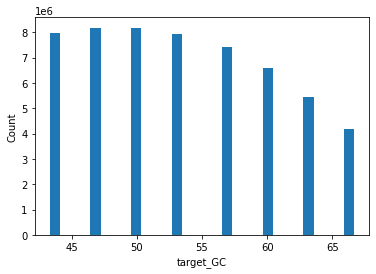

Wall time: 5min


In [21]:
%%time
# Filter GC cotent and plot the GC content after filtering
filters.filter_probe_dict_by_metric(probe_dict, 'target_GC', lower_bound=43, upper_bound=70)
plot.plot_hist(probe_dict, column_key='target_GC')

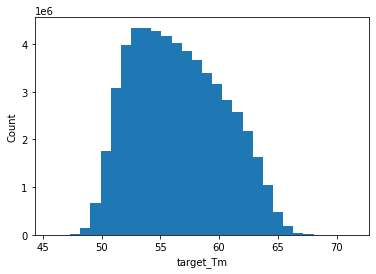

Wall time: 1h 5min 5s


In [22]:
%%time
# Calculate and plot the melting-temperatures (Tm)
filters.calc_tm_for_probe_dict(probe_dict, Na_conc=390, fmd_percentile=30, probe_conc=5,
                              column_key_seq='target_sequence', column_key_write='target_Tm')
plot.plot_hist(probe_dict, column_key='target_Tm')

ENSG00000000003
	ENST00000373020: 1332 / 1373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000000005
	ENST00000373031: 579 / 590 probes passed the filter 50 < target_Tm <  inf.
ENSG00000000419
	ENST00000371588: 316 / 322 probes passed the filter 50 < target_Tm <  inf.
ENSG00000000457
	ENST00000367770: 1710 / 1764 probes passed the filter 50 < target_Tm <  inf.
ENSG00000000460
	ENST00000359326: 1824 / 1905 probes passed the filter 50 < target_Tm <  inf.
ENSG00000000938
	ENST00000374003: 1806 / 1807 probes passed the filter 50 < target_Tm <  inf.
ENSG00000000971
	ENST00000367429: 1444 / 1491 probes passed the filter 50 < target_Tm <  inf.
ENSG00000001036
	ENST00000002165: 1069 / 1081 probes passed the filter 50 < target_Tm <  inf.
ENSG00000001084
	ENST00000650454: 1325 / 1365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000001167
	ENST00000353205: 1307 / 1326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000001460
	ENST00000337248: 1883 / 1901 probes passed the 

	ENST00000322813: 2170 / 2178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005243
	ENST00000621465: 675 / 682 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005249
	ENST00000265717: 831 / 857 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005302
	ENST00000647869: 1107 / 1125 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005339
	ENST00000262367: 6664 / 6704 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005379
	ENST00000268893: 5291 / 5298 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005381
	ENST00000225275: 2481 / 2496 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005421
	ENST00000222381: 1073 / 1116 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005436
	ENST00000321027: 1092 / 1133 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005448
	ENST00000348227: 1000 / 1001 probes passed the filter 50 < target_Tm <  inf.
ENSG00000005469
	ENST00000331536: 1274 / 1310 probes passed the filter 50 < targ

	ENST00000007264: 1154 / 1155 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007384
	ENST00000262316: 2137 / 2142 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007392
	ENST00000293872: 810 / 837 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007402
	ENST00000479441: 2838 / 2862 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007516
	ENST00000426824: 3159 / 3168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007520
	ENST00000007390: 609 / 610 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007541
	ENST00000409527: 1155 / 1157 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007545
	ENST00000293925: 5328 / 5368 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007866
	ENST00000639578: 1162 / 1169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007908
	ENST00000333360: 2102 / 2163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000007923
	ENST00000377577: 2432 / 2455 probes passed the filter 50 < targ

	ENST00000393119: 1929 / 1940 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011198
	ENST00000644371: 1609 / 1648 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011201
	ENST00000262648: 2208 / 2262 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011243
	ENST00000397410: 1540 / 1546 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011258
	ENST00000415868: 1750 / 1800 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011260
	ENST00000225298: 688 / 716 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011275
	ENST00000425013: 3753 / 3827 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011295
	ENST00000261647: 1087 / 1139 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011304
	ENST00000350092: 1757 / 1769 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011332
	ENST00000456296: 1049 / 1051 probes passed the filter 50 < target_Tm <  inf.
ENSG00000011347
	ENST00000542836: 1067 / 1071 probes passed the filter 50 < ta

	ENST00000683152: 7804 / 7861 probes passed the filter 50 < target_Tm <  inf.
ENSG00000019505
	ENST00000020926: 2852 / 2907 probes passed the filter 50 < target_Tm <  inf.
ENSG00000019549
	ENST00000020945: 874 / 884 probes passed the filter 50 < target_Tm <  inf.
ENSG00000019582
	ENST00000009530: 1445 / 1445 probes passed the filter 50 < target_Tm <  inf.
ENSG00000019991
	ENST00000457544: 1289 / 1324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000019995
	ENST00000359653: 2456 / 2520 probes passed the filter 50 < target_Tm <  inf.
ENSG00000020129
	ENST00000356090: 2477 / 2480 probes passed the filter 50 < target_Tm <  inf.
ENSG00000020181
	ENST00000412232: 4143 / 4160 probes passed the filter 50 < target_Tm <  inf.
ENSG00000020219
	ENST00000465400: 1323 / 1331 probes passed the filter 50 < target_Tm <  inf.
ENSG00000020256
	ENST00000361387: 1952 / 1966 probes passed the filter 50 < target_Tm <  inf.
ENSG00000020426
	ENST00000261245: 770 / 796 probes passed the filter 50 < targ

ENSG00000034239
	ENST00000262103: 839 / 850 probes passed the filter 50 < target_Tm <  inf.
ENSG00000034510
	ENST00000233143: 327 / 327 probes passed the filter 50 < target_Tm <  inf.
ENSG00000034533
	ENST00000264992: 1643 / 1668 probes passed the filter 50 < target_Tm <  inf.
ENSG00000034677
	ENST00000341084: 1607 / 1635 probes passed the filter 50 < target_Tm <  inf.
ENSG00000034693
	ENST00000367591: 838 / 856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000034713
	ENST00000037243: 437 / 447 probes passed the filter 50 < target_Tm <  inf.
ENSG00000034971
	ENST00000037502: 1524 / 1545 probes passed the filter 50 < target_Tm <  inf.
ENSG00000035115
	ENST00000356150: 608 / 618 probes passed the filter 50 < target_Tm <  inf.
ENSG00000035141
	ENST00000037869: 912 / 929 probes passed the filter 50 < target_Tm <  inf.
ENSG00000035403
	ENST00000211998: 3759 / 3799 probes passed the filter 50 < target_Tm <  inf.
ENSG00000035499
	ENST00000265036: 911 / 923 probes passed the filter 50 

	ENST00000265018: 3833 / 3892 probes passed the filter 50 < target_Tm <  inf.
ENSG00000047849
	ENST00000395734: 4116 / 4189 probes passed the filter 50 < target_Tm <  inf.
ENSG00000047932
	ENST00000052569: 1486 / 1531 probes passed the filter 50 < target_Tm <  inf.
ENSG00000047936
	ENST00000368507: 4032 / 4117 probes passed the filter 50 < target_Tm <  inf.
ENSG00000048028
	ENST00000003302: 2498 / 2579 probes passed the filter 50 < target_Tm <  inf.
ENSG00000048052
	ENST00000401921: 2544 / 2585 probes passed the filter 50 < target_Tm <  inf.
ENSG00000048140
	ENST00000515708: 1722 / 1746 probes passed the filter 50 < target_Tm <  inf.
ENSG00000048162
	ENST00000614830: 669 / 675 probes passed the filter 50 < target_Tm <  inf.
ENSG00000048342
	ENST00000424120: 3124 / 3222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000048392
	ENST00000251810: 1122 / 1183 probes passed the filter 50 < target_Tm <  inf.
ENSG00000048405
	ENST00000393312: 600 / 627 probes passed the filter 50 < targ

	ENST00000312010: 4208 / 4222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000055609
	ENST00000679882: 9330 / 9536 probes passed the filter 50 < target_Tm <  inf.
ENSG00000055732
	ENST00000370589: 851 / 906 probes passed the filter 50 < target_Tm <  inf.
ENSG00000055813
	ENST00000407595: 1613 / 1643 probes passed the filter 50 < target_Tm <  inf.
ENSG00000055917
	ENST00000338086: 2671 / 2729 probes passed the filter 50 < target_Tm <  inf.
ENSG00000055950
	ENST00000370236: 593 / 601 probes passed the filter 50 < target_Tm <  inf.
ENSG00000055955
	ENST00000406595: 2575 / 2583 probes passed the filter 50 < target_Tm <  inf.
ENSG00000055957
	ENST00000273283: 2551 / 2563 probes passed the filter 50 < target_Tm <  inf.
ENSG00000056050
	ENST00000393381: 357 / 385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000056097
	ENST00000265069: 2174 / 2248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000056277
	ENST00000370978: 1571 / 1626 probes passed the filter 50 < target

	ENST00000434704: 1861 / 1862 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064199
	ENST00000227135: 1771 / 1831 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064201
	ENST00000381121: 750 / 750 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064205
	ENST00000190983: 760 / 760 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064218
	ENST00000190165: 1218 / 1232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064225
	ENST00000483910: 1160 / 1184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064270
	ENST00000262429: 2652 / 2670 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064300
	ENST00000172229: 2233 / 2238 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064309
	ENST00000263577: 2933 / 3010 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064313
	ENST00000378164: 1897 / 1936 probes passed the filter 50 < target_Tm <  inf.
ENSG00000064393
	ENST00000428878: 3063 / 3079 probes passed the filter 50 < targ

	ENST00000340126: 2476 / 2565 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067082
	ENST00000497571: 2294 / 2318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067113
	ENST00000307259: 631 / 642 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067141
	ENST00000558964: 3098 / 3151 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067167
	ENST00000262213: 641 / 657 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067177
	ENST00000373542: 3516 / 3621 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067182
	ENST00000162749: 1518 / 1530 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067191
	ENST00000344140: 1396 / 1397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067208
	ENST00000684568: 2495 / 2603 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067221
	ENST00000541638: 4050 / 4080 probes passed the filter 50 < target_Tm <  inf.
ENSG00000067225
	ENST00000568459: 1593 / 1615 probes passed the filter 50 < targ

ENSG00000070610
	ENST00000378103: 3000 / 3017 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070614
	ENST00000261797: 6152 / 6168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070669
	ENST00000394309: 1108 / 1153 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070718
	ENST00000396926: 2081 / 2130 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070729
	ENST00000564448: 3298 / 3330 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070731
	ENST00000225276: 1288 / 1301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070748
	ENST00000395559: 1701 / 1713 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070756
	ENST00000522658: 1262 / 1274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070759
	ENST00000372086: 2272 / 2303 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070761
	ENST00000262498: 794 / 809 probes passed the filter 50 < target_Tm <  inf.
ENSG00000070770
	ENST00000262506: 974 / 988 probes passed the 

	ENST00000177694: 1413 / 1424 probes passed the filter 50 < target_Tm <  inf.
ENSG00000073905
	ENST00000439229: 645 / 650 probes passed the filter 50 < target_Tm <  inf.
ENSG00000073910
	ENST00000642040: 6886 / 7022 probes passed the filter 50 < target_Tm <  inf.
ENSG00000073921
	ENST00000532317: 1275 / 1302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000073969
	ENST00000398238: 2168 / 2219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000074047
	ENST00000452319: 2838 / 2839 probes passed the filter 50 < target_Tm <  inf.
ENSG00000074054
	ENST00000455322: 3799 / 3868 probes passed the filter 50 < target_Tm <  inf.
ENSG00000074071
	ENST00000397375: 551 / 551 probes passed the filter 50 < target_Tm <  inf.
ENSG00000074181
	ENST00000263388: 5148 / 5156 probes passed the filter 50 < target_Tm <  inf.
ENSG00000074201
	ENST00000528364: 521 / 546 probes passed the filter 50 < target_Tm <  inf.
ENSG00000074211
	ENST00000382599: 2849 / 2883 probes passed the filter 50 < target

	ENST00000160382: 1206 / 1207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077092
	ENST00000330688: 1601 / 1646 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077097
	ENST00000435706: 1476 / 1531 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077147
	ENST00000371142: 1229 / 1270 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077150
	ENST00000189444: 2013 / 2033 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077152
	ENST00000646651: 522 / 530 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077157
	ENST00000608999: 9945 / 10160 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077232
	ENST00000264065: 6389 / 6538 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077235
	ENST00000561623: 5495 / 5516 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077238
	ENST00000543915: 2822 / 2830 probes passed the filter 50 < target_Tm <  inf.
ENSG00000077254
	ENST00000370794: 1448 / 1481 probes passed the filter 50 < t

	ENST00000617270: 2971 / 3078 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080345
	ENST00000428287: 2079 / 2171 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080371
	ENST00000261263: 4493 / 4607 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080493
	ENST00000649996: 2504 / 2581 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080503
	ENST00000382194: 3509 / 3610 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080511
	ENST00000591589: 1204 / 1213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080546
	ENST00000356644: 1010 / 1025 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080561
	ENST00000443968: 1517 / 1550 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080572
	ENST00000336387: 402 / 445 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080573
	ENST00000264828: 3891 / 3904 probes passed the filter 50 < target_Tm <  inf.
ENSG00000080603
	ENST00000262518: 9507 / 9580 probes passed the filter 50 < ta

	ENST00000441802: 9562 / 9815 probes passed the filter 50 < target_Tm <  inf.
ENSG00000083896
	ENST00000579690: 1383 / 1468 probes passed the filter 50 < target_Tm <  inf.
ENSG00000083937
	ENST00000263780: 436 / 461 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084070
	ENST00000372718: 1889 / 1905 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084072
	ENST00000324379: 3325 / 3364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084073
	ENST00000372759: 854 / 887 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084090
	ENST00000337288: 1825 / 1860 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084092
	ENST00000264230: 1098 / 1103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084093
	ENST00000309042: 2571 / 2636 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084110
	ENST00000261208: 2525 / 2556 probes passed the filter 50 < target_Tm <  inf.
ENSG00000084112
	ENST00000551165: 1571 / 1587 probes passed the filter 50 < targ

	ENST00000281741: 1245 / 1299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087302
	ENST00000261700: 2655 / 2731 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087303
	ENST00000216286: 3400 / 3436 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087338
	ENST00000282570: 1014 / 1036 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087365
	ENST00000322535: 2626 / 2684 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087448
	ENST00000381271: 2508 / 2541 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087460
	ENST00000265620: 1093 / 1103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087470
	ENST00000547312: 1055 / 1101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087494
	ENST00000539239: 568 / 571 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087495
	ENST00000355648: 1418 / 1456 probes passed the filter 50 < target_Tm <  inf.
ENSG00000087502
	ENST00000360150: 1218 / 1261 probes passed the filter 50 < ta

	ENST00000367459: 443 / 459 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090238
	ENST00000563788: 420 / 421 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090263
	ENST00000496958: 359 / 369 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090266
	ENST00000247866: 336 / 343 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090273
	ENST00000321265: 1312 / 1336 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090316
	ENST00000303400: 1318 / 1337 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090339
	ENST00000264832: 2381 / 2394 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090372
	ENST00000263280: 2058 / 2073 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090376
	ENST00000261233: 3236 / 3324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090382
	ENST00000261267: 663 / 677 probes passed the filter 50 < target_Tm <  inf.
ENSG00000090402
	ENST00000264382: 2000 / 2071 probes passed the filter 50 < target_Tm 

	ENST00000347635: 2348 / 2396 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093009
	ENST00000263201: 1375 / 1383 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093010
	ENST00000406520: 956 / 963 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093072
	ENST00000543038: 2966 / 3014 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093100
	ENST00000476405: 3091 / 3123 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093134
	ENST00000544102: 277 / 284 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093144
	ENST00000430841: 460 / 485 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093167
	ENST00000354379: 1184 / 1223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093183
	ENST00000264454: 3604 / 3655 probes passed the filter 50 < target_Tm <  inf.
ENSG00000093217
	ENST00000207870: 2370 / 2413 probes passed the filter 50 < target_Tm <  inf.
ENSG00000094631
	ENST00000643374: 3418 / 3425 probes passed the filter 50 < target

ENSG00000099812
	ENST00000215582: 1996 / 1997 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099814
	ENST00000556508: 3517 / 3524 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099817
	ENST00000586746: 839 / 839 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099821
	ENST00000588649: 2213 / 2217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099822
	ENST00000251287: 1559 / 1561 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099834
	ENST00000349570: 1488 / 1497 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099840
	ENST00000395307: 609 / 609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099849
	ENST00000454668: 949 / 949 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099860
	ENST00000215631: 925 / 926 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099864
	ENST00000338448: 1547 / 1547 probes passed the filter 50 < target_Tm <  inf.
ENSG00000099866
	ENST00000346144: 535 / 546 probes passed the filter

	ENST00000216101: 618 / 619 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100280
	ENST00000357586: 3196 / 3216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100281
	ENST00000216106: 2213 / 2274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100284
	ENST00000449058: 1751 / 1759 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100285
	ENST00000310624: 2656 / 2689 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100288
	ENST00000406938: 1019 / 1023 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100290
	ENST00000216115: 516 / 521 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100292
	ENST00000216117: 1154 / 1156 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100294
	ENST00000290429: 1368 / 1373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100296
	ENST00000397873: 2022 / 2055 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100297
	ENST00000216122: 2708 / 2733 probes passed the filter 50 < targ

	ENST00000534137: 2295 / 2329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100697
	ENST00000527414: 3025 / 3125 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100711
	ENST00000311141: 761 / 770 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100714
	ENST00000652337: 2222 / 2272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100721
	ENST00000555202: 513 / 513 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100722
	ENST00000318308: 541 / 568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100726
	ENST00000262319: 1824 / 1826 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100731
	ENST00000439984: 4246 / 4435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100739
	ENST00000611804: 804 / 804 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100744
	ENST00000554182: 389 / 399 probes passed the filter 50 < target_Tm <  inf.
ENSG00000100749
	ENST00000679903: 592 / 605 probes passed the filter 50 < target_Tm < 

	ENST00000378789: 1017 / 1037 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101327
	ENST00000540134: 1685 / 1736 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101331
	ENST00000452892: 1486 / 1493 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101333
	ENST00000685823: 2133 / 2192 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101335
	ENST00000279022: 2186 / 2188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101336
	ENST00000518730: 1553 / 1556 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101337
	ENST00000398022: 3008 / 3067 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101342
	ENST00000602922: 858 / 864 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101343
	ENST00000536226: 1439 / 1537 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101346
	ENST00000375749: 3665 / 3697 probes passed the filter 50 < target_Tm <  inf.
ENSG00000101347
	ENST00000646673: 2534 / 2582 probes passed the filter 50 < ta

	ENST00000218200: 1084 / 1119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102096
	ENST00000376509: 1475 / 1485 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102098
	ENST00000251900: 1729 / 1763 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102100
	ENST00000247138: 1049 / 1057 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102103
	ENST00000443648: 745 / 747 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102104
	ENST00000379984: 1941 / 1957 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102109
	ENST00000218230: 183 / 183 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102119
	ENST00000683627: 683 / 708 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102125
	ENST00000612460: 1247 / 1256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102128
	ENST00000218249: 764 / 766 probes passed the filter 50 < target_Tm <  inf.
ENSG00000102144
	ENST00000373316: 2386 / 2437 probes passed the filter 50 < target_T

	ENST00000219334: 2993 / 3011 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103061
	ENST00000263997: 2630 / 2690 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103064
	ENST00000219343: 4147 / 4219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103066
	ENST00000219345: 2213 / 2224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103067
	ENST00000565858: 2546 / 2562 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103089
	ENST00000219368: 1482 / 1485 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103091
	ENST00000262144: 4237 / 4277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103111
	ENST00000248248: 3459 / 3479 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103121
	ENST00000565914: 265 / 273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103126
	ENST00000354866: 2173 / 2185 probes passed the filter 50 < target_Tm <  inf.
ENSG00000103145
	ENST00000248089: 416 / 416 probes passed the filter 50 < targ

	ENST00000261868: 520 / 540 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104133
	ENST00000559511: 3462 / 3563 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104140
	ENST00000220507: 1170 / 1176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104142
	ENST00000220509: 3173 / 3179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104147
	ENST00000220514: 460 / 470 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104154
	ENST00000261867: 2289 / 2354 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104164
	ENST00000220531: 1153 / 1186 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104177
	ENST00000267836: 989 / 1003 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104205
	ENST00000522398: 938 / 965 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104213
	ENST00000251630: 1070 / 1083 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104218
	ENST00000678645: 1793 / 1858 probes passed the filter 50 < target_

	ENST00000221543: 1457 / 1459 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104951
	ENST00000391826: 1184 / 1185 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104953
	ENST00000452088: 1561 / 1567 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104957
	ENST00000221554: 1088 / 1091 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104960
	ENST00000599732: 1028 / 1035 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104964
	ENST00000327141: 975 / 1005 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104967
	ENST00000263257: 5587 / 5645 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104969
	ENST00000221566: 1557 / 1560 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104970
	ENST00000434659: 994 / 1009 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104972
	ENST00000396317: 1585 / 1588 probes passed the filter 50 < target_Tm <  inf.
ENSG00000104973
	ENST00000593767: 2324 / 2369 probes passed the filter 50 < ta

	ENST00000588216: 2690 / 2707 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105583
	ENST00000222190: 484 / 488 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105605
	ENST00000222212: 739 / 747 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105607
	ENST00000222214: 1427 / 1439 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105609
	ENST00000449561: 1992 / 2022 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105610
	ENST00000264834: 869 / 869 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105612
	ENST00000222219: 1526 / 1531 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105613
	ENST00000251472: 3246 / 3266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105617
	ENST00000222224: 841 / 844 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105618
	ENST00000321030: 1314 / 1317 probes passed the filter 50 < target_Tm <  inf.
ENSG00000105619
	ENST00000391759: 852 / 852 probes passed the filter 50 < target_Tm 

	ENST00000310447: 2704 / 2755 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106153
	ENST00000395422: 472 / 480 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106178
	ENST00000416943: 480 / 481 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106211
	ENST00000248553: 380 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106236
	ENST00000265634: 1599 / 1621 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106244
	ENST00000350498: 1790 / 1839 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106245
	ENST00000222969: 671 / 681 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106246
	ENST00000292478: 4133 / 4160 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106258
	ENST00000222982: 1009 / 1053 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106261
	ENST00000324306: 5134 / 5218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000106263
	ENST00000397011: 1876 / 1906 probes passed the filter 50 < target_T

	ENST00000353704: 1157 / 1190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107185
	ENST00000378078: 4947 / 5022 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107186
	ENST00000447879: 4044 / 4161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107187
	ENST00000371746: 1126 / 1134 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107201
	ENST00000379883: 1808 / 1885 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107223
	ENST00000224073: 491 / 493 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107242
	ENST00000265382: 1352 / 1376 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107249
	ENST00000381971: 4194 / 4288 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107262
	ENST00000379704: 678 / 690 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107263
	ENST00000372190: 4298 / 4332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000107281
	ENST00000371601: 648 / 648 probes passed the filter 50 < target

	ENST00000393066: 1958 / 2051 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108405
	ENST00000225538: 2152 / 2159 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108406
	ENST00000251241: 1333 / 1375 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108417
	ENST00000225550: 1432 / 1438 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108423
	ENST00000592426: 606 / 644 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108424
	ENST00000290158: 3467 / 3549 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108433
	ENST00000576910: 1390 / 1411 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108439
	ENST00000642017: 2632 / 2671 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108442
	ENST00000455082: 192 / 201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108443
	ENST00000225577: 1541 / 1576 probes passed the filter 50 < target_Tm <  inf.
ENSG00000108448
	ENST00000578086: 140 / 145 probes passed the filter 50 < target

	ENST00000226444: 567 / 576 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109205
	ENST00000396094: 624 / 640 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109208
	ENST00000226460: 471 / 482 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109220
	ENST00000263921: 315 / 317 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109255
	ENST00000505262: 230 / 242 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109265
	ENST00000541073: 2902 / 2918 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109270
	ENST00000499666: 1297 / 1318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109272
	ENST00000226524: 307 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109320
	ENST00000394820: 2307 / 2337 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109321
	ENST00000395748: 506 / 529 probes passed the filter 50 < target_Tm <  inf.
ENSG00000109323
	ENST00000647097: 2074 / 2124 probes passed the filter 50 < target_Tm <  i

	ENST00000227868: 1042 / 1054 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110436
	ENST00000278379: 4963 / 5119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110442
	ENST00000263401: 1930 / 1962 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110446
	ENST00000679573: 1569 / 1569 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110448
	ENST00000347785: 2427 / 2444 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110455
	ENST00000263776: 1960 / 1965 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110484
	ENST00000227918: 193 / 196 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110492
	ENST00000395566: 488 / 488 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110497
	ENST00000528950: 3488 / 3497 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110514
	ENST00000395344: 4175 / 4224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000110536
	ENST00000326674: 1555 / 1577 probes passed the filter 50 < targ

	ENST00000229135: 378 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111540
	ENST00000553116: 2335 / 2367 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111554
	ENST00000682720: 1217 / 1267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111581
	ENST00000229179: 2658 / 2706 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111596
	ENST00000550641: 1597 / 1631 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111602
	ENST00000229201: 3536 / 3609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111605
	ENST00000266679: 1200 / 1233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111615
	ENST00000229214: 2773 / 2881 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111639
	ENST00000229238: 525 / 539 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111640
	ENST00000396859: 1041 / 1045 probes passed the filter 50 < target_Tm <  inf.
ENSG00000111641
	ENST00000537442: 2347 / 2360 probes passed the filter 50 < targ

	ENST00000262901: 2169 / 2216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112249
	ENST00000369162: 2942 / 3093 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112273
	ENST00000510882: 1318 / 1330 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112276
	ENST00000446408: 627 / 665 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112280
	ENST00000357250: 2341 / 2367 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112282
	ENST00000368058: 2257 / 2353 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112290
	ENST00000392587: 1215 / 1240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112293
	ENST00000230036: 3298 / 3352 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112294
	ENST00000357578: 2603 / 2631 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112297
	ENST00000633556: 5044 / 5154 probes passed the filter 50 < target_Tm <  inf.
ENSG00000112299
	ENST00000367928: 1689 / 1743 probes passed the filter 50 < ta

	ENST00000523175: 997 / 1040 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113262
	ENST00000517717: 3790 / 3856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113263
	ENST00000422843: 2692 / 2764 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113269
	ENST00000521389: 954 / 970 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113272
	ENST00000231198: 1905 / 1932 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113273
	ENST00000264914: 3035 / 3084 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113282
	ENST00000523908: 1434 / 1472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113296
	ENST00000350881: 2375 / 2394 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113300
	ENST00000261951: 1953 / 2027 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113302
	ENST00000231228: 1322 / 1342 probes passed the filter 50 < target_Tm <  inf.
ENSG00000113303
	ENST00000340184: 1625 / 1642 probes passed the filter 50 < tar

	ENST00000357559: 2205 / 2272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114423
	ENST00000394030: 2863 / 2950 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114439
	ENST00000406780: 2137 / 2186 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114446
	ENST00000264538: 1089 / 1113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114450
	ENST00000674862: 639 / 659 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114455
	ENST00000491820: 560 / 582 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114473
	ENST00000455191: 1000 / 1030 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114480
	ENST00000429644: 1165 / 1188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114487
	ENST00000483760: 1075 / 1129 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114491
	ENST00000232607: 4646 / 4712 probes passed the filter 50 < target_Tm <  inf.
ENSG00000114503
	ENST00000321256: 843 / 852 probes passed the filter 50 < target

	ENST00000233668: 1500 / 1502 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115339
	ENST00000392701: 953 / 969 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115350
	ENST00000483063: 539 / 560 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115353
	ENST00000305249: 3312 / 3380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115355
	ENST00000642200: 2385 / 2501 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115361
	ENST00000233710: 865 / 882 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115363
	ENST00000410071: 614 / 625 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115364
	ENST00000409374: 472 / 489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115365
	ENST00000431941: 908 / 924 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115368
	ENST00000314761: 1018 / 1052 probes passed the filter 50 < target_Tm <  inf.
ENSG00000115380
	ENST00000355426: 1240 / 1272 probes passed the filter 50 < target_Tm < 

	ENST00000378529: 926 / 934 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116157
	ENST00000361314: 789 / 792 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116161
	ENST00000367679: 854 / 867 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116171
	ENST00000371514: 1107 / 1117 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116176
	ENST00000234798: 523 / 526 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116183
	ENST00000367662: 7038 / 7163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116191
	ENST00000367634: 1824 / 1888 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116194
	ENST00000367629: 920 / 946 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116198
	ENST00000674558: 3643 / 3686 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116199
	ENST00000263733: 2819 / 2900 probes passed the filter 50 < target_Tm <  inf.
ENSG00000116205
	ENST00000234827: 6522 / 6658 probes passed the filter 50 < target_Tm 

ENSG00000117091
	ENST00000368046: 686 / 686 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117114
	ENST00000370717: 2770 / 2846 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117115
	ENST00000375486: 3355 / 3388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117118
	ENST00000375499: 510 / 522 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117122
	ENST00000375534: 654 / 659 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117133
	ENST00000370654: 668 / 685 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117139
	ENST00000648056: 3851 / 3915 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117143
	ENST00000367926: 1261 / 1290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117148
	ENST00000617065: 1319 / 1325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117151
	ENST00000370630: 1063 / 1100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000117152
	ENST00000367909: 1317 / 1365 probes passed the filt

	ENST00000309446: 4688 / 4741 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118271
	ENST00000237014: 440 / 442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118276
	ENST00000306851: 1199 / 1220 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118292
	ENST00000369099: 316 / 321 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118298
	ENST00000647854: 1242 / 1273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118307
	ENST00000320267: 843 / 889 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118308
	ENST00000636465: 2125 / 2230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118322
	ENST00000327245: 5503 / 5608 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118363
	ENST00000532972: 494 / 503 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118369
	ENST00000529308: 3188 / 3222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000118402
	ENST00000369816: 704 / 718 probes passed the filter 50 < target_Tm 

	ENST00000509153: 1286 / 1291 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119608
	ENST00000556489: 2936 / 2998 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119614
	ENST00000261980: 2223 / 2235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119616
	ENST00000341162: 2038 / 2070 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119630
	ENST00000238607: 1124 / 1137 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119632
	ENST00000238609: 329 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119636
	ENST00000394009: 1142 / 1190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119638
	ENST00000238616: 5013 / 5096 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119640
	ENST00000555694: 211 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119650
	ENST00000314067: 555 / 566 probes passed the filter 50 < target_Tm <  inf.
ENSG00000119655
	ENST00000238633: 486 / 496 probes passed the filter 50 < target_T

	ENST00000321394: 1027 / 1057 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120440
	ENST00000649884: 1257 / 1273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120451
	ENST00000265909: 9195 / 9366 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120457
	ENST00000533599: 1166 / 1172 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120458
	ENST00000374979: 1001 / 1025 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120471
	ENST00000530777: 288 / 291 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120498
	ENST00000344304: 1195 / 1244 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120500
	ENST00000307959: 1006 / 1015 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120509
	ENST00000486461: 621 / 631 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120519
	ENST00000335472: 1151 / 1188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000120526
	ENST00000239690: 1100 / 1144 probes passed the filter 50 < targ

	ENST00000241014: 1741 / 1747 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121671
	ENST00000616080: 3474 / 3492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121680
	ENST00000378750: 1189 / 1190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121690
	ENST00000241051: 597 / 623 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121691
	ENST00000241052: 1341 / 1363 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121716
	ENST00000609309: 1066 / 1070 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121741
	ENST00000382871: 1757 / 1868 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121742
	ENST00000644667: 816 / 831 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121743
	ENST00000241125: 1972 / 2027 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121749
	ENST00000485960: 694 / 727 probes passed the filter 50 < target_Tm <  inf.
ENSG00000121753
	ENST00000398538: 2903 / 2919 probes passed the filter 50 < target

	ENST00000417172: 1325 / 1360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122787
	ENST00000242375: 1158 / 1177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122824
	ENST00000356450: 762 / 772 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122852
	ENST00000428376: 1622 / 1637 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122859
	ENST00000242462: 887 / 894 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122861
	ENST00000372764: 1681 / 1714 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122862
	ENST00000242465: 455 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122863
	ENST00000373115: 4861 / 4910 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122870
	ENST00000373886: 2326 / 2412 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122872
	ENST00000503220: 266 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000122873
	ENST00000333926: 467 / 475 probes passed the filter 50 < target_Tm 

	ENST00000404537: 3353 / 3358 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124019
	ENST00000243806: 1361 / 1365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124067
	ENST00000316341: 3628 / 3634 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124074
	ENST00000243878: 893 / 893 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124089
	ENST00000243911: 1003 / 1006 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124091
	ENST00000243913: 1135 / 1150 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124092
	ENST00000433949: 1552 / 1575 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124097
	ENST00000522557: 1018 / 1051 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124098
	ENST00000371384: 1392 / 1407 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124102
	ENST00000243924: 454 / 454 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124103
	ENST00000371328: 437 / 460 probes passed the filter 50 < target

	ENST00000359357: 5780 / 5995 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124731
	ENST00000589614: 598 / 614 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124733
	ENST00000645375: 783 / 799 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124743
	ENST00000407079: 851 / 896 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124749
	ENST00000535941: 1972 / 2002 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124762
	ENST00000373711: 521 / 525 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124766
	ENST00000244745: 2067 / 2087 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124767
	ENST00000373365: 650 / 663 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124772
	ENST00000244751: 2532 / 2550 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124780
	ENST00000373231: 1060 / 1070 probes passed the filter 50 < target_Tm <  inf.
ENSG00000124782
	ENST00000379938: 5271 / 5365 probes passed the filter 50 < target_Tm 

	ENST00000323060: 1435 / 1438 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125743
	ENST00000342669: 444 / 446 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125744
	ENST00000430715: 819 / 823 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125746
	ENST00000536630: 2076 / 2085 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125753
	ENST00000245932: 1243 / 1247 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125755
	ENST00000245934: 3228 / 3237 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125772
	ENST00000379019: 2145 / 2205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125775
	ENST00000339987: 1033 / 1043 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125779
	ENST00000610179: 5492 / 5565 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125780
	ENST00000381458: 2351 / 2374 probes passed the filter 50 < target_Tm <  inf.
ENSG00000125787
	ENST00000380346: 204 / 204 probes passed the filter 50 < target

	ENST00000381060: 136 / 140 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126550
	ENST00000246896: 44 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126561
	ENST00000590949: 2953 / 3005 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126562
	ENST00000246914: 3154 / 3162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126581
	ENST00000590099: 1293 / 1326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126583
	ENST00000263431: 2336 / 2342 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126602
	ENST00000246957: 1753 / 1775 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126603
	ENST00000433375: 2176 / 2176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126653
	ENST00000612959: 1101 / 1135 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126698
	ENST00000263697: 956 / 989 probes passed the filter 50 < target_Tm <  inf.
ENSG00000126705
	ENST00000642416: 3090 / 3091 probes passed the filter 50 < target_T

	ENST00000368547: 860 / 868 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127903
	ENST00000537055: 2092 / 2114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127914
	ENST00000491695: 2524 / 2681 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127920
	ENST00000248564: 1133 / 1160 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127922
	ENST00000248566: 222 / 237 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127928
	ENST00000429473: 140 / 148 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127946
	ENST00000336926: 5949 / 6035 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127947
	ENST00000248594: 999 / 1062 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127948
	ENST00000461988: 1785 / 1798 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127951
	ENST00000248598: 1127 / 1152 probes passed the filter 50 < target_Tm <  inf.
ENSG00000127952
	ENST00000431581: 889 / 895 probes passed the filter 50 < target_Tm

	ENST00000249750: 2165 / 2203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000128923
	ENST00000450403: 1650 / 1687 probes passed the filter 50 < target_Tm <  inf.
ENSG00000128928
	ENST00000487418: 3310 / 3328 probes passed the filter 50 < target_Tm <  inf.
ENSG00000128944
	ENST00000249776: 1024 / 1055 probes passed the filter 50 < target_Tm <  inf.
ENSG00000128951
	ENST00000455976: 541 / 550 probes passed the filter 50 < target_Tm <  inf.
ENSG00000128965
	ENST00000617768: 1088 / 1098 probes passed the filter 50 < target_Tm <  inf.
ENSG00000128973
	ENST00000249806: 1615 / 1639 probes passed the filter 50 < target_Tm <  inf.
ENSG00000128989
	ENST00000569281: 297 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000129003
	ENST00000249837: 4685 / 4885 probes passed the filter 50 < target_Tm <  inf.
ENSG00000129007
	ENST00000467889: 2025 / 2054 probes passed the filter 50 < target_Tm <  inf.
ENSG00000129009
	ENST00000395118: 1668 / 1678 probes passed the filter 50 < targ

	ENST00000270517: 1204 / 1207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130164
	ENST00000557933: 2524 / 2529 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130165
	ENST00000590700: 510 / 513 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130167
	ENST00000590327: 802 / 813 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130173
	ENST00000252453: 620 / 620 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130175
	ENST00000589838: 1482 / 1486 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130176
	ENST00000252456: 1118 / 1118 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130177
	ENST00000252457: 988 / 1013 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130182
	ENST00000576985: 1318 / 1318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130193
	ENST00000336138: 1270 / 1276 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130202
	ENST00000252485: 1383 / 1383 probes passed the filter 50 < target_

	ENST00000253083: 2987 / 2997 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130803
	ENST00000247956: 3023 / 3080 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130810
	ENST00000253107: 1679 / 1689 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130811
	ENST00000253108: 847 / 860 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130812
	ENST00000592641: 1059 / 1062 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130813
	ENST00000253110: 1358 / 1361 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130816
	ENST00000340748: 3846 / 3918 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130818
	ENST00000535489: 1347 / 1382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130821
	ENST00000253122: 2412 / 2431 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130822
	ENST00000340888: 1060 / 1065 probes passed the filter 50 < target_Tm <  inf.
ENSG00000130826
	ENST00000696575: 1386 / 1415 probes passed the filter 50 < ta

	ENST00000253925: 2942 / 2989 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131634
	ENST00000253934: 886 / 890 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131650
	ENST00000319500: 845 / 845 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131652
	ENST00000326266: 1033 / 1033 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131653
	ENST00000326181: 2600 / 2601 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131668
	ENST00000253968: 549 / 549 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131669
	ENST00000375446: 937 / 941 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131686
	ENST00000377436: 766 / 768 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131697
	ENST00000622020: 2356 / 2361 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131711
	ENST00000296755: 6629 / 6918 probes passed the filter 50 < target_Tm <  inf.
ENSG00000131721
	ENST00000371388: 1559 / 1579 probes passed the filter 50 < target_Tm 

	ENST00000573542: 736 / 744 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132510
	ENST00000254846: 4057 / 4073 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132514
	ENST00000571664: 1034 / 1043 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132517
	ENST00000254853: 1727 / 1732 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132518
	ENST00000254854: 2186 / 2194 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132522
	ENST00000380728: 881 / 905 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132530
	ENST00000361842: 1504 / 1544 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132535
	ENST00000302955: 2388 / 2397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132541
	ENST00000254878: 345 / 348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132549
	ENST00000357162: 7159 / 7362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000132554
	ENST00000523437: 1128 / 1225 probes passed the filter 50 < target

	ENST00000372054: 528 / 542 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133138
	ENST00000276175: 1174 / 1247 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133142
	ENST00000415568: 532 / 547 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133169
	ENST00000372728: 440 / 445 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133193
	ENST00000403627: 1176 / 1216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133195
	ENST00000255559: 1866 / 1904 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133216
	ENST00000374632: 2992 / 3008 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133226
	ENST00000374389: 1979 / 2022 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133243
	ENST00000255608: 1511 / 1513 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133246
	ENST00000423345: 1426 / 1434 probes passed the filter 50 < target_Tm <  inf.
ENSG00000133247
	ENST00000255613: 1222 / 1224 probes passed the filter 50 < target

	ENST00000369904: 1179 / 1186 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134240
	ENST00000369406: 1866 / 1879 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134242
	ENST00000359785: 940 / 985 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134243
	ENST00000256637: 3967 / 4048 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134245
	ENST00000369684: 6116 / 6254 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134247
	ENST00000393203: 4043 / 4102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134248
	ENST00000602318: 315 / 326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134249
	ENST00000369400: 1528 / 1559 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134250
	ENST00000256646: 8071 / 8210 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134253
	ENST00000256649: 2480 / 2498 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134255
	ENST00000357172: 786 / 815 probes passed the filter 50 < target

	ENST00000529196: 1769 / 1793 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134917
	ENST00000257359: 2206 / 2211 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134940
	ENST00000527795: 513 / 522 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134954
	ENST00000319397: 1513 / 1531 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134955
	ENST00000308074: 2306 / 2325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134962
	ENST00000257408: 2727 / 2795 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134970
	ENST00000456936: 694 / 725 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134982
	ENST00000508376: 4469 / 4609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134986
	ENST00000508870: 299 / 300 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134987
	ENST00000513710: 1925 / 1991 probes passed the filter 50 < target_Tm <  inf.
ENSG00000134996
	ENST00000346234: 604 / 610 probes passed the filter 50 < target_T

	ENST00000258052: 1165 / 1165 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135596
	ENST00000358807: 2616 / 2620 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135597
	ENST00000367663: 1441 / 1477 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135604
	ENST00000367568: 2331 / 2373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135605
	ENST00000381501: 2042 / 2105 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135617
	ENST00000258083: 783 / 787 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135622
	ENST00000357877: 4595 / 4660 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135624
	ENST00000258091: 1460 / 1485 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135625
	ENST00000436467: 1112 / 1114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135631
	ENST00000258098: 3162 / 3172 probes passed the filter 50 < target_Tm <  inf.
ENSG00000135632
	ENST00000389501: 2165 / 2187 probes passed the filter 50 < ta

	ENST00000652520: 1228 / 1238 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136213
	ENST00000258711: 11425 / 11487 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136231
	ENST00000258729: 1781 / 1828 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136235
	ENST00000647578: 1646 / 1702 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136237
	ENST00000665637: 3517 / 3626 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136238
	ENST00000348035: 995 / 1018 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136240
	ENST00000258739: 1251 / 1274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136243
	ENST00000258742: 709 / 720 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136244
	ENST00000258743: 624 / 643 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136247
	ENST00000405731: 972 / 985 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136250
	ENST00000617537: 1604 / 1639 probes passed the filter 50 < targe

	ENST00000674556: 1053 / 1075 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136883
	ENST00000640217: 1453 / 1461 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136888
	ENST00000374050: 615 / 625 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136891
	ENST00000374902: 1539 / 1591 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136895
	ENST00000435213: 2401 / 2457 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136897
	ENST00000374865: 892 / 927 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136908
	ENST00000314392: 709 / 713 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136918
	ENST00000373574: 1010 / 1010 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136925
	ENST00000341170: 2447 / 2490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136928
	ENST00000259455: 3644 / 3694 probes passed the filter 50 < target_Tm <  inf.
ENSG00000136929
	ENST00000616898: 692 / 719 probes passed the filter 50 < target_T

	ENST00000404995: 1796 / 1803 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137509
	ENST00000313010: 1396 / 1463 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137513
	ENST00000281038: 1110 / 1138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137522
	ENST00000361756: 1928 / 1964 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137547
	ENST00000260102: 987 / 1016 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137558
	ENST00000523773: 649 / 657 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137561
	ENST00000260116: 769 / 792 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137563
	ENST00000260118: 376 / 385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137571
	ENST00000260126: 3866 / 3928 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137573
	ENST00000419716: 2623 / 2678 probes passed the filter 50 < target_Tm <  inf.
ENSG00000137574
	ENST00000260129: 1894 / 1935 probes passed the filter 50 < target_

	ENST00000358334: 4426 / 4525 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138131
	ENST00000260702: 2653 / 2691 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138134
	ENST00000371926: 860 / 886 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138135
	ENST00000371852: 877 / 885 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138136
	ENST00000370193: 755 / 763 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138138
	ENST00000328142: 765 / 794 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138152
	ENST00000260723: 1380 / 1388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138160
	ENST00000260731: 1522 / 1590 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138161
	ENST00000392790: 901 / 935 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138162
	ENST00000260733: 2731 / 2768 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138166
	ENST00000369583: 1415 / 1435 probes passed the filter 50 < target_Tm 

	ENST00000265164: 809 / 817 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138795
	ENST00000438313: 1107 / 1125 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138796
	ENST00000403312: 1105 / 1122 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138798
	ENST00000265171: 3279 / 3350 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138801
	ENST00000265174: 1400 / 1453 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138802
	ENST00000399100: 1902 / 1966 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138813
	ENST00000326581: 774 / 805 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138814
	ENST00000394853: 1336 / 1362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138821
	ENST00000683412: 966 / 991 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138823
	ENST00000457717: 1930 / 1987 probes passed the filter 50 < target_Tm <  inf.
ENSG00000138829
	ENST00000262464: 7106 / 7197 probes passed the filter 50 < target

	ENST00000619791: 3609 / 3628 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139719
	ENST00000267199: 2738 / 2803 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139722
	ENST00000267202: 1496 / 1514 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139725
	ENST00000267205: 1849 / 1855 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139726
	ENST00000280557: 841 / 881 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139734
	ENST00000267215: 1249 / 1292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139737
	ENST00000488699: 970 / 1000 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139746
	ENST00000267229: 1419 / 1492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139767
	ENST00000267260: 5630 / 5755 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139780
	ENST00000267273: 690 / 731 probes passed the filter 50 < target_Tm <  inf.
ENSG00000139793
	ENST00000397601: 1367 / 1417 probes passed the filter 50 < targe

	ENST00000268164: 3999 / 4064 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140563
	ENST00000357742: 3382 / 3449 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140564
	ENST00000610579: 2751 / 2751 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140575
	ENST00000268182: 3926 / 4037 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140577
	ENST00000420329: 3755 / 3790 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140598
	ENST00000268206: 2184 / 2246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140600
	ENST00000427482: 685 / 709 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140612
	ENST00000268220: 479 / 492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140623
	ENST00000268231: 952 / 958 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140632
	ENST00000321919: 2553 / 2583 probes passed the filter 50 < target_Tm <  inf.
ENSG00000140650
	ENST00000268261: 1642 / 1661 probes passed the filter 50 < target

	ENST00000534050: 1417 / 1427 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141503
	ENST00000453408: 2960 / 2982 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141504
	ENST00000269298: 685 / 694 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141505
	ENST00000269299: 897 / 899 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141506
	ENST00000584803: 1987 / 2001 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141510
	ENST00000445888: 1830 / 1841 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141519
	ENST00000374877: 2755 / 2769 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141522
	ENST00000580685: 668 / 670 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141524
	ENST00000322914: 1668 / 1672 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141526
	ENST00000582743: 1590 / 1591 probes passed the filter 50 < target_Tm <  inf.
ENSG00000141527
	ENST00000344227: 2923 / 2937 probes passed the filter 50 < target

	ENST00000391857: 837 / 843 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142544
	ENST00000421832: 1025 / 1030 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142546
	ENST00000339093: 713 / 713 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142549
	ENST00000270642: 2340 / 2353 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142552
	ENST00000270645: 881 / 881 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142556
	ENST00000270649: 1581 / 1650 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142583
	ENST00000377424: 2914 / 2947 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142599
	ENST00000400908: 4908 / 4983 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142606
	ENST00000378412: 2249 / 2278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142609
	ENST00000493964: 4045 / 4070 probes passed the filter 50 < target_Tm <  inf.
ENSG00000142611
	ENST00000514189: 2718 / 2725 probes passed the filter 50 < target

	ENST00000271628: 988 / 994 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143369
	ENST00000369047: 1685 / 1690 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143373
	ENST00000336715: 3615 / 3635 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143374
	ENST00000369064: 2299 / 2332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143375
	ENST00000271636: 4099 / 4131 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143376
	ENST00000458013: 3827 / 3912 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143379
	ENST00000692314: 3555 / 3634 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143382
	ENST00000369038: 2911 / 2927 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143384
	ENST00000678770: 688 / 710 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143387
	ENST00000271651: 1077 / 1109 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143390
	ENST00000368870: 1890 / 1905 probes passed the filter 50 < targ

	ENST00000316470: 1125 / 1134 probes passed the filter 50 < target_Tm <  inf.
ENSG00000143995
	ENST00000398506: 1590 / 1624 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144010
	ENST00000639673: 993 / 1013 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144015
	ENST00000272395: 995 / 1017 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144021
	ENST00000488633: 2297 / 2320 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144026
	ENST00000411425: 1470 / 1510 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144028
	ENST00000323853: 6120 / 6214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144029
	ENST00000475040: 379 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144031
	ENST00000360589: 1334 / 1338 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144034
	ENST00000272424: 130 / 134 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144035
	ENST00000272425: 847 / 875 probes passed the filter 50 < target_T

	ENST00000273371: 1235 / 1255 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144840
	ENST00000273375: 2277 / 2341 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144843
	ENST00000465513: 935 / 945 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144847
	ENST00000393775: 1789 / 1805 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144848
	ENST00000283290: 589 / 612 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144852
	ENST00000337940: 2118 / 2149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144857
	ENST00000273395: 3102 / 3115 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144867
	ENST00000678299: 1621 / 1654 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144868
	ENST00000393130: 1475 / 1492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144891
	ENST00000461609: 618 / 638 probes passed the filter 50 < target_Tm <  inf.
ENSG00000144893
	ENST00000474524: 5117 / 5232 probes passed the filter 50 < target

	ENST00000354283: 1752 / 1856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145835
	ENST00000274516: 224 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145839
	ENST00000274520: 299 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145850
	ENST00000407087: 968 / 979 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145860
	ENST00000520638: 1319 / 1349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145861
	ENST00000652664: 1556 / 1571 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145863
	ENST00000274545: 1060 / 1091 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145864
	ENST00000353437: 1332 / 1356 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145868
	ENST00000513826: 1693 / 1761 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145879
	ENST00000274565: 320 / 337 probes passed the filter 50 < target_Tm <  inf.
ENSG00000145882
	ENST00000274569: 1757 / 1778 probes passed the filter 50 < target_T

	ENST00000454074: 988 / 1007 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146809
	ENST00000275699: 1333 / 1380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146826
	ENST00000316937: 1554 / 1558 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146828
	ENST00000354161: 2057 / 2061 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146830
	ENST00000646601: 3729 / 3733 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146833
	ENST00000349062: 1607 / 1670 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146834
	ENST00000310512: 1853 / 1858 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146839
	ENST00000546292: 7113 / 7157 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146842
	ENST00000462753: 1280 / 1316 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146856
	ENST00000435976: 1196 / 1253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000146857
	ENST00000275764: 542 / 567 probes passed the filter 50 < tar

	ENST00000309822: 1007 / 1036 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147684
	ENST00000276689: 487 / 495 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147687
	ENST00000276692: 284 / 293 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147689
	ENST00000690554: 2741 / 2764 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147697
	ENST00000619643: 1156 / 1183 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147724
	ENST00000395297: 4554 / 4642 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147753
	ENST00000449828: 567 / 567 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147761
	ENST00000447655: 564 / 564 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147789
	ENST00000527218: 1911 / 1930 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147799
	ENST00000276826: 2476 / 2482 probes passed the filter 50 < target_Tm <  inf.
ENSG00000147804
	ENST00000301305: 1191 / 1192 probes passed the filter 50 < target_T

	ENST00000278060: 1096 / 1116 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148834
	ENST00000369713: 463 / 473 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148835
	ENST00000369839: 1154 / 1188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148840
	ENST00000370012: 1825 / 1848 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148841
	ENST00000358187: 3126 / 3149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148842
	ENST00000433628: 2471 / 2491 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148843
	ENST00000649849: 5467 / 5515 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148848
	ENST00000368676: 2465 / 2480 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148908
	ENST00000392865: 467 / 470 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148925
	ENST00000278174: 1178 / 1256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000148926
	ENST00000525063: 620 / 625 probes passed the filter 50 < target

	ENST00000380495: 1282 / 1282 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149927
	ENST00000564979: 1011 / 1034 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149929
	ENST00000279392: 2140 / 2145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149930
	ENST00000279394: 2974 / 2981 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149932
	ENST00000279396: 722 / 724 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149948
	ENST00000403681: 1437 / 1516 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149968
	ENST00000299855: 1020 / 1043 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149970
	ENST00000379510: 2262 / 2349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000149972
	ENST00000528682: 2249 / 2323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000150045
	ENST00000617889: 226 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000150048
	ENST00000315330: 1116 / 1153 probes passed the filter 50 < targ

	ENST00000281031: 1049 / 1060 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151376
	ENST00000524826: 1573 / 1589 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151379
	ENST00000281047: 816 / 824 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151388
	ENST00000504830: 5926 / 6000 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151413
	ENST00000281081: 1305 / 1338 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151414
	ENST00000538004: 393 / 417 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151418
	ENST00000489986: 208 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151422
	ENST00000281092: 4062 / 4179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151445
	ENST00000557658: 1867 / 1962 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151458
	ENST00000504087: 3166 / 3272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000151461
	ENST00000357604: 2276 / 2355 probes passed the filter 50 < target

	ENST00000489294: 2282 / 2349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152348
	ENST00000458350: 852 / 860 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152359
	ENST00000428202: 860 / 897 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152377
	ENST00000394945: 2349 / 2400 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152380
	ENST00000282226: 491 / 499 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152382
	ENST00000367874: 899 / 926 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152402
	ENST00000526355: 3574 / 3740 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152404
	ENST00000282251: 1177 / 1257 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152409
	ENST00000396137: 3010 / 3083 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152413
	ENST00000334082: 1559 / 1656 probes passed the filter 50 < target_Tm <  inf.
ENSG00000152422
	ENST00000338635: 411 / 446 probes passed the filter 50 < target_Tm 

	ENST00000283351: 2303 / 2382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153347
	ENST00000283357: 595 / 609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153363
	ENST00000610948: 279 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153391
	ENST00000334598: 591 / 598 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153395
	ENST00000283415: 2174 / 2190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153404
	ENST00000637938: 8497 / 8554 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153406
	ENST00000283429: 878 / 878 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153443
	ENST00000283474: 657 / 658 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153446
	ENST00000472572: 1078 / 1083 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153485
	ENST00000283534: 324 / 361 probes passed the filter 50 < target_Tm <  inf.
ENSG00000153487
	ENST00000333219: 1882 / 1902 probes passed the filter 50 < target_Tm < 

	ENST00000377561: 3396 / 3466 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154545
	ENST00000375626: 1750 / 1771 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154548
	ENST00000452027: 939 / 967 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154553
	ENST00000284771: 1473 / 1488 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154556
	ENST00000355634: 3277 / 3348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154582
	ENST00000284811: 203 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154589
	ENST00000284818: 119 / 127 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154608
	ENST00000502249: 2271 / 2399 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154611
	ENST00000415576: 465 / 478 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154620
	ENST00000284856: 604 / 618 probes passed the filter 50 < target_Tm <  inf.
ENSG00000154639
	ENST00000400169: 527 / 543 probes passed the filter 50 < target_Tm < 

	ENST00000286234: 1290 / 1312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155816
	ENST00000319653: 2619 / 2685 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155827
	ENST00000389120: 2446 / 2560 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155833
	ENST00000612124: 453 / 484 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155846
	ENST00000360453: 2221 / 2235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155849
	ENST00000448602: 2001 / 2039 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155850
	ENST00000286298: 2854 / 2938 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155858
	ENST00000286307: 2928 / 3012 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155868
	ENST00000420343: 573 / 580 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155875
	ENST00000542071: 1371 / 1385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000155876
	ENST00000380527: 967 / 979 probes passed the filter 50 < target

	ENST00000646001: 3261 / 3319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156873
	ENST00000328273: 1249 / 1259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156875
	ENST00000370152: 1103 / 1129 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156876
	ENST00000287482: 729 / 771 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156885
	ENST00000287490: 188 / 188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156886
	ENST00000389202: 3208 / 3229 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156920
	ENST00000370652: 5031 / 5210 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156925
	ENST00000287538: 1513 / 1534 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156928
	ENST00000466681: 781 / 816 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156931
	ENST00000436792: 2489 / 2581 probes passed the filter 50 < target_Tm <  inf.
ENSG00000156958
	ENST00000560031: 2073 / 2139 probes passed the filter 50 < target

	ENST00000507596: 1084 / 1092 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157916
	ENST00000488353: 1797 / 1818 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157927
	ENST00000399583: 3218 / 3226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157933
	ENST00000378536: 2625 / 2647 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157954
	ENST00000382384: 1298 / 1314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157965
	ENST00000506270: 449 / 463 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157978
	ENST00000374338: 2150 / 2172 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157985
	ENST00000336665: 3029 / 3071 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157992
	ENST00000288873: 587 / 590 probes passed the filter 50 < target_Tm <  inf.
ENSG00000157999
	ENST00000409061: 1022 / 1049 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158006
	ENST00000374284: 1937 / 1958 probes passed the filter 50 < targ

	ENST00000367990: 391 / 392 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158882
	ENST00000367987: 2342 / 2358 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158887
	ENST00000533357: 1378 / 1392 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158901
	ENST00000289953: 644 / 646 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158941
	ENST00000308511: 2953 / 2965 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158955
	ENST00000290015: 3702 / 3716 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158966
	ENST00000650260: 3643 / 3694 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158985
	ENST00000395246: 1213 / 1256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000158987
	ENST00000627212: 2190 / 2315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000159023
	ENST00000349460: 1690 / 1751 probes passed the filter 50 < target_Tm <  inf.
ENSG00000159055
	ENST00000290130: 610 / 620 probes passed the filter 50 < target

	ENST00000291294: 1297 / 1297 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160014
	ENST00000596362: 953 / 956 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160049
	ENST00000377038: 4004 / 4043 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160050
	ENST00000373602: 594 / 600 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160051
	ENST00000291358: 1758 / 1769 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160055
	ENST00000309777: 872 / 897 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160058
	ENST00000455895: 2710 / 2720 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160062
	ENST00000373510: 2884 / 2961 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160072
	ENST00000673477: 2724 / 2733 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160075
	ENST00000291386: 602 / 606 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160087
	ENST00000360466: 553 / 554 probes passed the filter 50 < target_Tm 

	ENST00000430002: 1356 / 1385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160803
	ENST00000368309: 2809 / 2832 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160808
	ENST00000292327: 688 / 702 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160813
	ENST00000292330: 385 / 385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160818
	ENST00000438976: 970 / 993 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160838
	ENST00000337428: 1561 / 1564 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160856
	ENST00000368186: 1751 / 1812 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160862
	ENST00000292401: 883 / 897 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160867
	ENST00000393637: 1804 / 1819 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160868
	ENST00000651514: 1401 / 1482 probes passed the filter 50 < target_Tm <  inf.
ENSG00000160870
	ENST00000336374: 1093 / 1160 probes passed the filter 50 < target_T

	ENST00000609261: 1422 / 1425 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162004
	ENST00000345165: 1041 / 1045 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162006
	ENST00000442466: 1162 / 1165 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162009
	ENST00000293897: 1340 / 1340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162032
	ENST00000301717: 896 / 899 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162039
	ENST00000325962: 549 / 572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162040
	ENST00000454677: 377 / 377 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162062
	ENST00000361837: 1047 / 1050 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162063
	ENST00000397066: 3418 / 3435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162065
	ENST00000627285: 3019 / 3025 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162066
	ENST00000293971: 1990 / 1995 probes passed the filter 50 < target

	ENST00000367462: 1774 / 1852 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162676
	ENST00000427103: 1675 / 1694 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162685
	ENST00000449530: 164 / 164 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162687
	ENST00000367433: 1570 / 1618 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162688
	ENST00000361915: 2070 / 2136 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162692
	ENST00000294728: 1402 / 1476 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162694
	ENST00000370114: 915 / 964 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162695
	ENST00000370112: 2050 / 2105 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162699
	ENST00000440278: 261 / 273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162702
	ENST00000367352: 1415 / 1489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000162704
	ENST00000294742: 635 / 644 probes passed the filter 50 < target_T

	ENST00000401000: 4163 / 4252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163126
	ENST00000418232: 1423 / 1434 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163131
	ENST00000368985: 1771 / 1823 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163132
	ENST00000382723: 764 / 767 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163138
	ENST00000503585: 2000 / 2056 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163141
	ENST00000368931: 1743 / 1759 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163145
	ENST00000444304: 1817 / 1871 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163154
	ENST00000368910: 963 / 979 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163155
	ENST00000368908: 1717 / 1745 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163156
	ENST00000368905: 1427 / 1434 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163157
	ENST00000295314: 1002 / 1009 probes passed the filter 50 < targ

	ENST00000368130: 622 / 643 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163576
	ENST00000344838: 1124 / 1147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163577
	ENST00000295822: 1108 / 1135 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163581
	ENST00000314251: 1092 / 1123 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163584
	ENST00000463836: 173 / 179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163586
	ENST00000295834: 330 / 332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163590
	ENST00000498165: 4167 / 4248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163596
	ENST00000392237: 1790 / 1848 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163597
	ENST00000591956: 360 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163599
	ENST00000648405: 1060 / 1080 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163600
	ENST00000435193: 1032 / 1059 probes passed the filter 50 < target_T

	ENST00000418458: 1032 / 1051 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163939
	ENST00000296302: 2717 / 2810 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163945
	ENST00000507531: 1866 / 1873 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163946
	ENST00000355628: 1523 / 1589 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163947
	ENST00000296315: 2050 / 2091 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163950
	ENST00000489418: 701 / 731 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163956
	ENST00000650182: 7200 / 7234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163958
	ENST00000296326: 941 / 943 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163959
	ENST00000296327: 1093 / 1101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163960
	ENST00000296328: 4214 / 4335 probes passed the filter 50 < target_Tm <  inf.
ENSG00000163961
	ENST00000318037: 2664 / 2759 probes passed the filter 50 < targ

	ENST00000380009: 1171 / 1196 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164292
	ENST00000379982: 1892 / 1916 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164294
	ENST00000503787: 1524 / 1574 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164296
	ENST00000515406: 1618 / 1646 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164299
	ENST00000296739: 632 / 661 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164300
	ENST00000507668: 3455 / 3526 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164303
	ENST00000296741: 2280 / 2322 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164304
	ENST00000512086: 784 / 819 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164305
	ENST00000523916: 753 / 764 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164306
	ENST00000314970: 700 / 718 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164307
	ENST00000443439: 2369 / 2430 probes passed the filter 50 < target_T

	ENST00000297354: 1109 / 1126 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164776
	ENST00000297373: 1652 / 1667 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164778
	ENST00000297375: 1322 / 1343 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164794
	ENST00000297404: 1352 / 1381 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164796
	ENST00000297405: 6122 / 6290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164808
	ENST00000297423: 2303 / 2347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164815
	ENST00000297431: 697 / 731 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164816
	ENST00000330590: 318 / 318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164818
	ENST00000297440: 1886 / 1897 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164821
	ENST00000297435: 402 / 407 probes passed the filter 50 < target_Tm <  inf.
ENSG00000164822
	ENST00000297436: 325 / 328 probes passed the filter 50 < target_T

	ENST00000358901: 2828 / 2883 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165282
	ENST00000378617: 3503 / 3516 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165283
	ENST00000356493: 1087 / 1114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165288
	ENST00000373275: 4151 / 4393 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165300
	ENST00000683689: 3079 / 3109 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165304
	ENST00000298048: 1033 / 1048 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165309
	ENST00000409983: 1240 / 1273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165312
	ENST00000376495: 785 / 794 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165322
	ENST00000311380: 1380 / 1419 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165323
	ENST00000409404: 10672 / 10910 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165325
	ENST00000298050: 512 / 555 probes passed the filter 50 < ta

	ENST00000537235: 3813 / 3849 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165828
	ENST00000463201: 424 / 424 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165832
	ENST00000298746: 848 / 875 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165837
	ENST00000298738: 1377 / 1429 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165841
	ENST00000371321: 1831 / 1880 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165861
	ENST00000556143: 3294 / 3333 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165863
	ENST00000588184: 728 / 732 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165868
	ENST00000369209: 3580 / 3633 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165874
	ENST00000475914: 249 / 263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165879
	ENST00000371021: 1286 / 1295 probes passed the filter 50 < target_Tm <  inf.
ENSG00000165886
	ENST00000370664: 945 / 947 probes passed the filter 50 < target_Tm 

	ENST00000529391: 334 / 348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166326
	ENST00000299413: 6048 / 6191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166329
	ENST00000299415: 483 / 489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166333
	ENST00000420936: 1418 / 1433 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166337
	ENST00000299424: 3723 / 3790 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166340
	ENST00000299427: 2487 / 2528 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166341
	ENST00000299441: 8291 / 8305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166342
	ENST00000583169: 1254 / 1283 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166343
	ENST00000372912: 1237 / 1249 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166347
	ENST00000340533: 1686 / 1713 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166348
	ENST00000422491: 4500 / 4599 probes passed the filter 50 < targ

	ENST00000319580: 1772 / 1778 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166840
	ENST00000612196: 620 / 636 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166845
	ENST00000382911: 823 / 857 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166847
	ENST00000300087: 6983 / 7110 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166848
	ENST00000300086: 1003 / 1024 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166851
	ENST00000300093: 1625 / 1631 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166855
	ENST00000300107: 1898 / 1950 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166856
	ENST00000300098: 2529 / 2557 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166860
	ENST00000300101: 4395 / 4466 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166862
	ENST00000300105: 3491 / 3522 probes passed the filter 50 < target_Tm <  inf.
ENSG00000166863
	ENST00000415231: 481 / 485 probes passed the filter 50 < target

	ENST00000380211: 718 / 742 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167360
	ENST00000300778: 797 / 811 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167363
	ENST00000300784: 762 / 766 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167371
	ENST00000637064: 1551 / 1554 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167377
	ENST00000647773: 1318 / 1356 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167378
	ENST00000602269: 5207 / 5252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167380
	ENST00000337433: 1374 / 1442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167384
	ENST00000592529: 1392 / 1453 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167390
	ENST00000419331: 973 / 984 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167393
	ENST00000390665: 1238 / 1258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167394
	ENST00000535577: 1373 / 1380 probes passed the filter 50 < target_T

	ENST00000452032: 1302 / 1302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167815
	ENST00000301522: 778 / 780 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167822
	ENST00000641913: 503 / 521 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167825
	ENST00000301532: 412 / 424 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167840
	ENST00000696536: 975 / 1012 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167842
	ENST00000573759: 907 / 935 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167850
	ENST00000330793: 1251 / 1254 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167851
	ENST00000360141: 1358 / 1364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167858
	ENST00000338694: 2397 / 2421 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167861
	ENST00000425042: 2636 / 2640 probes passed the filter 50 < target_Tm <  inf.
ENSG00000167862
	ENST00000301585: 473 / 485 probes passed the filter 50 < target_Tm <

	ENST00000307169: 1205 / 1210 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168350
	ENST00000305631: 2396 / 2396 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168356
	ENST00000456224: 3153 / 3217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168367
	ENST00000599664: 681 / 682 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168374
	ENST00000303436: 630 / 649 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168379
	ENST00000461425: 719 / 721 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168384
	ENST00000432811: 253 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168385
	ENST00000391971: 1312 / 1347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168386
	ENST00000354552: 2266 / 2342 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168389
	ENST00000372811: 1586 / 1596 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168393
	ENST00000305784: 612 / 615 probes passed the filter 50 < target_Tm 

	ENST00000306434: 1755 / 1781 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168907
	ENST00000397272: 4691 / 4724 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168913
	ENST00000399775: 672 / 672 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168916
	ENST00000306315: 3763 / 3829 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168917
	ENST00000393079: 483 / 500 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168918
	ENST00000445964: 3837 / 3851 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168924
	ENST00000302787: 3819 / 3842 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168925
	ENST00000361017: 543 / 543 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168928
	ENST00000303037: 531 / 531 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168930
	ENST00000532501: 837 / 860 probes passed the filter 50 < target_Tm <  inf.
ENSG00000168936
	ENST00000536901: 1356 / 1356 probes passed the filter 50 < target_Tm 

	ENST00000303015: 995 / 1007 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169429
	ENST00000307407: 441 / 454 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169432
	ENST00000303354: 3363 / 3488 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169435
	ENST00000307439: 1926 / 1998 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169436
	ENST00000303045: 4408 / 4429 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169439
	ENST00000302190: 1149 / 1201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169442
	ENST00000374213: 420 / 423 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169446
	ENST00000679621: 388 / 389 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169469
	ENST00000307098: 405 / 435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169474
	ENST00000696219: 250 / 251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169484
	ENST00000641793: 707 / 715 probes passed the filter 50 < target_Tm <  

	ENST00000575301: 2528 / 2531 probes passed the filter 50 < target_Tm <  inf.
ENSG00000169994
	ENST00000428314: 5394 / 5406 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170004
	ENST00000358181: 5865 / 5936 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170006
	ENST00000304385: 4637 / 4755 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170011
	ENST00000444716: 2095 / 2136 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170017
	ENST00000472644: 1263 / 1304 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170027
	ENST00000307630: 1850 / 1906 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170035
	ENST00000602959: 455 / 472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170037
	ENST00000565740: 2332 / 2333 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170043
	ENST00000540486: 653 / 655 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170044
	ENST00000491959: 1401 / 1439 probes passed the filter 50 < targ

	ENST00000398453: 728 / 746 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170549
	ENST00000302006: 893 / 893 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170558
	ENST00000269141: 1955 / 1990 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170561
	ENST00000382611: 660 / 667 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170571
	ENST00000303221: 908 / 933 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170577
	ENST00000303077: 1219 / 1235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170579
	ENST00000315677: 3352 / 3386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170581
	ENST00000557235: 2695 / 2730 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170584
	ENST00000302764: 2096 / 2136 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170604
	ENST00000302165: 1087 / 1096 probes passed the filter 50 < target_Tm <  inf.
ENSG00000170605
	ENST00000641374: 507 / 520 probes passed the filter 50 < target_Tm 

	ENST00000458379: 1532 / 1538 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171126
	ENST00000306078: 919 / 947 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171130
	ENST00000464662: 294 / 294 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171132
	ENST00000306156: 3261 / 3327 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171133
	ENST00000302681: 677 / 697 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171135
	ENST00000647897: 971 / 981 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171136
	ENST00000431365: 814 / 818 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171148
	ENST00000440161: 1327 / 1330 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171150
	ENST00000394861: 1409 / 1436 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171155
	ENST00000371313: 422 / 442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171159
	ENST00000372994: 272 / 272 probes passed the filter 50 < target_Tm <  i

	ENST00000536878: 2322 / 2387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171657
	ENST00000302548: 885 / 902 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171658
	ENST00000441600: 244 / 247 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171659
	ENST00000649219: 300 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171671
	ENST00000307548: 1327 / 1340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171680
	ENST00000675123: 1887 / 1894 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171681
	ENST00000540793: 2147 / 2226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171695
	ENST00000302096: 137 / 137 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171700
	ENST00000332298: 789 / 794 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171703
	ENST00000343484: 848 / 849 probes passed the filter 50 < target_Tm <  inf.
ENSG00000171711
	ENST00000302247: 252 / 258 probes passed the filter 50 < target_Tm <  i

	ENST00000641580: 860 / 899 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172197
	ENST00000324607: 2209 / 2253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172199
	ENST00000302270: 515 / 531 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172201
	ENST00000378700: 670 / 698 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172208
	ENST00000624868: 796 / 804 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172209
	ENST00000304402: 463 / 496 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172215
	ENST00000457814: 968 / 988 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172216
	ENST00000303004: 560 / 565 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172232
	ENST00000233997: 467 / 467 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172236
	ENST00000561736: 635 / 635 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172238
	ENST00000306011: 1198 / 1202 probes passed the filter 50 < target_Tm <  inf.


	ENST00000308162: 904 / 913 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172765
	ENST00000393238: 3505 / 3579 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172766
	ENST00000379406: 1168 / 1201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172769
	ENST00000641865: 514 / 538 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172771
	ENST00000505956: 1789 / 1799 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172772
	ENST00000395079: 1000 / 1022 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172775
	ENST00000569266: 624 / 636 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172780
	ENST00000393308: 3015 / 3026 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172782
	ENST00000612771: 1613 / 1616 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172785
	ENST00000377400: 639 / 649 probes passed the filter 50 < target_Tm <  inf.
ENSG00000172789
	ENST00000312492: 877 / 891 probes passed the filter 50 < target_Tm 

	ENST00000478201: 469 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173369
	ENST00000695762: 776 / 778 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173372
	ENST00000402322: 678 / 687 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173376
	ENST00000379692: 1344 / 1390 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173389
	ENST00000310914: 524 / 528 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173391
	ENST00000309539: 1059 / 1086 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173401
	ENST00000312442: 342 / 353 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173402
	ENST00000673708: 3373 / 3385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173404
	ENST00000310227: 949 / 962 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173406
	ENST00000371231: 1212 / 1240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000173409
	ENST00000310256: 525 / 531 probes passed the filter 50 < target_Tm <  i

	ENST00000684871: 1408 / 1474 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174013
	ENST00000311630: 2119 / 2170 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174015
	ENST00000610924: 967 / 968 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174016
	ENST00000308293: 568 / 602 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174021
	ENST00000370645: 351 / 366 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174028
	ENST00000312214: 297 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174032
	ENST00000519676: 1435 / 1477 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174038
	ENST00000354479: 2862 / 2891 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174059
	ENST00000310833: 4890 / 4953 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174080
	ENST00000524994: 1148 / 1158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174099
	ENST00000535664: 547 / 559 probes passed the filter 50 < target_Tm 

	ENST00000642900: 1316 / 1365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174788
	ENST00000598935: 193 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174791
	ENST00000311320: 2921 / 2931 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174792
	ENST00000311623: 358 / 366 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174796
	ENST00000514480: 465 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174799
	ENST00000257287: 1352 / 1489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174804
	ENST00000531380: 4044 / 4133 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174807
	ENST00000311330: 1542 / 1544 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174808
	ENST00000395743: 730 / 756 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174827
	ENST00000417171: 1219 / 1270 probes passed the filter 50 < target_Tm <  inf.
ENSG00000174837
	ENST00000312053: 2505 / 2568 probes passed the filter 50 < target_T

	ENST00000345807: 641 / 645 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175426
	ENST00000311106: 2397 / 2443 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175445
	ENST00000650287: 1742 / 1819 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175449
	ENST00000311364: 864 / 898 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175455
	ENST00000409697: 1300 / 1380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175463
	ENST00000542590: 1078 / 1078 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175467
	ENST00000312397: 2614 / 2618 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175470
	ENST00000455566: 3658 / 3682 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175471
	ENST00000312216: 1148 / 1190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175482
	ENST00000312419: 1280 / 1284 probes passed the filter 50 < target_Tm <  inf.
ENSG00000175485
	ENST00000311352: 889 / 897 probes passed the filter 50 < target

	ENST00000324750: 986 / 994 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176142
	ENST00000319172: 2425 / 2457 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176148
	ENST00000531632: 1150 / 1187 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176153
	ENST00000389614: 835 / 846 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176155
	ENST00000392343: 2034 / 2059 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176160
	ENST00000323777: 1760 / 1816 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176165
	ENST00000313071: 1094 / 1103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176170
	ENST00000392496: 1152 / 1154 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176171
	ENST00000368636: 554 / 586 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176177
	ENST00000325157: 1103 / 1161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176182
	ENST00000322217: 845 / 852 probes passed the filter 50 < target_T

	ENST00000314357: 145 / 148 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176798
	ENST00000641819: 3056 / 3149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176809
	ENST00000319651: 4044 / 4111 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176812
	ENST00000433306: 732 / 732 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176826
	ENST00000441699: 1251 / 1264 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176834
	ENST00000359236: 2895 / 2960 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176840
	ENST00000662608: 421 / 424 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176842
	ENST00000320990: 779 / 789 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176845
	ENST00000570778: 525 / 525 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176853
	ENST00000334705: 1606 / 1665 probes passed the filter 50 < target_Tm <  inf.
ENSG00000176855
	ENST00000453838: 1102 / 1112 probes passed the filter 50 < target_Tm 

	ENST00000408910: 3607 / 3617 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177400
	ENST00000532847: 746 / 756 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177406
	ENST00000543884: 653 / 658 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177409
	ENST00000437805: 1974 / 2059 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177410
	ENST00000326677: 337 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177414
	ENST00000371076: 390 / 409 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177418
	ENST00000325130: 239 / 239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177425
	ENST00000328827: 1651 / 1692 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177426
	ENST00000407501: 929 / 942 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177427
	ENST00000323019: 2223 / 2231 probes passed the filter 50 < target_Tm <  inf.
ENSG00000177432
	ENST00000323061: 723 / 734 probes passed the filter 50 < target_Tm <  i

	ENST00000380548: 5908 / 5956 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178033
	ENST00000368599: 4324 / 4442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178035
	ENST00000326739: 1337 / 1347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178038
	ENST00000415953: 2669 / 2673 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178053
	ENST00000355893: 568 / 603 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178055
	ENST00000661693: 459 / 464 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178057
	ENST00000326925: 634 / 635 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178074
	ENST00000319974: 597 / 620 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178075
	ENST00000358160: 1062 / 1122 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178078
	ENST00000594605: 1033 / 1040 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178081
	ENST00000563895: 245 / 256 probes passed the filter 50 < target_Tm 

	ENST00000429275: 1616 / 1616 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178773
	ENST00000319518: 1632 / 1640 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178776
	ENST00000318315: 385 / 392 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178789
	ENST00000314401: 920 / 923 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178795
	ENST00000376217: 1400 / 1428 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178796
	ENST00000479191: 393 / 409 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178802
	ENST00000352410: 4660 / 4718 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178803
	ENST00000412790: 900 / 930 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178804
	ENST00000324382: 791 / 794 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178809
	ENST00000447409: 949 / 953 probes passed the filter 50 < target_Tm <  inf.
ENSG00000178814
	ENST00000618853: 2483 / 2483 probes passed the filter 50 < target_Tm < 

	ENST00000319004: 3010 / 3033 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179412
	ENST00000323770: 1043 / 1073 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179420
	ENST00000490285: 1008 / 1018 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179428
	ENST00000325042: 946 / 954 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179431
	ENST00000317811: 900 / 901 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179443
	ENST00000433495: 857 / 869 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179447
	ENST00000319682: 1166 / 1190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179452
	ENST00000319701: 172 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179454
	ENST00000396128: 1357 / 1425 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179455
	ENST00000314520: 1353 / 1369 probes passed the filter 50 < target_Tm <  inf.
ENSG00000179456
	ENST00000696618: 1658 / 1700 probes passed the filter 50 < target_T

	ENST00000620006: 685 / 685 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180172
	ENST00000419579: 273 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180176
	ENST00000352909: 1045 / 1045 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180178
	ENST00000428123: 204 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180182
	ENST00000324817: 3218 / 3279 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180185
	ENST00000427358: 896 / 906 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180189
	ENST00000557424: 294 / 309 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180190
	ENST00000324079: 938 / 989 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180198
	ENST00000373832: 1938 / 1947 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180205
	ENST00000326000: 461 / 487 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180209
	ENST00000322861: 500 / 506 probes passed the filter 50 < target_Tm <  inf

	ENST00000393284: 530 / 558 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180884
	ENST00000404801: 2677 / 2719 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180891
	ENST00000407144: 1524 / 1532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180900
	ENST00000320476: 2743 / 2745 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180901
	ENST00000322444: 2881 / 2911 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180902
	ENST00000321264: 1372 / 1380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180909
	ENST00000316506: 648 / 653 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180910
	ENST00000651367: 176 / 178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180913
	ENST00000316517: 755 / 766 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180914
	ENST00000316793: 1731 / 1742 probes passed the filter 50 < target_Tm <  inf.
ENSG00000180917
	ENST00000338099: 1252 / 1285 probes passed the filter 50 < target_T

	ENST00000374045: 3128 / 3195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181638
	ENST00000520584: 2227 / 2236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181649
	ENST00000314222: 391 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181652
	ENST00000639579: 2231 / 2234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181656
	ENST00000315033: 1213 / 1222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181666
	ENST00000589392: 1841 / 1848 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181690
	ENST00000429357: 1252 / 1278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181693
	ENST00000313022: 453 / 471 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181698
	ENST00000641665: 434 / 463 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181704
	ENST00000462683: 2057 / 2110 probes passed the filter 50 < target_Tm <  inf.
ENSG00000181705
	ENST00000326971: 104 / 110 probes passed the filter 50 < target_T

	ENST00000333129: 3552 / 3707 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182264
	ENST00000332955: 1409 / 1423 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182271
	ENST00000328886: 521 / 568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182272
	ENST00000329962: 1656 / 1657 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182287
	ENST00000672987: 480 / 501 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182307
	ENST00000331434: 1733 / 1762 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182308
	ENST00000333141: 1979 / 2019 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182310
	ENST00000637797: 812 / 822 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182315
	ENST00000333843: 634 / 637 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182318
	ENST00000329665: 3728 / 3782 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182324
	ENST00000342291: 2636 / 2658 probes passed the filter 50 < target_T

	ENST00000336890: 1749 / 1766 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182870
	ENST00000328957: 1655 / 1662 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182871
	ENST00000359759: 3250 / 3256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182872
	ENST00000377604: 2593 / 2609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182873
	ENST00000444529: 472 / 472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182885
	ENST00000450388: 1517 / 1520 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182888
	ENST00000329806: 257 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182890
	ENST00000328078: 1296 / 1326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182896
	ENST00000576060: 919 / 929 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182898
	ENST00000368806: 2125 / 2200 probes passed the filter 50 < target_Tm <  inf.
ENSG00000182899
	ENST00000448864: 350 / 355 probes passed the filter 50 < target_T

	ENST00000612000: 1107 / 1135 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183379
	ENST00000554823: 1821 / 1836 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183385
	ENST00000426035: 345 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183386
	ENST00000373016: 1278 / 1283 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183389
	ENST00000641279: 865 / 875 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183395
	ENST00000329406: 150 / 159 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183396
	ENST00000330862: 436 / 436 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183397
	ENST00000329493: 354 / 354 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183401
	ENST00000458408: 832 / 841 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183421
	ENST00000332512: 2464 / 2473 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183423
	ENST00000594814: 1890 / 1981 probes passed the filter 50 < target_Tm < 

	ENST00000597761: 484 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183853
	ENST00000359209: 5751 / 5785 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183856
	ENST00000361170: 5128 / 5162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183862
	ENST00000329903: 2735 / 2779 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183864
	ENST00000327492: 2716 / 2737 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183873
	ENST00000450102: 5094 / 5163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183876
	ENST00000328668: 2180 / 2195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183878
	ENST00000617789: 1908 / 1975 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183888
	ENST00000329454: 2199 / 2223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183889
	ENST00000381497: 1098 / 1106 probes passed the filter 50 < target_Tm <  inf.
ENSG00000183891
	ENST00000333610: 318 / 318 probes passed the filter 50 < targ

	ENST00000329245: 1381 / 1392 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184432
	ENST00000333188: 1860 / 1904 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184434
	ENST00000380055: 614 / 629 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184436
	ENST00000399133: 696 / 696 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184441
	ENST00000448927: 2915 / 2925 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184445
	ENST00000333479: 2732 / 2886 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184451
	ENST00000332438: 885 / 888 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184454
	ENST00000374392: 2506 / 2549 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184459
	ENST00000397452: 1382 / 1411 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184465
	ENST00000423258: 1663 / 1690 probes passed the filter 50 < target_Tm <  inf.
ENSG00000184470
	ENST00000400521: 1300 / 1303 probes passed the filter 50 < target

	ENST00000332793: 1314 / 1332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185000
	ENST00000528718: 2510 / 2520 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185002
	ENST00000332958: 1735 / 1789 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185008
	ENST00000475334: 3348 / 3394 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185009
	ENST00000372745: 1088 / 1122 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185010
	ENST00000360256: 4235 / 4373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185013
	ENST00000359846: 1327 / 1355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185015
	ENST00000321764: 1500 / 1551 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185019
	ENST00000217173: 3138 / 3158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185022
	ENST00000426621: 1433 / 1433 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185024
	ENST00000547530: 2145 / 2149 probes passed the filter 50 < 

	ENST00000337604: 695 / 701 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185504
	ENST00000327787: 2229 / 2234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185507
	ENST00000348655: 1049 / 1053 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185513
	ENST00000422861: 4005 / 4033 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185515
	ENST00000340647: 610 / 628 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185518
	ENST00000330276: 6256 / 6383 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185519
	ENST00000375662: 970 / 974 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185522
	ENST00000329451: 929 / 929 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185523
	ENST00000332912: 238 / 245 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185527
	ENST00000571004: 370 / 370 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185532
	ENST00000401604: 2180 / 2223 probes passed the filter 50 < target_Tm < 

	ENST00000515467: 563 / 572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185988
	ENST00000673796: 1115 / 1116 probes passed the filter 50 < target_Tm <  inf.
ENSG00000185989
	ENST00000334062: 2970 / 3000 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186001
	ENST00000414675: 1307 / 1334 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186007
	ENST00000391936: 485 / 496 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186008
	ENST00000603814: 515 / 532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186009
	ENST00000335288: 946 / 949 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186010
	ENST00000507754: 406 / 406 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186017
	ENST00000434377: 1481 / 1525 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186019
	ENST00000590369: 250 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186020
	ENST00000591340: 1361 / 1432 probes passed the filter 50 < target_Tm < 

	ENST00000583348: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186487
	ENST00000644820: 4105 / 4170 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186493
	ENST00000649739: 138 / 142 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186496
	ENST00000589332: 1315 / 1358 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186501
	ENST00000374076: 1214 / 1214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186508
	ENST00000427941: 575 / 613 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186509
	ENST00000612174: 1160 / 1187 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186510
	ENST00000331433: 2104 / 2109 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186513
	ENST00000641291: 1680 / 1714 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186517
	ENST00000368016: 2883 / 2905 probes passed the filter 50 < target_Tm <  inf.
ENSG00000186522
	ENST00000397714: 849 / 876 probes passed the filter 50 < target_Tm < 

	ENST00000335012: 3646 / 3735 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187079
	ENST00000527636: 4084 / 4176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187080
	ENST00000366480: 618 / 635 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187082
	ENST00000335479: 138 / 145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187091
	ENST00000334661: 2065 / 2070 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187094
	ENST00000434608: 394 / 399 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187097
	ENST00000334696: 2761 / 2816 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187098
	ENST00000314589: 1942 / 1964 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187103
	ENST00000334716: 293 / 302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187105
	ENST00000334988: 2813 / 2869 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187109
	ENST00000393263: 559 / 580 probes passed the filter 50 < target_Tm 

	ENST00000356853: 5279 / 5366 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187741
	ENST00000389301: 4119 / 4181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187742
	ENST00000339901: 1837 / 1868 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187747
	ENST00000345043: 795 / 809 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187753
	ENST00000617985: 139 / 142 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187754
	ENST00000298181: 888 / 924 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187758
	ENST00000209668: 961 / 967 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187762
	ENST00000339579: 161 / 165 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187763
	ENST00000429302: 686 / 712 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187764
	ENST00000356444: 3115 / 3163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000187766
	ENST00000334662: 567 / 567 probes passed the filter 50 < target_Tm <  i

	ENST00000340384: 1185 / 1191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188234
	ENST00000448048: 1636 / 1651 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188242
	ENST00000502511: 232 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188243
	ENST00000682242: 581 / 606 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188257
	ENST00000482011: 468 / 473 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188263
	ENST00000695951: 4361 / 4371 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188266
	ENST00000569878: 1861 / 1930 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188269
	ENST00000594432: 630 / 648 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188277
	ENST00000344320: 1955 / 1961 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188280
	ENST00000583722: 317 / 323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188282
	ENST00000344321: 1967 / 1982 probes passed the filter 50 < target_Tm 

	ENST00000373883: 1393 / 1398 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188761
	ENST00000393316: 1881 / 1932 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188763
	ENST00000344575: 1120 / 1120 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188765
	ENST00000335179: 129 / 138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188766
	ENST00000338502: 3290 / 3322 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188770
	ENST00000367222: 1304 / 1312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188771
	ENST00000338832: 997 / 1021 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188778
	ENST00000345060: 1559 / 1568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188779
	ENST00000554240: 1768 / 1777 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188782
	ENST00000456354: 1458 / 1483 probes passed the filter 50 < target_Tm <  inf.
ENSG00000188783
	ENST00000343110: 4322 / 4364 probes passed the filter 50 < tar

	ENST00000329862: 983 / 1014 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189266
	ENST00000374468: 479 / 495 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189269
	ENST00000317749: 929 / 958 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189275
	ENST00000688354: 939 / 954 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189280
	ENST00000338513: 1190 / 1200 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189283
	ENST00000476844: 768 / 808 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189292
	ENST00000403610: 259 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189295
	ENST00000457060: 121 / 127 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189298
	ENST00000252211: 2761 / 2816 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189299
	ENST00000339140: 1380 / 1409 probes passed the filter 50 < target_Tm <  inf.
ENSG00000189306
	ENST00000323013: 4173 / 4197 probes passed the filter 50 < target_Tm <  

	ENST00000371459: 1268 / 1309 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196289
	ENST00000419583: 937 / 941 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196290
	ENST00000409357: 1138 / 1163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196295
	ENST00000579024: 113 / 114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196296
	ENST00000395503: 2876 / 2895 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196299
	ENST00000420948: 412 / 432 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196301
	ENST00000449413: 274 / 276 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196302
	ENST00000508439: 311 / 311 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196305
	ENST00000443024: 2371 / 2469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196312
	ENST00000650909: 203 / 206 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196313
	ENST00000434423: 4061 / 4104 probes passed the filter 50 < target_Tm < 

	ENST00000451158: 2055 / 2097 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196653
	ENST00000436624: 1434 / 1546 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196655
	ENST00000533632: 942 / 955 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196656
	ENST00000356247: 156 / 157 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196659
	ENST00000408939: 1572 / 1608 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196660
	ENST00000366926: 2431 / 2497 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196663
	ENST00000359520: 6056 / 6096 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196664
	ENST00000380659: 2117 / 2188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196666
	ENST00000538490: 1179 / 1190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196668
	ENST00000477702: 216 / 220 probes passed the filter 50 < target_Tm <  inf.
ENSG00000196670
	ENST00000502412: 2000 / 2048 probes passed the filter 50 < target

	ENST00000607093: 502 / 504 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197085
	ENST00000431669: 239 / 249 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197092
	ENST00000441780: 1113 / 1129 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197093
	ENST00000413800: 1868 / 1871 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197099
	ENST00000626520: 173 / 173 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197102
	ENST00000360184: 15327 / 15513 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197106
	ENST00000331565: 5129 / 5155 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197110
	ENST00000413851: 470 / 470 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197111
	ENST00000548933: 842 / 871 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197114
	ENST00000355969: 1219 / 1223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197119
	ENST00000359232: 1352 / 1356 probes passed the filter 50 < target_T

	ENST00000590002: 92 / 92 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197496
	ENST00000359271: 2556 / 2585 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197497
	ENST00000650736: 1243 / 1263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197498
	ENST00000441448: 1534 / 1576 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197503
	ENST00000483544: 1192 / 1219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197506
	ENST00000376238: 2727 / 2785 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197520
	ENST00000360827: 447 / 463 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197530
	ENST00000355826: 1474 / 1474 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197532
	ENST00000641282: 1562 / 1613 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197535
	ENST00000692556: 3463 / 3545 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197536
	ENST00000621237: 331 / 339 probes passed the filter 50 < target_T

	ENST00000359864: 1304 / 1314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197912
	ENST00000268704: 2184 / 2199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197915
	ENST00000368801: 7776 / 7822 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197919
	ENST00000276927: 561 / 578 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197921
	ENST00000378453: 665 / 674 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197927
	ENST00000466372: 70 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197928
	ENST00000333952: 1070 / 1127 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197930
	ENST00000395686: 1501 / 1553 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197933
	ENST00000341191: 1089 / 1157 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197934
	ENST00000414486: 195 / 206 probes passed the filter 50 < target_Tm <  inf.
ENSG00000197935
	ENST00000377179: 1828 / 1865 probes passed the filter 50 < target_Tm 

	ENST00000356260: 1241 / 1290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198312
	ENST00000457640: 564 / 575 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198315
	ENST00000457389: 1618 / 1660 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198324
	ENST00000548163: 1310 / 1310 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198326
	ENST00000380585: 1115 / 1127 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198331
	ENST00000425380: 684 / 699 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198336
	ENST00000572316: 698 / 710 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198342
	ENST00000545749: 858 / 933 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198346
	ENST00000396403: 2599 / 2673 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198353
	ENST00000430889: 839 / 856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198354
	ENST00000360028: 1390 / 1397 probes passed the filter 50 < target_Tm 

	ENST00000380118: 774 / 793 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198722
	ENST00000396787: 4347 / 4413 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198723
	ENST00000361664: 960 / 961 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198727
	ENST00000361789: 792 / 801 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198728
	ENST00000425280: 1492 / 1503 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198729
	ENST00000361131: 949 / 977 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198730
	ENST00000361367: 2100 / 2169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198732
	ENST00000381280: 2655 / 2672 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198734
	ENST00000367796: 4343 / 4448 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198736
	ENST00000361871: 1001 / 1002 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198738
	ENST00000369586: 76 / 76 probes passed the filter 50 < target_Tm < 

	ENST00000378693: 1079 / 1094 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198945
	ENST00000533560: 1450 / 1505 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198947
	ENST00000378677: 7141 / 7365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198948
	ENST00000361618: 2648 / 2733 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198951
	ENST00000403363: 1553 / 1568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198952
	ENST00000361813: 3768 / 3778 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198954
	ENST00000361983: 1064 / 1096 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198959
	ENST00000361475: 3643 / 3661 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198960
	ENST00000538627: 1302 / 1318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198961
	ENST00000361557: 1466 / 1523 probes passed the filter 50 < target_Tm <  inf.
ENSG00000198963
	ENST00000376896: 3817 / 3904 probes passed the filter 50 < 

	ENST00000362480: 78 / 78 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199352
	ENST00000362482: 90 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199354
	ENST00000362484: 84 / 84 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199357
	ENST00000362487: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199360
	ENST00000362490: 33 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199361
	ENST00000362491: 130 / 130 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199362
	ENST00000362492: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199363
	ENST00000362493: 72 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199364
	ENST00000362494: 38 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199366
	ENST00000362496: 32 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199368
	ENST00000362498: 32 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199370
	ENST000

	ENST00000362840: 24 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199711
	ENST00000362841: 24 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199712
	ENST00000362842: 3 / 6 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199713
	ENST00000362843: 40 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199715
	ENST00000362845: 32 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199716
	ENST00000362846: 19 / 19 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199719
	ENST00000362849: 214 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199728
	ENST00000362858: 38 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199730
	ENST00000362860: 222 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199731
	ENST00000362861: 44 / 44 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199732
	ENST00000362862: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000199733
	ENST000

ENSG00000200062
	ENST00000363192: 50 / 53 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200063
	ENST00000363193: 79 / 79 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200064
	ENST00000363194: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200065
	ENST00000363195: 28 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200070
	ENST00000363200: 48 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200072
	ENST00000363202: 18 / 18 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200075
	ENST00000363205: 58 / 60 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200079
	ENST00000363209: 68 / 68 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200084
	ENST00000363214: 37 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200085
	ENST00000363215: 31 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200086
	ENST00000363216: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000363520: 25 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200391
	ENST00000363521: 20 / 21 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200393
	ENST00000363523: 37 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200394
	ENST00000363524: 63 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200397
	ENST00000363527: 46 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200398
	ENST00000363528: 3 / 4 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200403
	ENST00000363533: 36 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200406
	ENST00000363536: 24 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200407
	ENST00000363537: 28 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200408
	ENST00000363538: 80 / 80 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200411
	ENST00000363541: 82 / 82 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200413
	ENST0000036

	ENST00000363868: 90 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200741
	ENST00000363871: 86 / 86 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200742
	ENST00000363872: 26 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200745
	ENST00000363875: 95 / 95 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200750
	ENST00000363880: 11 / 12 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200752
	ENST00000363882: 31 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200753
	ENST00000363883: 15 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200754
	ENST00000363884: 32 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200755
	ENST00000363885: 90 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200756
	ENST00000363886: 19 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200757
	ENST00000363887: 3 / 3 probes passed the filter 50 < target_Tm <  inf.
ENSG00000200759
	ENST0000036

	ENST00000364218: 16 / 17 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201095
	ENST00000364225: 27 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201096
	ENST00000364226: 77 / 77 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201097
	ENST00000364227: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201098
	ENST00000364228: 38 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201102
	ENST00000364232: 54 / 59 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201104
	ENST00000364234: 51 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201109
	ENST00000364239: 87 / 87 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201113
	ENST00000364243: 31 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201114
	ENST00000364244: 5 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201118
	ENST00000364248: 16 / 17 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201119
	ENST000003

	ENST00000364556: 35 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201428
	ENST00000364558: 181 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201431
	ENST00000364561: 43 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201432
	ENST00000364562: 41 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201433
	ENST00000364563: 44 / 44 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201435
	ENST00000364565: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201436
	ENST00000364566: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201439
	ENST00000364569: 28 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201440
	ENST00000364570: 85 / 87 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201441
	ENST00000364571: 63 / 65 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201442
	ENST00000364572: 30 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201443
	ENST000

	ENST00000364858: 86 / 88 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201733
	ENST00000364863: 82 / 86 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201736
	ENST00000364866: 90 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201737
	ENST00000364867: 67 / 70 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201741
	ENST00000364871: 14 / 15 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201742
	ENST00000364872: 34 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201744
	ENST00000364874: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201746
	ENST00000364876: 42 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201747
	ENST00000364877: 35 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201749
	ENST00000364879: 39 / 45 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201752
	ENST00000364882: 44 / 44 probes passed the filter 50 < target_Tm <  inf.
ENSG00000201754
	ENST00000

	ENST00000365201: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202074
	ENST00000365204: 25 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202078
	ENST00000365208: 30 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202079
	ENST00000365209: 33 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202081
	ENST00000365211: 44 / 44 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202082
	ENST00000365212: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202089
	ENST00000365219: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202092
	ENST00000365222: 89 / 89 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202093
	ENST00000365223: 3 / 3 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202095
	ENST00000365225: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202099
	ENST00000365229: 32 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202100
	ENST000003652

	ENST00000365541: 80 / 80 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202412
	ENST00000365542: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202414
	ENST00000365544: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202415
	ENST00000365545: 260 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202417
	ENST00000365547: 52 / 52 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202422
	ENST00000365552: 76 / 77 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202423
	ENST00000365553: 29 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202427
	ENST00000365557: 37 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202428
	ENST00000365558: 18 / 19 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202429
	ENST00000365559: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202430
	ENST00000365560: 74 / 75 probes passed the filter 50 < target_Tm <  inf.
ENSG00000202431
	ENST000

	ENST00000485157: 231 / 231 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203697
	ENST00000366872: 2017 / 2037 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203705
	ENST00000532324: 731 / 755 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203706
	ENST00000480052: 101 / 107 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203709
	ENST00000435542: 262 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203710
	ENST00000367049: 5958 / 6016 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203711
	ENST00000608817: 315 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203721
	ENST00000688178: 254 / 266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203722
	ENST00000479265: 769 / 782 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203724
	ENST00000367393: 207 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000203727
	ENST00000367474: 1927 / 1965 probes passed the filter 50 < target_Tm <  inf

	ENST00000474718: 489 / 492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204165
	ENST00000374251: 555 / 560 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204172
	ENST00000452145: 1649 / 1667 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204173
	ENST00000580181: 362 / 369 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204174
	ENST00000612632: 1493 / 1502 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204175
	ENST00000374317: 7137 / 7195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204176
	ENST00000374321: 2982 / 3014 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204177
	ENST00000374336: 811 / 820 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204178
	ENST00000374343: 1638 / 1664 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204179
	ENST00000511769: 581 / 602 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204183
	ENST00000374375: 1206 / 1218 probes passed the filter 50 < target_Tm 

	ENST00000376152: 1477 / 1517 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204505
	ENST00000415919: 1800 / 1841 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204510
	ENST00000330881: 1361 / 1392 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204511
	ENST00000376191: 533 / 533 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204514
	ENST00000435989: 3393 / 3492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204516
	ENST00000252229: 1795 / 1810 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204518
	ENST00000376221: 1495 / 1515 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204519
	ENST00000282296: 2595 / 2660 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204520
	ENST00000449934: 1164 / 1167 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204524
	ENST00000414468: 4037 / 4148 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204525
	ENST00000376228: 998 / 1018 probes passed the filter 50 < tar

	ENST00000397659: 1252 / 1264 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204856
	ENST00000377673: 393 / 399 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204859
	ENST00000377674: 1890 / 1891 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204860
	ENST00000471864: 357 / 357 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204866
	ENST00000377693: 390 / 399 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204869
	ENST00000377697: 601 / 626 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204872
	ENST00000377712: 652 / 655 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204873
	ENST00000411528: 646 / 652 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204876
	ENST00000684576: 1334 / 1363 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204880
	ENST00000333822: 628 / 634 probes passed the filter 50 < target_Tm <  inf.
ENSG00000204882
	ENST00000377741: 964 / 964 probes passed the filter 50 < target_Tm <  inf

	ENST00000512938: 2397 / 2428 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205334
	ENST00000687139: 432 / 442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205336
	ENST00000673126: 2231 / 2235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205339
	ENST00000379719: 1802 / 1910 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205352
	ENST00000549924: 453 / 457 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205356
	ENST00000447648: 4309 / 4327 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205358
	ENST00000332374: 229 / 230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205359
	ENST00000379807: 763 / 772 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205360
	ENST00000567054: 127 / 127 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205361
	ENST00000486551: 100 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205362
	ENST00000290705: 260 / 261 probes passed the filter 50 < target_Tm <  i

	ENST00000487100: 382 / 395 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205879
	ENST00000511144: 1110 / 1110 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205882
	ENST00000382205: 253 / 258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205883
	ENST00000382208: 145 / 147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205884
	ENST00000382209: 140 / 140 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205885
	ENST00000536679: 456 / 458 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205890
	ENST00000382225: 2083 / 2086 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205897
	ENST00000496207: 739 / 757 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205898
	ENST00000382242: 168 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205899
	ENST00000391429: 386 / 386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000205903
	ENST00000382252: 3480 / 3497 probes passed the filter 50 < target_Tm <  inf

	ENST00000358511: 5340 / 5435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206394
	ENST00000614982: 862 / 867 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206395
	ENST00000444893: 565 / 567 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206396
	ENST00000383410: 1537 / 1572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206398
	ENST00000470946: 821 / 822 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206401
	ENST00000548716: 297 / 297 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206402
	ENST00000400080: 339 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206403
	ENST00000482977: 292 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206404
	ENST00000494996: 271 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206406
	ENST00000464582: 259 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206408
	ENST00000438225: 490 / 491 probes passed the filter 50 < target_Tm <  inf.


	ENST00000383907: 64 / 64 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206635
	ENST00000383908: 32 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206636
	ENST00000383909: 14 / 14 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206637
	ENST00000383910: 102 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206638
	ENST00000383911: 36 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206639
	ENST00000383912: 8 / 9 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206640
	ENST00000383913: 22 / 24 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206641
	ENST00000383914: 28 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206644
	ENST00000383917: 57 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206645
	ENST00000383918: 14 / 15 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206646
	ENST00000383919: 33 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206647
	ENST00000

	ENST00000384099: 22 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206827
	ENST00000384100: 34 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206828
	ENST00000384101: 103 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206832
	ENST00000384105: 41 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206833
	ENST00000384106: 42 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206834
	ENST00000384107: 45 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206835
	ENST00000384108: 103 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206836
	ENST00000384109: 45 / 45 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206838
	ENST00000384111: 101 / 101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206839
	ENST00000384112: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206840
	ENST00000384113: 28 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000206841
	ENS

ENSG00000207029
	ENST00000384302: 38 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207031
	ENST00000384304: 18 / 18 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207032
	ENST00000384305: 27 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207033
	ENST00000384306: 48 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207034
	ENST00000384307: 19 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207036
	ENST00000384309: 15 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207037
	ENST00000384310: 37 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207039
	ENST00000384312: 32 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207041
	ENST00000384314: 51 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207042
	ENST00000384315: 34 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207044
	ENST00000384317: 50 / 50 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000384491: 99 / 99 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207221
	ENST00000384492: 103 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207222
	ENST00000384493: 35 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207223
	ENST00000384494: 9 / 10 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207225
	ENST00000384496: 23 / 23 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207227
	ENST00000384498: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207229
	ENST00000384500: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207231
	ENST00000384502: 41 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207233
	ENST00000384504: 97 / 97 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207234
	ENST00000384505: 37 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207235
	ENST00000384506: 10 / 10 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207237
	ENST0000

	ENST00000384686: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207419
	ENST00000384688: 82 / 82 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207420
	ENST00000384689: 26 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207421
	ENST00000384690: 7 / 10 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207422
	ENST00000384691: 41 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207425
	ENST00000384694: 40 / 45 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207426
	ENST00000384695: 32 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207428
	ENST00000384697: 35 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207430
	ENST00000384699: 66 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207431
	ENST00000384700: 8 / 8 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207432
	ENST00000384701: 63 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207433
	ENST00000384

	ENST00000384918: 35 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207652
	ENST00000384919: 66 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207653
	ENST00000384920: 14 / 15 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207654
	ENST00000384921: 37 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207656
	ENST00000384923: 40 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207688
	ENST00000384955: 3 / 3 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207689
	ENST00000384956: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207691
	ENST00000384958: 64 / 76 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207692
	ENST00000384959: 51 / 52 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207693
	ENST00000384960: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207695
	ENST00000384962: 55 / 55 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207696
	ENST000003849

	ENST00000385236: 44 / 44 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207972
	ENST00000385237: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207973
	ENST00000385238: 67 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207974
	ENST00000385239: 57 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207975
	ENST00000385240: 55 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207976
	ENST00000385241: 46 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207978
	ENST00000385243: 21 / 21 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207979
	ENST00000385244: 24 / 24 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207980
	ENST00000385245: 41 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207981
	ENST00000385246: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207982
	ENST00000385247: 20 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000207983
	ENST0000038

	ENST00000390300: 288 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211655
	ENST00000390301: 333 / 333 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211656
	ENST00000390302: 313 / 314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211657
	ENST00000390303: 304 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211658
	ENST00000390304: 315 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211659
	ENST00000390305: 318 / 328 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211660
	ENST00000390306: 402 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211661
	ENST00000390307: 369 / 372 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211662
	ENST00000390308: 517 / 518 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211663
	ENST00000390309: 331 / 336 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211664
	ENST00000390310: 288 / 288 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000390496: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211849
	ENST00000390497: 21 / 21 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211850
	ENST00000390498: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211851
	ENST00000390499: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211854
	ENST00000390502: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211855
	ENST00000390503: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211856
	ENST00000390504: 28 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211857
	ENST00000390505: 31 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211858
	ENST00000390506: 25 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211859
	ENST00000390507: 10 / 10 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211860
	ENST00000390508: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000211861
	ENST00000

	ENST00000390884: 19 / 23 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212187
	ENST00000390885: 35 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212189
	ENST00000390887: 41 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212190
	ENST00000390888: 22 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212191
	ENST00000390889: 4 / 4 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212195
	ENST00000390893: 107 / 119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212199
	ENST00000390897: 56 / 56 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212204
	ENST00000390902: 69 / 69 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212205
	ENST00000390903: 11 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212206
	ENST00000390904: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212207
	ENST00000390905: 1 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212211
	ENST000003909

	ENST00000391162: 51 / 56 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212466
	ENST00000391164: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212468
	ENST00000391166: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212469
	ENST00000391167: 31 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212473
	ENST00000391171: 87 / 87 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212475
	ENST00000391173: 50 / 50 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212479
	ENST00000391177: 151 / 155 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212482
	ENST00000391180: 23 / 23 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212485
	ENST00000391183: 42 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212489
	ENST00000391187: 12 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212490
	ENST00000391188: 46 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000212493
	ENST000

	ENST00000597029: 1631 / 1631 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213025
	ENST00000366529: 153 / 153 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213026
	ENST00000451536: 412 / 417 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213028
	ENST00000434580: 798 / 811 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213030
	ENST00000448456: 577 / 577 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213032
	ENST00000423475: 184 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213033
	ENST00000451805: 726 / 738 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213035
	ENST00000495605: 322 / 326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213036
	ENST00000432577: 152 / 156 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213041
	ENST00000448403: 272 / 273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213045
	ENST00000425737: 389 / 391 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000356588: 733 / 748 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213269
	ENST00000393214: 389 / 404 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213270
	ENST00000464696: 462 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213272
	ENST00000484287: 707 / 722 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213275
	ENST00000535743: 301 / 301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213277
	ENST00000412473: 439 / 447 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213279
	ENST00000393264: 1749 / 1757 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213280
	ENST00000393266: 375 / 376 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213281
	ENST00000369535: 1353 / 1393 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213285
	ENST00000476406: 353 / 356 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213287
	ENST00000528959: 368 / 370 probes passed the filter 50 < target_Tm <  inf.


	ENST00000424940: 616 / 625 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213548
	ENST00000395416: 281 / 289 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213549
	ENST00000449226: 257 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213551
	ENST00000372950: 965 / 987 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213553
	ENST00000394878: 822 / 825 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213556
	ENST00000451069: 199 / 202 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213557
	ENST00000394891: 222 / 236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213558
	ENST00000444648: 203 / 203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213559
	ENST00000411674: 625 / 643 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213560
	ENST00000448345: 213 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213561
	ENST00000265259: 465 / 471 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000396477: 1606 / 1642 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213830
	ENST00000508046: 388 / 396 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213839
	ENST00000436507: 521 / 524 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213842
	ENST00000379452: 264 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213849
	ENST00000449702: 240 / 242 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213851
	ENST00000468126: 671 / 672 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213853
	ENST00000536829: 578 / 592 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213854
	ENST00000439038: 786 / 788 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213856
	ENST00000423609: 687 / 692 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213857
	ENST00000423293: 905 / 917 probes passed the filter 50 < target_Tm <  inf.
ENSG00000213859
	ENST00000333751: 2121 / 2130 probes passed the filter 50 < target_Tm <  inf.


	ENST00000436794: 101 / 119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214125
	ENST00000397595: 521 / 532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214128
	ENST00000397602: 813 / 820 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214132
	ENST00000502634: 817 / 833 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214135
	ENST00000454517: 542 / 558 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214140
	ENST00000586148: 460 / 460 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214141
	ENST00000473049: 1755 / 1774 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214142
	ENST00000397636: 316 / 328 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214144
	ENST00000397642: 1140 / 1206 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214145
	ENST00000397644: 309 / 310 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214146
	ENST00000665314: 232 / 237 probes passed the filter 50 < target_Tm <  inf.


	ENST00000328257: 1791 / 1839 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214518
	ENST00000398477: 241 / 249 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214525
	ENST00000484779: 1020 / 1025 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214526
	ENST00000440602: 323 / 323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214530
	ENST00000543304: 1021 / 1025 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214533
	ENST00000398525: 946 / 959 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214534
	ENST00000525199: 1197 / 1295 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214535
	ENST00000457423: 299 / 300 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214541
	ENST00000398541: 249 / 255 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214544
	ENST00000449689: 1920 / 1973 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214546
	ENST00000398554: 490 / 497 probes passed the filter 50 < target_Tm < 

	ENST00000418412: 181 / 182 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214908
	ENST00000422735: 433 / 439 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214914
	ENST00000453844: 358 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214915
	ENST00000454307: 407 / 419 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214917
	ENST00000484967: 248 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214919
	ENST00000399242: 569 / 580 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214922
	ENST00000434086: 492 / 500 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214925
	ENST00000399253: 276 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214929
	ENST00000344803: 3519 / 3612 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214930
	ENST00000399259: 934 / 946 probes passed the filter 50 < target_Tm <  inf.
ENSG00000214940
	ENST00000541810: 782 / 791 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000430154: 968 / 1006 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215278
	ENST00000485777: 360 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215283
	ENST00000433260: 395 / 405 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215284
	ENST00000399931: 414 / 432 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215286
	ENST00000447169: 420 / 443 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215288
	ENST00000522530: 1000 / 1009 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215296
	ENST00000528283: 176 / 185 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215297
	ENST00000438600: 137 / 139 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215301
	ENST00000644513: 1903 / 1958 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215302
	ENST00000568690: 28 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215304
	ENST00000562108: 659 / 677 probes passed the filter 50 < target_Tm <  inf.
E

	ENST00000400977: 760 / 787 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215834
	ENST00000477875: 532 / 552 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215835
	ENST00000400979: 1684 / 1703 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215837
	ENST00000455183: 1578 / 1590 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215838
	ENST00000453762: 815 / 831 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215840
	ENST00000400984: 630 / 635 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215841
	ENST00000400985: 465 / 465 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215845
	ENST00000423014: 338 / 344 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215846
	ENST00000480235: 472 / 472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215853
	ENST00000316073: 2369 / 2495 probes passed the filter 50 < target_Tm <  inf.
ENSG00000215859
	ENST00000616036: 314 / 328 probes passed the filter 50 < target_Tm <  inf

	ENST00000402732: 910 / 928 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216906
	ENST00000407115: 1791 / 1795 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216913
	ENST00000402760: 467 / 472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216915
	ENST00000407924: 699 / 734 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216917
	ENST00000401879: 469 / 474 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216921
	ENST00000401641: 366 / 371 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216937
	ENST00000539197: 129 / 130 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216938
	ENST00000402913: 311 / 325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216966
	ENST00000404577: 209 / 209 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216977
	ENST00000406094: 279 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000216990
	ENST00000404829: 521 / 534 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000406512: 397 / 399 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218226
	ENST00000403590: 1751 / 1786 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218227
	ENST00000477964: 506 / 511 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218233
	ENST00000404786: 698 / 729 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218261
	ENST00000402839: 151 / 155 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218265
	ENST00000406274: 515 / 527 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218274
	ENST00000403446: 1307 / 1335 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218281
	ENST00000403259: 104 / 104 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218283
	ENST00000404582: 463 / 467 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218297
	ENST00000402067: 523 / 535 probes passed the filter 50 < target_Tm <  inf.
ENSG00000218300
	ENST00000407054: 106 / 108 probes passed the filter 50 < target_Tm <  inf.


	ENST00000406845: 287 / 328 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219375
	ENST00000404326: 288 / 293 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219384
	ENST00000405824: 292 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219387
	ENST00000406040: 455 / 480 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219391
	ENST00000403786: 191 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219392
	ENST00000405929: 410 / 439 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219395
	ENST00000401676: 504 / 515 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219404
	ENST00000403247: 496 / 505 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219409
	ENST00000402856: 513 / 519 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219410
	ENST00000586338: 958 / 969 probes passed the filter 50 < target_Tm <  inf.
ENSG00000219430
	ENST00000402234: 580 / 580 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000552782: 858 / 872 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220553
	ENST00000404228: 242 / 251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220556
	ENST00000490892: 315 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220557
	ENST00000406019: 346 / 368 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220563
	ENST00000405497: 534 / 538 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220575
	ENST00000493904: 740 / 749 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220581
	ENST00000403778: 302 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220583
	ENST00000402419: 244 / 244 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220585
	ENST00000450119: 879 / 908 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220586
	ENST00000405234: 892 / 922 probes passed the filter 50 < target_Tm <  inf.
ENSG00000220598
	ENST00000407630: 197 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000408515: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221445
	ENST00000408518: 46 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221455
	ENST00000408528: 103 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221456
	ENST00000408529: 26 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221459
	ENST00000408532: 77 / 77 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221461
	ENST00000408534: 131 / 142 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221463
	ENST00000408536: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221464
	ENST00000408537: 35 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221466
	ENST00000408539: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221468
	ENST00000408541: 96 / 96 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221475
	ENST00000408548: 99 / 99 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221476
	ENST0000040

	ENST00000408947: 668 / 686 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221938
	ENST00000408899: 862 / 871 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221944
	ENST00000408957: 4496 / 4568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221946
	ENST00000586063: 222 / 222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221947
	ENST00000520030: 367 / 381 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221949
	ENST00000408887: 762 / 762 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221953
	ENST00000623686: 827 / 831 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221954
	ENST00000335238: 478 / 484 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221955
	ENST00000393469: 2530 / 2558 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221957
	ENST00000391729: 565 / 572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000221962
	ENST00000408960: 257 / 268 probes passed the filter 50 < target_Tm <  inf.


	ENST00000410403: 58 / 58 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222337
	ENST00000410405: 210 / 210 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222338
	ENST00000410406: 42 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222343
	ENST00000410411: 211 / 215 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222344
	ENST00000410412: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222345
	ENST00000410413: 7 / 15 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222346
	ENST00000410414: 49 / 53 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222351
	ENST00000410419: 34 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222352
	ENST00000410420: 205 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222355
	ENST00000410423: 24 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222356
	ENST00000410424: 5 / 5 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222357
	ENST00

	ENST00000410792: 46 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222726
	ENST00000410794: 97 / 97 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222727
	ENST00000410795: 50 / 55 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222733
	ENST00000410801: 3 / 3 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222736
	ENST00000410804: 56 / 58 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222740
	ENST00000410808: 74 / 80 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222741
	ENST00000410809: 64 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222743
	ENST00000410811: 31 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222744
	ENST00000410812: 249 / 251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222747
	ENST00000410815: 61 / 65 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222750
	ENST00000410818: 57 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000222755
	ENST00000

	ENST00000411259: 32 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223197
	ENST00000411265: 26 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223198
	ENST00000411266: 72 / 72 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223202
	ENST00000411270: 199 / 201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223203
	ENST00000411271: 74 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223208
	ENST00000411276: 35 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223212
	ENST00000411280: 52 / 54 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223215
	ENST00000411283: 46 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223217
	ENST00000411285: 36 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223220
	ENST00000411288: 12 / 14 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223223
	ENST00000411291: 250 / 253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223224
	ENST0

	ENST00000443631: 332 / 345 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223479
	ENST00000436262: 57 / 62 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223481
	ENST00000468636: 239 / 239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223482
	ENST00000686862: 184 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223484
	ENST00000421233: 394 / 401 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223485
	ENST00000449466: 385 / 390 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223486
	ENST00000447651: 1999 / 2018 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223487
	ENST00000425057: 162 / 176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223488
	ENST00000379571: 636 / 671 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223489
	ENST00000412845: 2215 / 2235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223490
	ENST00000421414: 337 / 339 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000443643: 537 / 555 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223662
	ENST00000449214: 278 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223663
	ENST00000435351: 207 / 211 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223665
	ENST00000415249: 246 / 258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223666
	ENST00000443350: 1127 / 1149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223668
	ENST00000451469: 940 / 962 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223669
	ENST00000430184: 443 / 457 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223671
	ENST00000421454: 167 / 171 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223672
	ENST00000433817: 515 / 520 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223675
	ENST00000413541: 872 / 908 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223676
	ENST00000445636: 152 / 154 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000433810: 744 / 765 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223851
	ENST00000444251: 227 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223852
	ENST00000547542: 1237 / 1239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223853
	ENST00000422192: 863 / 877 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223855
	ENST00000689970: 292 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223856
	ENST00000443911: 232 / 250 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223858
	ENST00000552898: 1237 / 1239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223859
	ENST00000427579: 225 / 227 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223860
	ENST00000422512: 213 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223861
	ENST00000452587: 433 / 433 probes passed the filter 50 < target_Tm <  inf.
ENSG00000223863
	ENST00000436433: 445 / 455 probes passed the filter 50 < target_Tm <  inf.


	ENST00000419017: 945 / 968 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224040
	ENST00000419500: 184 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224041
	ENST00000417279: 336 / 336 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224042
	ENST00000438297: 130 / 131 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224043
	ENST00000392929: 411 / 426 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224044
	ENST00000413046: 201 / 202 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224045
	ENST00000434697: 107 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224046
	ENST00000446309: 151 / 151 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224048
	ENST00000427615: 201 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224049
	ENST00000417384: 406 / 421 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224051
	ENST00000343938: 957 / 964 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000439908: 352 / 373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224227
	ENST00000422727: 599 / 611 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224228
	ENST00000432694: 444 / 471 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224229
	ENST00000441737: 226 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224230
	ENST00000455159: 67 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224231
	ENST00000446520: 631 / 642 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224232
	ENST00000427818: 468 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224233
	ENST00000453647: 529 / 543 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224234
	ENST00000551349: 858 / 872 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224236
	ENST00000435941: 1176 / 1212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224237
	ENST00000457048: 103 / 105 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000411853: 438 / 451 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224404
	ENST00000450365: 202 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224405
	ENST00000450264: 423 / 438 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224406
	ENST00000667213: 757 / 776 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224407
	ENST00000414640: 611 / 613 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224408
	ENST00000438971: 73 / 73 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224409
	ENST00000421619: 319 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224410
	ENST00000444277: 101 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224411
	ENST00000530115: 1049 / 1101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224412
	ENST00000430304: 87 / 91 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224413
	ENST00000451618: 1445 / 1455 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000429316: 69 / 69 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224586
	ENST00000412168: 1103 / 1122 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224587
	ENST00000473187: 101 / 107 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224589
	ENST00000449607: 429 / 435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224590
	ENST00000452205: 27 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224592
	ENST00000428151: 411 / 417 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224593
	ENST00000430569: 301 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224594
	ENST00000425197: 385 / 385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224595
	ENST00000415146: 193 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224596
	ENST00000440151: 1050 / 1052 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224597
	ENST00000608994: 188 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000689992: 190 / 191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224766
	ENST00000416010: 146 / 146 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224769
	ENST00000457750: 1285 / 1294 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224770
	ENST00000433988: 291 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224771
	ENST00000419591: 614 / 622 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224773
	ENST00000443628: 1110 / 1158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224774
	ENST00000469352: 259 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224775
	ENST00000445336: 1271 / 1342 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224776
	ENST00000481955: 709 / 737 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224777
	ENST00000424047: 609 / 625 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224778
	ENST00000425713: 407 / 419 probes passed the filter 50 < target_Tm <  inf

	ENST00000426602: 160 / 161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224950
	ENST00000456414: 1845 / 1859 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224952
	ENST00000466640: 466 / 470 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224953
	ENST00000413200: 97 / 104 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224954
	ENST00000448524: 520 / 542 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224955
	ENST00000434203: 173 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224957
	ENST00000442809: 279 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224958
	ENST00000417887: 247 / 247 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224960
	ENST00000412172: 968 / 1002 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224961
	ENST00000654385: 273 / 275 probes passed the filter 50 < target_Tm <  inf.
ENSG00000224962
	ENST00000466500: 324 / 329 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000441274: 246 / 252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225144
	ENST00000445459: 179 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225145
	ENST00000417754: 24 / 24 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225146
	ENST00000418941: 383 / 387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225147
	ENST00000427031: 297 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225148
	ENST00000445585: 175 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225150
	ENST00000425893: 686 / 698 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225151
	ENST00000558526: 393 / 395 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225152
	ENST00000415509: 256 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225154
	ENST00000445574: 943 / 949 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225155
	ENST00000416399: 349 / 351 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000593917: 297 / 297 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225341
	ENST00000422631: 473 / 473 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225342
	ENST00000412812: 175 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225343
	ENST00000426566: 198 / 208 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225344
	ENST00000440642: 450 / 466 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225345
	ENST00000424993: 706 / 712 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225346
	ENST00000449827: 644 / 644 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225347
	ENST00000422717: 708 / 722 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225349
	ENST00000452932: 349 / 357 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225350
	ENST00000448887: 283 / 291 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225351
	ENST00000426120: 1805 / 1842 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000424496: 697 / 723 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225530
	ENST00000414049: 1068 / 1117 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225531
	ENST00000422849: 395 / 397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225532
	ENST00000415530: 349 / 349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225533
	ENST00000451083: 222 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225535
	ENST00000659423: 331 / 336 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225536
	ENST00000394563: 1310 / 1333 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225537
	ENST00000443714: 380 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225538
	ENST00000425977: 423 / 449 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225539
	ENST00000660800: 339 / 344 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225540
	ENST00000434058: 1580 / 1593 probes passed the filter 50 < target_Tm <  inf

	ENST00000441157: 129 / 129 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225724
	ENST00000436538: 826 / 852 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225725
	ENST00000529252: 785 / 799 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225726
	ENST00000442564: 125 / 135 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225727
	ENST00000422303: 135 / 137 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225728
	ENST00000451535: 263 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225730
	ENST00000451135: 324 / 336 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225731
	ENST00000437426: 1209 / 1237 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225732
	ENST00000450887: 412 / 418 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225733
	ENST00000430166: 842 / 843 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225735
	ENST00000433383: 396 / 415 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000439625: 165 / 166 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225924
	ENST00000424421: 258 / 263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225925
	ENST00000450604: 535 / 550 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225926
	ENST00000437087: 162 / 162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225927
	ENST00000437197: 726 / 740 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225928
	ENST00000438592: 210 / 230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225929
	ENST00000449652: 1272 / 1316 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225930
	ENST00000455163: 213 / 222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225933
	ENST00000452984: 216 / 220 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225934
	ENST00000414330: 95 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000225935
	ENST00000445285: 229 / 229 probes passed the filter 50 < target_Tm <  inf.
ENS

	ENST00000455017: 223 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226103
	ENST00000413113: 1861 / 1871 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226107
	ENST00000438135: 125 / 127 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226108
	ENST00000411517: 245 / 252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226109
	ENST00000442281: 609 / 613 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226110
	ENST00000458382: 145 / 151 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226111
	ENST00000497082: 361 / 367 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226112
	ENST00000448326: 45 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226113
	ENST00000450980: 181 / 187 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226114
	ENST00000415445: 242 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226115
	ENST00000435738: 208 / 209 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000440516: 386 / 387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226287
	ENST00000454833: 217 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226288
	ENST00000641486: 903 / 922 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226289
	ENST00000442572: 522 / 523 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226291
	ENST00000415656: 120 / 120 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226292
	ENST00000422100: 295 / 306 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226296
	ENST00000449272: 26 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226297
	ENST00000445757: 272 / 275 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226298
	ENST00000454157: 575 / 587 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226299
	ENST00000432596: 616 / 624 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226301
	ENST00000534575: 438 / 454 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000456717: 96 / 97 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226471
	ENST00000418292: 115 / 115 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226472
	ENST00000637279: 43 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226473
	ENST00000429993: 281 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226474
	ENST00000440999: 113 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226476
	ENST00000668888: 455 / 462 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226477
	ENST00000423259: 185 / 187 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226478
	ENST00000413731: 623 / 643 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226479
	ENST00000426077: 3700 / 3736 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226480
	ENST00000448965: 787 / 799 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226481
	ENST00000413404: 610 / 630 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000416141: 603 / 620 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226655
	ENST00000439565: 238 / 244 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226657
	ENST00000445789: 270 / 279 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226658
	ENST00000432419: 238 / 248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226659
	ENST00000417559: 458 / 462 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226660
	ENST00000455382: 264 / 266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226661
	ENST00000413240: 360 / 366 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226662
	ENST00000445563: 562 / 563 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226663
	ENST00000446199: 558 / 572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226664
	ENST00000444923: 171 / 173 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226665
	ENST00000415208: 250 / 264 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000431890: 167 / 169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226840
	ENST00000428007: 609 / 627 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226841
	ENST00000422733: 676 / 676 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226842
	ENST00000419441: 148 / 148 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226843
	ENST00000427435: 5 / 5 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226844
	ENST00000458491: 493 / 509 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226845
	ENST00000421044: 1090 / 1109 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226846
	ENST00000668650: 210 / 216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226847
	ENST00000445305: 306 / 312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226849
	ENST00000452378: 2042 / 2066 probes passed the filter 50 < target_Tm <  inf.
ENSG00000226850
	ENST00000463612: 393 / 393 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000530816: 723 / 733 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227014
	ENST00000419103: 265 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227015
	ENST00000412031: 287 / 297 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227016
	ENST00000418078: 409 / 432 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227017
	ENST00000430537: 566 / 572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227018
	ENST00000346911: 270 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227019
	ENST00000400428: 348 / 351 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227023
	ENST00000413596: 584 / 606 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227025
	ENST00000425509: 594 / 594 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227027
	ENST00000430761: 378 / 387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227028
	ENST00000599740: 108 / 108 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000453616: 799 / 812 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227203
	ENST00000524415: 140 / 144 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227204
	ENST00000425544: 646 / 677 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227205
	ENST00000475753: 356 / 356 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227206
	ENST00000419702: 226 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227207
	ENST00000422587: 179 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227209
	ENST00000429678: 301 / 312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227210
	ENST00000416575: 722 / 723 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227211
	ENST00000446931: 301 / 311 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227212
	ENST00000476786: 308 / 314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227213
	ENST00000430733: 398 / 399 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000392227: 832 / 834 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227393
	ENST00000416609: 563 / 579 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227394
	ENST00000455212: 398 / 405 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227395
	ENST00000424793: 643 / 661 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227397
	ENST00000440057: 66 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227398
	ENST00000689153: 489 / 500 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227399
	ENST00000422570: 298 / 302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227400
	ENST00000454537: 357 / 359 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227401
	ENST00000432310: 197 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227402
	ENST00000425069: 853 / 870 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227403
	ENST00000689088: 210 / 215 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000419518: 580 / 586 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227578
	ENST00000454716: 320 / 332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227579
	ENST00000458070: 268 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227581
	ENST00000453704: 297 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227582
	ENST00000590130: 738 / 744 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227583
	ENST00000419176: 312 / 317 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227584
	ENST00000435821: 401 / 405 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227585
	ENST00000419031: 403 / 432 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227586
	ENST00000469206: 230 / 231 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227587
	ENST00000469771: 393 / 393 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227588
	ENST00000447256: 220 / 221 probes passed the filter 50 < target_Tm <  inf.
ENSG

ENSG00000227765
	ENST00000503948: 334 / 338 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227766
	ENST00000429656: 580 / 580 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227769
	ENST00000627811: 37 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227770
	ENST00000446719: 313 / 323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227772
	ENST00000489566: 747 / 751 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227773
	ENST00000458371: 119 / 123 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227775
	ENST00000577672: 288 / 288 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227776
	ENST00000457236: 610 / 617 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227777
	ENST00000449688: 544 / 555 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227779
	ENST00000425910: 122 / 122 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227780
	ENST00000448500: 449 / 450 probes passed the filter 50 < target_T

	ENST00000456373: 915 / 976 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227973
	ENST00000451079: 235 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227974
	ENST00000642913: 662 / 663 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227979
	ENST00000421305: 146 / 149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227981
	ENST00000457625: 63 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227982
	ENST00000420888: 177 / 179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227983
	ENST00000442875: 69 / 73 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227986
	ENST00000441518: 271 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227987
	ENST00000413274: 249 / 265 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227988
	ENST00000445734: 421 / 425 probes passed the filter 50 < target_Tm <  inf.
ENSG00000227992
	ENST00000450258: 163 / 172 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000447644: 372 / 375 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228171
	ENST00000451481: 218 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228172
	ENST00000442055: 335 / 342 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228173
	ENST00000456513: 273 / 278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228174
	ENST00000609957: 540 / 560 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228175
	ENST00000380526: 616 / 617 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228176
	ENST00000422638: 436 / 436 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228177
	ENST00000442972: 1861 / 1871 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228179
	ENST00000440712: 24 / 24 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228181
	ENST00000450788: 124 / 127 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228182
	ENST00000449028: 149 / 150 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000451614: 175 / 179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228361
	ENST00000434596: 241 / 248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228363
	ENST00000439077: 184 / 195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228364
	ENST00000455287: 272 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228365
	ENST00000437718: 237 / 245 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228366
	ENST00000443781: 255 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228367
	ENST00000506543: 889 / 891 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228368
	ENST00000420664: 256 / 257 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228369
	ENST00000428794: 279 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228370
	ENST00000439971: 687 / 689 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228371
	ENST00000450322: 180 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG

ENSG00000228559
	ENST00000450618: 370 / 379 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228560
	ENST00000431862: 264 / 278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228561
	ENST00000423466: 328 / 337 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228563
	ENST00000435713: 341 / 346 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228564
	ENST00000451440: 330 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228566
	ENST00000664760: 297 / 301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228567
	ENST00000311170: 725 / 737 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228568
	ENST00000412637: 153 / 154 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228570
	ENST00000429984: 4048 / 4102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228571
	ENST00000432672: 97 / 99 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228572
	ENST00000431238: 133 / 133 probes passed the filter 50 < target

	ENST00000429974: 827 / 840 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228760
	ENST00000461560: 196 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228762
	ENST00000443680: 784 / 797 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228763
	ENST00000411710: 292 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228764
	ENST00000420174: 67 / 76 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228765
	ENST00000458260: 361 / 377 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228766
	ENST00000469911: 470 / 486 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228767
	ENST00000413425: 1137 / 1150 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228768
	ENST00000412403: 303 / 303 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228769
	ENST00000450549: 257 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228770
	ENST00000447461: 88 / 91 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000443484: 89 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228944
	ENST00000439839: 268 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228945
	ENST00000426660: 1206 / 1211 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228948
	ENST00000435663: 747 / 756 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228949
	ENST00000447084: 450 / 461 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228950
	ENST00000448241: 204 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228952
	ENST00000440726: 116 / 118 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228953
	ENST00000457376: 85 / 86 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228954
	ENST00000453916: 246 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228955
	ENST00000449978: 168 / 172 probes passed the filter 50 < target_Tm <  inf.
ENSG00000228956
	ENST00000630609: 132 / 137 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000421326: 195 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229132
	ENST00000428832: 961 / 997 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229133
	ENST00000444127: 362 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229136
	ENST00000421264: 910 / 919 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229138
	ENST00000413320: 673 / 685 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229140
	ENST00000675290: 185 / 188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229142
	ENST00000443049: 629 / 629 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229143
	ENST00000422916: 151 / 155 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229145
	ENST00000417985: 939 / 962 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229146
	ENST00000456554: 634 / 644 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229147
	ENST00000440167: 1429 / 1439 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000431656: 194 / 203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229308
	ENST00000426699: 338 / 341 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229309
	ENST00000458480: 196 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229310
	ENST00000426762: 143 / 149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229311
	ENST00000425493: 910 / 941 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229312
	ENST00000429567: 304 / 309 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229313
	ENST00000428903: 349 / 353 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229314
	ENST00000259396: 684 / 688 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229315
	ENST00000451220: 206 / 216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229316
	ENST00000435986: 311 / 326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229320
	ENST00000468527: 561 / 565 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000431286: 178 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229498
	ENST00000366278: 1032 / 1036 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229499
	ENST00000437209: 100 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229500
	ENST00000445304: 348 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229501
	ENST00000644857: 666 / 667 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229502
	ENST00000457427: 379 / 379 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229503
	ENST00000454675: 234 / 237 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229505
	ENST00000417340: 348 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229508
	ENST00000430144: 292 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229509
	ENST00000426884: 19 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229511
	ENST00000420145: 750 / 750 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000420644: 217 / 220 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229693
	ENST00000441783: 773 / 793 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229694
	ENST00000437389: 160 / 165 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229695
	ENST00000433596: 492 / 502 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229696
	ENST00000451871: 1101 / 1145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229697
	ENST00000614732: 226 / 227 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229698
	ENST00000471304: 356 / 363 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229699
	ENST00000427145: 1285 / 1323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229700
	ENST00000446953: 417 / 417 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229701
	ENST00000440805: 190 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229703
	ENST00000636515: 162 / 180 probes passed the filter 50 < target_Tm <  inf.


	ENST00000427228: 910 / 919 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229890
	ENST00000440793: 326 / 330 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229891
	ENST00000412060: 174 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229892
	ENST00000446195: 230 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229893
	ENST00000441955: 604 / 626 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229894
	ENST00000505354: 961 / 988 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229896
	ENST00000607445: 357 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229897
	ENST00000420492: 513 / 530 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229898
	ENST00000420872: 173 / 174 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229899
	ENST00000434995: 107 / 107 probes passed the filter 50 < target_Tm <  inf.
ENSG00000229900
	ENST00000436541: 127 / 128 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000444350: 531 / 542 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230074
	ENST00000688682: 397 / 411 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230075
	ENST00000418856: 1580 / 1593 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230076
	ENST00000457497: 263 / 264 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230077
	ENST00000437063: 585 / 601 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230079
	ENST00000455035: 782 / 793 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230080
	ENST00000441772: 891 / 894 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230081
	ENST00000443139: 49 / 50 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230082
	ENST00000431558: 377 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230083
	ENST00000441078: 83 / 91 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230084
	ENST00000445452: 199 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000443851: 181 / 185 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230250
	ENST00000635532: 357 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230251
	ENST00000437447: 711 / 717 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230252
	ENST00000445034: 247 / 260 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230254
	ENST00000462865: 405 / 405 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230256
	ENST00000395943: 132 / 136 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230257
	ENST00000691436: 403 / 410 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230258
	ENST00000435112: 300 / 314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230260
	ENST00000422250: 214 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230261
	ENST00000427973: 644 / 651 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230262
	ENST00000651632: 488 / 498 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000685516: 709 / 713 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230440
	ENST00000416563: 190 / 190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230441
	ENST00000428186: 550 / 558 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230442
	ENST00000422401: 168 / 176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230444
	ENST00000412727: 182 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230445
	ENST00000574795: 447 / 450 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230447
	ENST00000412003: 458 / 458 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230448
	ENST00000417751: 323 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230449
	ENST00000430239: 318 / 325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230450
	ENST00000425793: 639 / 692 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230451
	ENST00000438196: 116 / 116 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000412635: 170 / 172 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230622
	ENST00000424609: 203 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230623
	ENST00000635220: 251 / 254 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230624
	ENST00000488094: 256 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230626
	ENST00000467614: 961 / 961 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230627
	ENST00000451328: 303 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230628
	ENST00000442382: 1797 / 1835 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230629
	ENST00000429775: 199 / 201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230630
	ENST00000648228: 130 / 130 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230631
	ENST00000455973: 405 / 416 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230634
	ENST00000447383: 347 / 355 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000431996: 379 / 397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230813
	ENST00000412354: 305 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230814
	ENST00000434374: 101 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230815
	ENST00000437846: 179 / 190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230816
	ENST00000433955: 586 / 594 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230817
	ENST00000419658: 78 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230818
	ENST00000419987: 310 / 310 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230819
	ENST00000451173: 136 / 144 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230820
	ENST00000433725: 388 / 396 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230821
	ENST00000451224: 1001 / 1023 probes passed the filter 50 < target_Tm <  inf.
ENSG00000230823
	ENST00000440184: 311 / 324 probes passed the filter 50 < target_Tm <  inf.
ENS

	ENST00000457119: 428 / 452 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231007
	ENST00000488829: 1332 / 1340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231009
	ENST00000412710: 1212 / 1237 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231010
	ENST00000439423: 802 / 802 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231011
	ENST00000422934: 210 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231013
	ENST00000413602: 1318 / 1343 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231015
	ENST00000432834: 627 / 628 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231017
	ENST00000413068: 151 / 156 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231018
	ENST00000411521: 150 / 154 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231019
	ENST00000430214: 232 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231020
	ENST00000432461: 232 / 237 probes passed the filter 50 < target_Tm <  inf

	ENST00000446352: 328 / 342 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231197
	ENST00000424911: 570 / 570 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231198
	ENST00000428627: 172 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231199
	ENST00000424872: 846 / 856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231201
	ENST00000436429: 252 / 258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231202
	ENST00000453257: 127 / 129 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231203
	ENST00000450021: 1146 / 1161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231204
	ENST00000451511: 297 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231205
	ENST00000600513: 342 / 349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231206
	ENST00000422644: 577 / 594 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231207
	ENST00000443746: 100 / 104 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000415642: 123 / 124 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231393
	ENST00000457044: 568 / 580 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231394
	ENST00000449899: 385 / 390 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231395
	ENST00000434170: 259 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231396
	ENST00000417945: 1385 / 1401 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231397
	ENST00000427009: 146 / 147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231398
	ENST00000456509: 121 / 131 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231399
	ENST00000442866: 74 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231401
	ENST00000660701: 324 / 330 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231402
	ENST00000428639: 1076 / 1090 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231403
	ENST00000454489: 483 / 485 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000448848: 309 / 314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231587
	ENST00000426867: 48 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231588
	ENST00000437111: 865 / 904 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231589
	ENST00000415422: 179 / 182 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231590
	ENST00000456962: 1071 / 1106 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231591
	ENST00000416355: 672 / 676 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231592
	ENST00000426795: 272 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231593
	ENST00000423750: 135 / 142 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231596
	ENST00000439012: 227 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231597
	ENST00000440900: 476 / 483 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231600
	ENST00000433225: 147 / 151 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000440002: 205 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231773
	ENST00000423129: 171 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231776
	ENST00000454172: 129 / 132 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231777
	ENST00000453886: 419 / 421 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231780
	ENST00000421072: 78 / 79 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231781
	ENST00000455845: 241 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231782
	ENST00000515811: 724 / 734 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231784
	ENST00000453414: 168 / 168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231785
	ENST00000439579: 928 / 933 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231787
	ENST00000461229: 360 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231788
	ENST00000471002: 192 / 196 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000422848: 395 / 405 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231971
	ENST00000661465: 396 / 401 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231973
	ENST00000444590: 507 / 508 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231974
	ENST00000443975: 631 / 635 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231975
	ENST00000452195: 674 / 674 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231976
	ENST00000413288: 298 / 306 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231977
	ENST00000423020: 377 / 377 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231978
	ENST00000434488: 192 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231979
	ENST00000430542: 72 / 72 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231980
	ENST00000436489: 2416 / 2440 probes passed the filter 50 < target_Tm <  inf.
ENSG00000231981
	ENST00000417594: 437 / 447 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000458413: 79 / 79 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232154
	ENST00000433123: 405 / 426 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232155
	ENST00000441884: 63 / 64 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232156
	ENST00000452263: 429 / 435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232158
	ENST00000446114: 287 / 287 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232159
	ENST00000519581: 277 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232160
	ENST00000421483: 189 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232161
	ENST00000442554: 168 / 174 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232162
	ENST00000440657: 160 / 161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232163
	ENST00000434567: 238 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232164
	ENST00000428647: 1096 / 1110 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000431777: 382 / 407 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232352
	ENST00000686401: 258 / 258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232353
	ENST00000452657: 256 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232354
	ENST00000610022: 218 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232355
	ENST00000412680: 207 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232356
	ENST00000412655: 687 / 689 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232357
	ENST00000461067: 632 / 636 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232358
	ENST00000424566: 568 / 568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232359
	ENST00000421624: 280 / 295 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232360
	ENST00000427911: 296 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232361
	ENST00000491593: 233 / 234 probes passed the filter 50 < target_Tm <  inf.
ENSG

ENSG00000232537
	ENST00000416349: 195 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232539
	ENST00000453716: 539 / 546 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232540
	ENST00000430744: 252 / 252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232541
	ENST00000434780: 725 / 727 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232542
	ENST00000424982: 183 / 185 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232543
	ENST00000431440: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232545
	ENST00000444093: 436 / 438 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232546
	ENST00000419595: 66 / 68 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232548
	ENST00000448431: 96 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232549
	ENST00000442297: 343 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232551
	ENST00000441695: 668 / 692 probes passed the filter 50 < target_Tm <  

	ENST00000416854: 146 / 146 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232727
	ENST00000453697: 392 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232728
	ENST00000434943: 687 / 708 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232729
	ENST00000594967: 372 / 377 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232730
	ENST00000435433: 622 / 624 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232732
	ENST00000630713: 77 / 85 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232733
	ENST00000448702: 355 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232734
	ENST00000444398: 349 / 351 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232735
	ENST00000416893: 196 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232736
	ENST00000457394: 60 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232738
	ENST00000428769: 282 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000452048: 589 / 594 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232910
	ENST00000449393: 255 / 264 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232912
	ENST00000444276: 263 / 263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232913
	ENST00000433038: 174 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232914
	ENST00000421750: 134 / 135 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232915
	ENST00000427150: 734 / 745 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232916
	ENST00000427352: 220 / 221 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232917
	ENST00000479457: 104 / 106 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232918
	ENST00000442943: 230 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232920
	ENST00000426358: 479 / 495 probes passed the filter 50 < target_Tm <  inf.
ENSG00000232922
	ENST00000440466: 203 / 203 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000623617: 1103 / 1137 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233089
	ENST00000431024: 672 / 676 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233090
	ENST00000435593: 80 / 84 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233091
	ENST00000445134: 318 / 325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233093
	ENST00000429841: 296 / 300 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233095
	ENST00000448306: 571 / 577 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233096
	ENST00000453828: 560 / 566 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233098
	ENST00000439794: 325 / 325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233099
	ENST00000436206: 233 / 236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233101
	ENST00000492897: 186 / 191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233103
	ENST00000437466: 274 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000424905: 302 / 315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233286
	ENST00000450967: 122 / 126 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233287
	ENST00000427253: 261 / 273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233288
	ENST00000657918: 186 / 188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233290
	ENST00000663002: 387 / 397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233291
	ENST00000443410: 400 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233292
	ENST00000453728: 164 / 169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233293
	ENST00000413983: 372 / 373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233295
	ENST00000528221: 1148 / 1151 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233296
	ENST00000435573: 244 / 245 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233297
	ENST00000460726: 710 / 710 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000426547: 81 / 89 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233471
	ENST00000446618: 1095 / 1133 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233472
	ENST00000425137: 207 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233473
	ENST00000446414: 156 / 166 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233476
	ENST00000434005: 1076 / 1091 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233477
	ENST00000450091: 289 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233478
	ENST00000436991: 1813 / 1837 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233479
	ENST00000439382: 346 / 368 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233480
	ENST00000443479: 98 / 110 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233481
	ENST00000414415: 752 / 772 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233482
	ENST00000439455: 162 / 169 probes passed the filter 50 < target_Tm <  inf.
E

	ENST00000419476: 314 / 317 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233648
	ENST00000443543: 57 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233649
	ENST00000419289: 146 / 146 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233650
	ENST00000419907: 383 / 396 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233651
	ENST00000428709: 797 / 822 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233652
	ENST00000416803: 2019 / 2034 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233653
	ENST00000432723: 1947 / 1957 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233654
	ENST00000457407: 656 / 670 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233655
	ENST00000414852: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233656
	ENST00000669663: 254 / 263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233659
	ENST00000436704: 84 / 86 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000658876: 214 / 225 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233843
	ENST00000417124: 199 / 208 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233845
	ENST00000422201: 379 / 385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233846
	ENST00000456723: 232 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233847
	ENST00000457499: 127 / 133 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233848
	ENST00000421167: 299 / 307 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233849
	ENST00000445084: 126 / 126 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233850
	ENST00000448734: 285 / 287 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233851
	ENST00000422510: 338 / 348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233852
	ENST00000457609: 229 / 254 probes passed the filter 50 < target_Tm <  inf.
ENSG00000233853
	ENST00000417532: 285 / 295 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000437762: 488 / 489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234026
	ENST00000451737: 522 / 535 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234028
	ENST00000688818: 857 / 869 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234030
	ENST00000452969: 397 / 397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234031
	ENST00000425466: 345 / 350 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234032
	ENST00000414570: 337 / 337 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234033
	ENST00000427086: 175 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234034
	ENST00000441759: 273 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234036
	ENST00000510190: 121 / 126 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234039
	ENST00000452914: 46 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234040
	ENST00000427342: 257 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000437040: 270 / 273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234207
	ENST00000419013: 381 / 382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234208
	ENST00000411969: 103 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234210
	ENST00000444158: 2774 / 2791 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234211
	ENST00000453111: 321 / 321 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234213
	ENST00000442741: 403 / 412 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234215
	ENST00000436600: 344 / 344 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234216
	ENST00000446999: 694 / 703 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234217
	ENST00000442803: 647 / 666 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234218
	ENST00000469155: 754 / 758 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234219
	ENST00000435216: 512 / 513 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000487348: 352 / 355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234398
	ENST00000426461: 452 / 472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234399
	ENST00000447471: 470 / 484 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234402
	ENST00000415014: 693 / 695 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234404
	ENST00000443861: 242 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234405
	ENST00000667819: 311 / 316 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234406
	ENST00000457229: 222 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234409
	ENST00000439765: 818 / 822 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234411
	ENST00000413667: 267 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234413
	ENST00000454989: 472 / 472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234414
	ENST00000303902: 895 / 914 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000452026: 696 / 714 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234586
	ENST00000414531: 263 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234587
	ENST00000431951: 212 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234588
	ENST00000437273: 159 / 168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234589
	ENST00000483097: 403 / 404 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234590
	ENST00000420444: 143 / 150 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234592
	ENST00000458202: 1351 / 1352 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234593
	ENST00000447908: 636 / 652 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234594
	ENST00000420943: 111 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234595
	ENST00000440371: 484 / 487 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234597
	ENST00000656739: 585 / 597 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000451691: 309 / 312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234775
	ENST00000421055: 267 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234776
	ENST00000449465: 224 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234777
	ENST00000666781: 323 / 331 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234779
	ENST00000450445: 201 / 201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234780
	ENST00000437312: 304 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234781
	ENST00000430551: 494 / 508 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234782
	ENST00000413759: 272 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234784
	ENST00000442855: 120 / 120 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234785
	ENST00000434365: 1141 / 1170 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234786
	ENST00000431711: 708 / 709 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000418003: 821 / 869 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234956
	ENST00000645996: 387 / 389 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234958
	ENST00000452144: 212 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234961
	ENST00000456355: 404 / 412 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234962
	ENST00000654063: 386 / 389 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234964
	ENST00000524732: 242 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234965
	ENST00000621082: 391 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234966
	ENST00000423184: 1154 / 1173 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234967
	ENST00000431915: 180 / 196 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234968
	ENST00000430338: 227 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000234969
	ENST00000413508: 859 / 879 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000494716: 442 / 442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235135
	ENST00000433741: 285 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235136
	ENST00000448334: 140 / 145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235137
	ENST00000426420: 1250 / 1312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235138
	ENST00000412181: 1569 / 1572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235139
	ENST00000446000: 84 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235140
	ENST00000450677: 226 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235141
	ENST00000421389: 112 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235142
	ENST00000415714: 198 / 200 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235143
	ENST00000431202: 1277 / 1287 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235144
	ENST00000419856: 705 / 706 probes passed the filter 50 < target_Tm <  inf.


	ENST00000445258: 155 / 155 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235313
	ENST00000421894: 308 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235314
	ENST00000416824: 543 / 543 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235315
	ENST00000431134: 333 / 340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235316
	ENST00000422884: 939 / 946 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235317
	ENST00000440044: 643 / 643 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235318
	ENST00000425022: 72 / 72 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235319
	ENST00000433219: 317 / 323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235321
	ENST00000432133: 142 / 156 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235323
	ENST00000455360: 280 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235324
	ENST00000443336: 473 / 478 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000421222: 164 / 164 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235511
	ENST00000420889: 188 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235512
	ENST00000445240: 179 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235513
	ENST00000451176: 596 / 596 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235514
	ENST00000436405: 130 / 131 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235516
	ENST00000422865: 488 / 492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235518
	ENST00000451816: 340 / 351 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235519
	ENST00000657869: 423 / 440 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235521
	ENST00000418455: 92 / 97 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235522
	ENST00000615184: 410 / 418 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235523
	ENST00000427901: 277 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000457461: 1205 / 1235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235692
	ENST00000451970: 351 / 357 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235695
	ENST00000427885: 230 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235696
	ENST00000422470: 312 / 313 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235697
	ENST00000452321: 155 / 156 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235698
	ENST00000414718: 782 / 797 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235699
	ENST00000438525: 332 / 334 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235700
	ENST00000422857: 174 / 174 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235701
	ENST00000437262: 746 / 771 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235703
	ENST00000455777: 109 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235705
	ENST00000607558: 90 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000650286: 730 / 747 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235885
	ENST00000629960: 144 / 151 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235886
	ENST00000432423: 278 / 295 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235887
	ENST00000456469: 339 / 343 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235888
	ENST00000419664: 417 / 424 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235890
	ENST00000430181: 276 / 279 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235892
	ENST00000412159: 1506 / 1524 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235893
	ENST00000478218: 380 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235895
	ENST00000425857: 152 / 161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235897
	ENST00000420226: 118 / 121 probes passed the filter 50 < target_Tm <  inf.
ENSG00000235899
	ENST00000659393: 267 / 287 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000455104: 498 / 501 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236081
	ENST00000415399: 451 / 451 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236083
	ENST00000417104: 849 / 851 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236085
	ENST00000425123: 1023 / 1034 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236086
	ENST00000606102: 219 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236088
	ENST00000655970: 262 / 265 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236090
	ENST00000448312: 651 / 666 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236091
	ENST00000441841: 640 / 657 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236093
	ENST00000445775: 309 / 317 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236094
	ENST00000693404: 109 / 114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236095
	ENST00000416455: 266 / 283 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000457746: 278 / 283 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236268
	ENST00000421931: 724 / 735 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236271
	ENST00000446416: 5 / 5 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236272
	ENST00000420269: 369 / 374 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236273
	ENST00000419391: 416 / 428 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236274
	ENST00000442276: 351 / 373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236276
	ENST00000435093: 604 / 611 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236277
	ENST00000452282: 118 / 122 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236278
	ENST00000455475: 419 / 423 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236279
	ENST00000422142: 822 / 822 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236281
	ENST00000431248: 408 / 409 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000665624: 472 / 494 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236452
	ENST00000455974: 306 / 315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236453
	ENST00000415536: 310 / 323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236456
	ENST00000433096: 203 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236457
	ENST00000413674: 168 / 170 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236459
	ENST00000437295: 689 / 705 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236460
	ENST00000424553: 210 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236461
	ENST00000423637: 664 / 690 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236463
	ENST00000412722: 297 / 304 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236464
	ENST00000420391: 113 / 115 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236466
	ENST00000657801: 246 / 255 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000421715: 560 / 576 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236638
	ENST00000422502: 305 / 306 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236641
	ENST00000651679: 815 / 829 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236642
	ENST00000453644: 113 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236643
	ENST00000438380: 339 / 340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236646
	ENST00000444290: 197 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236647
	ENST00000444014: 432 / 435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236648
	ENST00000430540: 514 / 517 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236649
	ENST00000460990: 188 / 191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236651
	ENST00000448117: 672 / 689 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236653
	ENST00000451266: 230 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000435229: 380 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236830
	ENST00000623484: 300 / 303 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236831
	ENST00000429435: 106 / 121 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236832
	ENST00000448468: 279 / 282 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236833
	ENST00000424493: 907 / 925 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236834
	ENST00000413833: 801 / 807 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236835
	ENST00000420516: 267 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236836
	ENST00000432626: 134 / 138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236837
	ENST00000443926: 172 / 183 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236838
	ENST00000433167: 344 / 348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000236839
	ENST00000413094: 200 / 220 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000404956: 734 / 749 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237008
	ENST00000447781: 405 / 414 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237009
	ENST00000451340: 568 / 573 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237010
	ENST00000412400: 267 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237011
	ENST00000447056: 189 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237012
	ENST00000461130: 266 / 266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237013
	ENST00000457448: 331 / 332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237014
	ENST00000421810: 412 / 423 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237015
	ENST00000433125: 267 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237016
	ENST00000436223: 583 / 617 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237017
	ENST00000452097: 3176 / 3195 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000424255: 289 / 302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237205
	ENST00000433316: 249 / 255 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237206
	ENST00000445028: 1323 / 1335 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237207
	ENST00000417687: 812 / 827 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237208
	ENST00000438994: 292 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237210
	ENST00000425993: 1129 / 1138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237211
	ENST00000455717: 330 / 349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237212
	ENST00000652904: 472 / 478 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237213
	ENST00000437556: 260 / 262 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237214
	ENST00000418783: 468 / 477 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237215
	ENST00000526803: 38 / 39 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000429351: 156 / 157 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237385
	ENST00000443716: 278 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237387
	ENST00000413494: 249 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237388
	ENST00000446524: 506 / 522 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237389
	ENST00000431956: 211 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237390
	ENST00000451362: 4046 / 4070 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237395
	ENST00000414068: 725 / 733 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237396
	ENST00000422494: 481 / 486 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237398
	ENST00000454398: 164 / 167 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237399
	ENST00000601046: 382 / 382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237400
	ENST00000435254: 362 / 375 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000450840: 1120 / 1151 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237575
	ENST00000315776: 180 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237576
	ENST00000415138: 200 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237577
	ENST00000412018: 149 / 163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237579
	ENST00000666262: 586 / 590 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237580
	ENST00000431120: 84 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237581
	ENST00000455991: 299 / 307 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237582
	ENST00000639883: 162 / 162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237583
	ENST00000457867: 193 / 194 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237584
	ENST00000419413: 379 / 385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237585
	ENST00000426509: 205 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG

ENSG00000237759
	ENST00000440148: 323 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237760
	ENST00000436266: 111 / 123 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237761
	ENST00000450054: 264 / 274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237763
	ENST00000370083: 916 / 922 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237765
	ENST00000422728: 886 / 911 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237766
	ENST00000543442: 693 / 704 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237767
	ENST00000432633: 188 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237768
	ENST00000431293: 42 / 53 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237770
	ENST00000429999: 2906 / 2967 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237772
	ENST00000663013: 632 / 656 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237773
	ENST00000424101: 25 / 25 probes passed the filter 50 < target_T

	ENST00000426881: 582 / 588 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237955
	ENST00000450173: 267 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237956
	ENST00000427062: 131 / 148 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237957
	ENST00000439466: 583 / 590 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237959
	ENST00000421785: 198 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237961
	ENST00000506408: 151 / 158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237962
	ENST00000488597: 412 / 421 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237963
	ENST00000454528: 337 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237964
	ENST00000482222: 951 / 961 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237968
	ENST00000426526: 468 / 471 probes passed the filter 50 < target_Tm <  inf.
ENSG00000237970
	ENST00000457388: 448 / 464 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000428249: 70 / 70 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238139
	ENST00000414338: 324 / 325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238140
	ENST00000424246: 210 / 211 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238141
	ENST00000423274: 534 / 544 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238142
	ENST00000457075: 232 / 236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238143
	ENST00000417933: 198 / 200 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238145
	ENST00000437364: 923 / 928 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238148
	ENST00000458434: 15 / 15 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238149
	ENST00000449387: 229 / 230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238150
	ENST00000423096: 195 / 196 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238151
	ENST00000418346: 131 / 137 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000459295: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238405
	ENST00000411290: 82 / 86 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238406
	ENST00000459581: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238410
	ENST00000459339: 46 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238417
	ENST00000459054: 13 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238419
	ENST00000458818: 11 / 11 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238420
	ENST00000459408: 46 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238423
	ENST00000458893: 12 / 14 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238426
	ENST00000459189: 39 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238427
	ENST00000458819: 8 / 8 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238431
	ENST00000459600: 13 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238440
	ENST00000459220

	ENST00000459480: 78 / 78 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238966
	ENST00000459551: 2 / 2 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238987
	ENST00000459188: 2 / 2 probes passed the filter 50 < target_Tm <  inf.
ENSG00000238998
	ENST00000458985: 2 / 2 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239001
	ENST00000458780: 37 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239002
	ENST00000459255: 216 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239003
	ENST00000458752: 9 / 9 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239005
	ENST00000459613: 51 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239007
	ENST00000459222: 8 / 8 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239008
	ENST00000459070: 94 / 94 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239010
	ENST00000459104: 3 / 3 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239014
	ENST00000459332: 14

	ENST00000419891: 314 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239396
	ENST00000469545: 238 / 239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239397
	ENST00000480555: 502 / 508 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239398
	ENST00000479616: 265 / 265 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239402
	ENST00000417310: 471 / 473 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239405
	ENST00000474255: 350 / 358 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239407
	ENST00000429932: 270 / 276 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239408
	ENST00000490852: 216 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239412
	ENST00000465598: 270 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239413
	ENST00000487608: 151 / 157 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239415
	ENST00000447037: 312 / 313 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000471327: 219 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239732
	ENST00000360658: 2516 / 2521 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239736
	ENST00000483806: 483 / 495 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239739
	ENST00000473110: 168 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239741
	ENST00000446062: 823 / 823 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239742
	ENST00000474091: 279 / 279 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239744
	ENST00000468228: 249 / 249 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239745
	ENST00000474043: 225 / 231 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239748
	ENST00000469617: 246 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239754
	ENST00000478409: 362 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000239756
	ENST00000441437: 46 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000463017: 285 / 289 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240058
	ENST00000489176: 754 / 777 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240063
	ENST00000488882: 823 / 851 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240065
	ENST00000374859: 651 / 659 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240068
	ENST00000488408: 261 / 263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240069
	ENST00000453019: 771 / 773 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240074
	ENST00000478775: 182 / 187 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240083
	ENST00000488297: 271 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240084
	ENST00000435146: 68 / 68 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240086
	ENST00000657821: 553 / 562 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240087
	ENST00000435879: 750 / 756 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000495779: 246 / 251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240429
	ENST00000498774: 1328 / 1385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240432
	ENST00000390690: 471 / 474 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240433
	ENST00000480515: 1541 / 1552 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240435
	ENST00000465542: 226 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240436
	ENST00000469402: 163 / 166 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240438
	ENST00000447585: 977 / 1032 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240439
	ENST00000469313: 231 / 236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240440
	ENST00000440545: 188 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240441
	ENST00000488371: 253 / 270 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240443
	ENST00000494130: 370 / 374 probes passed the filter 50 < target_Tm <  inf.

	ENST00000430401: 206 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240771
	ENST00000333972: 1763 / 1774 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240772
	ENST00000493390: 195 / 203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240774
	ENST00000478134: 240 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240775
	ENST00000468797: 237 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240776
	ENST00000485426: 419 / 421 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240777
	ENST00000472243: 191 / 191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240785
	ENST00000490372: 233 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240787
	ENST00000462510: 350 / 350 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240790
	ENST00000691038: 214 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000240791
	ENST00000431728: 93 / 94 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000470304: 163 / 165 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241131
	ENST00000490465: 128 / 147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241132
	ENST00000471674: 1541 / 1552 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241134
	ENST00000482276: 93 / 95 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241135
	ENST00000663887: 456 / 470 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241136
	ENST00000462572: 625 / 632 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241143
	ENST00000487963: 293 / 300 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241144
	ENST00000464718: 252 / 252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241146
	ENST00000485823: 505 / 522 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241149
	ENST00000330020: 565 / 586 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241151
	ENST00000492731: 148 / 152 probes passed the filter 50 < target_Tm <  inf.
ENSG

ENSG00000241468
	ENST00000394186: 240 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241469
	ENST00000608647: 358 / 363 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241472
	ENST00000469148: 110 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241473
	ENST00000420887: 987 / 993 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241475
	ENST00000441360: 676 / 693 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241476
	ENST00000337502: 891 / 906 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241478
	ENST00000485881: 1205 / 1269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241479
	ENST00000480669: 247 / 263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241484
	ENST00000356099: 1092 / 1107 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241487
	ENST00000479137: 254 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241489
	ENST00000422081: 2059 / 2082 probes passed the filter 50 < 

	ENST00000442105: 826 / 826 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241825
	ENST00000481005: 159 / 165 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241828
	ENST00000480485: 204 / 209 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241829
	ENST00000497178: 237 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241832
	ENST00000428828: 1555 / 1563 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241834
	ENST00000465197: 239 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241837
	ENST00000290299: 432 / 445 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241838
	ENST00000417657: 963 / 972 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241839
	ENST00000323544: 2903 / 2922 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241846
	ENST00000480211: 60 / 62 probes passed the filter 50 < target_Tm <  inf.
ENSG00000241852
	ENST00000289989: 1390 / 1398 probes passed the filter 50 < target_Tm <  inf.


	ENST00000676006: 406 / 417 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242151
	ENST00000467158: 153 / 158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242152
	ENST00000487812: 133 / 146 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242153
	ENST00000432335: 585 / 633 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242154
	ENST00000476569: 144 / 155 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242156
	ENST00000439655: 108 / 116 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242158
	ENST00000470785: 255 / 258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242159
	ENST00000465687: 1438 / 1475 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242162
	ENST00000492994: 259 / 270 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242163
	ENST00000469473: 170 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242165
	ENST00000476452: 257 / 257 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000357484: 4472 / 4524 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242507
	ENST00000432650: 537 / 542 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242509
	ENST00000480334: 256 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242510
	ENST00000462398: 212 / 215 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242511
	ENST00000458419: 359 / 367 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242512
	ENST00000609852: 121 / 121 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242515
	ENST00000344644: 1352 / 1372 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242516
	ENST00000656252: 355 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242520
	ENST00000691131: 576 / 581 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242522
	ENST00000491676: 239 / 244 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242524
	ENST00000465951: 493 / 509 probes passed the filter 50 < target_Tm <  inf.


	ENST00000441091: 353 / 355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242855
	ENST00000470372: 255 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242856
	ENST00000486595: 647 / 655 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242858
	ENST00000492855: 487 / 487 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242860
	ENST00000466769: 265 / 265 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242861
	ENST00000424332: 146 / 150 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242863
	ENST00000466970: 204 / 208 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242865
	ENST00000493405: 235 / 238 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242866
	ENST00000541030: 4486 / 4502 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242875
	ENST00000619219: 895 / 914 probes passed the filter 50 < target_Tm <  inf.
ENSG00000242876
	ENST00000493791: 230 / 230 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000418042: 507 / 509 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243224
	ENST00000464958: 791 / 796 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243225
	ENST00000488511: 369 / 373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243227
	ENST00000464534: 187 / 187 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243230
	ENST00000466717: 378 / 387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243232
	ENST00000289269: 3294 / 3326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243234
	ENST00000462726: 484 / 501 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243236
	ENST00000448991: 344 / 348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243238
	ENST00000468494: 315 / 317 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243243
	ENST00000456289: 342 / 358 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243244
	ENST00000404752: 2312 / 2381 probes passed the filter 50 < target_Tm <  inf.


	ENST00000473668: 227 / 238 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243562
	ENST00000481676: 235 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243566
	ENST00000334348: 1566 / 1569 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243568
	ENST00000478757: 449 / 467 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243570
	ENST00000481293: 362 / 364 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243572
	ENST00000496829: 320 / 327 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243574
	ENST00000467017: 585 / 622 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243581
	ENST00000481709: 51 / 52 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243584
	ENST00000474767: 1371 / 1415 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243591
	ENST00000479676: 231 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243592
	ENST00000467688: 270 / 277 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000484133: 249 / 250 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243902
	ENST00000452946: 345 / 350 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243903
	ENST00000497258: 304 / 318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243904
	ENST00000485258: 709 / 727 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243905
	ENST00000497096: 242 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243910
	ENST00000490341: 1250 / 1256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243911
	ENST00000464176: 211 / 211 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243914
	ENST00000494197: 497 / 507 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243915
	ENST00000489193: 800 / 864 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243916
	ENST00000469884: 732 / 734 probes passed the filter 50 < target_Tm <  inf.
ENSG00000243918
	ENST00000464704: 1417 / 1455 probes passed the filter 50 < target_Tm <  inf.


	ENST00000453227: 885 / 889 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244222
	ENST00000494533: 751 / 767 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244226
	ENST00000486302: 886 / 902 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244227
	ENST00000493529: 159 / 162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244229
	ENST00000481064: 258 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244230
	ENST00000460537: 219 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244231
	ENST00000306853: 750 / 750 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244232
	ENST00000480095: 230 / 238 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244234
	ENST00000463439: 628 / 647 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244235
	ENST00000490411: 278 / 287 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244236
	ENST00000492589: 255 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000451381: 249 / 249 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244551
	ENST00000491411: 260 / 260 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244556
	ENST00000459650: 899 / 934 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244558
	ENST00000445420: 379 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244559
	ENST00000474761: 50 / 58 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244560
	ENST00000481968: 646 / 646 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244561
	ENST00000467527: 286 / 293 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244563
	ENST00000442758: 287 / 287 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244564
	ENST00000487097: 225 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244565
	ENST00000462471: 248 / 253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000244568
	ENST00000479178: 236 / 237 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000532828: 3308 / 3380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245685
	ENST00000508156: 301 / 304 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245688
	ENST00000501834: 1123 / 1144 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245694
	ENST00000659020: 216 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245711
	ENST00000501794: 260 / 270 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245719
	ENST00000502156: 1244 / 1250 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245729
	ENST00000501071: 926 / 945 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245748
	ENST00000500031: 3028 / 3060 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245750
	ENST00000674348: 109 / 109 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245768
	ENST00000565722: 391 / 395 probes passed the filter 50 < target_Tm <  inf.
ENSG00000245812
	ENST00000523301: 350 / 354 probes passed the filter 50 < target_Tm <  i

	ENST00000685112: 172 / 174 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247679
	ENST00000665249: 1205 / 1218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247699
	ENST00000524005: 300 / 300 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247700
	ENST00000499304: 768 / 772 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247708
	ENST00000514763: 315 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247728
	ENST00000501830: 446 / 459 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247735
	ENST00000450909: 1218 / 1236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247746
	ENST00000500968: 2091 / 2141 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247763
	ENST00000501221: 1119 / 1134 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247765
	ENST00000500487: 1172 / 1204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000247774
	ENST00000690309: 202 / 208 probes passed the filter 50 < target_Tm < 

	ENST00000502928: 83 / 83 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248287
	ENST00000515134: 149 / 153 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248288
	ENST00000509786: 347 / 350 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248290
	ENST00000507684: 1442 / 1445 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248293
	ENST00000511864: 127 / 136 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248295
	ENST00000510713: 705 / 722 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248296
	ENST00000503145: 511 / 515 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248300
	ENST00000506195: 334 / 349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248302
	ENST00000503774: 230 / 254 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248305
	ENST00000506991: 467 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248307
	ENST00000503208: 143 / 148 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000503314: 218 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248515
	ENST00000511431: 331 / 337 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248516
	ENST00000509015: 1116 / 1145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248517
	ENST00000505053: 710 / 712 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248518
	ENST00000508241: 352 / 360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248521
	ENST00000514501: 852 / 855 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248522
	ENST00000444527: 4816 / 4828 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248525
	ENST00000504182: 235 / 239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248527
	ENST00000514057: 378 / 382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248528
	ENST00000507491: 394 / 414 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248529
	ENST00000507264: 343 / 351 probes passed the filter 50 < target_Tm <  inf.


	ENST00000505381: 1216 / 1251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248736
	ENST00000515086: 672 / 680 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248738
	ENST00000522019: 388 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248739
	ENST00000507006: 285 / 295 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248740
	ENST00000687316: 72 / 72 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248744
	ENST00000515623: 280 / 297 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248745
	ENST00000505598: 445 / 457 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248746
	ENST00000513398: 2376 / 2382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248747
	ENST00000514347: 746 / 754 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248748
	ENST00000503854: 701 / 710 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248749
	ENST00000504840: 435 / 441 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000505813: 1248 / 1387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248967
	ENST00000506122: 178 / 188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248968
	ENST00000509915: 345 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248969
	ENST00000510433: 383 / 389 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248971
	ENST00000512037: 1175 / 1205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248973
	ENST00000515656: 59 / 61 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248975
	ENST00000548124: 14 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248977
	ENST00000507583: 42 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248978
	ENST00000506703: 139 / 145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248979
	ENST00000504479: 57 / 58 probes passed the filter 50 < target_Tm <  inf.
ENSG00000248980
	ENST00000512634: 259 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000509243: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249193
	ENST00000511127: 804 / 825 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249196
	ENST00000510001: 213 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249197
	ENST00000511932: 695 / 738 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249198
	ENST00000502647: 252 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249199
	ENST00000511182: 212 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249200
	ENST00000513721: 230 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249201
	ENST00000505972: 567 / 567 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249203
	ENST00000510758: 366 / 377 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249206
	ENST00000504682: 373 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249207
	ENST00000509449: 330 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000502827: 551 / 552 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249425
	ENST00000512652: 263 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249426
	ENST00000515364: 186 / 190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249429
	ENST00000340585: 291 / 294 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249433
	ENST00000508663: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249434
	ENST00000509875: 554 / 567 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249435
	ENST00000503482: 339 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249436
	ENST00000513392: 316 / 330 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249437
	ENST00000194097: 3071 / 3130 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249438
	ENST00000515347: 1215 / 1234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249439
	ENST00000412459: 135 / 138 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000514840: 67 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249667
	ENST00000507056: 493 / 495 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249668
	ENST00000507275: 381 / 387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249669
	ENST00000523269: 287 / 289 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249673
	ENST00000512802: 265 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249675
	ENST00000514134: 272 / 274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249678
	ENST00000509136: 47 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249679
	ENST00000512874: 161 / 161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249680
	ENST00000410028: 1235 / 1238 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249681
	ENST00000507547: 741 / 749 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249684
	ENST00000503263: 187 / 187 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000503426: 93 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249891
	ENST00000510983: 143 / 145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249892
	ENST00000511603: 497 / 506 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249893
	ENST00000504006: 219 / 220 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249894
	ENST00000514791: 433 / 437 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249896
	ENST00000636704: 189 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249898
	ENST00000522897: 358 / 361 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249899
	ENST00000503559: 382 / 394 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249901
	ENST00000502566: 438 / 452 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249904
	ENST00000505809: 34 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000249906
	ENST00000514506: 789 / 789 probes passed the filter 50 < target_Tm <  inf.
ENSG000

	ENST00000515706: 162 / 162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250125
	ENST00000665259: 421 / 446 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250126
	ENST00000505454: 110 / 129 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250127
	ENST00000504333: 1036 / 1041 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250129
	ENST00000506476: 321 / 324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250130
	ENST00000508195: 810 / 832 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250131
	ENST00000654463: 318 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250132
	ENST00000539259: 252 / 260 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250133
	ENST00000513533: 403 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250135
	ENST00000515055: 438 / 445 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250137
	ENST00000514290: 179 / 184 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000509798: 415 / 434 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250342
	ENST00000506029: 156 / 157 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250343
	ENST00000504297: 400 / 428 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250344
	ENST00000507782: 315 / 328 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250345
	ENST00000506341: 399 / 427 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250346
	ENST00000509352: 1018 / 1044 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250347
	ENST00000511085: 276 / 278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250348
	ENST00000502589: 464 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250349
	ENST00000465127: 691 / 696 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250350
	ENST00000507181: 125 / 128 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250351
	ENST00000511694: 301 / 303 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000507441: 35 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250560
	ENST00000506837: 119 / 123 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250561
	ENST00000508367: 754 / 773 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250562
	ENST00000502376: 80 / 82 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250563
	ENST00000358374: 1030 / 1036 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250564
	ENST00000512748: 351 / 369 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250565
	ENST00000522587: 960 / 996 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250566
	ENST00000509021: 304 / 316 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250567
	ENST00000507948: 132 / 139 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250568
	ENST00000510152: 235 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250569
	ENST00000515730: 497 / 508 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000686978: 315 / 321 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250771
	ENST00000507055: 1040 / 1079 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250772
	ENST00000669300: 263 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250775
	ENST00000508825: 112 / 116 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250777
	ENST00000510922: 196 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250778
	ENST00000513375: 106 / 111 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250781
	ENST00000508911: 184 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250782
	ENST00000512227: 546 / 546 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250786
	ENST00000655411: 203 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250787
	ENST00000513734: 168 / 168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000250788
	ENST00000511806: 1103 / 1110 probes passed the filter 50 < target_Tm <  inf.


	ENST00000521622: 198 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251005
	ENST00000506038: 226 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251008
	ENST00000503108: 248 / 255 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251009
	ENST00000503085: 563 / 569 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251010
	ENST00000510996: 448 / 467 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251011
	ENST00000504993: 313 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251012
	ENST00000490594: 142 / 142 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251013
	ENST00000515313: 838 / 856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251014
	ENST00000514243: 440 / 442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251015
	ENST00000506633: 380 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251017
	ENST00000514414: 147 / 157 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000508865: 496 / 505 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251230
	ENST00000665689: 487 / 492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251234
	ENST00000504319: 323 / 332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251235
	ENST00000504370: 379 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251236
	ENST00000507455: 126 / 144 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251237
	ENST00000509174: 137 / 139 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251239
	ENST00000502435: 288 / 289 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251243
	ENST00000508392: 95 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251244
	ENST00000508265: 167 / 174 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251246
	ENST00000505139: 643 / 643 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251247
	ENST00000612719: 1005 / 1054 probes passed the filter 50 < target_Tm <  inf.
ENS

	ENST00000504344: 322 / 326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251439
	ENST00000508151: 164 / 164 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251440
	ENST00000508435: 219 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251441
	ENST00000652638: 268 / 278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251442
	ENST00000653916: 580 / 594 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251443
	ENST00000503577: 290 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251445
	ENST00000506933: 106 / 106 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251446
	ENST00000512245: 410 / 422 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251447
	ENST00000512197: 36 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251448
	ENST00000670909: 685 / 703 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251449
	ENST00000511780: 102 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000515150: 188 / 203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251637
	ENST00000529069: 387 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251638
	ENST00000508068: 162 / 163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251639
	ENST00000513176: 552 / 572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251642
	ENST00000506010: 274 / 274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251643
	ENST00000505334: 540 / 553 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251644
	ENST00000509498: 197 / 200 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251647
	ENST00000513707: 226 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251648
	ENST00000511047: 572 / 577 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251649
	ENST00000505741: 218 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251652
	ENST00000510332: 221 / 227 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000516053: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251864
	ENST00000516055: 41 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251865
	ENST00000516056: 25 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251866
	ENST00000516057: 105 / 105 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251867
	ENST00000605948: 518 / 521 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251868
	ENST00000516059: 20 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251869
	ENST00000516060: 22 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251870
	ENST00000516061: 12 / 12 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251873
	ENST00000516064: 53 / 53 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251874
	ENST00000516065: 41 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251875
	ENST00000516066: 11 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000251877
	ENST000

	ENST00000516258: 15 / 15 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252068
	ENST00000516259: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252069
	ENST00000516260: 21 / 23 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252070
	ENST00000516261: 56 / 56 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252072
	ENST00000516263: 79 / 81 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252073
	ENST00000516264: 27 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252074
	ENST00000516265: 43 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252076
	ENST00000516267: 142 / 152 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252079
	ENST00000516270: 47 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252080
	ENST00000516271: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252081
	ENST00000516272: 24 / 24 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252082
	ENST00000

	ENST00000516482: 57 / 60 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252292
	ENST00000516483: 191 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252294
	ENST00000516485: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252296
	ENST00000516487: 55 / 55 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252297
	ENST00000516488: 2 / 2 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252301
	ENST00000516492: 58 / 58 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252302
	ENST00000516493: 15 / 16 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252303
	ENST00000516494: 32 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252305
	ENST00000516496: 134 / 134 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252307
	ENST00000516498: 8 / 19 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252311
	ENST00000516502: 81 / 81 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252312
	ENST0000

	ENST00000516704: 114 / 114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252514
	ENST00000516705: 1 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252515
	ENST00000516706: 36 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252516
	ENST00000516707: 62 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252517
	ENST00000516708: 13 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252519
	ENST00000516710: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252521
	ENST00000516712: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252523
	ENST00000516714: 4 / 6 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252524
	ENST00000516715: 20 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252526
	ENST00000516717: 53 / 53 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252530
	ENST00000516721: 1 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252532
	ENST00000516723

	ENST00000516940: 17 / 17 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252750
	ENST00000516941: 10 / 10 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252751
	ENST00000516942: 32 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252752
	ENST00000516943: 26 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252755
	ENST00000516946: 39 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252756
	ENST00000516947: 37 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252757
	ENST00000516948: 115 / 116 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252758
	ENST00000516949: 31 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252759
	ENST00000516950: 16 / 16 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252760
	ENST00000516951: 63 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252761
	ENST00000516952: 32 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252762
	ENST000

	ENST00000517170: 44 / 44 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252980
	ENST00000517171: 35 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252982
	ENST00000517173: 78 / 79 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252983
	ENST00000517174: 9 / 9 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252984
	ENST00000517175: 6 / 6 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252985
	ENST00000517176: 16 / 16 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252987
	ENST00000517178: 62 / 69 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252988
	ENST00000517179: 1 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252989
	ENST00000517180: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252990
	ENST00000517181: 8 / 8 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252991
	ENST00000517182: 50 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000252992
	ENST00000517183: 

	ENST00000519992: 235 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253170
	ENST00000517407: 165 / 176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253171
	ENST00000518129: 527 / 532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253172
	ENST00000521251: 275 / 276 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253173
	ENST00000521867: 293 / 300 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253174
	ENST00000524133: 203 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253175
	ENST00000518463: 219 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253176
	ENST00000519761: 363 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253177
	ENST00000521307: 223 / 236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253178
	ENST00000520905: 103 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253179
	ENST00000522108: 163 / 163 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000524008: 170 / 174 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253344
	ENST00000519978: 605 / 620 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253345
	ENST00000517888: 182 / 182 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253346
	ENST00000518744: 86 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253347
	ENST00000523101: 155 / 158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253348
	ENST00000503797: 260 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253349
	ENST00000522347: 186 / 192 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253351
	ENST00000523171: 422 / 433 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253352
	ENST00000644773: 3359 / 3484 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253354
	ENST00000518722: 403 / 409 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253355
	ENST00000521884: 312 / 316 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000520457: 675 / 684 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253522
	ENST00000642173: 1109 / 1158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253523
	ENST00000518750: 155 / 159 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253524
	ENST00000518181: 145 / 151 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253525
	ENST00000467010: 583 / 597 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253526
	ENST00000520870: 264 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253527
	ENST00000519892: 367 / 386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253528
	ENST00000521219: 249 / 250 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253530
	ENST00000519123: 305 / 316 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253532
	ENST00000523226: 282 / 282 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253534
	ENST00000390376: 279 / 279 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000520566: 125 / 125 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253684
	ENST00000521828: 196 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253685
	ENST00000517498: 45 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253686
	ENST00000517733: 391 / 397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253687
	ENST00000523598: 513 / 519 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253688
	ENST00000524011: 404 / 410 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253690
	ENST00000521731: 637 / 646 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253691
	ENST00000523309: 289 / 298 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253692
	ENST00000521393: 396 / 396 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253693
	ENST00000522189: 198 / 202 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253695
	ENST00000522026: 976 / 990 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000520162: 178 / 178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253857
	ENST00000520251: 215 / 216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253858
	ENST00000524312: 427 / 443 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253859
	ENST00000524085: 439 / 447 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253860
	ENST00000521692: 247 / 248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253861
	ENST00000519666: 946 / 977 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253862
	ENST00000518187: 150 / 165 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253865
	ENST00000521756: 463 / 467 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253866
	ENST00000517841: 279 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253868
	ENST00000520031: 1200 / 1214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000253869
	ENST00000519180: 193 / 212 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000521084: 210 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254033
	ENST00000518178: 212 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254034
	ENST00000520055: 328 / 332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254035
	ENST00000519491: 558 / 566 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254036
	ENST00000519849: 14 / 14 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254037
	ENST00000518830: 384 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254038
	ENST00000523411: 492 / 502 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254039
	ENST00000518420: 298 / 303 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254040
	ENST00000517994: 470 / 475 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254041
	ENST00000518927: 479 / 486 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254042
	ENST00000521870: 467 / 477 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000520575: 215 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254225
	ENST00000522014: 326 / 336 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254226
	ENST00000518431: 245 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254227
	ENST00000523525: 81 / 86 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254228
	ENST00000520410: 217 / 230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254229
	ENST00000519497: 1830 / 1838 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254230
	ENST00000517384: 228 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254231
	ENST00000521326: 747 / 758 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254233
	ENST00000519173: 278 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254236
	ENST00000522416: 257 / 266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254237
	ENST00000522129: 450 / 470 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000453634: 2455 / 2457 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254415
	ENST00000360844: 2516 / 2549 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254416
	ENST00000526703: 460 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254417
	ENST00000533327: 405 / 413 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254418
	ENST00000534587: 180 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254419
	ENST00000530479: 422 / 422 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254420
	ENST00000534168: 123 / 128 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254422
	ENST00000526310: 177 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254423
	ENST00000532111: 943 / 969 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254424
	ENST00000529409: 63 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254425
	ENST00000526681: 97 / 97 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000394183: 48 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254578
	ENST00000525461: 340 / 355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254579
	ENST00000526618: 759 / 802 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254580
	ENST00000524966: 234 / 236 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254581
	ENST00000526613: 217 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254582
	ENST00000526365: 297 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254583
	ENST00000526860: 443 / 468 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254584
	ENST00000531627: 211 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254585
	ENST00000650528: 2233 / 2241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254586
	ENST00000524479: 501 / 509 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254587
	ENST00000661755: 269 / 288 probes passed the filter 50 < target_Tm <  inf.
ENSG

ENSG00000254743
	ENST00000525712: 438 / 450 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254744
	ENST00000528696: 460 / 473 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254746
	ENST00000527642: 526 / 532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254747
	ENST00000526864: 64 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254748
	ENST00000528764: 389 / 423 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254749
	ENST00000532527: 706 / 720 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254750
	ENST00000526830: 727 / 742 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254751
	ENST00000649296: 699 / 726 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254752
	ENST00000529003: 568 / 594 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254753
	ENST00000525673: 124 / 132 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254754
	ENST00000531157: 95 / 104 probes passed the filter 50 < target_Tm

	ENST00000527269: 88 / 99 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254910
	ENST00000526612: 207 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254911
	ENST00000530422: 107 / 124 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254912
	ENST00000528049: 414 / 439 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254913
	ENST00000531288: 177 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254914
	ENST00000534066: 104 / 111 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254915
	ENST00000530091: 40 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254916
	ENST00000530158: 743 / 745 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254917
	ENST00000533484: 699 / 717 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254919
	ENST00000531569: 365 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000254920
	ENST00000534243: 702 / 706 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000524514: 173 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255086
	ENST00000526444: 279 / 294 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255087
	ENST00000609688: 373 / 376 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255088
	ENST00000532487: 61 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255089
	ENST00000534271: 251 / 251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255091
	ENST00000525563: 170 / 170 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255092
	ENST00000532524: 482 / 487 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255093
	ENST00000531009: 433 / 438 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255094
	ENST00000525309: 337 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255095
	ENST00000531680: 586 / 593 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255096
	ENST00000532869: 416 / 426 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000526674: 208 / 222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255250
	ENST00000532979: 442 / 444 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255251
	ENST00000533250: 1228 / 1268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255252
	ENST00000533009: 46 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255253
	ENST00000528506: 92 / 93 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255254
	ENST00000529959: 137 / 137 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255255
	ENST00000525622: 389 / 392 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255256
	ENST00000534594: 149 / 158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255258
	ENST00000526254: 799 / 805 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255259
	ENST00000531501: 820 / 836 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255260
	ENST00000524855: 224 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000526633: 219 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255411
	ENST00000531749: 365 / 381 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255413
	ENST00000534017: 180 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255415
	ENST00000524675: 248 / 251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255416
	ENST00000528901: 357 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255417
	ENST00000532655: 182 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255418
	ENST00000530576: 323 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255419
	ENST00000485553: 491 / 503 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255420
	ENST00000534076: 927 / 954 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255421
	ENST00000529298: 192 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255422
	ENST00000526274: 269 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000670485: 363 / 366 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255572
	ENST00000543061: 328 / 331 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255575
	ENST00000540773: 50 / 50 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255580
	ENST00000535704: 169 / 190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255581
	ENST00000388966: 239 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255582
	ENST00000542433: 809 / 823 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255583
	ENST00000543539: 530 / 534 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255585
	ENST00000421194: 656 / 656 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255587
	ENST00000612677: 3111 / 3119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255595
	ENST00000536505: 75 / 75 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255599
	ENST00000424313: 450 / 450 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000535964: 186 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255964
	ENST00000429127: 565 / 575 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255965
	ENST00000545095: 98 / 98 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255966
	ENST00000537921: 390 / 390 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255967
	ENST00000540341: 1543 / 1576 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255968
	ENST00000535324: 401 / 411 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255970
	ENST00000542219: 1909 / 1949 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255972
	ENST00000543745: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255973
	ENST00000545761: 184 / 187 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255974
	ENST00000301141: 1414 / 1427 probes passed the filter 50 < target_Tm <  inf.
ENSG00000255976
	ENST00000545905: 168 / 188 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000543451: 200 / 200 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256287
	ENST00000536666: 209 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256288
	ENST00000539009: 526 / 533 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256292
	ENST00000536330: 432 / 448 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256293
	ENST00000545001: 280 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256294
	ENST00000590612: 1214 / 1285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256298
	ENST00000536512: 294 / 309 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256299
	ENST00000542821: 131 / 131 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256306
	ENST00000535528: 214 / 227 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256310
	ENST00000542110: 180 / 192 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256311
	ENST00000536009: 318 / 345 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000503499: 202 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256670
	ENST00000546135: 132 / 150 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256671
	ENST00000632897: 1121 / 1138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256672
	ENST00000541881: 281 / 284 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256673
	ENST00000540982: 253 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256674
	ENST00000536916: 901 / 944 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256678
	ENST00000541551: 332 / 332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256681
	ENST00000536923: 98 / 98 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256682
	ENST00000544947: 85 / 88 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256683
	ENST00000243644: 1260 / 1329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000256684
	ENST00000543403: 110 / 110 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000381541: 583 / 611 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257048
	ENST00000542449: 378 / 387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257052
	ENST00000544421: 574 / 579 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257056
	ENST00000535153: 774 / 802 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257057
	ENST00000542198: 211 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257058
	ENST00000538101: 147 / 147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257060
	ENST00000554466: 482 / 489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257062
	ENST00000593147: 208 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257065
	ENST00000545614: 473 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257067
	ENST00000539222: 211 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257069
	ENST00000539086: 1612 / 1615 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000546767: 274 / 281 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257341
	ENST00000553228: 231 / 237 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257342
	ENST00000549477: 565 / 573 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257343
	ENST00000550077: 431 / 435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257345
	ENST00000549914: 362 / 367 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257346
	ENST00000548030: 211 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257350
	ENST00000553115: 578 / 597 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257354
	ENST00000550290: 3805 / 3982 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257355
	ENST00000547473: 397 / 404 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257356
	ENST00000549284: 210 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257359
	ENST00000550206: 449 / 449 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000552511: 167 / 178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257639
	ENST00000550637: 386 / 400 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257642
	ENST00000549251: 337 / 352 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257643
	ENST00000548906: 91 / 96 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257644
	ENST00000550518: 282 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257645
	ENST00000550134: 64 / 69 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257647
	ENST00000546615: 143 / 144 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257648
	ENST00000546447: 99 / 101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257649
	ENST00000547343: 408 / 412 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257653
	ENST00000548742: 613 / 614 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257654
	ENST00000552718: 193 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000

	ENST00000551280: 152 / 170 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257913
	ENST00000685817: 119 / 119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257915
	ENST00000547831: 877 / 901 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257918
	ENST00000552415: 595 / 607 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257920
	ENST00000547515: 405 / 419 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257921
	ENST00000546504: 285 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257923
	ENST00000556210: 2626 / 2649 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257924
	ENST00000550019: 305 / 310 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257925
	ENST00000547748: 301 / 331 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257927
	ENST00000551909: 91 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000257932
	ENST00000546558: 460 / 462 probes passed the filter 50 < target_Tm <  inf.
ENS

	ENST00000549659: 374 / 375 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258199
	ENST00000553176: 285 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258202
	ENST00000551867: 310 / 310 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258203
	ENST00000546804: 285 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258204
	ENST00000549019: 185 / 186 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258205
	ENST00000547460: 80 / 80 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258206
	ENST00000549998: 258 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258210
	ENST00000550231: 525 / 546 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258212
	ENST00000546499: 753 / 767 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258214
	ENST00000547088: 92 / 97 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258215
	ENST00000549144: 431 / 436 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000554408: 314 / 315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258441
	ENST00000555688: 638 / 646 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258443
	ENST00000553394: 464 / 481 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258444
	ENST00000557368: 176 / 176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258445
	ENST00000556153: 204 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258446
	ENST00000557756: 45 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258448
	ENST00000554385: 205 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258449
	ENST00000555862: 148 / 152 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258450
	ENST00000556657: 294 / 294 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258451
	ENST00000554286: 649 / 656 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258452
	ENST00000555320: 234 / 236 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000557463: 296 / 298 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258615
	ENST00000555482: 95 / 95 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258616
	ENST00000554431: 198 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258618
	ENST00000556149: 230 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258619
	ENST00000556497: 853 / 860 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258620
	ENST00000556411: 314 / 323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258622
	ENST00000554110: 78 / 79 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258623
	ENST00000556919: 401 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258624
	ENST00000554978: 40 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258625
	ENST00000554039: 566 / 592 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258626
	ENST00000553847: 181 / 195 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000555642: 194 / 202 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258773
	ENST00000554787: 273 / 278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258774
	ENST00000554450: 730 / 748 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258776
	ENST00000554149: 458 / 462 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258777
	ENST00000557544: 414 / 422 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258778
	ENST00000557650: 535 / 551 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258779
	ENST00000557393: 401 / 435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258780
	ENST00000554269: 712 / 724 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258781
	ENST00000547821: 875 / 877 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258782
	ENST00000554253: 237 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258783
	ENST00000555540: 1117 / 1137 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000557475: 531 / 532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258944
	ENST00000556578: 523 / 532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258945
	ENST00000692489: 353 / 361 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258947
	ENST00000315491: 1218 / 1218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258948
	ENST00000557533: 1048 / 1063 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258949
	ENST00000555157: 208 / 216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258951
	ENST00000557241: 1081 / 1102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258952
	ENST00000555871: 732 / 771 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258954
	ENST00000553410: 236 / 239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258955
	ENST00000557518: 513 / 523 probes passed the filter 50 < target_Tm <  inf.
ENSG00000258956
	ENST00000554239: 450 / 459 probes passed the filter 50 < target_Tm <  inf

	ENST00000428105: 1097 / 1101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259102
	ENST00000553649: 796 / 845 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259103
	ENST00000556207: 175 / 183 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259104
	ENST00000556013: 433 / 445 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259105
	ENST00000555161: 310 / 324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259106
	ENST00000553812: 352 / 353 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259107
	ENST00000557155: 109 / 110 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259108
	ENST00000556021: 364 / 375 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259109
	ENST00000554078: 208 / 208 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259110
	ENST00000554445: 322 / 324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259111
	ENST00000557308: 292 / 293 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000560531: 368 / 386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259278
	ENST00000560709: 276 / 287 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259280
	ENST00000560602: 170 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259281
	ENST00000557799: 516 / 521 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259282
	ENST00000560888: 208 / 215 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259283
	ENST00000558730: 507 / 512 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259284
	ENST00000561386: 359 / 380 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259285
	ENST00000559684: 464 / 465 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259286
	ENST00000560974: 735 / 745 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259287
	ENST00000560268: 426 / 434 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259288
	ENST00000559435: 380 / 381 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000557928: 218 / 221 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259449
	ENST00000560500: 314 / 325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259452
	ENST00000559892: 386 / 386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259453
	ENST00000558757: 409 / 413 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259454
	ENST00000560907: 262 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259456
	ENST00000614698: 324 / 328 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259457
	ENST00000558010: 300 / 301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259458
	ENST00000560347: 1219 / 1243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259459
	ENST00000559379: 423 / 435 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259460
	ENST00000559509: 273 / 276 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259461
	ENST00000559213: 263 / 308 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000459742: 288 / 303 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259630
	ENST00000559487: 240 / 248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259631
	ENST00000559049: 257 / 264 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259632
	ENST00000560291: 1062 / 1095 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259633
	ENST00000560644: 26 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259635
	ENST00000560387: 1234 / 1240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259636
	ENST00000560696: 171 / 178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259637
	ENST00000560794: 336 / 341 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259639
	ENST00000650498: 327 / 332 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259642
	ENST00000618735: 319 / 320 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259644
	ENST00000560740: 629 / 648 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000565061: 337 / 353 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259818
	ENST00000569869: 2214 / 2255 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259819
	ENST00000566236: 112 / 121 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259820
	ENST00000568248: 1880 / 1944 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259821
	ENST00000564193: 522 / 527 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259822
	ENST00000565277: 134 / 134 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259823
	ENST00000590317: 908 / 929 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259826
	ENST00000569710: 1166 / 1179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259827
	ENST00000567563: 389 / 397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259828
	ENST00000565399: 444 / 462 probes passed the filter 50 < target_Tm <  inf.
ENSG00000259831
	ENST00000569854: 1681 / 1705 probes passed the filter 50 < target_Tm <  i

	ENST00000566307: 152 / 154 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260015
	ENST00000568523: 41 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260017
	ENST00000569096: 209 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260018
	ENST00000565382: 180 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260019
	ENST00000660253: 669 / 697 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260021
	ENST00000564127: 369 / 382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260022
	ENST00000569106: 95 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260024
	ENST00000566937: 202 / 203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260025
	ENST00000565283: 188 / 189 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260026
	ENST00000563331: 248 / 252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260027
	ENST00000239165: 618 / 621 probes passed the filter 50 < target_Tm <  inf.
ENSG000

	ENST00000688695: 728 / 729 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260220
	ENST00000569961: 1704 / 1707 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260221
	ENST00000414067: 658 / 666 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260223
	ENST00000563923: 212 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260224
	ENST00000562584: 107 / 111 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260228
	ENST00000565714: 208 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260229
	ENST00000567149: 379 / 383 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260230
	ENST00000561981: 3041 / 3096 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260231
	ENST00000566699: 1345 / 1357 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260232
	ENST00000688986: 99 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260233
	ENST00000567594: 404 / 404 probes passed the filter 50 < target_Tm <  inf.

	ENST00000568623: 44 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260416
	ENST00000567259: 1221 / 1248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260417
	ENST00000567093: 2506 / 2527 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260418
	ENST00000564248: 281 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260419
	ENST00000569850: 179 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260420
	ENST00000665557: 265 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260422
	ENST00000564697: 984 / 998 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260423
	ENST00000663918: 472 / 476 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260425
	ENST00000569831: 267 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260426
	ENST00000569431: 1437 / 1448 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260427
	ENST00000561884: 281 / 298 probes passed the filter 50 < target_Tm <  inf.


	ENST00000563557: 440 / 466 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260613
	ENST00000661712: 504 / 515 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260615
	ENST00000568955: 367 / 373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260616
	ENST00000575917: 174 / 176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260617
	ENST00000566114: 391 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260618
	ENST00000562062: 102 / 106 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260619
	ENST00000563737: 1168 / 1190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260620
	ENST00000569009: 416 / 423 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260621
	ENST00000563090: 209 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260622
	ENST00000569668: 436 / 437 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260624
	ENST00000562667: 192 / 214 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000563400: 547 / 584 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260810
	ENST00000563574: 542 / 542 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260811
	ENST00000568934: 537 / 559 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260812
	ENST00000567349: 297 / 297 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260814
	ENST00000607504: 203 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260815
	ENST00000567565: 321 / 322 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260816
	ENST00000568885: 1006 / 1055 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260817
	ENST00000570238: 212 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260818
	ENST00000565839: 981 / 985 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260823
	ENST00000569778: 310 / 314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000260827
	ENST00000565847: 151 / 154 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000567333: 345 / 349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261011
	ENST00000437689: 1249 / 1253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261012
	ENST00000567376: 706 / 722 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261014
	ENST00000656744: 197 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261017
	ENST00000563813: 180 / 183 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261018
	ENST00000564021: 1444 / 1465 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261019
	ENST00000569883: 405 / 410 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261020
	ENST00000562182: 2351 / 2394 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261024
	ENST00000641809: 177 / 185 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261025
	ENST00000568143: 1957 / 1966 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261026
	ENST00000566457: 3807 / 3874 probes passed the filter 50 < target_Tm < 

	ENST00000564240: 274 / 279 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261205
	ENST00000567275: 538 / 543 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261206
	ENST00000565815: 957 / 986 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261207
	ENST00000569670: 438 / 443 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261208
	ENST00000565135: 766 / 779 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261209
	ENST00000562517: 104 / 105 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261210
	ENST00000636231: 1484 / 1506 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261211
	ENST00000692730: 299 / 310 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261213
	ENST00000565735: 131 / 143 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261215
	ENST00000564224: 2594 / 2609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261216
	ENST00000562802: 215 / 216 probes passed the filter 50 < target_Tm <  inf.


	ENST00000568063: 2382 / 2431 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261403
	ENST00000569892: 338 / 345 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261404
	ENST00000562888: 274 / 276 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261405
	ENST00000567422: 347 / 354 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261407
	ENST00000565547: 357 / 369 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261408
	ENST00000649294: 1783 / 1800 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261410
	ENST00000564635: 230 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261411
	ENST00000569833: 1238 / 1248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261416
	ENST00000566144: 141 / 143 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261418
	ENST00000569537: 506 / 512 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261419
	ENST00000562217: 266 / 266 probes passed the filter 50 < target_Tm <  inf

	ENST00000567977: 527 / 529 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261609
	ENST00000648994: 6746 / 6894 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261610
	ENST00000565959: 979 / 994 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261611
	ENST00000561908: 2157 / 2197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261612
	ENST00000564581: 113 / 119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261613
	ENST00000563449: 1427 / 1433 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261614
	ENST00000566722: 653 / 657 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261615
	ENST00000593985: 292 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261616
	ENST00000564527: 1310 / 1325 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261617
	ENST00000658945: 851 / 870 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261618
	ENST00000565297: 1692 / 1752 probes passed the filter 50 < target_Tm < 

	ENST00000566366: 546 / 552 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261799
	ENST00000570140: 1337 / 1401 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261800
	ENST00000669901: 727 / 731 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261801
	ENST00000562130: 401 / 401 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261802
	ENST00000565812: 242 / 245 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261803
	ENST00000562614: 225 / 225 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261804
	ENST00000565189: 333 / 341 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261807
	ENST00000568279: 1743 / 1862 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261809
	ENST00000566950: 34 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261810
	ENST00000569218: 383 / 384 probes passed the filter 50 < target_Tm <  inf.
ENSG00000261811
	ENST00000566684: 357 / 369 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000690354: 464 / 464 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262139
	ENST00000573650: 579 / 602 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262140
	ENST00000571108: 421 / 429 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262141
	ENST00000573092: 128 / 128 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262145
	ENST00000570321: 265 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262147
	ENST00000575085: 234 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262148
	ENST00000570744: 577 / 578 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262151
	ENST00000573071: 314 / 318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262152
	ENST00000573315: 1596 / 1598 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262154
	ENST00000572664: 194 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262155
	ENST00000660807: 603 / 608 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000573437: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262539
	ENST00000571422: 682 / 682 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262542
	ENST00000574737: 935 / 940 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262543
	ENST00000573100: 758 / 766 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262558
	ENST00000571512: 706 / 710 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262560
	ENST00000417761: 1741 / 1770 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262561
	ENST00000574771: 143 / 147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262566
	ENST00000574825: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262573
	ENST00000571104: 595 / 613 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262576
	ENST00000571252: 3691 / 3717 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262579
	ENST00000572460: 46 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000576808: 331 / 334 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262980
	ENST00000572217: 892 / 895 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262983
	ENST00000572747: 377 / 381 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262986
	ENST00000572651: 105 / 105 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262990
	ENST00000576277: 204 / 206 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262993
	ENST00000573281: 1357 / 1360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262994
	ENST00000576223: 331 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262995
	ENST00000574654: 232 / 234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000262999
	ENST00000572950: 1593 / 1608 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263001
	ENST00000690345: 2180 / 2226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263002
	ENST00000592437: 1283 / 1359 probes passed the filter 50 < target_Tm <  i

	ENST00000582702: 35 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263359
	ENST00000583420: 35 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263360
	ENST00000579756: 172 / 174 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263361
	ENST00000579966: 52 / 54 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263362
	ENST00000583541: 23 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263363
	ENST00000582265: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263366
	ENST00000580133: 453 / 453 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263367
	ENST00000577293: 37 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263368
	ENST00000583159: 422 / 429 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263369
	ENST00000580412: 296 / 302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263370
	ENST00000581240: 210 / 210 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263372


	ENST00000577846: 338 / 340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263666
	ENST00000578836: 106 / 106 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263667
	ENST00000651295: 581 / 609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263669
	ENST00000583069: 175 / 175 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263670
	ENST00000580663: 10 / 12 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263671
	ENST00000577251: 194 / 194 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263672
	ENST00000582814: 204 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263674
	ENST00000584815: 260 / 260 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263675
	ENST00000580821: 26 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263676
	ENST00000584158: 4 / 4 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263677
	ENST00000583852: 138 / 149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263

	ENST00000584418: 253 / 253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263945
	ENST00000582739: 25 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263946
	ENST00000579603: 237 / 245 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263947
	ENST00000584245: 169 / 171 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263950
	ENST00000581716: 1 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263952
	ENST00000579321: 217 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263955
	ENST00000579959: 178 / 179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263956
	ENST00000614015: 3037 / 3137 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263958
	ENST00000580564: 48 / 49 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263961
	ENST00000603488: 565 / 582 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263963
	ENST00000580862: 44 / 45 probes passed the filter 50 < target_Tm <  inf.
ENSG00000263

	ENST00000580486: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264226
	ENST00000577639: 53 / 53 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264229
	ENST00000580972: 77 / 77 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264230
	ENST00000619162: 1556 / 1572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264232
	ENST00000582028: 423 / 432 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264233
	ENST00000582112: 14 / 14 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264235
	ENST00000581905: 297 / 310 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264236
	ENST00000584419: 592 / 597 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264240
	ENST00000579660: 84 / 86 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264243
	ENST00000581213: 711 / 713 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264245
	ENST00000581610: 251 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264

	ENST00000581312: 5854 / 5910 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264525
	ENST00000577635: 27 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264529
	ENST00000578523: 244 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264530
	ENST00000583862: 200 / 202 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264534
	ENST00000578876: 28 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264536
	ENST00000579841: 45 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264538
	ENST00000579526: 71 / 78 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264539
	ENST00000582191: 3 / 3 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264540
	ENST00000582502: 217 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264545
	ENST00000404796: 444 / 446 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264546
	ENST00000583426: 885 / 906 probes passed the filter 50 < target_Tm <  inf.
ENSG0000026454

	ENST00000582623: 68 / 71 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264812
	ENST00000579188: 385 / 386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264813
	ENST00000577647: 4078 / 4124 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264814
	ENST00000578669: 20 / 21 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264823
	ENST00000577829: 36 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264824
	ENST00000577998: 62 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264825
	ENST00000578741: 171 / 173 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264829
	ENST00000583910: 244 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264833
	ENST00000582256: 228 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264834
	ENST00000580581: 69 / 69 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264837
	ENST00000582254: 460 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000264

	ENST00000582550: 97 / 98 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265139
	ENST00000580360: 82 / 82 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265140
	ENST00000577203: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265141
	ENST00000583026: 270 / 270 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265142
	ENST00000581613: 129 / 150 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265144
	ENST00000584298: 13 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265145
	ENST00000579969: 45 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265148
	ENST00000582348: 433 / 441 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265154
	ENST00000584249: 67 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265156
	ENST00000579069: 23 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265158
	ENST00000693320: 714 / 728 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265159
	E

	ENST00000580126: 33 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265435
	ENST00000579680: 7 / 7 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265437
	ENST00000584979: 317 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265439
	ENST00000580735: 193 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265442
	ENST00000582572: 38 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265443
	ENST00000582841: 363 / 363 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265444
	ENST00000578268: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265445
	ENST00000579159: 264 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265450
	ENST00000580432: 39 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265451
	ENST00000577914: 401 / 414 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265452
	ENST00000581338: 7 / 7 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265453
	ENS

	ENST00000585213: 5 / 5 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265745
	ENST00000492442: 243 / 248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265746
	ENST00000582280: 734 / 764 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265749
	ENST00000579904: 239 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265750
	ENST00000583267: 413 / 418 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265751
	ENST00000584611: 270 / 301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265752
	ENST00000582300: 597 / 608 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265753
	ENST00000578948: 267 / 270 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265754
	ENST00000578065: 68 / 68 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265758
	ENST00000584028: 221 / 222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000265763
	ENST00000591025: 2632 / 2640 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000581659: 9 / 9 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266019
	ENST00000582661: 6 / 8 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266027
	ENST00000469909: 491 / 503 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266028
	ENST00000624873: 3329 / 3386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266035
	ENST00000579922: 86 / 92 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266036
	ENST00000585285: 224 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266038
	ENST00000580269: 8 / 9 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266039
	ENST00000583920: 22 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266041
	ENST00000578459: 15 / 15 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266042
	ENST00000428754: 47 / 50 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266043
	ENST00000577921: 37 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266048
	ENST000

	ENST00000581311: 175 / 175 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266311
	ENST00000460772: 360 / 360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266312
	ENST00000661700: 453 / 463 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266313
	ENST00000581118: 156 / 156 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266315
	ENST00000582284: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266317
	ENST00000578485: 186 / 190 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266318
	ENST00000580523: 22 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266320
	ENST00000579518: 73 / 73 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266321
	ENST00000584305: 38 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266324
	ENST00000582039: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266325
	ENST00000578708: 25 / 25 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266327
	E

	ENST00000584783: 85 / 85 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266610
	ENST00000580352: 217 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266611
	ENST00000577728: 1 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266613
	ENST00000579008: 1061 / 1088 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266614
	ENST00000577797: 298 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266615
	ENST00000577302: 86 / 92 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266617
	ENST00000577768: 36 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266618
	ENST00000581069: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266619
	ENST00000583943: 44 / 44 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266626
	ENST00000584333: 37 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266627
	ENST00000584410: 194 / 194 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266634
	ENS

	ENST00000587908: 1345 / 1375 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266908
	ENST00000587737: 271 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266909
	ENST00000586535: 360 / 360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266910
	ENST00000587506: 355 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266913
	ENST00000588438: 403 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266915
	ENST00000592830: 259 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266916
	ENST00000585397: 295 / 303 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266919
	ENST00000586878: 51 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266920
	ENST00000587663: 982 / 990 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266921
	ENST00000670660: 212 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000266922
	ENST00000586983: 253 / 253 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000686891: 355 / 355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267107
	ENST00000651464: 221 / 223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267108
	ENST00000589843: 100 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267109
	ENST00000592809: 242 / 254 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267110
	ENST00000587871: 669 / 677 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267112
	ENST00000588466: 314 / 320 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267113
	ENST00000588406: 80 / 81 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267114
	ENST00000591646: 226 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267115
	ENST00000586176: 278 / 279 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267116
	ENST00000586747: 378 / 379 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267117
	ENST00000585559: 312 / 312 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000586949: 494 / 503 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267280
	ENST00000592009: 229 / 229 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267281
	ENST00000591834: 1317 / 1340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267282
	ENST00000585408: 347 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267283
	ENST00000588480: 362 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267284
	ENST00000589662: 283 / 284 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267285
	ENST00000537181: 245 / 264 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267286
	ENST00000593121: 283 / 284 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267287
	ENST00000586798: 2344 / 2357 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267288
	ENST00000589451: 425 / 426 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267289
	ENST00000591174: 538 / 541 probes passed the filter 50 < target_Tm <  inf.


	ENST00000589120: 155 / 158 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267461
	ENST00000589826: 243 / 247 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267462
	ENST00000585691: 744 / 764 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267463
	ENST00000587677: 93 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267465
	ENST00000592644: 286 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267466
	ENST00000585798: 1420 / 1434 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267467
	ENST00000592954: 471 / 471 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267469
	ENST00000592758: 251 / 274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267470
	ENST00000592575: 204 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267471
	ENST00000585581: 57 / 67 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267472
	ENST00000589904: 190 / 190 probes passed the filter 50 < target_Tm <  inf.
ENSG0

ENSG00000267646
	ENST00000589227: 1163 / 1191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267647
	ENST00000588023: 96 / 99 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267648
	ENST00000590539: 375 / 378 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267649
	ENST00000591484: 499 / 499 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267650
	ENST00000592332: 848 / 961 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267651
	ENST00000589715: 1147 / 1162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267652
	ENST00000588959: 57 / 61 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267653
	ENST00000585537: 448 / 460 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267655
	ENST00000586389: 294 / 298 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267656
	ENST00000586758: 548 / 564 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267658
	ENST00000586351: 331 / 331 probes passed the filter 50 < target

	ENST00000435837: 228 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267882
	ENST00000599904: 1701 / 1708 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267886
	ENST00000600223: 407 / 417 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267890
	ENST00000600998: 405 / 415 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267892
	ENST00000602255: 975 / 1004 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267895
	ENST00000600623: 270 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267898
	ENST00000594305: 614 / 619 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267904
	ENST00000596816: 303 / 313 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267905
	ENST00000594311: 213 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267908
	ENST00000600684: 1258 / 1263 probes passed the filter 50 < target_Tm <  inf.
ENSG00000267909
	ENST00000599174: 2026 / 2045 probes passed the filter 50 < target_Tm <  in

	ENST00000594374: 284 / 284 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268362
	ENST00000667700: 466 / 484 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268364
	ENST00000664022: 483 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268366
	ENST00000599050: 468 / 469 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268375
	ENST00000594114: 179 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268379
	ENST00000594883: 942 / 989 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268388
	ENST00000600553: 136 / 140 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268390
	ENST00000601280: 257 / 258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268391
	ENST00000509488: 175 / 179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268392
	ENST00000599190: 109 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268400
	ENST00000598664: 422 / 422 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000600015: 239 / 250 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268833
	ENST00000601409: 423 / 425 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268834
	ENST00000601206: 656 / 672 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268836
	ENST00000595428: 314 / 314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268839
	ENST00000594712: 223 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268842
	ENST00000600257: 116 / 120 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268845
	ENST00000593558: 290 / 298 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268847
	ENST00000594237: 478 / 481 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268849
	ENST00000602065: 449 / 458 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268854
	ENST00000598194: 205 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000268858
	ENST00000601296: 1928 / 1936 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000689881: 302 / 305 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269296
	ENST00000598952: 708 / 727 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269300
	ENST00000594006: 491 / 494 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269303
	ENST00000600959: 338 / 340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269304
	ENST00000594588: 245 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269307
	ENST00000596542: 740 / 743 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269313
	ENST00000595224: 695 / 695 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269316
	ENST00000597392: 890 / 899 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269318
	ENST00000593524: 1299 / 1301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269320
	ENST00000601155: 114 / 114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269321
	ENST00000594589: 239 / 242 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000595508: 324 / 324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269752
	ENST00000600512: 315 / 315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269755
	ENST00000598753: 411 / 416 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269758
	ENST00000599803: 255 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269761
	ENST00000598153: 931 / 934 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269763
	ENST00000594464: 163 / 171 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269765
	ENST00000600023: 214 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269776
	ENST00000600430: 287 / 287 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269779
	ENST00000595195: 648 / 675 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269782
	ENST00000600745: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000269786
	ENST00000593294: 51 / 54 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000602441: 309 / 313 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270052
	ENST00000602419: 343 / 349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270055
	ENST00000602663: 815 / 829 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270059
	ENST00000602316: 177 / 182 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270060
	ENST00000524412: 356 / 368 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270061
	ENST00000602741: 201 / 209 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270062
	ENST00000602615: 94 / 96 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270066
	ENST00000602755: 192 / 195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270068
	ENST00000602759: 91 / 91 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270069
	ENST00000688264: 206 / 218 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270071
	ENST00000688671: 108 / 110 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000605757: 71 / 71 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270328
	ENST00000604659: 244 / 252 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270330
	ENST00000603760: 178 / 178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270332
	ENST00000603949: 266 / 271 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270333
	ENST00000603216: 53 / 56 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270335
	ENST00000603429: 192 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270336
	ENST00000604961: 73 / 77 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270339
	ENST00000584068: 523 / 529 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270342
	ENST00000604628: 308 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270343
	ENST00000603734: 509 / 513 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270344
	ENST00000655646: 1338 / 1381 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000603944: 118 / 120 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270578
	ENST00000604432: 329 / 341 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270580
	ENST00000340301: 309 / 311 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270583
	ENST00000605604: 388 / 406 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270584
	ENST00000605066: 177 / 185 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270585
	ENST00000604232: 150 / 178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270587
	ENST00000603263: 346 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270588
	ENST00000604322: 96 / 101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270589
	ENST00000603915: 470 / 501 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270591
	ENST00000603373: 132 / 132 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270593
	ENST00000603589: 470 / 491 probes passed the filter 50 < target_Tm <  inf.
ENSG0

	ENST00000603868: 1174 / 1178 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270820
	ENST00000603028: 282 / 283 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270822
	ENST00000603090: 136 / 136 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270823
	ENST00000604666: 1032 / 1049 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270824
	ENST00000604446: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270826
	ENST00000604328: 63 / 64 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270828
	ENST00000603042: 168 / 168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270829
	ENST00000605738: 193 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270830
	ENST00000605737: 73 / 73 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270831
	ENST00000604105: 1577 / 1606 probes passed the filter 50 < target_Tm <  inf.
ENSG00000270832
	ENST00000605168: 215 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000604086: 506 / 508 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271047
	ENST00000603395: 42 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271048
	ENST00000605856: 94 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271049
	ENST00000603701: 659 / 661 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271052
	ENST00000603703: 140 / 146 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271053
	ENST00000603758: 324 / 343 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271056
	ENST00000604173: 310 / 340 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271057
	ENST00000603502: 159 / 161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271063
	ENST00000603780: 30 / 31 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271064
	ENST00000603786: 182 / 183 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271065
	ENST00000604939: 183 / 186 probes passed the filter 50 < target_Tm <  inf.
ENSG00000

	ENST00000603716: 348 / 351 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271283
	ENST00000603937: 131 / 131 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271284
	ENST00000603004: 241 / 242 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271286
	ENST00000603134: 438 / 448 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271287
	ENST00000605312: 124 / 153 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271288
	ENST00000564926: 292 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271290
	ENST00000603834: 291 / 294 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271291
	ENST00000603689: 73 / 75 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271296
	ENST00000603531: 285 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271298
	ENST00000605565: 113 / 116 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271299
	ENST00000605729: 181 / 187 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000604597: 197 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271519
	ENST00000603371: 2011 / 2098 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271522
	ENST00000604514: 793 / 799 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271523
	ENST00000604968: 246 / 254 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271524
	ENST00000605448: 190 / 202 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271525
	ENST00000605447: 281 / 293 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271526
	ENST00000605206: 115 / 118 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271527
	ENST00000605867: 386 / 386 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271530
	ENST00000604449: 217 / 220 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271532
	ENST00000602999: 72 / 73 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271533
	ENST00000604070: 643 / 664 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000607490: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271763
	ENST00000607766: 263 / 265 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271765
	ENST00000606679: 157 / 159 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271766
	ENST00000607594: 165 / 167 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271771
	ENST00000607051: 269 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271774
	ENST00000606932: 594 / 613 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271776
	ENST00000607269: 1211 / 1230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271778
	ENST00000606839: 91 / 91 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271779
	ENST00000606889: 66 / 69 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271780
	ENST00000607414: 758 / 762 probes passed the filter 50 < target_Tm <  inf.
ENSG00000271781
	ENST00000607068: 566 / 568 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000606221: 897 / 921 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272047
	ENST00000689809: 322 / 334 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272049
	ENST00000607691: 159 / 167 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272050
	ENST00000606283: 483 / 487 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272051
	ENST00000606692: 26 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272054
	ENST00000606229: 748 / 783 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272055
	ENST00000606623: 51 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272056
	ENST00000607407: 451 / 464 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272057
	ENST00000607026: 74 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272068
	ENST00000606343: 2561 / 2594 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272070
	ENST00000687431: 336 / 357 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000606016: 391 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272329
	ENST00000606916: 892 / 903 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272330
	ENST00000606707: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272333
	ENST00000673918: 5560 / 5595 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272334
	ENST00000607089: 246 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272335
	ENST00000607056: 651 / 666 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272337
	ENST00000606352: 38 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272338
	ENST00000606064: 229 / 234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272341
	ENST00000606924: 595 / 618 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272342
	ENST00000606068: 319 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272343
	ENST00000606048: 81 / 81 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000609976: 537 / 540 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272583
	ENST00000609485: 162 / 175 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272588
	ENST00000607877: 346 / 354 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272589
	ENST00000456638: 1126 / 1147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272592
	ENST00000608672: 182 / 192 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272595
	ENST00000608262: 479 / 479 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272597
	ENST00000609969: 34 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272599
	ENST00000621900: 386 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272600
	ENST00000608856: 157 / 159 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272601
	ENST00000478818: 128 / 142 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272602
	ENST00000610261: 1061 / 1076 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000610278: 331 / 334 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272831
	ENST00000607978: 328 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272832
	ENST00000608823: 239 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272834
	ENST00000609279: 311 / 312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272835
	ENST00000628951: 321 / 324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272836
	ENST00000610050: 251 / 251 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272837
	ENST00000609031: 266 / 266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272839
	ENST00000608596: 364 / 367 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272840
	ENST00000610060: 191 / 195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272841
	ENST00000608721: 418 / 426 probes passed the filter 50 < target_Tm <  inf.
ENSG00000272842
	ENST00000609609: 24 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000608433: 247 / 248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273073
	ENST00000609270: 168 / 181 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273076
	ENST00000607991: 143 / 143 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273077
	ENST00000608228: 187 / 188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273079
	ENST00000609686: 16878 / 17316 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273080
	ENST00000610262: 346 / 348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273082
	ENST00000610170: 216 / 216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273083
	ENST00000597633: 237 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273084
	ENST00000608012: 644 / 644 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273085
	ENST00000445557: 538 / 559 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273086
	ENST00000573524: 359 / 377 probes passed the filter 50 < target_Tm <  inf.


	ENST00000610085: 865 / 877 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273319
	ENST00000608412: 1380 / 1396 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273320
	ENST00000609281: 504 / 511 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273321
	ENST00000608010: 404 / 412 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273323
	ENST00000609133: 237 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273325
	ENST00000608926: 143 / 144 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273326
	ENST00000574656: 434 / 441 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273327
	ENST00000608207: 813 / 818 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273328
	ENST00000487368: 379 / 383 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273329
	ENST00000608694: 4344 / 4442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273330
	ENST00000589193: 130 / 130 probes passed the filter 50 < target_Tm <  inf.


	ENST00000366402: 161 / 161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273550
	ENST00000658907: 187 / 195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273551
	ENST00000614275: 267 / 268 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273552
	ENST00000611364: 807 / 821 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273553
	ENST00000613256: 104 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273554
	ENST00000611339: 2429 / 2444 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273555
	ENST00000619733: 34 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273557
	ENST00000622826: 75 / 77 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273558
	ENST00000611741: 840 / 844 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273559
	ENST00000614790: 2005 / 2031 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273562
	ENST00000631478: 188 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000618191: 998 / 1010 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273741
	ENST00000612043: 291 / 308 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273742
	ENST00000620782: 46 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273744
	ENST00000620349: 2 / 2 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273745
	ENST00000615931: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273746
	ENST00000620830: 913 / 925 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273747
	ENST00000616598: 319 / 324 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273748
	ENST00000612919: 82 / 89 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273749
	ENST00000610365: 3145 / 3176 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273750
	ENST00000613209: 62 / 62 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273752
	ENST00000615903: 48 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273753

	ENST00000617915: 676 / 687 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273935
	ENST00000622377: 177 / 179 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273936
	ENST00000629696: 289 / 289 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273937
	ENST00000614535: 14 / 14 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273938
	ENST00000610299: 48 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273940
	ENST00000617780: 195 / 197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273942
	ENST00000617263: 84 / 84 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273943
	ENST00000619347: 1813 / 1827 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273944
	ENST00000621849: 1331 / 1339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273945
	ENST00000619642: 45 / 45 probes passed the filter 50 < target_Tm <  inf.
ENSG00000273946
	ENST00000582253: 284 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000619279: 826 / 827 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274127
	ENST00000611839: 74 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274128
	ENST00000616099: 51 / 52 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274129
	ENST00000617739: 442 / 444 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274130
	ENST00000621120: 240 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274131
	ENST00000628402: 423 / 423 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274133
	ENST00000615227: 210 / 210 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274134
	ENST00000614651: 40 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274135
	ENST00000570437: 205 / 206 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274137
	ENST00000632309: 182 / 182 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274138
	ENST00000611095: 89 / 94 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274

	ENST00000617804: 370 / 372 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274323
	ENST00000611790: 21 / 24 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274324
	ENST00000616914: 1094 / 1109 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274326
	ENST00000616913: 69 / 74 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274327
	ENST00000613239: 434 / 441 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274328
	ENST00000613889: 326 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274330
	ENST00000619152: 1163 / 1188 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274331
	ENST00000618896: 777 / 806 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274332
	ENST00000629060: 2101 / 2138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274333
	ENST00000619252: 374 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274334
	ENST00000622615: 1193 / 1193 probes passed the filter 50 < target_Tm <  inf.


	ENST00000614331: 213 / 215 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274508
	ENST00000611626: 313 / 315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274510
	ENST00000618720: 221 / 221 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274511
	ENST00000620258: 1469 / 1479 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274512
	ENST00000617678: 1558 / 1566 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274513
	ENST00000620625: 274 / 274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274514
	ENST00000621376: 216 / 216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274515
	ENST00000614810: 282 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274516
	ENST00000615956: 388 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274517
	ENST00000610730: 240 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274518
	ENST00000613378: 1196 / 1218 probes passed the filter 50 < target_Tm <  inf

	ENST00000617144: 249 / 253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274702
	ENST00000622228: 186 / 191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274703
	ENST00000614057: 915 / 921 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274704
	ENST00000611904: 177 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274705
	ENST00000612171: 21 / 21 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274706
	ENST00000622163: 45 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274707
	ENST00000611411: 1264 / 1286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274708
	ENST00000610860: 48 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274709
	ENST00000614213: 29 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274710
	ENST00000619496: 104 / 110 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274711
	ENST00000615602: 185 / 188 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000619851: 801 / 831 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274894
	ENST00000619439: 1588 / 1593 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274895
	ENST00000610409: 1667 / 1684 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274898
	ENST00000620512: 305 / 309 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274899
	ENST00000619436: 53 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274901
	ENST00000622603: 57 / 58 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274902
	ENST00000614562: 374 / 382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274903
	ENST00000619095: 110 / 110 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274904
	ENST00000617969: 346 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274905
	ENST00000612712: 1794 / 1811 probes passed the filter 50 < target_Tm <  inf.
ENSG00000274906
	ENST00000618115: 202 / 203 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000611642: 2640 / 2683 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275083
	ENST00000617481: 1508 / 1532 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275084
	ENST00000608459: 80 / 81 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275086
	ENST00000617348: 870 / 870 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275088
	ENST00000621095: 2561 / 2576 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275090
	ENST00000585237: 253 / 253 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275091
	ENST00000622575: 224 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275092
	ENST00000621884: 413 / 422 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275094
	ENST00000615161: 99 / 101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275095
	ENST00000633277: 432 / 440 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275097
	ENST00000622889: 55 / 58 probes passed the filter 50 < target_Tm <  inf.
ENS

ENSG00000275283
	ENST00000620699: 40 / 45 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275285
	ENST00000615228: 273 / 277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275286
	ENST00000613623: 31 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275287
	ENST00000610676: 189 / 189 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275288
	ENST00000616188: 1560 / 1566 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275289
	ENST00000615486: 1075 / 1082 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275290
	ENST00000617156: 513 / 515 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275291
	ENST00000618578: 124 / 126 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275293
	ENST00000619894: 224 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275294
	ENST00000620494: 486 / 492 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275295
	ENST00000618594: 79 / 87 probes passed the filter 50 < target_T

	ENST00000612189: 78 / 78 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275460
	ENST00000610909: 214 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275461
	ENST00000622736: 77 / 79 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275462
	ENST00000610932: 1242 / 1249 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275463
	ENST00000613933: 811 / 814 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275464
	ENST00000617716: 2559 / 2595 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275465
	ENST00000624497: 1580 / 1617 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275467
	ENST00000614016: 218 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275468
	ENST00000615016: 490 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275469
	ENST00000619419: 26 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275470
	ENST00000614723: 325 / 329 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000622745: 206 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275643
	ENST00000611682: 647 / 667 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275644
	ENST00000622275: 915 / 921 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275645
	ENST00000617892: 296 / 301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275646
	ENST00000617906: 102 / 102 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275647
	ENST00000612976: 56 / 65 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275648
	ENST00000616059: 66 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275649
	ENST00000614030: 195 / 216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275650
	ENST00000615122: 294 / 294 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275651
	ENST00000617060: 38 / 38 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275652
	ENST00000617519: 22 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275

	ENST00000620935: 35 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275835
	ENST00000615383: 1883 / 1939 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275836
	ENST00000615405: 21 / 21 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275837
	ENST00000625965: 569 / 569 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275838
	ENST00000611872: 1528 / 1554 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275839
	ENST00000612843: 255 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275840
	ENST00000621315: 197 / 198 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275841
	ENST00000613983: 701 / 703 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275842
	ENST00000621667: 10 / 10 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275843
	ENST00000618694: 2640 / 2683 probes passed the filter 50 < target_Tm <  inf.
ENSG00000275846
	ENST00000611708: 1188 / 1209 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000611935: 870 / 870 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276023
	ENST00000617516: 961 / 969 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276025
	ENST00000611603: 570 / 602 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276027
	ENST00000362512: 95 / 96 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276029
	ENST00000612572: 9 / 9 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276030
	ENST00000620377: 89 / 97 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276031
	ENST00000466981: 231 / 238 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276033
	ENST00000621920: 1143 / 1163 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276034
	ENST00000615058: 75 / 75 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276035
	ENST00000616900: 782 / 793 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276036
	ENST00000612665: 90 / 90 probes passed the filter 50 < target_Tm <  inf.
ENSG0000027603

	ENST00000611388: 1178 / 1223 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276204
	ENST00000618097: 731 / 764 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276205
	ENST00000618654: 112 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276206
	ENST00000619693: 60 / 60 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276208
	ENST00000613700: 30 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276209
	ENST00000621830: 560 / 568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276210
	ENST00000611530: 219 / 221 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276211
	ENST00000621278: 1543 / 1556 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276212
	ENST00000619969: 843 / 854 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276213
	ENST00000613101: 167 / 167 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276214
	ENST00000611633: 389 / 408 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000614171: 274 / 285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276406
	ENST00000620112: 38 / 40 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276407
	ENST00000615650: 93 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276408
	ENST00000621911: 323 / 327 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276409
	ENST00000618404: 672 / 680 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276410
	ENST00000615966: 330 / 337 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276411
	ENST00000617634: 460 / 464 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276412
	ENST00000611630: 666 / 671 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276413
	ENST00000615580: 131 / 138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276416
	ENST00000630296: 1984 / 2025 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276417
	ENST00000611627: 347 / 367 probes passed the filter 50 < target_Tm <  inf.
ENSG0

	ENST00000437823: 3500 / 3524 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276582
	ENST00000611248: 1059 / 1071 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276583
	ENST00000628313: 360 / 360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276584
	ENST00000617385: 36 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276586
	ENST00000622876: 143 / 145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276588
	ENST00000583519: 266 / 266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276590
	ENST00000611821: 1290 / 1304 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276592
	ENST00000614021: 652 / 655 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276593
	ENST00000619930: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276594
	ENST00000617350: 75 / 75 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276595
	ENST00000610715: 1008 / 1014 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000629687: 497 / 500 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276782
	ENST00000619251: 241 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276784
	ENST00000614161: 29 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276785
	ENST00000621886: 541 / 559 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276786
	ENST00000617215: 602 / 604 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276787
	ENST00000621063: 2691 / 2750 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276788
	ENST00000384147: 5 / 7 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276789
	ENST00000611319: 537 / 550 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276790
	ENST00000619646: 403 / 406 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276791
	ENST00000621230: 2348 / 2355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276794
	ENST00000613341: 316 / 316 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000616871: 1168 / 1175 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276977
	ENST00000630230: 217 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276979
	ENST00000619868: 1301 / 1316 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276980
	ENST00000614781: 867 / 879 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276982
	ENST00000613895: 915 / 921 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276983
	ENST00000621857: 141 / 141 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276984
	ENST00000621088: 204 / 209 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276985
	ENST00000618271: 488 / 488 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276986
	ENST00000631556: 402 / 420 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276988
	ENST00000613842: 192 / 192 probes passed the filter 50 < target_Tm <  inf.
ENSG00000276991
	ENST00000613656: 223 / 224 probes passed the filter 50 < target_Tm <  inf.


	ENST00000614725: 1008 / 1024 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277167
	ENST00000615440: 202 / 203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277168
	ENST00000616313: 200 / 201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277170
	ENST00000614983: 289 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277171
	ENST00000618727: 84 / 93 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277172
	ENST00000613707: 769 / 780 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277173
	ENST00000622792: 615 / 641 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277174
	ENST00000621464: 141 / 144 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277175
	ENST00000616424: 1498 / 1508 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277176
	ENST00000611586: 885 / 896 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277177
	ENST00000611358: 843 / 845 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000615722: 611 / 614 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277370
	ENST00000384229: 29 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277371
	ENST00000616367: 232 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277373
	ENST00000610812: 91 / 93 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277374
	ENST00000612925: 113 / 114 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277375
	ENST00000617067: 1584 / 1607 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277376
	ENST00000611263: 943 / 948 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277377
	ENST00000626480: 470 / 470 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277378
	ENST00000615548: 910 / 914 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277379
	ENST00000622482: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277382
	ENST00000612163: 186 / 186 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000611367: 1469 / 1479 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277553
	ENST00000618195: 56 / 56 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277554
	ENST00000614792: 1354 / 1368 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277556
	ENST00000374779: 567 / 583 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277558
	ENST00000618799: 74 / 75 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277559
	ENST00000616682: 804 / 814 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277560
	ENST00000619663: 782 / 793 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277561
	ENST00000340249: 1392 / 1416 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277562
	ENST00000619124: 253 / 256 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277563
	ENST00000621023: 29 / 29 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277564
	ENST00000626165: 439 / 446 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000615272: 53 / 60 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277748
	ENST00000613498: 240 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277749
	ENST00000611006: 444 / 451 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277750
	ENST00000614653: 1262 / 1277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277751
	ENST00000620656: 439 / 443 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277752
	ENST00000615567: 25 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277753
	ENST00000626015: 360 / 360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277754
	ENST00000384034: 95 / 120 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277755
	ENST00000622154: 56 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277757
	ENST00000625472: 184 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277758
	ENST00000615923: 5983 / 6052 probes passed the filter 50 < target_Tm <  inf.
ENSG000

	ENST00000622868: 173 / 173 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277953
	ENST00000622300: 1588 / 1593 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277954
	ENST00000622621: 2135 / 2197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277956
	ENST00000631701: 95 / 95 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277957
	ENST00000614237: 2733 / 2759 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277958
	ENST00000619772: 235 / 235 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277959
	ENST00000614406: 227 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277961
	ENST00000614144: 140 / 141 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277963
	ENST00000618910: 1075 / 1082 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277964
	ENST00000619848: 1273 / 1285 probes passed the filter 50 < target_Tm <  inf.
ENSG00000277965
	ENST00000621099: 222 / 222 probes passed the filter 50 < target_Tm <  i

	ENST00000611454: 0 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278137
	ENST00000613134: 209 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278138
	ENST00000611928: 934 / 940 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278139
	ENST00000540385: 871 / 900 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278140
	ENST00000618624: 48 / 48 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278143
	ENST00000612076: 905 / 919 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278144
	ENST00000620348: 72 / 72 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278145
	ENST00000631822: 902 / 948 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278146
	ENST00000612923: 34 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278147
	ENST00000613169: 195 / 195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278149
	ENST00000620423: 1331 / 1339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278

	ENST00000619614: 1091 / 1105 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278330
	ENST00000612024: 476 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278331
	ENST00000621869: 33 / 33 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278332
	ENST00000613415: 85 / 85 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278333
	ENST00000614988: 74 / 75 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278334
	ENST00000615604: 125 / 129 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278337
	ENST00000612362: 62 / 62 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278338
	ENST00000612345: 289 / 298 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278339
	ENST00000617157: 926 / 938 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278340
	ENST00000614755: 41 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278341
	ENST00000616106: 1087 / 1090 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000620775: 211 / 221 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278514
	ENST00000620171: 87 / 89 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278515
	ENST00000620968: 27 / 27 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278516
	ENST00000613622: 640 / 642 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278517
	ENST00000614295: 36 / 36 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278518
	ENST00000622716: 558 / 565 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278519
	ENST00000612053: 1442 / 1443 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278520
	ENST00000610611: 113 / 113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278522
	ENST00000611217: 3368 / 3485 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278523
	ENST00000618813: 4 / 4 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278524
	ENST00000622701: 41 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278

	ENST00000611316: 130 / 130 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278704
	ENST00000618686: 1459 / 1466 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278705
	ENST00000377745: 320 / 320 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278707
	ENST00000618475: 1531 / 1557 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278708
	ENST00000616633: 280 / 282 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278709
	ENST00000613231: 333 / 338 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278710
	ENST00000615318: 1506 / 1523 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278711
	ENST00000613974: 762 / 791 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278712
	ENST00000615811: 963 / 971 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278713
	ENST00000611923: 204 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278714
	ENST00000622022: 276 / 288 probes passed the filter 50 < target_Tm <  inf

	ENST00000624967: 384 / 384 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278923
	ENST00000623604: 268 / 275 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278925
	ENST00000623837: 425 / 431 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278927
	ENST00000623896: 734 / 736 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278931
	ENST00000624291: 333 / 359 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278932
	ENST00000624052: 90 / 99 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278936
	ENST00000624089: 202 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278944
	ENST00000609065: 140 / 141 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278946
	ENST00000625071: 13 / 13 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278955
	ENST00000624937: 266 / 269 probes passed the filter 50 < target_Tm <  inf.
ENSG00000278960
	ENST00000624255: 248 / 257 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000623753: 322 / 326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279685
	ENST00000624111: 1778 / 1783 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279686
	ENST00000515823: 818 / 826 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279687
	ENST00000623188: 352 / 354 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279688
	ENST00000624547: 933 / 937 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279709
	ENST00000623377: 658 / 660 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279712
	ENST00000623760: 7184 / 7292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279714
	ENST00000623490: 1370 / 1375 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279718
	ENST00000624821: 601 / 617 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279720
	ENST00000624968: 387 / 397 probes passed the filter 50 < target_Tm <  inf.
ENSG00000279724
	ENST00000624939: 166 / 166 probes passed the filter 50 < target_Tm <  inf

	ENST00000623663: 3781 / 3839 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280428
	ENST00000624329: 153 / 162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280433
	ENST00000623998: 1525 / 1535 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280434
	ENST00000624919: 10833 / 10899 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280436
	ENST00000623201: 228 / 232 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280441
	ENST00000651958: 555 / 562 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280445
	ENST00000623572: 251 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280454
	ENST00000623044: 108 / 108 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280455
	ENST00000626943: 460 / 489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280457
	ENST00000561772: 271 / 274 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280461
	ENST00000626800: 1297 / 1313 probes passed the filter 50 < target_Tm < 

	ENST00000627590: 520 / 525 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280706
	ENST00000626121: 483 / 487 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280707
	ENST00000685238: 407 / 410 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280708
	ENST00000627364: 199 / 200 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280709
	ENST00000628444: 1164 / 1224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280710
	ENST00000626308: 356 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280711
	ENST00000626286: 942 / 957 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280712
	ENST00000627820: 418 / 442 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280714
	ENST00000627885: 418 / 431 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280716
	ENST00000626507: 117 / 119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280719
	ENST00000626667: 2146 / 2174 probes passed the filter 50 < target_Tm <  inf.


	ENST00000627160: 124 / 124 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280963
	ENST00000630186: 101 / 107 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280967
	ENST00000628862: 203 / 204 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280968
	ENST00000625572: 72 / 76 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280969
	ENST00000629237: 594 / 613 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280971
	ENST00000628901: 220 / 231 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280972
	ENST00000629413: 288 / 291 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280973
	ENST00000630842: 325 / 327 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280975
	ENST00000628294: 401 / 402 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280978
	ENST00000626856: 421 / 431 probes passed the filter 50 < target_Tm <  inf.
ENSG00000280980
	ENST00000625657: 413 / 421 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000628428: 810 / 820 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281237
	ENST00000629942: 1578 / 1590 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281240
	ENST00000627970: 412 / 415 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281243
	ENST00000630949: 1 / 1 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281244
	ENST00000629604: 792 / 798 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281245
	ENST00000628561: 193 / 193 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281246
	ENST00000630454: 634 / 639 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281248
	ENST00000625799: 97 / 100 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281249
	ENST00000630207: 422 / 424 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281250
	ENST00000626552: 212 / 212 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281251
	ENST00000626949: 179 / 179 probes passed the filter 50 < target_Tm <  inf.
ENSG000

	ENST00000642844: 2105 / 2113 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281501
	ENST00000510415: 231 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281502
	ENST00000626309: 385 / 394 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281503
	ENST00000628723: 872 / 882 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281505
	ENST00000629574: 56 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281507
	ENST00000628139: 604 / 606 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281509
	ENST00000630654: 408 / 429 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281510
	ENST00000628916: 344 / 349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281511
	ENST00000630899: 145 / 147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281513
	ENST00000631207: 220 / 231 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281516
	ENST00000628597: 72 / 72 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000625734: 597 / 605 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281778
	ENST00000629570: 255 / 257 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281780
	ENST00000625269: 4 / 4 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281782
	ENST00000627254: 40 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281783
	ENST00000629833: 504 / 508 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281785
	ENST00000626357: 632 / 651 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281787
	ENST00000629754: 117 / 119 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281788
	ENST00000627072: 379 / 382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281794
	ENST00000626410: 188 / 194 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281797
	ENST00000626385: 273 / 288 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281798
	ENST00000628560: 401 / 440 probes passed the filter 50 < target_Tm <  inf.
ENSG000002

	ENST00000631745: 19 / 19 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281990
	ENST00000632209: 287 / 289 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281991
	ENST00000615541: 922 / 933 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281992
	ENST00000631965: 70 / 70 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281993
	ENST00000633991: 654 / 665 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281994
	ENST00000632661: 337 / 342 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281995
	ENST00000631403: 371 / 377 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281996
	ENST00000632760: 230 / 234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281997
	ENST00000633337: 296 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281998
	ENST00000633786: 317 / 326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000281999
	ENST00000633640: 210 / 210 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000619628: 845 / 849 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282145
	ENST00000633101: 301 / 311 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282146
	ENST00000631416: 401 / 405 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282147
	ENST00000632495: 161 / 161 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282148
	ENST00000634123: 238 / 247 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282149
	ENST00000633404: 247 / 248 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282150
	ENST00000631869: 232 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282151
	ENST00000633040: 334 / 336 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282152
	ENST00000633162: 700 / 700 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282153
	ENST00000632394: 383 / 395 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282154
	ENST00000632996: 6 / 6 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000633914: 1440 / 1478 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282299
	ENST00000631993: 560 / 573 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282300
	ENST00000632293: 513 / 522 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282301
	ENST00000620220: 950 / 1006 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282302
	ENST00000632729: 12 / 12 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282303
	ENST00000632523: 332 / 338 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282304
	ENST00000566951: 282 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282305
	ENST00000633987: 466 / 472 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282306
	ENST00000633785: 586 / 604 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282307
	ENST00000632001: 66 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282308
	ENST00000631724: 197 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG0

	ENST00000631488: 289 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282451
	ENST00000632960: 357 / 359 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282452
	ENST00000632033: 241 / 243 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282453
	ENST00000632173: 353 / 355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282454
	ENST00000631963: 347 / 362 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282455
	ENST00000632524: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282456
	ENST00000631500: 334 / 339 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282457
	ENST00000632427: 2808 / 2815 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282458
	ENST00000633742: 112 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282459
	ENST00000633963: 316 / 317 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282461
	ENST00000631574: 442 / 444 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000632829: 311 / 315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282606
	ENST00000633915: 652 / 656 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282607
	ENST00000632339: 157 / 169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282608
	ENST00000241356: 1239 / 1264 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282609
	ENST00000632721: 208 / 214 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282610
	ENST00000634093: 293 / 296 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282611
	ENST00000632776: 619 / 620 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282612
	ENST00000634193: 337 / 360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282613
	ENST00000634097: 668 / 668 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282614
	ENST00000632274: 720 / 720 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282615
	ENST00000633501: 5 / 5 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000633875: 723 / 739 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282758
	ENST00000633273: 312 / 314 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282759
	ENST00000633456: 300 / 302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282760
	ENST00000633285: 294 / 303 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282761
	ENST00000631719: 8 / 8 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282762
	ENST00000632498: 223 / 234 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282763
	ENST00000632411: 348 / 348 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282764
	ENST00000633629: 96 / 96 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282765
	ENST00000633256: 196 / 196 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282767
	ENST00000631377: 63 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282768
	ENST00000633961: 54 / 54 probes passed the filter 50 < target_Tm <  inf.
ENSG0000028276

	ENST00000634362: 769 / 770 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282936
	ENST00000634965: 3306 / 3313 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282937
	ENST00000642189: 739 / 739 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282938
	ENST00000635409: 63 / 66 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282939
	ENST00000634605: 326 / 326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282941
	ENST00000634793: 375 / 375 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282942
	ENST00000634865: 240 / 249 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282943
	ENST00000635346: 308 / 320 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282944
	ENST00000450440: 1358 / 1389 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282946
	ENST00000565840: 663 / 672 probes passed the filter 50 < target_Tm <  inf.
ENSG00000282947
	ENST00000634320: 325 / 341 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000635648: 799 / 837 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283120
	ENST00000634518: 374 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283121
	ENST00000635074: 302 / 302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283122
	ENST00000635591: 764 / 781 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283123
	ENST00000635158: 278 / 278 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283124
	ENST00000635010: 161 / 162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283125
	ENST00000634673: 196 / 199 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283126
	ENST00000637311: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283127
	ENST00000637670: 833 / 833 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283128
	ENST00000688916: 1401 / 1439 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283129
	ENST00000636741: 54 / 55 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000577614: 1834 / 1878 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283296
	ENST00000636356: 29 / 30 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283297
	ENST00000637658: 945 / 946 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283298
	ENST00000635924: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283300
	ENST00000637157: 41 / 41 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283301
	ENST00000636586: 4 / 4 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283302
	ENST00000636765: 349 / 351 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283303
	ENST00000635979: 292 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283304
	ENST00000637822: 941 / 968 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283305
	ENST00000635805: 651 / 671 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283307
	ENST00000635912: 334 / 346 probes passed the filter 50 < target_Tm <  inf.
ENSG0000028330

	ENST00000636813: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283476
	ENST00000636976: 0 / 0 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283477
	ENST00000635807: 10 / 10 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283479
	ENST00000638098: 323 / 323 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283480
	ENST00000637901: 814 / 833 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283481
	ENST00000636111: 43 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283482
	ENST00000637518: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283483
	ENST00000637880: 682 / 686 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283484
	ENST00000637713: 22 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283486
	ENST00000637322: 781 / 797 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283487
	ENST00000635771: 0 / 6 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283488
	ENST000

	ENST00000635740: 233 / 240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283653
	ENST00000636510: 49 / 63 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283654
	ENST00000644000: 1981 / 2002 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283655
	ENST00000637428: 980 / 989 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283656
	ENST00000636551: 2 / 2 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283657
	ENST00000637861: 144 / 152 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283658
	ENST00000637300: 381 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283659
	ENST00000636451: 289 / 291 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283660
	ENST00000637883: 349 / 352 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283661
	ENST00000635869: 1133 / 1145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283662
	ENST00000635780: 1622 / 1632 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000638179: 151 / 162 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283813
	ENST00000638094: 28 / 28 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283815
	ENST00000362310: 17 / 22 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283818
	ENST00000616161: 42 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283819
	ENST00000384886: 15 / 16 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283820
	ENST00000638403: 268 / 271 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283821
	ENST00000617506: 43 / 43 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283822
	ENST00000384974: 34 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283823
	ENST00000639604: 1479 / 1489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283824
	ENST00000362190: 55 / 56 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283825
	ENST00000640197: 256 / 262 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283826


	ENST00000640307: 2566 / 2658 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283983
	ENST00000640754: 1075 / 1082 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283984
	ENST00000639948: 170 / 170 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283985
	ENST00000639887: 301 / 309 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283986
	ENST00000640142: 643 / 644 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283988
	ENST00000639969: 527 / 528 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283989
	ENST00000639524: 286 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283990
	ENST00000362116: 34 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283991
	ENST00000639380: 365 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283992
	ENST00000317543: 328 / 328 probes passed the filter 50 < target_Tm <  inf.
ENSG00000283994
	ENST00000473426: 570 / 600 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000638780: 1049 / 1068 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284146
	ENST00000401223: 51 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284147
	ENST00000580142: 57 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284148
	ENST00000616240: 23 / 23 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284149
	ENST00000579560: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284150
	ENST00000638413: 532 / 537 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284151
	ENST00000639314: 286 / 286 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284152
	ENST00000620653: 33 / 34 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284153
	ENST00000640344: 605 / 614 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284154
	ENST00000583214: 50 / 51 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284155
	ENST00000384864: 54 / 54 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284156


	ENST00000640805: 456 / 465 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284307
	ENST00000640926: 561 / 568 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284308
	ENST00000612891: 1212 / 1213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284309
	ENST00000640097: 565 / 571 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284310
	ENST00000401314: 4 / 4 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284311
	ENST00000622338: 26 / 26 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284312
	ENST00000640417: 689 / 690 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284313
	ENST00000638565: 1136 / 1150 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284314
	ENST00000640037: 1075 / 1082 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284315
	ENST00000639140: 271 / 271 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284316
	ENST00000639732: 499 / 523 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000617181: 55 / 58 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284470
	ENST00000640079: 1006 / 1018 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284472
	ENST00000639084: 240 / 241 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284473
	ENST00000581455: 7 / 7 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284474
	ENST00000639774: 31 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284475
	ENST00000638859: 268 / 271 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284476
	ENST00000640387: 144 / 147 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284477
	ENST00000640759: 230 / 237 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284478
	ENST00000640864: 1114 / 1137 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284479
	ENST00000635976: 39 / 39 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284480
	ENST00000640333: 1473 / 1483 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000641554: 34 / 37 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284629
	ENST00000641359: 133 / 133 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284630
	ENST00000641967: 330 / 335 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284631
	ENST00000641801: 929 / 939 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284632
	ENST00000641723: 216 / 221 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284633
	ENST00000692616: 365 / 365 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284634
	ENST00000576948: 374 / 385 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284635
	ENST00000641981: 420 / 424 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284636
	ENST00000641589: 59 / 59 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284637
	ENST00000642066: 100 / 104 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284638
	ENST00000641816: 103 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG0000

	ENST00000643218: 30 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284783
	ENST00000646742: 170 / 172 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284784
	ENST00000647214: 110 / 112 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284785
	ENST00000644999: 20 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284786
	ENST00000646227: 274 / 276 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284788
	ENST00000637451: 729 / 761 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284789
	ENST00000642264: 205 / 207 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284791
	ENST00000546390: 788 / 825 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284792
	ENST00000644628: 1052 / 1075 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284793
	ENST00000644031: 191 / 195 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284795
	ENST00000643540: 359 / 372 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000642360: 759 / 783 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284941
	ENST00000646197: 11 / 14 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284942
	ENST00000646365: 390 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284943
	ENST00000643661: 167 / 175 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284944
	ENST00000647247: 253 / 259 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284945
	ENST00000644473: 699 / 720 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284946
	ENST00000647331: 2551 / 2607 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284947
	ENST00000644181: 88 / 88 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284948
	ENST00000397703: 802 / 802 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284949
	ENST00000671935: 688 / 697 probes passed the filter 50 < target_Tm <  inf.
ENSG00000284951
	ENST00000646813: 1041 / 1077 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000643430: 2125 / 2149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285101
	ENST00000646616: 516 / 518 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285102
	ENST00000642573: 271 / 271 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285103
	ENST00000649931: 634 / 651 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285104
	ENST00000646376: 289 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285105
	ENST00000647281: 808 / 812 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285106
	ENST00000642963: 841 / 853 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285107
	ENST00000646962: 392 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285108
	ENST00000646849: 6492 / 6640 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285109
	ENST00000642612: 392 / 398 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285110
	ENST00000644633: 129 / 141 probes passed the filter 50 < target_Tm <  inf.


	ENST00000644071: 249 / 271 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285261
	ENST00000646726: 373 / 373 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285262
	ENST00000644096: 214 / 219 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285263
	ENST00000643909: 805 / 816 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285264
	ENST00000642528: 103 / 103 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285266
	ENST00000646212: 281 / 282 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285267
	ENST00000645447: 915 / 941 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285268
	ENST00000644482: 15 / 20 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285269
	ENST00000643789: 2202 / 2233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285270
	ENST00000644856: 42 / 42 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285271
	ENST00000642930: 344 / 352 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000535372: 1069 / 1082 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285428
	ENST00000645801: 35 / 35 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285429
	ENST00000642297: 436 / 448 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285431
	ENST00000645613: 30 / 32 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285432
	ENST00000642785: 172 / 177 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285433
	ENST00000644124: 252 / 258 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285434
	ENST00000644920: 402 / 413 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285435
	ENST00000644869: 301 / 301 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285436
	ENST00000672558: 86 / 101 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285437
	ENST00000621093: 244 / 245 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285438
	ENST00000646538: 1686 / 1703 probes passed the filter 50 < target_Tm <  inf.
ENSG0

	ENST00000453638: 242 / 242 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285577
	ENST00000650179: 1137 / 1169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285578
	ENST00000649453: 1717 / 1736 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285579
	ENST00000647843: 873 / 893 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285580
	ENST00000650561: 829 / 863 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285581
	ENST00000650363: 2002 / 2012 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285582
	ENST00000648967: 2331 / 2393 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285583
	ENST00000600694: 457 / 458 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285584
	ENST00000686738: 647 / 647 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285585
	ENST00000648112: 1730 / 1760 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285586
	ENST00000649312: 701 / 715 probes passed the filter 50 < target_Tm < 

	ENST00000647670: 526 / 536 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285716
	ENST00000649460: 1197 / 1203 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285717
	ENST00000649026: 1106 / 1168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285718
	ENST00000648938: 279 / 279 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285719
	ENST00000661734: 555 / 565 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285720
	ENST00000650426: 1059 / 1059 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285722
	ENST00000649077: 1244 / 1246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285723
	ENST00000649912: 80 / 83 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285724
	ENST00000655998: 265 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285725
	ENST00000650204: 958 / 964 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285726
	ENST00000650230: 1522 / 1554 probes passed the filter 50 < target_Tm <  i

	ENST00000647960: 1755 / 1796 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285855
	ENST00000648629: 553 / 556 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285856
	ENST00000650324: 543 / 547 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285857
	ENST00000648141: 606 / 609 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285858
	ENST00000648257: 923 / 940 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285859
	ENST00000648191: 924 / 949 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285860
	ENST00000650328: 439 / 441 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285861
	ENST00000647677: 475 / 489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285862
	ENST00000649956: 546 / 572 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285863
	ENST00000650148: 261 / 261 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285864
	ENST00000650022: 321 / 328 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000649750: 1390 / 1418 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285996
	ENST00000651165: 1550 / 1601 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285997
	ENST00000652205: 695 / 699 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285998
	ENST00000651343: 346 / 356 probes passed the filter 50 < target_Tm <  inf.
ENSG00000285999
	ENST00000651719: 903 / 921 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286000
	ENST00000651012: 1258 / 1273 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286001
	ENST00000651543: 2613 / 2640 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286002
	ENST00000651017: 679 / 717 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286003
	ENST00000651726: 510 / 549 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286004
	ENST00000650913: 1377 / 1381 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286005
	ENST00000651317: 234 / 237 probes passed the filter 50 < target_Tm < 

	ENST00000655875: 416 / 439 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286147
	ENST00000650850: 2498 / 2563 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286150
	ENST00000652064: 317 / 334 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286151
	ENST00000652627: 936 / 943 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286152
	ENST00000652637: 633 / 658 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286153
	ENST00000651798: 960 / 975 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286154
	ENST00000652549: 592 / 611 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286156
	ENST00000684927: 289 / 300 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286157
	ENST00000652517: 1166 / 1168 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286158
	ENST00000650993: 303 / 307 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286159
	ENST00000650933: 1422 / 1429 probes passed the filter 50 < target_Tm <  inf

	ENST00000666576: 1809 / 1829 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286296
	ENST00000666976: 743 / 768 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286297
	ENST00000660753: 309 / 312 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286298
	ENST00000663034: 542 / 545 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286299
	ENST00000661181: 1757 / 1768 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286300
	ENST00000667035: 679 / 682 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286301
	ENST00000658719: 1858 / 1888 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286302
	ENST00000657874: 837 / 845 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286303
	ENST00000667547: 217 / 224 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286304
	ENST00000670560: 234 / 246 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286305
	ENST00000663185: 1913 / 1948 probes passed the filter 50 < target_Tm <  i

	ENST00000664907: 646 / 665 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286440
	ENST00000662373: 487 / 493 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286441
	ENST00000659286: 306 / 307 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286442
	ENST00000669232: 820 / 856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286443
	ENST00000667388: 986 / 993 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286444
	ENST00000671041: 552 / 552 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286445
	ENST00000662700: 549 / 565 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286446
	ENST00000657985: 510 / 524 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286447
	ENST00000671120: 484 / 493 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286448
	ENST00000669836: 523 / 524 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286449
	ENST00000668926: 2893 / 2942 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000654869: 299 / 307 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286581
	ENST00000662071: 418 / 419 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286582
	ENST00000667623: 756 / 775 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286583
	ENST00000652829: 1502 / 1535 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286584
	ENST00000686944: 174 / 184 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286585
	ENST00000653103: 594 / 608 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286586
	ENST00000661592: 203 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286587
	ENST00000655028: 345 / 355 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286588
	ENST00000667920: 435 / 440 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286589
	ENST00000670416: 255 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286590
	ENST00000662918: 961 / 982 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000668770: 1606 / 1637 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286723
	ENST00000653431: 425 / 436 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286724
	ENST00000658230: 763 / 804 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286725
	ENST00000666265: 194 / 201 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286726
	ENST00000658530: 1061 / 1070 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286727
	ENST00000657574: 786 / 829 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286728
	ENST00000652791: 1199 / 1216 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286729
	ENST00000652851: 798 / 803 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286730
	ENST00000652780: 738 / 745 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286731
	ENST00000652852: 1044 / 1067 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286732
	ENST00000660832: 556 / 568 probes passed the filter 50 < target_Tm <  i

	ENST00000653126: 403 / 407 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286866
	ENST00000658418: 1140 / 1166 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286867
	ENST00000666573: 1882 / 1890 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286868
	ENST00000654615: 703 / 706 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286869
	ENST00000664966: 949 / 981 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286870
	ENST00000669801: 1235 / 1240 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286871
	ENST00000656004: 522 / 543 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286872
	ENST00000659954: 707 / 732 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286873
	ENST00000659745: 660 / 676 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286874
	ENST00000667321: 126 / 126 probes passed the filter 50 < target_Tm <  inf.
ENSG00000286875
	ENST00000661314: 397 / 402 probes passed the filter 50 < target_Tm <  inf

	ENST00000664895: 1268 / 1275 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287006
	ENST00000662440: 381 / 400 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287007
	ENST00000665793: 1746 / 1806 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287008
	ENST00000658732: 721 / 735 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287009
	ENST00000669444: 890 / 901 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287010
	ENST00000658013: 521 / 528 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287011
	ENST00000660369: 912 / 951 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287012
	ENST00000663800: 867 / 885 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287013
	ENST00000672497: 870 / 904 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287014
	ENST00000663023: 373 / 387 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287015
	ENST00000667592: 406 / 420 probes passed the filter 50 < target_Tm <  inf.


	ENST00000664918: 711 / 715 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287147
	ENST00000656547: 259 / 267 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287148
	ENST00000666259: 349 / 358 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287149
	ENST00000657712: 800 / 838 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287150
	ENST00000653640: 534 / 547 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287151
	ENST00000624391: 758 / 770 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287152
	ENST00000667383: 273 / 292 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287153
	ENST00000665335: 237 / 244 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287154
	ENST00000663264: 454 / 456 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287155
	ENST00000663611: 340 / 347 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287156
	ENST00000667337: 1154 / 1172 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000663117: 3990 / 4042 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287287
	ENST00000660258: 484 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287288
	ENST00000659084: 573 / 583 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287289
	ENST00000670718: 1302 / 1326 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287290
	ENST00000654940: 736 / 763 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287291
	ENST00000654007: 1273 / 1304 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287292
	ENST00000661928: 920 / 943 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287293
	ENST00000655063: 412 / 416 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287294
	ENST00000660317: 298 / 307 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287295
	ENST00000663697: 602 / 624 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287296
	ENST00000656618: 387 / 390 probes passed the filter 50 < target_Tm <  inf

	ENST00000670526: 1563 / 1567 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287428
	ENST00000657119: 1030 / 1039 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287429
	ENST00000653530: 355 / 357 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287430
	ENST00000660042: 1151 / 1173 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287431
	ENST00000665286: 3598 / 3600 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287432
	ENST00000658867: 571 / 586 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287433
	ENST00000662866: 1615 / 1645 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287434
	ENST00000664253: 524 / 525 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287435
	ENST00000661452: 848 / 856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287436
	ENST00000657434: 222 / 222 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287437
	ENST00000654072: 1463 / 1506 probes passed the filter 50 < target_Tm 

	ENST00000668826: 1312 / 1315 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287570
	ENST00000668835: 1044 / 1056 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287571
	ENST00000658330: 232 / 239 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287572
	ENST00000664829: 474 / 489 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287573
	ENST00000658466: 815 / 857 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287574
	ENST00000658337: 703 / 707 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287575
	ENST00000671547: 578 / 583 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287576
	ENST00000653168: 1963 / 1971 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287577
	ENST00000659516: 787 / 790 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287578
	ENST00000654453: 671 / 695 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287579
	ENST00000663646: 363 / 369 probes passed the filter 50 < target_Tm <  inf

	ENST00000662026: 979 / 984 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287713
	ENST00000667941: 650 / 676 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287714
	ENST00000663764: 667 / 727 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287715
	ENST00000670536: 1152 / 1197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287717
	ENST00000664970: 787 / 790 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287718
	ENST00000660371: 1017 / 1026 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287719
	ENST00000667345: 1824 / 1856 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287720
	ENST00000654218: 783 / 807 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287721
	ENST00000658960: 1019 / 1052 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287722
	ENST00000661250: 122 / 122 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287723
	ENST00000666083: 294 / 304 probes passed the filter 50 < target_Tm <  i

	ENST00000655150: 1258 / 1277 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287856
	ENST00000662216: 493 / 497 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287857
	ENST00000658044: 694 / 730 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287858
	ENST00000664764: 470 / 475 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287859
	ENST00000659771: 941 / 955 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287860
	ENST00000686262: 589 / 605 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287861
	ENST00000657315: 569 / 573 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287862
	ENST00000668454: 709 / 742 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287863
	ENST00000657876: 1240 / 1266 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287864
	ENST00000653461: 805 / 808 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287865
	ENST00000663395: 1058 / 1067 probes passed the filter 50 < target_Tm <  inf

	ENST00000664840: 857 / 878 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287996
	ENST00000652818: 1012 / 1034 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287997
	ENST00000653993: 820 / 825 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287998
	ENST00000665380: 827 / 854 probes passed the filter 50 < target_Tm <  inf.
ENSG00000287999
	ENST00000660768: 459 / 474 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288000
	ENST00000657241: 2736 / 2760 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288001
	ENST00000658522: 1165 / 1197 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288002
	ENST00000654773: 1543 / 1595 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288003
	ENST00000657288: 456 / 477 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288004
	ENST00000670186: 229 / 231 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288005
	ENST00000668408: 668 / 690 probes passed the filter 50 < target_Tm <  i

	ENST00000673280: 207 / 213 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288141
	ENST00000673399: 165 / 169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288142
	ENST00000672288: 499 / 512 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288143
	ENST00000672862: 1090 / 1090 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288144
	ENST00000672773: 496 / 499 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288145
	ENST00000673105: 383 / 391 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288146
	ENST00000671978: 436 / 436 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288147
	ENST00000673030: 220 / 233 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288148
	ENST00000640285: 530 / 534 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288149
	ENST00000672153: 169 / 169 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288150
	ENST00000673092: 3221 / 3258 probes passed the filter 50 < target_Tm <  inf.


	ENST00000671908: 838 / 842 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288292
	ENST00000672042: 304 / 304 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288293
	ENST00000673242: 464 / 464 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288294
	ENST00000673437: 35 / 46 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288295
	ENST00000672215: 139 / 153 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288296
	ENST00000672081: 325 / 334 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288297
	ENST00000673382: 800 / 811 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288299
	ENST00000672605: 81 / 81 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288300
	ENST00000673429: 1119 / 1138 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288301
	ENST00000672181: 360 / 360 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288302
	ENST00000673361: 335 / 336 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000672789: 553 / 560 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288447
	ENST00000672253: 208 / 217 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288448
	ENST00000673206: 595 / 620 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288449
	ENST00000672289: 379 / 382 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288450
	ENST00000672732: 315 / 318 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288452
	ENST00000672994: 196 / 196 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288453
	ENST00000673390: 309 / 309 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288455
	ENST00000672171: 394 / 394 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288456
	ENST00000673534: 1751 / 1775 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288457
	ENST00000673235: 880 / 880 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288458
	ENST00000673077: 150 / 153 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000520044: 368 / 381 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288603
	ENST00000674332: 169 / 172 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288604
	ENST00000674461: 145 / 145 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288605
	ENST00000628742: 384 / 403 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288606
	ENST00000504598: 203 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288607
	ENST00000675219: 1001 / 1007 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288608
	ENST00000674552: 18 / 18 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288610
	ENST00000675346: 692 / 699 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288611
	ENST00000674939: 1949 / 1964 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288612
	ENST00000676390: 949 / 965 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288613
	ENST00000675946: 779 / 783 probes passed the filter 50 < target_Tm <  inf.
EN

	ENST00000685465: 538 / 548 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288766
	ENST00000688375: 463 / 480 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288767
	ENST00000686128: 319 / 320 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288768
	ENST00000688155: 290 / 311 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288769
	ENST00000687031: 352 / 352 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288770
	ENST00000686186: 77 / 87 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288771
	ENST00000686652: 189 / 191 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288772
	ENST00000686069: 228 / 228 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288773
	ENST00000693032: 1218 / 1255 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288774
	ENST00000692663: 149 / 149 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288775
	ENST00000688756: 374 / 383 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000685351: 501 / 502 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288914
	ENST00000688005: 47 / 47 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288915
	ENST00000686939: 365 / 368 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288916
	ENST00000685800: 310 / 320 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288917
	ENST00000690777: 517 / 525 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288918
	ENST00000685819: 402 / 415 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288919
	ENST00000687686: 704 / 704 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288920
	ENST00000484897: 1213 / 1230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288921
	ENST00000687875: 186 / 205 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288922
	ENST00000689579: 614 / 627 probes passed the filter 50 < target_Tm <  inf.
ENSG00000288923
	ENST00000690374: 784 / 797 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000693724: 286 / 291 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289061
	ENST00000693116: 239 / 242 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289062
	ENST00000686895: 485 / 507 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289063
	ENST00000687731: 228 / 230 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289064
	ENST00000689632: 951 / 953 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289065
	ENST00000686068: 209 / 209 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289066
	ENST00000690742: 137 / 143 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289067
	ENST00000693428: 840 / 850 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289068
	ENST00000688474: 298 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289069
	ENST00000690584: 448 / 458 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289070
	ENST00000693400: 226 / 226 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000688607: 1289 / 1349 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289204
	ENST00000688027: 603 / 617 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289205
	ENST00000686960: 1324 / 1338 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289206
	ENST00000689869: 437 / 438 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289207
	ENST00000686394: 993 / 999 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289208
	ENST00000693369: 647 / 662 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289209
	ENST00000685981: 280 / 280 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289210
	ENST00000691922: 390 / 413 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289211
	ENST00000687032: 287 / 290 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289212
	ENST00000691991: 504 / 508 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289213
	ENST00000687962: 333 / 341 probes passed the filter 50 < target_Tm <  inf.


	ENST00000690647: 297 / 299 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289349
	ENST00000692740: 330 / 335 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289350
	ENST00000687298: 204 / 211 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289351
	ENST00000689412: 686 / 694 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289352
	ENST00000690042: 603 / 604 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289353
	ENST00000691717: 481 / 493 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289354
	ENST00000691911: 302 / 304 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289355
	ENST00000686843: 295 / 302 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289356
	ENST00000685669: 65 / 65 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289357
	ENST00000688186: 179 / 180 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289358
	ENST00000687523: 485 / 492 probes passed the filter 50 < target_Tm <  inf.
ENSG00

	ENST00000685678: 488 / 490 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289497
	ENST00000691850: 770 / 784 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289498
	ENST00000689805: 52 / 57 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289499
	ENST00000690266: 528 / 541 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289500
	ENST00000691896: 270 / 272 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289501
	ENST00000685860: 853 / 861 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289502
	ENST00000686410: 47 / 54 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289503
	ENST00000553426: 1298 / 1344 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289504
	ENST00000693211: 1985 / 2009 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289505
	ENST00000688853: 834 / 848 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289506
	ENST00000687260: 920 / 920 probes passed the filter 50 < target_Tm <  inf.
ENSG

	ENST00000690561: 374 / 378 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289641
	ENST00000687847: 267 / 271 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289642
	ENST00000688979: 708 / 717 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289643
	ENST00000685812: 903 / 908 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289644
	ENST00000691393: 307 / 319 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289685
	ENST00000272418: 1708 / 1718 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289688
	ENST00000695562: 8605 / 8808 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289689
	ENST00000695610: 792 / 792 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289690
	ENST00000695707: 1801 / 1813 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289691
	ENST00000695705: 387 / 388 probes passed the filter 50 < target_Tm <  inf.
ENSG00000289692
	ENST00000695748: 356 / 356 probes passed the filter 50 < target_Tm <  inf

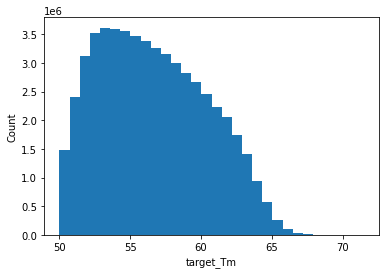

Wall time: 5min 17s


In [23]:
%%time
# Filter by Tm
# NOTE: here we used a higher upper bound for GC content and Tm than JM's original
# cutoffs. It was shown that higher Tm gives better signal-to-noise ratios in SM-FISH
filters.filter_probe_dict_by_metric(probe_dict, 'target_Tm', lower_bound=50)
plot.plot_hist(probe_dict, column_key='target_Tm')

Calculate OTs for 0/66902 genes.
Calculate OTs for 1/66902 genes.
Calculate OTs for 2/66902 genes.
Calculate OTs for 3/66902 genes.
Calculate OTs for 4/66902 genes.
Calculate OTs for 5/66902 genes.
Calculate OTs for 6/66902 genes.
Calculate OTs for 7/66902 genes.
Calculate OTs for 8/66902 genes.
Calculate OTs for 9/66902 genes.
Calculate OTs for 10/66902 genes.
Calculate OTs for 11/66902 genes.
Calculate OTs for 12/66902 genes.
Calculate OTs for 13/66902 genes.
Calculate OTs for 14/66902 genes.
Calculate OTs for 15/66902 genes.
Calculate OTs for 16/66902 genes.
Calculate OTs for 17/66902 genes.
Calculate OTs for 18/66902 genes.
Calculate OTs for 19/66902 genes.
Calculate OTs for 20/66902 genes.
Calculate OTs for 21/66902 genes.
Calculate OTs for 22/66902 genes.
Calculate OTs for 23/66902 genes.
Calculate OTs for 24/66902 genes.
Calculate OTs for 25/66902 genes.
Calculate OTs for 26/66902 genes.
Calculate OTs for 27/66902 genes.
Calculate OTs for 28/66902 genes.
Calculate OTs for 29/669

Calculate OTs for 245/66902 genes.
Calculate OTs for 246/66902 genes.
Calculate OTs for 247/66902 genes.
Calculate OTs for 248/66902 genes.
Calculate OTs for 249/66902 genes.
Calculate OTs for 250/66902 genes.
Calculate OTs for 251/66902 genes.
Calculate OTs for 252/66902 genes.
Calculate OTs for 253/66902 genes.
Calculate OTs for 254/66902 genes.
Calculate OTs for 255/66902 genes.
Calculate OTs for 256/66902 genes.
Calculate OTs for 257/66902 genes.
Calculate OTs for 258/66902 genes.
Calculate OTs for 259/66902 genes.
Calculate OTs for 260/66902 genes.
Calculate OTs for 261/66902 genes.
Calculate OTs for 262/66902 genes.
Calculate OTs for 263/66902 genes.
Calculate OTs for 264/66902 genes.
Calculate OTs for 265/66902 genes.
Calculate OTs for 266/66902 genes.
Calculate OTs for 267/66902 genes.
Calculate OTs for 268/66902 genes.
Calculate OTs for 269/66902 genes.
Calculate OTs for 270/66902 genes.
Calculate OTs for 271/66902 genes.
Calculate OTs for 272/66902 genes.
Calculate OTs for 27

Calculate OTs for 481/66902 genes.
Calculate OTs for 482/66902 genes.
Calculate OTs for 483/66902 genes.
Calculate OTs for 484/66902 genes.
Calculate OTs for 485/66902 genes.
Calculate OTs for 486/66902 genes.
Calculate OTs for 487/66902 genes.
Calculate OTs for 488/66902 genes.
Calculate OTs for 489/66902 genes.
Calculate OTs for 490/66902 genes.
Calculate OTs for 491/66902 genes.
Calculate OTs for 492/66902 genes.
Calculate OTs for 493/66902 genes.
Calculate OTs for 494/66902 genes.
Calculate OTs for 495/66902 genes.
Calculate OTs for 496/66902 genes.
Calculate OTs for 497/66902 genes.
Calculate OTs for 498/66902 genes.
Calculate OTs for 499/66902 genes.
Calculate OTs for 500/66902 genes.
Calculate OTs for 501/66902 genes.
Calculate OTs for 502/66902 genes.
Calculate OTs for 503/66902 genes.
Calculate OTs for 504/66902 genes.
Calculate OTs for 505/66902 genes.
Calculate OTs for 506/66902 genes.
Calculate OTs for 507/66902 genes.
Calculate OTs for 508/66902 genes.
Calculate OTs for 50

Calculate OTs for 718/66902 genes.
Calculate OTs for 719/66902 genes.
Calculate OTs for 720/66902 genes.
Calculate OTs for 721/66902 genes.
Calculate OTs for 722/66902 genes.
Calculate OTs for 723/66902 genes.
Calculate OTs for 724/66902 genes.
Calculate OTs for 725/66902 genes.
Calculate OTs for 726/66902 genes.
Calculate OTs for 727/66902 genes.
Calculate OTs for 728/66902 genes.
Calculate OTs for 729/66902 genes.
Calculate OTs for 730/66902 genes.
Calculate OTs for 731/66902 genes.
Calculate OTs for 732/66902 genes.
Calculate OTs for 733/66902 genes.
Calculate OTs for 734/66902 genes.
Calculate OTs for 735/66902 genes.
Calculate OTs for 736/66902 genes.
Calculate OTs for 737/66902 genes.
Calculate OTs for 738/66902 genes.
Calculate OTs for 739/66902 genes.
Calculate OTs for 740/66902 genes.
Calculate OTs for 741/66902 genes.
Calculate OTs for 742/66902 genes.
Calculate OTs for 743/66902 genes.
Calculate OTs for 744/66902 genes.
Calculate OTs for 745/66902 genes.
Calculate OTs for 74

Calculate OTs for 960/66902 genes.
Calculate OTs for 961/66902 genes.
Calculate OTs for 962/66902 genes.
Calculate OTs for 963/66902 genes.
Calculate OTs for 964/66902 genes.
Calculate OTs for 965/66902 genes.
Calculate OTs for 966/66902 genes.
Calculate OTs for 967/66902 genes.
Calculate OTs for 968/66902 genes.
Calculate OTs for 969/66902 genes.
Calculate OTs for 970/66902 genes.
Calculate OTs for 971/66902 genes.
Calculate OTs for 972/66902 genes.
Calculate OTs for 973/66902 genes.
Calculate OTs for 974/66902 genes.
Calculate OTs for 975/66902 genes.
Calculate OTs for 976/66902 genes.
Calculate OTs for 977/66902 genes.
Calculate OTs for 978/66902 genes.
Calculate OTs for 979/66902 genes.
Calculate OTs for 980/66902 genes.
Calculate OTs for 981/66902 genes.
Calculate OTs for 982/66902 genes.
Calculate OTs for 983/66902 genes.
Calculate OTs for 984/66902 genes.
Calculate OTs for 985/66902 genes.
Calculate OTs for 986/66902 genes.
Calculate OTs for 987/66902 genes.
Calculate OTs for 98

Calculate OTs for 1191/66902 genes.
Calculate OTs for 1192/66902 genes.
Calculate OTs for 1193/66902 genes.
Calculate OTs for 1194/66902 genes.
Calculate OTs for 1195/66902 genes.
Calculate OTs for 1196/66902 genes.
Calculate OTs for 1197/66902 genes.
Calculate OTs for 1198/66902 genes.
Calculate OTs for 1199/66902 genes.
Calculate OTs for 1200/66902 genes.
Calculate OTs for 1201/66902 genes.
Calculate OTs for 1202/66902 genes.
Calculate OTs for 1203/66902 genes.
Calculate OTs for 1204/66902 genes.
Calculate OTs for 1205/66902 genes.
Calculate OTs for 1206/66902 genes.
Calculate OTs for 1207/66902 genes.
Calculate OTs for 1208/66902 genes.
Calculate OTs for 1209/66902 genes.
Calculate OTs for 1210/66902 genes.
Calculate OTs for 1211/66902 genes.
Calculate OTs for 1212/66902 genes.
Calculate OTs for 1213/66902 genes.
Calculate OTs for 1214/66902 genes.
Calculate OTs for 1215/66902 genes.
Calculate OTs for 1216/66902 genes.
Calculate OTs for 1217/66902 genes.
Calculate OTs for 1218/66902

Calculate OTs for 1420/66902 genes.
Calculate OTs for 1421/66902 genes.
Calculate OTs for 1422/66902 genes.
Calculate OTs for 1423/66902 genes.
Calculate OTs for 1424/66902 genes.
Calculate OTs for 1425/66902 genes.
Calculate OTs for 1426/66902 genes.
Calculate OTs for 1427/66902 genes.
Calculate OTs for 1428/66902 genes.
Calculate OTs for 1429/66902 genes.
Calculate OTs for 1430/66902 genes.
Calculate OTs for 1431/66902 genes.
Calculate OTs for 1432/66902 genes.
Calculate OTs for 1433/66902 genes.
Calculate OTs for 1434/66902 genes.
Calculate OTs for 1435/66902 genes.
Calculate OTs for 1436/66902 genes.
Calculate OTs for 1437/66902 genes.
Calculate OTs for 1438/66902 genes.
Calculate OTs for 1439/66902 genes.
Calculate OTs for 1440/66902 genes.
Calculate OTs for 1441/66902 genes.
Calculate OTs for 1442/66902 genes.
Calculate OTs for 1443/66902 genes.
Calculate OTs for 1444/66902 genes.
Calculate OTs for 1445/66902 genes.
Calculate OTs for 1446/66902 genes.
Calculate OTs for 1447/66902

Calculate OTs for 1650/66902 genes.
Calculate OTs for 1651/66902 genes.
Calculate OTs for 1652/66902 genes.
Calculate OTs for 1653/66902 genes.
Calculate OTs for 1654/66902 genes.
Calculate OTs for 1655/66902 genes.
Calculate OTs for 1656/66902 genes.
Calculate OTs for 1657/66902 genes.
Calculate OTs for 1658/66902 genes.
Calculate OTs for 1659/66902 genes.
Calculate OTs for 1660/66902 genes.
Calculate OTs for 1661/66902 genes.
Calculate OTs for 1662/66902 genes.
Calculate OTs for 1663/66902 genes.
Calculate OTs for 1664/66902 genes.
Calculate OTs for 1665/66902 genes.
Calculate OTs for 1666/66902 genes.
Calculate OTs for 1667/66902 genes.
Calculate OTs for 1668/66902 genes.
Calculate OTs for 1669/66902 genes.
Calculate OTs for 1670/66902 genes.
Calculate OTs for 1671/66902 genes.
Calculate OTs for 1672/66902 genes.
Calculate OTs for 1673/66902 genes.
Calculate OTs for 1674/66902 genes.
Calculate OTs for 1675/66902 genes.
Calculate OTs for 1676/66902 genes.
Calculate OTs for 1677/66902

Calculate OTs for 1886/66902 genes.
Calculate OTs for 1887/66902 genes.
Calculate OTs for 1888/66902 genes.
Calculate OTs for 1889/66902 genes.
Calculate OTs for 1890/66902 genes.
Calculate OTs for 1891/66902 genes.
Calculate OTs for 1892/66902 genes.
Calculate OTs for 1893/66902 genes.
Calculate OTs for 1894/66902 genes.
Calculate OTs for 1895/66902 genes.
Calculate OTs for 1896/66902 genes.
Calculate OTs for 1897/66902 genes.
Calculate OTs for 1898/66902 genes.
Calculate OTs for 1899/66902 genes.
Calculate OTs for 1900/66902 genes.
Calculate OTs for 1901/66902 genes.
Calculate OTs for 1902/66902 genes.
Calculate OTs for 1903/66902 genes.
Calculate OTs for 1904/66902 genes.
Calculate OTs for 1905/66902 genes.
Calculate OTs for 1906/66902 genes.
Calculate OTs for 1907/66902 genes.
Calculate OTs for 1908/66902 genes.
Calculate OTs for 1909/66902 genes.
Calculate OTs for 1910/66902 genes.
Calculate OTs for 1911/66902 genes.
Calculate OTs for 1912/66902 genes.
Calculate OTs for 1913/66902

Calculate OTs for 2118/66902 genes.
Calculate OTs for 2119/66902 genes.
Calculate OTs for 2120/66902 genes.
Calculate OTs for 2121/66902 genes.
Calculate OTs for 2122/66902 genes.
Calculate OTs for 2123/66902 genes.
Calculate OTs for 2124/66902 genes.
Calculate OTs for 2125/66902 genes.
Calculate OTs for 2126/66902 genes.
Calculate OTs for 2127/66902 genes.
Calculate OTs for 2128/66902 genes.
Calculate OTs for 2129/66902 genes.
Calculate OTs for 2130/66902 genes.
Calculate OTs for 2131/66902 genes.
Calculate OTs for 2132/66902 genes.
Calculate OTs for 2133/66902 genes.
Calculate OTs for 2134/66902 genes.
Calculate OTs for 2135/66902 genes.
Calculate OTs for 2136/66902 genes.
Calculate OTs for 2137/66902 genes.
Calculate OTs for 2138/66902 genes.
Calculate OTs for 2139/66902 genes.
Calculate OTs for 2140/66902 genes.
Calculate OTs for 2141/66902 genes.
Calculate OTs for 2142/66902 genes.
Calculate OTs for 2143/66902 genes.
Calculate OTs for 2144/66902 genes.
Calculate OTs for 2145/66902

Calculate OTs for 2353/66902 genes.
Calculate OTs for 2354/66902 genes.
Calculate OTs for 2355/66902 genes.
Calculate OTs for 2356/66902 genes.
Calculate OTs for 2357/66902 genes.
Calculate OTs for 2358/66902 genes.
Calculate OTs for 2359/66902 genes.
Calculate OTs for 2360/66902 genes.
Calculate OTs for 2361/66902 genes.
Calculate OTs for 2362/66902 genes.
Calculate OTs for 2363/66902 genes.
Calculate OTs for 2364/66902 genes.
Calculate OTs for 2365/66902 genes.
Calculate OTs for 2366/66902 genes.
Calculate OTs for 2367/66902 genes.
Calculate OTs for 2368/66902 genes.
Calculate OTs for 2369/66902 genes.
Calculate OTs for 2370/66902 genes.
Calculate OTs for 2371/66902 genes.
Calculate OTs for 2372/66902 genes.
Calculate OTs for 2373/66902 genes.
Calculate OTs for 2374/66902 genes.
Calculate OTs for 2375/66902 genes.
Calculate OTs for 2376/66902 genes.
Calculate OTs for 2377/66902 genes.
Calculate OTs for 2378/66902 genes.
Calculate OTs for 2379/66902 genes.
Calculate OTs for 2380/66902

Calculate OTs for 2591/66902 genes.
Calculate OTs for 2592/66902 genes.
Calculate OTs for 2593/66902 genes.
Calculate OTs for 2594/66902 genes.
Calculate OTs for 2595/66902 genes.
Calculate OTs for 2596/66902 genes.
Calculate OTs for 2597/66902 genes.
Calculate OTs for 2598/66902 genes.
Calculate OTs for 2599/66902 genes.
Calculate OTs for 2600/66902 genes.
Calculate OTs for 2601/66902 genes.
Calculate OTs for 2602/66902 genes.
Calculate OTs for 2603/66902 genes.
Calculate OTs for 2604/66902 genes.
Calculate OTs for 2605/66902 genes.
Calculate OTs for 2606/66902 genes.
Calculate OTs for 2607/66902 genes.
Calculate OTs for 2608/66902 genes.
Calculate OTs for 2609/66902 genes.
Calculate OTs for 2610/66902 genes.
Calculate OTs for 2611/66902 genes.
Calculate OTs for 2612/66902 genes.
Calculate OTs for 2613/66902 genes.
Calculate OTs for 2614/66902 genes.
Calculate OTs for 2615/66902 genes.
Calculate OTs for 2616/66902 genes.
Calculate OTs for 2617/66902 genes.
Calculate OTs for 2618/66902

Calculate OTs for 2823/66902 genes.
Calculate OTs for 2824/66902 genes.
Calculate OTs for 2825/66902 genes.
Calculate OTs for 2826/66902 genes.
Calculate OTs for 2827/66902 genes.
Calculate OTs for 2828/66902 genes.
Calculate OTs for 2829/66902 genes.
Calculate OTs for 2830/66902 genes.
Calculate OTs for 2831/66902 genes.
Calculate OTs for 2832/66902 genes.
Calculate OTs for 2833/66902 genes.
Calculate OTs for 2834/66902 genes.
Calculate OTs for 2835/66902 genes.
Calculate OTs for 2836/66902 genes.
Calculate OTs for 2837/66902 genes.
Calculate OTs for 2838/66902 genes.
Calculate OTs for 2839/66902 genes.
Calculate OTs for 2840/66902 genes.
Calculate OTs for 2841/66902 genes.
Calculate OTs for 2842/66902 genes.
Calculate OTs for 2843/66902 genes.
Calculate OTs for 2844/66902 genes.
Calculate OTs for 2845/66902 genes.
Calculate OTs for 2846/66902 genes.
Calculate OTs for 2847/66902 genes.
Calculate OTs for 2848/66902 genes.
Calculate OTs for 2849/66902 genes.
Calculate OTs for 2850/66902

Calculate OTs for 3053/66902 genes.
Calculate OTs for 3054/66902 genes.
Calculate OTs for 3055/66902 genes.
Calculate OTs for 3056/66902 genes.
Calculate OTs for 3057/66902 genes.
Calculate OTs for 3058/66902 genes.
Calculate OTs for 3059/66902 genes.
Calculate OTs for 3060/66902 genes.
Calculate OTs for 3061/66902 genes.
Calculate OTs for 3062/66902 genes.
Calculate OTs for 3063/66902 genes.
Calculate OTs for 3064/66902 genes.
Calculate OTs for 3065/66902 genes.
Calculate OTs for 3066/66902 genes.
Calculate OTs for 3067/66902 genes.
Calculate OTs for 3068/66902 genes.
Calculate OTs for 3069/66902 genes.
Calculate OTs for 3070/66902 genes.
Calculate OTs for 3071/66902 genes.
Calculate OTs for 3072/66902 genes.
Calculate OTs for 3073/66902 genes.
Calculate OTs for 3074/66902 genes.
Calculate OTs for 3075/66902 genes.
Calculate OTs for 3076/66902 genes.
Calculate OTs for 3077/66902 genes.
Calculate OTs for 3078/66902 genes.
Calculate OTs for 3079/66902 genes.
Calculate OTs for 3080/66902

Calculate OTs for 3294/66902 genes.
Calculate OTs for 3295/66902 genes.
Calculate OTs for 3296/66902 genes.
Calculate OTs for 3297/66902 genes.
Calculate OTs for 3298/66902 genes.
Calculate OTs for 3299/66902 genes.
Calculate OTs for 3300/66902 genes.
Calculate OTs for 3301/66902 genes.
Calculate OTs for 3302/66902 genes.
Calculate OTs for 3303/66902 genes.
Calculate OTs for 3304/66902 genes.
Calculate OTs for 3305/66902 genes.
Calculate OTs for 3306/66902 genes.
Calculate OTs for 3307/66902 genes.
Calculate OTs for 3308/66902 genes.
Calculate OTs for 3309/66902 genes.
Calculate OTs for 3310/66902 genes.
Calculate OTs for 3311/66902 genes.
Calculate OTs for 3312/66902 genes.
Calculate OTs for 3313/66902 genes.
Calculate OTs for 3314/66902 genes.
Calculate OTs for 3315/66902 genes.
Calculate OTs for 3316/66902 genes.
Calculate OTs for 3317/66902 genes.
Calculate OTs for 3318/66902 genes.
Calculate OTs for 3319/66902 genes.
Calculate OTs for 3320/66902 genes.
Calculate OTs for 3321/66902

Calculate OTs for 3525/66902 genes.
Calculate OTs for 3526/66902 genes.
Calculate OTs for 3527/66902 genes.
Calculate OTs for 3528/66902 genes.
Calculate OTs for 3529/66902 genes.
Calculate OTs for 3530/66902 genes.
Calculate OTs for 3531/66902 genes.
Calculate OTs for 3532/66902 genes.
Calculate OTs for 3533/66902 genes.
Calculate OTs for 3534/66902 genes.
Calculate OTs for 3535/66902 genes.
Calculate OTs for 3536/66902 genes.
Calculate OTs for 3537/66902 genes.
Calculate OTs for 3538/66902 genes.
Calculate OTs for 3539/66902 genes.
Calculate OTs for 3540/66902 genes.
Calculate OTs for 3541/66902 genes.
Calculate OTs for 3542/66902 genes.
Calculate OTs for 3543/66902 genes.
Calculate OTs for 3544/66902 genes.
Calculate OTs for 3545/66902 genes.
Calculate OTs for 3546/66902 genes.
Calculate OTs for 3547/66902 genes.
Calculate OTs for 3548/66902 genes.
Calculate OTs for 3549/66902 genes.
Calculate OTs for 3550/66902 genes.
Calculate OTs for 3551/66902 genes.
Calculate OTs for 3552/66902

Calculate OTs for 3768/66902 genes.
Calculate OTs for 3769/66902 genes.
Calculate OTs for 3770/66902 genes.
Calculate OTs for 3771/66902 genes.
Calculate OTs for 3772/66902 genes.
Calculate OTs for 3773/66902 genes.
Calculate OTs for 3774/66902 genes.
Calculate OTs for 3775/66902 genes.
Calculate OTs for 3776/66902 genes.
Calculate OTs for 3777/66902 genes.
Calculate OTs for 3778/66902 genes.
Calculate OTs for 3779/66902 genes.
Calculate OTs for 3780/66902 genes.
Calculate OTs for 3781/66902 genes.
Calculate OTs for 3782/66902 genes.
Calculate OTs for 3783/66902 genes.
Calculate OTs for 3784/66902 genes.
Calculate OTs for 3785/66902 genes.
Calculate OTs for 3786/66902 genes.
Calculate OTs for 3787/66902 genes.
Calculate OTs for 3788/66902 genes.
Calculate OTs for 3789/66902 genes.
Calculate OTs for 3790/66902 genes.
Calculate OTs for 3791/66902 genes.
Calculate OTs for 3792/66902 genes.
Calculate OTs for 3793/66902 genes.
Calculate OTs for 3794/66902 genes.
Calculate OTs for 3795/66902

Calculate OTs for 3998/66902 genes.
Calculate OTs for 3999/66902 genes.
Calculate OTs for 4000/66902 genes.
Calculate OTs for 4001/66902 genes.
Calculate OTs for 4002/66902 genes.
Calculate OTs for 4003/66902 genes.
Calculate OTs for 4004/66902 genes.
Calculate OTs for 4005/66902 genes.
Calculate OTs for 4006/66902 genes.
Calculate OTs for 4007/66902 genes.
Calculate OTs for 4008/66902 genes.
Calculate OTs for 4009/66902 genes.
Calculate OTs for 4010/66902 genes.
Calculate OTs for 4011/66902 genes.
Calculate OTs for 4012/66902 genes.
Calculate OTs for 4013/66902 genes.
Calculate OTs for 4014/66902 genes.
Calculate OTs for 4015/66902 genes.
Calculate OTs for 4016/66902 genes.
Calculate OTs for 4017/66902 genes.
Calculate OTs for 4018/66902 genes.
Calculate OTs for 4019/66902 genes.
Calculate OTs for 4020/66902 genes.
Calculate OTs for 4021/66902 genes.
Calculate OTs for 4022/66902 genes.
Calculate OTs for 4023/66902 genes.
Calculate OTs for 4024/66902 genes.
Calculate OTs for 4025/66902

Calculate OTs for 4236/66902 genes.
Calculate OTs for 4237/66902 genes.
Calculate OTs for 4238/66902 genes.
Calculate OTs for 4239/66902 genes.
Calculate OTs for 4240/66902 genes.
Calculate OTs for 4241/66902 genes.
Calculate OTs for 4242/66902 genes.
Calculate OTs for 4243/66902 genes.
Calculate OTs for 4244/66902 genes.
Calculate OTs for 4245/66902 genes.
Calculate OTs for 4246/66902 genes.
Calculate OTs for 4247/66902 genes.
Calculate OTs for 4248/66902 genes.
Calculate OTs for 4249/66902 genes.
Calculate OTs for 4250/66902 genes.
Calculate OTs for 4251/66902 genes.
Calculate OTs for 4252/66902 genes.
Calculate OTs for 4253/66902 genes.
Calculate OTs for 4254/66902 genes.
Calculate OTs for 4255/66902 genes.
Calculate OTs for 4256/66902 genes.
Calculate OTs for 4257/66902 genes.
Calculate OTs for 4258/66902 genes.
Calculate OTs for 4259/66902 genes.
Calculate OTs for 4260/66902 genes.
Calculate OTs for 4261/66902 genes.
Calculate OTs for 4262/66902 genes.
Calculate OTs for 4263/66902

Calculate OTs for 4479/66902 genes.
Calculate OTs for 4480/66902 genes.
Calculate OTs for 4481/66902 genes.
Calculate OTs for 4482/66902 genes.
Calculate OTs for 4483/66902 genes.
Calculate OTs for 4484/66902 genes.
Calculate OTs for 4485/66902 genes.
Calculate OTs for 4486/66902 genes.
Calculate OTs for 4487/66902 genes.
Calculate OTs for 4488/66902 genes.
Calculate OTs for 4489/66902 genes.
Calculate OTs for 4490/66902 genes.
Calculate OTs for 4491/66902 genes.
Calculate OTs for 4492/66902 genes.
Calculate OTs for 4493/66902 genes.
Calculate OTs for 4494/66902 genes.
Calculate OTs for 4495/66902 genes.
Calculate OTs for 4496/66902 genes.
Calculate OTs for 4497/66902 genes.
Calculate OTs for 4498/66902 genes.
Calculate OTs for 4499/66902 genes.
Calculate OTs for 4500/66902 genes.
Calculate OTs for 4501/66902 genes.
Calculate OTs for 4502/66902 genes.
Calculate OTs for 4503/66902 genes.
Calculate OTs for 4504/66902 genes.
Calculate OTs for 4505/66902 genes.
Calculate OTs for 4506/66902

Calculate OTs for 4716/66902 genes.
Calculate OTs for 4717/66902 genes.
Calculate OTs for 4718/66902 genes.
Calculate OTs for 4719/66902 genes.
Calculate OTs for 4720/66902 genes.
Calculate OTs for 4721/66902 genes.
Calculate OTs for 4722/66902 genes.
Calculate OTs for 4723/66902 genes.
Calculate OTs for 4724/66902 genes.
Calculate OTs for 4725/66902 genes.
Calculate OTs for 4726/66902 genes.
Calculate OTs for 4727/66902 genes.
Calculate OTs for 4728/66902 genes.
Calculate OTs for 4729/66902 genes.
Calculate OTs for 4730/66902 genes.
Calculate OTs for 4731/66902 genes.
Calculate OTs for 4732/66902 genes.
Calculate OTs for 4733/66902 genes.
Calculate OTs for 4734/66902 genes.
Calculate OTs for 4735/66902 genes.
Calculate OTs for 4736/66902 genes.
Calculate OTs for 4737/66902 genes.
Calculate OTs for 4738/66902 genes.
Calculate OTs for 4739/66902 genes.
Calculate OTs for 4740/66902 genes.
Calculate OTs for 4741/66902 genes.
Calculate OTs for 4742/66902 genes.
Calculate OTs for 4743/66902

Calculate OTs for 4949/66902 genes.
Calculate OTs for 4950/66902 genes.
Calculate OTs for 4951/66902 genes.
Calculate OTs for 4952/66902 genes.
Calculate OTs for 4953/66902 genes.
Calculate OTs for 4954/66902 genes.
Calculate OTs for 4955/66902 genes.
Calculate OTs for 4956/66902 genes.
Calculate OTs for 4957/66902 genes.
Calculate OTs for 4958/66902 genes.
Calculate OTs for 4959/66902 genes.
Calculate OTs for 4960/66902 genes.
Calculate OTs for 4961/66902 genes.
Calculate OTs for 4962/66902 genes.
Calculate OTs for 4963/66902 genes.
Calculate OTs for 4964/66902 genes.
Calculate OTs for 4965/66902 genes.
Calculate OTs for 4966/66902 genes.
Calculate OTs for 4967/66902 genes.
Calculate OTs for 4968/66902 genes.
Calculate OTs for 4969/66902 genes.
Calculate OTs for 4970/66902 genes.
Calculate OTs for 4971/66902 genes.
Calculate OTs for 4972/66902 genes.
Calculate OTs for 4973/66902 genes.
Calculate OTs for 4974/66902 genes.
Calculate OTs for 4975/66902 genes.
Calculate OTs for 4976/66902

Calculate OTs for 5181/66902 genes.
Calculate OTs for 5182/66902 genes.
Calculate OTs for 5183/66902 genes.
Calculate OTs for 5184/66902 genes.
Calculate OTs for 5185/66902 genes.
Calculate OTs for 5186/66902 genes.
Calculate OTs for 5187/66902 genes.
Calculate OTs for 5188/66902 genes.
Calculate OTs for 5189/66902 genes.
Calculate OTs for 5190/66902 genes.
Calculate OTs for 5191/66902 genes.
Calculate OTs for 5192/66902 genes.
Calculate OTs for 5193/66902 genes.
Calculate OTs for 5194/66902 genes.
Calculate OTs for 5195/66902 genes.
Calculate OTs for 5196/66902 genes.
Calculate OTs for 5197/66902 genes.
Calculate OTs for 5198/66902 genes.
Calculate OTs for 5199/66902 genes.
Calculate OTs for 5200/66902 genes.
Calculate OTs for 5201/66902 genes.
Calculate OTs for 5202/66902 genes.
Calculate OTs for 5203/66902 genes.
Calculate OTs for 5204/66902 genes.
Calculate OTs for 5205/66902 genes.
Calculate OTs for 5206/66902 genes.
Calculate OTs for 5207/66902 genes.
Calculate OTs for 5208/66902

Calculate OTs for 5422/66902 genes.
Calculate OTs for 5423/66902 genes.
Calculate OTs for 5424/66902 genes.
Calculate OTs for 5425/66902 genes.
Calculate OTs for 5426/66902 genes.
Calculate OTs for 5427/66902 genes.
Calculate OTs for 5428/66902 genes.
Calculate OTs for 5429/66902 genes.
Calculate OTs for 5430/66902 genes.
Calculate OTs for 5431/66902 genes.
Calculate OTs for 5432/66902 genes.
Calculate OTs for 5433/66902 genes.
Calculate OTs for 5434/66902 genes.
Calculate OTs for 5435/66902 genes.
Calculate OTs for 5436/66902 genes.
Calculate OTs for 5437/66902 genes.
Calculate OTs for 5438/66902 genes.
Calculate OTs for 5439/66902 genes.
Calculate OTs for 5440/66902 genes.
Calculate OTs for 5441/66902 genes.
Calculate OTs for 5442/66902 genes.
Calculate OTs for 5443/66902 genes.
Calculate OTs for 5444/66902 genes.
Calculate OTs for 5445/66902 genes.
Calculate OTs for 5446/66902 genes.
Calculate OTs for 5447/66902 genes.
Calculate OTs for 5448/66902 genes.
Calculate OTs for 5449/66902

Calculate OTs for 5650/66902 genes.
Calculate OTs for 5651/66902 genes.
Calculate OTs for 5652/66902 genes.
Calculate OTs for 5653/66902 genes.
Calculate OTs for 5654/66902 genes.
Calculate OTs for 5655/66902 genes.
Calculate OTs for 5656/66902 genes.
Calculate OTs for 5657/66902 genes.
Calculate OTs for 5658/66902 genes.
Calculate OTs for 5659/66902 genes.
Calculate OTs for 5660/66902 genes.
Calculate OTs for 5661/66902 genes.
Calculate OTs for 5662/66902 genes.
Calculate OTs for 5663/66902 genes.
Calculate OTs for 5664/66902 genes.
Calculate OTs for 5665/66902 genes.
Calculate OTs for 5666/66902 genes.
Calculate OTs for 5667/66902 genes.
Calculate OTs for 5668/66902 genes.
Calculate OTs for 5669/66902 genes.
Calculate OTs for 5670/66902 genes.
Calculate OTs for 5671/66902 genes.
Calculate OTs for 5672/66902 genes.
Calculate OTs for 5673/66902 genes.
Calculate OTs for 5674/66902 genes.
Calculate OTs for 5675/66902 genes.
Calculate OTs for 5676/66902 genes.
Calculate OTs for 5677/66902

Calculate OTs for 5890/66902 genes.
Calculate OTs for 5891/66902 genes.
Calculate OTs for 5892/66902 genes.
Calculate OTs for 5893/66902 genes.
Calculate OTs for 5894/66902 genes.
Calculate OTs for 5895/66902 genes.
Calculate OTs for 5896/66902 genes.
Calculate OTs for 5897/66902 genes.
Calculate OTs for 5898/66902 genes.
Calculate OTs for 5899/66902 genes.
Calculate OTs for 5900/66902 genes.
Calculate OTs for 5901/66902 genes.
Calculate OTs for 5902/66902 genes.
Calculate OTs for 5903/66902 genes.
Calculate OTs for 5904/66902 genes.
Calculate OTs for 5905/66902 genes.
Calculate OTs for 5906/66902 genes.
Calculate OTs for 5907/66902 genes.
Calculate OTs for 5908/66902 genes.
Calculate OTs for 5909/66902 genes.
Calculate OTs for 5910/66902 genes.
Calculate OTs for 5911/66902 genes.
Calculate OTs for 5912/66902 genes.
Calculate OTs for 5913/66902 genes.
Calculate OTs for 5914/66902 genes.
Calculate OTs for 5915/66902 genes.
Calculate OTs for 5916/66902 genes.
Calculate OTs for 5917/66902

Calculate OTs for 6123/66902 genes.
Calculate OTs for 6124/66902 genes.
Calculate OTs for 6125/66902 genes.
Calculate OTs for 6126/66902 genes.
Calculate OTs for 6127/66902 genes.
Calculate OTs for 6128/66902 genes.
Calculate OTs for 6129/66902 genes.
Calculate OTs for 6130/66902 genes.
Calculate OTs for 6131/66902 genes.
Calculate OTs for 6132/66902 genes.
Calculate OTs for 6133/66902 genes.
Calculate OTs for 6134/66902 genes.
Calculate OTs for 6135/66902 genes.
Calculate OTs for 6136/66902 genes.
Calculate OTs for 6137/66902 genes.
Calculate OTs for 6138/66902 genes.
Calculate OTs for 6139/66902 genes.
Calculate OTs for 6140/66902 genes.
Calculate OTs for 6141/66902 genes.
Calculate OTs for 6142/66902 genes.
Calculate OTs for 6143/66902 genes.
Calculate OTs for 6144/66902 genes.
Calculate OTs for 6145/66902 genes.
Calculate OTs for 6146/66902 genes.
Calculate OTs for 6147/66902 genes.
Calculate OTs for 6148/66902 genes.
Calculate OTs for 6149/66902 genes.
Calculate OTs for 6150/66902

Calculate OTs for 6359/66902 genes.
Calculate OTs for 6360/66902 genes.
Calculate OTs for 6361/66902 genes.
Calculate OTs for 6362/66902 genes.
Calculate OTs for 6363/66902 genes.
Calculate OTs for 6364/66902 genes.
Calculate OTs for 6365/66902 genes.
Calculate OTs for 6366/66902 genes.
Calculate OTs for 6367/66902 genes.
Calculate OTs for 6368/66902 genes.
Calculate OTs for 6369/66902 genes.
Calculate OTs for 6370/66902 genes.
Calculate OTs for 6371/66902 genes.
Calculate OTs for 6372/66902 genes.
Calculate OTs for 6373/66902 genes.
Calculate OTs for 6374/66902 genes.
Calculate OTs for 6375/66902 genes.
Calculate OTs for 6376/66902 genes.
Calculate OTs for 6377/66902 genes.
Calculate OTs for 6378/66902 genes.
Calculate OTs for 6379/66902 genes.
Calculate OTs for 6380/66902 genes.
Calculate OTs for 6381/66902 genes.
Calculate OTs for 6382/66902 genes.
Calculate OTs for 6383/66902 genes.
Calculate OTs for 6384/66902 genes.
Calculate OTs for 6385/66902 genes.
Calculate OTs for 6386/66902

Calculate OTs for 6601/66902 genes.
Calculate OTs for 6602/66902 genes.
Calculate OTs for 6603/66902 genes.
Calculate OTs for 6604/66902 genes.
Calculate OTs for 6605/66902 genes.
Calculate OTs for 6606/66902 genes.
Calculate OTs for 6607/66902 genes.
Calculate OTs for 6608/66902 genes.
Calculate OTs for 6609/66902 genes.
Calculate OTs for 6610/66902 genes.
Calculate OTs for 6611/66902 genes.
Calculate OTs for 6612/66902 genes.
Calculate OTs for 6613/66902 genes.
Calculate OTs for 6614/66902 genes.
Calculate OTs for 6615/66902 genes.
Calculate OTs for 6616/66902 genes.
Calculate OTs for 6617/66902 genes.
Calculate OTs for 6618/66902 genes.
Calculate OTs for 6619/66902 genes.
Calculate OTs for 6620/66902 genes.
Calculate OTs for 6621/66902 genes.
Calculate OTs for 6622/66902 genes.
Calculate OTs for 6623/66902 genes.
Calculate OTs for 6624/66902 genes.
Calculate OTs for 6625/66902 genes.
Calculate OTs for 6626/66902 genes.
Calculate OTs for 6627/66902 genes.
Calculate OTs for 6628/66902

Calculate OTs for 6837/66902 genes.
Calculate OTs for 6838/66902 genes.
Calculate OTs for 6839/66902 genes.
Calculate OTs for 6840/66902 genes.
Calculate OTs for 6841/66902 genes.
Calculate OTs for 6842/66902 genes.
Calculate OTs for 6843/66902 genes.
Calculate OTs for 6844/66902 genes.
Calculate OTs for 6845/66902 genes.
Calculate OTs for 6846/66902 genes.
Calculate OTs for 6847/66902 genes.
Calculate OTs for 6848/66902 genes.
Calculate OTs for 6849/66902 genes.
Calculate OTs for 6850/66902 genes.
Calculate OTs for 6851/66902 genes.
Calculate OTs for 6852/66902 genes.
Calculate OTs for 6853/66902 genes.
Calculate OTs for 6854/66902 genes.
Calculate OTs for 6855/66902 genes.
Calculate OTs for 6856/66902 genes.
Calculate OTs for 6857/66902 genes.
Calculate OTs for 6858/66902 genes.
Calculate OTs for 6859/66902 genes.
Calculate OTs for 6860/66902 genes.
Calculate OTs for 6861/66902 genes.
Calculate OTs for 6862/66902 genes.
Calculate OTs for 6863/66902 genes.
Calculate OTs for 6864/66902

Calculate OTs for 7080/66902 genes.
Calculate OTs for 7081/66902 genes.
Calculate OTs for 7082/66902 genes.
Calculate OTs for 7083/66902 genes.
Calculate OTs for 7084/66902 genes.
Calculate OTs for 7085/66902 genes.
Calculate OTs for 7086/66902 genes.
Calculate OTs for 7087/66902 genes.
Calculate OTs for 7088/66902 genes.
Calculate OTs for 7089/66902 genes.
Calculate OTs for 7090/66902 genes.
Calculate OTs for 7091/66902 genes.
Calculate OTs for 7092/66902 genes.
Calculate OTs for 7093/66902 genes.
Calculate OTs for 7094/66902 genes.
Calculate OTs for 7095/66902 genes.
Calculate OTs for 7096/66902 genes.
Calculate OTs for 7097/66902 genes.
Calculate OTs for 7098/66902 genes.
Calculate OTs for 7099/66902 genes.
Calculate OTs for 7100/66902 genes.
Calculate OTs for 7101/66902 genes.
Calculate OTs for 7102/66902 genes.
Calculate OTs for 7103/66902 genes.
Calculate OTs for 7104/66902 genes.
Calculate OTs for 7105/66902 genes.
Calculate OTs for 7106/66902 genes.
Calculate OTs for 7107/66902

Calculate OTs for 7321/66902 genes.
Calculate OTs for 7322/66902 genes.
Calculate OTs for 7323/66902 genes.
Calculate OTs for 7324/66902 genes.
Calculate OTs for 7325/66902 genes.
Calculate OTs for 7326/66902 genes.
Calculate OTs for 7327/66902 genes.
Calculate OTs for 7328/66902 genes.
Calculate OTs for 7329/66902 genes.
Calculate OTs for 7330/66902 genes.
Calculate OTs for 7331/66902 genes.
Calculate OTs for 7332/66902 genes.
Calculate OTs for 7333/66902 genes.
Calculate OTs for 7334/66902 genes.
Calculate OTs for 7335/66902 genes.
Calculate OTs for 7336/66902 genes.
Calculate OTs for 7337/66902 genes.
Calculate OTs for 7338/66902 genes.
Calculate OTs for 7339/66902 genes.
Calculate OTs for 7340/66902 genes.
Calculate OTs for 7341/66902 genes.
Calculate OTs for 7342/66902 genes.
Calculate OTs for 7343/66902 genes.
Calculate OTs for 7344/66902 genes.
Calculate OTs for 7345/66902 genes.
Calculate OTs for 7346/66902 genes.
Calculate OTs for 7347/66902 genes.
Calculate OTs for 7348/66902

Calculate OTs for 7549/66902 genes.
Calculate OTs for 7550/66902 genes.
Calculate OTs for 7551/66902 genes.
Calculate OTs for 7552/66902 genes.
Calculate OTs for 7553/66902 genes.
Calculate OTs for 7554/66902 genes.
Calculate OTs for 7555/66902 genes.
Calculate OTs for 7556/66902 genes.
Calculate OTs for 7557/66902 genes.
Calculate OTs for 7558/66902 genes.
Calculate OTs for 7559/66902 genes.
Calculate OTs for 7560/66902 genes.
Calculate OTs for 7561/66902 genes.
Calculate OTs for 7562/66902 genes.
Calculate OTs for 7563/66902 genes.
Calculate OTs for 7564/66902 genes.
Calculate OTs for 7565/66902 genes.
Calculate OTs for 7566/66902 genes.
Calculate OTs for 7567/66902 genes.
Calculate OTs for 7568/66902 genes.
Calculate OTs for 7569/66902 genes.
Calculate OTs for 7570/66902 genes.
Calculate OTs for 7571/66902 genes.
Calculate OTs for 7572/66902 genes.
Calculate OTs for 7573/66902 genes.
Calculate OTs for 7574/66902 genes.
Calculate OTs for 7575/66902 genes.
Calculate OTs for 7576/66902

Calculate OTs for 7783/66902 genes.
Calculate OTs for 7784/66902 genes.
Calculate OTs for 7785/66902 genes.
Calculate OTs for 7786/66902 genes.
Calculate OTs for 7787/66902 genes.
Calculate OTs for 7788/66902 genes.
Calculate OTs for 7789/66902 genes.
Calculate OTs for 7790/66902 genes.
Calculate OTs for 7791/66902 genes.
Calculate OTs for 7792/66902 genes.
Calculate OTs for 7793/66902 genes.
Calculate OTs for 7794/66902 genes.
Calculate OTs for 7795/66902 genes.
Calculate OTs for 7796/66902 genes.
Calculate OTs for 7797/66902 genes.
Calculate OTs for 7798/66902 genes.
Calculate OTs for 7799/66902 genes.
Calculate OTs for 7800/66902 genes.
Calculate OTs for 7801/66902 genes.
Calculate OTs for 7802/66902 genes.
Calculate OTs for 7803/66902 genes.
Calculate OTs for 7804/66902 genes.
Calculate OTs for 7805/66902 genes.
Calculate OTs for 7806/66902 genes.
Calculate OTs for 7807/66902 genes.
Calculate OTs for 7808/66902 genes.
Calculate OTs for 7809/66902 genes.
Calculate OTs for 7810/66902

Calculate OTs for 8018/66902 genes.
Calculate OTs for 8019/66902 genes.
Calculate OTs for 8020/66902 genes.
Calculate OTs for 8021/66902 genes.
Calculate OTs for 8022/66902 genes.
Calculate OTs for 8023/66902 genes.
Calculate OTs for 8024/66902 genes.
Calculate OTs for 8025/66902 genes.
Calculate OTs for 8026/66902 genes.
Calculate OTs for 8027/66902 genes.
Calculate OTs for 8028/66902 genes.
Calculate OTs for 8029/66902 genes.
Calculate OTs for 8030/66902 genes.
Calculate OTs for 8031/66902 genes.
Calculate OTs for 8032/66902 genes.
Calculate OTs for 8033/66902 genes.
Calculate OTs for 8034/66902 genes.
Calculate OTs for 8035/66902 genes.
Calculate OTs for 8036/66902 genes.
Calculate OTs for 8037/66902 genes.
Calculate OTs for 8038/66902 genes.
Calculate OTs for 8039/66902 genes.
Calculate OTs for 8040/66902 genes.
Calculate OTs for 8041/66902 genes.
Calculate OTs for 8042/66902 genes.
Calculate OTs for 8043/66902 genes.
Calculate OTs for 8044/66902 genes.
Calculate OTs for 8045/66902

Calculate OTs for 8248/66902 genes.
Calculate OTs for 8249/66902 genes.
Calculate OTs for 8250/66902 genes.
Calculate OTs for 8251/66902 genes.
Calculate OTs for 8252/66902 genes.
Calculate OTs for 8253/66902 genes.
Calculate OTs for 8254/66902 genes.
Calculate OTs for 8255/66902 genes.
Calculate OTs for 8256/66902 genes.
Calculate OTs for 8257/66902 genes.
Calculate OTs for 8258/66902 genes.
Calculate OTs for 8259/66902 genes.
Calculate OTs for 8260/66902 genes.
Calculate OTs for 8261/66902 genes.
Calculate OTs for 8262/66902 genes.
Calculate OTs for 8263/66902 genes.
Calculate OTs for 8264/66902 genes.
Calculate OTs for 8265/66902 genes.
Calculate OTs for 8266/66902 genes.
Calculate OTs for 8267/66902 genes.
Calculate OTs for 8268/66902 genes.
Calculate OTs for 8269/66902 genes.
Calculate OTs for 8270/66902 genes.
Calculate OTs for 8271/66902 genes.
Calculate OTs for 8272/66902 genes.
Calculate OTs for 8273/66902 genes.
Calculate OTs for 8274/66902 genes.
Calculate OTs for 8275/66902

Calculate OTs for 8489/66902 genes.
Calculate OTs for 8490/66902 genes.
Calculate OTs for 8491/66902 genes.
Calculate OTs for 8492/66902 genes.
Calculate OTs for 8493/66902 genes.
Calculate OTs for 8494/66902 genes.
Calculate OTs for 8495/66902 genes.
Calculate OTs for 8496/66902 genes.
Calculate OTs for 8497/66902 genes.
Calculate OTs for 8498/66902 genes.
Calculate OTs for 8499/66902 genes.
Calculate OTs for 8500/66902 genes.
Calculate OTs for 8501/66902 genes.
Calculate OTs for 8502/66902 genes.
Calculate OTs for 8503/66902 genes.
Calculate OTs for 8504/66902 genes.
Calculate OTs for 8505/66902 genes.
Calculate OTs for 8506/66902 genes.
Calculate OTs for 8507/66902 genes.
Calculate OTs for 8508/66902 genes.
Calculate OTs for 8509/66902 genes.
Calculate OTs for 8510/66902 genes.
Calculate OTs for 8511/66902 genes.
Calculate OTs for 8512/66902 genes.
Calculate OTs for 8513/66902 genes.
Calculate OTs for 8514/66902 genes.
Calculate OTs for 8515/66902 genes.
Calculate OTs for 8516/66902

Calculate OTs for 8724/66902 genes.
Calculate OTs for 8725/66902 genes.
Calculate OTs for 8726/66902 genes.
Calculate OTs for 8727/66902 genes.
Calculate OTs for 8728/66902 genes.
Calculate OTs for 8729/66902 genes.
Calculate OTs for 8730/66902 genes.
Calculate OTs for 8731/66902 genes.
Calculate OTs for 8732/66902 genes.
Calculate OTs for 8733/66902 genes.
Calculate OTs for 8734/66902 genes.
Calculate OTs for 8735/66902 genes.
Calculate OTs for 8736/66902 genes.
Calculate OTs for 8737/66902 genes.
Calculate OTs for 8738/66902 genes.
Calculate OTs for 8739/66902 genes.
Calculate OTs for 8740/66902 genes.
Calculate OTs for 8741/66902 genes.
Calculate OTs for 8742/66902 genes.
Calculate OTs for 8743/66902 genes.
Calculate OTs for 8744/66902 genes.
Calculate OTs for 8745/66902 genes.
Calculate OTs for 8746/66902 genes.
Calculate OTs for 8747/66902 genes.
Calculate OTs for 8748/66902 genes.
Calculate OTs for 8749/66902 genes.
Calculate OTs for 8750/66902 genes.
Calculate OTs for 8751/66902

Calculate OTs for 8965/66902 genes.
Calculate OTs for 8966/66902 genes.
Calculate OTs for 8967/66902 genes.
Calculate OTs for 8968/66902 genes.
Calculate OTs for 8969/66902 genes.
Calculate OTs for 8970/66902 genes.
Calculate OTs for 8971/66902 genes.
Calculate OTs for 8972/66902 genes.
Calculate OTs for 8973/66902 genes.
Calculate OTs for 8974/66902 genes.
Calculate OTs for 8975/66902 genes.
Calculate OTs for 8976/66902 genes.
Calculate OTs for 8977/66902 genes.
Calculate OTs for 8978/66902 genes.
Calculate OTs for 8979/66902 genes.
Calculate OTs for 8980/66902 genes.
Calculate OTs for 8981/66902 genes.
Calculate OTs for 8982/66902 genes.
Calculate OTs for 8983/66902 genes.
Calculate OTs for 8984/66902 genes.
Calculate OTs for 8985/66902 genes.
Calculate OTs for 8986/66902 genes.
Calculate OTs for 8987/66902 genes.
Calculate OTs for 8988/66902 genes.
Calculate OTs for 8989/66902 genes.
Calculate OTs for 8990/66902 genes.
Calculate OTs for 8991/66902 genes.
Calculate OTs for 8992/66902

Calculate OTs for 9198/66902 genes.
Calculate OTs for 9199/66902 genes.
Calculate OTs for 9200/66902 genes.
Calculate OTs for 9201/66902 genes.
Calculate OTs for 9202/66902 genes.
Calculate OTs for 9203/66902 genes.
Calculate OTs for 9204/66902 genes.
Calculate OTs for 9205/66902 genes.
Calculate OTs for 9206/66902 genes.
Calculate OTs for 9207/66902 genes.
Calculate OTs for 9208/66902 genes.
Calculate OTs for 9209/66902 genes.
Calculate OTs for 9210/66902 genes.
Calculate OTs for 9211/66902 genes.
Calculate OTs for 9212/66902 genes.
Calculate OTs for 9213/66902 genes.
Calculate OTs for 9214/66902 genes.
Calculate OTs for 9215/66902 genes.
Calculate OTs for 9216/66902 genes.
Calculate OTs for 9217/66902 genes.
Calculate OTs for 9218/66902 genes.
Calculate OTs for 9219/66902 genes.
Calculate OTs for 9220/66902 genes.
Calculate OTs for 9221/66902 genes.
Calculate OTs for 9222/66902 genes.
Calculate OTs for 9223/66902 genes.
Calculate OTs for 9224/66902 genes.
Calculate OTs for 9225/66902

Calculate OTs for 9440/66902 genes.
Calculate OTs for 9441/66902 genes.
Calculate OTs for 9442/66902 genes.
Calculate OTs for 9443/66902 genes.
Calculate OTs for 9444/66902 genes.
Calculate OTs for 9445/66902 genes.
Calculate OTs for 9446/66902 genes.
Calculate OTs for 9447/66902 genes.
Calculate OTs for 9448/66902 genes.
Calculate OTs for 9449/66902 genes.
Calculate OTs for 9450/66902 genes.
Calculate OTs for 9451/66902 genes.
Calculate OTs for 9452/66902 genes.
Calculate OTs for 9453/66902 genes.
Calculate OTs for 9454/66902 genes.
Calculate OTs for 9455/66902 genes.
Calculate OTs for 9456/66902 genes.
Calculate OTs for 9457/66902 genes.
Calculate OTs for 9458/66902 genes.
Calculate OTs for 9459/66902 genes.
Calculate OTs for 9460/66902 genes.
Calculate OTs for 9461/66902 genes.
Calculate OTs for 9462/66902 genes.
Calculate OTs for 9463/66902 genes.
Calculate OTs for 9464/66902 genes.
Calculate OTs for 9465/66902 genes.
Calculate OTs for 9466/66902 genes.
Calculate OTs for 9467/66902

Calculate OTs for 9670/66902 genes.
Calculate OTs for 9671/66902 genes.
Calculate OTs for 9672/66902 genes.
Calculate OTs for 9673/66902 genes.
Calculate OTs for 9674/66902 genes.
Calculate OTs for 9675/66902 genes.
Calculate OTs for 9676/66902 genes.
Calculate OTs for 9677/66902 genes.
Calculate OTs for 9678/66902 genes.
Calculate OTs for 9679/66902 genes.
Calculate OTs for 9680/66902 genes.
Calculate OTs for 9681/66902 genes.
Calculate OTs for 9682/66902 genes.
Calculate OTs for 9683/66902 genes.
Calculate OTs for 9684/66902 genes.
Calculate OTs for 9685/66902 genes.
Calculate OTs for 9686/66902 genes.
Calculate OTs for 9687/66902 genes.
Calculate OTs for 9688/66902 genes.
Calculate OTs for 9689/66902 genes.
Calculate OTs for 9690/66902 genes.
Calculate OTs for 9691/66902 genes.
Calculate OTs for 9692/66902 genes.
Calculate OTs for 9693/66902 genes.
Calculate OTs for 9694/66902 genes.
Calculate OTs for 9695/66902 genes.
Calculate OTs for 9696/66902 genes.
Calculate OTs for 9697/66902

Calculate OTs for 9900/66902 genes.
Calculate OTs for 9901/66902 genes.
Calculate OTs for 9902/66902 genes.
Calculate OTs for 9903/66902 genes.
Calculate OTs for 9904/66902 genes.
Calculate OTs for 9905/66902 genes.
Calculate OTs for 9906/66902 genes.
Calculate OTs for 9907/66902 genes.
Calculate OTs for 9908/66902 genes.
Calculate OTs for 9909/66902 genes.
Calculate OTs for 9910/66902 genes.
Calculate OTs for 9911/66902 genes.
Calculate OTs for 9912/66902 genes.
Calculate OTs for 9913/66902 genes.
Calculate OTs for 9914/66902 genes.
Calculate OTs for 9915/66902 genes.
Calculate OTs for 9916/66902 genes.
Calculate OTs for 9917/66902 genes.
Calculate OTs for 9918/66902 genes.
Calculate OTs for 9919/66902 genes.
Calculate OTs for 9920/66902 genes.
Calculate OTs for 9921/66902 genes.
Calculate OTs for 9922/66902 genes.
Calculate OTs for 9923/66902 genes.
Calculate OTs for 9924/66902 genes.
Calculate OTs for 9925/66902 genes.
Calculate OTs for 9926/66902 genes.
Calculate OTs for 9927/66902

Calculate OTs for 10125/66902 genes.
Calculate OTs for 10126/66902 genes.
Calculate OTs for 10127/66902 genes.
Calculate OTs for 10128/66902 genes.
Calculate OTs for 10129/66902 genes.
Calculate OTs for 10130/66902 genes.
Calculate OTs for 10131/66902 genes.
Calculate OTs for 10132/66902 genes.
Calculate OTs for 10133/66902 genes.
Calculate OTs for 10134/66902 genes.
Calculate OTs for 10135/66902 genes.
Calculate OTs for 10136/66902 genes.
Calculate OTs for 10137/66902 genes.
Calculate OTs for 10138/66902 genes.
Calculate OTs for 10139/66902 genes.
Calculate OTs for 10140/66902 genes.
Calculate OTs for 10141/66902 genes.
Calculate OTs for 10142/66902 genes.
Calculate OTs for 10143/66902 genes.
Calculate OTs for 10144/66902 genes.
Calculate OTs for 10145/66902 genes.
Calculate OTs for 10146/66902 genes.
Calculate OTs for 10147/66902 genes.
Calculate OTs for 10148/66902 genes.
Calculate OTs for 10149/66902 genes.
Calculate OTs for 10150/66902 genes.
Calculate OTs for 10151/66902 genes.
C

Calculate OTs for 10353/66902 genes.
Calculate OTs for 10354/66902 genes.
Calculate OTs for 10355/66902 genes.
Calculate OTs for 10356/66902 genes.
Calculate OTs for 10357/66902 genes.
Calculate OTs for 10358/66902 genes.
Calculate OTs for 10359/66902 genes.
Calculate OTs for 10360/66902 genes.
Calculate OTs for 10361/66902 genes.
Calculate OTs for 10362/66902 genes.
Calculate OTs for 10363/66902 genes.
Calculate OTs for 10364/66902 genes.
Calculate OTs for 10365/66902 genes.
Calculate OTs for 10366/66902 genes.
Calculate OTs for 10367/66902 genes.
Calculate OTs for 10368/66902 genes.
Calculate OTs for 10369/66902 genes.
Calculate OTs for 10370/66902 genes.
Calculate OTs for 10371/66902 genes.
Calculate OTs for 10372/66902 genes.
Calculate OTs for 10373/66902 genes.
Calculate OTs for 10374/66902 genes.
Calculate OTs for 10375/66902 genes.
Calculate OTs for 10376/66902 genes.
Calculate OTs for 10377/66902 genes.
Calculate OTs for 10378/66902 genes.
Calculate OTs for 10379/66902 genes.
C

Calculate OTs for 10577/66902 genes.
Calculate OTs for 10578/66902 genes.
Calculate OTs for 10579/66902 genes.
Calculate OTs for 10580/66902 genes.
Calculate OTs for 10581/66902 genes.
Calculate OTs for 10582/66902 genes.
Calculate OTs for 10583/66902 genes.
Calculate OTs for 10584/66902 genes.
Calculate OTs for 10585/66902 genes.
Calculate OTs for 10586/66902 genes.
Calculate OTs for 10587/66902 genes.
Calculate OTs for 10588/66902 genes.
Calculate OTs for 10589/66902 genes.
Calculate OTs for 10590/66902 genes.
Calculate OTs for 10591/66902 genes.
Calculate OTs for 10592/66902 genes.
Calculate OTs for 10593/66902 genes.
Calculate OTs for 10594/66902 genes.
Calculate OTs for 10595/66902 genes.
Calculate OTs for 10596/66902 genes.
Calculate OTs for 10597/66902 genes.
Calculate OTs for 10598/66902 genes.
Calculate OTs for 10599/66902 genes.
Calculate OTs for 10600/66902 genes.
Calculate OTs for 10601/66902 genes.
Calculate OTs for 10602/66902 genes.
Calculate OTs for 10603/66902 genes.
C

Calculate OTs for 10804/66902 genes.
Calculate OTs for 10805/66902 genes.
Calculate OTs for 10806/66902 genes.
Calculate OTs for 10807/66902 genes.
Calculate OTs for 10808/66902 genes.
Calculate OTs for 10809/66902 genes.
Calculate OTs for 10810/66902 genes.
Calculate OTs for 10811/66902 genes.
Calculate OTs for 10812/66902 genes.
Calculate OTs for 10813/66902 genes.
Calculate OTs for 10814/66902 genes.
Calculate OTs for 10815/66902 genes.
Calculate OTs for 10816/66902 genes.
Calculate OTs for 10817/66902 genes.
Calculate OTs for 10818/66902 genes.
Calculate OTs for 10819/66902 genes.
Calculate OTs for 10820/66902 genes.
Calculate OTs for 10821/66902 genes.
Calculate OTs for 10822/66902 genes.
Calculate OTs for 10823/66902 genes.
Calculate OTs for 10824/66902 genes.
Calculate OTs for 10825/66902 genes.
Calculate OTs for 10826/66902 genes.
Calculate OTs for 10827/66902 genes.
Calculate OTs for 10828/66902 genes.
Calculate OTs for 10829/66902 genes.
Calculate OTs for 10830/66902 genes.
C

Calculate OTs for 11031/66902 genes.
Calculate OTs for 11032/66902 genes.
Calculate OTs for 11033/66902 genes.
Calculate OTs for 11034/66902 genes.
Calculate OTs for 11035/66902 genes.
Calculate OTs for 11036/66902 genes.
Calculate OTs for 11037/66902 genes.
Calculate OTs for 11038/66902 genes.
Calculate OTs for 11039/66902 genes.
Calculate OTs for 11040/66902 genes.
Calculate OTs for 11041/66902 genes.
Calculate OTs for 11042/66902 genes.
Calculate OTs for 11043/66902 genes.
Calculate OTs for 11044/66902 genes.
Calculate OTs for 11045/66902 genes.
Calculate OTs for 11046/66902 genes.
Calculate OTs for 11047/66902 genes.
Calculate OTs for 11048/66902 genes.
Calculate OTs for 11049/66902 genes.
Calculate OTs for 11050/66902 genes.
Calculate OTs for 11051/66902 genes.
Calculate OTs for 11052/66902 genes.
Calculate OTs for 11053/66902 genes.
Calculate OTs for 11054/66902 genes.
Calculate OTs for 11055/66902 genes.
Calculate OTs for 11056/66902 genes.
Calculate OTs for 11057/66902 genes.
C

Calculate OTs for 11274/66902 genes.
Calculate OTs for 11275/66902 genes.
Calculate OTs for 11276/66902 genes.
Calculate OTs for 11277/66902 genes.
Calculate OTs for 11278/66902 genes.
Calculate OTs for 11279/66902 genes.
Calculate OTs for 11280/66902 genes.
Calculate OTs for 11281/66902 genes.
Calculate OTs for 11282/66902 genes.
Calculate OTs for 11283/66902 genes.
Calculate OTs for 11284/66902 genes.
Calculate OTs for 11285/66902 genes.
Calculate OTs for 11286/66902 genes.
Calculate OTs for 11287/66902 genes.
Calculate OTs for 11288/66902 genes.
Calculate OTs for 11289/66902 genes.
Calculate OTs for 11290/66902 genes.
Calculate OTs for 11291/66902 genes.
Calculate OTs for 11292/66902 genes.
Calculate OTs for 11293/66902 genes.
Calculate OTs for 11294/66902 genes.
Calculate OTs for 11295/66902 genes.
Calculate OTs for 11296/66902 genes.
Calculate OTs for 11297/66902 genes.
Calculate OTs for 11298/66902 genes.
Calculate OTs for 11299/66902 genes.
Calculate OTs for 11300/66902 genes.
C

Calculate OTs for 11509/66902 genes.
Calculate OTs for 11510/66902 genes.
Calculate OTs for 11511/66902 genes.
Calculate OTs for 11512/66902 genes.
Calculate OTs for 11513/66902 genes.
Calculate OTs for 11514/66902 genes.
Calculate OTs for 11515/66902 genes.
Calculate OTs for 11516/66902 genes.
Calculate OTs for 11517/66902 genes.
Calculate OTs for 11518/66902 genes.
Calculate OTs for 11519/66902 genes.
Calculate OTs for 11520/66902 genes.
Calculate OTs for 11521/66902 genes.
Calculate OTs for 11522/66902 genes.
Calculate OTs for 11523/66902 genes.
Calculate OTs for 11524/66902 genes.
Calculate OTs for 11525/66902 genes.
Calculate OTs for 11526/66902 genes.
Calculate OTs for 11527/66902 genes.
Calculate OTs for 11528/66902 genes.
Calculate OTs for 11529/66902 genes.
Calculate OTs for 11530/66902 genes.
Calculate OTs for 11531/66902 genes.
Calculate OTs for 11532/66902 genes.
Calculate OTs for 11533/66902 genes.
Calculate OTs for 11534/66902 genes.
Calculate OTs for 11535/66902 genes.
C

Calculate OTs for 11732/66902 genes.
Calculate OTs for 11733/66902 genes.
Calculate OTs for 11734/66902 genes.
Calculate OTs for 11735/66902 genes.
Calculate OTs for 11736/66902 genes.
Calculate OTs for 11737/66902 genes.
Calculate OTs for 11738/66902 genes.
Calculate OTs for 11739/66902 genes.
Calculate OTs for 11740/66902 genes.
Calculate OTs for 11741/66902 genes.
Calculate OTs for 11742/66902 genes.
Calculate OTs for 11743/66902 genes.
Calculate OTs for 11744/66902 genes.
Calculate OTs for 11745/66902 genes.
Calculate OTs for 11746/66902 genes.
Calculate OTs for 11747/66902 genes.
Calculate OTs for 11748/66902 genes.
Calculate OTs for 11749/66902 genes.
Calculate OTs for 11750/66902 genes.
Calculate OTs for 11751/66902 genes.
Calculate OTs for 11752/66902 genes.
Calculate OTs for 11753/66902 genes.
Calculate OTs for 11754/66902 genes.
Calculate OTs for 11755/66902 genes.
Calculate OTs for 11756/66902 genes.
Calculate OTs for 11757/66902 genes.
Calculate OTs for 11758/66902 genes.
C

Calculate OTs for 11954/66902 genes.
Calculate OTs for 11955/66902 genes.
Calculate OTs for 11956/66902 genes.
Calculate OTs for 11957/66902 genes.
Calculate OTs for 11958/66902 genes.
Calculate OTs for 11959/66902 genes.
Calculate OTs for 11960/66902 genes.
Calculate OTs for 11961/66902 genes.
Calculate OTs for 11962/66902 genes.
Calculate OTs for 11963/66902 genes.
Calculate OTs for 11964/66902 genes.
Calculate OTs for 11965/66902 genes.
Calculate OTs for 11966/66902 genes.
Calculate OTs for 11967/66902 genes.
Calculate OTs for 11968/66902 genes.
Calculate OTs for 11969/66902 genes.
Calculate OTs for 11970/66902 genes.
Calculate OTs for 11971/66902 genes.
Calculate OTs for 11972/66902 genes.
Calculate OTs for 11973/66902 genes.
Calculate OTs for 11974/66902 genes.
Calculate OTs for 11975/66902 genes.
Calculate OTs for 11976/66902 genes.
Calculate OTs for 11977/66902 genes.
Calculate OTs for 11978/66902 genes.
Calculate OTs for 11979/66902 genes.
Calculate OTs for 11980/66902 genes.
C

Calculate OTs for 12191/66902 genes.
Calculate OTs for 12192/66902 genes.
Calculate OTs for 12193/66902 genes.
Calculate OTs for 12194/66902 genes.
Calculate OTs for 12195/66902 genes.
Calculate OTs for 12196/66902 genes.
Calculate OTs for 12197/66902 genes.
Calculate OTs for 12198/66902 genes.
Calculate OTs for 12199/66902 genes.
Calculate OTs for 12200/66902 genes.
Calculate OTs for 12201/66902 genes.
Calculate OTs for 12202/66902 genes.
Calculate OTs for 12203/66902 genes.
Calculate OTs for 12204/66902 genes.
Calculate OTs for 12205/66902 genes.
Calculate OTs for 12206/66902 genes.
Calculate OTs for 12207/66902 genes.
Calculate OTs for 12208/66902 genes.
Calculate OTs for 12209/66902 genes.
Calculate OTs for 12210/66902 genes.
Calculate OTs for 12211/66902 genes.
Calculate OTs for 12212/66902 genes.
Calculate OTs for 12213/66902 genes.
Calculate OTs for 12214/66902 genes.
Calculate OTs for 12215/66902 genes.
Calculate OTs for 12216/66902 genes.
Calculate OTs for 12217/66902 genes.
C

Calculate OTs for 12428/66902 genes.
Calculate OTs for 12429/66902 genes.
Calculate OTs for 12430/66902 genes.
Calculate OTs for 12431/66902 genes.
Calculate OTs for 12432/66902 genes.
Calculate OTs for 12433/66902 genes.
Calculate OTs for 12434/66902 genes.
Calculate OTs for 12435/66902 genes.
Calculate OTs for 12436/66902 genes.
Calculate OTs for 12437/66902 genes.
Calculate OTs for 12438/66902 genes.
Calculate OTs for 12439/66902 genes.
Calculate OTs for 12440/66902 genes.
Calculate OTs for 12441/66902 genes.
Calculate OTs for 12442/66902 genes.
Calculate OTs for 12443/66902 genes.
Calculate OTs for 12444/66902 genes.
Calculate OTs for 12445/66902 genes.
Calculate OTs for 12446/66902 genes.
Calculate OTs for 12447/66902 genes.
Calculate OTs for 12448/66902 genes.
Calculate OTs for 12449/66902 genes.
Calculate OTs for 12450/66902 genes.
Calculate OTs for 12451/66902 genes.
Calculate OTs for 12452/66902 genes.
Calculate OTs for 12453/66902 genes.
Calculate OTs for 12454/66902 genes.
C

Calculate OTs for 12661/66902 genes.
Calculate OTs for 12662/66902 genes.
Calculate OTs for 12663/66902 genes.
Calculate OTs for 12664/66902 genes.
Calculate OTs for 12665/66902 genes.
Calculate OTs for 12666/66902 genes.
Calculate OTs for 12667/66902 genes.
Calculate OTs for 12668/66902 genes.
Calculate OTs for 12669/66902 genes.
Calculate OTs for 12670/66902 genes.
Calculate OTs for 12671/66902 genes.
Calculate OTs for 12672/66902 genes.
Calculate OTs for 12673/66902 genes.
Calculate OTs for 12674/66902 genes.
Calculate OTs for 12675/66902 genes.
Calculate OTs for 12676/66902 genes.
Calculate OTs for 12677/66902 genes.
Calculate OTs for 12678/66902 genes.
Calculate OTs for 12679/66902 genes.
Calculate OTs for 12680/66902 genes.
Calculate OTs for 12681/66902 genes.
Calculate OTs for 12682/66902 genes.
Calculate OTs for 12683/66902 genes.
Calculate OTs for 12684/66902 genes.
Calculate OTs for 12685/66902 genes.
Calculate OTs for 12686/66902 genes.
Calculate OTs for 12687/66902 genes.
C

Calculate OTs for 12891/66902 genes.
Calculate OTs for 12892/66902 genes.
Calculate OTs for 12893/66902 genes.
Calculate OTs for 12894/66902 genes.
Calculate OTs for 12895/66902 genes.
Calculate OTs for 12896/66902 genes.
Calculate OTs for 12897/66902 genes.
Calculate OTs for 12898/66902 genes.
Calculate OTs for 12899/66902 genes.
Calculate OTs for 12900/66902 genes.
Calculate OTs for 12901/66902 genes.
Calculate OTs for 12902/66902 genes.
Calculate OTs for 12903/66902 genes.
Calculate OTs for 12904/66902 genes.
Calculate OTs for 12905/66902 genes.
Calculate OTs for 12906/66902 genes.
Calculate OTs for 12907/66902 genes.
Calculate OTs for 12908/66902 genes.
Calculate OTs for 12909/66902 genes.
Calculate OTs for 12910/66902 genes.
Calculate OTs for 12911/66902 genes.
Calculate OTs for 12912/66902 genes.
Calculate OTs for 12913/66902 genes.
Calculate OTs for 12914/66902 genes.
Calculate OTs for 12915/66902 genes.
Calculate OTs for 12916/66902 genes.
Calculate OTs for 12917/66902 genes.
C

Calculate OTs for 13126/66902 genes.
Calculate OTs for 13127/66902 genes.
Calculate OTs for 13128/66902 genes.
Calculate OTs for 13129/66902 genes.
Calculate OTs for 13130/66902 genes.
Calculate OTs for 13131/66902 genes.
Calculate OTs for 13132/66902 genes.
Calculate OTs for 13133/66902 genes.
Calculate OTs for 13134/66902 genes.
Calculate OTs for 13135/66902 genes.
Calculate OTs for 13136/66902 genes.
Calculate OTs for 13137/66902 genes.
Calculate OTs for 13138/66902 genes.
Calculate OTs for 13139/66902 genes.
Calculate OTs for 13140/66902 genes.
Calculate OTs for 13141/66902 genes.
Calculate OTs for 13142/66902 genes.
Calculate OTs for 13143/66902 genes.
Calculate OTs for 13144/66902 genes.
Calculate OTs for 13145/66902 genes.
Calculate OTs for 13146/66902 genes.
Calculate OTs for 13147/66902 genes.
Calculate OTs for 13148/66902 genes.
Calculate OTs for 13149/66902 genes.
Calculate OTs for 13150/66902 genes.
Calculate OTs for 13151/66902 genes.
Calculate OTs for 13152/66902 genes.
C

Calculate OTs for 13353/66902 genes.
Calculate OTs for 13354/66902 genes.
Calculate OTs for 13355/66902 genes.
Calculate OTs for 13356/66902 genes.
Calculate OTs for 13357/66902 genes.
Calculate OTs for 13358/66902 genes.
Calculate OTs for 13359/66902 genes.
Calculate OTs for 13360/66902 genes.
Calculate OTs for 13361/66902 genes.
Calculate OTs for 13362/66902 genes.
Calculate OTs for 13363/66902 genes.
Calculate OTs for 13364/66902 genes.
Calculate OTs for 13365/66902 genes.
Calculate OTs for 13366/66902 genes.
Calculate OTs for 13367/66902 genes.
Calculate OTs for 13368/66902 genes.
Calculate OTs for 13369/66902 genes.
Calculate OTs for 13370/66902 genes.
Calculate OTs for 13371/66902 genes.
Calculate OTs for 13372/66902 genes.
Calculate OTs for 13373/66902 genes.
Calculate OTs for 13374/66902 genes.
Calculate OTs for 13375/66902 genes.
Calculate OTs for 13376/66902 genes.
Calculate OTs for 13377/66902 genes.
Calculate OTs for 13378/66902 genes.
Calculate OTs for 13379/66902 genes.
C

Calculate OTs for 13586/66902 genes.
Calculate OTs for 13587/66902 genes.
Calculate OTs for 13588/66902 genes.
Calculate OTs for 13589/66902 genes.
Calculate OTs for 13590/66902 genes.
Calculate OTs for 13591/66902 genes.
Calculate OTs for 13592/66902 genes.
Calculate OTs for 13593/66902 genes.
Calculate OTs for 13594/66902 genes.
Calculate OTs for 13595/66902 genes.
Calculate OTs for 13596/66902 genes.
Calculate OTs for 13597/66902 genes.
Calculate OTs for 13598/66902 genes.
Calculate OTs for 13599/66902 genes.
Calculate OTs for 13600/66902 genes.
Calculate OTs for 13601/66902 genes.
Calculate OTs for 13602/66902 genes.
Calculate OTs for 13603/66902 genes.
Calculate OTs for 13604/66902 genes.
Calculate OTs for 13605/66902 genes.
Calculate OTs for 13606/66902 genes.
Calculate OTs for 13607/66902 genes.
Calculate OTs for 13608/66902 genes.
Calculate OTs for 13609/66902 genes.
Calculate OTs for 13610/66902 genes.
Calculate OTs for 13611/66902 genes.
Calculate OTs for 13612/66902 genes.
C

Calculate OTs for 13819/66902 genes.
Calculate OTs for 13820/66902 genes.
Calculate OTs for 13821/66902 genes.
Calculate OTs for 13822/66902 genes.
Calculate OTs for 13823/66902 genes.
Calculate OTs for 13824/66902 genes.
Calculate OTs for 13825/66902 genes.
Calculate OTs for 13826/66902 genes.
Calculate OTs for 13827/66902 genes.
Calculate OTs for 13828/66902 genes.
Calculate OTs for 13829/66902 genes.
Calculate OTs for 13830/66902 genes.
Calculate OTs for 13831/66902 genes.
Calculate OTs for 13832/66902 genes.
Calculate OTs for 13833/66902 genes.
Calculate OTs for 13834/66902 genes.
Calculate OTs for 13835/66902 genes.
Calculate OTs for 13836/66902 genes.
Calculate OTs for 13837/66902 genes.
Calculate OTs for 13838/66902 genes.
Calculate OTs for 13839/66902 genes.
Calculate OTs for 13840/66902 genes.
Calculate OTs for 13841/66902 genes.
Calculate OTs for 13842/66902 genes.
Calculate OTs for 13843/66902 genes.
Calculate OTs for 13844/66902 genes.
Calculate OTs for 13845/66902 genes.
C

Calculate OTs for 14046/66902 genes.
Calculate OTs for 14047/66902 genes.
Calculate OTs for 14048/66902 genes.
Calculate OTs for 14049/66902 genes.
Calculate OTs for 14050/66902 genes.
Calculate OTs for 14051/66902 genes.
Calculate OTs for 14052/66902 genes.
Calculate OTs for 14053/66902 genes.
Calculate OTs for 14054/66902 genes.
Calculate OTs for 14055/66902 genes.
Calculate OTs for 14056/66902 genes.
Calculate OTs for 14057/66902 genes.
Calculate OTs for 14058/66902 genes.
Calculate OTs for 14059/66902 genes.
Calculate OTs for 14060/66902 genes.
Calculate OTs for 14061/66902 genes.
Calculate OTs for 14062/66902 genes.
Calculate OTs for 14063/66902 genes.
Calculate OTs for 14064/66902 genes.
Calculate OTs for 14065/66902 genes.
Calculate OTs for 14066/66902 genes.
Calculate OTs for 14067/66902 genes.
Calculate OTs for 14068/66902 genes.
Calculate OTs for 14069/66902 genes.
Calculate OTs for 14070/66902 genes.
Calculate OTs for 14071/66902 genes.
Calculate OTs for 14072/66902 genes.
C

Calculate OTs for 14286/66902 genes.
Calculate OTs for 14287/66902 genes.
Calculate OTs for 14288/66902 genes.
Calculate OTs for 14289/66902 genes.
Calculate OTs for 14290/66902 genes.
Calculate OTs for 14291/66902 genes.
Calculate OTs for 14292/66902 genes.
Calculate OTs for 14293/66902 genes.
Calculate OTs for 14294/66902 genes.
Calculate OTs for 14295/66902 genes.
Calculate OTs for 14296/66902 genes.
Calculate OTs for 14297/66902 genes.
Calculate OTs for 14298/66902 genes.
Calculate OTs for 14299/66902 genes.
Calculate OTs for 14300/66902 genes.
Calculate OTs for 14301/66902 genes.
Calculate OTs for 14302/66902 genes.
Calculate OTs for 14303/66902 genes.
Calculate OTs for 14304/66902 genes.
Calculate OTs for 14305/66902 genes.
Calculate OTs for 14306/66902 genes.
Calculate OTs for 14307/66902 genes.
Calculate OTs for 14308/66902 genes.
Calculate OTs for 14309/66902 genes.
Calculate OTs for 14310/66902 genes.
Calculate OTs for 14311/66902 genes.
Calculate OTs for 14312/66902 genes.
C

Calculate OTs for 14510/66902 genes.
Calculate OTs for 14511/66902 genes.
Calculate OTs for 14512/66902 genes.
Calculate OTs for 14513/66902 genes.
Calculate OTs for 14514/66902 genes.
Calculate OTs for 14515/66902 genes.
Calculate OTs for 14516/66902 genes.
Calculate OTs for 14517/66902 genes.
Calculate OTs for 14518/66902 genes.
Calculate OTs for 14519/66902 genes.
Calculate OTs for 14520/66902 genes.
Calculate OTs for 14521/66902 genes.
Calculate OTs for 14522/66902 genes.
Calculate OTs for 14523/66902 genes.
Calculate OTs for 14524/66902 genes.
Calculate OTs for 14525/66902 genes.
Calculate OTs for 14526/66902 genes.
Calculate OTs for 14527/66902 genes.
Calculate OTs for 14528/66902 genes.
Calculate OTs for 14529/66902 genes.
Calculate OTs for 14530/66902 genes.
Calculate OTs for 14531/66902 genes.
Calculate OTs for 14532/66902 genes.
Calculate OTs for 14533/66902 genes.
Calculate OTs for 14534/66902 genes.
Calculate OTs for 14535/66902 genes.
Calculate OTs for 14536/66902 genes.
C

Calculate OTs for 14734/66902 genes.
Calculate OTs for 14735/66902 genes.
Calculate OTs for 14736/66902 genes.
Calculate OTs for 14737/66902 genes.
Calculate OTs for 14738/66902 genes.
Calculate OTs for 14739/66902 genes.
Calculate OTs for 14740/66902 genes.
Calculate OTs for 14741/66902 genes.
Calculate OTs for 14742/66902 genes.
Calculate OTs for 14743/66902 genes.
Calculate OTs for 14744/66902 genes.
Calculate OTs for 14745/66902 genes.
Calculate OTs for 14746/66902 genes.
Calculate OTs for 14747/66902 genes.
Calculate OTs for 14748/66902 genes.
Calculate OTs for 14749/66902 genes.
Calculate OTs for 14750/66902 genes.
Calculate OTs for 14751/66902 genes.
Calculate OTs for 14752/66902 genes.
Calculate OTs for 14753/66902 genes.
Calculate OTs for 14754/66902 genes.
Calculate OTs for 14755/66902 genes.
Calculate OTs for 14756/66902 genes.
Calculate OTs for 14757/66902 genes.
Calculate OTs for 14758/66902 genes.
Calculate OTs for 14759/66902 genes.
Calculate OTs for 14760/66902 genes.
C

Calculate OTs for 14961/66902 genes.
Calculate OTs for 14962/66902 genes.
Calculate OTs for 14963/66902 genes.
Calculate OTs for 14964/66902 genes.
Calculate OTs for 14965/66902 genes.
Calculate OTs for 14966/66902 genes.
Calculate OTs for 14967/66902 genes.
Calculate OTs for 14968/66902 genes.
Calculate OTs for 14969/66902 genes.
Calculate OTs for 14970/66902 genes.
Calculate OTs for 14971/66902 genes.
Calculate OTs for 14972/66902 genes.
Calculate OTs for 14973/66902 genes.
Calculate OTs for 14974/66902 genes.
Calculate OTs for 14975/66902 genes.
Calculate OTs for 14976/66902 genes.
Calculate OTs for 14977/66902 genes.
Calculate OTs for 14978/66902 genes.
Calculate OTs for 14979/66902 genes.
Calculate OTs for 14980/66902 genes.
Calculate OTs for 14981/66902 genes.
Calculate OTs for 14982/66902 genes.
Calculate OTs for 14983/66902 genes.
Calculate OTs for 14984/66902 genes.
Calculate OTs for 14985/66902 genes.
Calculate OTs for 14986/66902 genes.
Calculate OTs for 14987/66902 genes.
C

Calculate OTs for 15185/66902 genes.
Calculate OTs for 15186/66902 genes.
Calculate OTs for 15187/66902 genes.
Calculate OTs for 15188/66902 genes.
Calculate OTs for 15189/66902 genes.
Calculate OTs for 15190/66902 genes.
Calculate OTs for 15191/66902 genes.
Calculate OTs for 15192/66902 genes.
Calculate OTs for 15193/66902 genes.
Calculate OTs for 15194/66902 genes.
Calculate OTs for 15195/66902 genes.
Calculate OTs for 15196/66902 genes.
Calculate OTs for 15197/66902 genes.
Calculate OTs for 15198/66902 genes.
Calculate OTs for 15199/66902 genes.
Calculate OTs for 15200/66902 genes.
Calculate OTs for 15201/66902 genes.
Calculate OTs for 15202/66902 genes.
Calculate OTs for 15203/66902 genes.
Calculate OTs for 15204/66902 genes.
Calculate OTs for 15205/66902 genes.
Calculate OTs for 15206/66902 genes.
Calculate OTs for 15207/66902 genes.
Calculate OTs for 15208/66902 genes.
Calculate OTs for 15209/66902 genes.
Calculate OTs for 15210/66902 genes.
Calculate OTs for 15211/66902 genes.
C

Calculate OTs for 15414/66902 genes.
Calculate OTs for 15415/66902 genes.
Calculate OTs for 15416/66902 genes.
Calculate OTs for 15417/66902 genes.
Calculate OTs for 15418/66902 genes.
Calculate OTs for 15419/66902 genes.
Calculate OTs for 15420/66902 genes.
Calculate OTs for 15421/66902 genes.
Calculate OTs for 15422/66902 genes.
Calculate OTs for 15423/66902 genes.
Calculate OTs for 15424/66902 genes.
Calculate OTs for 15425/66902 genes.
Calculate OTs for 15426/66902 genes.
Calculate OTs for 15427/66902 genes.
Calculate OTs for 15428/66902 genes.
Calculate OTs for 15429/66902 genes.
Calculate OTs for 15430/66902 genes.
Calculate OTs for 15431/66902 genes.
Calculate OTs for 15432/66902 genes.
Calculate OTs for 15433/66902 genes.
Calculate OTs for 15434/66902 genes.
Calculate OTs for 15435/66902 genes.
Calculate OTs for 15436/66902 genes.
Calculate OTs for 15437/66902 genes.
Calculate OTs for 15438/66902 genes.
Calculate OTs for 15439/66902 genes.
Calculate OTs for 15440/66902 genes.
C

Calculate OTs for 15866/66902 genes.
Calculate OTs for 15867/66902 genes.
Calculate OTs for 15868/66902 genes.
Calculate OTs for 15869/66902 genes.
Calculate OTs for 15870/66902 genes.
Calculate OTs for 15871/66902 genes.
Calculate OTs for 15872/66902 genes.
Calculate OTs for 15873/66902 genes.
Calculate OTs for 15874/66902 genes.
Calculate OTs for 15875/66902 genes.
Calculate OTs for 15876/66902 genes.
Calculate OTs for 15877/66902 genes.
Calculate OTs for 15878/66902 genes.
Calculate OTs for 15879/66902 genes.
Calculate OTs for 15880/66902 genes.
Calculate OTs for 15881/66902 genes.
Calculate OTs for 15882/66902 genes.
Calculate OTs for 15883/66902 genes.
Calculate OTs for 15884/66902 genes.
Calculate OTs for 15885/66902 genes.
Calculate OTs for 15886/66902 genes.
Calculate OTs for 15887/66902 genes.
Calculate OTs for 15888/66902 genes.
Calculate OTs for 15889/66902 genes.
Calculate OTs for 15890/66902 genes.
Calculate OTs for 15891/66902 genes.
Calculate OTs for 15892/66902 genes.
C

Calculate OTs for 16103/66902 genes.
Calculate OTs for 16104/66902 genes.
Calculate OTs for 16105/66902 genes.
Calculate OTs for 16106/66902 genes.
Calculate OTs for 16107/66902 genes.
Calculate OTs for 16108/66902 genes.
Calculate OTs for 16109/66902 genes.
Calculate OTs for 16110/66902 genes.
Calculate OTs for 16111/66902 genes.
Calculate OTs for 16112/66902 genes.
Calculate OTs for 16113/66902 genes.
Calculate OTs for 16114/66902 genes.
Calculate OTs for 16115/66902 genes.
Calculate OTs for 16116/66902 genes.
Calculate OTs for 16117/66902 genes.
Calculate OTs for 16118/66902 genes.
Calculate OTs for 16119/66902 genes.
Calculate OTs for 16120/66902 genes.
Calculate OTs for 16121/66902 genes.
Calculate OTs for 16122/66902 genes.
Calculate OTs for 16123/66902 genes.
Calculate OTs for 16124/66902 genes.
Calculate OTs for 16125/66902 genes.
Calculate OTs for 16126/66902 genes.
Calculate OTs for 16127/66902 genes.
Calculate OTs for 16128/66902 genes.
Calculate OTs for 16129/66902 genes.
C

Calculate OTs for 16330/66902 genes.
Calculate OTs for 16331/66902 genes.
Calculate OTs for 16332/66902 genes.
Calculate OTs for 16333/66902 genes.
Calculate OTs for 16334/66902 genes.
Calculate OTs for 16335/66902 genes.
Calculate OTs for 16336/66902 genes.
Calculate OTs for 16337/66902 genes.
Calculate OTs for 16338/66902 genes.
Calculate OTs for 16339/66902 genes.
Calculate OTs for 16340/66902 genes.
Calculate OTs for 16341/66902 genes.
Calculate OTs for 16342/66902 genes.
Calculate OTs for 16343/66902 genes.
Calculate OTs for 16344/66902 genes.
Calculate OTs for 16345/66902 genes.
Calculate OTs for 16346/66902 genes.
Calculate OTs for 16347/66902 genes.
Calculate OTs for 16348/66902 genes.
Calculate OTs for 16349/66902 genes.
Calculate OTs for 16350/66902 genes.
Calculate OTs for 16351/66902 genes.
Calculate OTs for 16352/66902 genes.
Calculate OTs for 16353/66902 genes.
Calculate OTs for 16354/66902 genes.
Calculate OTs for 16355/66902 genes.
Calculate OTs for 16356/66902 genes.
C

Calculate OTs for 16555/66902 genes.
Calculate OTs for 16556/66902 genes.
Calculate OTs for 16557/66902 genes.
Calculate OTs for 16558/66902 genes.
Calculate OTs for 16559/66902 genes.
Calculate OTs for 16560/66902 genes.
Calculate OTs for 16561/66902 genes.
Calculate OTs for 16562/66902 genes.
Calculate OTs for 16563/66902 genes.
Calculate OTs for 16564/66902 genes.
Calculate OTs for 16565/66902 genes.
Calculate OTs for 16566/66902 genes.
Calculate OTs for 16567/66902 genes.
Calculate OTs for 16568/66902 genes.
Calculate OTs for 16569/66902 genes.
Calculate OTs for 16570/66902 genes.
Calculate OTs for 16571/66902 genes.
Calculate OTs for 16572/66902 genes.
Calculate OTs for 16573/66902 genes.
Calculate OTs for 16574/66902 genes.
Calculate OTs for 16575/66902 genes.
Calculate OTs for 16576/66902 genes.
Calculate OTs for 16577/66902 genes.
Calculate OTs for 16578/66902 genes.
Calculate OTs for 16579/66902 genes.
Calculate OTs for 16580/66902 genes.
Calculate OTs for 16581/66902 genes.
C

Calculate OTs for 16782/66902 genes.
Calculate OTs for 16783/66902 genes.
Calculate OTs for 16784/66902 genes.
Calculate OTs for 16785/66902 genes.
Calculate OTs for 16786/66902 genes.
Calculate OTs for 16787/66902 genes.
Calculate OTs for 16788/66902 genes.
Calculate OTs for 16789/66902 genes.
Calculate OTs for 16790/66902 genes.
Calculate OTs for 16791/66902 genes.
Calculate OTs for 16792/66902 genes.
Calculate OTs for 16793/66902 genes.
Calculate OTs for 16794/66902 genes.
Calculate OTs for 16795/66902 genes.
Calculate OTs for 16796/66902 genes.
Calculate OTs for 16797/66902 genes.
Calculate OTs for 16798/66902 genes.
Calculate OTs for 16799/66902 genes.
Calculate OTs for 16800/66902 genes.
Calculate OTs for 16801/66902 genes.
Calculate OTs for 16802/66902 genes.
Calculate OTs for 16803/66902 genes.
Calculate OTs for 16804/66902 genes.
Calculate OTs for 16805/66902 genes.
Calculate OTs for 16806/66902 genes.
Calculate OTs for 16807/66902 genes.
Calculate OTs for 16808/66902 genes.
C

Calculate OTs for 17017/66902 genes.
Calculate OTs for 17018/66902 genes.
Calculate OTs for 17019/66902 genes.
Calculate OTs for 17020/66902 genes.
Calculate OTs for 17021/66902 genes.
Calculate OTs for 17022/66902 genes.
Calculate OTs for 17023/66902 genes.
Calculate OTs for 17024/66902 genes.
Calculate OTs for 17025/66902 genes.
Calculate OTs for 17026/66902 genes.
Calculate OTs for 17027/66902 genes.
Calculate OTs for 17028/66902 genes.
Calculate OTs for 17029/66902 genes.
Calculate OTs for 17030/66902 genes.
Calculate OTs for 17031/66902 genes.
Calculate OTs for 17032/66902 genes.
Calculate OTs for 17033/66902 genes.
Calculate OTs for 17034/66902 genes.
Calculate OTs for 17035/66902 genes.
Calculate OTs for 17036/66902 genes.
Calculate OTs for 17037/66902 genes.
Calculate OTs for 17038/66902 genes.
Calculate OTs for 17039/66902 genes.
Calculate OTs for 17040/66902 genes.
Calculate OTs for 17041/66902 genes.
Calculate OTs for 17042/66902 genes.
Calculate OTs for 17043/66902 genes.
C

Calculate OTs for 17248/66902 genes.
Calculate OTs for 17249/66902 genes.
Calculate OTs for 17250/66902 genes.
Calculate OTs for 17251/66902 genes.
Calculate OTs for 17252/66902 genes.
Calculate OTs for 17253/66902 genes.
Calculate OTs for 17254/66902 genes.
Calculate OTs for 17255/66902 genes.
Calculate OTs for 17256/66902 genes.
Calculate OTs for 17257/66902 genes.
Calculate OTs for 17258/66902 genes.
Calculate OTs for 17259/66902 genes.
Calculate OTs for 17260/66902 genes.
Calculate OTs for 17261/66902 genes.
Calculate OTs for 17262/66902 genes.
Calculate OTs for 17263/66902 genes.
Calculate OTs for 17264/66902 genes.
Calculate OTs for 17265/66902 genes.
Calculate OTs for 17266/66902 genes.
Calculate OTs for 17267/66902 genes.
Calculate OTs for 17268/66902 genes.
Calculate OTs for 17269/66902 genes.
Calculate OTs for 17270/66902 genes.
Calculate OTs for 17271/66902 genes.
Calculate OTs for 17272/66902 genes.
Calculate OTs for 17273/66902 genes.
Calculate OTs for 17274/66902 genes.
C

Calculate OTs for 17486/66902 genes.
Calculate OTs for 17487/66902 genes.
Calculate OTs for 17488/66902 genes.
Calculate OTs for 17489/66902 genes.
Calculate OTs for 17490/66902 genes.
Calculate OTs for 17491/66902 genes.
Calculate OTs for 17492/66902 genes.
Calculate OTs for 17493/66902 genes.
Calculate OTs for 17494/66902 genes.
Calculate OTs for 17495/66902 genes.
Calculate OTs for 17496/66902 genes.
Calculate OTs for 17497/66902 genes.
Calculate OTs for 17498/66902 genes.
Calculate OTs for 17499/66902 genes.
Calculate OTs for 17500/66902 genes.
Calculate OTs for 17501/66902 genes.
Calculate OTs for 17502/66902 genes.
Calculate OTs for 17503/66902 genes.
Calculate OTs for 17504/66902 genes.
Calculate OTs for 17505/66902 genes.
Calculate OTs for 17506/66902 genes.
Calculate OTs for 17507/66902 genes.
Calculate OTs for 17508/66902 genes.
Calculate OTs for 17509/66902 genes.
Calculate OTs for 17510/66902 genes.
Calculate OTs for 17511/66902 genes.
Calculate OTs for 17512/66902 genes.
C

Calculate OTs for 17716/66902 genes.
Calculate OTs for 17717/66902 genes.
Calculate OTs for 17718/66902 genes.
Calculate OTs for 17719/66902 genes.
Calculate OTs for 17720/66902 genes.
Calculate OTs for 17721/66902 genes.
Calculate OTs for 17722/66902 genes.
Calculate OTs for 17723/66902 genes.
Calculate OTs for 17724/66902 genes.
Calculate OTs for 17725/66902 genes.
Calculate OTs for 17726/66902 genes.
Calculate OTs for 17727/66902 genes.
Calculate OTs for 17728/66902 genes.
Calculate OTs for 17729/66902 genes.
Calculate OTs for 17730/66902 genes.
Calculate OTs for 17731/66902 genes.
Calculate OTs for 17732/66902 genes.
Calculate OTs for 17733/66902 genes.
Calculate OTs for 17734/66902 genes.
Calculate OTs for 17735/66902 genes.
Calculate OTs for 17736/66902 genes.
Calculate OTs for 17737/66902 genes.
Calculate OTs for 17738/66902 genes.
Calculate OTs for 17739/66902 genes.
Calculate OTs for 17740/66902 genes.
Calculate OTs for 17741/66902 genes.
Calculate OTs for 17742/66902 genes.
C

Calculate OTs for 17941/66902 genes.
Calculate OTs for 17942/66902 genes.
Calculate OTs for 17943/66902 genes.
Calculate OTs for 17944/66902 genes.
Calculate OTs for 17945/66902 genes.
Calculate OTs for 17946/66902 genes.
Calculate OTs for 17947/66902 genes.
Calculate OTs for 17948/66902 genes.
Calculate OTs for 17949/66902 genes.
Calculate OTs for 17950/66902 genes.
Calculate OTs for 17951/66902 genes.
Calculate OTs for 17952/66902 genes.
Calculate OTs for 17953/66902 genes.
Calculate OTs for 17954/66902 genes.
Calculate OTs for 17955/66902 genes.
Calculate OTs for 17956/66902 genes.
Calculate OTs for 17957/66902 genes.
Calculate OTs for 17958/66902 genes.
Calculate OTs for 17959/66902 genes.
Calculate OTs for 17960/66902 genes.
Calculate OTs for 17961/66902 genes.
Calculate OTs for 17962/66902 genes.
Calculate OTs for 17963/66902 genes.
Calculate OTs for 17964/66902 genes.
Calculate OTs for 17965/66902 genes.
Calculate OTs for 17966/66902 genes.
Calculate OTs for 17967/66902 genes.
C

Calculate OTs for 18285/66902 genes.
Calculate OTs for 18286/66902 genes.
Calculate OTs for 18287/66902 genes.
Calculate OTs for 18288/66902 genes.
Calculate OTs for 18289/66902 genes.
Calculate OTs for 18290/66902 genes.
Calculate OTs for 18291/66902 genes.
Calculate OTs for 18292/66902 genes.
Calculate OTs for 18293/66902 genes.
Calculate OTs for 18294/66902 genes.
Calculate OTs for 18295/66902 genes.
Calculate OTs for 18296/66902 genes.
Calculate OTs for 18297/66902 genes.
Calculate OTs for 18298/66902 genes.
Calculate OTs for 18299/66902 genes.
Calculate OTs for 18300/66902 genes.
Calculate OTs for 18301/66902 genes.
Calculate OTs for 18302/66902 genes.
Calculate OTs for 18303/66902 genes.
Calculate OTs for 18304/66902 genes.
Calculate OTs for 18305/66902 genes.
Calculate OTs for 18306/66902 genes.
Calculate OTs for 18307/66902 genes.
Calculate OTs for 18308/66902 genes.
Calculate OTs for 18309/66902 genes.
Calculate OTs for 18310/66902 genes.
Calculate OTs for 18311/66902 genes.
C

Calculate OTs for 18649/66902 genes.
Calculate OTs for 18650/66902 genes.
Calculate OTs for 18651/66902 genes.
Calculate OTs for 18652/66902 genes.
Calculate OTs for 18653/66902 genes.
Calculate OTs for 18654/66902 genes.
Calculate OTs for 18655/66902 genes.
Calculate OTs for 18656/66902 genes.
Calculate OTs for 18657/66902 genes.
Calculate OTs for 18658/66902 genes.
Calculate OTs for 18659/66902 genes.
Calculate OTs for 18660/66902 genes.
Calculate OTs for 18661/66902 genes.
Calculate OTs for 18662/66902 genes.
Calculate OTs for 18663/66902 genes.
Calculate OTs for 18664/66902 genes.
Calculate OTs for 18665/66902 genes.
Calculate OTs for 18666/66902 genes.
Calculate OTs for 18667/66902 genes.
Calculate OTs for 18668/66902 genes.
Calculate OTs for 18669/66902 genes.
Calculate OTs for 18670/66902 genes.
Calculate OTs for 18671/66902 genes.
Calculate OTs for 18672/66902 genes.
Calculate OTs for 18673/66902 genes.
Calculate OTs for 18674/66902 genes.
Calculate OTs for 18675/66902 genes.
C

Calculate OTs for 19003/66902 genes.
Calculate OTs for 19004/66902 genes.
Calculate OTs for 19005/66902 genes.
Calculate OTs for 19006/66902 genes.
Calculate OTs for 19007/66902 genes.
Calculate OTs for 19008/66902 genes.
Calculate OTs for 19009/66902 genes.
Calculate OTs for 19010/66902 genes.
Calculate OTs for 19011/66902 genes.
Calculate OTs for 19012/66902 genes.
Calculate OTs for 19013/66902 genes.
Calculate OTs for 19014/66902 genes.
Calculate OTs for 19015/66902 genes.
Calculate OTs for 19016/66902 genes.
Calculate OTs for 19017/66902 genes.
Calculate OTs for 19018/66902 genes.
Calculate OTs for 19019/66902 genes.
Calculate OTs for 19020/66902 genes.
Calculate OTs for 19021/66902 genes.
Calculate OTs for 19022/66902 genes.
Calculate OTs for 19023/66902 genes.
Calculate OTs for 19024/66902 genes.
Calculate OTs for 19025/66902 genes.
Calculate OTs for 19026/66902 genes.
Calculate OTs for 19027/66902 genes.
Calculate OTs for 19028/66902 genes.
Calculate OTs for 19029/66902 genes.
C

Calculate OTs for 19359/66902 genes.
Calculate OTs for 19360/66902 genes.
Calculate OTs for 19361/66902 genes.
Calculate OTs for 19362/66902 genes.
Calculate OTs for 19363/66902 genes.
Calculate OTs for 19364/66902 genes.
Calculate OTs for 19365/66902 genes.
Calculate OTs for 19366/66902 genes.
Calculate OTs for 19367/66902 genes.
Calculate OTs for 19368/66902 genes.
Calculate OTs for 19369/66902 genes.
Calculate OTs for 19370/66902 genes.
Calculate OTs for 19371/66902 genes.
Calculate OTs for 19372/66902 genes.
Calculate OTs for 19373/66902 genes.
Calculate OTs for 19374/66902 genes.
Calculate OTs for 19375/66902 genes.
Calculate OTs for 19376/66902 genes.
Calculate OTs for 19377/66902 genes.
Calculate OTs for 19378/66902 genes.
Calculate OTs for 19379/66902 genes.
Calculate OTs for 19380/66902 genes.
Calculate OTs for 19381/66902 genes.
Calculate OTs for 19382/66902 genes.
Calculate OTs for 19383/66902 genes.
Calculate OTs for 19384/66902 genes.
Calculate OTs for 19385/66902 genes.
C

Calculate OTs for 19592/66902 genes.
Calculate OTs for 19593/66902 genes.
Calculate OTs for 19594/66902 genes.
Calculate OTs for 19595/66902 genes.
Calculate OTs for 19596/66902 genes.
Calculate OTs for 19597/66902 genes.
Calculate OTs for 19598/66902 genes.
Calculate OTs for 19599/66902 genes.
Calculate OTs for 19600/66902 genes.
Calculate OTs for 19601/66902 genes.
Calculate OTs for 19602/66902 genes.
Calculate OTs for 19603/66902 genes.
Calculate OTs for 19604/66902 genes.
Calculate OTs for 19605/66902 genes.
Calculate OTs for 19606/66902 genes.
Calculate OTs for 19607/66902 genes.
Calculate OTs for 19608/66902 genes.
Calculate OTs for 19609/66902 genes.
Calculate OTs for 19610/66902 genes.
Calculate OTs for 19611/66902 genes.
Calculate OTs for 19612/66902 genes.
Calculate OTs for 19613/66902 genes.
Calculate OTs for 19614/66902 genes.
Calculate OTs for 19615/66902 genes.
Calculate OTs for 19616/66902 genes.
Calculate OTs for 19617/66902 genes.
Calculate OTs for 19618/66902 genes.
C

Calculate OTs for 19820/66902 genes.
Calculate OTs for 19821/66902 genes.
Calculate OTs for 19822/66902 genes.
Calculate OTs for 19823/66902 genes.
Calculate OTs for 19824/66902 genes.
Calculate OTs for 19825/66902 genes.
Calculate OTs for 19826/66902 genes.
Calculate OTs for 19827/66902 genes.
Calculate OTs for 19828/66902 genes.
Calculate OTs for 19829/66902 genes.
Calculate OTs for 19830/66902 genes.
Calculate OTs for 19831/66902 genes.
Calculate OTs for 19832/66902 genes.
Calculate OTs for 19833/66902 genes.
Calculate OTs for 19834/66902 genes.
Calculate OTs for 19835/66902 genes.
Calculate OTs for 19836/66902 genes.
Calculate OTs for 19837/66902 genes.
Calculate OTs for 19838/66902 genes.
Calculate OTs for 19839/66902 genes.
Calculate OTs for 19840/66902 genes.
Calculate OTs for 19841/66902 genes.
Calculate OTs for 19842/66902 genes.
Calculate OTs for 19843/66902 genes.
Calculate OTs for 19844/66902 genes.
Calculate OTs for 19845/66902 genes.
Calculate OTs for 19846/66902 genes.
C

Calculate OTs for 20042/66902 genes.
Calculate OTs for 20043/66902 genes.
Calculate OTs for 20044/66902 genes.
Calculate OTs for 20045/66902 genes.
Calculate OTs for 20046/66902 genes.
Calculate OTs for 20047/66902 genes.
Calculate OTs for 20048/66902 genes.
Calculate OTs for 20049/66902 genes.
Calculate OTs for 20050/66902 genes.
Calculate OTs for 20051/66902 genes.
Calculate OTs for 20052/66902 genes.
Calculate OTs for 20053/66902 genes.
Calculate OTs for 20054/66902 genes.
Calculate OTs for 20055/66902 genes.
Calculate OTs for 20056/66902 genes.
Calculate OTs for 20057/66902 genes.
Calculate OTs for 20058/66902 genes.
Calculate OTs for 20059/66902 genes.
Calculate OTs for 20060/66902 genes.
Calculate OTs for 20061/66902 genes.
Calculate OTs for 20062/66902 genes.
Calculate OTs for 20063/66902 genes.
Calculate OTs for 20064/66902 genes.
Calculate OTs for 20065/66902 genes.
Calculate OTs for 20066/66902 genes.
Calculate OTs for 20067/66902 genes.
Calculate OTs for 20068/66902 genes.
C

Calculate OTs for 20275/66902 genes.
Calculate OTs for 20276/66902 genes.
Calculate OTs for 20277/66902 genes.
Calculate OTs for 20278/66902 genes.
Calculate OTs for 20279/66902 genes.
Calculate OTs for 20280/66902 genes.
Calculate OTs for 20281/66902 genes.
Calculate OTs for 20282/66902 genes.
Calculate OTs for 20283/66902 genes.
Calculate OTs for 20284/66902 genes.
Calculate OTs for 20285/66902 genes.
Calculate OTs for 20286/66902 genes.
Calculate OTs for 20287/66902 genes.
Calculate OTs for 20288/66902 genes.
Calculate OTs for 20289/66902 genes.
Calculate OTs for 20290/66902 genes.
Calculate OTs for 20291/66902 genes.
Calculate OTs for 20292/66902 genes.
Calculate OTs for 20293/66902 genes.
Calculate OTs for 20294/66902 genes.
Calculate OTs for 20295/66902 genes.
Calculate OTs for 20296/66902 genes.
Calculate OTs for 20297/66902 genes.
Calculate OTs for 20298/66902 genes.
Calculate OTs for 20299/66902 genes.
Calculate OTs for 20300/66902 genes.
Calculate OTs for 20301/66902 genes.
C

Calculate OTs for 20525/66902 genes.
Calculate OTs for 20526/66902 genes.
Calculate OTs for 20527/66902 genes.
Calculate OTs for 20528/66902 genes.
Calculate OTs for 20529/66902 genes.
Calculate OTs for 20530/66902 genes.
Calculate OTs for 20531/66902 genes.
Calculate OTs for 20532/66902 genes.
Calculate OTs for 20533/66902 genes.
Calculate OTs for 20534/66902 genes.
Calculate OTs for 20535/66902 genes.
Calculate OTs for 20536/66902 genes.
Calculate OTs for 20537/66902 genes.
Calculate OTs for 20538/66902 genes.
Calculate OTs for 20539/66902 genes.
Calculate OTs for 20540/66902 genes.
Calculate OTs for 20541/66902 genes.
Calculate OTs for 20542/66902 genes.
Calculate OTs for 20543/66902 genes.
Calculate OTs for 20544/66902 genes.
Calculate OTs for 20545/66902 genes.
Calculate OTs for 20546/66902 genes.
Calculate OTs for 20547/66902 genes.
Calculate OTs for 20548/66902 genes.
Calculate OTs for 20549/66902 genes.
Calculate OTs for 20550/66902 genes.
Calculate OTs for 20551/66902 genes.
C

Calculate OTs for 20851/66902 genes.
Calculate OTs for 20852/66902 genes.
Calculate OTs for 20853/66902 genes.
Calculate OTs for 20854/66902 genes.
Calculate OTs for 20855/66902 genes.
Calculate OTs for 20856/66902 genes.
Calculate OTs for 20857/66902 genes.
Calculate OTs for 20858/66902 genes.
Calculate OTs for 20859/66902 genes.
Calculate OTs for 20860/66902 genes.
Calculate OTs for 20861/66902 genes.
Calculate OTs for 20862/66902 genes.
Calculate OTs for 20863/66902 genes.
Calculate OTs for 20864/66902 genes.
Calculate OTs for 20865/66902 genes.
Calculate OTs for 20866/66902 genes.
Calculate OTs for 20867/66902 genes.
Calculate OTs for 20868/66902 genes.
Calculate OTs for 20869/66902 genes.
Calculate OTs for 20870/66902 genes.
Calculate OTs for 20871/66902 genes.
Calculate OTs for 20872/66902 genes.
Calculate OTs for 20873/66902 genes.
Calculate OTs for 20874/66902 genes.
Calculate OTs for 20875/66902 genes.
Calculate OTs for 20876/66902 genes.
Calculate OTs for 20877/66902 genes.
C

Calculate OTs for 21242/66902 genes.
Calculate OTs for 21243/66902 genes.
Calculate OTs for 21244/66902 genes.
Calculate OTs for 21245/66902 genes.
Calculate OTs for 21246/66902 genes.
Calculate OTs for 21247/66902 genes.
Calculate OTs for 21248/66902 genes.
Calculate OTs for 21249/66902 genes.
Calculate OTs for 21250/66902 genes.
Calculate OTs for 21251/66902 genes.
Calculate OTs for 21252/66902 genes.
Calculate OTs for 21253/66902 genes.
Calculate OTs for 21254/66902 genes.
Calculate OTs for 21255/66902 genes.
Calculate OTs for 21256/66902 genes.
Calculate OTs for 21257/66902 genes.
Calculate OTs for 21258/66902 genes.
Calculate OTs for 21259/66902 genes.
Calculate OTs for 21260/66902 genes.
Calculate OTs for 21261/66902 genes.
Calculate OTs for 21262/66902 genes.
Calculate OTs for 21263/66902 genes.
Calculate OTs for 21264/66902 genes.
Calculate OTs for 21265/66902 genes.
Calculate OTs for 21266/66902 genes.
Calculate OTs for 21267/66902 genes.
Calculate OTs for 21268/66902 genes.
C

Calculate OTs for 21620/66902 genes.
Calculate OTs for 21621/66902 genes.
Calculate OTs for 21622/66902 genes.
Calculate OTs for 21623/66902 genes.
Calculate OTs for 21624/66902 genes.
Calculate OTs for 21625/66902 genes.
Calculate OTs for 21626/66902 genes.
Calculate OTs for 21627/66902 genes.
Calculate OTs for 21628/66902 genes.
Calculate OTs for 21629/66902 genes.
Calculate OTs for 21630/66902 genes.
Calculate OTs for 21631/66902 genes.
Calculate OTs for 21632/66902 genes.
Calculate OTs for 21633/66902 genes.
Calculate OTs for 21634/66902 genes.
Calculate OTs for 21635/66902 genes.
Calculate OTs for 21636/66902 genes.
Calculate OTs for 21637/66902 genes.
Calculate OTs for 21638/66902 genes.
Calculate OTs for 21639/66902 genes.
Calculate OTs for 21640/66902 genes.
Calculate OTs for 21641/66902 genes.
Calculate OTs for 21642/66902 genes.
Calculate OTs for 21643/66902 genes.
Calculate OTs for 21644/66902 genes.
Calculate OTs for 21645/66902 genes.
Calculate OTs for 21646/66902 genes.
C

Calculate OTs for 21855/66902 genes.
Calculate OTs for 21856/66902 genes.
Calculate OTs for 21857/66902 genes.
Calculate OTs for 21858/66902 genes.
Calculate OTs for 21859/66902 genes.
Calculate OTs for 21860/66902 genes.
Calculate OTs for 21861/66902 genes.
Calculate OTs for 21862/66902 genes.
Calculate OTs for 21863/66902 genes.
Calculate OTs for 21864/66902 genes.
Calculate OTs for 21865/66902 genes.
Calculate OTs for 21866/66902 genes.
Calculate OTs for 21867/66902 genes.
Calculate OTs for 21868/66902 genes.
Calculate OTs for 21869/66902 genes.
Calculate OTs for 21870/66902 genes.
Calculate OTs for 21871/66902 genes.
Calculate OTs for 21872/66902 genes.
Calculate OTs for 21873/66902 genes.
Calculate OTs for 21874/66902 genes.
Calculate OTs for 21875/66902 genes.
Calculate OTs for 21876/66902 genes.
Calculate OTs for 21877/66902 genes.
Calculate OTs for 21878/66902 genes.
Calculate OTs for 21879/66902 genes.
Calculate OTs for 21880/66902 genes.
Calculate OTs for 21881/66902 genes.
C

Calculate OTs for 22077/66902 genes.
Calculate OTs for 22078/66902 genes.
Calculate OTs for 22079/66902 genes.
Calculate OTs for 22080/66902 genes.
Calculate OTs for 22081/66902 genes.
Calculate OTs for 22082/66902 genes.
Calculate OTs for 22083/66902 genes.
Calculate OTs for 22084/66902 genes.
Calculate OTs for 22085/66902 genes.
Calculate OTs for 22086/66902 genes.
Calculate OTs for 22087/66902 genes.
Calculate OTs for 22088/66902 genes.
Calculate OTs for 22089/66902 genes.
Calculate OTs for 22090/66902 genes.
Calculate OTs for 22091/66902 genes.
Calculate OTs for 22092/66902 genes.
Calculate OTs for 22093/66902 genes.
Calculate OTs for 22094/66902 genes.
Calculate OTs for 22095/66902 genes.
Calculate OTs for 22096/66902 genes.
Calculate OTs for 22097/66902 genes.
Calculate OTs for 22098/66902 genes.
Calculate OTs for 22099/66902 genes.
Calculate OTs for 22100/66902 genes.
Calculate OTs for 22101/66902 genes.
Calculate OTs for 22102/66902 genes.
Calculate OTs for 22103/66902 genes.
C

Calculate OTs for 22324/66902 genes.
Calculate OTs for 22325/66902 genes.
Calculate OTs for 22326/66902 genes.
Calculate OTs for 22327/66902 genes.
Calculate OTs for 22328/66902 genes.
Calculate OTs for 22329/66902 genes.
Calculate OTs for 22330/66902 genes.
Calculate OTs for 22331/66902 genes.
Calculate OTs for 22332/66902 genes.
Calculate OTs for 22333/66902 genes.
Calculate OTs for 22334/66902 genes.
Calculate OTs for 22335/66902 genes.
Calculate OTs for 22336/66902 genes.
Calculate OTs for 22337/66902 genes.
Calculate OTs for 22338/66902 genes.
Calculate OTs for 22339/66902 genes.
Calculate OTs for 22340/66902 genes.
Calculate OTs for 22341/66902 genes.
Calculate OTs for 22342/66902 genes.
Calculate OTs for 22343/66902 genes.
Calculate OTs for 22344/66902 genes.
Calculate OTs for 22345/66902 genes.
Calculate OTs for 22346/66902 genes.
Calculate OTs for 22347/66902 genes.
Calculate OTs for 22348/66902 genes.
Calculate OTs for 22349/66902 genes.
Calculate OTs for 22350/66902 genes.
C

Calculate OTs for 22548/66902 genes.
Calculate OTs for 22549/66902 genes.
Calculate OTs for 22550/66902 genes.
Calculate OTs for 22551/66902 genes.
Calculate OTs for 22552/66902 genes.
Calculate OTs for 22553/66902 genes.
Calculate OTs for 22554/66902 genes.
Calculate OTs for 22555/66902 genes.
Calculate OTs for 22556/66902 genes.
Calculate OTs for 22557/66902 genes.
Calculate OTs for 22558/66902 genes.
Calculate OTs for 22559/66902 genes.
Calculate OTs for 22560/66902 genes.
Calculate OTs for 22561/66902 genes.
Calculate OTs for 22562/66902 genes.
Calculate OTs for 22563/66902 genes.
Calculate OTs for 22564/66902 genes.
Calculate OTs for 22565/66902 genes.
Calculate OTs for 22566/66902 genes.
Calculate OTs for 22567/66902 genes.
Calculate OTs for 22568/66902 genes.
Calculate OTs for 22569/66902 genes.
Calculate OTs for 22570/66902 genes.
Calculate OTs for 22571/66902 genes.
Calculate OTs for 22572/66902 genes.
Calculate OTs for 22573/66902 genes.
Calculate OTs for 22574/66902 genes.
C

Calculate OTs for 22788/66902 genes.
Calculate OTs for 22789/66902 genes.
Calculate OTs for 22790/66902 genes.
Calculate OTs for 22791/66902 genes.
Calculate OTs for 22792/66902 genes.
Calculate OTs for 22793/66902 genes.
Calculate OTs for 22794/66902 genes.
Calculate OTs for 22795/66902 genes.
Calculate OTs for 22796/66902 genes.
Calculate OTs for 22797/66902 genes.
Calculate OTs for 22798/66902 genes.
Calculate OTs for 22799/66902 genes.
Calculate OTs for 22800/66902 genes.
Calculate OTs for 22801/66902 genes.
Calculate OTs for 22802/66902 genes.
Calculate OTs for 22803/66902 genes.
Calculate OTs for 22804/66902 genes.
Calculate OTs for 22805/66902 genes.
Calculate OTs for 22806/66902 genes.
Calculate OTs for 22807/66902 genes.
Calculate OTs for 22808/66902 genes.
Calculate OTs for 22809/66902 genes.
Calculate OTs for 22810/66902 genes.
Calculate OTs for 22811/66902 genes.
Calculate OTs for 22812/66902 genes.
Calculate OTs for 22813/66902 genes.
Calculate OTs for 22814/66902 genes.
C

Calculate OTs for 23015/66902 genes.
Calculate OTs for 23016/66902 genes.
Calculate OTs for 23017/66902 genes.
Calculate OTs for 23018/66902 genes.
Calculate OTs for 23019/66902 genes.
Calculate OTs for 23020/66902 genes.
Calculate OTs for 23021/66902 genes.
Calculate OTs for 23022/66902 genes.
Calculate OTs for 23023/66902 genes.
Calculate OTs for 23024/66902 genes.
Calculate OTs for 23025/66902 genes.
Calculate OTs for 23026/66902 genes.
Calculate OTs for 23027/66902 genes.
Calculate OTs for 23028/66902 genes.
Calculate OTs for 23029/66902 genes.
Calculate OTs for 23030/66902 genes.
Calculate OTs for 23031/66902 genes.
Calculate OTs for 23032/66902 genes.
Calculate OTs for 23033/66902 genes.
Calculate OTs for 23034/66902 genes.
Calculate OTs for 23035/66902 genes.
Calculate OTs for 23036/66902 genes.
Calculate OTs for 23037/66902 genes.
Calculate OTs for 23038/66902 genes.
Calculate OTs for 23039/66902 genes.
Calculate OTs for 23040/66902 genes.
Calculate OTs for 23041/66902 genes.
C

Calculate OTs for 23263/66902 genes.
Calculate OTs for 23264/66902 genes.
Calculate OTs for 23265/66902 genes.
Calculate OTs for 23266/66902 genes.
Calculate OTs for 23267/66902 genes.
Calculate OTs for 23268/66902 genes.
Calculate OTs for 23269/66902 genes.
Calculate OTs for 23270/66902 genes.
Calculate OTs for 23271/66902 genes.
Calculate OTs for 23272/66902 genes.
Calculate OTs for 23273/66902 genes.
Calculate OTs for 23274/66902 genes.
Calculate OTs for 23275/66902 genes.
Calculate OTs for 23276/66902 genes.
Calculate OTs for 23277/66902 genes.
Calculate OTs for 23278/66902 genes.
Calculate OTs for 23279/66902 genes.
Calculate OTs for 23280/66902 genes.
Calculate OTs for 23281/66902 genes.
Calculate OTs for 23282/66902 genes.
Calculate OTs for 23283/66902 genes.
Calculate OTs for 23284/66902 genes.
Calculate OTs for 23285/66902 genes.
Calculate OTs for 23286/66902 genes.
Calculate OTs for 23287/66902 genes.
Calculate OTs for 23288/66902 genes.
Calculate OTs for 23289/66902 genes.
C

Calculate OTs for 23518/66902 genes.
Calculate OTs for 23519/66902 genes.
Calculate OTs for 23520/66902 genes.
Calculate OTs for 23521/66902 genes.
Calculate OTs for 23522/66902 genes.
Calculate OTs for 23523/66902 genes.
Calculate OTs for 23524/66902 genes.
Calculate OTs for 23525/66902 genes.
Calculate OTs for 23526/66902 genes.
Calculate OTs for 23527/66902 genes.
Calculate OTs for 23528/66902 genes.
Calculate OTs for 23529/66902 genes.
Calculate OTs for 23530/66902 genes.
Calculate OTs for 23531/66902 genes.
Calculate OTs for 23532/66902 genes.
Calculate OTs for 23533/66902 genes.
Calculate OTs for 23534/66902 genes.
Calculate OTs for 23535/66902 genes.
Calculate OTs for 23536/66902 genes.
Calculate OTs for 23537/66902 genes.
Calculate OTs for 23538/66902 genes.
Calculate OTs for 23539/66902 genes.
Calculate OTs for 23540/66902 genes.
Calculate OTs for 23541/66902 genes.
Calculate OTs for 23542/66902 genes.
Calculate OTs for 23543/66902 genes.
Calculate OTs for 23544/66902 genes.
C

Calculate OTs for 23750/66902 genes.
Calculate OTs for 23751/66902 genes.
Calculate OTs for 23752/66902 genes.
Calculate OTs for 23753/66902 genes.
Calculate OTs for 23754/66902 genes.
Calculate OTs for 23755/66902 genes.
Calculate OTs for 23756/66902 genes.
Calculate OTs for 23757/66902 genes.
Calculate OTs for 23758/66902 genes.
Calculate OTs for 23759/66902 genes.
Calculate OTs for 23760/66902 genes.
Calculate OTs for 23761/66902 genes.
Calculate OTs for 23762/66902 genes.
Calculate OTs for 23763/66902 genes.
Calculate OTs for 23764/66902 genes.
Calculate OTs for 23765/66902 genes.
Calculate OTs for 23766/66902 genes.
Calculate OTs for 23767/66902 genes.
Calculate OTs for 23768/66902 genes.
Calculate OTs for 23769/66902 genes.
Calculate OTs for 23770/66902 genes.
Calculate OTs for 23771/66902 genes.
Calculate OTs for 23772/66902 genes.
Calculate OTs for 23773/66902 genes.
Calculate OTs for 23774/66902 genes.
Calculate OTs for 23775/66902 genes.
Calculate OTs for 23776/66902 genes.
C

Calculate OTs for 23982/66902 genes.
Calculate OTs for 23983/66902 genes.
Calculate OTs for 23984/66902 genes.
Calculate OTs for 23985/66902 genes.
Calculate OTs for 23986/66902 genes.
Calculate OTs for 23987/66902 genes.
Calculate OTs for 23988/66902 genes.
Calculate OTs for 23989/66902 genes.
Calculate OTs for 23990/66902 genes.
Calculate OTs for 23991/66902 genes.
Calculate OTs for 23992/66902 genes.
Calculate OTs for 23993/66902 genes.
Calculate OTs for 23994/66902 genes.
Calculate OTs for 23995/66902 genes.
Calculate OTs for 23996/66902 genes.
Calculate OTs for 23997/66902 genes.
Calculate OTs for 23998/66902 genes.
Calculate OTs for 23999/66902 genes.
Calculate OTs for 24000/66902 genes.
Calculate OTs for 24001/66902 genes.
Calculate OTs for 24002/66902 genes.
Calculate OTs for 24003/66902 genes.
Calculate OTs for 24004/66902 genes.
Calculate OTs for 24005/66902 genes.
Calculate OTs for 24006/66902 genes.
Calculate OTs for 24007/66902 genes.
Calculate OTs for 24008/66902 genes.
C

Calculate OTs for 24250/66902 genes.
Calculate OTs for 24251/66902 genes.
Calculate OTs for 24252/66902 genes.
Calculate OTs for 24253/66902 genes.
Calculate OTs for 24254/66902 genes.
Calculate OTs for 24255/66902 genes.
Calculate OTs for 24256/66902 genes.
Calculate OTs for 24257/66902 genes.
Calculate OTs for 24258/66902 genes.
Calculate OTs for 24259/66902 genes.
Calculate OTs for 24260/66902 genes.
Calculate OTs for 24261/66902 genes.
Calculate OTs for 24262/66902 genes.
Calculate OTs for 24263/66902 genes.
Calculate OTs for 24264/66902 genes.
Calculate OTs for 24265/66902 genes.
Calculate OTs for 24266/66902 genes.
Calculate OTs for 24267/66902 genes.
Calculate OTs for 24268/66902 genes.
Calculate OTs for 24269/66902 genes.
Calculate OTs for 24270/66902 genes.
Calculate OTs for 24271/66902 genes.
Calculate OTs for 24272/66902 genes.
Calculate OTs for 24273/66902 genes.
Calculate OTs for 24274/66902 genes.
Calculate OTs for 24275/66902 genes.
Calculate OTs for 24276/66902 genes.
C

Calculate OTs for 24486/66902 genes.
Calculate OTs for 24487/66902 genes.
Calculate OTs for 24488/66902 genes.
Calculate OTs for 24489/66902 genes.
Calculate OTs for 24490/66902 genes.
Calculate OTs for 24491/66902 genes.
Calculate OTs for 24492/66902 genes.
Calculate OTs for 24493/66902 genes.
Calculate OTs for 24494/66902 genes.
Calculate OTs for 24495/66902 genes.
Calculate OTs for 24496/66902 genes.
Calculate OTs for 24497/66902 genes.
Calculate OTs for 24498/66902 genes.
Calculate OTs for 24499/66902 genes.
Calculate OTs for 24500/66902 genes.
Calculate OTs for 24501/66902 genes.
Calculate OTs for 24502/66902 genes.
Calculate OTs for 24503/66902 genes.
Calculate OTs for 24504/66902 genes.
Calculate OTs for 24505/66902 genes.
Calculate OTs for 24506/66902 genes.
Calculate OTs for 24507/66902 genes.
Calculate OTs for 24508/66902 genes.
Calculate OTs for 24509/66902 genes.
Calculate OTs for 24510/66902 genes.
Calculate OTs for 24511/66902 genes.
Calculate OTs for 24512/66902 genes.
C

Calculate OTs for 24765/66902 genes.
Calculate OTs for 24766/66902 genes.
Calculate OTs for 24767/66902 genes.
Calculate OTs for 24768/66902 genes.
Calculate OTs for 24769/66902 genes.
Calculate OTs for 24770/66902 genes.
Calculate OTs for 24771/66902 genes.
Calculate OTs for 24772/66902 genes.
Calculate OTs for 24773/66902 genes.
Calculate OTs for 24774/66902 genes.
Calculate OTs for 24775/66902 genes.
Calculate OTs for 24776/66902 genes.
Calculate OTs for 24777/66902 genes.
Calculate OTs for 24778/66902 genes.
Calculate OTs for 24779/66902 genes.
Calculate OTs for 24780/66902 genes.
Calculate OTs for 24781/66902 genes.
Calculate OTs for 24782/66902 genes.
Calculate OTs for 24783/66902 genes.
Calculate OTs for 24784/66902 genes.
Calculate OTs for 24785/66902 genes.
Calculate OTs for 24786/66902 genes.
Calculate OTs for 24787/66902 genes.
Calculate OTs for 24788/66902 genes.
Calculate OTs for 24789/66902 genes.
Calculate OTs for 24790/66902 genes.
Calculate OTs for 24791/66902 genes.
C

Calculate OTs for 25014/66902 genes.
Calculate OTs for 25015/66902 genes.
Calculate OTs for 25016/66902 genes.
Calculate OTs for 25017/66902 genes.
Calculate OTs for 25018/66902 genes.
Calculate OTs for 25019/66902 genes.
Calculate OTs for 25020/66902 genes.
Calculate OTs for 25021/66902 genes.
Calculate OTs for 25022/66902 genes.
Calculate OTs for 25023/66902 genes.
Calculate OTs for 25024/66902 genes.
Calculate OTs for 25025/66902 genes.
Calculate OTs for 25026/66902 genes.
Calculate OTs for 25027/66902 genes.
Calculate OTs for 25028/66902 genes.
Calculate OTs for 25029/66902 genes.
Calculate OTs for 25030/66902 genes.
Calculate OTs for 25031/66902 genes.
Calculate OTs for 25032/66902 genes.
Calculate OTs for 25033/66902 genes.
Calculate OTs for 25034/66902 genes.
Calculate OTs for 25035/66902 genes.
Calculate OTs for 25036/66902 genes.
Calculate OTs for 25037/66902 genes.
Calculate OTs for 25038/66902 genes.
Calculate OTs for 25039/66902 genes.
Calculate OTs for 25040/66902 genes.
C

Calculate OTs for 25257/66902 genes.
Calculate OTs for 25258/66902 genes.
Calculate OTs for 25259/66902 genes.
Calculate OTs for 25260/66902 genes.
Calculate OTs for 25261/66902 genes.
Calculate OTs for 25262/66902 genes.
Calculate OTs for 25263/66902 genes.
Calculate OTs for 25264/66902 genes.
Calculate OTs for 25265/66902 genes.
Calculate OTs for 25266/66902 genes.
Calculate OTs for 25267/66902 genes.
Calculate OTs for 25268/66902 genes.
Calculate OTs for 25269/66902 genes.
Calculate OTs for 25270/66902 genes.
Calculate OTs for 25271/66902 genes.
Calculate OTs for 25272/66902 genes.
Calculate OTs for 25273/66902 genes.
Calculate OTs for 25274/66902 genes.
Calculate OTs for 25275/66902 genes.
Calculate OTs for 25276/66902 genes.
Calculate OTs for 25277/66902 genes.
Calculate OTs for 25278/66902 genes.
Calculate OTs for 25279/66902 genes.
Calculate OTs for 25280/66902 genes.
Calculate OTs for 25281/66902 genes.
Calculate OTs for 25282/66902 genes.
Calculate OTs for 25283/66902 genes.
C

Calculate OTs for 25509/66902 genes.
Calculate OTs for 25510/66902 genes.
Calculate OTs for 25511/66902 genes.
Calculate OTs for 25512/66902 genes.
Calculate OTs for 25513/66902 genes.
Calculate OTs for 25514/66902 genes.
Calculate OTs for 25515/66902 genes.
Calculate OTs for 25516/66902 genes.
Calculate OTs for 25517/66902 genes.
Calculate OTs for 25518/66902 genes.
Calculate OTs for 25519/66902 genes.
Calculate OTs for 25520/66902 genes.
Calculate OTs for 25521/66902 genes.
Calculate OTs for 25522/66902 genes.
Calculate OTs for 25523/66902 genes.
Calculate OTs for 25524/66902 genes.
Calculate OTs for 25525/66902 genes.
Calculate OTs for 25526/66902 genes.
Calculate OTs for 25527/66902 genes.
Calculate OTs for 25528/66902 genes.
Calculate OTs for 25529/66902 genes.
Calculate OTs for 25530/66902 genes.
Calculate OTs for 25531/66902 genes.
Calculate OTs for 25532/66902 genes.
Calculate OTs for 25533/66902 genes.
Calculate OTs for 25534/66902 genes.
Calculate OTs for 25535/66902 genes.
C

Calculate OTs for 25770/66902 genes.
Calculate OTs for 25771/66902 genes.
Calculate OTs for 25772/66902 genes.
Calculate OTs for 25773/66902 genes.
Calculate OTs for 25774/66902 genes.
Calculate OTs for 25775/66902 genes.
Calculate OTs for 25776/66902 genes.
Calculate OTs for 25777/66902 genes.
Calculate OTs for 25778/66902 genes.
Calculate OTs for 25779/66902 genes.
Calculate OTs for 25780/66902 genes.
Calculate OTs for 25781/66902 genes.
Calculate OTs for 25782/66902 genes.
Calculate OTs for 25783/66902 genes.
Calculate OTs for 25784/66902 genes.
Calculate OTs for 25785/66902 genes.
Calculate OTs for 25786/66902 genes.
Calculate OTs for 25787/66902 genes.
Calculate OTs for 25788/66902 genes.
Calculate OTs for 25789/66902 genes.
Calculate OTs for 25790/66902 genes.
Calculate OTs for 25791/66902 genes.
Calculate OTs for 25792/66902 genes.
Calculate OTs for 25793/66902 genes.
Calculate OTs for 25794/66902 genes.
Calculate OTs for 25795/66902 genes.
Calculate OTs for 25796/66902 genes.
C

Calculate OTs for 26015/66902 genes.
Calculate OTs for 26016/66902 genes.
Calculate OTs for 26017/66902 genes.
Calculate OTs for 26018/66902 genes.
Calculate OTs for 26019/66902 genes.
Calculate OTs for 26020/66902 genes.
Calculate OTs for 26021/66902 genes.
Calculate OTs for 26022/66902 genes.
Calculate OTs for 26023/66902 genes.
Calculate OTs for 26024/66902 genes.
Calculate OTs for 26025/66902 genes.
Calculate OTs for 26026/66902 genes.
Calculate OTs for 26027/66902 genes.
Calculate OTs for 26028/66902 genes.
Calculate OTs for 26029/66902 genes.
Calculate OTs for 26030/66902 genes.
Calculate OTs for 26031/66902 genes.
Calculate OTs for 26032/66902 genes.
Calculate OTs for 26033/66902 genes.
Calculate OTs for 26034/66902 genes.
Calculate OTs for 26035/66902 genes.
Calculate OTs for 26036/66902 genes.
Calculate OTs for 26037/66902 genes.
Calculate OTs for 26038/66902 genes.
Calculate OTs for 26039/66902 genes.
Calculate OTs for 26040/66902 genes.
Calculate OTs for 26041/66902 genes.
C

Calculate OTs for 26238/66902 genes.
Calculate OTs for 26239/66902 genes.
Calculate OTs for 26240/66902 genes.
Calculate OTs for 26241/66902 genes.
Calculate OTs for 26242/66902 genes.
Calculate OTs for 26243/66902 genes.
Calculate OTs for 26244/66902 genes.
Calculate OTs for 26245/66902 genes.
Calculate OTs for 26246/66902 genes.
Calculate OTs for 26247/66902 genes.
Calculate OTs for 26248/66902 genes.
Calculate OTs for 26249/66902 genes.
Calculate OTs for 26250/66902 genes.
Calculate OTs for 26251/66902 genes.
Calculate OTs for 26252/66902 genes.
Calculate OTs for 26253/66902 genes.
Calculate OTs for 26254/66902 genes.
Calculate OTs for 26255/66902 genes.
Calculate OTs for 26256/66902 genes.
Calculate OTs for 26257/66902 genes.
Calculate OTs for 26258/66902 genes.
Calculate OTs for 26259/66902 genes.
Calculate OTs for 26260/66902 genes.
Calculate OTs for 26261/66902 genes.
Calculate OTs for 26262/66902 genes.
Calculate OTs for 26263/66902 genes.
Calculate OTs for 26264/66902 genes.
C

Calculate OTs for 26483/66902 genes.
Calculate OTs for 26484/66902 genes.
Calculate OTs for 26485/66902 genes.
Calculate OTs for 26486/66902 genes.
Calculate OTs for 26487/66902 genes.
Calculate OTs for 26488/66902 genes.
Calculate OTs for 26489/66902 genes.
Calculate OTs for 26490/66902 genes.
Calculate OTs for 26491/66902 genes.
Calculate OTs for 26492/66902 genes.
Calculate OTs for 26493/66902 genes.
Calculate OTs for 26494/66902 genes.
Calculate OTs for 26495/66902 genes.
Calculate OTs for 26496/66902 genes.
Calculate OTs for 26497/66902 genes.
Calculate OTs for 26498/66902 genes.
Calculate OTs for 26499/66902 genes.
Calculate OTs for 26500/66902 genes.
Calculate OTs for 26501/66902 genes.
Calculate OTs for 26502/66902 genes.
Calculate OTs for 26503/66902 genes.
Calculate OTs for 26504/66902 genes.
Calculate OTs for 26505/66902 genes.
Calculate OTs for 26506/66902 genes.
Calculate OTs for 26507/66902 genes.
Calculate OTs for 26508/66902 genes.
Calculate OTs for 26509/66902 genes.
C

Calculate OTs for 26712/66902 genes.
Calculate OTs for 26713/66902 genes.
Calculate OTs for 26714/66902 genes.
Calculate OTs for 26715/66902 genes.
Calculate OTs for 26716/66902 genes.
Calculate OTs for 26717/66902 genes.
Calculate OTs for 26718/66902 genes.
Calculate OTs for 26719/66902 genes.
Calculate OTs for 26720/66902 genes.
Calculate OTs for 26721/66902 genes.
Calculate OTs for 26722/66902 genes.
Calculate OTs for 26723/66902 genes.
Calculate OTs for 26724/66902 genes.
Calculate OTs for 26725/66902 genes.
Calculate OTs for 26726/66902 genes.
Calculate OTs for 26727/66902 genes.
Calculate OTs for 26728/66902 genes.
Calculate OTs for 26729/66902 genes.
Calculate OTs for 26730/66902 genes.
Calculate OTs for 26731/66902 genes.
Calculate OTs for 26732/66902 genes.
Calculate OTs for 26733/66902 genes.
Calculate OTs for 26734/66902 genes.
Calculate OTs for 26735/66902 genes.
Calculate OTs for 26736/66902 genes.
Calculate OTs for 26737/66902 genes.
Calculate OTs for 26738/66902 genes.
C

Calculate OTs for 26959/66902 genes.
Calculate OTs for 26960/66902 genes.
Calculate OTs for 26961/66902 genes.
Calculate OTs for 26962/66902 genes.
Calculate OTs for 26963/66902 genes.
Calculate OTs for 26964/66902 genes.
Calculate OTs for 26965/66902 genes.
Calculate OTs for 26966/66902 genes.
Calculate OTs for 26967/66902 genes.
Calculate OTs for 26968/66902 genes.
Calculate OTs for 26969/66902 genes.
Calculate OTs for 26970/66902 genes.
Calculate OTs for 26971/66902 genes.
Calculate OTs for 26972/66902 genes.
Calculate OTs for 26973/66902 genes.
Calculate OTs for 26974/66902 genes.
Calculate OTs for 26975/66902 genes.
Calculate OTs for 26976/66902 genes.
Calculate OTs for 26977/66902 genes.
Calculate OTs for 26978/66902 genes.
Calculate OTs for 26979/66902 genes.
Calculate OTs for 26980/66902 genes.
Calculate OTs for 26981/66902 genes.
Calculate OTs for 26982/66902 genes.
Calculate OTs for 26983/66902 genes.
Calculate OTs for 26984/66902 genes.
Calculate OTs for 26985/66902 genes.
C

Calculate OTs for 27206/66902 genes.
Calculate OTs for 27207/66902 genes.
Calculate OTs for 27208/66902 genes.
Calculate OTs for 27209/66902 genes.
Calculate OTs for 27210/66902 genes.
Calculate OTs for 27211/66902 genes.
Calculate OTs for 27212/66902 genes.
Calculate OTs for 27213/66902 genes.
Calculate OTs for 27214/66902 genes.
Calculate OTs for 27215/66902 genes.
Calculate OTs for 27216/66902 genes.
Calculate OTs for 27217/66902 genes.
Calculate OTs for 27218/66902 genes.
Calculate OTs for 27219/66902 genes.
Calculate OTs for 27220/66902 genes.
Calculate OTs for 27221/66902 genes.
Calculate OTs for 27222/66902 genes.
Calculate OTs for 27223/66902 genes.
Calculate OTs for 27224/66902 genes.
Calculate OTs for 27225/66902 genes.
Calculate OTs for 27226/66902 genes.
Calculate OTs for 27227/66902 genes.
Calculate OTs for 27228/66902 genes.
Calculate OTs for 27229/66902 genes.
Calculate OTs for 27230/66902 genes.
Calculate OTs for 27231/66902 genes.
Calculate OTs for 27232/66902 genes.
C

Calculate OTs for 27444/66902 genes.
Calculate OTs for 27445/66902 genes.
Calculate OTs for 27446/66902 genes.
Calculate OTs for 27447/66902 genes.
Calculate OTs for 27448/66902 genes.
Calculate OTs for 27449/66902 genes.
Calculate OTs for 27450/66902 genes.
Calculate OTs for 27451/66902 genes.
Calculate OTs for 27452/66902 genes.
Calculate OTs for 27453/66902 genes.
Calculate OTs for 27454/66902 genes.
Calculate OTs for 27455/66902 genes.
Calculate OTs for 27456/66902 genes.
Calculate OTs for 27457/66902 genes.
Calculate OTs for 27458/66902 genes.
Calculate OTs for 27459/66902 genes.
Calculate OTs for 27460/66902 genes.
Calculate OTs for 27461/66902 genes.
Calculate OTs for 27462/66902 genes.
Calculate OTs for 27463/66902 genes.
Calculate OTs for 27464/66902 genes.
Calculate OTs for 27465/66902 genes.
Calculate OTs for 27466/66902 genes.
Calculate OTs for 27467/66902 genes.
Calculate OTs for 27468/66902 genes.
Calculate OTs for 27469/66902 genes.
Calculate OTs for 27470/66902 genes.
C

Calculate OTs for 27674/66902 genes.
Calculate OTs for 27675/66902 genes.
Calculate OTs for 27676/66902 genes.
Calculate OTs for 27677/66902 genes.
Calculate OTs for 27678/66902 genes.
Calculate OTs for 27679/66902 genes.
Calculate OTs for 27680/66902 genes.
Calculate OTs for 27681/66902 genes.
Calculate OTs for 27682/66902 genes.
Calculate OTs for 27683/66902 genes.
Calculate OTs for 27684/66902 genes.
Calculate OTs for 27685/66902 genes.
Calculate OTs for 27686/66902 genes.
Calculate OTs for 27687/66902 genes.
Calculate OTs for 27688/66902 genes.
Calculate OTs for 27689/66902 genes.
Calculate OTs for 27690/66902 genes.
Calculate OTs for 27691/66902 genes.
Calculate OTs for 27692/66902 genes.
Calculate OTs for 27693/66902 genes.
Calculate OTs for 27694/66902 genes.
Calculate OTs for 27695/66902 genes.
Calculate OTs for 27696/66902 genes.
Calculate OTs for 27697/66902 genes.
Calculate OTs for 27698/66902 genes.
Calculate OTs for 27699/66902 genes.
Calculate OTs for 27700/66902 genes.
C

Calculate OTs for 27914/66902 genes.
Calculate OTs for 27915/66902 genes.
Calculate OTs for 27916/66902 genes.
Calculate OTs for 27917/66902 genes.
Calculate OTs for 27918/66902 genes.
Calculate OTs for 27919/66902 genes.
Calculate OTs for 27920/66902 genes.
Calculate OTs for 27921/66902 genes.
Calculate OTs for 27922/66902 genes.
Calculate OTs for 27923/66902 genes.
Calculate OTs for 27924/66902 genes.
Calculate OTs for 27925/66902 genes.
Calculate OTs for 27926/66902 genes.
Calculate OTs for 27927/66902 genes.
Calculate OTs for 27928/66902 genes.
Calculate OTs for 27929/66902 genes.
Calculate OTs for 27930/66902 genes.
Calculate OTs for 27931/66902 genes.
Calculate OTs for 27932/66902 genes.
Calculate OTs for 27933/66902 genes.
Calculate OTs for 27934/66902 genes.
Calculate OTs for 27935/66902 genes.
Calculate OTs for 27936/66902 genes.
Calculate OTs for 27937/66902 genes.
Calculate OTs for 27938/66902 genes.
Calculate OTs for 27939/66902 genes.
Calculate OTs for 27940/66902 genes.
C

Calculate OTs for 28156/66902 genes.
Calculate OTs for 28157/66902 genes.
Calculate OTs for 28158/66902 genes.
Calculate OTs for 28159/66902 genes.
Calculate OTs for 28160/66902 genes.
Calculate OTs for 28161/66902 genes.
Calculate OTs for 28162/66902 genes.
Calculate OTs for 28163/66902 genes.
Calculate OTs for 28164/66902 genes.
Calculate OTs for 28165/66902 genes.
Calculate OTs for 28166/66902 genes.
Calculate OTs for 28167/66902 genes.
Calculate OTs for 28168/66902 genes.
Calculate OTs for 28169/66902 genes.
Calculate OTs for 28170/66902 genes.
Calculate OTs for 28171/66902 genes.
Calculate OTs for 28172/66902 genes.
Calculate OTs for 28173/66902 genes.
Calculate OTs for 28174/66902 genes.
Calculate OTs for 28175/66902 genes.
Calculate OTs for 28176/66902 genes.
Calculate OTs for 28177/66902 genes.
Calculate OTs for 28178/66902 genes.
Calculate OTs for 28179/66902 genes.
Calculate OTs for 28180/66902 genes.
Calculate OTs for 28181/66902 genes.
Calculate OTs for 28182/66902 genes.
C

Calculate OTs for 28397/66902 genes.
Calculate OTs for 28398/66902 genes.
Calculate OTs for 28399/66902 genes.
Calculate OTs for 28400/66902 genes.
Calculate OTs for 28401/66902 genes.
Calculate OTs for 28402/66902 genes.
Calculate OTs for 28403/66902 genes.
Calculate OTs for 28404/66902 genes.
Calculate OTs for 28405/66902 genes.
Calculate OTs for 28406/66902 genes.
Calculate OTs for 28407/66902 genes.
Calculate OTs for 28408/66902 genes.
Calculate OTs for 28409/66902 genes.
Calculate OTs for 28410/66902 genes.
Calculate OTs for 28411/66902 genes.
Calculate OTs for 28412/66902 genes.
Calculate OTs for 28413/66902 genes.
Calculate OTs for 28414/66902 genes.
Calculate OTs for 28415/66902 genes.
Calculate OTs for 28416/66902 genes.
Calculate OTs for 28417/66902 genes.
Calculate OTs for 28418/66902 genes.
Calculate OTs for 28419/66902 genes.
Calculate OTs for 28420/66902 genes.
Calculate OTs for 28421/66902 genes.
Calculate OTs for 28422/66902 genes.
Calculate OTs for 28423/66902 genes.
C

Calculate OTs for 28666/66902 genes.
Calculate OTs for 28667/66902 genes.
Calculate OTs for 28668/66902 genes.
Calculate OTs for 28669/66902 genes.
Calculate OTs for 28670/66902 genes.
Calculate OTs for 28671/66902 genes.
Calculate OTs for 28672/66902 genes.
Calculate OTs for 28673/66902 genes.
Calculate OTs for 28674/66902 genes.
Calculate OTs for 28675/66902 genes.
Calculate OTs for 28676/66902 genes.
Calculate OTs for 28677/66902 genes.
Calculate OTs for 28678/66902 genes.
Calculate OTs for 28679/66902 genes.
Calculate OTs for 28680/66902 genes.
Calculate OTs for 28681/66902 genes.
Calculate OTs for 28682/66902 genes.
Calculate OTs for 28683/66902 genes.
Calculate OTs for 28684/66902 genes.
Calculate OTs for 28685/66902 genes.
Calculate OTs for 28686/66902 genes.
Calculate OTs for 28687/66902 genes.
Calculate OTs for 28688/66902 genes.
Calculate OTs for 28689/66902 genes.
Calculate OTs for 28690/66902 genes.
Calculate OTs for 28691/66902 genes.
Calculate OTs for 28692/66902 genes.
C

Calculate OTs for 28920/66902 genes.
Calculate OTs for 28921/66902 genes.
Calculate OTs for 28922/66902 genes.
Calculate OTs for 28923/66902 genes.
Calculate OTs for 28924/66902 genes.
Calculate OTs for 28925/66902 genes.
Calculate OTs for 28926/66902 genes.
Calculate OTs for 28927/66902 genes.
Calculate OTs for 28928/66902 genes.
Calculate OTs for 28929/66902 genes.
Calculate OTs for 28930/66902 genes.
Calculate OTs for 28931/66902 genes.
Calculate OTs for 28932/66902 genes.
Calculate OTs for 28933/66902 genes.
Calculate OTs for 28934/66902 genes.
Calculate OTs for 28935/66902 genes.
Calculate OTs for 28936/66902 genes.
Calculate OTs for 28937/66902 genes.
Calculate OTs for 28938/66902 genes.
Calculate OTs for 28939/66902 genes.
Calculate OTs for 28940/66902 genes.
Calculate OTs for 28941/66902 genes.
Calculate OTs for 28942/66902 genes.
Calculate OTs for 28943/66902 genes.
Calculate OTs for 28944/66902 genes.
Calculate OTs for 28945/66902 genes.
Calculate OTs for 28946/66902 genes.
C

Calculate OTs for 29163/66902 genes.
Calculate OTs for 29164/66902 genes.
Calculate OTs for 29165/66902 genes.
Calculate OTs for 29166/66902 genes.
Calculate OTs for 29167/66902 genes.
Calculate OTs for 29168/66902 genes.
Calculate OTs for 29169/66902 genes.
Calculate OTs for 29170/66902 genes.
Calculate OTs for 29171/66902 genes.
Calculate OTs for 29172/66902 genes.
Calculate OTs for 29173/66902 genes.
Calculate OTs for 29174/66902 genes.
Calculate OTs for 29175/66902 genes.
Calculate OTs for 29176/66902 genes.
Calculate OTs for 29177/66902 genes.
Calculate OTs for 29178/66902 genes.
Calculate OTs for 29179/66902 genes.
Calculate OTs for 29180/66902 genes.
Calculate OTs for 29181/66902 genes.
Calculate OTs for 29182/66902 genes.
Calculate OTs for 29183/66902 genes.
Calculate OTs for 29184/66902 genes.
Calculate OTs for 29185/66902 genes.
Calculate OTs for 29186/66902 genes.
Calculate OTs for 29187/66902 genes.
Calculate OTs for 29188/66902 genes.
Calculate OTs for 29189/66902 genes.
C

Calculate OTs for 29395/66902 genes.
Calculate OTs for 29396/66902 genes.
Calculate OTs for 29397/66902 genes.
Calculate OTs for 29398/66902 genes.
Calculate OTs for 29399/66902 genes.
Calculate OTs for 29400/66902 genes.
Calculate OTs for 29401/66902 genes.
Calculate OTs for 29402/66902 genes.
Calculate OTs for 29403/66902 genes.
Calculate OTs for 29404/66902 genes.
Calculate OTs for 29405/66902 genes.
Calculate OTs for 29406/66902 genes.
Calculate OTs for 29407/66902 genes.
Calculate OTs for 29408/66902 genes.
Calculate OTs for 29409/66902 genes.
Calculate OTs for 29410/66902 genes.
Calculate OTs for 29411/66902 genes.
Calculate OTs for 29412/66902 genes.
Calculate OTs for 29413/66902 genes.
Calculate OTs for 29414/66902 genes.
Calculate OTs for 29415/66902 genes.
Calculate OTs for 29416/66902 genes.
Calculate OTs for 29417/66902 genes.
Calculate OTs for 29418/66902 genes.
Calculate OTs for 29419/66902 genes.
Calculate OTs for 29420/66902 genes.
Calculate OTs for 29421/66902 genes.
C

Calculate OTs for 29634/66902 genes.
Calculate OTs for 29635/66902 genes.
Calculate OTs for 29636/66902 genes.
Calculate OTs for 29637/66902 genes.
Calculate OTs for 29638/66902 genes.
Calculate OTs for 29639/66902 genes.
Calculate OTs for 29640/66902 genes.
Calculate OTs for 29641/66902 genes.
Calculate OTs for 29642/66902 genes.
Calculate OTs for 29643/66902 genes.
Calculate OTs for 29644/66902 genes.
Calculate OTs for 29645/66902 genes.
Calculate OTs for 29646/66902 genes.
Calculate OTs for 29647/66902 genes.
Calculate OTs for 29648/66902 genes.
Calculate OTs for 29649/66902 genes.
Calculate OTs for 29650/66902 genes.
Calculate OTs for 29651/66902 genes.
Calculate OTs for 29652/66902 genes.
Calculate OTs for 29653/66902 genes.
Calculate OTs for 29654/66902 genes.
Calculate OTs for 29655/66902 genes.
Calculate OTs for 29656/66902 genes.
Calculate OTs for 29657/66902 genes.
Calculate OTs for 29658/66902 genes.
Calculate OTs for 29659/66902 genes.
Calculate OTs for 29660/66902 genes.
C

Calculate OTs for 29888/66902 genes.
Calculate OTs for 29889/66902 genes.
Calculate OTs for 29890/66902 genes.
Calculate OTs for 29891/66902 genes.
Calculate OTs for 29892/66902 genes.
Calculate OTs for 29893/66902 genes.
Calculate OTs for 29894/66902 genes.
Calculate OTs for 29895/66902 genes.
Calculate OTs for 29896/66902 genes.
Calculate OTs for 29897/66902 genes.
Calculate OTs for 29898/66902 genes.
Calculate OTs for 29899/66902 genes.
Calculate OTs for 29900/66902 genes.
Calculate OTs for 29901/66902 genes.
Calculate OTs for 29902/66902 genes.
Calculate OTs for 29903/66902 genes.
Calculate OTs for 29904/66902 genes.
Calculate OTs for 29905/66902 genes.
Calculate OTs for 29906/66902 genes.
Calculate OTs for 29907/66902 genes.
Calculate OTs for 29908/66902 genes.
Calculate OTs for 29909/66902 genes.
Calculate OTs for 29910/66902 genes.
Calculate OTs for 29911/66902 genes.
Calculate OTs for 29912/66902 genes.
Calculate OTs for 29913/66902 genes.
Calculate OTs for 29914/66902 genes.
C

Calculate OTs for 30144/66902 genes.
Calculate OTs for 30145/66902 genes.
Calculate OTs for 30146/66902 genes.
Calculate OTs for 30147/66902 genes.
Calculate OTs for 30148/66902 genes.
Calculate OTs for 30149/66902 genes.
Calculate OTs for 30150/66902 genes.
Calculate OTs for 30151/66902 genes.
Calculate OTs for 30152/66902 genes.
Calculate OTs for 30153/66902 genes.
Calculate OTs for 30154/66902 genes.
Calculate OTs for 30155/66902 genes.
Calculate OTs for 30156/66902 genes.
Calculate OTs for 30157/66902 genes.
Calculate OTs for 30158/66902 genes.
Calculate OTs for 30159/66902 genes.
Calculate OTs for 30160/66902 genes.
Calculate OTs for 30161/66902 genes.
Calculate OTs for 30162/66902 genes.
Calculate OTs for 30163/66902 genes.
Calculate OTs for 30164/66902 genes.
Calculate OTs for 30165/66902 genes.
Calculate OTs for 30166/66902 genes.
Calculate OTs for 30167/66902 genes.
Calculate OTs for 30168/66902 genes.
Calculate OTs for 30169/66902 genes.
Calculate OTs for 30170/66902 genes.
C

Calculate OTs for 30391/66902 genes.
Calculate OTs for 30392/66902 genes.
Calculate OTs for 30393/66902 genes.
Calculate OTs for 30394/66902 genes.
Calculate OTs for 30395/66902 genes.
Calculate OTs for 30396/66902 genes.
Calculate OTs for 30397/66902 genes.
Calculate OTs for 30398/66902 genes.
Calculate OTs for 30399/66902 genes.
Calculate OTs for 30400/66902 genes.
Calculate OTs for 30401/66902 genes.
Calculate OTs for 30402/66902 genes.
Calculate OTs for 30403/66902 genes.
Calculate OTs for 30404/66902 genes.
Calculate OTs for 30405/66902 genes.
Calculate OTs for 30406/66902 genes.
Calculate OTs for 30407/66902 genes.
Calculate OTs for 30408/66902 genes.
Calculate OTs for 30409/66902 genes.
Calculate OTs for 30410/66902 genes.
Calculate OTs for 30411/66902 genes.
Calculate OTs for 30412/66902 genes.
Calculate OTs for 30413/66902 genes.
Calculate OTs for 30414/66902 genes.
Calculate OTs for 30415/66902 genes.
Calculate OTs for 30416/66902 genes.
Calculate OTs for 30417/66902 genes.
C

Calculate OTs for 30631/66902 genes.
Calculate OTs for 30632/66902 genes.
Calculate OTs for 30633/66902 genes.
Calculate OTs for 30634/66902 genes.
Calculate OTs for 30635/66902 genes.
Calculate OTs for 30636/66902 genes.
Calculate OTs for 30637/66902 genes.
Calculate OTs for 30638/66902 genes.
Calculate OTs for 30639/66902 genes.
Calculate OTs for 30640/66902 genes.
Calculate OTs for 30641/66902 genes.
Calculate OTs for 30642/66902 genes.
Calculate OTs for 30643/66902 genes.
Calculate OTs for 30644/66902 genes.
Calculate OTs for 30645/66902 genes.
Calculate OTs for 30646/66902 genes.
Calculate OTs for 30647/66902 genes.
Calculate OTs for 30648/66902 genes.
Calculate OTs for 30649/66902 genes.
Calculate OTs for 30650/66902 genes.
Calculate OTs for 30651/66902 genes.
Calculate OTs for 30652/66902 genes.
Calculate OTs for 30653/66902 genes.
Calculate OTs for 30654/66902 genes.
Calculate OTs for 30655/66902 genes.
Calculate OTs for 30656/66902 genes.
Calculate OTs for 30657/66902 genes.
C

Calculate OTs for 30877/66902 genes.
Calculate OTs for 30878/66902 genes.
Calculate OTs for 30879/66902 genes.
Calculate OTs for 30880/66902 genes.
Calculate OTs for 30881/66902 genes.
Calculate OTs for 30882/66902 genes.
Calculate OTs for 30883/66902 genes.
Calculate OTs for 30884/66902 genes.
Calculate OTs for 30885/66902 genes.
Calculate OTs for 30886/66902 genes.
Calculate OTs for 30887/66902 genes.
Calculate OTs for 30888/66902 genes.
Calculate OTs for 30889/66902 genes.
Calculate OTs for 30890/66902 genes.
Calculate OTs for 30891/66902 genes.
Calculate OTs for 30892/66902 genes.
Calculate OTs for 30893/66902 genes.
Calculate OTs for 30894/66902 genes.
Calculate OTs for 30895/66902 genes.
Calculate OTs for 30896/66902 genes.
Calculate OTs for 30897/66902 genes.
Calculate OTs for 30898/66902 genes.
Calculate OTs for 30899/66902 genes.
Calculate OTs for 30900/66902 genes.
Calculate OTs for 30901/66902 genes.
Calculate OTs for 30902/66902 genes.
Calculate OTs for 30903/66902 genes.
C

Calculate OTs for 31112/66902 genes.
Calculate OTs for 31113/66902 genes.
Calculate OTs for 31114/66902 genes.
Calculate OTs for 31115/66902 genes.
Calculate OTs for 31116/66902 genes.
Calculate OTs for 31117/66902 genes.
Calculate OTs for 31118/66902 genes.
Calculate OTs for 31119/66902 genes.
Calculate OTs for 31120/66902 genes.
Calculate OTs for 31121/66902 genes.
Calculate OTs for 31122/66902 genes.
Calculate OTs for 31123/66902 genes.
Calculate OTs for 31124/66902 genes.
Calculate OTs for 31125/66902 genes.
Calculate OTs for 31126/66902 genes.
Calculate OTs for 31127/66902 genes.
Calculate OTs for 31128/66902 genes.
Calculate OTs for 31129/66902 genes.
Calculate OTs for 31130/66902 genes.
Calculate OTs for 31131/66902 genes.
Calculate OTs for 31132/66902 genes.
Calculate OTs for 31133/66902 genes.
Calculate OTs for 31134/66902 genes.
Calculate OTs for 31135/66902 genes.
Calculate OTs for 31136/66902 genes.
Calculate OTs for 31137/66902 genes.
Calculate OTs for 31138/66902 genes.
C

Calculate OTs for 31366/66902 genes.
Calculate OTs for 31367/66902 genes.
Calculate OTs for 31368/66902 genes.
Calculate OTs for 31369/66902 genes.
Calculate OTs for 31370/66902 genes.
Calculate OTs for 31371/66902 genes.
Calculate OTs for 31372/66902 genes.
Calculate OTs for 31373/66902 genes.
Calculate OTs for 31374/66902 genes.
Calculate OTs for 31375/66902 genes.
Calculate OTs for 31376/66902 genes.
Calculate OTs for 31377/66902 genes.
Calculate OTs for 31378/66902 genes.
Calculate OTs for 31379/66902 genes.
Calculate OTs for 31380/66902 genes.
Calculate OTs for 31381/66902 genes.
Calculate OTs for 31382/66902 genes.
Calculate OTs for 31383/66902 genes.
Calculate OTs for 31384/66902 genes.
Calculate OTs for 31385/66902 genes.
Calculate OTs for 31386/66902 genes.
Calculate OTs for 31387/66902 genes.
Calculate OTs for 31388/66902 genes.
Calculate OTs for 31389/66902 genes.
Calculate OTs for 31390/66902 genes.
Calculate OTs for 31391/66902 genes.
Calculate OTs for 31392/66902 genes.
C

Calculate OTs for 31606/66902 genes.
Calculate OTs for 31607/66902 genes.
Calculate OTs for 31608/66902 genes.
Calculate OTs for 31609/66902 genes.
Calculate OTs for 31610/66902 genes.
Calculate OTs for 31611/66902 genes.
Calculate OTs for 31612/66902 genes.
Calculate OTs for 31613/66902 genes.
Calculate OTs for 31614/66902 genes.
Calculate OTs for 31615/66902 genes.
Calculate OTs for 31616/66902 genes.
Calculate OTs for 31617/66902 genes.
Calculate OTs for 31618/66902 genes.
Calculate OTs for 31619/66902 genes.
Calculate OTs for 31620/66902 genes.
Calculate OTs for 31621/66902 genes.
Calculate OTs for 31622/66902 genes.
Calculate OTs for 31623/66902 genes.
Calculate OTs for 31624/66902 genes.
Calculate OTs for 31625/66902 genes.
Calculate OTs for 31626/66902 genes.
Calculate OTs for 31627/66902 genes.
Calculate OTs for 31628/66902 genes.
Calculate OTs for 31629/66902 genes.
Calculate OTs for 31630/66902 genes.
Calculate OTs for 31631/66902 genes.
Calculate OTs for 31632/66902 genes.
C

Calculate OTs for 31844/66902 genes.
Calculate OTs for 31845/66902 genes.
Calculate OTs for 31846/66902 genes.
Calculate OTs for 31847/66902 genes.
Calculate OTs for 31848/66902 genes.
Calculate OTs for 31849/66902 genes.
Calculate OTs for 31850/66902 genes.
Calculate OTs for 31851/66902 genes.
Calculate OTs for 31852/66902 genes.
Calculate OTs for 31853/66902 genes.
Calculate OTs for 31854/66902 genes.
Calculate OTs for 31855/66902 genes.
Calculate OTs for 31856/66902 genes.
Calculate OTs for 31857/66902 genes.
Calculate OTs for 31858/66902 genes.
Calculate OTs for 31859/66902 genes.
Calculate OTs for 31860/66902 genes.
Calculate OTs for 31861/66902 genes.
Calculate OTs for 31862/66902 genes.
Calculate OTs for 31863/66902 genes.
Calculate OTs for 31864/66902 genes.
Calculate OTs for 31865/66902 genes.
Calculate OTs for 31866/66902 genes.
Calculate OTs for 31867/66902 genes.
Calculate OTs for 31868/66902 genes.
Calculate OTs for 31869/66902 genes.
Calculate OTs for 31870/66902 genes.
C

Calculate OTs for 32086/66902 genes.
Calculate OTs for 32087/66902 genes.
Calculate OTs for 32088/66902 genes.
Calculate OTs for 32089/66902 genes.
Calculate OTs for 32090/66902 genes.
Calculate OTs for 32091/66902 genes.
Calculate OTs for 32092/66902 genes.
Calculate OTs for 32093/66902 genes.
Calculate OTs for 32094/66902 genes.
Calculate OTs for 32095/66902 genes.
Calculate OTs for 32096/66902 genes.
Calculate OTs for 32097/66902 genes.
Calculate OTs for 32098/66902 genes.
Calculate OTs for 32099/66902 genes.
Calculate OTs for 32100/66902 genes.
Calculate OTs for 32101/66902 genes.
Calculate OTs for 32102/66902 genes.
Calculate OTs for 32103/66902 genes.
Calculate OTs for 32104/66902 genes.
Calculate OTs for 32105/66902 genes.
Calculate OTs for 32106/66902 genes.
Calculate OTs for 32107/66902 genes.
Calculate OTs for 32108/66902 genes.
Calculate OTs for 32109/66902 genes.
Calculate OTs for 32110/66902 genes.
Calculate OTs for 32111/66902 genes.
Calculate OTs for 32112/66902 genes.
C

Calculate OTs for 32334/66902 genes.
Calculate OTs for 32335/66902 genes.
Calculate OTs for 32336/66902 genes.
Calculate OTs for 32337/66902 genes.
Calculate OTs for 32338/66902 genes.
Calculate OTs for 32339/66902 genes.
Calculate OTs for 32340/66902 genes.
Calculate OTs for 32341/66902 genes.
Calculate OTs for 32342/66902 genes.
Calculate OTs for 32343/66902 genes.
Calculate OTs for 32344/66902 genes.
Calculate OTs for 32345/66902 genes.
Calculate OTs for 32346/66902 genes.
Calculate OTs for 32347/66902 genes.
Calculate OTs for 32348/66902 genes.
Calculate OTs for 32349/66902 genes.
Calculate OTs for 32350/66902 genes.
Calculate OTs for 32351/66902 genes.
Calculate OTs for 32352/66902 genes.
Calculate OTs for 32353/66902 genes.
Calculate OTs for 32354/66902 genes.
Calculate OTs for 32355/66902 genes.
Calculate OTs for 32356/66902 genes.
Calculate OTs for 32357/66902 genes.
Calculate OTs for 32358/66902 genes.
Calculate OTs for 32359/66902 genes.
Calculate OTs for 32360/66902 genes.
C

Calculate OTs for 32591/66902 genes.
Calculate OTs for 32592/66902 genes.
Calculate OTs for 32593/66902 genes.
Calculate OTs for 32594/66902 genes.
Calculate OTs for 32595/66902 genes.
Calculate OTs for 32596/66902 genes.
Calculate OTs for 32597/66902 genes.
Calculate OTs for 32598/66902 genes.
Calculate OTs for 32599/66902 genes.
Calculate OTs for 32600/66902 genes.
Calculate OTs for 32601/66902 genes.
Calculate OTs for 32602/66902 genes.
Calculate OTs for 32603/66902 genes.
Calculate OTs for 32604/66902 genes.
Calculate OTs for 32605/66902 genes.
Calculate OTs for 32606/66902 genes.
Calculate OTs for 32607/66902 genes.
Calculate OTs for 32608/66902 genes.
Calculate OTs for 32609/66902 genes.
Calculate OTs for 32610/66902 genes.
Calculate OTs for 32611/66902 genes.
Calculate OTs for 32612/66902 genes.
Calculate OTs for 32613/66902 genes.
Calculate OTs for 32614/66902 genes.
Calculate OTs for 32615/66902 genes.
Calculate OTs for 32616/66902 genes.
Calculate OTs for 32617/66902 genes.
C

Calculate OTs for 32825/66902 genes.
Calculate OTs for 32826/66902 genes.
Calculate OTs for 32827/66902 genes.
Calculate OTs for 32828/66902 genes.
Calculate OTs for 32829/66902 genes.
Calculate OTs for 32830/66902 genes.
Calculate OTs for 32831/66902 genes.
Calculate OTs for 32832/66902 genes.
Calculate OTs for 32833/66902 genes.
Calculate OTs for 32834/66902 genes.
Calculate OTs for 32835/66902 genes.
Calculate OTs for 32836/66902 genes.
Calculate OTs for 32837/66902 genes.
Calculate OTs for 32838/66902 genes.
Calculate OTs for 32839/66902 genes.
Calculate OTs for 32840/66902 genes.
Calculate OTs for 32841/66902 genes.
Calculate OTs for 32842/66902 genes.
Calculate OTs for 32843/66902 genes.
Calculate OTs for 32844/66902 genes.
Calculate OTs for 32845/66902 genes.
Calculate OTs for 32846/66902 genes.
Calculate OTs for 32847/66902 genes.
Calculate OTs for 32848/66902 genes.
Calculate OTs for 32849/66902 genes.
Calculate OTs for 32850/66902 genes.
Calculate OTs for 32851/66902 genes.
C

Calculate OTs for 33054/66902 genes.
Calculate OTs for 33055/66902 genes.
Calculate OTs for 33056/66902 genes.
Calculate OTs for 33057/66902 genes.
Calculate OTs for 33058/66902 genes.
Calculate OTs for 33059/66902 genes.
Calculate OTs for 33060/66902 genes.
Calculate OTs for 33061/66902 genes.
Calculate OTs for 33062/66902 genes.
Calculate OTs for 33063/66902 genes.
Calculate OTs for 33064/66902 genes.
Calculate OTs for 33065/66902 genes.
Calculate OTs for 33066/66902 genes.
Calculate OTs for 33067/66902 genes.
Calculate OTs for 33068/66902 genes.
Calculate OTs for 33069/66902 genes.
Calculate OTs for 33070/66902 genes.
Calculate OTs for 33071/66902 genes.
Calculate OTs for 33072/66902 genes.
Calculate OTs for 33073/66902 genes.
Calculate OTs for 33074/66902 genes.
Calculate OTs for 33075/66902 genes.
Calculate OTs for 33076/66902 genes.
Calculate OTs for 33077/66902 genes.
Calculate OTs for 33078/66902 genes.
Calculate OTs for 33079/66902 genes.
Calculate OTs for 33080/66902 genes.
C

Calculate OTs for 33313/66902 genes.
Calculate OTs for 33314/66902 genes.
Calculate OTs for 33315/66902 genes.
Calculate OTs for 33316/66902 genes.
Calculate OTs for 33317/66902 genes.
Calculate OTs for 33318/66902 genes.
Calculate OTs for 33319/66902 genes.
Calculate OTs for 33320/66902 genes.
Calculate OTs for 33321/66902 genes.
Calculate OTs for 33322/66902 genes.
Calculate OTs for 33323/66902 genes.
Calculate OTs for 33324/66902 genes.
Calculate OTs for 33325/66902 genes.
Calculate OTs for 33326/66902 genes.
Calculate OTs for 33327/66902 genes.
Calculate OTs for 33328/66902 genes.
Calculate OTs for 33329/66902 genes.
Calculate OTs for 33330/66902 genes.
Calculate OTs for 33331/66902 genes.
Calculate OTs for 33332/66902 genes.
Calculate OTs for 33333/66902 genes.
Calculate OTs for 33334/66902 genes.
Calculate OTs for 33335/66902 genes.
Calculate OTs for 33336/66902 genes.
Calculate OTs for 33337/66902 genes.
Calculate OTs for 33338/66902 genes.
Calculate OTs for 33339/66902 genes.
C

Calculate OTs for 33537/66902 genes.
Calculate OTs for 33538/66902 genes.
Calculate OTs for 33539/66902 genes.
Calculate OTs for 33540/66902 genes.
Calculate OTs for 33541/66902 genes.
Calculate OTs for 33542/66902 genes.
Calculate OTs for 33543/66902 genes.
Calculate OTs for 33544/66902 genes.
Calculate OTs for 33545/66902 genes.
Calculate OTs for 33546/66902 genes.
Calculate OTs for 33547/66902 genes.
Calculate OTs for 33548/66902 genes.
Calculate OTs for 33549/66902 genes.
Calculate OTs for 33550/66902 genes.
Calculate OTs for 33551/66902 genes.
Calculate OTs for 33552/66902 genes.
Calculate OTs for 33553/66902 genes.
Calculate OTs for 33554/66902 genes.
Calculate OTs for 33555/66902 genes.
Calculate OTs for 33556/66902 genes.
Calculate OTs for 33557/66902 genes.
Calculate OTs for 33558/66902 genes.
Calculate OTs for 33559/66902 genes.
Calculate OTs for 33560/66902 genes.
Calculate OTs for 33561/66902 genes.
Calculate OTs for 33562/66902 genes.
Calculate OTs for 33563/66902 genes.
C

Calculate OTs for 33769/66902 genes.
Calculate OTs for 33770/66902 genes.
Calculate OTs for 33771/66902 genes.
Calculate OTs for 33772/66902 genes.
Calculate OTs for 33773/66902 genes.
Calculate OTs for 33774/66902 genes.
Calculate OTs for 33775/66902 genes.
Calculate OTs for 33776/66902 genes.
Calculate OTs for 33777/66902 genes.
Calculate OTs for 33778/66902 genes.
Calculate OTs for 33779/66902 genes.
Calculate OTs for 33780/66902 genes.
Calculate OTs for 33781/66902 genes.
Calculate OTs for 33782/66902 genes.
Calculate OTs for 33783/66902 genes.
Calculate OTs for 33784/66902 genes.
Calculate OTs for 33785/66902 genes.
Calculate OTs for 33786/66902 genes.
Calculate OTs for 33787/66902 genes.
Calculate OTs for 33788/66902 genes.
Calculate OTs for 33789/66902 genes.
Calculate OTs for 33790/66902 genes.
Calculate OTs for 33791/66902 genes.
Calculate OTs for 33792/66902 genes.
Calculate OTs for 33793/66902 genes.
Calculate OTs for 33794/66902 genes.
Calculate OTs for 33795/66902 genes.
C

Calculate OTs for 33992/66902 genes.
Calculate OTs for 33993/66902 genes.
Calculate OTs for 33994/66902 genes.
Calculate OTs for 33995/66902 genes.
Calculate OTs for 33996/66902 genes.
Calculate OTs for 33997/66902 genes.
Calculate OTs for 33998/66902 genes.
Calculate OTs for 33999/66902 genes.
Calculate OTs for 34000/66902 genes.
Calculate OTs for 34001/66902 genes.
Calculate OTs for 34002/66902 genes.
Calculate OTs for 34003/66902 genes.
Calculate OTs for 34004/66902 genes.
Calculate OTs for 34005/66902 genes.
Calculate OTs for 34006/66902 genes.
Calculate OTs for 34007/66902 genes.
Calculate OTs for 34008/66902 genes.
Calculate OTs for 34009/66902 genes.
Calculate OTs for 34010/66902 genes.
Calculate OTs for 34011/66902 genes.
Calculate OTs for 34012/66902 genes.
Calculate OTs for 34013/66902 genes.
Calculate OTs for 34014/66902 genes.
Calculate OTs for 34015/66902 genes.
Calculate OTs for 34016/66902 genes.
Calculate OTs for 34017/66902 genes.
Calculate OTs for 34018/66902 genes.
C

Calculate OTs for 34224/66902 genes.
Calculate OTs for 34225/66902 genes.
Calculate OTs for 34226/66902 genes.
Calculate OTs for 34227/66902 genes.
Calculate OTs for 34228/66902 genes.
Calculate OTs for 34229/66902 genes.
Calculate OTs for 34230/66902 genes.
Calculate OTs for 34231/66902 genes.
Calculate OTs for 34232/66902 genes.
Calculate OTs for 34233/66902 genes.
Calculate OTs for 34234/66902 genes.
Calculate OTs for 34235/66902 genes.
Calculate OTs for 34236/66902 genes.
Calculate OTs for 34237/66902 genes.
Calculate OTs for 34238/66902 genes.
Calculate OTs for 34239/66902 genes.
Calculate OTs for 34240/66902 genes.
Calculate OTs for 34241/66902 genes.
Calculate OTs for 34242/66902 genes.
Calculate OTs for 34243/66902 genes.
Calculate OTs for 34244/66902 genes.
Calculate OTs for 34245/66902 genes.
Calculate OTs for 34246/66902 genes.
Calculate OTs for 34247/66902 genes.
Calculate OTs for 34248/66902 genes.
Calculate OTs for 34249/66902 genes.
Calculate OTs for 34250/66902 genes.
C

Calculate OTs for 34495/66902 genes.
Calculate OTs for 34496/66902 genes.
Calculate OTs for 34497/66902 genes.
Calculate OTs for 34498/66902 genes.
Calculate OTs for 34499/66902 genes.
Calculate OTs for 34500/66902 genes.
Calculate OTs for 34501/66902 genes.
Calculate OTs for 34502/66902 genes.
Calculate OTs for 34503/66902 genes.
Calculate OTs for 34504/66902 genes.
Calculate OTs for 34505/66902 genes.
Calculate OTs for 34506/66902 genes.
Calculate OTs for 34507/66902 genes.
Calculate OTs for 34508/66902 genes.
Calculate OTs for 34509/66902 genes.
Calculate OTs for 34510/66902 genes.
Calculate OTs for 34511/66902 genes.
Calculate OTs for 34512/66902 genes.
Calculate OTs for 34513/66902 genes.
Calculate OTs for 34514/66902 genes.
Calculate OTs for 34515/66902 genes.
Calculate OTs for 34516/66902 genes.
Calculate OTs for 34517/66902 genes.
Calculate OTs for 34518/66902 genes.
Calculate OTs for 34519/66902 genes.
Calculate OTs for 34520/66902 genes.
Calculate OTs for 34521/66902 genes.
C

Calculate OTs for 34737/66902 genes.
Calculate OTs for 34738/66902 genes.
Calculate OTs for 34739/66902 genes.
Calculate OTs for 34740/66902 genes.
Calculate OTs for 34741/66902 genes.
Calculate OTs for 34742/66902 genes.
Calculate OTs for 34743/66902 genes.
Calculate OTs for 34744/66902 genes.
Calculate OTs for 34745/66902 genes.
Calculate OTs for 34746/66902 genes.
Calculate OTs for 34747/66902 genes.
Calculate OTs for 34748/66902 genes.
Calculate OTs for 34749/66902 genes.
Calculate OTs for 34750/66902 genes.
Calculate OTs for 34751/66902 genes.
Calculate OTs for 34752/66902 genes.
Calculate OTs for 34753/66902 genes.
Calculate OTs for 34754/66902 genes.
Calculate OTs for 34755/66902 genes.
Calculate OTs for 34756/66902 genes.
Calculate OTs for 34757/66902 genes.
Calculate OTs for 34758/66902 genes.
Calculate OTs for 34759/66902 genes.
Calculate OTs for 34760/66902 genes.
Calculate OTs for 34761/66902 genes.
Calculate OTs for 34762/66902 genes.
Calculate OTs for 34763/66902 genes.
C

Calculate OTs for 35002/66902 genes.
Calculate OTs for 35003/66902 genes.
Calculate OTs for 35004/66902 genes.
Calculate OTs for 35005/66902 genes.
Calculate OTs for 35006/66902 genes.
Calculate OTs for 35007/66902 genes.
Calculate OTs for 35008/66902 genes.
Calculate OTs for 35009/66902 genes.
Calculate OTs for 35010/66902 genes.
Calculate OTs for 35011/66902 genes.
Calculate OTs for 35012/66902 genes.
Calculate OTs for 35013/66902 genes.
Calculate OTs for 35014/66902 genes.
Calculate OTs for 35015/66902 genes.
Calculate OTs for 35016/66902 genes.
Calculate OTs for 35017/66902 genes.
Calculate OTs for 35018/66902 genes.
Calculate OTs for 35019/66902 genes.
Calculate OTs for 35020/66902 genes.
Calculate OTs for 35021/66902 genes.
Calculate OTs for 35022/66902 genes.
Calculate OTs for 35023/66902 genes.
Calculate OTs for 35024/66902 genes.
Calculate OTs for 35025/66902 genes.
Calculate OTs for 35026/66902 genes.
Calculate OTs for 35027/66902 genes.
Calculate OTs for 35028/66902 genes.
C

Calculate OTs for 35226/66902 genes.
Calculate OTs for 35227/66902 genes.
Calculate OTs for 35228/66902 genes.
Calculate OTs for 35229/66902 genes.
Calculate OTs for 35230/66902 genes.
Calculate OTs for 35231/66902 genes.
Calculate OTs for 35232/66902 genes.
Calculate OTs for 35233/66902 genes.
Calculate OTs for 35234/66902 genes.
Calculate OTs for 35235/66902 genes.
Calculate OTs for 35236/66902 genes.
Calculate OTs for 35237/66902 genes.
Calculate OTs for 35238/66902 genes.
Calculate OTs for 35239/66902 genes.
Calculate OTs for 35240/66902 genes.
Calculate OTs for 35241/66902 genes.
Calculate OTs for 35242/66902 genes.
Calculate OTs for 35243/66902 genes.
Calculate OTs for 35244/66902 genes.
Calculate OTs for 35245/66902 genes.
Calculate OTs for 35246/66902 genes.
Calculate OTs for 35247/66902 genes.
Calculate OTs for 35248/66902 genes.
Calculate OTs for 35249/66902 genes.
Calculate OTs for 35250/66902 genes.
Calculate OTs for 35251/66902 genes.
Calculate OTs for 35252/66902 genes.
C

Calculate OTs for 35490/66902 genes.
Calculate OTs for 35491/66902 genes.
Calculate OTs for 35492/66902 genes.
Calculate OTs for 35493/66902 genes.
Calculate OTs for 35494/66902 genes.
Calculate OTs for 35495/66902 genes.
Calculate OTs for 35496/66902 genes.
Calculate OTs for 35497/66902 genes.
Calculate OTs for 35498/66902 genes.
Calculate OTs for 35499/66902 genes.
Calculate OTs for 35500/66902 genes.
Calculate OTs for 35501/66902 genes.
Calculate OTs for 35502/66902 genes.
Calculate OTs for 35503/66902 genes.
Calculate OTs for 35504/66902 genes.
Calculate OTs for 35505/66902 genes.
Calculate OTs for 35506/66902 genes.
Calculate OTs for 35507/66902 genes.
Calculate OTs for 35508/66902 genes.
Calculate OTs for 35509/66902 genes.
Calculate OTs for 35510/66902 genes.
Calculate OTs for 35511/66902 genes.
Calculate OTs for 35512/66902 genes.
Calculate OTs for 35513/66902 genes.
Calculate OTs for 35514/66902 genes.
Calculate OTs for 35515/66902 genes.
Calculate OTs for 35516/66902 genes.
C

Calculate OTs for 35724/66902 genes.
Calculate OTs for 35725/66902 genes.
Calculate OTs for 35726/66902 genes.
Calculate OTs for 35727/66902 genes.
Calculate OTs for 35728/66902 genes.
Calculate OTs for 35729/66902 genes.
Calculate OTs for 35730/66902 genes.
Calculate OTs for 35731/66902 genes.
Calculate OTs for 35732/66902 genes.
Calculate OTs for 35733/66902 genes.
Calculate OTs for 35734/66902 genes.
Calculate OTs for 35735/66902 genes.
Calculate OTs for 35736/66902 genes.
Calculate OTs for 35737/66902 genes.
Calculate OTs for 35738/66902 genes.
Calculate OTs for 35739/66902 genes.
Calculate OTs for 35740/66902 genes.
Calculate OTs for 35741/66902 genes.
Calculate OTs for 35742/66902 genes.
Calculate OTs for 35743/66902 genes.
Calculate OTs for 35744/66902 genes.
Calculate OTs for 35745/66902 genes.
Calculate OTs for 35746/66902 genes.
Calculate OTs for 35747/66902 genes.
Calculate OTs for 35748/66902 genes.
Calculate OTs for 35749/66902 genes.
Calculate OTs for 35750/66902 genes.
C

Calculate OTs for 35969/66902 genes.
Calculate OTs for 35970/66902 genes.
Calculate OTs for 35971/66902 genes.
Calculate OTs for 35972/66902 genes.
Calculate OTs for 35973/66902 genes.
Calculate OTs for 35974/66902 genes.
Calculate OTs for 35975/66902 genes.
Calculate OTs for 35976/66902 genes.
Calculate OTs for 35977/66902 genes.
Calculate OTs for 35978/66902 genes.
Calculate OTs for 35979/66902 genes.
Calculate OTs for 35980/66902 genes.
Calculate OTs for 35981/66902 genes.
Calculate OTs for 35982/66902 genes.
Calculate OTs for 35983/66902 genes.
Calculate OTs for 35984/66902 genes.
Calculate OTs for 35985/66902 genes.
Calculate OTs for 35986/66902 genes.
Calculate OTs for 35987/66902 genes.
Calculate OTs for 35988/66902 genes.
Calculate OTs for 35989/66902 genes.
Calculate OTs for 35990/66902 genes.
Calculate OTs for 35991/66902 genes.
Calculate OTs for 35992/66902 genes.
Calculate OTs for 35993/66902 genes.
Calculate OTs for 35994/66902 genes.
Calculate OTs for 35995/66902 genes.
C

Calculate OTs for 36214/66902 genes.
Calculate OTs for 36215/66902 genes.
Calculate OTs for 36216/66902 genes.
Calculate OTs for 36217/66902 genes.
Calculate OTs for 36218/66902 genes.
Calculate OTs for 36219/66902 genes.
Calculate OTs for 36220/66902 genes.
Calculate OTs for 36221/66902 genes.
Calculate OTs for 36222/66902 genes.
Calculate OTs for 36223/66902 genes.
Calculate OTs for 36224/66902 genes.
Calculate OTs for 36225/66902 genes.
Calculate OTs for 36226/66902 genes.
Calculate OTs for 36227/66902 genes.
Calculate OTs for 36228/66902 genes.
Calculate OTs for 36229/66902 genes.
Calculate OTs for 36230/66902 genes.
Calculate OTs for 36231/66902 genes.
Calculate OTs for 36232/66902 genes.
Calculate OTs for 36233/66902 genes.
Calculate OTs for 36234/66902 genes.
Calculate OTs for 36235/66902 genes.
Calculate OTs for 36236/66902 genes.
Calculate OTs for 36237/66902 genes.
Calculate OTs for 36238/66902 genes.
Calculate OTs for 36239/66902 genes.
Calculate OTs for 36240/66902 genes.
C

Calculate OTs for 36559/66902 genes.
Calculate OTs for 36560/66902 genes.
Calculate OTs for 36561/66902 genes.
Calculate OTs for 36562/66902 genes.
Calculate OTs for 36563/66902 genes.
Calculate OTs for 36564/66902 genes.
Calculate OTs for 36565/66902 genes.
Calculate OTs for 36566/66902 genes.
Calculate OTs for 36567/66902 genes.
Calculate OTs for 36568/66902 genes.
Calculate OTs for 36569/66902 genes.
Calculate OTs for 36570/66902 genes.
Calculate OTs for 36571/66902 genes.
Calculate OTs for 36572/66902 genes.
Calculate OTs for 36573/66902 genes.
Calculate OTs for 36574/66902 genes.
Calculate OTs for 36575/66902 genes.
Calculate OTs for 36576/66902 genes.
Calculate OTs for 36577/66902 genes.
Calculate OTs for 36578/66902 genes.
Calculate OTs for 36579/66902 genes.
Calculate OTs for 36580/66902 genes.
Calculate OTs for 36581/66902 genes.
Calculate OTs for 36582/66902 genes.
Calculate OTs for 36583/66902 genes.
Calculate OTs for 36584/66902 genes.
Calculate OTs for 36585/66902 genes.
C

Calculate OTs for 36784/66902 genes.
Calculate OTs for 36785/66902 genes.
Calculate OTs for 36786/66902 genes.
Calculate OTs for 36787/66902 genes.
Calculate OTs for 36788/66902 genes.
Calculate OTs for 36789/66902 genes.
Calculate OTs for 36790/66902 genes.
Calculate OTs for 36791/66902 genes.
Calculate OTs for 36792/66902 genes.
Calculate OTs for 36793/66902 genes.
Calculate OTs for 36794/66902 genes.
Calculate OTs for 36795/66902 genes.
Calculate OTs for 36796/66902 genes.
Calculate OTs for 36797/66902 genes.
Calculate OTs for 36798/66902 genes.
Calculate OTs for 36799/66902 genes.
Calculate OTs for 36800/66902 genes.
Calculate OTs for 36801/66902 genes.
Calculate OTs for 36802/66902 genes.
Calculate OTs for 36803/66902 genes.
Calculate OTs for 36804/66902 genes.
Calculate OTs for 36805/66902 genes.
Calculate OTs for 36806/66902 genes.
Calculate OTs for 36807/66902 genes.
Calculate OTs for 36808/66902 genes.
Calculate OTs for 36809/66902 genes.
Calculate OTs for 36810/66902 genes.
C

Calculate OTs for 37044/66902 genes.
Calculate OTs for 37045/66902 genes.
Calculate OTs for 37046/66902 genes.
Calculate OTs for 37047/66902 genes.
Calculate OTs for 37048/66902 genes.
Calculate OTs for 37049/66902 genes.
Calculate OTs for 37050/66902 genes.
Calculate OTs for 37051/66902 genes.
Calculate OTs for 37052/66902 genes.
Calculate OTs for 37053/66902 genes.
Calculate OTs for 37054/66902 genes.
Calculate OTs for 37055/66902 genes.
Calculate OTs for 37056/66902 genes.
Calculate OTs for 37057/66902 genes.
Calculate OTs for 37058/66902 genes.
Calculate OTs for 37059/66902 genes.
Calculate OTs for 37060/66902 genes.
Calculate OTs for 37061/66902 genes.
Calculate OTs for 37062/66902 genes.
Calculate OTs for 37063/66902 genes.
Calculate OTs for 37064/66902 genes.
Calculate OTs for 37065/66902 genes.
Calculate OTs for 37066/66902 genes.
Calculate OTs for 37067/66902 genes.
Calculate OTs for 37068/66902 genes.
Calculate OTs for 37069/66902 genes.
Calculate OTs for 37070/66902 genes.
C

Calculate OTs for 37303/66902 genes.
Calculate OTs for 37304/66902 genes.
Calculate OTs for 37305/66902 genes.
Calculate OTs for 37306/66902 genes.
Calculate OTs for 37307/66902 genes.
Calculate OTs for 37308/66902 genes.
Calculate OTs for 37309/66902 genes.
Calculate OTs for 37310/66902 genes.
Calculate OTs for 37311/66902 genes.
Calculate OTs for 37312/66902 genes.
Calculate OTs for 37313/66902 genes.
Calculate OTs for 37314/66902 genes.
Calculate OTs for 37315/66902 genes.
Calculate OTs for 37316/66902 genes.
Calculate OTs for 37317/66902 genes.
Calculate OTs for 37318/66902 genes.
Calculate OTs for 37319/66902 genes.
Calculate OTs for 37320/66902 genes.
Calculate OTs for 37321/66902 genes.
Calculate OTs for 37322/66902 genes.
Calculate OTs for 37323/66902 genes.
Calculate OTs for 37324/66902 genes.
Calculate OTs for 37325/66902 genes.
Calculate OTs for 37326/66902 genes.
Calculate OTs for 37327/66902 genes.
Calculate OTs for 37328/66902 genes.
Calculate OTs for 37329/66902 genes.
C

Calculate OTs for 37563/66902 genes.
Calculate OTs for 37564/66902 genes.
Calculate OTs for 37565/66902 genes.
Calculate OTs for 37566/66902 genes.
Calculate OTs for 37567/66902 genes.
Calculate OTs for 37568/66902 genes.
Calculate OTs for 37569/66902 genes.
Calculate OTs for 37570/66902 genes.
Calculate OTs for 37571/66902 genes.
Calculate OTs for 37572/66902 genes.
Calculate OTs for 37573/66902 genes.
Calculate OTs for 37574/66902 genes.
Calculate OTs for 37575/66902 genes.
Calculate OTs for 37576/66902 genes.
Calculate OTs for 37577/66902 genes.
Calculate OTs for 37578/66902 genes.
Calculate OTs for 37579/66902 genes.
Calculate OTs for 37580/66902 genes.
Calculate OTs for 37581/66902 genes.
Calculate OTs for 37582/66902 genes.
Calculate OTs for 37583/66902 genes.
Calculate OTs for 37584/66902 genes.
Calculate OTs for 37585/66902 genes.
Calculate OTs for 37586/66902 genes.
Calculate OTs for 37587/66902 genes.
Calculate OTs for 37588/66902 genes.
Calculate OTs for 37589/66902 genes.
C

Calculate OTs for 37808/66902 genes.
Calculate OTs for 37809/66902 genes.
Calculate OTs for 37810/66902 genes.
Calculate OTs for 37811/66902 genes.
Calculate OTs for 37812/66902 genes.
Calculate OTs for 37813/66902 genes.
Calculate OTs for 37814/66902 genes.
Calculate OTs for 37815/66902 genes.
Calculate OTs for 37816/66902 genes.
Calculate OTs for 37817/66902 genes.
Calculate OTs for 37818/66902 genes.
Calculate OTs for 37819/66902 genes.
Calculate OTs for 37820/66902 genes.
Calculate OTs for 37821/66902 genes.
Calculate OTs for 37822/66902 genes.
Calculate OTs for 37823/66902 genes.
Calculate OTs for 37824/66902 genes.
Calculate OTs for 37825/66902 genes.
Calculate OTs for 37826/66902 genes.
Calculate OTs for 37827/66902 genes.
Calculate OTs for 37828/66902 genes.
Calculate OTs for 37829/66902 genes.
Calculate OTs for 37830/66902 genes.
Calculate OTs for 37831/66902 genes.
Calculate OTs for 37832/66902 genes.
Calculate OTs for 37833/66902 genes.
Calculate OTs for 37834/66902 genes.
C

Calculate OTs for 38051/66902 genes.
Calculate OTs for 38052/66902 genes.
Calculate OTs for 38053/66902 genes.
Calculate OTs for 38054/66902 genes.
Calculate OTs for 38055/66902 genes.
Calculate OTs for 38056/66902 genes.
Calculate OTs for 38057/66902 genes.
Calculate OTs for 38058/66902 genes.
Calculate OTs for 38059/66902 genes.
Calculate OTs for 38060/66902 genes.
Calculate OTs for 38061/66902 genes.
Calculate OTs for 38062/66902 genes.
Calculate OTs for 38063/66902 genes.
Calculate OTs for 38064/66902 genes.
Calculate OTs for 38065/66902 genes.
Calculate OTs for 38066/66902 genes.
Calculate OTs for 38067/66902 genes.
Calculate OTs for 38068/66902 genes.
Calculate OTs for 38069/66902 genes.
Calculate OTs for 38070/66902 genes.
Calculate OTs for 38071/66902 genes.
Calculate OTs for 38072/66902 genes.
Calculate OTs for 38073/66902 genes.
Calculate OTs for 38074/66902 genes.
Calculate OTs for 38075/66902 genes.
Calculate OTs for 38076/66902 genes.
Calculate OTs for 38077/66902 genes.
C

Calculate OTs for 38319/66902 genes.
Calculate OTs for 38320/66902 genes.
Calculate OTs for 38321/66902 genes.
Calculate OTs for 38322/66902 genes.
Calculate OTs for 38323/66902 genes.
Calculate OTs for 38324/66902 genes.
Calculate OTs for 38325/66902 genes.
Calculate OTs for 38326/66902 genes.
Calculate OTs for 38327/66902 genes.
Calculate OTs for 38328/66902 genes.
Calculate OTs for 38329/66902 genes.
Calculate OTs for 38330/66902 genes.
Calculate OTs for 38331/66902 genes.
Calculate OTs for 38332/66902 genes.
Calculate OTs for 38333/66902 genes.
Calculate OTs for 38334/66902 genes.
Calculate OTs for 38335/66902 genes.
Calculate OTs for 38336/66902 genes.
Calculate OTs for 38337/66902 genes.
Calculate OTs for 38338/66902 genes.
Calculate OTs for 38339/66902 genes.
Calculate OTs for 38340/66902 genes.
Calculate OTs for 38341/66902 genes.
Calculate OTs for 38342/66902 genes.
Calculate OTs for 38343/66902 genes.
Calculate OTs for 38344/66902 genes.
Calculate OTs for 38345/66902 genes.
C

Calculate OTs for 38549/66902 genes.
Calculate OTs for 38550/66902 genes.
Calculate OTs for 38551/66902 genes.
Calculate OTs for 38552/66902 genes.
Calculate OTs for 38553/66902 genes.
Calculate OTs for 38554/66902 genes.
Calculate OTs for 38555/66902 genes.
Calculate OTs for 38556/66902 genes.
Calculate OTs for 38557/66902 genes.
Calculate OTs for 38558/66902 genes.
Calculate OTs for 38559/66902 genes.
Calculate OTs for 38560/66902 genes.
Calculate OTs for 38561/66902 genes.
Calculate OTs for 38562/66902 genes.
Calculate OTs for 38563/66902 genes.
Calculate OTs for 38564/66902 genes.
Calculate OTs for 38565/66902 genes.
Calculate OTs for 38566/66902 genes.
Calculate OTs for 38567/66902 genes.
Calculate OTs for 38568/66902 genes.
Calculate OTs for 38569/66902 genes.
Calculate OTs for 38570/66902 genes.
Calculate OTs for 38571/66902 genes.
Calculate OTs for 38572/66902 genes.
Calculate OTs for 38573/66902 genes.
Calculate OTs for 38574/66902 genes.
Calculate OTs for 38575/66902 genes.
C

Calculate OTs for 38780/66902 genes.
Calculate OTs for 38781/66902 genes.
Calculate OTs for 38782/66902 genes.
Calculate OTs for 38783/66902 genes.
Calculate OTs for 38784/66902 genes.
Calculate OTs for 38785/66902 genes.
Calculate OTs for 38786/66902 genes.
Calculate OTs for 38787/66902 genes.
Calculate OTs for 38788/66902 genes.
Calculate OTs for 38789/66902 genes.
Calculate OTs for 38790/66902 genes.
Calculate OTs for 38791/66902 genes.
Calculate OTs for 38792/66902 genes.
Calculate OTs for 38793/66902 genes.
Calculate OTs for 38794/66902 genes.
Calculate OTs for 38795/66902 genes.
Calculate OTs for 38796/66902 genes.
Calculate OTs for 38797/66902 genes.
Calculate OTs for 38798/66902 genes.
Calculate OTs for 38799/66902 genes.
Calculate OTs for 38800/66902 genes.
Calculate OTs for 38801/66902 genes.
Calculate OTs for 38802/66902 genes.
Calculate OTs for 38803/66902 genes.
Calculate OTs for 38804/66902 genes.
Calculate OTs for 38805/66902 genes.
Calculate OTs for 38806/66902 genes.
C

Calculate OTs for 39018/66902 genes.
Calculate OTs for 39019/66902 genes.
Calculate OTs for 39020/66902 genes.
Calculate OTs for 39021/66902 genes.
Calculate OTs for 39022/66902 genes.
Calculate OTs for 39023/66902 genes.
Calculate OTs for 39024/66902 genes.
Calculate OTs for 39025/66902 genes.
Calculate OTs for 39026/66902 genes.
Calculate OTs for 39027/66902 genes.
Calculate OTs for 39028/66902 genes.
Calculate OTs for 39029/66902 genes.
Calculate OTs for 39030/66902 genes.
Calculate OTs for 39031/66902 genes.
Calculate OTs for 39032/66902 genes.
Calculate OTs for 39033/66902 genes.
Calculate OTs for 39034/66902 genes.
Calculate OTs for 39035/66902 genes.
Calculate OTs for 39036/66902 genes.
Calculate OTs for 39037/66902 genes.
Calculate OTs for 39038/66902 genes.
Calculate OTs for 39039/66902 genes.
Calculate OTs for 39040/66902 genes.
Calculate OTs for 39041/66902 genes.
Calculate OTs for 39042/66902 genes.
Calculate OTs for 39043/66902 genes.
Calculate OTs for 39044/66902 genes.
C

Calculate OTs for 39240/66902 genes.
Calculate OTs for 39241/66902 genes.
Calculate OTs for 39242/66902 genes.
Calculate OTs for 39243/66902 genes.
Calculate OTs for 39244/66902 genes.
Calculate OTs for 39245/66902 genes.
Calculate OTs for 39246/66902 genes.
Calculate OTs for 39247/66902 genes.
Calculate OTs for 39248/66902 genes.
Calculate OTs for 39249/66902 genes.
Calculate OTs for 39250/66902 genes.
Calculate OTs for 39251/66902 genes.
Calculate OTs for 39252/66902 genes.
Calculate OTs for 39253/66902 genes.
Calculate OTs for 39254/66902 genes.
Calculate OTs for 39255/66902 genes.
Calculate OTs for 39256/66902 genes.
Calculate OTs for 39257/66902 genes.
Calculate OTs for 39258/66902 genes.
Calculate OTs for 39259/66902 genes.
Calculate OTs for 39260/66902 genes.
Calculate OTs for 39261/66902 genes.
Calculate OTs for 39262/66902 genes.
Calculate OTs for 39263/66902 genes.
Calculate OTs for 39264/66902 genes.
Calculate OTs for 39265/66902 genes.
Calculate OTs for 39266/66902 genes.
C

Calculate OTs for 39474/66902 genes.
Calculate OTs for 39475/66902 genes.
Calculate OTs for 39476/66902 genes.
Calculate OTs for 39477/66902 genes.
Calculate OTs for 39478/66902 genes.
Calculate OTs for 39479/66902 genes.
Calculate OTs for 39480/66902 genes.
Calculate OTs for 39481/66902 genes.
Calculate OTs for 39482/66902 genes.
Calculate OTs for 39483/66902 genes.
Calculate OTs for 39484/66902 genes.
Calculate OTs for 39485/66902 genes.
Calculate OTs for 39486/66902 genes.
Calculate OTs for 39487/66902 genes.
Calculate OTs for 39488/66902 genes.
Calculate OTs for 39489/66902 genes.
Calculate OTs for 39490/66902 genes.
Calculate OTs for 39491/66902 genes.
Calculate OTs for 39492/66902 genes.
Calculate OTs for 39493/66902 genes.
Calculate OTs for 39494/66902 genes.
Calculate OTs for 39495/66902 genes.
Calculate OTs for 39496/66902 genes.
Calculate OTs for 39497/66902 genes.
Calculate OTs for 39498/66902 genes.
Calculate OTs for 39499/66902 genes.
Calculate OTs for 39500/66902 genes.
C

Calculate OTs for 39711/66902 genes.
Calculate OTs for 39712/66902 genes.
Calculate OTs for 39713/66902 genes.
Calculate OTs for 39714/66902 genes.
Calculate OTs for 39715/66902 genes.
Calculate OTs for 39716/66902 genes.
Calculate OTs for 39717/66902 genes.
Calculate OTs for 39718/66902 genes.
Calculate OTs for 39719/66902 genes.
Calculate OTs for 39720/66902 genes.
Calculate OTs for 39721/66902 genes.
Calculate OTs for 39722/66902 genes.
Calculate OTs for 39723/66902 genes.
Calculate OTs for 39724/66902 genes.
Calculate OTs for 39725/66902 genes.
Calculate OTs for 39726/66902 genes.
Calculate OTs for 39727/66902 genes.
Calculate OTs for 39728/66902 genes.
Calculate OTs for 39729/66902 genes.
Calculate OTs for 39730/66902 genes.
Calculate OTs for 39731/66902 genes.
Calculate OTs for 39732/66902 genes.
Calculate OTs for 39733/66902 genes.
Calculate OTs for 39734/66902 genes.
Calculate OTs for 39735/66902 genes.
Calculate OTs for 39736/66902 genes.
Calculate OTs for 39737/66902 genes.
C

Calculate OTs for 39968/66902 genes.
Calculate OTs for 39969/66902 genes.
Calculate OTs for 39970/66902 genes.
Calculate OTs for 39971/66902 genes.
Calculate OTs for 39972/66902 genes.
Calculate OTs for 39973/66902 genes.
Calculate OTs for 39974/66902 genes.
Calculate OTs for 39975/66902 genes.
Calculate OTs for 39976/66902 genes.
Calculate OTs for 39977/66902 genes.
Calculate OTs for 39978/66902 genes.
Calculate OTs for 39979/66902 genes.
Calculate OTs for 39980/66902 genes.
Calculate OTs for 39981/66902 genes.
Calculate OTs for 39982/66902 genes.
Calculate OTs for 39983/66902 genes.
Calculate OTs for 39984/66902 genes.
Calculate OTs for 39985/66902 genes.
Calculate OTs for 39986/66902 genes.
Calculate OTs for 39987/66902 genes.
Calculate OTs for 39988/66902 genes.
Calculate OTs for 39989/66902 genes.
Calculate OTs for 39990/66902 genes.
Calculate OTs for 39991/66902 genes.
Calculate OTs for 39992/66902 genes.
Calculate OTs for 39993/66902 genes.
Calculate OTs for 39994/66902 genes.
C

Calculate OTs for 40218/66902 genes.
Calculate OTs for 40219/66902 genes.
Calculate OTs for 40220/66902 genes.
Calculate OTs for 40221/66902 genes.
Calculate OTs for 40222/66902 genes.
Calculate OTs for 40223/66902 genes.
Calculate OTs for 40224/66902 genes.
Calculate OTs for 40225/66902 genes.
Calculate OTs for 40226/66902 genes.
Calculate OTs for 40227/66902 genes.
Calculate OTs for 40228/66902 genes.
Calculate OTs for 40229/66902 genes.
Calculate OTs for 40230/66902 genes.
Calculate OTs for 40231/66902 genes.
Calculate OTs for 40232/66902 genes.
Calculate OTs for 40233/66902 genes.
Calculate OTs for 40234/66902 genes.
Calculate OTs for 40235/66902 genes.
Calculate OTs for 40236/66902 genes.
Calculate OTs for 40237/66902 genes.
Calculate OTs for 40238/66902 genes.
Calculate OTs for 40239/66902 genes.
Calculate OTs for 40240/66902 genes.
Calculate OTs for 40241/66902 genes.
Calculate OTs for 40242/66902 genes.
Calculate OTs for 40243/66902 genes.
Calculate OTs for 40244/66902 genes.
C

Calculate OTs for 40457/66902 genes.
Calculate OTs for 40458/66902 genes.
Calculate OTs for 40459/66902 genes.
Calculate OTs for 40460/66902 genes.
Calculate OTs for 40461/66902 genes.
Calculate OTs for 40462/66902 genes.
Calculate OTs for 40463/66902 genes.
Calculate OTs for 40464/66902 genes.
Calculate OTs for 40465/66902 genes.
Calculate OTs for 40466/66902 genes.
Calculate OTs for 40467/66902 genes.
Calculate OTs for 40468/66902 genes.
Calculate OTs for 40469/66902 genes.
Calculate OTs for 40470/66902 genes.
Calculate OTs for 40471/66902 genes.
Calculate OTs for 40472/66902 genes.
Calculate OTs for 40473/66902 genes.
Calculate OTs for 40474/66902 genes.
Calculate OTs for 40475/66902 genes.
Calculate OTs for 40476/66902 genes.
Calculate OTs for 40477/66902 genes.
Calculate OTs for 40478/66902 genes.
Calculate OTs for 40479/66902 genes.
Calculate OTs for 40480/66902 genes.
Calculate OTs for 40481/66902 genes.
Calculate OTs for 40482/66902 genes.
Calculate OTs for 40483/66902 genes.
C

Calculate OTs for 40695/66902 genes.
Calculate OTs for 40696/66902 genes.
Calculate OTs for 40697/66902 genes.
Calculate OTs for 40698/66902 genes.
Calculate OTs for 40699/66902 genes.
Calculate OTs for 40700/66902 genes.
Calculate OTs for 40701/66902 genes.
Calculate OTs for 40702/66902 genes.
Calculate OTs for 40703/66902 genes.
Calculate OTs for 40704/66902 genes.
Calculate OTs for 40705/66902 genes.
Calculate OTs for 40706/66902 genes.
Calculate OTs for 40707/66902 genes.
Calculate OTs for 40708/66902 genes.
Calculate OTs for 40709/66902 genes.
Calculate OTs for 40710/66902 genes.
Calculate OTs for 40711/66902 genes.
Calculate OTs for 40712/66902 genes.
Calculate OTs for 40713/66902 genes.
Calculate OTs for 40714/66902 genes.
Calculate OTs for 40715/66902 genes.
Calculate OTs for 40716/66902 genes.
Calculate OTs for 40717/66902 genes.
Calculate OTs for 40718/66902 genes.
Calculate OTs for 40719/66902 genes.
Calculate OTs for 40720/66902 genes.
Calculate OTs for 40721/66902 genes.
C

Calculate OTs for 40924/66902 genes.
Calculate OTs for 40925/66902 genes.
Calculate OTs for 40926/66902 genes.
Calculate OTs for 40927/66902 genes.
Calculate OTs for 40928/66902 genes.
Calculate OTs for 40929/66902 genes.
Calculate OTs for 40930/66902 genes.
Calculate OTs for 40931/66902 genes.
Calculate OTs for 40932/66902 genes.
Calculate OTs for 40933/66902 genes.
Calculate OTs for 40934/66902 genes.
Calculate OTs for 40935/66902 genes.
Calculate OTs for 40936/66902 genes.
Calculate OTs for 40937/66902 genes.
Calculate OTs for 40938/66902 genes.
Calculate OTs for 40939/66902 genes.
Calculate OTs for 40940/66902 genes.
Calculate OTs for 40941/66902 genes.
Calculate OTs for 40942/66902 genes.
Calculate OTs for 40943/66902 genes.
Calculate OTs for 40944/66902 genes.
Calculate OTs for 40945/66902 genes.
Calculate OTs for 40946/66902 genes.
Calculate OTs for 40947/66902 genes.
Calculate OTs for 40948/66902 genes.
Calculate OTs for 40949/66902 genes.
Calculate OTs for 40950/66902 genes.
C

Calculate OTs for 41181/66902 genes.
Calculate OTs for 41182/66902 genes.
Calculate OTs for 41183/66902 genes.
Calculate OTs for 41184/66902 genes.
Calculate OTs for 41185/66902 genes.
Calculate OTs for 41186/66902 genes.
Calculate OTs for 41187/66902 genes.
Calculate OTs for 41188/66902 genes.
Calculate OTs for 41189/66902 genes.
Calculate OTs for 41190/66902 genes.
Calculate OTs for 41191/66902 genes.
Calculate OTs for 41192/66902 genes.
Calculate OTs for 41193/66902 genes.
Calculate OTs for 41194/66902 genes.
Calculate OTs for 41195/66902 genes.
Calculate OTs for 41196/66902 genes.
Calculate OTs for 41197/66902 genes.
Calculate OTs for 41198/66902 genes.
Calculate OTs for 41199/66902 genes.
Calculate OTs for 41200/66902 genes.
Calculate OTs for 41201/66902 genes.
Calculate OTs for 41202/66902 genes.
Calculate OTs for 41203/66902 genes.
Calculate OTs for 41204/66902 genes.
Calculate OTs for 41205/66902 genes.
Calculate OTs for 41206/66902 genes.
Calculate OTs for 41207/66902 genes.
C

Calculate OTs for 41424/66902 genes.
Calculate OTs for 41425/66902 genes.
Calculate OTs for 41426/66902 genes.
Calculate OTs for 41427/66902 genes.
Calculate OTs for 41428/66902 genes.
Calculate OTs for 41429/66902 genes.
Calculate OTs for 41430/66902 genes.
Calculate OTs for 41431/66902 genes.
Calculate OTs for 41432/66902 genes.
Calculate OTs for 41433/66902 genes.
Calculate OTs for 41434/66902 genes.
Calculate OTs for 41435/66902 genes.
Calculate OTs for 41436/66902 genes.
Calculate OTs for 41437/66902 genes.
Calculate OTs for 41438/66902 genes.
Calculate OTs for 41439/66902 genes.
Calculate OTs for 41440/66902 genes.
Calculate OTs for 41441/66902 genes.
Calculate OTs for 41442/66902 genes.
Calculate OTs for 41443/66902 genes.
Calculate OTs for 41444/66902 genes.
Calculate OTs for 41445/66902 genes.
Calculate OTs for 41446/66902 genes.
Calculate OTs for 41447/66902 genes.
Calculate OTs for 41448/66902 genes.
Calculate OTs for 41449/66902 genes.
Calculate OTs for 41450/66902 genes.
C

Calculate OTs for 41753/66902 genes.
Calculate OTs for 41754/66902 genes.
Calculate OTs for 41755/66902 genes.
Calculate OTs for 41756/66902 genes.
Calculate OTs for 41757/66902 genes.
Calculate OTs for 41758/66902 genes.
Calculate OTs for 41759/66902 genes.
Calculate OTs for 41760/66902 genes.
Calculate OTs for 41761/66902 genes.
Calculate OTs for 41762/66902 genes.
Calculate OTs for 41763/66902 genes.
Calculate OTs for 41764/66902 genes.
Calculate OTs for 41765/66902 genes.
Calculate OTs for 41766/66902 genes.
Calculate OTs for 41767/66902 genes.
Calculate OTs for 41768/66902 genes.
Calculate OTs for 41769/66902 genes.
Calculate OTs for 41770/66902 genes.
Calculate OTs for 41771/66902 genes.
Calculate OTs for 41772/66902 genes.
Calculate OTs for 41773/66902 genes.
Calculate OTs for 41774/66902 genes.
Calculate OTs for 41775/66902 genes.
Calculate OTs for 41776/66902 genes.
Calculate OTs for 41777/66902 genes.
Calculate OTs for 41778/66902 genes.
Calculate OTs for 41779/66902 genes.
C

Calculate OTs for 42119/66902 genes.
Calculate OTs for 42120/66902 genes.
Calculate OTs for 42121/66902 genes.
Calculate OTs for 42122/66902 genes.
Calculate OTs for 42123/66902 genes.
Calculate OTs for 42124/66902 genes.
Calculate OTs for 42125/66902 genes.
Calculate OTs for 42126/66902 genes.
Calculate OTs for 42127/66902 genes.
Calculate OTs for 42128/66902 genes.
Calculate OTs for 42129/66902 genes.
Calculate OTs for 42130/66902 genes.
Calculate OTs for 42131/66902 genes.
Calculate OTs for 42132/66902 genes.
Calculate OTs for 42133/66902 genes.
Calculate OTs for 42134/66902 genes.
Calculate OTs for 42135/66902 genes.
Calculate OTs for 42136/66902 genes.
Calculate OTs for 42137/66902 genes.
Calculate OTs for 42138/66902 genes.
Calculate OTs for 42139/66902 genes.
Calculate OTs for 42140/66902 genes.
Calculate OTs for 42141/66902 genes.
Calculate OTs for 42142/66902 genes.
Calculate OTs for 42143/66902 genes.
Calculate OTs for 42144/66902 genes.
Calculate OTs for 42145/66902 genes.
C

Calculate OTs for 42477/66902 genes.
Calculate OTs for 42478/66902 genes.
Calculate OTs for 42479/66902 genes.
Calculate OTs for 42480/66902 genes.
Calculate OTs for 42481/66902 genes.
Calculate OTs for 42482/66902 genes.
Calculate OTs for 42483/66902 genes.
Calculate OTs for 42484/66902 genes.
Calculate OTs for 42485/66902 genes.
Calculate OTs for 42486/66902 genes.
Calculate OTs for 42487/66902 genes.
Calculate OTs for 42488/66902 genes.
Calculate OTs for 42489/66902 genes.
Calculate OTs for 42490/66902 genes.
Calculate OTs for 42491/66902 genes.
Calculate OTs for 42492/66902 genes.
Calculate OTs for 42493/66902 genes.
Calculate OTs for 42494/66902 genes.
Calculate OTs for 42495/66902 genes.
Calculate OTs for 42496/66902 genes.
Calculate OTs for 42497/66902 genes.
Calculate OTs for 42498/66902 genes.
Calculate OTs for 42499/66902 genes.
Calculate OTs for 42500/66902 genes.
Calculate OTs for 42501/66902 genes.
Calculate OTs for 42502/66902 genes.
Calculate OTs for 42503/66902 genes.
C

Calculate OTs for 42720/66902 genes.
Calculate OTs for 42721/66902 genes.
Calculate OTs for 42722/66902 genes.
Calculate OTs for 42723/66902 genes.
Calculate OTs for 42724/66902 genes.
Calculate OTs for 42725/66902 genes.
Calculate OTs for 42726/66902 genes.
Calculate OTs for 42727/66902 genes.
Calculate OTs for 42728/66902 genes.
Calculate OTs for 42729/66902 genes.
Calculate OTs for 42730/66902 genes.
Calculate OTs for 42731/66902 genes.
Calculate OTs for 42732/66902 genes.
Calculate OTs for 42733/66902 genes.
Calculate OTs for 42734/66902 genes.
Calculate OTs for 42735/66902 genes.
Calculate OTs for 42736/66902 genes.
Calculate OTs for 42737/66902 genes.
Calculate OTs for 42738/66902 genes.
Calculate OTs for 42739/66902 genes.
Calculate OTs for 42740/66902 genes.
Calculate OTs for 42741/66902 genes.
Calculate OTs for 42742/66902 genes.
Calculate OTs for 42743/66902 genes.
Calculate OTs for 42744/66902 genes.
Calculate OTs for 42745/66902 genes.
Calculate OTs for 42746/66902 genes.
C

Calculate OTs for 42974/66902 genes.
Calculate OTs for 42975/66902 genes.
Calculate OTs for 42976/66902 genes.
Calculate OTs for 42977/66902 genes.
Calculate OTs for 42978/66902 genes.
Calculate OTs for 42979/66902 genes.
Calculate OTs for 42980/66902 genes.
Calculate OTs for 42981/66902 genes.
Calculate OTs for 42982/66902 genes.
Calculate OTs for 42983/66902 genes.
Calculate OTs for 42984/66902 genes.
Calculate OTs for 42985/66902 genes.
Calculate OTs for 42986/66902 genes.
Calculate OTs for 42987/66902 genes.
Calculate OTs for 42988/66902 genes.
Calculate OTs for 42989/66902 genes.
Calculate OTs for 42990/66902 genes.
Calculate OTs for 42991/66902 genes.
Calculate OTs for 42992/66902 genes.
Calculate OTs for 42993/66902 genes.
Calculate OTs for 42994/66902 genes.
Calculate OTs for 42995/66902 genes.
Calculate OTs for 42996/66902 genes.
Calculate OTs for 42997/66902 genes.
Calculate OTs for 42998/66902 genes.
Calculate OTs for 42999/66902 genes.
Calculate OTs for 43000/66902 genes.
C

Calculate OTs for 43233/66902 genes.
Calculate OTs for 43234/66902 genes.
Calculate OTs for 43235/66902 genes.
Calculate OTs for 43236/66902 genes.
Calculate OTs for 43237/66902 genes.
Calculate OTs for 43238/66902 genes.
Calculate OTs for 43239/66902 genes.
Calculate OTs for 43240/66902 genes.
Calculate OTs for 43241/66902 genes.
Calculate OTs for 43242/66902 genes.
Calculate OTs for 43243/66902 genes.
Calculate OTs for 43244/66902 genes.
Calculate OTs for 43245/66902 genes.
Calculate OTs for 43246/66902 genes.
Calculate OTs for 43247/66902 genes.
Calculate OTs for 43248/66902 genes.
Calculate OTs for 43249/66902 genes.
Calculate OTs for 43250/66902 genes.
Calculate OTs for 43251/66902 genes.
Calculate OTs for 43252/66902 genes.
Calculate OTs for 43253/66902 genes.
Calculate OTs for 43254/66902 genes.
Calculate OTs for 43255/66902 genes.
Calculate OTs for 43256/66902 genes.
Calculate OTs for 43257/66902 genes.
Calculate OTs for 43258/66902 genes.
Calculate OTs for 43259/66902 genes.
C

Calculate OTs for 43484/66902 genes.
Calculate OTs for 43485/66902 genes.
Calculate OTs for 43486/66902 genes.
Calculate OTs for 43487/66902 genes.
Calculate OTs for 43488/66902 genes.
Calculate OTs for 43489/66902 genes.
Calculate OTs for 43490/66902 genes.
Calculate OTs for 43491/66902 genes.
Calculate OTs for 43492/66902 genes.
Calculate OTs for 43493/66902 genes.
Calculate OTs for 43494/66902 genes.
Calculate OTs for 43495/66902 genes.
Calculate OTs for 43496/66902 genes.
Calculate OTs for 43497/66902 genes.
Calculate OTs for 43498/66902 genes.
Calculate OTs for 43499/66902 genes.
Calculate OTs for 43500/66902 genes.
Calculate OTs for 43501/66902 genes.
Calculate OTs for 43502/66902 genes.
Calculate OTs for 43503/66902 genes.
Calculate OTs for 43504/66902 genes.
Calculate OTs for 43505/66902 genes.
Calculate OTs for 43506/66902 genes.
Calculate OTs for 43507/66902 genes.
Calculate OTs for 43508/66902 genes.
Calculate OTs for 43509/66902 genes.
Calculate OTs for 43510/66902 genes.
C

Calculate OTs for 43734/66902 genes.
Calculate OTs for 43735/66902 genes.
Calculate OTs for 43736/66902 genes.
Calculate OTs for 43737/66902 genes.
Calculate OTs for 43738/66902 genes.
Calculate OTs for 43739/66902 genes.
Calculate OTs for 43740/66902 genes.
Calculate OTs for 43741/66902 genes.
Calculate OTs for 43742/66902 genes.
Calculate OTs for 43743/66902 genes.
Calculate OTs for 43744/66902 genes.
Calculate OTs for 43745/66902 genes.
Calculate OTs for 43746/66902 genes.
Calculate OTs for 43747/66902 genes.
Calculate OTs for 43748/66902 genes.
Calculate OTs for 43749/66902 genes.
Calculate OTs for 43750/66902 genes.
Calculate OTs for 43751/66902 genes.
Calculate OTs for 43752/66902 genes.
Calculate OTs for 43753/66902 genes.
Calculate OTs for 43754/66902 genes.
Calculate OTs for 43755/66902 genes.
Calculate OTs for 43756/66902 genes.
Calculate OTs for 43757/66902 genes.
Calculate OTs for 43758/66902 genes.
Calculate OTs for 43759/66902 genes.
Calculate OTs for 43760/66902 genes.
C

Calculate OTs for 43962/66902 genes.
Calculate OTs for 43963/66902 genes.
Calculate OTs for 43964/66902 genes.
Calculate OTs for 43965/66902 genes.
Calculate OTs for 43966/66902 genes.
Calculate OTs for 43967/66902 genes.
Calculate OTs for 43968/66902 genes.
Calculate OTs for 43969/66902 genes.
Calculate OTs for 43970/66902 genes.
Calculate OTs for 43971/66902 genes.
Calculate OTs for 43972/66902 genes.
Calculate OTs for 43973/66902 genes.
Calculate OTs for 43974/66902 genes.
Calculate OTs for 43975/66902 genes.
Calculate OTs for 43976/66902 genes.
Calculate OTs for 43977/66902 genes.
Calculate OTs for 43978/66902 genes.
Calculate OTs for 43979/66902 genes.
Calculate OTs for 43980/66902 genes.
Calculate OTs for 43981/66902 genes.
Calculate OTs for 43982/66902 genes.
Calculate OTs for 43983/66902 genes.
Calculate OTs for 43984/66902 genes.
Calculate OTs for 43985/66902 genes.
Calculate OTs for 43986/66902 genes.
Calculate OTs for 43987/66902 genes.
Calculate OTs for 43988/66902 genes.
C

Calculate OTs for 44213/66902 genes.
Calculate OTs for 44214/66902 genes.
Calculate OTs for 44215/66902 genes.
Calculate OTs for 44216/66902 genes.
Calculate OTs for 44217/66902 genes.
Calculate OTs for 44218/66902 genes.
Calculate OTs for 44219/66902 genes.
Calculate OTs for 44220/66902 genes.
Calculate OTs for 44221/66902 genes.
Calculate OTs for 44222/66902 genes.
Calculate OTs for 44223/66902 genes.
Calculate OTs for 44224/66902 genes.
Calculate OTs for 44225/66902 genes.
Calculate OTs for 44226/66902 genes.
Calculate OTs for 44227/66902 genes.
Calculate OTs for 44228/66902 genes.
Calculate OTs for 44229/66902 genes.
Calculate OTs for 44230/66902 genes.
Calculate OTs for 44231/66902 genes.
Calculate OTs for 44232/66902 genes.
Calculate OTs for 44233/66902 genes.
Calculate OTs for 44234/66902 genes.
Calculate OTs for 44235/66902 genes.
Calculate OTs for 44236/66902 genes.
Calculate OTs for 44237/66902 genes.
Calculate OTs for 44238/66902 genes.
Calculate OTs for 44239/66902 genes.
C

Calculate OTs for 44474/66902 genes.
Calculate OTs for 44475/66902 genes.
Calculate OTs for 44476/66902 genes.
Calculate OTs for 44477/66902 genes.
Calculate OTs for 44478/66902 genes.
Calculate OTs for 44479/66902 genes.
Calculate OTs for 44480/66902 genes.
Calculate OTs for 44481/66902 genes.
Calculate OTs for 44482/66902 genes.
Calculate OTs for 44483/66902 genes.
Calculate OTs for 44484/66902 genes.
Calculate OTs for 44485/66902 genes.
Calculate OTs for 44486/66902 genes.
Calculate OTs for 44487/66902 genes.
Calculate OTs for 44488/66902 genes.
Calculate OTs for 44489/66902 genes.
Calculate OTs for 44490/66902 genes.
Calculate OTs for 44491/66902 genes.
Calculate OTs for 44492/66902 genes.
Calculate OTs for 44493/66902 genes.
Calculate OTs for 44494/66902 genes.
Calculate OTs for 44495/66902 genes.
Calculate OTs for 44496/66902 genes.
Calculate OTs for 44497/66902 genes.
Calculate OTs for 44498/66902 genes.
Calculate OTs for 44499/66902 genes.
Calculate OTs for 44500/66902 genes.
C

Calculate OTs for 44704/66902 genes.
Calculate OTs for 44705/66902 genes.
Calculate OTs for 44706/66902 genes.
Calculate OTs for 44707/66902 genes.
Calculate OTs for 44708/66902 genes.
Calculate OTs for 44709/66902 genes.
Calculate OTs for 44710/66902 genes.
Calculate OTs for 44711/66902 genes.
Calculate OTs for 44712/66902 genes.
Calculate OTs for 44713/66902 genes.
Calculate OTs for 44714/66902 genes.
Calculate OTs for 44715/66902 genes.
Calculate OTs for 44716/66902 genes.
Calculate OTs for 44717/66902 genes.
Calculate OTs for 44718/66902 genes.
Calculate OTs for 44719/66902 genes.
Calculate OTs for 44720/66902 genes.
Calculate OTs for 44721/66902 genes.
Calculate OTs for 44722/66902 genes.
Calculate OTs for 44723/66902 genes.
Calculate OTs for 44724/66902 genes.
Calculate OTs for 44725/66902 genes.
Calculate OTs for 44726/66902 genes.
Calculate OTs for 44727/66902 genes.
Calculate OTs for 44728/66902 genes.
Calculate OTs for 44729/66902 genes.
Calculate OTs for 44730/66902 genes.
C

Calculate OTs for 44928/66902 genes.
Calculate OTs for 44929/66902 genes.
Calculate OTs for 44930/66902 genes.
Calculate OTs for 44931/66902 genes.
Calculate OTs for 44932/66902 genes.
Calculate OTs for 44933/66902 genes.
Calculate OTs for 44934/66902 genes.
Calculate OTs for 44935/66902 genes.
Calculate OTs for 44936/66902 genes.
Calculate OTs for 44937/66902 genes.
Calculate OTs for 44938/66902 genes.
Calculate OTs for 44939/66902 genes.
Calculate OTs for 44940/66902 genes.
Calculate OTs for 44941/66902 genes.
Calculate OTs for 44942/66902 genes.
Calculate OTs for 44943/66902 genes.
Calculate OTs for 44944/66902 genes.
Calculate OTs for 44945/66902 genes.
Calculate OTs for 44946/66902 genes.
Calculate OTs for 44947/66902 genes.
Calculate OTs for 44948/66902 genes.
Calculate OTs for 44949/66902 genes.
Calculate OTs for 44950/66902 genes.
Calculate OTs for 44951/66902 genes.
Calculate OTs for 44952/66902 genes.
Calculate OTs for 44953/66902 genes.
Calculate OTs for 44954/66902 genes.
C

Calculate OTs for 45166/66902 genes.
Calculate OTs for 45167/66902 genes.
Calculate OTs for 45168/66902 genes.
Calculate OTs for 45169/66902 genes.
Calculate OTs for 45170/66902 genes.
Calculate OTs for 45171/66902 genes.
Calculate OTs for 45172/66902 genes.
Calculate OTs for 45173/66902 genes.
Calculate OTs for 45174/66902 genes.
Calculate OTs for 45175/66902 genes.
Calculate OTs for 45176/66902 genes.
Calculate OTs for 45177/66902 genes.
Calculate OTs for 45178/66902 genes.
Calculate OTs for 45179/66902 genes.
Calculate OTs for 45180/66902 genes.
Calculate OTs for 45181/66902 genes.
Calculate OTs for 45182/66902 genes.
Calculate OTs for 45183/66902 genes.
Calculate OTs for 45184/66902 genes.
Calculate OTs for 45185/66902 genes.
Calculate OTs for 45186/66902 genes.
Calculate OTs for 45187/66902 genes.
Calculate OTs for 45188/66902 genes.
Calculate OTs for 45189/66902 genes.
Calculate OTs for 45190/66902 genes.
Calculate OTs for 45191/66902 genes.
Calculate OTs for 45192/66902 genes.
C

Calculate OTs for 45408/66902 genes.
Calculate OTs for 45409/66902 genes.
Calculate OTs for 45410/66902 genes.
Calculate OTs for 45411/66902 genes.
Calculate OTs for 45412/66902 genes.
Calculate OTs for 45413/66902 genes.
Calculate OTs for 45414/66902 genes.
Calculate OTs for 45415/66902 genes.
Calculate OTs for 45416/66902 genes.
Calculate OTs for 45417/66902 genes.
Calculate OTs for 45418/66902 genes.
Calculate OTs for 45419/66902 genes.
Calculate OTs for 45420/66902 genes.
Calculate OTs for 45421/66902 genes.
Calculate OTs for 45422/66902 genes.
Calculate OTs for 45423/66902 genes.
Calculate OTs for 45424/66902 genes.
Calculate OTs for 45425/66902 genes.
Calculate OTs for 45426/66902 genes.
Calculate OTs for 45427/66902 genes.
Calculate OTs for 45428/66902 genes.
Calculate OTs for 45429/66902 genes.
Calculate OTs for 45430/66902 genes.
Calculate OTs for 45431/66902 genes.
Calculate OTs for 45432/66902 genes.
Calculate OTs for 45433/66902 genes.
Calculate OTs for 45434/66902 genes.
C

Calculate OTs for 45630/66902 genes.
Calculate OTs for 45631/66902 genes.
Calculate OTs for 45632/66902 genes.
Calculate OTs for 45633/66902 genes.
Calculate OTs for 45634/66902 genes.
Calculate OTs for 45635/66902 genes.
Calculate OTs for 45636/66902 genes.
Calculate OTs for 45637/66902 genes.
Calculate OTs for 45638/66902 genes.
Calculate OTs for 45639/66902 genes.
Calculate OTs for 45640/66902 genes.
Calculate OTs for 45641/66902 genes.
Calculate OTs for 45642/66902 genes.
Calculate OTs for 45643/66902 genes.
Calculate OTs for 45644/66902 genes.
Calculate OTs for 45645/66902 genes.
Calculate OTs for 45646/66902 genes.
Calculate OTs for 45647/66902 genes.
Calculate OTs for 45648/66902 genes.
Calculate OTs for 45649/66902 genes.
Calculate OTs for 45650/66902 genes.
Calculate OTs for 45651/66902 genes.
Calculate OTs for 45652/66902 genes.
Calculate OTs for 45653/66902 genes.
Calculate OTs for 45654/66902 genes.
Calculate OTs for 45655/66902 genes.
Calculate OTs for 45656/66902 genes.
C

Calculate OTs for 45880/66902 genes.
Calculate OTs for 45881/66902 genes.
Calculate OTs for 45882/66902 genes.
Calculate OTs for 45883/66902 genes.
Calculate OTs for 45884/66902 genes.
Calculate OTs for 45885/66902 genes.
Calculate OTs for 45886/66902 genes.
Calculate OTs for 45887/66902 genes.
Calculate OTs for 45888/66902 genes.
Calculate OTs for 45889/66902 genes.
Calculate OTs for 45890/66902 genes.
Calculate OTs for 45891/66902 genes.
Calculate OTs for 45892/66902 genes.
Calculate OTs for 45893/66902 genes.
Calculate OTs for 45894/66902 genes.
Calculate OTs for 45895/66902 genes.
Calculate OTs for 45896/66902 genes.
Calculate OTs for 45897/66902 genes.
Calculate OTs for 45898/66902 genes.
Calculate OTs for 45899/66902 genes.
Calculate OTs for 45900/66902 genes.
Calculate OTs for 45901/66902 genes.
Calculate OTs for 45902/66902 genes.
Calculate OTs for 45903/66902 genes.
Calculate OTs for 45904/66902 genes.
Calculate OTs for 45905/66902 genes.
Calculate OTs for 45906/66902 genes.
C

Calculate OTs for 46119/66902 genes.
Calculate OTs for 46120/66902 genes.
Calculate OTs for 46121/66902 genes.
Calculate OTs for 46122/66902 genes.
Calculate OTs for 46123/66902 genes.
Calculate OTs for 46124/66902 genes.
Calculate OTs for 46125/66902 genes.
Calculate OTs for 46126/66902 genes.
Calculate OTs for 46127/66902 genes.
Calculate OTs for 46128/66902 genes.
Calculate OTs for 46129/66902 genes.
Calculate OTs for 46130/66902 genes.
Calculate OTs for 46131/66902 genes.
Calculate OTs for 46132/66902 genes.
Calculate OTs for 46133/66902 genes.
Calculate OTs for 46134/66902 genes.
Calculate OTs for 46135/66902 genes.
Calculate OTs for 46136/66902 genes.
Calculate OTs for 46137/66902 genes.
Calculate OTs for 46138/66902 genes.
Calculate OTs for 46139/66902 genes.
Calculate OTs for 46140/66902 genes.
Calculate OTs for 46141/66902 genes.
Calculate OTs for 46142/66902 genes.
Calculate OTs for 46143/66902 genes.
Calculate OTs for 46144/66902 genes.
Calculate OTs for 46145/66902 genes.
C

Calculate OTs for 46341/66902 genes.
Calculate OTs for 46342/66902 genes.
Calculate OTs for 46343/66902 genes.
Calculate OTs for 46344/66902 genes.
Calculate OTs for 46345/66902 genes.
Calculate OTs for 46346/66902 genes.
Calculate OTs for 46347/66902 genes.
Calculate OTs for 46348/66902 genes.
Calculate OTs for 46349/66902 genes.
Calculate OTs for 46350/66902 genes.
Calculate OTs for 46351/66902 genes.
Calculate OTs for 46352/66902 genes.
Calculate OTs for 46353/66902 genes.
Calculate OTs for 46354/66902 genes.
Calculate OTs for 46355/66902 genes.
Calculate OTs for 46356/66902 genes.
Calculate OTs for 46357/66902 genes.
Calculate OTs for 46358/66902 genes.
Calculate OTs for 46359/66902 genes.
Calculate OTs for 46360/66902 genes.
Calculate OTs for 46361/66902 genes.
Calculate OTs for 46362/66902 genes.
Calculate OTs for 46363/66902 genes.
Calculate OTs for 46364/66902 genes.
Calculate OTs for 46365/66902 genes.
Calculate OTs for 46366/66902 genes.
Calculate OTs for 46367/66902 genes.
C

Calculate OTs for 46576/66902 genes.
Calculate OTs for 46577/66902 genes.
Calculate OTs for 46578/66902 genes.
Calculate OTs for 46579/66902 genes.
Calculate OTs for 46580/66902 genes.
Calculate OTs for 46581/66902 genes.
Calculate OTs for 46582/66902 genes.
Calculate OTs for 46583/66902 genes.
Calculate OTs for 46584/66902 genes.
Calculate OTs for 46585/66902 genes.
Calculate OTs for 46586/66902 genes.
Calculate OTs for 46587/66902 genes.
Calculate OTs for 46588/66902 genes.
Calculate OTs for 46589/66902 genes.
Calculate OTs for 46590/66902 genes.
Calculate OTs for 46591/66902 genes.
Calculate OTs for 46592/66902 genes.
Calculate OTs for 46593/66902 genes.
Calculate OTs for 46594/66902 genes.
Calculate OTs for 46595/66902 genes.
Calculate OTs for 46596/66902 genes.
Calculate OTs for 46597/66902 genes.
Calculate OTs for 46598/66902 genes.
Calculate OTs for 46599/66902 genes.
Calculate OTs for 46600/66902 genes.
Calculate OTs for 46601/66902 genes.
Calculate OTs for 46602/66902 genes.
C

Calculate OTs for 46811/66902 genes.
Calculate OTs for 46812/66902 genes.
Calculate OTs for 46813/66902 genes.
Calculate OTs for 46814/66902 genes.
Calculate OTs for 46815/66902 genes.
Calculate OTs for 46816/66902 genes.
Calculate OTs for 46817/66902 genes.
Calculate OTs for 46818/66902 genes.
Calculate OTs for 46819/66902 genes.
Calculate OTs for 46820/66902 genes.
Calculate OTs for 46821/66902 genes.
Calculate OTs for 46822/66902 genes.
Calculate OTs for 46823/66902 genes.
Calculate OTs for 46824/66902 genes.
Calculate OTs for 46825/66902 genes.
Calculate OTs for 46826/66902 genes.
Calculate OTs for 46827/66902 genes.
Calculate OTs for 46828/66902 genes.
Calculate OTs for 46829/66902 genes.
Calculate OTs for 46830/66902 genes.
Calculate OTs for 46831/66902 genes.
Calculate OTs for 46832/66902 genes.
Calculate OTs for 46833/66902 genes.
Calculate OTs for 46834/66902 genes.
Calculate OTs for 46835/66902 genes.
Calculate OTs for 46836/66902 genes.
Calculate OTs for 46837/66902 genes.
C

Calculate OTs for 47035/66902 genes.
Calculate OTs for 47036/66902 genes.
Calculate OTs for 47037/66902 genes.
Calculate OTs for 47038/66902 genes.
Calculate OTs for 47039/66902 genes.
Calculate OTs for 47040/66902 genes.
Calculate OTs for 47041/66902 genes.
Calculate OTs for 47042/66902 genes.
Calculate OTs for 47043/66902 genes.
Calculate OTs for 47044/66902 genes.
Calculate OTs for 47045/66902 genes.
Calculate OTs for 47046/66902 genes.
Calculate OTs for 47047/66902 genes.
Calculate OTs for 47048/66902 genes.
Calculate OTs for 47049/66902 genes.
Calculate OTs for 47050/66902 genes.
Calculate OTs for 47051/66902 genes.
Calculate OTs for 47052/66902 genes.
Calculate OTs for 47053/66902 genes.
Calculate OTs for 47054/66902 genes.
Calculate OTs for 47055/66902 genes.
Calculate OTs for 47056/66902 genes.
Calculate OTs for 47057/66902 genes.
Calculate OTs for 47058/66902 genes.
Calculate OTs for 47059/66902 genes.
Calculate OTs for 47060/66902 genes.
Calculate OTs for 47061/66902 genes.
C

Calculate OTs for 47260/66902 genes.
Calculate OTs for 47261/66902 genes.
Calculate OTs for 47262/66902 genes.
Calculate OTs for 47263/66902 genes.
Calculate OTs for 47264/66902 genes.
Calculate OTs for 47265/66902 genes.
Calculate OTs for 47266/66902 genes.
Calculate OTs for 47267/66902 genes.
Calculate OTs for 47268/66902 genes.
Calculate OTs for 47269/66902 genes.
Calculate OTs for 47270/66902 genes.
Calculate OTs for 47271/66902 genes.
Calculate OTs for 47272/66902 genes.
Calculate OTs for 47273/66902 genes.
Calculate OTs for 47274/66902 genes.
Calculate OTs for 47275/66902 genes.
Calculate OTs for 47276/66902 genes.
Calculate OTs for 47277/66902 genes.
Calculate OTs for 47278/66902 genes.
Calculate OTs for 47279/66902 genes.
Calculate OTs for 47280/66902 genes.
Calculate OTs for 47281/66902 genes.
Calculate OTs for 47282/66902 genes.
Calculate OTs for 47283/66902 genes.
Calculate OTs for 47284/66902 genes.
Calculate OTs for 47285/66902 genes.
Calculate OTs for 47286/66902 genes.
C

Calculate OTs for 47500/66902 genes.
Calculate OTs for 47501/66902 genes.
Calculate OTs for 47502/66902 genes.
Calculate OTs for 47503/66902 genes.
Calculate OTs for 47504/66902 genes.
Calculate OTs for 47505/66902 genes.
Calculate OTs for 47506/66902 genes.
Calculate OTs for 47507/66902 genes.
Calculate OTs for 47508/66902 genes.
Calculate OTs for 47509/66902 genes.
Calculate OTs for 47510/66902 genes.
Calculate OTs for 47511/66902 genes.
Calculate OTs for 47512/66902 genes.
Calculate OTs for 47513/66902 genes.
Calculate OTs for 47514/66902 genes.
Calculate OTs for 47515/66902 genes.
Calculate OTs for 47516/66902 genes.
Calculate OTs for 47517/66902 genes.
Calculate OTs for 47518/66902 genes.
Calculate OTs for 47519/66902 genes.
Calculate OTs for 47520/66902 genes.
Calculate OTs for 47521/66902 genes.
Calculate OTs for 47522/66902 genes.
Calculate OTs for 47523/66902 genes.
Calculate OTs for 47524/66902 genes.
Calculate OTs for 47525/66902 genes.
Calculate OTs for 47526/66902 genes.
C

Calculate OTs for 47755/66902 genes.
Calculate OTs for 47756/66902 genes.
Calculate OTs for 47757/66902 genes.
Calculate OTs for 47758/66902 genes.
Calculate OTs for 47759/66902 genes.
Calculate OTs for 47760/66902 genes.
Calculate OTs for 47761/66902 genes.
Calculate OTs for 47762/66902 genes.
Calculate OTs for 47763/66902 genes.
Calculate OTs for 47764/66902 genes.
Calculate OTs for 47765/66902 genes.
Calculate OTs for 47766/66902 genes.
Calculate OTs for 47767/66902 genes.
Calculate OTs for 47768/66902 genes.
Calculate OTs for 47769/66902 genes.
Calculate OTs for 47770/66902 genes.
Calculate OTs for 47771/66902 genes.
Calculate OTs for 47772/66902 genes.
Calculate OTs for 47773/66902 genes.
Calculate OTs for 47774/66902 genes.
Calculate OTs for 47775/66902 genes.
Calculate OTs for 47776/66902 genes.
Calculate OTs for 47777/66902 genes.
Calculate OTs for 47778/66902 genes.
Calculate OTs for 47779/66902 genes.
Calculate OTs for 47780/66902 genes.
Calculate OTs for 47781/66902 genes.
C

Calculate OTs for 47998/66902 genes.
Calculate OTs for 47999/66902 genes.
Calculate OTs for 48000/66902 genes.
Calculate OTs for 48001/66902 genes.
Calculate OTs for 48002/66902 genes.
Calculate OTs for 48003/66902 genes.
Calculate OTs for 48004/66902 genes.
Calculate OTs for 48005/66902 genes.
Calculate OTs for 48006/66902 genes.
Calculate OTs for 48007/66902 genes.
Calculate OTs for 48008/66902 genes.
Calculate OTs for 48009/66902 genes.
Calculate OTs for 48010/66902 genes.
Calculate OTs for 48011/66902 genes.
Calculate OTs for 48012/66902 genes.
Calculate OTs for 48013/66902 genes.
Calculate OTs for 48014/66902 genes.
Calculate OTs for 48015/66902 genes.
Calculate OTs for 48016/66902 genes.
Calculate OTs for 48017/66902 genes.
Calculate OTs for 48018/66902 genes.
Calculate OTs for 48019/66902 genes.
Calculate OTs for 48020/66902 genes.
Calculate OTs for 48021/66902 genes.
Calculate OTs for 48022/66902 genes.
Calculate OTs for 48023/66902 genes.
Calculate OTs for 48024/66902 genes.
C

Calculate OTs for 48245/66902 genes.
Calculate OTs for 48246/66902 genes.
Calculate OTs for 48247/66902 genes.
Calculate OTs for 48248/66902 genes.
Calculate OTs for 48249/66902 genes.
Calculate OTs for 48250/66902 genes.
Calculate OTs for 48251/66902 genes.
Calculate OTs for 48252/66902 genes.
Calculate OTs for 48253/66902 genes.
Calculate OTs for 48254/66902 genes.
Calculate OTs for 48255/66902 genes.
Calculate OTs for 48256/66902 genes.
Calculate OTs for 48257/66902 genes.
Calculate OTs for 48258/66902 genes.
Calculate OTs for 48259/66902 genes.
Calculate OTs for 48260/66902 genes.
Calculate OTs for 48261/66902 genes.
Calculate OTs for 48262/66902 genes.
Calculate OTs for 48263/66902 genes.
Calculate OTs for 48264/66902 genes.
Calculate OTs for 48265/66902 genes.
Calculate OTs for 48266/66902 genes.
Calculate OTs for 48267/66902 genes.
Calculate OTs for 48268/66902 genes.
Calculate OTs for 48269/66902 genes.
Calculate OTs for 48270/66902 genes.
Calculate OTs for 48271/66902 genes.
C

Calculate OTs for 48470/66902 genes.
Calculate OTs for 48471/66902 genes.
Calculate OTs for 48472/66902 genes.
Calculate OTs for 48473/66902 genes.
Calculate OTs for 48474/66902 genes.
Calculate OTs for 48475/66902 genes.
Calculate OTs for 48476/66902 genes.
Calculate OTs for 48477/66902 genes.
Calculate OTs for 48478/66902 genes.
Calculate OTs for 48479/66902 genes.
Calculate OTs for 48480/66902 genes.
Calculate OTs for 48481/66902 genes.
Calculate OTs for 48482/66902 genes.
Calculate OTs for 48483/66902 genes.
Calculate OTs for 48484/66902 genes.
Calculate OTs for 48485/66902 genes.
Calculate OTs for 48486/66902 genes.
Calculate OTs for 48487/66902 genes.
Calculate OTs for 48488/66902 genes.
Calculate OTs for 48489/66902 genes.
Calculate OTs for 48490/66902 genes.
Calculate OTs for 48491/66902 genes.
Calculate OTs for 48492/66902 genes.
Calculate OTs for 48493/66902 genes.
Calculate OTs for 48494/66902 genes.
Calculate OTs for 48495/66902 genes.
Calculate OTs for 48496/66902 genes.
C

Calculate OTs for 48712/66902 genes.
Calculate OTs for 48713/66902 genes.
Calculate OTs for 48714/66902 genes.
Calculate OTs for 48715/66902 genes.
Calculate OTs for 48716/66902 genes.
Calculate OTs for 48717/66902 genes.
Calculate OTs for 48718/66902 genes.
Calculate OTs for 48719/66902 genes.
Calculate OTs for 48720/66902 genes.
Calculate OTs for 48721/66902 genes.
Calculate OTs for 48722/66902 genes.
Calculate OTs for 48723/66902 genes.
Calculate OTs for 48724/66902 genes.
Calculate OTs for 48725/66902 genes.
Calculate OTs for 48726/66902 genes.
Calculate OTs for 48727/66902 genes.
Calculate OTs for 48728/66902 genes.
Calculate OTs for 48729/66902 genes.
Calculate OTs for 48730/66902 genes.
Calculate OTs for 48731/66902 genes.
Calculate OTs for 48732/66902 genes.
Calculate OTs for 48733/66902 genes.
Calculate OTs for 48734/66902 genes.
Calculate OTs for 48735/66902 genes.
Calculate OTs for 48736/66902 genes.
Calculate OTs for 48737/66902 genes.
Calculate OTs for 48738/66902 genes.
C

Calculate OTs for 48968/66902 genes.
Calculate OTs for 48969/66902 genes.
Calculate OTs for 48970/66902 genes.
Calculate OTs for 48971/66902 genes.
Calculate OTs for 48972/66902 genes.
Calculate OTs for 48973/66902 genes.
Calculate OTs for 48974/66902 genes.
Calculate OTs for 48975/66902 genes.
Calculate OTs for 48976/66902 genes.
Calculate OTs for 48977/66902 genes.
Calculate OTs for 48978/66902 genes.
Calculate OTs for 48979/66902 genes.
Calculate OTs for 48980/66902 genes.
Calculate OTs for 48981/66902 genes.
Calculate OTs for 48982/66902 genes.
Calculate OTs for 48983/66902 genes.
Calculate OTs for 48984/66902 genes.
Calculate OTs for 48985/66902 genes.
Calculate OTs for 48986/66902 genes.
Calculate OTs for 48987/66902 genes.
Calculate OTs for 48988/66902 genes.
Calculate OTs for 48989/66902 genes.
Calculate OTs for 48990/66902 genes.
Calculate OTs for 48991/66902 genes.
Calculate OTs for 48992/66902 genes.
Calculate OTs for 48993/66902 genes.
Calculate OTs for 48994/66902 genes.
C

Calculate OTs for 49212/66902 genes.
Calculate OTs for 49213/66902 genes.
Calculate OTs for 49214/66902 genes.
Calculate OTs for 49215/66902 genes.
Calculate OTs for 49216/66902 genes.
Calculate OTs for 49217/66902 genes.
Calculate OTs for 49218/66902 genes.
Calculate OTs for 49219/66902 genes.
Calculate OTs for 49220/66902 genes.
Calculate OTs for 49221/66902 genes.
Calculate OTs for 49222/66902 genes.
Calculate OTs for 49223/66902 genes.
Calculate OTs for 49224/66902 genes.
Calculate OTs for 49225/66902 genes.
Calculate OTs for 49226/66902 genes.
Calculate OTs for 49227/66902 genes.
Calculate OTs for 49228/66902 genes.
Calculate OTs for 49229/66902 genes.
Calculate OTs for 49230/66902 genes.
Calculate OTs for 49231/66902 genes.
Calculate OTs for 49232/66902 genes.
Calculate OTs for 49233/66902 genes.
Calculate OTs for 49234/66902 genes.
Calculate OTs for 49235/66902 genes.
Calculate OTs for 49236/66902 genes.
Calculate OTs for 49237/66902 genes.
Calculate OTs for 49238/66902 genes.
C

Calculate OTs for 49493/66902 genes.
Calculate OTs for 49494/66902 genes.
Calculate OTs for 49495/66902 genes.
Calculate OTs for 49496/66902 genes.
Calculate OTs for 49497/66902 genes.
Calculate OTs for 49498/66902 genes.
Calculate OTs for 49499/66902 genes.
Calculate OTs for 49500/66902 genes.
Calculate OTs for 49501/66902 genes.
Calculate OTs for 49502/66902 genes.
Calculate OTs for 49503/66902 genes.
Calculate OTs for 49504/66902 genes.
Calculate OTs for 49505/66902 genes.
Calculate OTs for 49506/66902 genes.
Calculate OTs for 49507/66902 genes.
Calculate OTs for 49508/66902 genes.
Calculate OTs for 49509/66902 genes.
Calculate OTs for 49510/66902 genes.
Calculate OTs for 49511/66902 genes.
Calculate OTs for 49512/66902 genes.
Calculate OTs for 49513/66902 genes.
Calculate OTs for 49514/66902 genes.
Calculate OTs for 49515/66902 genes.
Calculate OTs for 49516/66902 genes.
Calculate OTs for 49517/66902 genes.
Calculate OTs for 49518/66902 genes.
Calculate OTs for 49519/66902 genes.
C

Calculate OTs for 49781/66902 genes.
Calculate OTs for 49782/66902 genes.
Calculate OTs for 49783/66902 genes.
Calculate OTs for 49784/66902 genes.
Calculate OTs for 49785/66902 genes.
Calculate OTs for 49786/66902 genes.
Calculate OTs for 49787/66902 genes.
Calculate OTs for 49788/66902 genes.
Calculate OTs for 49789/66902 genes.
Calculate OTs for 49790/66902 genes.
Calculate OTs for 49791/66902 genes.
Calculate OTs for 49792/66902 genes.
Calculate OTs for 49793/66902 genes.
Calculate OTs for 49794/66902 genes.
Calculate OTs for 49795/66902 genes.
Calculate OTs for 49796/66902 genes.
Calculate OTs for 49797/66902 genes.
Calculate OTs for 49798/66902 genes.
Calculate OTs for 49799/66902 genes.
Calculate OTs for 49800/66902 genes.
Calculate OTs for 49801/66902 genes.
Calculate OTs for 49802/66902 genes.
Calculate OTs for 49803/66902 genes.
Calculate OTs for 49804/66902 genes.
Calculate OTs for 49805/66902 genes.
Calculate OTs for 49806/66902 genes.
Calculate OTs for 49807/66902 genes.
C

Calculate OTs for 50046/66902 genes.
Calculate OTs for 50047/66902 genes.
Calculate OTs for 50048/66902 genes.
Calculate OTs for 50049/66902 genes.
Calculate OTs for 50050/66902 genes.
Calculate OTs for 50051/66902 genes.
Calculate OTs for 50052/66902 genes.
Calculate OTs for 50053/66902 genes.
Calculate OTs for 50054/66902 genes.
Calculate OTs for 50055/66902 genes.
Calculate OTs for 50056/66902 genes.
Calculate OTs for 50057/66902 genes.
Calculate OTs for 50058/66902 genes.
Calculate OTs for 50059/66902 genes.
Calculate OTs for 50060/66902 genes.
Calculate OTs for 50061/66902 genes.
Calculate OTs for 50062/66902 genes.
Calculate OTs for 50063/66902 genes.
Calculate OTs for 50064/66902 genes.
Calculate OTs for 50065/66902 genes.
Calculate OTs for 50066/66902 genes.
Calculate OTs for 50067/66902 genes.
Calculate OTs for 50068/66902 genes.
Calculate OTs for 50069/66902 genes.
Calculate OTs for 50070/66902 genes.
Calculate OTs for 50071/66902 genes.
Calculate OTs for 50072/66902 genes.
C

Calculate OTs for 50312/66902 genes.
Calculate OTs for 50313/66902 genes.
Calculate OTs for 50314/66902 genes.
Calculate OTs for 50315/66902 genes.
Calculate OTs for 50316/66902 genes.
Calculate OTs for 50317/66902 genes.
Calculate OTs for 50318/66902 genes.
Calculate OTs for 50319/66902 genes.
Calculate OTs for 50320/66902 genes.
Calculate OTs for 50321/66902 genes.
Calculate OTs for 50322/66902 genes.
Calculate OTs for 50323/66902 genes.
Calculate OTs for 50324/66902 genes.
Calculate OTs for 50325/66902 genes.
Calculate OTs for 50326/66902 genes.
Calculate OTs for 50327/66902 genes.
Calculate OTs for 50328/66902 genes.
Calculate OTs for 50329/66902 genes.
Calculate OTs for 50330/66902 genes.
Calculate OTs for 50331/66902 genes.
Calculate OTs for 50332/66902 genes.
Calculate OTs for 50333/66902 genes.
Calculate OTs for 50334/66902 genes.
Calculate OTs for 50335/66902 genes.
Calculate OTs for 50336/66902 genes.
Calculate OTs for 50337/66902 genes.
Calculate OTs for 50338/66902 genes.
C

Calculate OTs for 50550/66902 genes.
Calculate OTs for 50551/66902 genes.
Calculate OTs for 50552/66902 genes.
Calculate OTs for 50553/66902 genes.
Calculate OTs for 50554/66902 genes.
Calculate OTs for 50555/66902 genes.
Calculate OTs for 50556/66902 genes.
Calculate OTs for 50557/66902 genes.
Calculate OTs for 50558/66902 genes.
Calculate OTs for 50559/66902 genes.
Calculate OTs for 50560/66902 genes.
Calculate OTs for 50561/66902 genes.
Calculate OTs for 50562/66902 genes.
Calculate OTs for 50563/66902 genes.
Calculate OTs for 50564/66902 genes.
Calculate OTs for 50565/66902 genes.
Calculate OTs for 50566/66902 genes.
Calculate OTs for 50567/66902 genes.
Calculate OTs for 50568/66902 genes.
Calculate OTs for 50569/66902 genes.
Calculate OTs for 50570/66902 genes.
Calculate OTs for 50571/66902 genes.
Calculate OTs for 50572/66902 genes.
Calculate OTs for 50573/66902 genes.
Calculate OTs for 50574/66902 genes.
Calculate OTs for 50575/66902 genes.
Calculate OTs for 50576/66902 genes.
C

Calculate OTs for 50799/66902 genes.
Calculate OTs for 50800/66902 genes.
Calculate OTs for 50801/66902 genes.
Calculate OTs for 50802/66902 genes.
Calculate OTs for 50803/66902 genes.
Calculate OTs for 50804/66902 genes.
Calculate OTs for 50805/66902 genes.
Calculate OTs for 50806/66902 genes.
Calculate OTs for 50807/66902 genes.
Calculate OTs for 50808/66902 genes.
Calculate OTs for 50809/66902 genes.
Calculate OTs for 50810/66902 genes.
Calculate OTs for 50811/66902 genes.
Calculate OTs for 50812/66902 genes.
Calculate OTs for 50813/66902 genes.
Calculate OTs for 50814/66902 genes.
Calculate OTs for 50815/66902 genes.
Calculate OTs for 50816/66902 genes.
Calculate OTs for 50817/66902 genes.
Calculate OTs for 50818/66902 genes.
Calculate OTs for 50819/66902 genes.
Calculate OTs for 50820/66902 genes.
Calculate OTs for 50821/66902 genes.
Calculate OTs for 50822/66902 genes.
Calculate OTs for 50823/66902 genes.
Calculate OTs for 50824/66902 genes.
Calculate OTs for 50825/66902 genes.
C

Calculate OTs for 51048/66902 genes.
Calculate OTs for 51049/66902 genes.
Calculate OTs for 51050/66902 genes.
Calculate OTs for 51051/66902 genes.
Calculate OTs for 51052/66902 genes.
Calculate OTs for 51053/66902 genes.
Calculate OTs for 51054/66902 genes.
Calculate OTs for 51055/66902 genes.
Calculate OTs for 51056/66902 genes.
Calculate OTs for 51057/66902 genes.
Calculate OTs for 51058/66902 genes.
Calculate OTs for 51059/66902 genes.
Calculate OTs for 51060/66902 genes.
Calculate OTs for 51061/66902 genes.
Calculate OTs for 51062/66902 genes.
Calculate OTs for 51063/66902 genes.
Calculate OTs for 51064/66902 genes.
Calculate OTs for 51065/66902 genes.
Calculate OTs for 51066/66902 genes.
Calculate OTs for 51067/66902 genes.
Calculate OTs for 51068/66902 genes.
Calculate OTs for 51069/66902 genes.
Calculate OTs for 51070/66902 genes.
Calculate OTs for 51071/66902 genes.
Calculate OTs for 51072/66902 genes.
Calculate OTs for 51073/66902 genes.
Calculate OTs for 51074/66902 genes.
C

Calculate OTs for 51282/66902 genes.
Calculate OTs for 51283/66902 genes.
Calculate OTs for 51284/66902 genes.
Calculate OTs for 51285/66902 genes.
Calculate OTs for 51286/66902 genes.
Calculate OTs for 51287/66902 genes.
Calculate OTs for 51288/66902 genes.
Calculate OTs for 51289/66902 genes.
Calculate OTs for 51290/66902 genes.
Calculate OTs for 51291/66902 genes.
Calculate OTs for 51292/66902 genes.
Calculate OTs for 51293/66902 genes.
Calculate OTs for 51294/66902 genes.
Calculate OTs for 51295/66902 genes.
Calculate OTs for 51296/66902 genes.
Calculate OTs for 51297/66902 genes.
Calculate OTs for 51298/66902 genes.
Calculate OTs for 51299/66902 genes.
Calculate OTs for 51300/66902 genes.
Calculate OTs for 51301/66902 genes.
Calculate OTs for 51302/66902 genes.
Calculate OTs for 51303/66902 genes.
Calculate OTs for 51304/66902 genes.
Calculate OTs for 51305/66902 genes.
Calculate OTs for 51306/66902 genes.
Calculate OTs for 51307/66902 genes.
Calculate OTs for 51308/66902 genes.
C

Calculate OTs for 51524/66902 genes.
Calculate OTs for 51525/66902 genes.
Calculate OTs for 51526/66902 genes.
Calculate OTs for 51527/66902 genes.
Calculate OTs for 51528/66902 genes.
Calculate OTs for 51529/66902 genes.
Calculate OTs for 51530/66902 genes.
Calculate OTs for 51531/66902 genes.
Calculate OTs for 51532/66902 genes.
Calculate OTs for 51533/66902 genes.
Calculate OTs for 51534/66902 genes.
Calculate OTs for 51535/66902 genes.
Calculate OTs for 51536/66902 genes.
Calculate OTs for 51537/66902 genes.
Calculate OTs for 51538/66902 genes.
Calculate OTs for 51539/66902 genes.
Calculate OTs for 51540/66902 genes.
Calculate OTs for 51541/66902 genes.
Calculate OTs for 51542/66902 genes.
Calculate OTs for 51543/66902 genes.
Calculate OTs for 51544/66902 genes.
Calculate OTs for 51545/66902 genes.
Calculate OTs for 51546/66902 genes.
Calculate OTs for 51547/66902 genes.
Calculate OTs for 51548/66902 genes.
Calculate OTs for 51549/66902 genes.
Calculate OTs for 51550/66902 genes.
C

Calculate OTs for 51772/66902 genes.
Calculate OTs for 51773/66902 genes.
Calculate OTs for 51774/66902 genes.
Calculate OTs for 51775/66902 genes.
Calculate OTs for 51776/66902 genes.
Calculate OTs for 51777/66902 genes.
Calculate OTs for 51778/66902 genes.
Calculate OTs for 51779/66902 genes.
Calculate OTs for 51780/66902 genes.
Calculate OTs for 51781/66902 genes.
Calculate OTs for 51782/66902 genes.
Calculate OTs for 51783/66902 genes.
Calculate OTs for 51784/66902 genes.
Calculate OTs for 51785/66902 genes.
Calculate OTs for 51786/66902 genes.
Calculate OTs for 51787/66902 genes.
Calculate OTs for 51788/66902 genes.
Calculate OTs for 51789/66902 genes.
Calculate OTs for 51790/66902 genes.
Calculate OTs for 51791/66902 genes.
Calculate OTs for 51792/66902 genes.
Calculate OTs for 51793/66902 genes.
Calculate OTs for 51794/66902 genes.
Calculate OTs for 51795/66902 genes.
Calculate OTs for 51796/66902 genes.
Calculate OTs for 51797/66902 genes.
Calculate OTs for 51798/66902 genes.
C

Calculate OTs for 52025/66902 genes.
Calculate OTs for 52026/66902 genes.
Calculate OTs for 52027/66902 genes.
Calculate OTs for 52028/66902 genes.
Calculate OTs for 52029/66902 genes.
Calculate OTs for 52030/66902 genes.
Calculate OTs for 52031/66902 genes.
Calculate OTs for 52032/66902 genes.
Calculate OTs for 52033/66902 genes.
Calculate OTs for 52034/66902 genes.
Calculate OTs for 52035/66902 genes.
Calculate OTs for 52036/66902 genes.
Calculate OTs for 52037/66902 genes.
Calculate OTs for 52038/66902 genes.
Calculate OTs for 52039/66902 genes.
Calculate OTs for 52040/66902 genes.
Calculate OTs for 52041/66902 genes.
Calculate OTs for 52042/66902 genes.
Calculate OTs for 52043/66902 genes.
Calculate OTs for 52044/66902 genes.
Calculate OTs for 52045/66902 genes.
Calculate OTs for 52046/66902 genes.
Calculate OTs for 52047/66902 genes.
Calculate OTs for 52048/66902 genes.
Calculate OTs for 52049/66902 genes.
Calculate OTs for 52050/66902 genes.
Calculate OTs for 52051/66902 genes.
C

Calculate OTs for 52280/66902 genes.
Calculate OTs for 52281/66902 genes.
Calculate OTs for 52282/66902 genes.
Calculate OTs for 52283/66902 genes.
Calculate OTs for 52284/66902 genes.
Calculate OTs for 52285/66902 genes.
Calculate OTs for 52286/66902 genes.
Calculate OTs for 52287/66902 genes.
Calculate OTs for 52288/66902 genes.
Calculate OTs for 52289/66902 genes.
Calculate OTs for 52290/66902 genes.
Calculate OTs for 52291/66902 genes.
Calculate OTs for 52292/66902 genes.
Calculate OTs for 52293/66902 genes.
Calculate OTs for 52294/66902 genes.
Calculate OTs for 52295/66902 genes.
Calculate OTs for 52296/66902 genes.
Calculate OTs for 52297/66902 genes.
Calculate OTs for 52298/66902 genes.
Calculate OTs for 52299/66902 genes.
Calculate OTs for 52300/66902 genes.
Calculate OTs for 52301/66902 genes.
Calculate OTs for 52302/66902 genes.
Calculate OTs for 52303/66902 genes.
Calculate OTs for 52304/66902 genes.
Calculate OTs for 52305/66902 genes.
Calculate OTs for 52306/66902 genes.
C

Calculate OTs for 52515/66902 genes.
Calculate OTs for 52516/66902 genes.
Calculate OTs for 52517/66902 genes.
Calculate OTs for 52518/66902 genes.
Calculate OTs for 52519/66902 genes.
Calculate OTs for 52520/66902 genes.
Calculate OTs for 52521/66902 genes.
Calculate OTs for 52522/66902 genes.
Calculate OTs for 52523/66902 genes.
Calculate OTs for 52524/66902 genes.
Calculate OTs for 52525/66902 genes.
Calculate OTs for 52526/66902 genes.
Calculate OTs for 52527/66902 genes.
Calculate OTs for 52528/66902 genes.
Calculate OTs for 52529/66902 genes.
Calculate OTs for 52530/66902 genes.
Calculate OTs for 52531/66902 genes.
Calculate OTs for 52532/66902 genes.
Calculate OTs for 52533/66902 genes.
Calculate OTs for 52534/66902 genes.
Calculate OTs for 52535/66902 genes.
Calculate OTs for 52536/66902 genes.
Calculate OTs for 52537/66902 genes.
Calculate OTs for 52538/66902 genes.
Calculate OTs for 52539/66902 genes.
Calculate OTs for 52540/66902 genes.
Calculate OTs for 52541/66902 genes.
C

Calculate OTs for 52743/66902 genes.
Calculate OTs for 52744/66902 genes.
Calculate OTs for 52745/66902 genes.
Calculate OTs for 52746/66902 genes.
Calculate OTs for 52747/66902 genes.
Calculate OTs for 52748/66902 genes.
Calculate OTs for 52749/66902 genes.
Calculate OTs for 52750/66902 genes.
Calculate OTs for 52751/66902 genes.
Calculate OTs for 52752/66902 genes.
Calculate OTs for 52753/66902 genes.
Calculate OTs for 52754/66902 genes.
Calculate OTs for 52755/66902 genes.
Calculate OTs for 52756/66902 genes.
Calculate OTs for 52757/66902 genes.
Calculate OTs for 52758/66902 genes.
Calculate OTs for 52759/66902 genes.
Calculate OTs for 52760/66902 genes.
Calculate OTs for 52761/66902 genes.
Calculate OTs for 52762/66902 genes.
Calculate OTs for 52763/66902 genes.
Calculate OTs for 52764/66902 genes.
Calculate OTs for 52765/66902 genes.
Calculate OTs for 52766/66902 genes.
Calculate OTs for 52767/66902 genes.
Calculate OTs for 52768/66902 genes.
Calculate OTs for 52769/66902 genes.
C

Calculate OTs for 53013/66902 genes.
Calculate OTs for 53014/66902 genes.
Calculate OTs for 53015/66902 genes.
Calculate OTs for 53016/66902 genes.
Calculate OTs for 53017/66902 genes.
Calculate OTs for 53018/66902 genes.
Calculate OTs for 53019/66902 genes.
Calculate OTs for 53020/66902 genes.
Calculate OTs for 53021/66902 genes.
Calculate OTs for 53022/66902 genes.
Calculate OTs for 53023/66902 genes.
Calculate OTs for 53024/66902 genes.
Calculate OTs for 53025/66902 genes.
Calculate OTs for 53026/66902 genes.
Calculate OTs for 53027/66902 genes.
Calculate OTs for 53028/66902 genes.
Calculate OTs for 53029/66902 genes.
Calculate OTs for 53030/66902 genes.
Calculate OTs for 53031/66902 genes.
Calculate OTs for 53032/66902 genes.
Calculate OTs for 53033/66902 genes.
Calculate OTs for 53034/66902 genes.
Calculate OTs for 53035/66902 genes.
Calculate OTs for 53036/66902 genes.
Calculate OTs for 53037/66902 genes.
Calculate OTs for 53038/66902 genes.
Calculate OTs for 53039/66902 genes.
C

Calculate OTs for 53255/66902 genes.
Calculate OTs for 53256/66902 genes.
Calculate OTs for 53257/66902 genes.
Calculate OTs for 53258/66902 genes.
Calculate OTs for 53259/66902 genes.
Calculate OTs for 53260/66902 genes.
Calculate OTs for 53261/66902 genes.
Calculate OTs for 53262/66902 genes.
Calculate OTs for 53263/66902 genes.
Calculate OTs for 53264/66902 genes.
Calculate OTs for 53265/66902 genes.
Calculate OTs for 53266/66902 genes.
Calculate OTs for 53267/66902 genes.
Calculate OTs for 53268/66902 genes.
Calculate OTs for 53269/66902 genes.
Calculate OTs for 53270/66902 genes.
Calculate OTs for 53271/66902 genes.
Calculate OTs for 53272/66902 genes.
Calculate OTs for 53273/66902 genes.
Calculate OTs for 53274/66902 genes.
Calculate OTs for 53275/66902 genes.
Calculate OTs for 53276/66902 genes.
Calculate OTs for 53277/66902 genes.
Calculate OTs for 53278/66902 genes.
Calculate OTs for 53279/66902 genes.
Calculate OTs for 53280/66902 genes.
Calculate OTs for 53281/66902 genes.
C

Calculate OTs for 53501/66902 genes.
Calculate OTs for 53502/66902 genes.
Calculate OTs for 53503/66902 genes.
Calculate OTs for 53504/66902 genes.
Calculate OTs for 53505/66902 genes.
Calculate OTs for 53506/66902 genes.
Calculate OTs for 53507/66902 genes.
Calculate OTs for 53508/66902 genes.
Calculate OTs for 53509/66902 genes.
Calculate OTs for 53510/66902 genes.
Calculate OTs for 53511/66902 genes.
Calculate OTs for 53512/66902 genes.
Calculate OTs for 53513/66902 genes.
Calculate OTs for 53514/66902 genes.
Calculate OTs for 53515/66902 genes.
Calculate OTs for 53516/66902 genes.
Calculate OTs for 53517/66902 genes.
Calculate OTs for 53518/66902 genes.
Calculate OTs for 53519/66902 genes.
Calculate OTs for 53520/66902 genes.
Calculate OTs for 53521/66902 genes.
Calculate OTs for 53522/66902 genes.
Calculate OTs for 53523/66902 genes.
Calculate OTs for 53524/66902 genes.
Calculate OTs for 53525/66902 genes.
Calculate OTs for 53526/66902 genes.
Calculate OTs for 53527/66902 genes.
C

Calculate OTs for 53759/66902 genes.
Calculate OTs for 53760/66902 genes.
Calculate OTs for 53761/66902 genes.
Calculate OTs for 53762/66902 genes.
Calculate OTs for 53763/66902 genes.
Calculate OTs for 53764/66902 genes.
Calculate OTs for 53765/66902 genes.
Calculate OTs for 53766/66902 genes.
Calculate OTs for 53767/66902 genes.
Calculate OTs for 53768/66902 genes.
Calculate OTs for 53769/66902 genes.
Calculate OTs for 53770/66902 genes.
Calculate OTs for 53771/66902 genes.
Calculate OTs for 53772/66902 genes.
Calculate OTs for 53773/66902 genes.
Calculate OTs for 53774/66902 genes.
Calculate OTs for 53775/66902 genes.
Calculate OTs for 53776/66902 genes.
Calculate OTs for 53777/66902 genes.
Calculate OTs for 53778/66902 genes.
Calculate OTs for 53779/66902 genes.
Calculate OTs for 53780/66902 genes.
Calculate OTs for 53781/66902 genes.
Calculate OTs for 53782/66902 genes.
Calculate OTs for 53783/66902 genes.
Calculate OTs for 53784/66902 genes.
Calculate OTs for 53785/66902 genes.
C

Calculate OTs for 53994/66902 genes.
Calculate OTs for 53995/66902 genes.
Calculate OTs for 53996/66902 genes.
Calculate OTs for 53997/66902 genes.
Calculate OTs for 53998/66902 genes.
Calculate OTs for 53999/66902 genes.
Calculate OTs for 54000/66902 genes.
Calculate OTs for 54001/66902 genes.
Calculate OTs for 54002/66902 genes.
Calculate OTs for 54003/66902 genes.
Calculate OTs for 54004/66902 genes.
Calculate OTs for 54005/66902 genes.
Calculate OTs for 54006/66902 genes.
Calculate OTs for 54007/66902 genes.
Calculate OTs for 54008/66902 genes.
Calculate OTs for 54009/66902 genes.
Calculate OTs for 54010/66902 genes.
Calculate OTs for 54011/66902 genes.
Calculate OTs for 54012/66902 genes.
Calculate OTs for 54013/66902 genes.
Calculate OTs for 54014/66902 genes.
Calculate OTs for 54015/66902 genes.
Calculate OTs for 54016/66902 genes.
Calculate OTs for 54017/66902 genes.
Calculate OTs for 54018/66902 genes.
Calculate OTs for 54019/66902 genes.
Calculate OTs for 54020/66902 genes.
C

Calculate OTs for 54220/66902 genes.
Calculate OTs for 54221/66902 genes.
Calculate OTs for 54222/66902 genes.
Calculate OTs for 54223/66902 genes.
Calculate OTs for 54224/66902 genes.
Calculate OTs for 54225/66902 genes.
Calculate OTs for 54226/66902 genes.
Calculate OTs for 54227/66902 genes.
Calculate OTs for 54228/66902 genes.
Calculate OTs for 54229/66902 genes.
Calculate OTs for 54230/66902 genes.
Calculate OTs for 54231/66902 genes.
Calculate OTs for 54232/66902 genes.
Calculate OTs for 54233/66902 genes.
Calculate OTs for 54234/66902 genes.
Calculate OTs for 54235/66902 genes.
Calculate OTs for 54236/66902 genes.
Calculate OTs for 54237/66902 genes.
Calculate OTs for 54238/66902 genes.
Calculate OTs for 54239/66902 genes.
Calculate OTs for 54240/66902 genes.
Calculate OTs for 54241/66902 genes.
Calculate OTs for 54242/66902 genes.
Calculate OTs for 54243/66902 genes.
Calculate OTs for 54244/66902 genes.
Calculate OTs for 54245/66902 genes.
Calculate OTs for 54246/66902 genes.
C

Calculate OTs for 54465/66902 genes.
Calculate OTs for 54466/66902 genes.
Calculate OTs for 54467/66902 genes.
Calculate OTs for 54468/66902 genes.
Calculate OTs for 54469/66902 genes.
Calculate OTs for 54470/66902 genes.
Calculate OTs for 54471/66902 genes.
Calculate OTs for 54472/66902 genes.
Calculate OTs for 54473/66902 genes.
Calculate OTs for 54474/66902 genes.
Calculate OTs for 54475/66902 genes.
Calculate OTs for 54476/66902 genes.
Calculate OTs for 54477/66902 genes.
Calculate OTs for 54478/66902 genes.
Calculate OTs for 54479/66902 genes.
Calculate OTs for 54480/66902 genes.
Calculate OTs for 54481/66902 genes.
Calculate OTs for 54482/66902 genes.
Calculate OTs for 54483/66902 genes.
Calculate OTs for 54484/66902 genes.
Calculate OTs for 54485/66902 genes.
Calculate OTs for 54486/66902 genes.
Calculate OTs for 54487/66902 genes.
Calculate OTs for 54488/66902 genes.
Calculate OTs for 54489/66902 genes.
Calculate OTs for 54490/66902 genes.
Calculate OTs for 54491/66902 genes.
C

Calculate OTs for 54711/66902 genes.
Calculate OTs for 54712/66902 genes.
Calculate OTs for 54713/66902 genes.
Calculate OTs for 54714/66902 genes.
Calculate OTs for 54715/66902 genes.
Calculate OTs for 54716/66902 genes.
Calculate OTs for 54717/66902 genes.
Calculate OTs for 54718/66902 genes.
Calculate OTs for 54719/66902 genes.
Calculate OTs for 54720/66902 genes.
Calculate OTs for 54721/66902 genes.
Calculate OTs for 54722/66902 genes.
Calculate OTs for 54723/66902 genes.
Calculate OTs for 54724/66902 genes.
Calculate OTs for 54725/66902 genes.
Calculate OTs for 54726/66902 genes.
Calculate OTs for 54727/66902 genes.
Calculate OTs for 54728/66902 genes.
Calculate OTs for 54729/66902 genes.
Calculate OTs for 54730/66902 genes.
Calculate OTs for 54731/66902 genes.
Calculate OTs for 54732/66902 genes.
Calculate OTs for 54733/66902 genes.
Calculate OTs for 54734/66902 genes.
Calculate OTs for 54735/66902 genes.
Calculate OTs for 54736/66902 genes.
Calculate OTs for 54737/66902 genes.
C

Calculate OTs for 54958/66902 genes.
Calculate OTs for 54959/66902 genes.
Calculate OTs for 54960/66902 genes.
Calculate OTs for 54961/66902 genes.
Calculate OTs for 54962/66902 genes.
Calculate OTs for 54963/66902 genes.
Calculate OTs for 54964/66902 genes.
Calculate OTs for 54965/66902 genes.
Calculate OTs for 54966/66902 genes.
Calculate OTs for 54967/66902 genes.
Calculate OTs for 54968/66902 genes.
Calculate OTs for 54969/66902 genes.
Calculate OTs for 54970/66902 genes.
Calculate OTs for 54971/66902 genes.
Calculate OTs for 54972/66902 genes.
Calculate OTs for 54973/66902 genes.
Calculate OTs for 54974/66902 genes.
Calculate OTs for 54975/66902 genes.
Calculate OTs for 54976/66902 genes.
Calculate OTs for 54977/66902 genes.
Calculate OTs for 54978/66902 genes.
Calculate OTs for 54979/66902 genes.
Calculate OTs for 54980/66902 genes.
Calculate OTs for 54981/66902 genes.
Calculate OTs for 54982/66902 genes.
Calculate OTs for 54983/66902 genes.
Calculate OTs for 54984/66902 genes.
C

Calculate OTs for 55214/66902 genes.
Calculate OTs for 55215/66902 genes.
Calculate OTs for 55216/66902 genes.
Calculate OTs for 55217/66902 genes.
Calculate OTs for 55218/66902 genes.
Calculate OTs for 55219/66902 genes.
Calculate OTs for 55220/66902 genes.
Calculate OTs for 55221/66902 genes.
Calculate OTs for 55222/66902 genes.
Calculate OTs for 55223/66902 genes.
Calculate OTs for 55224/66902 genes.
Calculate OTs for 55225/66902 genes.
Calculate OTs for 55226/66902 genes.
Calculate OTs for 55227/66902 genes.
Calculate OTs for 55228/66902 genes.
Calculate OTs for 55229/66902 genes.
Calculate OTs for 55230/66902 genes.
Calculate OTs for 55231/66902 genes.
Calculate OTs for 55232/66902 genes.
Calculate OTs for 55233/66902 genes.
Calculate OTs for 55234/66902 genes.
Calculate OTs for 55235/66902 genes.
Calculate OTs for 55236/66902 genes.
Calculate OTs for 55237/66902 genes.
Calculate OTs for 55238/66902 genes.
Calculate OTs for 55239/66902 genes.
Calculate OTs for 55240/66902 genes.
C

Calculate OTs for 55442/66902 genes.
Calculate OTs for 55443/66902 genes.
Calculate OTs for 55444/66902 genes.
Calculate OTs for 55445/66902 genes.
Calculate OTs for 55446/66902 genes.
Calculate OTs for 55447/66902 genes.
Calculate OTs for 55448/66902 genes.
Calculate OTs for 55449/66902 genes.
Calculate OTs for 55450/66902 genes.
Calculate OTs for 55451/66902 genes.
Calculate OTs for 55452/66902 genes.
Calculate OTs for 55453/66902 genes.
Calculate OTs for 55454/66902 genes.
Calculate OTs for 55455/66902 genes.
Calculate OTs for 55456/66902 genes.
Calculate OTs for 55457/66902 genes.
Calculate OTs for 55458/66902 genes.
Calculate OTs for 55459/66902 genes.
Calculate OTs for 55460/66902 genes.
Calculate OTs for 55461/66902 genes.
Calculate OTs for 55462/66902 genes.
Calculate OTs for 55463/66902 genes.
Calculate OTs for 55464/66902 genes.
Calculate OTs for 55465/66902 genes.
Calculate OTs for 55466/66902 genes.
Calculate OTs for 55467/66902 genes.
Calculate OTs for 55468/66902 genes.
C

Calculate OTs for 55668/66902 genes.
Calculate OTs for 55669/66902 genes.
Calculate OTs for 55670/66902 genes.
Calculate OTs for 55671/66902 genes.
Calculate OTs for 55672/66902 genes.
Calculate OTs for 55673/66902 genes.
Calculate OTs for 55674/66902 genes.
Calculate OTs for 55675/66902 genes.
Calculate OTs for 55676/66902 genes.
Calculate OTs for 55677/66902 genes.
Calculate OTs for 55678/66902 genes.
Calculate OTs for 55679/66902 genes.
Calculate OTs for 55680/66902 genes.
Calculate OTs for 55681/66902 genes.
Calculate OTs for 55682/66902 genes.
Calculate OTs for 55683/66902 genes.
Calculate OTs for 55684/66902 genes.
Calculate OTs for 55685/66902 genes.
Calculate OTs for 55686/66902 genes.
Calculate OTs for 55687/66902 genes.
Calculate OTs for 55688/66902 genes.
Calculate OTs for 55689/66902 genes.
Calculate OTs for 55690/66902 genes.
Calculate OTs for 55691/66902 genes.
Calculate OTs for 55692/66902 genes.
Calculate OTs for 55693/66902 genes.
Calculate OTs for 55694/66902 genes.
C

Calculate OTs for 55894/66902 genes.
Calculate OTs for 55895/66902 genes.
Calculate OTs for 55896/66902 genes.
Calculate OTs for 55897/66902 genes.
Calculate OTs for 55898/66902 genes.
Calculate OTs for 55899/66902 genes.
Calculate OTs for 55900/66902 genes.
Calculate OTs for 55901/66902 genes.
Calculate OTs for 55902/66902 genes.
Calculate OTs for 55903/66902 genes.
Calculate OTs for 55904/66902 genes.
Calculate OTs for 55905/66902 genes.
Calculate OTs for 55906/66902 genes.
Calculate OTs for 55907/66902 genes.
Calculate OTs for 55908/66902 genes.
Calculate OTs for 55909/66902 genes.
Calculate OTs for 55910/66902 genes.
Calculate OTs for 55911/66902 genes.
Calculate OTs for 55912/66902 genes.
Calculate OTs for 55913/66902 genes.
Calculate OTs for 55914/66902 genes.
Calculate OTs for 55915/66902 genes.
Calculate OTs for 55916/66902 genes.
Calculate OTs for 55917/66902 genes.
Calculate OTs for 55918/66902 genes.
Calculate OTs for 55919/66902 genes.
Calculate OTs for 55920/66902 genes.
C

Calculate OTs for 56148/66902 genes.
Calculate OTs for 56149/66902 genes.
Calculate OTs for 56150/66902 genes.
Calculate OTs for 56151/66902 genes.
Calculate OTs for 56152/66902 genes.
Calculate OTs for 56153/66902 genes.
Calculate OTs for 56154/66902 genes.
Calculate OTs for 56155/66902 genes.
Calculate OTs for 56156/66902 genes.
Calculate OTs for 56157/66902 genes.
Calculate OTs for 56158/66902 genes.
Calculate OTs for 56159/66902 genes.
Calculate OTs for 56160/66902 genes.
Calculate OTs for 56161/66902 genes.
Calculate OTs for 56162/66902 genes.
Calculate OTs for 56163/66902 genes.
Calculate OTs for 56164/66902 genes.
Calculate OTs for 56165/66902 genes.
Calculate OTs for 56166/66902 genes.
Calculate OTs for 56167/66902 genes.
Calculate OTs for 56168/66902 genes.
Calculate OTs for 56169/66902 genes.
Calculate OTs for 56170/66902 genes.
Calculate OTs for 56171/66902 genes.
Calculate OTs for 56172/66902 genes.
Calculate OTs for 56173/66902 genes.
Calculate OTs for 56174/66902 genes.
C

Calculate OTs for 56401/66902 genes.
Calculate OTs for 56402/66902 genes.
Calculate OTs for 56403/66902 genes.
Calculate OTs for 56404/66902 genes.
Calculate OTs for 56405/66902 genes.
Calculate OTs for 56406/66902 genes.
Calculate OTs for 56407/66902 genes.
Calculate OTs for 56408/66902 genes.
Calculate OTs for 56409/66902 genes.
Calculate OTs for 56410/66902 genes.
Calculate OTs for 56411/66902 genes.
Calculate OTs for 56412/66902 genes.
Calculate OTs for 56413/66902 genes.
Calculate OTs for 56414/66902 genes.
Calculate OTs for 56415/66902 genes.
Calculate OTs for 56416/66902 genes.
Calculate OTs for 56417/66902 genes.
Calculate OTs for 56418/66902 genes.
Calculate OTs for 56419/66902 genes.
Calculate OTs for 56420/66902 genes.
Calculate OTs for 56421/66902 genes.
Calculate OTs for 56422/66902 genes.
Calculate OTs for 56423/66902 genes.
Calculate OTs for 56424/66902 genes.
Calculate OTs for 56425/66902 genes.
Calculate OTs for 56426/66902 genes.
Calculate OTs for 56427/66902 genes.
C

Calculate OTs for 56631/66902 genes.
Calculate OTs for 56632/66902 genes.
Calculate OTs for 56633/66902 genes.
Calculate OTs for 56634/66902 genes.
Calculate OTs for 56635/66902 genes.
Calculate OTs for 56636/66902 genes.
Calculate OTs for 56637/66902 genes.
Calculate OTs for 56638/66902 genes.
Calculate OTs for 56639/66902 genes.
Calculate OTs for 56640/66902 genes.
Calculate OTs for 56641/66902 genes.
Calculate OTs for 56642/66902 genes.
Calculate OTs for 56643/66902 genes.
Calculate OTs for 56644/66902 genes.
Calculate OTs for 56645/66902 genes.
Calculate OTs for 56646/66902 genes.
Calculate OTs for 56647/66902 genes.
Calculate OTs for 56648/66902 genes.
Calculate OTs for 56649/66902 genes.
Calculate OTs for 56650/66902 genes.
Calculate OTs for 56651/66902 genes.
Calculate OTs for 56652/66902 genes.
Calculate OTs for 56653/66902 genes.
Calculate OTs for 56654/66902 genes.
Calculate OTs for 56655/66902 genes.
Calculate OTs for 56656/66902 genes.
Calculate OTs for 56657/66902 genes.
C

Calculate OTs for 56876/66902 genes.
Calculate OTs for 56877/66902 genes.
Calculate OTs for 56878/66902 genes.
Calculate OTs for 56879/66902 genes.
Calculate OTs for 56880/66902 genes.
Calculate OTs for 56881/66902 genes.
Calculate OTs for 56882/66902 genes.
Calculate OTs for 56883/66902 genes.
Calculate OTs for 56884/66902 genes.
Calculate OTs for 56885/66902 genes.
Calculate OTs for 56886/66902 genes.
Calculate OTs for 56887/66902 genes.
Calculate OTs for 56888/66902 genes.
Calculate OTs for 56889/66902 genes.
Calculate OTs for 56890/66902 genes.
Calculate OTs for 56891/66902 genes.
Calculate OTs for 56892/66902 genes.
Calculate OTs for 56893/66902 genes.
Calculate OTs for 56894/66902 genes.
Calculate OTs for 56895/66902 genes.
Calculate OTs for 56896/66902 genes.
Calculate OTs for 56897/66902 genes.
Calculate OTs for 56898/66902 genes.
Calculate OTs for 56899/66902 genes.
Calculate OTs for 56900/66902 genes.
Calculate OTs for 56901/66902 genes.
Calculate OTs for 56902/66902 genes.
C

Calculate OTs for 57147/66902 genes.
Calculate OTs for 57148/66902 genes.
Calculate OTs for 57149/66902 genes.
Calculate OTs for 57150/66902 genes.
Calculate OTs for 57151/66902 genes.
Calculate OTs for 57152/66902 genes.
Calculate OTs for 57153/66902 genes.
Calculate OTs for 57154/66902 genes.
Calculate OTs for 57155/66902 genes.
Calculate OTs for 57156/66902 genes.
Calculate OTs for 57157/66902 genes.
Calculate OTs for 57158/66902 genes.
Calculate OTs for 57159/66902 genes.
Calculate OTs for 57160/66902 genes.
Calculate OTs for 57161/66902 genes.
Calculate OTs for 57162/66902 genes.
Calculate OTs for 57163/66902 genes.
Calculate OTs for 57164/66902 genes.
Calculate OTs for 57165/66902 genes.
Calculate OTs for 57166/66902 genes.
Calculate OTs for 57167/66902 genes.
Calculate OTs for 57168/66902 genes.
Calculate OTs for 57169/66902 genes.
Calculate OTs for 57170/66902 genes.
Calculate OTs for 57171/66902 genes.
Calculate OTs for 57172/66902 genes.
Calculate OTs for 57173/66902 genes.
C

Calculate OTs for 57397/66902 genes.
Calculate OTs for 57398/66902 genes.
Calculate OTs for 57399/66902 genes.
Calculate OTs for 57400/66902 genes.
Calculate OTs for 57401/66902 genes.
Calculate OTs for 57402/66902 genes.
Calculate OTs for 57403/66902 genes.
Calculate OTs for 57404/66902 genes.
Calculate OTs for 57405/66902 genes.
Calculate OTs for 57406/66902 genes.
Calculate OTs for 57407/66902 genes.
Calculate OTs for 57408/66902 genes.
Calculate OTs for 57409/66902 genes.
Calculate OTs for 57410/66902 genes.
Calculate OTs for 57411/66902 genes.
Calculate OTs for 57412/66902 genes.
Calculate OTs for 57413/66902 genes.
Calculate OTs for 57414/66902 genes.
Calculate OTs for 57415/66902 genes.
Calculate OTs for 57416/66902 genes.
Calculate OTs for 57417/66902 genes.
Calculate OTs for 57418/66902 genes.
Calculate OTs for 57419/66902 genes.
Calculate OTs for 57420/66902 genes.
Calculate OTs for 57421/66902 genes.
Calculate OTs for 57422/66902 genes.
Calculate OTs for 57423/66902 genes.
C

Calculate OTs for 57632/66902 genes.
Calculate OTs for 57633/66902 genes.
Calculate OTs for 57634/66902 genes.
Calculate OTs for 57635/66902 genes.
Calculate OTs for 57636/66902 genes.
Calculate OTs for 57637/66902 genes.
Calculate OTs for 57638/66902 genes.
Calculate OTs for 57639/66902 genes.
Calculate OTs for 57640/66902 genes.
Calculate OTs for 57641/66902 genes.
Calculate OTs for 57642/66902 genes.
Calculate OTs for 57643/66902 genes.
Calculate OTs for 57644/66902 genes.
Calculate OTs for 57645/66902 genes.
Calculate OTs for 57646/66902 genes.
Calculate OTs for 57647/66902 genes.
Calculate OTs for 57648/66902 genes.
Calculate OTs for 57649/66902 genes.
Calculate OTs for 57650/66902 genes.
Calculate OTs for 57651/66902 genes.
Calculate OTs for 57652/66902 genes.
Calculate OTs for 57653/66902 genes.
Calculate OTs for 57654/66902 genes.
Calculate OTs for 57655/66902 genes.
Calculate OTs for 57656/66902 genes.
Calculate OTs for 57657/66902 genes.
Calculate OTs for 57658/66902 genes.
C

Calculate OTs for 57874/66902 genes.
Calculate OTs for 57875/66902 genes.
Calculate OTs for 57876/66902 genes.
Calculate OTs for 57877/66902 genes.
Calculate OTs for 57878/66902 genes.
Calculate OTs for 57879/66902 genes.
Calculate OTs for 57880/66902 genes.
Calculate OTs for 57881/66902 genes.
Calculate OTs for 57882/66902 genes.
Calculate OTs for 57883/66902 genes.
Calculate OTs for 57884/66902 genes.
Calculate OTs for 57885/66902 genes.
Calculate OTs for 57886/66902 genes.
Calculate OTs for 57887/66902 genes.
Calculate OTs for 57888/66902 genes.
Calculate OTs for 57889/66902 genes.
Calculate OTs for 57890/66902 genes.
Calculate OTs for 57891/66902 genes.
Calculate OTs for 57892/66902 genes.
Calculate OTs for 57893/66902 genes.
Calculate OTs for 57894/66902 genes.
Calculate OTs for 57895/66902 genes.
Calculate OTs for 57896/66902 genes.
Calculate OTs for 57897/66902 genes.
Calculate OTs for 57898/66902 genes.
Calculate OTs for 57899/66902 genes.
Calculate OTs for 57900/66902 genes.
C

Calculate OTs for 58130/66902 genes.
Calculate OTs for 58131/66902 genes.
Calculate OTs for 58132/66902 genes.
Calculate OTs for 58133/66902 genes.
Calculate OTs for 58134/66902 genes.
Calculate OTs for 58135/66902 genes.
Calculate OTs for 58136/66902 genes.
Calculate OTs for 58137/66902 genes.
Calculate OTs for 58138/66902 genes.
Calculate OTs for 58139/66902 genes.
Calculate OTs for 58140/66902 genes.
Calculate OTs for 58141/66902 genes.
Calculate OTs for 58142/66902 genes.
Calculate OTs for 58143/66902 genes.
Calculate OTs for 58144/66902 genes.
Calculate OTs for 58145/66902 genes.
Calculate OTs for 58146/66902 genes.
Calculate OTs for 58147/66902 genes.
Calculate OTs for 58148/66902 genes.
Calculate OTs for 58149/66902 genes.
Calculate OTs for 58150/66902 genes.
Calculate OTs for 58151/66902 genes.
Calculate OTs for 58152/66902 genes.
Calculate OTs for 58153/66902 genes.
Calculate OTs for 58154/66902 genes.
Calculate OTs for 58155/66902 genes.
Calculate OTs for 58156/66902 genes.
C

Calculate OTs for 58368/66902 genes.
Calculate OTs for 58369/66902 genes.
Calculate OTs for 58370/66902 genes.
Calculate OTs for 58371/66902 genes.
Calculate OTs for 58372/66902 genes.
Calculate OTs for 58373/66902 genes.
Calculate OTs for 58374/66902 genes.
Calculate OTs for 58375/66902 genes.
Calculate OTs for 58376/66902 genes.
Calculate OTs for 58377/66902 genes.
Calculate OTs for 58378/66902 genes.
Calculate OTs for 58379/66902 genes.
Calculate OTs for 58380/66902 genes.
Calculate OTs for 58381/66902 genes.
Calculate OTs for 58382/66902 genes.
Calculate OTs for 58383/66902 genes.
Calculate OTs for 58384/66902 genes.
Calculate OTs for 58385/66902 genes.
Calculate OTs for 58386/66902 genes.
Calculate OTs for 58387/66902 genes.
Calculate OTs for 58388/66902 genes.
Calculate OTs for 58389/66902 genes.
Calculate OTs for 58390/66902 genes.
Calculate OTs for 58391/66902 genes.
Calculate OTs for 58392/66902 genes.
Calculate OTs for 58393/66902 genes.
Calculate OTs for 58394/66902 genes.
C

Calculate OTs for 58603/66902 genes.
Calculate OTs for 58604/66902 genes.
Calculate OTs for 58605/66902 genes.
Calculate OTs for 58606/66902 genes.
Calculate OTs for 58607/66902 genes.
Calculate OTs for 58608/66902 genes.
Calculate OTs for 58609/66902 genes.
Calculate OTs for 58610/66902 genes.
Calculate OTs for 58611/66902 genes.
Calculate OTs for 58612/66902 genes.
Calculate OTs for 58613/66902 genes.
Calculate OTs for 58614/66902 genes.
Calculate OTs for 58615/66902 genes.
Calculate OTs for 58616/66902 genes.
Calculate OTs for 58617/66902 genes.
Calculate OTs for 58618/66902 genes.
Calculate OTs for 58619/66902 genes.
Calculate OTs for 58620/66902 genes.
Calculate OTs for 58621/66902 genes.
Calculate OTs for 58622/66902 genes.
Calculate OTs for 58623/66902 genes.
Calculate OTs for 58624/66902 genes.
Calculate OTs for 58625/66902 genes.
Calculate OTs for 58626/66902 genes.
Calculate OTs for 58627/66902 genes.
Calculate OTs for 58628/66902 genes.
Calculate OTs for 58629/66902 genes.
C

Calculate OTs for 58840/66902 genes.
Calculate OTs for 58841/66902 genes.
Calculate OTs for 58842/66902 genes.
Calculate OTs for 58843/66902 genes.
Calculate OTs for 58844/66902 genes.
Calculate OTs for 58845/66902 genes.
Calculate OTs for 58846/66902 genes.
Calculate OTs for 58847/66902 genes.
Calculate OTs for 58848/66902 genes.
Calculate OTs for 58849/66902 genes.
Calculate OTs for 58850/66902 genes.
Calculate OTs for 58851/66902 genes.
Calculate OTs for 58852/66902 genes.
Calculate OTs for 58853/66902 genes.
Calculate OTs for 58854/66902 genes.
Calculate OTs for 58855/66902 genes.
Calculate OTs for 58856/66902 genes.
Calculate OTs for 58857/66902 genes.
Calculate OTs for 58858/66902 genes.
Calculate OTs for 58859/66902 genes.
Calculate OTs for 58860/66902 genes.
Calculate OTs for 58861/66902 genes.
Calculate OTs for 58862/66902 genes.
Calculate OTs for 58863/66902 genes.
Calculate OTs for 58864/66902 genes.
Calculate OTs for 58865/66902 genes.
Calculate OTs for 58866/66902 genes.
C

Calculate OTs for 59102/66902 genes.
Calculate OTs for 59103/66902 genes.
Calculate OTs for 59104/66902 genes.
Calculate OTs for 59105/66902 genes.
Calculate OTs for 59106/66902 genes.
Calculate OTs for 59107/66902 genes.
Calculate OTs for 59108/66902 genes.
Calculate OTs for 59109/66902 genes.
Calculate OTs for 59110/66902 genes.
Calculate OTs for 59111/66902 genes.
Calculate OTs for 59112/66902 genes.
Calculate OTs for 59113/66902 genes.
Calculate OTs for 59114/66902 genes.
Calculate OTs for 59115/66902 genes.
Calculate OTs for 59116/66902 genes.
Calculate OTs for 59117/66902 genes.
Calculate OTs for 59118/66902 genes.
Calculate OTs for 59119/66902 genes.
Calculate OTs for 59120/66902 genes.
Calculate OTs for 59121/66902 genes.
Calculate OTs for 59122/66902 genes.
Calculate OTs for 59123/66902 genes.
Calculate OTs for 59124/66902 genes.
Calculate OTs for 59125/66902 genes.
Calculate OTs for 59126/66902 genes.
Calculate OTs for 59127/66902 genes.
Calculate OTs for 59128/66902 genes.
C

Calculate OTs for 59333/66902 genes.
Calculate OTs for 59334/66902 genes.
Calculate OTs for 59335/66902 genes.
Calculate OTs for 59336/66902 genes.
Calculate OTs for 59337/66902 genes.
Calculate OTs for 59338/66902 genes.
Calculate OTs for 59339/66902 genes.
Calculate OTs for 59340/66902 genes.
Calculate OTs for 59341/66902 genes.
Calculate OTs for 59342/66902 genes.
Calculate OTs for 59343/66902 genes.
Calculate OTs for 59344/66902 genes.
Calculate OTs for 59345/66902 genes.
Calculate OTs for 59346/66902 genes.
Calculate OTs for 59347/66902 genes.
Calculate OTs for 59348/66902 genes.
Calculate OTs for 59349/66902 genes.
Calculate OTs for 59350/66902 genes.
Calculate OTs for 59351/66902 genes.
Calculate OTs for 59352/66902 genes.
Calculate OTs for 59353/66902 genes.
Calculate OTs for 59354/66902 genes.
Calculate OTs for 59355/66902 genes.
Calculate OTs for 59356/66902 genes.
Calculate OTs for 59357/66902 genes.
Calculate OTs for 59358/66902 genes.
Calculate OTs for 59359/66902 genes.
C

Calculate OTs for 59560/66902 genes.
Calculate OTs for 59561/66902 genes.
Calculate OTs for 59562/66902 genes.
Calculate OTs for 59563/66902 genes.
Calculate OTs for 59564/66902 genes.
Calculate OTs for 59565/66902 genes.
Calculate OTs for 59566/66902 genes.
Calculate OTs for 59567/66902 genes.
Calculate OTs for 59568/66902 genes.
Calculate OTs for 59569/66902 genes.
Calculate OTs for 59570/66902 genes.
Calculate OTs for 59571/66902 genes.
Calculate OTs for 59572/66902 genes.
Calculate OTs for 59573/66902 genes.
Calculate OTs for 59574/66902 genes.
Calculate OTs for 59575/66902 genes.
Calculate OTs for 59576/66902 genes.
Calculate OTs for 59577/66902 genes.
Calculate OTs for 59578/66902 genes.
Calculate OTs for 59579/66902 genes.
Calculate OTs for 59580/66902 genes.
Calculate OTs for 59581/66902 genes.
Calculate OTs for 59582/66902 genes.
Calculate OTs for 59583/66902 genes.
Calculate OTs for 59584/66902 genes.
Calculate OTs for 59585/66902 genes.
Calculate OTs for 59586/66902 genes.
C

Calculate OTs for 59810/66902 genes.
Calculate OTs for 59811/66902 genes.
Calculate OTs for 59812/66902 genes.
Calculate OTs for 59813/66902 genes.
Calculate OTs for 59814/66902 genes.
Calculate OTs for 59815/66902 genes.
Calculate OTs for 59816/66902 genes.
Calculate OTs for 59817/66902 genes.
Calculate OTs for 59818/66902 genes.
Calculate OTs for 59819/66902 genes.
Calculate OTs for 59820/66902 genes.
Calculate OTs for 59821/66902 genes.
Calculate OTs for 59822/66902 genes.
Calculate OTs for 59823/66902 genes.
Calculate OTs for 59824/66902 genes.
Calculate OTs for 59825/66902 genes.
Calculate OTs for 59826/66902 genes.
Calculate OTs for 59827/66902 genes.
Calculate OTs for 59828/66902 genes.
Calculate OTs for 59829/66902 genes.
Calculate OTs for 59830/66902 genes.
Calculate OTs for 59831/66902 genes.
Calculate OTs for 59832/66902 genes.
Calculate OTs for 59833/66902 genes.
Calculate OTs for 59834/66902 genes.
Calculate OTs for 59835/66902 genes.
Calculate OTs for 59836/66902 genes.
C

Calculate OTs for 60032/66902 genes.
Calculate OTs for 60033/66902 genes.
Calculate OTs for 60034/66902 genes.
Calculate OTs for 60035/66902 genes.
Calculate OTs for 60036/66902 genes.
Calculate OTs for 60037/66902 genes.
Calculate OTs for 60038/66902 genes.
Calculate OTs for 60039/66902 genes.
Calculate OTs for 60040/66902 genes.
Calculate OTs for 60041/66902 genes.
Calculate OTs for 60042/66902 genes.
Calculate OTs for 60043/66902 genes.
Calculate OTs for 60044/66902 genes.
Calculate OTs for 60045/66902 genes.
Calculate OTs for 60046/66902 genes.
Calculate OTs for 60047/66902 genes.
Calculate OTs for 60048/66902 genes.
Calculate OTs for 60049/66902 genes.
Calculate OTs for 60050/66902 genes.
Calculate OTs for 60051/66902 genes.
Calculate OTs for 60052/66902 genes.
Calculate OTs for 60053/66902 genes.
Calculate OTs for 60054/66902 genes.
Calculate OTs for 60055/66902 genes.
Calculate OTs for 60056/66902 genes.
Calculate OTs for 60057/66902 genes.
Calculate OTs for 60058/66902 genes.
C

Calculate OTs for 60263/66902 genes.
Calculate OTs for 60264/66902 genes.
Calculate OTs for 60265/66902 genes.
Calculate OTs for 60266/66902 genes.
Calculate OTs for 60267/66902 genes.
Calculate OTs for 60268/66902 genes.
Calculate OTs for 60269/66902 genes.
Calculate OTs for 60270/66902 genes.
Calculate OTs for 60271/66902 genes.
Calculate OTs for 60272/66902 genes.
Calculate OTs for 60273/66902 genes.
Calculate OTs for 60274/66902 genes.
Calculate OTs for 60275/66902 genes.
Calculate OTs for 60276/66902 genes.
Calculate OTs for 60277/66902 genes.
Calculate OTs for 60278/66902 genes.
Calculate OTs for 60279/66902 genes.
Calculate OTs for 60280/66902 genes.
Calculate OTs for 60281/66902 genes.
Calculate OTs for 60282/66902 genes.
Calculate OTs for 60283/66902 genes.
Calculate OTs for 60284/66902 genes.
Calculate OTs for 60285/66902 genes.
Calculate OTs for 60286/66902 genes.
Calculate OTs for 60287/66902 genes.
Calculate OTs for 60288/66902 genes.
Calculate OTs for 60289/66902 genes.
C

Calculate OTs for 60513/66902 genes.
Calculate OTs for 60514/66902 genes.
Calculate OTs for 60515/66902 genes.
Calculate OTs for 60516/66902 genes.
Calculate OTs for 60517/66902 genes.
Calculate OTs for 60518/66902 genes.
Calculate OTs for 60519/66902 genes.
Calculate OTs for 60520/66902 genes.
Calculate OTs for 60521/66902 genes.
Calculate OTs for 60522/66902 genes.
Calculate OTs for 60523/66902 genes.
Calculate OTs for 60524/66902 genes.
Calculate OTs for 60525/66902 genes.
Calculate OTs for 60526/66902 genes.
Calculate OTs for 60527/66902 genes.
Calculate OTs for 60528/66902 genes.
Calculate OTs for 60529/66902 genes.
Calculate OTs for 60530/66902 genes.
Calculate OTs for 60531/66902 genes.
Calculate OTs for 60532/66902 genes.
Calculate OTs for 60533/66902 genes.
Calculate OTs for 60534/66902 genes.
Calculate OTs for 60535/66902 genes.
Calculate OTs for 60536/66902 genes.
Calculate OTs for 60537/66902 genes.
Calculate OTs for 60538/66902 genes.
Calculate OTs for 60539/66902 genes.
C

Calculate OTs for 60735/66902 genes.
Calculate OTs for 60736/66902 genes.
Calculate OTs for 60737/66902 genes.
Calculate OTs for 60738/66902 genes.
Calculate OTs for 60739/66902 genes.
Calculate OTs for 60740/66902 genes.
Calculate OTs for 60741/66902 genes.
Calculate OTs for 60742/66902 genes.
Calculate OTs for 60743/66902 genes.
Calculate OTs for 60744/66902 genes.
Calculate OTs for 60745/66902 genes.
Calculate OTs for 60746/66902 genes.
Calculate OTs for 60747/66902 genes.
Calculate OTs for 60748/66902 genes.
Calculate OTs for 60749/66902 genes.
Calculate OTs for 60750/66902 genes.
Calculate OTs for 60751/66902 genes.
Calculate OTs for 60752/66902 genes.
Calculate OTs for 60753/66902 genes.
Calculate OTs for 60754/66902 genes.
Calculate OTs for 60755/66902 genes.
Calculate OTs for 60756/66902 genes.
Calculate OTs for 60757/66902 genes.
Calculate OTs for 60758/66902 genes.
Calculate OTs for 60759/66902 genes.
Calculate OTs for 60760/66902 genes.
Calculate OTs for 60761/66902 genes.
C

Calculate OTs for 60983/66902 genes.
Calculate OTs for 60984/66902 genes.
Calculate OTs for 60985/66902 genes.
Calculate OTs for 60986/66902 genes.
Calculate OTs for 60987/66902 genes.
Calculate OTs for 60988/66902 genes.
Calculate OTs for 60989/66902 genes.
Calculate OTs for 60990/66902 genes.
Calculate OTs for 60991/66902 genes.
Calculate OTs for 60992/66902 genes.
Calculate OTs for 60993/66902 genes.
Calculate OTs for 60994/66902 genes.
Calculate OTs for 60995/66902 genes.
Calculate OTs for 60996/66902 genes.
Calculate OTs for 60997/66902 genes.
Calculate OTs for 60998/66902 genes.
Calculate OTs for 60999/66902 genes.
Calculate OTs for 61000/66902 genes.
Calculate OTs for 61001/66902 genes.
Calculate OTs for 61002/66902 genes.
Calculate OTs for 61003/66902 genes.
Calculate OTs for 61004/66902 genes.
Calculate OTs for 61005/66902 genes.
Calculate OTs for 61006/66902 genes.
Calculate OTs for 61007/66902 genes.
Calculate OTs for 61008/66902 genes.
Calculate OTs for 61009/66902 genes.
C

Calculate OTs for 61251/66902 genes.
Calculate OTs for 61252/66902 genes.
Calculate OTs for 61253/66902 genes.
Calculate OTs for 61254/66902 genes.
Calculate OTs for 61255/66902 genes.
Calculate OTs for 61256/66902 genes.
Calculate OTs for 61257/66902 genes.
Calculate OTs for 61258/66902 genes.
Calculate OTs for 61259/66902 genes.
Calculate OTs for 61260/66902 genes.
Calculate OTs for 61261/66902 genes.
Calculate OTs for 61262/66902 genes.
Calculate OTs for 61263/66902 genes.
Calculate OTs for 61264/66902 genes.
Calculate OTs for 61265/66902 genes.
Calculate OTs for 61266/66902 genes.
Calculate OTs for 61267/66902 genes.
Calculate OTs for 61268/66902 genes.
Calculate OTs for 61269/66902 genes.
Calculate OTs for 61270/66902 genes.
Calculate OTs for 61271/66902 genes.
Calculate OTs for 61272/66902 genes.
Calculate OTs for 61273/66902 genes.
Calculate OTs for 61274/66902 genes.
Calculate OTs for 61275/66902 genes.
Calculate OTs for 61276/66902 genes.
Calculate OTs for 61277/66902 genes.
C

Calculate OTs for 61478/66902 genes.
Calculate OTs for 61479/66902 genes.
Calculate OTs for 61480/66902 genes.
Calculate OTs for 61481/66902 genes.
Calculate OTs for 61482/66902 genes.
Calculate OTs for 61483/66902 genes.
Calculate OTs for 61484/66902 genes.
Calculate OTs for 61485/66902 genes.
Calculate OTs for 61486/66902 genes.
Calculate OTs for 61487/66902 genes.
Calculate OTs for 61488/66902 genes.
Calculate OTs for 61489/66902 genes.
Calculate OTs for 61490/66902 genes.
Calculate OTs for 61491/66902 genes.
Calculate OTs for 61492/66902 genes.
Calculate OTs for 61493/66902 genes.
Calculate OTs for 61494/66902 genes.
Calculate OTs for 61495/66902 genes.
Calculate OTs for 61496/66902 genes.
Calculate OTs for 61497/66902 genes.
Calculate OTs for 61498/66902 genes.
Calculate OTs for 61499/66902 genes.
Calculate OTs for 61500/66902 genes.
Calculate OTs for 61501/66902 genes.
Calculate OTs for 61502/66902 genes.
Calculate OTs for 61503/66902 genes.
Calculate OTs for 61504/66902 genes.
C

Calculate OTs for 61743/66902 genes.
Calculate OTs for 61744/66902 genes.
Calculate OTs for 61745/66902 genes.
Calculate OTs for 61746/66902 genes.
Calculate OTs for 61747/66902 genes.
Calculate OTs for 61748/66902 genes.
Calculate OTs for 61749/66902 genes.
Calculate OTs for 61750/66902 genes.
Calculate OTs for 61751/66902 genes.
Calculate OTs for 61752/66902 genes.
Calculate OTs for 61753/66902 genes.
Calculate OTs for 61754/66902 genes.
Calculate OTs for 61755/66902 genes.
Calculate OTs for 61756/66902 genes.
Calculate OTs for 61757/66902 genes.
Calculate OTs for 61758/66902 genes.
Calculate OTs for 61759/66902 genes.
Calculate OTs for 61760/66902 genes.
Calculate OTs for 61761/66902 genes.
Calculate OTs for 61762/66902 genes.
Calculate OTs for 61763/66902 genes.
Calculate OTs for 61764/66902 genes.
Calculate OTs for 61765/66902 genes.
Calculate OTs for 61766/66902 genes.
Calculate OTs for 61767/66902 genes.
Calculate OTs for 61768/66902 genes.
Calculate OTs for 61769/66902 genes.
C

Calculate OTs for 61984/66902 genes.
Calculate OTs for 61985/66902 genes.
Calculate OTs for 61986/66902 genes.
Calculate OTs for 61987/66902 genes.
Calculate OTs for 61988/66902 genes.
Calculate OTs for 61989/66902 genes.
Calculate OTs for 61990/66902 genes.
Calculate OTs for 61991/66902 genes.
Calculate OTs for 61992/66902 genes.
Calculate OTs for 61993/66902 genes.
Calculate OTs for 61994/66902 genes.
Calculate OTs for 61995/66902 genes.
Calculate OTs for 61996/66902 genes.
Calculate OTs for 61997/66902 genes.
Calculate OTs for 61998/66902 genes.
Calculate OTs for 61999/66902 genes.
Calculate OTs for 62000/66902 genes.
Calculate OTs for 62001/66902 genes.
Calculate OTs for 62002/66902 genes.
Calculate OTs for 62003/66902 genes.
Calculate OTs for 62004/66902 genes.
Calculate OTs for 62005/66902 genes.
Calculate OTs for 62006/66902 genes.
Calculate OTs for 62007/66902 genes.
Calculate OTs for 62008/66902 genes.
Calculate OTs for 62009/66902 genes.
Calculate OTs for 62010/66902 genes.
C

Calculate OTs for 62236/66902 genes.
Calculate OTs for 62237/66902 genes.
Calculate OTs for 62238/66902 genes.
Calculate OTs for 62239/66902 genes.
Calculate OTs for 62240/66902 genes.
Calculate OTs for 62241/66902 genes.
Calculate OTs for 62242/66902 genes.
Calculate OTs for 62243/66902 genes.
Calculate OTs for 62244/66902 genes.
Calculate OTs for 62245/66902 genes.
Calculate OTs for 62246/66902 genes.
Calculate OTs for 62247/66902 genes.
Calculate OTs for 62248/66902 genes.
Calculate OTs for 62249/66902 genes.
Calculate OTs for 62250/66902 genes.
Calculate OTs for 62251/66902 genes.
Calculate OTs for 62252/66902 genes.
Calculate OTs for 62253/66902 genes.
Calculate OTs for 62254/66902 genes.
Calculate OTs for 62255/66902 genes.
Calculate OTs for 62256/66902 genes.
Calculate OTs for 62257/66902 genes.
Calculate OTs for 62258/66902 genes.
Calculate OTs for 62259/66902 genes.
Calculate OTs for 62260/66902 genes.
Calculate OTs for 62261/66902 genes.
Calculate OTs for 62262/66902 genes.
C

Calculate OTs for 62484/66902 genes.
Calculate OTs for 62485/66902 genes.
Calculate OTs for 62486/66902 genes.
Calculate OTs for 62487/66902 genes.
Calculate OTs for 62488/66902 genes.
Calculate OTs for 62489/66902 genes.
Calculate OTs for 62490/66902 genes.
Calculate OTs for 62491/66902 genes.
Calculate OTs for 62492/66902 genes.
Calculate OTs for 62493/66902 genes.
Calculate OTs for 62494/66902 genes.
Calculate OTs for 62495/66902 genes.
Calculate OTs for 62496/66902 genes.
Calculate OTs for 62497/66902 genes.
Calculate OTs for 62498/66902 genes.
Calculate OTs for 62499/66902 genes.
Calculate OTs for 62500/66902 genes.
Calculate OTs for 62501/66902 genes.
Calculate OTs for 62502/66902 genes.
Calculate OTs for 62503/66902 genes.
Calculate OTs for 62504/66902 genes.
Calculate OTs for 62505/66902 genes.
Calculate OTs for 62506/66902 genes.
Calculate OTs for 62507/66902 genes.
Calculate OTs for 62508/66902 genes.
Calculate OTs for 62509/66902 genes.
Calculate OTs for 62510/66902 genes.
C

Calculate OTs for 62706/66902 genes.
Calculate OTs for 62707/66902 genes.
Calculate OTs for 62708/66902 genes.
Calculate OTs for 62709/66902 genes.
Calculate OTs for 62710/66902 genes.
Calculate OTs for 62711/66902 genes.
Calculate OTs for 62712/66902 genes.
Calculate OTs for 62713/66902 genes.
Calculate OTs for 62714/66902 genes.
Calculate OTs for 62715/66902 genes.
Calculate OTs for 62716/66902 genes.
Calculate OTs for 62717/66902 genes.
Calculate OTs for 62718/66902 genes.
Calculate OTs for 62719/66902 genes.
Calculate OTs for 62720/66902 genes.
Calculate OTs for 62721/66902 genes.
Calculate OTs for 62722/66902 genes.
Calculate OTs for 62723/66902 genes.
Calculate OTs for 62724/66902 genes.
Calculate OTs for 62725/66902 genes.
Calculate OTs for 62726/66902 genes.
Calculate OTs for 62727/66902 genes.
Calculate OTs for 62728/66902 genes.
Calculate OTs for 62729/66902 genes.
Calculate OTs for 62730/66902 genes.
Calculate OTs for 62731/66902 genes.
Calculate OTs for 62732/66902 genes.
C

Calculate OTs for 62931/66902 genes.
Calculate OTs for 62932/66902 genes.
Calculate OTs for 62933/66902 genes.
Calculate OTs for 62934/66902 genes.
Calculate OTs for 62935/66902 genes.
Calculate OTs for 62936/66902 genes.
Calculate OTs for 62937/66902 genes.
Calculate OTs for 62938/66902 genes.
Calculate OTs for 62939/66902 genes.
Calculate OTs for 62940/66902 genes.
Calculate OTs for 62941/66902 genes.
Calculate OTs for 62942/66902 genes.
Calculate OTs for 62943/66902 genes.
Calculate OTs for 62944/66902 genes.
Calculate OTs for 62945/66902 genes.
Calculate OTs for 62946/66902 genes.
Calculate OTs for 62947/66902 genes.
Calculate OTs for 62948/66902 genes.
Calculate OTs for 62949/66902 genes.
Calculate OTs for 62950/66902 genes.
Calculate OTs for 62951/66902 genes.
Calculate OTs for 62952/66902 genes.
Calculate OTs for 62953/66902 genes.
Calculate OTs for 62954/66902 genes.
Calculate OTs for 62955/66902 genes.
Calculate OTs for 62956/66902 genes.
Calculate OTs for 62957/66902 genes.
C

Calculate OTs for 63157/66902 genes.
Calculate OTs for 63158/66902 genes.
Calculate OTs for 63159/66902 genes.
Calculate OTs for 63160/66902 genes.
Calculate OTs for 63161/66902 genes.
Calculate OTs for 63162/66902 genes.
Calculate OTs for 63163/66902 genes.
Calculate OTs for 63164/66902 genes.
Calculate OTs for 63165/66902 genes.
Calculate OTs for 63166/66902 genes.
Calculate OTs for 63167/66902 genes.
Calculate OTs for 63168/66902 genes.
Calculate OTs for 63169/66902 genes.
Calculate OTs for 63170/66902 genes.
Calculate OTs for 63171/66902 genes.
Calculate OTs for 63172/66902 genes.
Calculate OTs for 63173/66902 genes.
Calculate OTs for 63174/66902 genes.
Calculate OTs for 63175/66902 genes.
Calculate OTs for 63176/66902 genes.
Calculate OTs for 63177/66902 genes.
Calculate OTs for 63178/66902 genes.
Calculate OTs for 63179/66902 genes.
Calculate OTs for 63180/66902 genes.
Calculate OTs for 63181/66902 genes.
Calculate OTs for 63182/66902 genes.
Calculate OTs for 63183/66902 genes.
C

Calculate OTs for 63402/66902 genes.
Calculate OTs for 63403/66902 genes.
Calculate OTs for 63404/66902 genes.
Calculate OTs for 63405/66902 genes.
Calculate OTs for 63406/66902 genes.
Calculate OTs for 63407/66902 genes.
Calculate OTs for 63408/66902 genes.
Calculate OTs for 63409/66902 genes.
Calculate OTs for 63410/66902 genes.
Calculate OTs for 63411/66902 genes.
Calculate OTs for 63412/66902 genes.
Calculate OTs for 63413/66902 genes.
Calculate OTs for 63414/66902 genes.
Calculate OTs for 63415/66902 genes.
Calculate OTs for 63416/66902 genes.
Calculate OTs for 63417/66902 genes.
Calculate OTs for 63418/66902 genes.
Calculate OTs for 63419/66902 genes.
Calculate OTs for 63420/66902 genes.
Calculate OTs for 63421/66902 genes.
Calculate OTs for 63422/66902 genes.
Calculate OTs for 63423/66902 genes.
Calculate OTs for 63424/66902 genes.
Calculate OTs for 63425/66902 genes.
Calculate OTs for 63426/66902 genes.
Calculate OTs for 63427/66902 genes.
Calculate OTs for 63428/66902 genes.
C

Calculate OTs for 63649/66902 genes.
Calculate OTs for 63650/66902 genes.
Calculate OTs for 63651/66902 genes.
Calculate OTs for 63652/66902 genes.
Calculate OTs for 63653/66902 genes.
Calculate OTs for 63654/66902 genes.
Calculate OTs for 63655/66902 genes.
Calculate OTs for 63656/66902 genes.
Calculate OTs for 63657/66902 genes.
Calculate OTs for 63658/66902 genes.
Calculate OTs for 63659/66902 genes.
Calculate OTs for 63660/66902 genes.
Calculate OTs for 63661/66902 genes.
Calculate OTs for 63662/66902 genes.
Calculate OTs for 63663/66902 genes.
Calculate OTs for 63664/66902 genes.
Calculate OTs for 63665/66902 genes.
Calculate OTs for 63666/66902 genes.
Calculate OTs for 63667/66902 genes.
Calculate OTs for 63668/66902 genes.
Calculate OTs for 63669/66902 genes.
Calculate OTs for 63670/66902 genes.
Calculate OTs for 63671/66902 genes.
Calculate OTs for 63672/66902 genes.
Calculate OTs for 63673/66902 genes.
Calculate OTs for 63674/66902 genes.
Calculate OTs for 63675/66902 genes.
C

Calculate OTs for 63871/66902 genes.
Calculate OTs for 63872/66902 genes.
Calculate OTs for 63873/66902 genes.
Calculate OTs for 63874/66902 genes.
Calculate OTs for 63875/66902 genes.
Calculate OTs for 63876/66902 genes.
Calculate OTs for 63877/66902 genes.
Calculate OTs for 63878/66902 genes.
Calculate OTs for 63879/66902 genes.
Calculate OTs for 63880/66902 genes.
Calculate OTs for 63881/66902 genes.
Calculate OTs for 63882/66902 genes.
Calculate OTs for 63883/66902 genes.
Calculate OTs for 63884/66902 genes.
Calculate OTs for 63885/66902 genes.
Calculate OTs for 63886/66902 genes.
Calculate OTs for 63887/66902 genes.
Calculate OTs for 63888/66902 genes.
Calculate OTs for 63889/66902 genes.
Calculate OTs for 63890/66902 genes.
Calculate OTs for 63891/66902 genes.
Calculate OTs for 63892/66902 genes.
Calculate OTs for 63893/66902 genes.
Calculate OTs for 63894/66902 genes.
Calculate OTs for 63895/66902 genes.
Calculate OTs for 63896/66902 genes.
Calculate OTs for 63897/66902 genes.
C

Calculate OTs for 64098/66902 genes.
Calculate OTs for 64099/66902 genes.
Calculate OTs for 64100/66902 genes.
Calculate OTs for 64101/66902 genes.
Calculate OTs for 64102/66902 genes.
Calculate OTs for 64103/66902 genes.
Calculate OTs for 64104/66902 genes.
Calculate OTs for 64105/66902 genes.
Calculate OTs for 64106/66902 genes.
Calculate OTs for 64107/66902 genes.
Calculate OTs for 64108/66902 genes.
Calculate OTs for 64109/66902 genes.
Calculate OTs for 64110/66902 genes.
Calculate OTs for 64111/66902 genes.
Calculate OTs for 64112/66902 genes.
Calculate OTs for 64113/66902 genes.
Calculate OTs for 64114/66902 genes.
Calculate OTs for 64115/66902 genes.
Calculate OTs for 64116/66902 genes.
Calculate OTs for 64117/66902 genes.
Calculate OTs for 64118/66902 genes.
Calculate OTs for 64119/66902 genes.
Calculate OTs for 64120/66902 genes.
Calculate OTs for 64121/66902 genes.
Calculate OTs for 64122/66902 genes.
Calculate OTs for 64123/66902 genes.
Calculate OTs for 64124/66902 genes.
C

Calculate OTs for 64340/66902 genes.
Calculate OTs for 64341/66902 genes.
Calculate OTs for 64342/66902 genes.
Calculate OTs for 64343/66902 genes.
Calculate OTs for 64344/66902 genes.
Calculate OTs for 64345/66902 genes.
Calculate OTs for 64346/66902 genes.
Calculate OTs for 64347/66902 genes.
Calculate OTs for 64348/66902 genes.
Calculate OTs for 64349/66902 genes.
Calculate OTs for 64350/66902 genes.
Calculate OTs for 64351/66902 genes.
Calculate OTs for 64352/66902 genes.
Calculate OTs for 64353/66902 genes.
Calculate OTs for 64354/66902 genes.
Calculate OTs for 64355/66902 genes.
Calculate OTs for 64356/66902 genes.
Calculate OTs for 64357/66902 genes.
Calculate OTs for 64358/66902 genes.
Calculate OTs for 64359/66902 genes.
Calculate OTs for 64360/66902 genes.
Calculate OTs for 64361/66902 genes.
Calculate OTs for 64362/66902 genes.
Calculate OTs for 64363/66902 genes.
Calculate OTs for 64364/66902 genes.
Calculate OTs for 64365/66902 genes.
Calculate OTs for 64366/66902 genes.
C

Calculate OTs for 64562/66902 genes.
Calculate OTs for 64563/66902 genes.
Calculate OTs for 64564/66902 genes.
Calculate OTs for 64565/66902 genes.
Calculate OTs for 64566/66902 genes.
Calculate OTs for 64567/66902 genes.
Calculate OTs for 64568/66902 genes.
Calculate OTs for 64569/66902 genes.
Calculate OTs for 64570/66902 genes.
Calculate OTs for 64571/66902 genes.
Calculate OTs for 64572/66902 genes.
Calculate OTs for 64573/66902 genes.
Calculate OTs for 64574/66902 genes.
Calculate OTs for 64575/66902 genes.
Calculate OTs for 64576/66902 genes.
Calculate OTs for 64577/66902 genes.
Calculate OTs for 64578/66902 genes.
Calculate OTs for 64579/66902 genes.
Calculate OTs for 64580/66902 genes.
Calculate OTs for 64581/66902 genes.
Calculate OTs for 64582/66902 genes.
Calculate OTs for 64583/66902 genes.
Calculate OTs for 64584/66902 genes.
Calculate OTs for 64585/66902 genes.
Calculate OTs for 64586/66902 genes.
Calculate OTs for 64587/66902 genes.
Calculate OTs for 64588/66902 genes.
C

Calculate OTs for 64793/66902 genes.
Calculate OTs for 64794/66902 genes.
Calculate OTs for 64795/66902 genes.
Calculate OTs for 64796/66902 genes.
Calculate OTs for 64797/66902 genes.
Calculate OTs for 64798/66902 genes.
Calculate OTs for 64799/66902 genes.
Calculate OTs for 64800/66902 genes.
Calculate OTs for 64801/66902 genes.
Calculate OTs for 64802/66902 genes.
Calculate OTs for 64803/66902 genes.
Calculate OTs for 64804/66902 genes.
Calculate OTs for 64805/66902 genes.
Calculate OTs for 64806/66902 genes.
Calculate OTs for 64807/66902 genes.
Calculate OTs for 64808/66902 genes.
Calculate OTs for 64809/66902 genes.
Calculate OTs for 64810/66902 genes.
Calculate OTs for 64811/66902 genes.
Calculate OTs for 64812/66902 genes.
Calculate OTs for 64813/66902 genes.
Calculate OTs for 64814/66902 genes.
Calculate OTs for 64815/66902 genes.
Calculate OTs for 64816/66902 genes.
Calculate OTs for 64817/66902 genes.
Calculate OTs for 64818/66902 genes.
Calculate OTs for 64819/66902 genes.
C

Calculate OTs for 65031/66902 genes.
Calculate OTs for 65032/66902 genes.
Calculate OTs for 65033/66902 genes.
Calculate OTs for 65034/66902 genes.
Calculate OTs for 65035/66902 genes.
Calculate OTs for 65036/66902 genes.
Calculate OTs for 65037/66902 genes.
Calculate OTs for 65038/66902 genes.
Calculate OTs for 65039/66902 genes.
Calculate OTs for 65040/66902 genes.
Calculate OTs for 65041/66902 genes.
Calculate OTs for 65042/66902 genes.
Calculate OTs for 65043/66902 genes.
Calculate OTs for 65044/66902 genes.
Calculate OTs for 65045/66902 genes.
Calculate OTs for 65046/66902 genes.
Calculate OTs for 65047/66902 genes.
Calculate OTs for 65048/66902 genes.
Calculate OTs for 65049/66902 genes.
Calculate OTs for 65050/66902 genes.
Calculate OTs for 65051/66902 genes.
Calculate OTs for 65052/66902 genes.
Calculate OTs for 65053/66902 genes.
Calculate OTs for 65054/66902 genes.
Calculate OTs for 65055/66902 genes.
Calculate OTs for 65056/66902 genes.
Calculate OTs for 65057/66902 genes.
C

Calculate OTs for 65255/66902 genes.
Calculate OTs for 65256/66902 genes.
Calculate OTs for 65257/66902 genes.
Calculate OTs for 65258/66902 genes.
Calculate OTs for 65259/66902 genes.
Calculate OTs for 65260/66902 genes.
Calculate OTs for 65261/66902 genes.
Calculate OTs for 65262/66902 genes.
Calculate OTs for 65263/66902 genes.
Calculate OTs for 65264/66902 genes.
Calculate OTs for 65265/66902 genes.
Calculate OTs for 65266/66902 genes.
Calculate OTs for 65267/66902 genes.
Calculate OTs for 65268/66902 genes.
Calculate OTs for 65269/66902 genes.
Calculate OTs for 65270/66902 genes.
Calculate OTs for 65271/66902 genes.
Calculate OTs for 65272/66902 genes.
Calculate OTs for 65273/66902 genes.
Calculate OTs for 65274/66902 genes.
Calculate OTs for 65275/66902 genes.
Calculate OTs for 65276/66902 genes.
Calculate OTs for 65277/66902 genes.
Calculate OTs for 65278/66902 genes.
Calculate OTs for 65279/66902 genes.
Calculate OTs for 65280/66902 genes.
Calculate OTs for 65281/66902 genes.
C

Calculate OTs for 65492/66902 genes.
Calculate OTs for 65493/66902 genes.
Calculate OTs for 65494/66902 genes.
Calculate OTs for 65495/66902 genes.
Calculate OTs for 65496/66902 genes.
Calculate OTs for 65497/66902 genes.
Calculate OTs for 65498/66902 genes.
Calculate OTs for 65499/66902 genes.
Calculate OTs for 65500/66902 genes.
Calculate OTs for 65501/66902 genes.
Calculate OTs for 65502/66902 genes.
Calculate OTs for 65503/66902 genes.
Calculate OTs for 65504/66902 genes.
Calculate OTs for 65505/66902 genes.
Calculate OTs for 65506/66902 genes.
Calculate OTs for 65507/66902 genes.
Calculate OTs for 65508/66902 genes.
Calculate OTs for 65509/66902 genes.
Calculate OTs for 65510/66902 genes.
Calculate OTs for 65511/66902 genes.
Calculate OTs for 65512/66902 genes.
Calculate OTs for 65513/66902 genes.
Calculate OTs for 65514/66902 genes.
Calculate OTs for 65515/66902 genes.
Calculate OTs for 65516/66902 genes.
Calculate OTs for 65517/66902 genes.
Calculate OTs for 65518/66902 genes.
C

Calculate OTs for 65731/66902 genes.
Calculate OTs for 65732/66902 genes.
Calculate OTs for 65733/66902 genes.
Calculate OTs for 65734/66902 genes.
Calculate OTs for 65735/66902 genes.
Calculate OTs for 65736/66902 genes.
Calculate OTs for 65737/66902 genes.
Calculate OTs for 65738/66902 genes.
Calculate OTs for 65739/66902 genes.
Calculate OTs for 65740/66902 genes.
Calculate OTs for 65741/66902 genes.
Calculate OTs for 65742/66902 genes.
Calculate OTs for 65743/66902 genes.
Calculate OTs for 65744/66902 genes.
Calculate OTs for 65745/66902 genes.
Calculate OTs for 65746/66902 genes.
Calculate OTs for 65747/66902 genes.
Calculate OTs for 65748/66902 genes.
Calculate OTs for 65749/66902 genes.
Calculate OTs for 65750/66902 genes.
Calculate OTs for 65751/66902 genes.
Calculate OTs for 65752/66902 genes.
Calculate OTs for 65753/66902 genes.
Calculate OTs for 65754/66902 genes.
Calculate OTs for 65755/66902 genes.
Calculate OTs for 65756/66902 genes.
Calculate OTs for 65757/66902 genes.
C

Calculate OTs for 65988/66902 genes.
Calculate OTs for 65989/66902 genes.
Calculate OTs for 65990/66902 genes.
Calculate OTs for 65991/66902 genes.
Calculate OTs for 65992/66902 genes.
Calculate OTs for 65993/66902 genes.
Calculate OTs for 65994/66902 genes.
Calculate OTs for 65995/66902 genes.
Calculate OTs for 65996/66902 genes.
Calculate OTs for 65997/66902 genes.
Calculate OTs for 65998/66902 genes.
Calculate OTs for 65999/66902 genes.
Calculate OTs for 66000/66902 genes.
Calculate OTs for 66001/66902 genes.
Calculate OTs for 66002/66902 genes.
Calculate OTs for 66003/66902 genes.
Calculate OTs for 66004/66902 genes.
Calculate OTs for 66005/66902 genes.
Calculate OTs for 66006/66902 genes.
Calculate OTs for 66007/66902 genes.
Calculate OTs for 66008/66902 genes.
Calculate OTs for 66009/66902 genes.
Calculate OTs for 66010/66902 genes.
Calculate OTs for 66011/66902 genes.
Calculate OTs for 66012/66902 genes.
Calculate OTs for 66013/66902 genes.
Calculate OTs for 66014/66902 genes.
C

Calculate OTs for 66248/66902 genes.
Calculate OTs for 66249/66902 genes.
Calculate OTs for 66250/66902 genes.
Calculate OTs for 66251/66902 genes.
Calculate OTs for 66252/66902 genes.
Calculate OTs for 66253/66902 genes.
Calculate OTs for 66254/66902 genes.
Calculate OTs for 66255/66902 genes.
Calculate OTs for 66256/66902 genes.
Calculate OTs for 66257/66902 genes.
Calculate OTs for 66258/66902 genes.
Calculate OTs for 66259/66902 genes.
Calculate OTs for 66260/66902 genes.
Calculate OTs for 66261/66902 genes.
Calculate OTs for 66262/66902 genes.
Calculate OTs for 66263/66902 genes.
Calculate OTs for 66264/66902 genes.
Calculate OTs for 66265/66902 genes.
Calculate OTs for 66266/66902 genes.
Calculate OTs for 66267/66902 genes.
Calculate OTs for 66268/66902 genes.
Calculate OTs for 66269/66902 genes.
Calculate OTs for 66270/66902 genes.
Calculate OTs for 66271/66902 genes.
Calculate OTs for 66272/66902 genes.
Calculate OTs for 66273/66902 genes.
Calculate OTs for 66274/66902 genes.
C

Calculate OTs for 66471/66902 genes.
Calculate OTs for 66472/66902 genes.
Calculate OTs for 66473/66902 genes.
Calculate OTs for 66474/66902 genes.
Calculate OTs for 66475/66902 genes.
Calculate OTs for 66476/66902 genes.
Calculate OTs for 66477/66902 genes.
Calculate OTs for 66478/66902 genes.
Calculate OTs for 66479/66902 genes.
Calculate OTs for 66480/66902 genes.
Calculate OTs for 66481/66902 genes.
Calculate OTs for 66482/66902 genes.
Calculate OTs for 66483/66902 genes.
Calculate OTs for 66484/66902 genes.
Calculate OTs for 66485/66902 genes.
Calculate OTs for 66486/66902 genes.
Calculate OTs for 66487/66902 genes.
Calculate OTs for 66488/66902 genes.
Calculate OTs for 66489/66902 genes.
Calculate OTs for 66490/66902 genes.
Calculate OTs for 66491/66902 genes.
Calculate OTs for 66492/66902 genes.
Calculate OTs for 66493/66902 genes.
Calculate OTs for 66494/66902 genes.
Calculate OTs for 66495/66902 genes.
Calculate OTs for 66496/66902 genes.
Calculate OTs for 66497/66902 genes.
C

Calculate OTs for 66711/66902 genes.
Calculate OTs for 66712/66902 genes.
Calculate OTs for 66713/66902 genes.
Calculate OTs for 66714/66902 genes.
Calculate OTs for 66715/66902 genes.
Calculate OTs for 66716/66902 genes.
Calculate OTs for 66717/66902 genes.
Calculate OTs for 66718/66902 genes.
Calculate OTs for 66719/66902 genes.
Calculate OTs for 66720/66902 genes.
Calculate OTs for 66721/66902 genes.
Calculate OTs for 66722/66902 genes.
Calculate OTs for 66723/66902 genes.
Calculate OTs for 66724/66902 genes.
Calculate OTs for 66725/66902 genes.
Calculate OTs for 66726/66902 genes.
Calculate OTs for 66727/66902 genes.
Calculate OTs for 66728/66902 genes.
Calculate OTs for 66729/66902 genes.
Calculate OTs for 66730/66902 genes.
Calculate OTs for 66731/66902 genes.
Calculate OTs for 66732/66902 genes.
Calculate OTs for 66733/66902 genes.
Calculate OTs for 66734/66902 genes.
Calculate OTs for 66735/66902 genes.
Calculate OTs for 66736/66902 genes.
Calculate OTs for 66737/66902 genes.
C

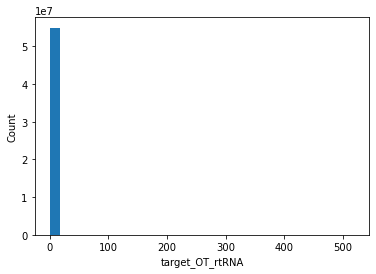

ENSG00000000003
	ENST00000373020: 1332 / 1332 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000000005
	ENST00000373031: 579 / 579 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000000419
	ENST00000371588: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000000457
	ENST00000367770: 1710 / 1710 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000000460
	ENST00000359326: 1824 / 1824 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000000938
	ENST00000374003: 1806 / 1806 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000000971
	ENST00000367429: 1444 / 1444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000001036
	ENST00000002165: 1069 / 1069 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000001084
	ENST00000650454: 1325 / 1325 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000001167
	ENST00000353205: 1307 / 1307 probes passed the filter -inf < target_O

	ENST00000265717: 831 / 831 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005302
	ENST00000647869: 1107 / 1107 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005339
	ENST00000262367: 6657 / 6664 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005379
	ENST00000268893: 5291 / 5291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005381
	ENST00000225275: 2481 / 2481 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005421
	ENST00000222381: 1073 / 1073 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005436
	ENST00000321027: 1092 / 1092 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005448
	ENST00000348227: 1000 / 1000 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005469
	ENST00000331536: 1274 / 1274 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000005471
	ENST00000359206: 2333 / 2333 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000006750: 1072 / 1072 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007314
	ENST00000435607: 6486 / 6486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007341
	ENST00000343210: 765 / 765 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007350
	ENST00000369915: 1809 / 1809 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007372
	ENST00000241001: 1314 / 1314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007376
	ENST00000007264: 1154 / 1154 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007384
	ENST00000262316: 2137 / 2137 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007392
	ENST00000293872: 810 / 810 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007402
	ENST00000479441: 2838 / 2838 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000007516
	ENST00000426824: 3159 / 3159 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000337495: 2659 / 2659 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000010810
	ENST00000368667: 1644 / 1644 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000010818
	ENST00000367603: 6193 / 6193 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000010932
	ENST00000617670: 1161 / 1161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000011007
	ENST00000613537: 3193 / 3193 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000011009
	ENST00000374514: 1126 / 1126 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000011021
	ENST00000346436: 4182 / 4182 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000011028
	ENST00000303375: 3690 / 3690 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000011052
	ENST00000376392: 691 / 691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000011083
	ENST00000230671: 2915 / 2915 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000316649: 1210 / 1210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000016490
	ENST00000394711: 1750 / 1750 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000016602
	ENST00000370563: 1237 / 1237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000016864
	ENST00000491606: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000017260
	ENST00000504948: 1691 / 1691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000017427
	ENST00000644491: 436 / 436 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000017483
	ENST00000620913: 1656 / 1656 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000017797
	ENST00000019317: 2336 / 2336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000018189
	ENST00000381006: 2208 / 2208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000018236
	ENST00000347616: 1971 / 1971 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000367166: 1125 / 1125 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000029725
	ENST00000537505: 2413 / 2413 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000029993
	ENST00000448905: 487 / 487 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000030066
	ENST00000378460: 2685 / 2685 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000030110
	ENST00000374467: 1734 / 1734 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000030304
	ENST00000416899: 2378 / 2378 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000030419
	ENST00000342002: 1940 / 1940 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000030582
	ENST00000053867: 1638 / 1638 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000031003
	ENST00000420893: 1160 / 1160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000031081
	ENST00000264245: 6395 / 6395 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000612830: 2002 / 2002 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000043355
	ENST00000376335: 987 / 987 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000043462
	ENST00000046794: 2084 / 2084 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000043514
	ENST00000316891: 2407 / 2407 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000043591
	ENST00000369295: 1122 / 1122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000044012
	ENST00000372581: 387 / 387 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000044090
	ENST00000690231: 4527 / 4527 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000044115
	ENST00000302763: 2481 / 2481 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000044446
	ENST00000379942: 3745 / 3745 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000044459
	ENST00000380647: 1575 / 1575 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000235835: 905 / 905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053372
	ENST00000330263: 1570 / 1570 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053438
	ENST00000649309: 655 / 655 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053501
	ENST00000263897: 657 / 657 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053524
	ENST00000473233: 2730 / 2730 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053702
	ENST00000337508: 2214 / 2214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053747
	ENST00000313654: 7204 / 7204 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053770
	ENST00000261558: 2590 / 2590 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053900
	ENST00000510092: 928 / 928 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000053918
	ENST00000155840: 2096 / 2096 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000407847: 3464 / 3464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061492
	ENST00000398754: 1161 / 1161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061656
	ENST00000679710: 1026 / 1026 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061676
	ENST00000360982: 1500 / 1500 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061794
	ENST00000081029: 694 / 694 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061918
	ENST00000264424: 1288 / 1288 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061936
	ENST00000541286: 2146 / 2146 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061938
	ENST00000672887: 2343 / 2343 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000061987
	ENST00000393629: 2534 / 2534 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000062038
	ENST00000264012: 3267 / 3267 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000340829: 2464 / 2464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000065911
	ENST00000394053: 1909 / 1909 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000065923
	ENST00000328306: 2373 / 2373 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000065970
	ENST00000162391: 3496 / 3496 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000065978
	ENST00000321358: 1512 / 1512 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000065989
	ENST00000440014: 1953 / 1953 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000066027
	ENST00000261461: 905 / 905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000066032
	ENST00000496558: 2312 / 2312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000066044
	ENST00000596459: 1027 / 1027 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000066056
	ENST00000372476: 2989 / 2989 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000299138: 3235 / 3235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069345
	ENST00000317089: 1035 / 1035 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069399
	ENST00000164227: 969 / 969 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069424
	ENST00000378092: 1138 / 1138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069431
	ENST00000261200: 3429 / 3429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069482
	ENST00000265643: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069493
	ENST00000290855: 1896 / 1896 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069509
	ENST00000378045: 352 / 352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069535
	ENST00000378069: 1688 / 1688 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000069667
	ENST00000449337: 832 / 832 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000678380: 1676 / 1676 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072422
	ENST00000357917: 2530 / 2530 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072501
	ENST00000322213: 6749 / 6749 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072506
	ENST00000168216: 847 / 847 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072518
	ENST00000408948: 1597 / 1597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072571
	ENST00000358715: 747 / 747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072609
	ENST00000432561: 1678 / 1678 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072657
	ENST00000261180: 2324 / 2324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072682
	ENST00000379086: 1836 / 1836 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000072694
	ENST00000236937: 1089 / 1089 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000262138: 2414 / 2414 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075539
	ENST00000358350: 5168 / 5168 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075568
	ENST00000186436: 2866 / 2866 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075618
	ENST00000382361: 1412 / 1412 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075624
	ENST00000493945: 1031 / 1031 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075643
	ENST00000261326: 4020 / 4020 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075651
	ENST00000356327: 2697 / 2697 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075673
	ENST00000218548: 2806 / 2806 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075702
	ENST00000680564: 3418 / 3418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000075711
	ENST00000448528: 1307 / 1307 probes passed the filter -inf < target_OT_rtRNA <  0

ENSG00000078674
	ENST00000519253: 2480 / 2480 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078687
	ENST00000636222: 5246 / 5246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078699
	ENST00000342704: 5053 / 5053 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078725
	ENST00000265922: 2444 / 2444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078747
	ENST00000374864: 2527 / 2543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078795
	ENST00000508883: 631 / 631 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078804
	ENST00000374809: 2821 / 2821 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078808
	ENST00000360001: 1084 / 1084 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078814
	ENST00000262873: 4937 / 4937 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000078898
	ENST00000170150: 1446 / 1446 probes passed the filter -inf < target

	ENST00000265107: 1349 / 1349 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082074
	ENST00000515010: 1464 / 1464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082126
	ENST00000447335: 1509 / 1509 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082146
	ENST00000194530: 905 / 905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082153
	ENST00000409600: 1936 / 1936 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082175
	ENST00000325455: 4171 / 4171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082196
	ENST00000231338: 893 / 893 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082212
	ENST00000321341: 3093 / 3093 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082213
	ENST00000325366: 1185 / 1185 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000082258
	ENST00000295238: 1523 / 1523 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000546361: 2377 / 2377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000085978
	ENST00000392017: 2331 / 2331 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000085982
	ENST00000427112: 1954 / 1954 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000085998
	ENST00000396420: 2211 / 2211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000085999
	ENST00000442598: 2104 / 2104 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000086015
	ENST00000674079: 4350 / 4350 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000086061
	ENST00000330899: 852 / 852 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000086062
	ENST00000379731: 2457 / 2457 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000086065
	ENST00000223500: 663 / 663 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000086102
	ENST00000379540: 3024 / 3024 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000377191: 1655 / 1655 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000088970
	ENST00000619189: 1017 / 1017 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000088986
	ENST00000548342: 405 / 405 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000088992
	ENST00000335209: 644 / 644 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000089006
	ENST00000377768: 1021 / 1021 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000089009
	ENST00000202773: 593 / 593 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000089012
	ENST00000303415: 1519 / 1519 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000089022
	ENST00000551404: 1155 / 1155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000089041
	ENST00000328963: 3417 / 3417 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000089048
	ENST00000617257: 678 / 678 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000205636: 1009 / 1009 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091409
	ENST00000409080: 2379 / 2379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091428
	ENST00000397081: 2191 / 2191 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091436
	ENST00000409176: 1566 / 1566 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091482
	ENST00000646008: 454 / 454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091483
	ENST00000366560: 842 / 842 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091490
	ENST00000399878: 2606 / 2606 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091513
	ENST00000402696: 8093 / 8093 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091527
	ENST00000431519: 437 / 437 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000091536
	ENST00000647165: 8351 / 8351 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000215531: 1059 / 1059 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000095951
	ENST00000541134: 5172 / 5180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000095970
	ENST00000373113: 796 / 796 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000095981
	ENST00000437525: 811 / 811 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000096006
	ENST00000371159: 483 / 483 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000096060
	ENST00000357266: 1879 / 1879 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000096063
	ENST00000373825: 1903 / 1903 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000096070
	ENST00000357641: 4353 / 4353 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000096080
	ENST00000372133: 956 / 956 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000096088
	ENST00000373025: 1194 / 1194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000263212: 3425 / 3425 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100036
	ENST00000343605: 1507 / 1507 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100038
	ENST00000357179: 2227 / 2227 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100053
	ENST00000215855: 667 / 667 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100055
	ENST00000248901: 2643 / 2643 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100056
	ENST00000252137: 4083 / 4086 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100058
	ENST00000415709: 584 / 584 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100060
	ENST00000356998: 1682 / 1682 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100065
	ENST00000251973: 2513 / 2513 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100068
	ENST00000468442: 540 / 540 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000216225: 796 / 796 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100393
	ENST00000674155: 5715 / 5715 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100395
	ENST00000216237: 2868 / 2868 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100399
	ENST00000216241: 1037 / 1037 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100401
	ENST00000405486: 2810 / 2810 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100403
	ENST00000352645: 4088 / 4088 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100410
	ENST00000216252: 689 / 689 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100412
	ENST00000216254: 2248 / 2248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100413
	ENST00000407461: 620 / 620 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100416
	ENST00000645190: 997 / 997 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000651619: 1557 / 1557 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100985
	ENST00000372330: 1597 / 1597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100987
	ENST00000376709: 729 / 729 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100991
	ENST00000451813: 2224 / 2224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100994
	ENST00000216962: 3180 / 3180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000100997
	ENST00000339157: 1182 / 1182 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101000
	ENST00000216968: 919 / 919 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101003
	ENST00000696893: 877 / 877 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101004
	ENST00000422516: 2722 / 2722 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101017
	ENST00000372285: 1254 / 1254 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000217455: 959 / 959 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101474
	ENST00000217456: 1580 / 1580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101489
	ENST00000591282: 1100 / 1100 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101493
	ENST00000443185: 4399 / 4399 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101542
	ENST00000538374: 1886 / 1886 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101544
	ENST00000262198: 2784 / 2784 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101546
	ENST00000306735: 3827 / 3827 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101557
	ENST00000261601: 1546 / 1546 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101558
	ENST00000340541: 524 / 524 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000101574
	ENST00000574538: 1233 / 1233 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000373367: 2048 / 2048 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102384
	ENST00000372926: 918 / 918 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102385
	ENST00000538510: 5544 / 5544 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102387
	ENST00000324762: 955 / 955 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102390
	ENST00000373358: 594 / 594 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102393
	ENST00000218516: 988 / 988 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102401
	ENST00000537169: 1245 / 1245 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102409
	ENST00000372691: 451 / 467 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102445
	ENST00000631139: 1233 / 1233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000102452
	ENST00000251127: 3562 / 3562 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000261622: 3003 / 3003 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103260
	ENST00000568415: 292 / 292 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103264
	ENST00000311635: 4415 / 4415 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103266
	ENST00000219548: 918 / 918 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103269
	ENST00000352681: 804 / 804 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103274
	ENST00000283027: 815 / 815 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103275
	ENST00000566587: 473 / 473 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103310
	ENST00000574091: 1811 / 1811 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103313
	ENST00000536379: 1363 / 1363 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000103316
	ENST00000572914: 851 / 851 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000419617: 828 / 828 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104381
	ENST00000675165: 1386 / 1386 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104388
	ENST00000262646: 713 / 713 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104408
	ENST00000220849: 665 / 665 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104412
	ENST00000220853: 1003 / 1003 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104413
	ENST00000646773: 1596 / 1596 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104415
	ENST00000250160: 2637 / 2637 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104419
	ENST00000323851: 2139 / 2139 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104427
	ENST00000263849: 621 / 621 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000104432
	ENST00000263851: 660 / 660 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000599062: 772 / 772 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105171
	ENST00000585603: 1901 / 1901 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105173
	ENST00000262643: 1107 / 1107 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105176
	ENST00000392271: 914 / 914 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105185
	ENST00000590247: 139 / 139 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105186
	ENST00000306065: 2922 / 2922 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105193
	ENST00000251453: 440 / 440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105197
	ENST00000607714: 3629 / 3629 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105198
	ENST00000221797: 462 / 462 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105202
	ENST00000221801: 869 / 869 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000222286: 1144 / 1144 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105694
	ENST00000590044: 194 / 194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105695
	ENST00000392213: 1586 / 1586 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105696
	ENST00000262817: 934 / 934 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105697
	ENST00000222304: 312 / 312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105698
	ENST00000222305: 952 / 952 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105699
	ENST00000347609: 1178 / 1178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105700
	ENST00000599319: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105701
	ENST00000222308: 1093 / 1093 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000105705
	ENST00000247001: 2006 / 2006 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000306177: 2360 / 2360 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106348
	ENST00000470772: 1485 / 1485 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106351
	ENST00000300176: 3590 / 3590 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106355
	ENST00000450169: 495 / 495 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106366
	ENST00000223095: 2254 / 2254 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106367
	ENST00000646560: 633 / 633 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106384
	ENST00000223114: 1676 / 1676 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106392
	ENST00000223122: 371 / 371 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106397
	ENST00000223127: 2065 / 2065 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000106399
	ENST00000396682: 465 / 465 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000371174: 1030 / 1030 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107485
	ENST00000346208: 1254 / 1254 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107518
	ENST00000355044: 2888 / 2888 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107521
	ENST00000325103: 2857 / 2857 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107537
	ENST00000263038: 673 / 673 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107551
	ENST00000340258: 2718 / 2718 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107554
	ENST00000324109: 4734 / 4734 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107560
	ENST00000355624: 1435 / 1435 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107562
	ENST00000374426: 295 / 295 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000107566
	ENST00000407654: 714 / 714 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000518175: 1249 / 1249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108516
	ENST00000435883: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108518
	ENST00000225655: 489 / 489 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108523
	ENST00000576229: 1244 / 1244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108528
	ENST00000225665: 1243 / 1243 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108551
	ENST00000225688: 1024 / 1024 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108556
	ENST00000649488: 1801 / 1801 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108557
	ENST00000353383: 4374 / 4381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108559
	ENST00000573584: 1859 / 1859 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000108561
	ENST00000225698: 554 / 554 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000402744: 1118 / 1118 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109475
	ENST00000394665: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109501
	ENST00000684054: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109511
	ENST00000359299: 655 / 655 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109519
	ENST00000264954: 1604 / 1604 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109534
	ENST00000394631: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109536
	ENST00000226798: 415 / 415 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109572
	ENST00000613795: 2435 / 2435 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109576
	ENST00000353187: 842 / 842 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000109586
	ENST00000265000: 1423 / 1423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

ENSG00000110680
	ENST00000486207: 493 / 493 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110693
	ENST00000528429: 2084 / 2084 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110696
	ENST00000228136: 1238 / 1238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110697
	ENST00000534749: 2628 / 2628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110700
	ENST00000525634: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110711
	ENST00000279146: 975 / 975 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110713
	ENST00000324932: 4752 / 4752 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110717
	ENST00000313468: 478 / 478 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110719
	ENST00000265686: 1678 / 1678 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000110721
	ENST00000356135: 661 / 661 probes passed the filter -inf < target_OT_rtRN

	ENST00000412586: 625 / 625 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111664
	ENST00000229264: 1450 / 1450 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111665
	ENST00000538862: 901 / 901 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111666
	ENST00000229266: 464 / 464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111667
	ENST00000389231: 2620 / 2620 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111669
	ENST00000396705: 1132 / 1132 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111670
	ENST00000299314: 2498 / 2498 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111671
	ENST00000524270: 758 / 758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111674
	ENST00000229277: 1977 / 1977 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000111676
	ENST00000356654: 3098 / 3098 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000230050: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112308
	ENST00000378119: 653 / 653 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112309
	ENST00000230053: 1924 / 1924 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112312
	ENST00000620958: 313 / 313 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112319
	ENST00000531901: 1594 / 1594 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112320
	ENST00000317357: 2909 / 2914 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112333
	ENST00000368986: 1752 / 1752 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112335
	ENST00000230085: 406 / 406 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112337
	ENST00000377850: 1585 / 1585 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000112339
	ENST00000367837: 2352 / 2352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000658259: 1362 / 1362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113319
	ENST00000265080: 4367 / 4367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113327
	ENST00000639213: 1347 / 1347 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113328
	ENST00000393929: 519 / 519 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113356
	ENST00000504930: 557 / 557 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113360
	ENST00000511367: 3219 / 3219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113361
	ENST00000265071: 3239 / 3239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113368
	ENST00000261366: 1450 / 1450 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113369
	ENST00000265138: 1324 / 1324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000113384
	ENST00000265070: 953 / 953 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000232607: 4646 / 4646 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114503
	ENST00000321256: 843 / 843 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114520
	ENST00000251775: 634 / 634 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114529
	ENST00000264848: 1238 / 1238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114541
	ENST00000398540: 2895 / 2895 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114544
	ENST00000360370: 1785 / 1785 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114547
	ENST00000251776: 623 / 623 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114554
	ENST00000393409: 6355 / 6355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114573
	ENST00000273398: 2013 / 2013 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000114626
	ENST00000232744: 1557 / 1557 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000409374: 472 / 472 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115365
	ENST00000431941: 908 / 908 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115368
	ENST00000314761: 1018 / 1018 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115380
	ENST00000355426: 1240 / 1240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115386
	ENST00000233735: 521 / 521 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115392
	ENST00000696371: 491 / 491 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115414
	ENST00000354785: 6675 / 6675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115415
	ENST00000409465: 1880 / 1880 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115419
	ENST00000320717: 1646 / 1646 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000115421
	ENST00000238714: 2398 / 2398 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000367679: 854 / 854 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116171
	ENST00000371514: 1107 / 1107 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116176
	ENST00000234798: 523 / 523 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116183
	ENST00000367662: 7038 / 7038 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116191
	ENST00000367634: 1824 / 1824 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116194
	ENST00000367629: 920 / 920 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116198
	ENST00000674558: 3643 / 3643 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116199
	ENST00000263733: 2819 / 2819 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116205
	ENST00000234827: 6522 / 6522 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000116209
	ENST00000234831: 2630 / 2630 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000368046: 686 / 686 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117114
	ENST00000370717: 2770 / 2770 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117115
	ENST00000375486: 3355 / 3355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117118
	ENST00000375499: 510 / 510 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117122
	ENST00000375534: 654 / 654 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117133
	ENST00000370654: 668 / 668 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117139
	ENST00000648056: 3851 / 3851 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117143
	ENST00000367926: 1261 / 1261 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117148
	ENST00000617065: 1319 / 1319 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000117151
	ENST00000370630: 1063 / 1063 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000403094: 862 / 862 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118257
	ENST00000357785: 4534 / 4534 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118260
	ENST00000430624: 1010 / 1010 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118263
	ENST00000309446: 4688 / 4688 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118271
	ENST00000237014: 440 / 440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118276
	ENST00000306851: 1199 / 1199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118292
	ENST00000369099: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118298
	ENST00000647854: 1242 / 1242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118307
	ENST00000320267: 843 / 843 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000118308
	ENST00000636465: 2125 / 2125 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000645214: 1671 / 1671 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119541
	ENST00000238497: 1324 / 1324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119547
	ENST00000491143: 6291 / 6291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119559
	ENST00000586564: 621 / 621 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119574
	ENST00000594051: 1166 / 1166 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119596
	ENST00000552421: 3347 / 3347 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119599
	ENST00000509153: 1286 / 1286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119608
	ENST00000556489: 2936 / 2936 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119614
	ENST00000261980: 2223 / 2223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000119616
	ENST00000341162: 2038 / 2038 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000239450: 1594 / 1594 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120329
	ENST00000239451: 850 / 850 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120332
	ENST00000239462: 3976 / 3976 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120333
	ENST00000476371: 826 / 826 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120334
	ENST00000367710: 932 / 932 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120337
	ENST00000404377: 942 / 942 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120341
	ENST00000464631: 2257 / 2257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120370
	ENST00000367763: 855 / 855 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120436
	ENST00000366834: 1556 / 1556 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000120437
	ENST00000367048: 938 / 938 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000263726: 3990 / 3990 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121481
	ENST00000367510: 790 / 790 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121486
	ENST00000367506: 1092 / 1092 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121542
	ENST00000492595: 1371 / 1371 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121552
	ENST00000264474: 295 / 295 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121570
	ENST00000335658: 1275 / 1275 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121577
	ENST00000264231: 1465 / 1465 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121578
	ENST00000393765: 1290 / 1290 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121579
	ENST00000493900: 447 / 447 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000121594
	ENST00000383669: 477 / 477 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000397149: 3504 / 3504 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122694
	ENST00000377960: 1152 / 1152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122696
	ENST00000242275: 591 / 591 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122705
	ENST00000470744: 583 / 583 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122707
	ENST00000377966: 1905 / 1905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122711
	ENST00000379721: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122728
	ENST00000242310: 4219 / 4219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122729
	ENST00000379923: 2366 / 2366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122733
	ENST00000242315: 4622 / 4622 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000122735
	ENST00000242317: 2195 / 2195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000243498: 681 / 681 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123739
	ENST00000502283: 495 / 495 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123810
	ENST00000675972: 747 / 747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123815
	ENST00000677517: 1560 / 1560 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123836
	ENST00000367079: 2069 / 2069 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123838
	ENST00000367070: 1335 / 1335 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123843
	ENST00000391923: 663 / 663 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123870
	ENST00000597158: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123892
	ENST00000243662: 826 / 826 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000123901
	ENST00000243673: 2683 / 2683 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000372530: 4013 / 4013 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124575
	ENST00000244534: 638 / 638 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124587
	ENST00000304611: 2441 / 2441 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124588
	ENST00000380455: 796 / 796 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124593
	ENST00000335515: 2173 / 2173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124596
	ENST00000468811: 357 / 357 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124602
	ENST00000373164: 1263 / 1263 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124608
	ENST00000244571: 3747 / 3747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124610
	ENST00000244573: 576 / 576 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000124613
	ENST00000244576: 1641 / 1641 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000429538: 2992 / 2992 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125629
	ENST00000245787: 1006 / 1006 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125630
	ENST00000263331: 3867 / 3867 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125631
	ENST00000430851: 559 / 559 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125633
	ENST00000376300: 3964 / 3964 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125637
	ENST00000441564: 8644 / 8644 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125648
	ENST00000301454: 2652 / 2652 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125650
	ENST00000245810: 319 / 319 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125651
	ENST00000394456: 1905 / 1905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000125652
	ENST00000245812: 543 / 543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000246533: 1000 / 1000 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126249
	ENST00000246535: 648 / 648 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126251
	ENST00000597214: 941 / 941 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126254
	ENST00000588161: 965 / 965 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126259
	ENST00000360202: 2052 / 2052 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126261
	ENST00000246548: 1921 / 1921 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126262
	ENST00000246549: 1568 / 1568 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126264
	ENST00000437550: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126266
	ENST00000246553: 4017 / 4017 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000126267
	ENST00000392201: 390 / 390 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000455140: 2411 / 2411 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127528
	ENST00000248071: 1388 / 1388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127529
	ENST00000248072: 759 / 759 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127530
	ENST00000248073: 718 / 718 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127533
	ENST00000248076: 2044 / 2044 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127540
	ENST00000589880: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127554
	ENST00000248114: 1615 / 1615 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127561
	ENST00000248121: 1091 / 1091 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127564
	ENST00000573944: 905 / 905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000127578
	ENST00000319070: 789 / 789 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000304164: 2053 / 2053 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128645
	ENST00000331462: 819 / 819 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128652
	ENST00000249440: 1316 / 1316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128654
	ENST00000249442: 468 / 468 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128655
	ENST00000286063: 4500 / 4500 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128656
	ENST00000409900: 1276 / 1276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128683
	ENST00000358196: 1926 / 1926 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128692
	ENST00000461070: 367 / 368 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128694
	ENST00000522700: 818 / 818 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000128699
	ENST00000392350: 514 / 514 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000250776: 716 / 716 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129824
	ENST00000250784: 753 / 753 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129845
	ENST00000250805: 716 / 716 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129862
	ENST00000250823: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129864
	ENST00000250825: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129873
	ENST00000382867: 1206 / 1206 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129910
	ENST00000289746: 1601 / 1601 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129911
	ENST00000617223: 381 / 381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129925
	ENST00000250930: 1568 / 1568 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000129932
	ENST00000672935: 734 / 734 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000001

	ENST00000277531: 3434 / 3434 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130656
	ENST00000252951: 483 / 483 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130669
	ENST00000358301: 1425 / 1425 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130675
	ENST00000543409: 764 / 764 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130684
	ENST00000376436: 2824 / 2824 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130695
	ENST00000451429: 3139 / 3139 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130699
	ENST00000252996: 1561 / 1561 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130700
	ENST00000252997: 1403 / 1403 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130701
	ENST00000252998: 1431 / 1431 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000130702
	ENST00000252999: 6367 / 6367 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000253669: 975 / 975 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131355
	ENST00000253673: 1453 / 1453 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131368
	ENST00000253686: 2839 / 2839 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131370
	ENST00000383791: 1767 / 1767 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131373
	ENST00000321169: 1233 / 1233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131374
	ENST00000429924: 1248 / 1248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131375
	ENST00000253693: 1134 / 1134 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131378
	ENST00000334133: 1870 / 1870 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131379
	ENST00000412910: 2138 / 2138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000131381
	ENST00000476527: 2241 / 2241 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000254605: 4256 / 4256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132286
	ENST00000254616: 1551 / 1551 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132294
	ENST00000519656: 1548 / 1548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132297
	ENST00000673615: 1424 / 1424 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132300
	ENST00000254630: 3367 / 3385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132305
	ENST00000442664: 1739 / 1739 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132313
	ENST00000337109: 1523 / 1523 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132321
	ENST00000431676: 1684 / 1684 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132323
	ENST00000254654: 884 / 884 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132326
	ENST00000254657: 3941 / 3941 probes passed the filter -inf < target_OT_rtRNA <  0.5

ENSG00000132915
	ENST00000255266: 3618 / 3618 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132932
	ENST00000684424: 5373 / 5373 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132938
	ENST00000380808: 974 / 974 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132950
	ENST00000337963: 948 / 948 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132952
	ENST00000255304: 2145 / 2145 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132953
	ENST00000255305: 3257 / 3257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132958
	ENST00000696858: 492 / 492 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132963
	ENST00000380842: 193 / 193 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132964
	ENST00000381527: 1175 / 1175 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000132965
	ENST00000380490: 561 / 561 probes passed the filter -inf < target_OT_rtRN

	ENST00000440873: 1905 / 1905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133935
	ENST00000256319: 1441 / 1441 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133937
	ENST00000238558: 549 / 549 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133943
	ENST00000428926: 2123 / 2123 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133958
	ENST00000695012: 6015 / 6015 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133961
	ENST00000555394: 1993 / 1993 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133962
	ENST00000256343: 1132 / 1132 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133980
	ENST00000256362: 2591 / 2591 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133983
	ENST00000389912: 639 / 639 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000133985
	ENST00000256367: 2604 / 2604 probes passed the filter -inf < target_OT_rtRNA <  0.5.


ENSG00000134595
	ENST00000370536: 1016 / 1016 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134597
	ENST00000305536: 1076 / 1076 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134602
	ENST00000394334: 766 / 766 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134612
	ENST00000525540: 933 / 933 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134627
	ENST00000299001: 1731 / 1731 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134640
	ENST00000257068: 1306 / 1306 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134644
	ENST00000257075: 3519 / 3519 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134668
	ENST00000257100: 1896 / 1896 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134684
	ENST00000373477: 1955 / 1955 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000134686
	ENST00000373418: 1876 / 1876 probes passed the filter -inf < target_O

	ENST00000638915: 1082 / 1082 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135362
	ENST00000530639: 2471 / 2471 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135363
	ENST00000395833: 909 / 909 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135365
	ENST00000418153: 1904 / 1904 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135372
	ENST00000257829: 3110 / 3110 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135373
	ENST00000530286: 772 / 772 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135374
	ENST00000257832: 1144 / 1144 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135378
	ENST00000257836: 1708 / 1708 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135387
	ENST00000532820: 1675 / 1675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135390
	ENST00000394349: 566 / 566 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000611582: 5398 / 5398 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135932
	ENST00000410084: 486 / 486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135940
	ENST00000258424: 405 / 405 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135945
	ENST00000393445: 2124 / 2124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135951
	ENST00000410001: 909 / 909 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135953
	ENST00000258436: 2966 / 2966 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135956
	ENST00000432959: 2221 / 2221 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135960
	ENST00000258443: 2603 / 2603 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135966
	ENST00000258449: 2044 / 2044 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000135968
	ENST00000692694: 1811 / 1811 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000366903: 1136 / 1136 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136631
	ENST00000644510: 1336 / 1336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136634
	ENST00000423557: 960 / 960 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136636
	ENST00000259154: 1572 / 1572 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136643
	ENST00000366960: 2364 / 2364 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136682
	ENST00000259199: 646 / 646 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136688
	ENST00000259205: 695 / 695 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136689
	ENST00000409930: 1219 / 1219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136694
	ENST00000259211: 743 / 743 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000136695
	ENST00000437409: 415 / 415 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000319516: 1148 / 1148 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137204
	ENST00000372589: 2008 / 2008 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137207
	ENST00000506469: 1234 / 1234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137210
	ENST00000379542: 397 / 397 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137216
	ENST00000323267: 2525 / 2525 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137218
	ENST00000259748: 1423 / 1423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137221
	ENST00000436109: 1785 / 1785 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137225
	ENST00000398776: 2233 / 2233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137251
	ENST00000259782: 874 / 874 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137252
	ENST00000370862: 1050 / 1050 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000322954: 2074 / 2074 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137834
	ENST00000288840: 1429 / 1429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137841
	ENST00000456256: 3410 / 3410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137842
	ENST00000260403: 1454 / 1454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137843
	ENST00000453867: 1720 / 1720 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137845
	ENST00000260408: 3657 / 3657 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137857
	ENST00000389037: 4556 / 4556 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137860
	ENST00000347644: 2511 / 2511 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137868
	ENST00000395105: 2122 / 2122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000137869
	ENST00000559878: 1229 / 1229 probes passed the filter -inf < target_OT_rtRNA <  0

ENSG00000138463
	ENST00000261038: 1422 / 1422 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138468
	ENST00000348610: 956 / 956 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138472
	ENST00000261047: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138483
	ENST00000261058: 381 / 381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138495
	ENST00000261070: 221 / 221 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138496
	ENST00000471785: 1583 / 1583 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138587
	ENST00000260453: 434 / 434 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138592
	ENST00000307179: 7503 / 7503 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138593
	ENST00000261847: 2617 / 2617 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000138594
	ENST00000308580: 3094 / 3094 probes passed the filter -inf < target_OT_rtRN

	ENST00000266646: 2022 / 2022 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139278
	ENST00000266659: 1693 / 1693 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139287
	ENST00000333850: 1214 / 1214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139289
	ENST00000602540: 1948 / 1948 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139291
	ENST00000266673: 2299 / 2299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139292
	ENST00000266674: 2024 / 2024 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139304
	ENST00000616559: 2726 / 2726 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139318
	ENST00000279488: 1838 / 1838 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139323
	ENST00000313546: 916 / 916 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000139324
	ENST00000266712: 1215 / 1215 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000674330: 913 / 913 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140199
	ENST00000558667: 2773 / 2773 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140254
	ENST00000560572: 2384 / 2384 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140259
	ENST00000267812: 1223 / 1223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140262
	ENST00000557843: 2161 / 2161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140263
	ENST00000267814: 3032 / 3032 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140264
	ENST00000381359: 1297 / 1297 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140265
	ENST00000396976: 3604 / 3604 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140274
	ENST00000323030: 1213 / 1213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140279
	ENST00000603300: 4898 / 4898 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000396852: 2407 / 2407 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140988
	ENST00000343262: 609 / 609 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140990
	ENST00000268668: 456 / 456 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140992
	ENST00000342085: 4514 / 4514 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140993
	ENST00000396862: 1299 / 1299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000140995
	ENST00000569453: 1463 / 1463 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141002
	ENST00000263346: 1787 / 1787 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141012
	ENST00000268695: 1705 / 1705 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141013
	ENST00000268699: 2500 / 2500 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141026
	ENST00000268711: 1492 / 1492 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000321562: 1855 / 1855 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141759
	ENST00000269601: 1971 / 1971 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141837
	ENST00000636549: 4651 / 4651 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141854
	ENST00000587086: 718 / 718 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141858
	ENST00000533683: 918 / 918 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141867
	ENST00000263377: 4244 / 4244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141873
	ENST00000269740: 735 / 735 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141905
	ENST00000443272: 4552 / 4552 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141933
	ENST00000359315: 235 / 235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000141934
	ENST00000434325: 977 / 977 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000372224: 2104 / 2104 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000142949
	ENST00000438120: 5035 / 5048 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000142959
	ENST00000372207: 1805 / 1805 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000142961
	ENST00000319928: 2301 / 2301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000142973
	ENST00000271153: 1666 / 1666 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143001
	ENST00000371268: 583 / 583 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143006
	ENST00000371445: 1016 / 1016 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143013
	ENST00000370542: 623 / 623 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143028
	ENST00000369872: 2804 / 2804 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143032
	ENST00000370445: 1280 / 1280 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000271835: 1666 / 1666 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143537
	ENST00000531455: 2138 / 2138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143543
	ENST00000271843: 745 / 745 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143545
	ENST00000368575: 758 / 758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143546
	ENST00000368733: 309 / 309 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143549
	ENST00000651641: 3920 / 3920 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143552
	ENST00000368553: 1418 / 1418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143553
	ENST00000368685: 691 / 691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143554
	ENST00000624995: 1573 / 1573 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000143556
	ENST00000368723: 263 / 263 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000389759: 2998 / 2998 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144285
	ENST00000375405: 3545 / 3545 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144290
	ENST00000415876: 2282 / 2282 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144306
	ENST00000409673: 532 / 532 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144320
	ENST00000409660: 728 / 728 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144331
	ENST00000410066: 1387 / 1387 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144339
	ENST00000272771: 1055 / 1055 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144354
	ENST00000695914: 809 / 809 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144355
	ENST00000361725: 1387 / 1405 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000144357
	ENST00000272793: 2580 / 2580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000273814: 2682 / 2682 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145216
	ENST00000306932: 972 / 972 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145217
	ENST00000398516: 1796 / 1796 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145220
	ENST00000452476: 628 / 628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145241
	ENST00000273853: 2367 / 2367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145242
	ENST00000354839: 1896 / 1913 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145244
	ENST00000502252: 2305 / 2305 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145246
	ENST00000273859: 3480 / 3480 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145247
	ENST00000508632: 639 / 639 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000145248
	ENST00000273861: 744 / 744 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000274773: 1659 / 1659 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146063
	ENST00000315073: 2566 / 2566 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146066
	ENST00000274787: 438 / 438 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146067
	ENST00000514747: 2022 / 2022 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146070
	ENST00000537365: 724 / 724 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146072
	ENST00000296861: 2171 / 2171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146083
	ENST00000274811: 2198 / 2198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146085
	ENST00000274813: 1454 / 1454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146090
	ENST00000361132: 1591 / 1591 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000146094
	ENST00000357198: 871 / 871 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

ENSG00000147100
	ENST00000587091: 3005 / 3005 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147113
	ENST00000398000: 3616 / 3616 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147117
	ENST00000377073: 1410 / 1410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147118
	ENST00000376943: 1565 / 1565 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147119
	ENST00000276055: 967 / 967 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147121
	ENST00000478600: 545 / 545 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147123
	ENST00000377811: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147124
	ENST00000313116: 2122 / 2122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147127
	ENST00000374473: 676 / 676 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000147130
	ENST00000314425: 4715 / 4715 probes passed the filter -inf < target_OT_rt

	ENST00000375315: 2147 / 2147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148123
	ENST00000395056: 1065 / 1078 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148136
	ENST00000277216: 487 / 487 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148143
	ENST00000277225: 6923 / 6923 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148153
	ENST00000374242: 1758 / 1758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148154
	ENST00000374279: 973 / 973 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148156
	ENST00000374667: 912 / 912 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148158
	ENST00000374232: 4311 / 4311 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148175
	ENST00000286713: 1497 / 1497 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000148180
	ENST00000432226: 1929 / 1929 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000278409: 685 / 685 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149136
	ENST00000278412: 2335 / 2335 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149150
	ENST00000528450: 1901 / 1901 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149177
	ENST00000418331: 4516 / 4516 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149179
	ENST00000278460: 1243 / 1243 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149182
	ENST00000524782: 2463 / 2463 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149187
	ENST00000358597: 1516 / 1516 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149196
	ENST00000278483: 479 / 479 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149201
	ENST00000445632: 1492 / 1492 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000149212
	ENST00000536441: 2437 / 2437 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000434316: 1637 / 1637 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150433
	ENST00000527271: 445 / 445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150455
	ENST00000392680: 1730 / 1746 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150456
	ENST00000382754: 490 / 490 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150457
	ENST00000382592: 2681 / 2681 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150459
	ENST00000607003: 1059 / 1059 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150471
	ENST00000508946: 3024 / 3024 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150477
	ENST00000280020: 2843 / 2843 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150510
	ENST00000322475: 2824 / 2824 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000150527
	ENST00000553728: 1423 / 1423 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000369248: 1756 / 1756 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151572
	ENST00000392979: 2095 / 2095 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151575
	ENST00000352903: 307 / 307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151576
	ENST00000281273: 2214 / 2214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151577
	ENST00000467632: 1217 / 1217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151611
	ENST00000541599: 886 / 895 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151612
	ENST00000503462: 4617 / 4617 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151615
	ENST00000281321: 1257 / 1257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151617
	ENST00000651419: 1527 / 1527 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000151623
	ENST00000511528: 1947 / 1947 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000512453: 998 / 998 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152503
	ENST00000282369: 1187 / 1187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152518
	ENST00000282388: 1240 / 1240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152520
	ENST00000399613: 1866 / 1866 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152527
	ENST00000282406: 3039 / 3039 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152556
	ENST00000550924: 2357 / 2357 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152558
	ENST00000528969: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152578
	ENST00000525187: 1626 / 1626 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152580
	ENST00000282466: 4903 / 4919 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000152582
	ENST00000509059: 1660 / 1660 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000607772: 10394 / 10394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153767
	ENST00000283875: 1494 / 1494 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153774
	ENST00000283882: 772 / 772 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153779
	ENST00000283891: 645 / 645 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153786
	ENST00000313732: 2180 / 2180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153789
	ENST00000629253: 754 / 754 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153790
	ENST00000409280: 1246 / 1246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153802
	ENST00000283916: 1067 / 1067 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153814
	ENST00000283928: 1051 / 1051 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000153815
	ENST00000537098: 2873 / 2873 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000396182: 1695 / 1695 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154710
	ENST00000450873: 1199 / 1199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154719
	ENST00000352957: 408 / 408 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154721
	ENST00000400532: 975 / 975 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154723
	ENST00000284971: 181 / 181 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154727
	ENST00000354828: 1304 / 1304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154734
	ENST00000284984: 2792 / 2792 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154736
	ENST00000284987: 3220 / 3220 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154743
	ENST00000454502: 1023 / 1023 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000154760
	ENST00000533791: 2396 / 2396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000393010: 1742 / 1742 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155897
	ENST00000286355: 3020 / 3020 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155903
	ENST00000286364: 1396 / 1396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155906
	ENST00000444024: 924 / 924 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155918
	ENST00000286380: 664 / 664 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155926
	ENST00000427060: 1589 / 1589 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155957
	ENST00000358230: 1050 / 1050 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155959
	ENST00000286428: 386 / 386 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155961
	ENST00000369454: 1494 / 1494 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000155962
	ENST00000369449: 820 / 820 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000287585: 3631 / 3631 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000156966
	ENST00000287590: 2293 / 2293 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000156968
	ENST00000396385: 2776 / 2776 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000156970
	ENST00000287598: 1941 / 1941 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000156973
	ENST00000287600: 610 / 610 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000156976
	ENST00000323963: 869 / 869 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000156983
	ENST00000682980: 3498 / 3498 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000156990
	ENST00000383820: 924 / 924 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000157005
	ENST00000287641: 363 / 363 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000157014
	ENST00000448281: 3722 / 3722 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000288873: 587 / 587 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000157999
	ENST00000409061: 1022 / 1022 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158006
	ENST00000374284: 1937 / 1937 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158008
	ENST00000374280: 2657 / 2657 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158014
	ENST00000374276: 2675 / 2675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158019
	ENST00000379624: 1106 / 1106 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158022
	ENST00000374272: 1319 / 1319 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158023
	ENST00000397454: 2223 / 2223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158042
	ENST00000288937: 1417 / 1417 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158050
	ENST00000288943: 988 / 988 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000395246: 1213 / 1213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000158987
	ENST00000627212: 2190 / 2190 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159023
	ENST00000349460: 1690 / 1690 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159055
	ENST00000290130: 610 / 610 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159063
	ENST00000680256: 841 / 841 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159069
	ENST00000325285: 1394 / 1394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159079
	ENST00000290155: 1971 / 1971 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159082
	ENST00000357345: 2997 / 2997 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159086
	ENST00000331923: 1046 / 1046 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000159110
	ENST00000382264: 436 / 436 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000377038: 4004 / 4004 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160050
	ENST00000373602: 594 / 594 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160051
	ENST00000291358: 1758 / 1758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160055
	ENST00000309777: 872 / 872 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160058
	ENST00000455895: 2710 / 2710 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160062
	ENST00000373510: 2884 / 2884 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160072
	ENST00000673477: 2724 / 2724 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160075
	ENST00000291386: 602 / 602 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160087
	ENST00000360466: 553 / 553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160094
	ENST00000373428: 1691 / 1691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000430002: 1356 / 1356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160803
	ENST00000368309: 2809 / 2809 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160808
	ENST00000292327: 688 / 688 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160813
	ENST00000292330: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160818
	ENST00000438976: 970 / 970 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160838
	ENST00000337428: 1561 / 1561 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160856
	ENST00000368186: 1751 / 1751 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160862
	ENST00000292401: 883 / 883 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160867
	ENST00000393637: 1804 / 1804 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000160868
	ENST00000651514: 1401 / 1401 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000293845: 1163 / 1163 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000161980
	ENST00000293860: 783 / 783 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000161981
	ENST00000293861: 888 / 888 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000161992
	ENST00000409413: 700 / 700 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000161996
	ENST00000293879: 3459 / 3459 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000161999
	ENST00000609261: 1422 / 1422 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162004
	ENST00000345165: 1041 / 1041 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162006
	ENST00000442466: 1162 / 1162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162009
	ENST00000293897: 1340 / 1340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162032
	ENST00000301717: 896 / 896 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000471115: 1139 / 1139 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162643
	ENST00000294664: 1232 / 1232 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162645
	ENST00000370466: 2107 / 2107 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162650
	ENST00000369870: 1692 / 1692 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162654
	ENST00000355754: 2992 / 2992 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162664
	ENST00000370447: 2489 / 2489 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162669
	ENST00000370425: 833 / 833 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162670
	ENST00000367462: 1774 / 1774 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162676
	ENST00000427103: 1675 / 1675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000162685
	ENST00000449530: 164 / 164 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000295228: 1718 / 1718 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163092
	ENST00000672671: 4049 / 4049 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163093
	ENST00000295240: 1217 / 1217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163098
	ENST00000652230: 794 / 794 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163104
	ENST00000457823: 1134 / 1134 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163106
	ENST00000295256: 714 / 714 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163110
	ENST00000542407: 1649 / 1649 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163114
	ENST00000295266: 826 / 826 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163116
	ENST00000295268: 791 / 791 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163121
	ENST00000451794: 879 / 879 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000478945: 784 / 784 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163531
	ENST00000513543: 3512 / 3512 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163534
	ENST00000491942: 1211 / 1211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163535
	ENST00000409203: 171 / 171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163536
	ENST00000446050: 594 / 594 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163539
	ENST00000468888: 2779 / 2779 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163541
	ENST00000393868: 837 / 837 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163545
	ENST00000367157: 2449 / 2449 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163554
	ENST00000643759: 5816 / 5816 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163558
	ENST00000295797: 1470 / 1470 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000296252: 2523 / 2523 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163900
	ENST00000421852: 1735 / 1735 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163902
	ENST00000296255: 1499 / 1499 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163904
	ENST00000296257: 2886 / 2886 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163909
	ENST00000372852: 3225 / 3225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163913
	ENST00000347300: 3180 / 3180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163914
	ENST00000296271: 2172 / 2172 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163915
	ENST00000465364: 167 / 167 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163918
	ENST00000296273: 712 / 712 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000163923
	ENST00000455270: 297 / 297 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000504899: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164221
	ENST00000395557: 568 / 568 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164236
	ENST00000296657: 5707 / 5707 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164237
	ENST00000296658: 2385 / 2385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164241
	ENST00000296662: 449 / 449 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164244
	ENST00000296666: 1926 / 1926 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164251
	ENST00000296677: 1548 / 1548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164252
	ENST00000312916: 1400 / 1400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164253
	ENST00000296679: 1276 / 1276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164256
	ENST00000296682: 2531 / 2547 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000297265: 978 / 978 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164707
	ENST00000354042: 2304 / 2304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164708
	ENST00000297283: 633 / 633 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164713
	ENST00000297290: 357 / 357 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164715
	ENST00000297293: 5272 / 5272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164729
	ENST00000297307: 1231 / 1231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164733
	ENST00000527243: 1417 / 1417 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164736
	ENST00000297316: 627 / 627 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164740
	ENST00000434048: 93 / 93 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000164741
	ENST00000358919: 3068 / 3068 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000379361: 5858 / 5858 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165188
	ENST00000416588: 575 / 575 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165192
	ENST00000480796: 1492 / 1492 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165194
	ENST00000420881: 4281 / 4281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165195
	ENST00000333590: 1231 / 1231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165197
	ENST00000297904: 1198 / 1198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165202
	ENST00000297913: 764 / 764 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165204
	ENST00000277309: 758 / 758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165209
	ENST00000447404: 2534 / 2534 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165215
	ENST00000395145: 484 / 484 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000371692: 1360 / 1360 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165724
	ENST00000298585: 807 / 820 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165730
	ENST00000399169: 1548 / 1548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165731
	ENST00000340058: 2761 / 2761 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165732
	ENST00000354185: 1836 / 1836 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165733
	ENST00000374518: 4182 / 4182 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165752
	ENST00000298630: 1264 / 1264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165757
	ENST00000375377: 5464 / 5464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165762
	ENST00000298642: 497 / 497 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000165775
	ENST00000369498: 3096 / 3096 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000373202: 3796 / 3796 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166225
	ENST00000397997: 1902 / 1902 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166226
	ENST00000299300: 1000 / 1000 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166228
	ENST00000299299: 549 / 549 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166233
	ENST00000379887: 8465 / 8465 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166246
	ENST00000299320: 1706 / 1706 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166250
	ENST00000448775: 2403 / 2403 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166257
	ENST00000530277: 2516 / 2516 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166260
	ENST00000299335: 838 / 838 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166261
	ENST00000529691: 2451 / 2451 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000345795: 1050 / 1050 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166736
	ENST00000504030: 1835 / 1835 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166741
	ENST00000535401: 1352 / 1352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166743
	ENST00000307493: 1747 / 1747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166747
	ENST00000393512: 2189 / 2189 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166750
	ENST00000299977: 4198 / 4198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166762
	ENST00000381761: 1019 / 1019 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166763
	ENST00000509801: 4531 / 4531 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166770
	ENST00000591797: 301 / 301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000166780
	ENST00000300006: 1463 / 1463 probes passed the filter -inf < target_OT_rtRNA <  0.5

ENSG00000167194
	ENST00000300575: 670 / 670 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167195
	ENST00000300576: 2602 / 2602 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167196
	ENST00000308275: 3162 / 3162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167202
	ENST00000300584: 4324 / 4324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167207
	ENST00000647318: 3153 / 3153 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167208
	ENST00000330943: 1945 / 1945 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167210
	ENST00000642948: 6192 / 6192 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167216
	ENST00000356157: 1797 / 1797 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167220
	ENST00000300605: 949 / 949 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167232
	ENST00000300619: 1186 / 1186 probes passed the filter -inf < target_O

	ENST00000645548: 1630 / 1630 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167703
	ENST00000571650: 2073 / 2073 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167705
	ENST00000301336: 751 / 751 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167711
	ENST00000453066: 1640 / 1640 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167716
	ENST00000409644: 4819 / 4819 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167720
	ENST00000344595: 1185 / 1185 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167721
	ENST00000301364: 2654 / 2654 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167723
	ENST00000301365: 2562 / 2562 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167733
	ENST00000616276: 979 / 979 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000167740
	ENST00000301391: 1331 / 1331 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000304936: 1090 / 1090 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168159
	ENST00000305943: 1979 / 1979 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168172
	ENST00000307602: 4644 / 4644 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168175
	ENST00000622254: 1010 / 1010 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168209
	ENST00000307365: 1114 / 1114 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168214
	ENST00000680928: 923 / 923 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168216
	ENST00000649011: 504 / 504 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168228
	ENST00000302874: 1329 / 1329 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168229
	ENST00000306051: 1261 / 1261 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168234
	ENST00000317571: 1921 / 1921 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000372886: 765 / 765 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168743
	ENST00000506666: 1603 / 1603 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168746
	ENST00000306731: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168748
	ENST00000338437: 1144 / 1160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168754
	ENST00000490605: 2012 / 2012 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168757
	ENST00000429039: 471 / 471 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168758
	ENST00000305476: 2543 / 2543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168763
	ENST00000305510: 2912 / 2912 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168765
	ENST00000336075: 548 / 548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000168769
	ENST00000380013: 4787 / 4787 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000366488: 1249 / 1249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169228
	ENST00000393611: 910 / 910 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169230
	ENST00000303204: 878 / 878 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169231
	ENST00000368378: 2768 / 2768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169239
	ENST00000454127: 1091 / 1091 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169241
	ENST00000368404: 963 / 963 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169242
	ENST00000368407: 1244 / 1244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169245
	ENST00000306602: 389 / 389 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169246
	ENST00000448012: 707 / 707 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169247
	ENST00000512049: 3320 / 3320 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000303804: 967 / 967 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169811
	ENST00000382759: 890 / 890 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169813
	ENST00000337970: 1429 / 1429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169814
	ENST00000672065: 1595 / 1595 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169826
	ENST00000374466: 1223 / 1223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169836
	ENST00000304883: 1585 / 1585 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169840
	ENST00000302945: 959 / 959 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169849
	ENST00000303979: 623 / 623 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169851
	ENST00000361762: 2772 / 2772 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000169855
	ENST00000467549: 3698 / 3698 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000394092: 1140 / 1140 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170367
	ENST00000304710: 587 / 587 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170369
	ENST00000304725: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170370
	ENST00000553456: 1372 / 1372 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170373
	ENST00000398402: 543 / 543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170374
	ENST00000303846: 2263 / 2263 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170379
	ENST00000441159: 3581 / 3581 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170381
	ENST00000643230: 2727 / 2727 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170382
	ENST00000367176: 2454 / 2454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170385
	ENST00000367001: 1194 / 1194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000485876: 719 / 719 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170909
	ENST00000356532: 913 / 913 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170915
	ENST00000360726: 2533 / 2533 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170917
	ENST00000304430: 563 / 563 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170919
	ENST00000619457: 154 / 154 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170920
	ENST00000305444: 687 / 687 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170921
	ENST00000424789: 7763 / 7763 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170923
	ENST00000641081: 2095 / 2095 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170925
	ENST00000302917: 1073 / 1073 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000170927
	ENST00000340994: 8071 / 8071 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000302625: 1213 / 1213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171451
	ENST00000310045: 3073 / 3073 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171453
	ENST00000642195: 1021 / 1021 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171456
	ENST00000620121: 4198 / 4198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171459
	ENST00000304720: 801 / 801 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171462
	ENST00000372488: 970 / 970 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171466
	ENST00000590155: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171467
	ENST00000361428: 5173 / 5173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171469
	ENST00000302851: 2249 / 2249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171475
	ENST00000583130: 1107 / 1107 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000305899: 832 / 832 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171943
	ENST00000367123: 2871 / 2871 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171944
	ENST00000307388: 1070 / 1070 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171951
	ENST00000305409: 1281 / 1281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171953
	ENST00000474627: 1146 / 1146 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171954
	ENST00000601005: 1883 / 1883 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171956
	ENST00000396057: 1235 / 1235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171960
	ENST00000304979: 529 / 529 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171962
	ENST00000399187: 1612 / 1612 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000171970
	ENST00000306908: 1194 / 1194 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000489864: 458 / 458 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172461
	ENST00000302103: 2639 / 2639 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172464
	ENST00000544374: 547 / 547 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172465
	ENST00000372626: 467 / 467 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172466
	ENST00000261332: 2120 / 2120 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172468
	ENST00000307393: 438 / 438 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172469
	ENST00000684753: 900 / 900 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172476
	ENST00000304236: 1006 / 1006 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172478
	ENST00000388934: 1733 / 1733 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000172482
	ENST00000307503: 2055 / 2055 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000581407: 2534 / 2534 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173068
	ENST00000380667: 2542 / 2542 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173077
	ENST00000647996: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173080
	ENST00000368318: 1069 / 1069 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173083
	ENST00000311412: 2238 / 2238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173085
	ENST00000647002: 618 / 618 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173093
	ENST00000552694: 1277 / 1277 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173110
	ENST00000309758: 1658 / 1658 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173113
	ENST00000308774: 387 / 387 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173114
	ENST00000308478: 1247 / 1247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000379607: 783 / 783 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173678
	ENST00000436228: 1044 / 1044 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173679
	ENST00000309623: 536 / 536 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173681
	ENST00000379682: 2267 / 2267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173692
	ENST00000308696: 1686 / 1686 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173698
	ENST00000356606: 2562 / 2562 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173699
	ENST00000455816: 604 / 604 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173702
	ENST00000616727: 1690 / 1690 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173705
	ENST00000309558: 2851 / 2851 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000173706
	ENST00000311127: 6080 / 6080 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000686964: 219 / 219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174408
	ENST00000328558: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174417
	ENST00000311762: 741 / 741 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174418
	ENST00000446059: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174428
	ENST00000651028: 3225 / 3225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174429
	ENST00000311955: 1161 / 1161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174437
	ENST00000308664: 2359 / 2359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174442
	ENST00000307897: 1120 / 1121 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174444
	ENST00000307961: 1671 / 1671 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000174446
	ENST00000395589: 544 / 544 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000310421: 3379 / 3379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175077
	ENST00000312295: 1552 / 1552 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175084
	ENST00000373960: 1587 / 1587 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175087
	ENST00000374269: 1151 / 1151 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175093
	ENST00000310546: 1559 / 1559 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175097
	ENST00000311485: 914 / 914 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175104
	ENST00000348124: 1316 / 1316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175105
	ENST00000636215: 1355 / 1355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175106
	ENST00000438826: 471 / 471 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175110
	ENST00000310776: 533 / 533 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000317019: 2015 / 2015 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175730
	ENST00000317045: 499 / 499 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175741
	ENST00000426392: 185 / 185 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175745
	ENST00000327111: 1532 / 1532 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175746
	ENST00000687272: 348 / 348 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175749
	ENST00000513279: 595 / 595 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175756
	ENST00000338338: 413 / 413 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175764
	ENST00000321582: 6630 / 6630 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175766
	ENST00000504597: 1440 / 1440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000175768
	ENST00000321301: 308 / 308 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000326152: 1234 / 1234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176390
	ENST00000324238: 1187 / 1187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176393
	ENST00000295640: 1543 / 1543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176396
	ENST00000390658: 470 / 470 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176399
	ENST00000325870: 1416 / 1416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176401
	ENST00000326282: 937 / 937 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176402
	ENST00000312891: 760 / 760 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176406
	ENST00000504942: 2483 / 2483 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176407
	ENST00000409785: 3072 / 3072 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176410
	ENST00000395176: 1764 / 1764 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000530303: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176986
	ENST00000345254: 3772 / 3772 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176988
	ENST00000370467: 645 / 645 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176994
	ENST00000406438: 6323 / 6323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000176998
	ENST00000418983: 643 / 643 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177000
	ENST00000423400: 2385 / 2385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177023
	ENST00000316169: 141 / 141 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177025
	ENST00000314391: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177030
	ENST00000382409: 1420 / 1420 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177034
	ENST00000509852: 1326 / 1339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

ENSG00000177596
	ENST00000325811: 1484 / 1484 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177599
	ENST00000323169: 1600 / 1600 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177600
	ENST00000321153: 229 / 229 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177602
	ENST00000325418: 1824 / 1824 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177606
	ENST00000371222: 1552 / 1552 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177613
	ENST00000331173: 2134 / 2134 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177614
	ENST00000391860: 6906 / 6906 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177627
	ENST00000548364: 707 / 707 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177628
	ENST00000368373: 2103 / 2103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000177640
	ENST00000614455: 219 / 219 probes passed the filter -inf < target_OT_

	ENST00000451188: 3129 / 3129 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178234
	ENST00000430044: 1502 / 1502 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178235
	ENST00000674365: 3006 / 3006 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178243
	ENST00000623103: 1387 / 1387 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178248
	ENST00000320372: 1085 / 1085 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178252
	ENST00000608424: 3551 / 3551 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178257
	ENST00000327157: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178279
	ENST00000312693: 403 / 403 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178287
	ENST00000642566: 477 / 477 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178295
	ENST00000317402: 3562 / 3562 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000595615: 358 / 358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178982
	ENST00000248342: 641 / 641 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178988
	ENST00000320848: 881 / 881 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178996
	ENST00000381410: 1631 / 1631 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178997
	ENST00000314992: 1469 / 1469 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000178999
	ENST00000585124: 977 / 977 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179002
	ENST00000375371: 2199 / 2199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179008
	ENST00000321731: 300 / 300 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179010
	ENST00000507420: 375 / 375 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179021
	ENST00000318887: 705 / 705 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000001

	ENST00000641114: 756 / 756 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179626
	ENST00000394256: 482 / 482 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179627
	ENST00000555360: 705 / 705 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179630
	ENST00000325686: 995 / 995 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179632
	ENST00000532522: 899 / 899 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179636
	ENST00000530140: 617 / 617 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179639
	ENST00000693622: 463 / 464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179673
	ENST00000322329: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179674
	ENST00000320767: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179676
	ENST00000456505: 137 / 137 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000179695


	ENST00000409122: 1033 / 1033 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180340
	ENST00000315323: 2218 / 2218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180346
	ENST00000603357: 1178 / 1178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180347
	ENST00000407970: 2548 / 2548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180353
	ENST00000314583: 1675 / 1675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180354
	ENST00000324453: 2898 / 2898 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180357
	ENST00000326648: 7008 / 7008 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180370
	ENST00000327134: 2235 / 2235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180376
	ENST00000326595: 912 / 912 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000180383
	ENST00000317676: 570 / 570 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000317093: 601 / 601 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181016
	ENST00000439068: 458 / 458 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181017
	ENST00000641377: 1061 / 1061 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181019
	ENST00000320623: 1314 / 1314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181023
	ENST00000317121: 1031 / 1031 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181026
	ENST00000332810: 2225 / 2225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181027
	ENST00000391909: 1463 / 1463 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181029
	ENST00000426877: 330 / 330 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181031
	ENST00000618002: 1797 / 1797 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181035
	ENST00000318596: 2289 / 2289 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000314797: 2521 / 2521 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181790
	ENST00000323289: 2831 / 2831 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181798
	ENST00000313064: 816 / 816 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181800
	ENST00000379256: 1366 / 1366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181803
	ENST00000320704: 727 / 727 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181804
	ENST00000316549: 2059 / 2075 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181817
	ENST00000315732: 639 / 639 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181819
	ENST00000512203: 537 / 537 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181826
	ENST00000314117: 905 / 905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000181827
	ENST00000559447: 4197 / 4197 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000658419: 860 / 860 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182372
	ENST00000519254: 1264 / 1264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182376
	ENST00000567588: 1258 / 1258 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182378
	ENST00000399012: 3727 / 3727 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182379
	ENST00000349394: 1033 / 1033 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182383
	ENST00000469428: 407 / 407 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182389
	ENST00000534999: 1270 / 1270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182393
	ENST00000333625: 530 / 530 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182397
	ENST00000425045: 460 / 460 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182400
	ENST00000330149: 889 / 889 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000328801: 1783 / 1783 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182944
	ENST00000414183: 1656 / 1656 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182950
	ENST00000332145: 885 / 885 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182952
	ENST00000377575: 770 / 770 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182957
	ENST00000399949: 2445 / 2445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182963
	ENST00000330514: 1658 / 1658 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182965
	ENST00000343743: 372 / 372 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182968
	ENST00000330949: 1754 / 1754 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182973
	ENST00000328834: 1314 / 1314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000182974
	ENST00000332663: 579 / 579 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000332715: 410 / 410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183470
	ENST00000573229: 470 / 470 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183474
	ENST00000510979: 1159 / 1159 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183475
	ENST00000332783: 2212 / 2212 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183476
	ENST00000328828: 1917 / 1917 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183479
	ENST00000370231: 536 / 536 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183484
	ENST00000539291: 2097 / 2097 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183486
	ENST00000330714: 2222 / 2222 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183495
	ENST00000389561: 7352 / 7352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183496
	ENST00000329713: 1313 / 1313 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000389173: 11569 / 11569 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183918
	ENST00000360027: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183921
	ENST00000602312: 1847 / 1847 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183929
	ENST00000441325: 863 / 863 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183935
	ENST00000538670: 937 / 937 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183938
	ENST00000331828: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183943
	ENST00000262848: 2954 / 2954 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183955
	ENST00000402868: 1703 / 1703 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183960
	ENST00000328405: 2893 / 2893 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000183963
	ENST00000333137: 2230 / 2230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000641160: 1505 / 1505 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184481
	ENST00000374259: 2818 / 2818 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184486
	ENST00000328345: 1655 / 1655 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184489
	ENST00000521578: 1592 / 1592 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184492
	ENST00000306507: 1434 / 1434 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184494
	ENST00000473226: 1382 / 1382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184497
	ENST00000375353: 4046 / 4046 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184500
	ENST00000348974: 915 / 915 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184502
	ENST00000329402: 317 / 317 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000184507
	ENST00000333756: 3232 / 3232 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000426621: 1433 / 1433 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185024
	ENST00000547530: 2145 / 2145 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185028
	ENST00000328278: 1459 / 1459 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185031
	ENST00000331747: 1034 / 1034 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185033
	ENST00000411539: 2736 / 2736 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185037
	ENST00000331425: 708 / 708 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185038
	ENST00000610772: 4576 / 4576 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185040
	ENST00000515340: 715 / 715 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185043
	ENST00000328649: 788 / 788 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185046
	ENST00000683438: 2963 / 2963 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000329451: 929 / 929 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185523
	ENST00000332912: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185527
	ENST00000571004: 370 / 370 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185532
	ENST00000401604: 2180 / 2180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185551
	ENST00000394166: 2124 / 2124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185559
	ENST00000341267: 2995 / 2995 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185561
	ENST00000330676: 3719 / 3719 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185565
	ENST00000490035: 4068 / 4068 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185567
	ENST00000333244: 14130 / 14130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000185585
	ENST00000288815: 4474 / 4474 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000334062: 2970 / 2970 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186001
	ENST00000414675: 1307 / 1307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186007
	ENST00000391936: 485 / 485 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186008
	ENST00000603814: 515 / 515 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186009
	ENST00000335288: 930 / 946 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186010
	ENST00000507754: 406 / 406 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186017
	ENST00000434377: 1463 / 1481 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186019
	ENST00000590369: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186020
	ENST00000591340: 1361 / 1361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186026
	ENST00000421176: 2148 / 2148 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000644820: 4105 / 4105 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186493
	ENST00000649739: 138 / 138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186496
	ENST00000589332: 1315 / 1315 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186501
	ENST00000374076: 1214 / 1214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186508
	ENST00000427941: 575 / 575 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186509
	ENST00000612174: 1160 / 1160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186510
	ENST00000331433: 2104 / 2104 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186513
	ENST00000641291: 1680 / 1680 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186517
	ENST00000368016: 2883 / 2883 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000186522
	ENST00000397714: 849 / 849 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

ENSG00000187051
	ENST00000334678: 551 / 551 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187054
	ENST00000334830: 834 / 834 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187066
	ENST00000530719: 445 / 445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187068
	ENST00000335012: 3646 / 3646 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187079
	ENST00000527636: 4084 / 4084 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187080
	ENST00000366480: 618 / 618 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187082
	ENST00000335479: 138 / 138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187091
	ENST00000334661: 2065 / 2065 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187094
	ENST00000434608: 394 / 394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187097
	ENST00000334696: 2761 / 2761 probes passed the filter -inf < target_OT_rtRNA 

	ENST00000374115: 1294 / 1294 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187715
	ENST00000405256: 3358 / 3358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187720
	ENST00000355327: 6209 / 6209 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187721
	ENST00000433887: 187 / 187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187726
	ENST00000339764: 919 / 919 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187730
	ENST00000378585: 1340 / 1340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187733
	ENST00000370079: 782 / 782 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187735
	ENST00000521604: 719 / 719 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187736
	ENST00000356853: 5279 / 5279 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000187741
	ENST00000389301: 4119 / 4119 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000394468: 1047 / 1047 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188176
	ENST00000389313: 1229 / 1229 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188177
	ENST00000409871: 4162 / 4162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188185
	ENST00000448955: 375 / 375 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188186
	ENST00000341942: 484 / 484 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188191
	ENST00000403562: 1215 / 1215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188199
	ENST00000429828: 2376 / 2376 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188211
	ENST00000338965: 4339 / 4339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188215
	ENST00000563934: 1294 / 1294 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188219
	ENST00000356920: 2437 / 2437 probes passed the filter -inf < target_OT_rtRNA <  0.5.


	ENST00000653494: 824 / 824 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188694
	ENST00000340345: 760 / 760 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188706
	ENST00000371064: 1711 / 1711 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188707
	ENST00000463441: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188710
	ENST00000343079: 263 / 263 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188712
	ENST00000412501: 476 / 476 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188716
	ENST00000338487: 759 / 759 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188725
	ENST00000507416: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188729
	ENST00000682035: 543 / 543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188730
	ENST00000340652: 2616 / 2616 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000188

	ENST00000345108: 573 / 573 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189169
	ENST00000400365: 540 / 540 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189171
	ENST00000476133: 381 / 381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189180
	ENST00000458705: 2009 / 2009 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189181
	ENST00000342623: 727 / 727 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189182
	ENST00000341809: 2671 / 2671 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189184
	ENST00000412923: 2453 / 2453 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189186
	ENST00000545306: 1526 / 1526 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189190
	ENST00000688329: 1279 / 1279 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000189195
	ENST00000636805: 1899 / 1899 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000327892: 1934 / 1934 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196231
	ENST00000358688: 663 / 663 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196233
	ENST00000675537: 1170 / 1170 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196235
	ENST00000432763: 3051 / 3052 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196236
	ENST00000357137: 4382 / 4382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196240
	ENST00000642130: 1996 / 1996 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196242
	ENST00000366487: 3809 / 3809 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196243
	ENST00000546725: 678 / 678 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196247
	ENST00000613690: 513 / 513 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196248
	ENST00000641123: 926 / 926 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000449103: 4394 / 4394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196578
	ENST00000358642: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196581
	ENST00000378190: 1121 / 1121 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196584
	ENST00000359321: 1831 / 1847 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196586
	ENST00000672093: 1553 / 1553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196588
	ENST00000652095: 2904 / 2920 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196589
	ENST00000637800: 597 / 597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196591
	ENST00000519065: 2871 / 2871 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196593
	ENST00000602724: 207 / 207 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000196597
	ENST00000535338: 1379 / 1379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000396014: 641 / 641 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197008
	ENST00000307355: 620 / 620 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197013
	ENST00000358491: 1346 / 1346 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197016
	ENST00000391709: 2400 / 2416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197019
	ENST00000357949: 1358 / 1358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197020
	ENST00000358296: 1370 / 1370 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197021
	ENST00000355203: 848 / 848 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197023
	ENST00000418680: 617 / 617 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197024
	ENST00000475153: 3198 / 3198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197037
	ENST00000334715: 2860 / 2860 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000355085: 1520 / 1520 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197406
	ENST00000510508: 1470 / 1470 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197408
	ENST00000324071: 2291 / 2291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197409
	ENST00000356476: 348 / 348 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197410
	ENST00000357232: 6426 / 6426 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197415
	ENST00000392832: 1738 / 1738 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197416
	ENST00000360464: 393 / 393 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197417
	ENST00000225519: 2992 / 2992 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197421
	ENST00000430306: 218 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197428
	ENST00000357605: 966 / 966 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000360194: 1044 / 1044 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197808
	ENST00000360357: 815 / 815 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197813
	ENST00000602554: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197815
	ENST00000354746: 1365 / 1365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197816
	ENST00000529487: 5377 / 5377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197818
	ENST00000361573: 4277 / 4277 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197822
	ENST00000681041: 1456 / 1466 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197826
	ENST00000358105: 408 / 408 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197837
	ENST00000539745: 330 / 330 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000197838
	ENST00000330436: 1431 / 1431 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000292562: 1895 / 1895 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198171
	ENST00000354488: 911 / 911 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198173
	ENST00000358047: 2638 / 2638 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198176
	ENST00000375370: 1387 / 1387 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198178
	ENST00000360345: 460 / 460 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198182
	ENST00000395835: 1723 / 1723 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198183
	ENST00000375413: 900 / 900 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198185
	ENST00000625284: 950 / 950 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198189
	ENST00000358290: 626 / 626 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198198
	ENST00000634258: 11467 / 11467 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000641836: 697 / 697 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198604
	ENST00000360310: 2186 / 2186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198610
	ENST00000263126: 785 / 785 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198612
	ENST00000354371: 1108 / 1108 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198618
	ENST00000358455: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198624
	ENST00000355417: 2617 / 2617 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198625
	ENST00000367182: 4707 / 4707 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198626
	ENST00000366574: 10035 / 10035 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198633
	ENST00000332323: 943 / 943 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198642
	ENST00000359039: 2000 / 2000 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000645668: 578 / 578 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198862
	ENST00000361371: 2169 / 2169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198863
	ENST00000361677: 3361 / 3361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198865
	ENST00000361970: 868 / 868 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198868
	ENST00000454092: 153 / 153 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198870
	ENST00000371957: 2267 / 2267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198873
	ENST00000392870: 4737 / 4737 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198874
	ENST00000359626: 2081 / 2081 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198876
	ENST00000361264: 2225 / 2225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000198879
	ENST00000673876: 2271 / 2271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000362333: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199204
	ENST00000362334: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199212
	ENST00000362342: 180 / 180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199217
	ENST00000362347: 42 / 42 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199218
	ENST00000362348: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199219
	ENST00000362349: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199220
	ENST00000362350: 5 / 5 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199222
	ENST00000362352: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199223
	ENST00000362353: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199224
	ENST00000362354: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199226
	ENST00000362356: 

	ENST00000362695: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199566
	ENST00000362696: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199567
	ENST00000362697: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199568
	ENST00000362698: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199570
	ENST00000362700: 40 / 40 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199571
	ENST00000362701: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199572
	ENST00000362702: 0 / 67 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199574
	ENST00000362704: 6 / 6 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199575
	ENST00000362705: 43 / 43 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199577
	ENST00000362707: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199580
	ENST00000362710: 33 

	ENST00000363025: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199899
	ENST00000363029: 6 / 6 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199901
	ENST00000363031: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199903
	ENST00000363033: 50 / 50 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199905
	ENST00000363035: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199906
	ENST00000363036: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199910
	ENST00000363040: 0 / 90 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199911
	ENST00000363041: 2 / 2 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199912
	ENST00000363042: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199913
	ENST00000363043: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000199914
	ENST00000363044: 38 / 38

	ENST00000363382: 10 / 10 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200253
	ENST00000363383: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200254
	ENST00000363384: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200256
	ENST00000363386: 25 / 25 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200257
	ENST00000363387: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200259
	ENST00000363389: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200261
	ENST00000363391: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200262
	ENST00000363392: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200267
	ENST00000363397: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200269
	ENST00000363399: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200274
	ENST00000363404: 47

	ENST00000363702: 58 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200575
	ENST00000363705: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200579
	ENST00000363709: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200587
	ENST00000363717: 41 / 82 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200591
	ENST00000363721: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200593
	ENST00000363723: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200594
	ENST00000363724: 42 / 42 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200597
	ENST00000363727: 78 / 78 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200600
	ENST00000363730: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200601
	ENST00000363731: 12 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200605
	ENST00000363735: 22

	ENST00000364025: 205 / 205 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200897
	ENST00000364027: 48 / 48 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200898
	ENST00000364028: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200902
	ENST00000364032: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200903
	ENST00000364033: 130 / 130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200906
	ENST00000364036: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200913
	ENST00000364043: 66 / 66 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200914
	ENST00000364044: 2 / 79 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200917
	ENST00000364047: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200922
	ENST00000364052: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000200924
	ENST00000364054:

	ENST00000364403: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201274
	ENST00000364404: 0 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201277
	ENST00000364407: 25 / 25 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201279
	ENST00000364409: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201282
	ENST00000364412: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201285
	ENST00000364415: 0 / 82 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201287
	ENST00000364417: 220 / 220 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201288
	ENST00000364418: 5 / 5 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201289
	ENST00000364419: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201291
	ENST00000364421: 103 / 103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201292
	ENST00000364422: 

	ENST00000364696: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201567
	ENST00000364697: 35 / 66 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201569
	ENST00000364699: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201570
	ENST00000364700: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201573
	ENST00000364703: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201574
	ENST00000364704: 105 / 105 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201579
	ENST00000364709: 42 / 42 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201581
	ENST00000364711: 241 / 241 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201583
	ENST00000364713: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201584
	ENST00000364714: 40 / 40 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201586
	ENST000003647

	ENST00000364997: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201868
	ENST00000364998: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201869
	ENST00000364999: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201875
	ENST00000365005: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201876
	ENST00000365006: 0 / 46 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201881
	ENST00000365011: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201882
	ENST00000365012: 2 / 2 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201884
	ENST00000365014: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201885
	ENST00000365015: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201892
	ENST00000365022: 6 / 6 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000201894
	ENST00000365024: 0 / 0

	ENST00000365367: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202239
	ENST00000365369: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202240
	ENST00000365370: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202241
	ENST00000365371: 247 / 247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202242
	ENST00000365372: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202245
	ENST00000365375: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202249
	ENST00000365379: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202250
	ENST00000365380: 52 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202251
	ENST00000365381: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202252
	ENST00000365382: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202254
	ENST00000365384: 30

	ENST00000365668: 77 / 77 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202542
	ENST00000365672: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202560
	ENST00000365690: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202566
	ENST00000365696: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202569
	ENST00000365699: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202601
	ENST00000365731: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000202609
	ENST00000365739: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203258
	ENST00000454086: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203262
	ENST00000340681: 449 / 449 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203266
	ENST00000366097: 604 / 604 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203279
	ENST00000607322

ENSG00000203858
	ENST00000457615: 845 / 845 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203859
	ENST00000369416: 1191 / 1191 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203864
	ENST00000624685: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203865
	ENST00000676321: 164 / 164 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203867
	ENST00000369519: 5029 / 5029 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203870
	ENST00000369529: 488 / 488 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203872
	ENST00000388923: 527 / 527 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203875
	ENST00000625175: 84 / 84 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203876
	ENST00000369655: 705 / 705 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000203877
	ENST00000369689: 148 / 148 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000664715: 582 / 582 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204287
	ENST00000395388: 893 / 893 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204290
	ENST00000454136: 1439 / 1439 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204291
	ENST00000375001: 3289 / 3289 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204296
	ENST00000442822: 910 / 910 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204300
	ENST00000375026: 507 / 507 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204301
	ENST00000375023: 5140 / 5140 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204304
	ENST00000375050: 2034 / 2034 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204305
	ENST00000375076: 1160 / 1160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204308
	ENST00000375094: 826 / 826 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000376630: 1854 / 1854 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204595
	ENST00000376650: 454 / 454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204599
	ENST00000396548: 2410 / 2410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204603
	ENST00000668817: 1272 / 1272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204604
	ENST00000595646: 1587 / 1587 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204610
	ENST00000376694: 1147 / 1147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204611
	ENST00000600228: 1783 / 1783 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204612
	ENST00000376708: 612 / 612 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204613
	ENST00000449742: 2591 / 2591 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204614
	ENST00000307859: 1380 / 1380 probes passed the filter -inf < target_OT_rtRNA <  0.5.


ENSG00000204954
	ENST00000547945: 190 / 190 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204956
	ENST00000517417: 3456 / 3456 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204959
	ENST00000483587: 3711 / 3711 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204960
	ENST00000378120: 1756 / 1756 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204961
	ENST00000532602: 2812 / 2812 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204962
	ENST00000531613: 2662 / 2662 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204963
	ENST00000525929: 2804 / 2804 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204965
	ENST00000529859: 2406 / 2406 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204967
	ENST00000530339: 2603 / 2603 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000204969
	ENST00000526136: 2614 / 2614 probes passed the filter -inf < target

	ENST00000360260: 630 / 630 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205464
	ENST00000514672: 495 / 495 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205476
	ENST00000380243: 9570 / 9570 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205482
	ENST00000510091: 1712 / 1712 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205485
	ENST00000429707: 99 / 99 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205488
	ENST00000542093: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205494
	ENST00000481634: 400 / 400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205495
	ENST00000380370: 639 / 639 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205496
	ENST00000380371: 537 / 537 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205497
	ENST00000641898: 1094 / 1094 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205

	ENST00000512854: 1982 / 1982 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205978
	ENST00000382554: 6213 / 6213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205981
	ENST00000382564: 459 / 459 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000205989
	ENST00000382575: 95 / 95 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206013
	ENST00000382614: 437 / 437 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206014
	ENST00000533722: 744 / 744 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206026
	ENST00000579022: 1052 / 1052 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206028
	ENST00000382641: 2243 / 2243 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206034
	ENST00000382656: 95 / 95 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206042
	ENST00000382676: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206

	ENST00000466313: 313 / 313 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206444
	ENST00000565375: 306 / 306 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206445
	ENST00000473489: 393 / 393 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206446
	ENST00000506249: 493 / 493 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206447
	ENST00000383512: 674 / 674 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206448
	ENST00000415473: 391 / 391 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206449
	ENST00000477414: 747 / 747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206450
	ENST00000639564: 201 / 201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206452
	ENST00000618255: 93 / 93 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206454
	ENST00000640651: 162 / 162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206455
	E

	ENST00000383935: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206663
	ENST00000383936: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206665
	ENST00000383938: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206669
	ENST00000383942: 10 / 10 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206671
	ENST00000383944: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206672
	ENST00000383945: 16 / 16 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206674
	ENST00000383947: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206675
	ENST00000383948: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206676
	ENST00000383949: 5 / 5 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206677
	ENST00000383950: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206678
	ENST00000383951: 39 /

	ENST00000384123: 43 / 43 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206852
	ENST00000384125: 49 / 49 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206853
	ENST00000384126: 40 / 40 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206854
	ENST00000384127: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206855
	ENST00000384128: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206857
	ENST00000384130: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206858
	ENST00000384131: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206859
	ENST00000384132: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206862
	ENST00000384135: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206863
	ENST00000384136: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000206864
	ENST00000384137: 36

	ENST00000384322: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207051
	ENST00000384323: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207052
	ENST00000384324: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207053
	ENST00000384325: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207056
	ENST00000384328: 134 / 134 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207058
	ENST00000384330: 17 / 17 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207060
	ENST00000384332: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207061
	ENST00000384333: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207062
	ENST00000384334: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207063
	ENST00000384335: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207065
	ENST00000384337: 0 

	ENST00000384508: 39 / 39 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207240
	ENST00000384511: 71 / 71 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207241
	ENST00000384512: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207242
	ENST00000384513: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207243
	ENST00000384514: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207244
	ENST00000384515: 103 / 103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207245
	ENST00000384516: 9 / 9 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207247
	ENST00000384518: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207248
	ENST00000384519: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207249
	ENST00000384520: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207251
	ENST00000384521: 43 /

	ENST00000384695: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207428
	ENST00000384697: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207430
	ENST00000384699: 66 / 66 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207431
	ENST00000384700: 8 / 8 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207432
	ENST00000384701: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207433
	ENST00000384702: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207434
	ENST00000384703: 52 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207435
	ENST00000384704: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207438
	ENST00000384707: 9 / 9 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207439
	ENST00000384708: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207440
	ENST00000384709: 32 / 3

	ENST00000384920: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207654
	ENST00000384921: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207656
	ENST00000384923: 40 / 40 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207688
	ENST00000384955: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207689
	ENST00000384956: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207691
	ENST00000384958: 64 / 64 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207692
	ENST00000384959: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207693
	ENST00000384960: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207695
	ENST00000384962: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207696
	ENST00000384963: 68 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207697
	ENST00000384964: 32 / 3

	ENST00000385234: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207970
	ENST00000385235: 53 / 53 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207971
	ENST00000385236: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207972
	ENST00000385237: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207973
	ENST00000385238: 67 / 67 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207974
	ENST00000385239: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207975
	ENST00000385240: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207976
	ENST00000385241: 46 / 46 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207978
	ENST00000385243: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207979
	ENST00000385244: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000207980
	ENST00000385245: 41 /

	ENST00000390293: 291 / 291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211648
	ENST00000390294: 305 / 305 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211649
	ENST00000390295: 329 / 329 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211650
	ENST00000390296: 333 / 333 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211651
	ENST00000390297: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211652
	ENST00000390298: 326 / 326 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211653
	ENST00000390299: 320 / 320 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211654
	ENST00000390300: 288 / 288 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211655
	ENST00000390301: 333 / 333 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211656
	ENST00000390302: 313 / 313 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211657


	ENST00000390488: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211841
	ENST00000390489: 12 / 12 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211842
	ENST00000390490: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211843
	ENST00000390491: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211844
	ENST00000390492: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211845
	ENST00000390493: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211846
	ENST00000390494: 25 / 25 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211847
	ENST00000390495: 7 / 7 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211848
	ENST00000390496: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211849
	ENST00000390497: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000211850
	ENST00000390498: 30 /

	ENST00000390863: 143 / 143 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212167
	ENST00000390865: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212168
	ENST00000390866: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212170
	ENST00000390868: 123 / 123 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212171
	ENST00000390869: 3 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212172
	ENST00000390870: 83 / 83 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212175
	ENST00000390873: 49 / 49 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212176
	ENST00000390874: 13 / 54 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212181
	ENST00000390879: 86 / 86 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212182
	ENST00000390880: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212184
	ENST00000390882:

	ENST00000391144: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212447
	ENST00000391145: 1 / 1 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212448
	ENST00000391146: 19 / 19 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212450
	ENST00000391148: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212451
	ENST00000391149: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212452
	ENST00000391150: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212454
	ENST00000391152: 29 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212455
	ENST00000391153: 7 / 7 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212457
	ENST00000391155: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212458
	ENST00000391156: 97 / 97 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212459
	ENST00000391157: 31 / 3

	ENST00000443946: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212989
	ENST00000530034: 98 / 98 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212993
	ENST00000696633: 856 / 856 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000212994
	ENST00000475156: 229 / 229 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213003
	ENST00000519620: 263 / 263 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213005
	ENST00000521862: 372 / 372 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213013
	ENST00000492022: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213014
	ENST00000391712: 689 / 689 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213015
	ENST00000545125: 519 / 519 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213016
	ENST00000391727: 226 / 226 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213018
	E

	ENST00000450578: 441 / 441 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213226
	ENST00000435270: 613 / 613 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213228
	ENST00000471280: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213231
	ENST00000340722: 950 / 950 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213232
	ENST00000393023: 320 / 320 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213233
	ENST00000463396: 344 / 344 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213234
	ENST00000526466: 663 / 663 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213235
	ENST00000325349: 964 / 964 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213236
	ENST00000440317: 346 / 346 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213237
	ENST00000421078: 294 / 294 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213238


	ENST00000514175: 1278 / 1278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213495
	ENST00000424037: 260 / 260 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213498
	ENST00000449760: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213500
	ENST00000454686: 1110 / 1110 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213509
	ENST00000462517: 377 / 377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213512
	ENST00000294671: 1409 / 1409 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213513
	ENST00000439688: 1370 / 1370 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213514
	ENST00000394628: 2762 / 2762 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213516
	ENST00000652648: 1832 / 1832 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213519
	ENST00000394682: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG

	ENST00000492365: 691 / 691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213752
	ENST00000445867: 401 / 401 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213753
	ENST00000464061: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213754
	ENST00000396110: 493 / 493 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213755
	ENST00000482584: 401 / 401 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213757
	ENST00000474167: 400 / 400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213759
	ENST00000446444: 795 / 795 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213760
	ENST00000303892: 783 / 783 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213761
	ENST00000396160: 124 / 124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000213762
	ENST00000396161: 2553 / 2553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000021376

	ENST00000650709: 709 / 709 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214031
	ENST00000416158: 854 / 854 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214035
	ENST00000423226: 375 / 375 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214039
	ENST00000291374: 2353 / 2353 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214041
	ENST00000397343: 666 / 666 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214042
	ENST00000239347: 458 / 458 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214043
	ENST00000544759: 525 / 525 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214045
	ENST00000418838: 1383 / 1383 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214046
	ENST00000487416: 790 / 790 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214047
	ENST00000442125: 423 / 423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214

	ENST00000398186: 221 / 221 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214362
	ENST00000398190: 302 / 302 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214366
	ENST00000528228: 309 / 309 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214367
	ENST00000243706: 1614 / 1632 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214369
	ENST00000379462: 522 / 522 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214374
	ENST00000398220: 223 / 223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214376
	ENST00000409977: 2171 / 2171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214380
	ENST00000488231: 180 / 180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214381
	ENST00000648541: 866 / 866 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214389
	ENST00000398259: 401 / 401 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214

	ENST00000523703: 974 / 974 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214807
	ENST00000399021: 298 / 298 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214810
	ENST00000399027: 161 / 161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214812
	ENST00000399029: 289 / 289 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214814
	ENST00000522917: 4714 / 4714 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214815
	ENST00000399037: 1388 / 1388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214819
	ENST00000399044: 825 / 825 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214820
	ENST00000452433: 861 / 861 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214821
	ENST00000455362: 284 / 284 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214822
	ENST00000584759: 553 / 553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000214

	ENST00000429313: 1090 / 1090 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215154
	ENST00000567242: 216 / 216 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215156
	ENST00000505001: 2971 / 2971 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215158
	ENST00000507274: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215160
	ENST00000383606: 691 / 691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215162
	ENST00000654300: 1228 / 1228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215165
	ENST00000443005: 500 / 500 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215168
	ENST00000311910: 734 / 734 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215174
	ENST00000434992: 2257 / 2257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215177
	ENST00000399730: 297 / 297 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000442535: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215540
	ENST00000458444: 183 / 183 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215544
	ENST00000511549: 469 / 469 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215545
	ENST00000400549: 156 / 156 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215546
	ENST00000400550: 546 / 546 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215547
	ENST00000400552: 124 / 124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215548
	ENST00000376334: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215553
	ENST00000451602: 1125 / 1125 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215559
	ENST00000432875: 150 / 150 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215560
	ENST00000400581: 1054 / 1054 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000215

	ENST00000424565: 353 / 353 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216425
	ENST00000502488: 651 / 651 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216436
	ENST00000406683: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216439
	ENST00000406790: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216444
	ENST00000405282: 429 / 429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216471
	ENST00000402237: 499 / 499 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216475
	ENST00000404655: 163 / 163 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216480
	ENST00000404609: 281 / 281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216490
	ENST00000407280: 832 / 832 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216516
	ENST00000402250: 179 / 179 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000216518


	ENST00000451298: 1731 / 1731 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217585
	ENST00000408034: 517 / 517 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217612
	ENST00000404707: 778 / 778 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217624
	ENST00000405276: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217631
	ENST00000402892: 114 / 114 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217643
	ENST00000407942: 166 / 166 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217644
	ENST00000401937: 445 / 445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217646
	ENST00000402707: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217648
	ENST00000402907: 554 / 554 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000217653
	ENST00000405081: 686 / 686 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000021768

	ENST00000404382: 245 / 245 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218766
	ENST00000407987: 281 / 281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218772
	ENST00000407496: 509 / 509 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218776
	ENST00000406985: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218792
	ENST00000402302: 135 / 135 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218793
	ENST00000406493: 350 / 350 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218803
	ENST00000405166: 541 / 541 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218806
	ENST00000407157: 156 / 156 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218809
	ENST00000407513: 295 / 295 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218813
	ENST00000406535: 210 / 210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000218819


	ENST00000401872: 704 / 704 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219776
	ENST00000402896: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219784
	ENST00000406666: 148 / 148 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219790
	ENST00000407493: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219797
	ENST00000403866: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219806
	ENST00000402768: 430 / 430 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219807
	ENST00000406466: 432 / 432 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219814
	ENST00000408017: 353 / 353 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219863
	ENST00000406329: 219 / 219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219867
	ENST00000406314: 529 / 529 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000219870


	ENST00000403367: 98 / 98 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000220986
	ENST00000408059: 80 / 80 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000220988
	ENST00000408061: 62 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221015
	ENST00000408088: 72 / 72 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221017
	ENST00000408090: 39 / 39 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221023
	ENST00000408096: 65 / 65 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221025
	ENST00000408098: 68 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221028
	ENST00000408101: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221031
	ENST00000408104: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221033
	ENST00000408106: 65 / 65 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221036
	ENST00000408109: 48

	ENST00000408707: 54 / 54 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221638
	ENST00000408711: 128 / 128 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221639
	ENST00000408712: 96 / 96 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221641
	ENST00000408714: 13 / 13 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221643
	ENST00000408716: 92 / 92 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221649
	ENST00000408722: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221650
	ENST00000408723: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221656
	ENST00000408729: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221662
	ENST00000408735: 6 / 6 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221669
	ENST00000408742: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000221673
	ENST00000408746: 138 / 13

	ENST00000409910: 303 / 303 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222033
	ENST00000409786: 1265 / 1265 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222035
	ENST00000670761: 880 / 880 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222036
	ENST00000547889: 4267 / 4267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222037
	ENST00000410078: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222038
	ENST00000409602: 1954 / 1954 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222041
	ENST00000629257: 214 / 214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222042
	ENST00000409758: 530 / 530 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222043
	ENST00000428541: 156 / 156 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222044
	ENST00000410099: 907 / 907 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000410496: 50 / 105 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222429
	ENST00000410497: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222430
	ENST00000410498: 25 / 25 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222431
	ENST00000410499: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222432
	ENST00000410500: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222436
	ENST00000410504: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222438
	ENST00000410506: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222439
	ENST00000410507: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222440
	ENST00000410508: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222445
	ENST00000410513: 214 / 214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222448
	ENST0000041051

	ENST00000410910: 212 / 212 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222844
	ENST00000410912: 62 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222845
	ENST00000410913: 199 / 199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222849
	ENST00000410917: 22 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222852
	ENST00000410920: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222854
	ENST00000410922: 0 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222858
	ENST00000410926: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222859
	ENST00000410927: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222862
	ENST00000410930: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222869
	ENST00000410937: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000222870
	ENST00000410938:

	ENST00000411355: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223290
	ENST00000411358: 31 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223293
	ENST00000411361: 53 / 78 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223294
	ENST00000411362: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223298
	ENST00000411366: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223299
	ENST00000411367: 289 / 289 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223300
	ENST00000411368: 40 / 40 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223302
	ENST00000411370: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223305
	ENST00000411373: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223306
	ENST00000411374: 8 / 8 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223308
	ENST00000411376: 

	ENST00000427886: 372 / 372 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223513
	ENST00000441771: 184 / 184 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223514
	ENST00000411748: 11 / 11 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223516
	ENST00000435346: 153 / 153 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223517
	ENST00000435111: 288 / 288 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223518
	ENST00000569828: 196 / 196 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223519
	ENST00000508436: 370 / 370 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223522
	ENST00000418963: 1334 / 1334 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223523
	ENST00000431708: 464 / 464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223525
	ENST00000414890: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223528


	ENST00000429151: 357 / 357 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223698
	ENST00000417252: 1109 / 1109 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223699
	ENST00000435763: 837 / 837 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223701
	ENST00000605899: 317 / 317 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223702
	ENST00000424108: 211 / 211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223703
	ENST00000445234: 2203 / 2203 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223704
	ENST00000664057: 818 / 818 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223705
	ENST00000473960: 328 / 328 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223707
	ENST00000421841: 145 / 145 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223708
	ENST00000451967: 584 / 584 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223

	ENST00000426609: 80 / 80 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223872
	ENST00000449903: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223873
	ENST00000434334: 336 / 336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223874
	ENST00000451711: 210 / 210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223875
	ENST00000420638: 860 / 860 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223876
	ENST00000450552: 212 / 212 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223877
	ENST00000460876: 419 / 419 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223878
	ENST00000452091: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223880
	ENST00000434832: 84 / 84 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223881
	ENST00000429469: 204 / 204 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000223882
	ENS

	ENST00000441976: 384 / 384 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224054
	ENST00000430261: 1174 / 1174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224055
	ENST00000423136: 568 / 568 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224056
	ENST00000414348: 404 / 404 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224057
	ENST00000442411: 1933 / 1933 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224058
	ENST00000420788: 274 / 274 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224059
	ENST00000454171: 1035 / 1035 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224060
	ENST00000430152: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224061
	ENST00000436597: 347 / 347 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224062
	ENST00000512282: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000551349: 858 / 858 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224236
	ENST00000435941: 1176 / 1176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224237
	ENST00000457048: 103 / 103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224238
	ENST00000423984: 1329 / 1329 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224239
	ENST00000423193: 423 / 423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224240
	ENST00000420810: 136 / 136 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224241
	ENST00000430240: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224242
	ENST00000458467: 291 / 291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224243
	ENST00000653135: 371 / 371 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224244
	ENST00000428866: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224

	ENST00000667213: 757 / 757 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224407
	ENST00000414640: 611 / 611 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224408
	ENST00000438971: 73 / 73 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224409
	ENST00000421619: 319 / 319 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224410
	ENST00000444277: 101 / 101 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224411
	ENST00000530115: 1049 / 1049 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224412
	ENST00000430304: 87 / 87 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224413
	ENST00000451618: 1445 / 1445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224414
	ENST00000437380: 1650 / 1650 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224415
	ENST00000432746: 502 / 502 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022441

	ENST00000445296: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224583
	ENST00000421318: 156 / 156 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224584
	ENST00000436983: 196 / 196 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224585
	ENST00000429316: 69 / 69 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224586
	ENST00000412168: 1103 / 1103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224587
	ENST00000473187: 101 / 101 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224589
	ENST00000449607: 429 / 429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224590
	ENST00000452205: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224592
	ENST00000428151: 411 / 411 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224593
	ENST00000430569: 301 / 301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224594
	E

	ENST00000426703: 553 / 553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224753
	ENST00000416535: 687 / 687 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224755
	ENST00000413023: 134 / 134 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224758
	ENST00000423232: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224760
	ENST00000455013: 135 / 135 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224761
	ENST00000419779: 247 / 247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224762
	ENST00000441254: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224763
	ENST00000438304: 900 / 900 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224764
	ENST00000439872: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224765
	ENST00000689992: 190 / 190 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224766


	ENST00000448806: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224934
	ENST00000693207: 447 / 447 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224935
	ENST00000452685: 89 / 89 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224936
	ENST00000425839: 553 / 553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224939
	ENST00000429269: 1500 / 1500 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224940
	ENST00000535159: 1108 / 1108 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224941
	ENST00000476101: 709 / 709 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224942
	ENST00000420490: 326 / 326 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224943
	ENST00000412932: 261 / 261 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000224944
	ENST00000437768: 399 / 399 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022494

	ENST00000419005: 555 / 555 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225121
	ENST00000444820: 293 / 293 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225122
	ENST00000430516: 251 / 251 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225123
	ENST00000437894: 157 / 157 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225124
	ENST00000413895: 298 / 298 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225125
	ENST00000413361: 257 / 257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225126
	ENST00000440032: 127 / 127 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225127
	ENST00000593272: 285 / 285 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225128
	ENST00000422448: 134 / 134 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225129
	ENST00000424662: 445 / 445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225130


	ENST00000441309: 1138 / 1138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225310
	ENST00000440115: 139 / 139 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225311
	ENST00000431309: 154 / 154 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225312
	ENST00000476285: 632 / 632 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225313
	ENST00000625117: 373 / 373 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225314
	ENST00000437554: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225315
	ENST00000439239: 383 / 383 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225316
	ENST00000438640: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225317
	ENST00000418291: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225321
	ENST00000420928: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022532

	ENST00000657009: 404 / 404 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225489
	ENST00000687821: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225491
	ENST00000433767: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225492
	ENST00000513638: 738 / 738 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225493
	ENST00000446979: 1537 / 1537 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225496
	ENST00000427559: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225497
	ENST00000430464: 153 / 153 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225498
	ENST00000445784: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225499
	ENST00000416625: 416 / 416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225501
	ENST00000457792: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225502
	E

	ENST00000432360: 812 / 812 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225678
	ENST00000416164: 93 / 93 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225680
	ENST00000436530: 364 / 364 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225681
	ENST00000434406: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225682
	ENST00000477150: 504 / 504 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225683
	ENST00000622071: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225684
	ENST00000659571: 780 / 780 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225685
	ENST00000456541: 82 / 82 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225689
	ENST00000449485: 490 / 490 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225690
	ENST00000421694: 413 / 413 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225691
	ENS

ENSG00000225873
	ENST00000647047: 364 / 364 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225876
	ENST00000426199: 90 / 90 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225877
	ENST00000688621: 466 / 466 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225878
	ENST00000436888: 639 / 639 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225879
	ENST00000444586: 635 / 635 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225880
	ENST00000473798: 656 / 656 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225881
	ENST00000663581: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225882
	ENST00000453902: 495 / 495 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225883
	ENST00000442351: 569 / 569 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000225884
	ENST00000413304: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
EN

	ENST00000530992: 1638 / 1638 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226050
	ENST00000445362: 1156 / 1156 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226051
	ENST00000530606: 308 / 308 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226053
	ENST00000418344: 775 / 775 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226054
	ENST00000452572: 456 / 456 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226055
	ENST00000425324: 563 / 563 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226056
	ENST00000437189: 257 / 257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226057
	ENST00000416576: 262 / 262 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226058
	ENST00000414446: 393 / 393 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226059
	ENST00000417997: 377 / 377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226

	ENST00000445536: 275 / 275 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226229
	ENST00000457002: 300 / 300 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226230
	ENST00000442074: 355 / 355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226232
	ENST00000526720: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226233
	ENST00000436709: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226234
	ENST00000344739: 1002 / 1002 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226235
	ENST00000447832: 1861 / 1861 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226237
	ENST00000654660: 639 / 639 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226238
	ENST00000449613: 247 / 247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226239
	ENST00000449519: 1322 / 1322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226

	ENST00000432333: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226409
	ENST00000430672: 143 / 143 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226410
	ENST00000448028: 191 / 191 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226411
	ENST00000421770: 190 / 190 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226412
	ENST00000457848: 292 / 292 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226413
	ENST00000421347: 735 / 735 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226414
	ENST00000417160: 424 / 424 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226415
	ENST00000420977: 663 / 663 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226416
	ENST00000419080: 1200 / 1200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226417
	ENST00000618288: 862 / 862 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022641

	ENST00000430039: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226576
	ENST00000422966: 416 / 416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226577
	ENST00000445710: 933 / 933 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226578
	ENST00000432530: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226579
	ENST00000438855: 330 / 330 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226580
	ENST00000445481: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226581
	ENST00000692676: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226582
	ENST00000440070: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226586
	ENST00000495086: 691 / 691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226587
	ENST00000426550: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226589
	E

	ENST00000669318: 1487 / 1487 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226763
	ENST00000417606: 2183 / 2183 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226764
	ENST00000422415: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226765
	ENST00000432315: 641 / 641 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226766
	ENST00000424004: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226767
	ENST00000445949: 75 / 75 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226768
	ENST00000449972: 1103 / 1103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226769
	ENST00000432657: 800 / 800 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226770
	ENST00000448311: 344 / 344 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226771
	ENST00000425058: 82 / 82 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022677

	ENST00000427659: 652 / 652 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226932
	ENST00000412258: 489 / 489 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226933
	ENST00000413087: 606 / 606 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226935
	ENST00000455939: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226936
	ENST00000415322: 1063 / 1063 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226937
	ENST00000455142: 227 / 227 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226938
	ENST00000429099: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226939
	ENST00000429008: 303 / 303 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226940
	ENST00000453842: 213 / 213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000226941
	ENST00000250831: 984 / 984 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022694

	ENST00000426300: 372 / 372 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227105
	ENST00000413631: 2370 / 2370 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227107
	ENST00000417947: 1795 / 1795 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227108
	ENST00000451044: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227109
	ENST00000416794: 159 / 159 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227110
	ENST00000455811: 264 / 264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227113
	ENST00000414799: 170 / 170 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227115
	ENST00000582689: 337 / 337 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227117
	ENST00000453743: 387 / 387 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227118
	ENST00000513224: 311 / 311 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227120


	ENST00000438900: 583 / 583 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227288
	ENST00000448213: 1377 / 1377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227289
	ENST00000652562: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227290
	ENST00000452509: 392 / 392 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227291
	ENST00000440211: 94 / 94 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227292
	ENST00000450854: 386 / 386 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227293
	ENST00000411785: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227294
	ENST00000425419: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227295
	ENST00000413990: 992 / 994 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227296
	ENST00000429724: 757 / 757 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227297


	ENST00000424138: 150 / 150 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227467
	ENST00000450804: 1614 / 1614 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227470
	ENST00000449240: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227471
	ENST00000652743: 1113 / 1113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227472
	ENST00000413055: 1937 / 1937 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227473
	ENST00000423978: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227474
	ENST00000445338: 509 / 509 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227475
	ENST00000412439: 113 / 113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227477
	ENST00000445571: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227479
	ENST00000457178: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227

	ENST00000456700: 227 / 227 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227656
	ENST00000434677: 1087 / 1087 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227657
	ENST00000443077: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227658
	ENST00000432405: 142 / 142 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227659
	ENST00000430125: 258 / 258 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227660
	ENST00000413845: 366 / 366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227661
	ENST00000440206: 307 / 307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227663
	ENST00000427639: 115 / 115 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227665
	ENST00000455151: 488 / 488 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227666
	ENST00000445119: 161 / 161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022766

	ENST00000421811: 704 / 704 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227845
	ENST00000416693: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227846
	ENST00000456635: 475 / 475 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227847
	ENST00000443177: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227848
	ENST00000423869: 418 / 418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227850
	ENST00000419651: 58 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227851
	ENST00000421597: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227852
	ENST00000430795: 130 / 130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227853
	ENST00000456885: 488 / 488 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227854
	ENST00000422215: 68 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000227855
	ENS

	ENST00000448435: 75 / 75 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228042
	ENST00000436086: 561 / 561 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228043
	ENST00000414911: 606 / 606 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228044
	ENST00000449012: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228045
	ENST00000437347: 173 / 173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228046
	ENST00000392516: 360 / 360 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228048
	ENST00000427182: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228049
	ENST00000333432: 253 / 253 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228050
	ENST00000420768: 1025 / 1025 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228051
	ENST00000445455: 1240 / 1240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228053


	ENST00000423940: 167 / 167 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228218
	ENST00000433309: 895 / 895 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228219
	ENST00000425092: 317 / 317 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228220
	ENST00000481481: 691 / 691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228221
	ENST00000445673: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228222
	ENST00000442316: 107 / 107 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228223
	ENST00000411553: 1933 / 1933 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228224
	ENST00000519039: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228225
	ENST00000442571: 504 / 504 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228226
	ENST00000442062: 275 / 275 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022822

	ENST00000415026: 347 / 347 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228405
	ENST00000488204: 247 / 247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228407
	ENST00000414059: 173 / 173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228408
	ENST00000445901: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228409
	ENST00000690636: 530 / 530 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228410
	ENST00000456370: 152 / 152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228411
	ENST00000418290: 872 / 872 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228412
	ENST00000450310: 110 / 110 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228413
	ENST00000429793: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228414
	ENST00000452343: 1122 / 1122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022841

	ENST00000457501: 467 / 467 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228598
	ENST00000439285: 130 / 130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228599
	ENST00000449200: 388 / 388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228600
	ENST00000453699: 513 / 513 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228601
	ENST00000450188: 48 / 48 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228604
	ENST00000425746: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228605
	ENST00000416364: 490 / 490 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228606
	ENST00000442130: 267 / 267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228607
	ENST00000453129: 633 / 633 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228610
	ENST00000419302: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228611
	ENS

	ENST00000570223: 443 / 443 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228790
	ENST00000412970: 240 / 240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228791
	ENST00000620754: 176 / 176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228792
	ENST00000452024: 510 / 510 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228793
	ENST00000656112: 753 / 753 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228794
	ENST00000685879: 307 / 307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228797
	ENST00000447172: 285 / 285 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228799
	ENST00000449405: 360 / 360 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228800
	ENST00000440932: 311 / 311 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228801
	ENST00000521612: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228802


	ENST00000477929: 554 / 554 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228971
	ENST00000456933: 402 / 402 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228973
	ENST00000455896: 162 / 162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228974
	ENST00000487308: 254 / 254 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228976
	ENST00000434672: 130 / 130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228977
	ENST00000420540: 442 / 442 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228978
	ENST00000445232: 1044 / 1044 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228979
	ENST00000606284: 377 / 377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228980
	ENST00000661437: 584 / 584 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000228981
	ENST00000475555: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000022898

	ENST00000656650: 440 / 440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229155
	ENST00000445168: 675 / 675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229156
	ENST00000445057: 267 / 267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229159
	ENST00000440136: 547 / 547 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229160
	ENST00000417213: 256 / 256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229161
	ENST00000412860: 642 / 642 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229162
	ENST00000456316: 657 / 657 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229163
	ENST00000414182: 206 / 206 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229165
	ENST00000429312: 570 / 570 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229167
	ENST00000664491: 259 / 259 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229168


	ENST00000661657: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229322
	ENST00000456494: 754 / 754 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229324
	ENST00000453086: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229325
	ENST00000419899: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229326
	ENST00000432914: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229327
	ENST00000417447: 89 / 89 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229328
	ENST00000446776: 442 / 442 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229330
	ENST00000457168: 399 / 399 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229331
	ENST00000441146: 239 / 239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229332
	ENST00000412993: 336 / 336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229334
	ENS

	ENST00000417340: 348 / 348 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229508
	ENST00000430144: 292 / 292 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229509
	ENST00000426884: 19 / 19 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229511
	ENST00000420145: 750 / 750 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229512
	ENST00000446489: 62 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229515
	ENST00000451650: 809 / 809 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229518
	ENST00000439651: 190 / 190 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229519
	ENST00000456162: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229520
	ENST00000418660: 579 / 579 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229521
	ENST00000428716: 136 / 136 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229522
	ENS

	ENST00000441783: 773 / 773 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229694
	ENST00000437389: 160 / 160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229695
	ENST00000433596: 492 / 492 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229696
	ENST00000451871: 1101 / 1101 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229697
	ENST00000614732: 226 / 226 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229698
	ENST00000471304: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229699
	ENST00000427145: 1285 / 1285 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229700
	ENST00000446953: 417 / 417 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229701
	ENST00000440805: 190 / 190 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229703
	ENST00000636515: 162 / 162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229

	ENST00000418953: 277 / 277 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229885
	ENST00000452829: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229886
	ENST00000411872: 93 / 93 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229887
	ENST00000394002: 850 / 850 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229889
	ENST00000427228: 910 / 910 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229890
	ENST00000440793: 326 / 326 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229891
	ENST00000412060: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229892
	ENST00000446195: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229893
	ENST00000441955: 604 / 604 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229894
	ENST00000505354: 961 / 961 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000229896
	ENS

	ENST00000565422: 798 / 798 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230063
	ENST00000446847: 70 / 70 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230064
	ENST00000439130: 291 / 291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230065
	ENST00000450509: 117 / 117 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230066
	ENST00000618346: 312 / 312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230067
	ENST00000424886: 368 / 368 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230068
	ENST00000431803: 246 / 246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230069
	ENST00000514785: 929 / 929 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230071
	ENST00000438116: 804 / 804 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230072
	ENST00000429290: 338 / 338 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230073
	E

	ENST00000419196: 336 / 336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230237
	ENST00000427781: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230238
	ENST00000441552: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230239
	ENST00000414128: 663 / 663 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230240
	ENST00000415903: 181 / 181 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230241
	ENST00000421152: 173 / 173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230243
	ENST00000423650: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230244
	ENST00000416003: 557 / 557 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230245
	ENST00000418155: 265 / 265 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230246
	ENST00000602681: 1574 / 1574 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023024

	ENST00000434139: 155 / 155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230416
	ENST00000529436: 419 / 419 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230417
	ENST00000635180: 185 / 185 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230418
	ENST00000446421: 204 / 204 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230419
	ENST00000456819: 555 / 555 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230422
	ENST00000413126: 593 / 593 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230423
	ENST00000438217: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230424
	ENST00000690421: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230425
	ENST00000453416: 273 / 273 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230426
	ENST00000458683: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230427


	ENST00000415858: 583 / 583 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230595
	ENST00000445584: 94 / 94 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230596
	ENST00000417923: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230597
	ENST00000456795: 116 / 116 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230598
	ENST00000415595: 600 / 600 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230599
	ENST00000440266: 357 / 357 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230600
	ENST00000425228: 123 / 123 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230601
	ENST00000612244: 556 / 556 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230602
	ENST00000412919: 275 / 275 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230603
	ENST00000451001: 171 / 171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230604
	E

	ENST00000491374: 305 / 305 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230764
	ENST00000435196: 113 / 113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230768
	ENST00000624780: 74 / 74 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230769
	ENST00000424746: 251 / 251 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230772
	ENST00000431580: 528 / 528 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230773
	ENST00000650693: 544 / 544 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230777
	ENST00000452777: 129 / 129 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230778
	ENST00000434396: 2359 / 2359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230779
	ENST00000445179: 776 / 776 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230780
	ENST00000547645: 968 / 968 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230781


	ENST00000434722: 914 / 914 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230958
	ENST00000448785: 192 / 192 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230960
	ENST00000691159: 788 / 788 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230961
	ENST00000453872: 210 / 210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230962
	ENST00000659541: 779 / 779 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230964
	ENST00000454518: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230965
	ENST00000412442: 479 / 479 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230967
	ENST00000450669: 366 / 366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230968
	ENST00000438443: 60 / 60 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230969
	ENST00000419151: 309 / 309 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000230970
	ENS

	ENST00000446888: 542 / 542 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231139
	ENST00000427666: 183 / 183 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231140
	ENST00000423499: 275 / 275 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231141
	ENST00000417334: 159 / 159 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231143
	ENST00000424506: 85 / 85 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231144
	ENST00000412883: 111 / 111 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231147
	ENST00000416089: 1155 / 1155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231148
	ENST00000450921: 260 / 260 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231149
	ENST00000369027: 137 / 137 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231150
	ENST00000453417: 125 / 125 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231152


	ENST00000436003: 287 / 287 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231327
	ENST00000691543: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231328
	ENST00000458300: 177 / 177 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231329
	ENST00000590219: 321 / 321 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231331
	ENST00000428055: 301 / 301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231332
	ENST00000445350: 296 / 296 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231333
	ENST00000432390: 170 / 170 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231334
	ENST00000449838: 332 / 332 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231336
	ENST00000450080: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231340
	ENST00000428275: 971 / 971 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231341


	ENST00000435741: 452 / 452 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231515
	ENST00000448541: 445 / 445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231516
	ENST00000475330: 461 / 461 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231519
	ENST00000433088: 247 / 247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231521
	ENST00000437864: 150 / 150 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231522
	ENST00000447617: 600 / 600 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231523
	ENST00000458703: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231525
	ENST00000447806: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231526
	ENST00000415898: 1053 / 1053 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231527
	ENST00000657353: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023152

	ENST00000424456: 625 / 625 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231698
	ENST00000606885: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231699
	ENST00000447385: 46 / 46 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231700
	ENST00000435919: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231701
	ENST00000417301: 545 / 545 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231702
	ENST00000423619: 72 / 72 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231703
	ENST00000436286: 2029 / 2029 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231704
	ENST00000687125: 124 / 124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231705
	ENST00000428814: 158 / 158 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231706
	ENST00000438233: 182 / 182 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231707
	E

	ENST00000607066: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231890
	ENST00000627657: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231892
	ENST00000414126: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231894
	ENST00000425638: 1011 / 1011 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231895
	ENST00000424920: 71 / 71 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231896
	ENST00000424628: 315 / 315 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231897
	ENST00000449657: 453 / 453 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231898
	ENST00000628002: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231900
	ENST00000440922: 967 / 967 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231901
	ENST00000449730: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000231902


	ENST00000441644: 196 / 196 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232068
	ENST00000455649: 442 / 442 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232069
	ENST00000446439: 49 / 49 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232070
	ENST00000556585: 1120 / 1120 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232072
	ENST00000424359: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232073
	ENST00000434741: 418 / 418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232075
	ENST00000448009: 225 / 225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232077
	ENST00000660270: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232079
	ENST00000616647: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232080
	ENST00000458375: 166 / 166 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232081


	ENST00000447153: 466 / 466 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232245
	ENST00000447150: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232249
	ENST00000428521: 164 / 164 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232251
	ENST00000546848: 1156 / 1156 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232252
	ENST00000445967: 16 / 16 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232253
	ENST00000449121: 100 / 100 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232254
	ENST00000447905: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232256
	ENST00000431826: 303 / 303 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232258
	ENST00000620492: 968 / 968 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232259
	ENST00000420845: 390 / 390 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232260


	ENST00000436881: 1539 / 1539 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232435
	ENST00000428340: 726 / 726 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232436
	ENST00000440104: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232437
	ENST00000413485: 207 / 207 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232439
	ENST00000435924: 388 / 388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232441
	ENST00000427530: 61 / 61 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232442
	ENST00000411579: 366 / 366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232444
	ENST00000420130: 558 / 558 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232445
	ENST00000419422: 621 / 621 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232446
	ENST00000436203: 197 / 197 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232447


	ENST00000450936: 483 / 483 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232624
	ENST00000603866: 192 / 192 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232625
	ENST00000456160: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232626
	ENST00000602961: 341 / 341 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232627
	ENST00000425959: 171 / 171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232628
	ENST00000453760: 381 / 381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232629
	ENST00000437316: 1022 / 1022 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232630
	ENST00000430496: 606 / 606 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232631
	ENST00000422990: 211 / 211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232632
	ENST00000474366: 334 / 334 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023263

	ENST00000447348: 56 / 56 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232803
	ENST00000451648: 443 / 443 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232804
	ENST00000417199: 1433 / 1433 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232805
	ENST00000433227: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232806
	ENST00000415820: 222 / 222 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232807
	ENST00000454321: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232808
	ENST00000434487: 103 / 103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232809
	ENST00000416715: 484 / 484 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232810
	ENST00000449264: 1339 / 1339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232811
	ENST00000440689: 849 / 849 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023281

	ENST00000427672: 603 / 603 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232982
	ENST00000431457: 165 / 165 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232983
	ENST00000441226: 407 / 407 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232984
	ENST00000472712: 154 / 154 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232985
	ENST00000453367: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232986
	ENST00000452207: 166 / 166 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232987
	ENST00000418612: 628 / 628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232988
	ENST00000419153: 378 / 378 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232989
	ENST00000456364: 68 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232990
	ENST00000453315: 305 / 305 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000232991
	E

	ENST00000434879: 257 / 257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233155
	ENST00000414130: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233156
	ENST00000437934: 97 / 97 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233157
	ENST00000419730: 160 / 160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233158
	ENST00000452670: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233159
	ENST00000415722: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233160
	ENST00000452727: 673 / 673 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233161
	ENST00000420841: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233162
	ENST00000418771: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233163
	ENST00000438591: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233164
	ENS

	ENST00000498391: 133 / 133 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233347
	ENST00000442902: 601 / 601 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233348
	ENST00000469288: 196 / 196 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233349
	ENST00000446314: 143 / 143 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233350
	ENST00000432779: 566 / 566 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233351
	ENST00000442449: 130 / 130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233352
	ENST00000422041: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233353
	ENST00000414704: 365 / 365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233354
	ENST00000435497: 373 / 373 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233355
	ENST00000610890: 128 / 128 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233357


	ENST00000444720: 408 / 408 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233526
	ENST00000454419: 341 / 341 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233527
	ENST00000592880: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233528
	ENST00000609962: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233529
	ENST00000419481: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233531
	ENST00000455014: 228 / 228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233532
	ENST00000439790: 563 / 563 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233533
	ENST00000437526: 478 / 478 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233534
	ENST00000416481: 127 / 127 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233535
	ENST00000448948: 402 / 402 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233536


	ENST00000438677: 1247 / 1247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233700
	ENST00000457971: 599 / 599 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233701
	ENST00000413199: 1276 / 1276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233702
	ENST00000439643: 152 / 152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233703
	ENST00000456245: 160 / 160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233705
	ENST00000587899: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233706
	ENST00000433837: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233707
	ENST00000434894: 201 / 201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233708
	ENST00000448759: 1211 / 1211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233709
	ENST00000426217: 73 / 73 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233

	ENST00000474491: 709 / 709 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233891
	ENST00000443306: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233892
	ENST00000446875: 524 / 524 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233893
	ENST00000451712: 217 / 217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233894
	ENST00000411417: 49 / 49 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233896
	ENST00000446562: 1300 / 1300 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233900
	ENST00000432217: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233901
	ENST00000667257: 344 / 344 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233902
	ENST00000440087: 464 / 464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233904
	ENST00000480259: 405 / 405 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000233905
	E

	ENST00000423896: 119 / 119 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234072
	ENST00000412749: 265 / 265 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234073
	ENST00000441346: 172 / 172 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234074
	ENST00000474460: 691 / 691 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234075
	ENST00000425552: 185 / 185 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234076
	ENST00000444488: 480 / 480 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234078
	ENST00000465879: 71 / 71 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234079
	ENST00000430277: 545 / 545 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234080
	ENST00000423464: 669 / 669 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234081
	ENST00000440624: 77 / 77 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234082
	ENS

	ENST00000413707: 280 / 280 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234249
	ENST00000412646: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234251
	ENST00000436166: 475 / 475 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234253
	ENST00000415103: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234255
	ENST00000613621: 261 / 261 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234256
	ENST00000415579: 429 / 429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234257
	ENST00000396543: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234258
	ENST00000417601: 1680 / 1680 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234259
	ENST00000511500: 747 / 747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234260
	ENST00000423657: 587 / 587 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023426

	ENST00000610122: 1358 / 1358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234433
	ENST00000480800: 418 / 418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234435
	ENST00000449427: 402 / 402 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234436
	ENST00000426257: 345 / 345 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234438
	ENST00000432196: 1906 / 1906 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234439
	ENST00000447938: 1116 / 1116 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234441
	ENST00000438604: 87 / 87 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234442
	ENST00000638412: 184 / 184 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234443
	ENST00000420378: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234444
	ENST00000355095: 798 / 798 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234

	ENST00000418207: 737 / 737 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234619
	ENST00000437586: 273 / 273 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234620
	ENST00000421058: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234622
	ENST00000453953: 429 / 429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234623
	ENST00000462016: 597 / 597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234624
	ENST00000444364: 264 / 264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234625
	ENST00000442478: 163 / 163 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234626
	ENST00000446543: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234627
	ENST00000423502: 453 / 453 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234629
	ENST00000439836: 631 / 631 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234630


	ENST00000427019: 486 / 486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234797
	ENST00000484430: 392 / 392 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234798
	ENST00000488502: 504 / 504 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234799
	ENST00000434953: 96 / 96 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234800
	ENST00000451824: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234801
	ENST00000447135: 487 / 487 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234803
	ENST00000598351: 312 / 312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234804
	ENST00000454687: 605 / 605 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234805
	ENST00000430515: 1601 / 1601 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234806
	ENST00000415623: 306 / 306 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234807


	ENST00000435137: 665 / 665 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234983
	ENST00000295493: 398 / 398 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234984
	ENST00000455032: 1012 / 1012 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234985
	ENST00000416734: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234986
	ENST00000448824: 563 / 563 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234988
	ENST00000414647: 338 / 338 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234992
	ENST00000416813: 958 / 958 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234993
	ENST00000443534: 668 / 668 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234995
	ENST00000418798: 300 / 300 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000234996
	ENST00000438944: 949 / 949 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023499

	ENST00000414981: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235149
	ENST00000456728: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235150
	ENST00000453021: 841 / 841 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235151
	ENST00000442867: 258 / 258 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235152
	ENST00000428673: 636 / 636 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235154
	ENST00000457518: 285 / 285 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235155
	ENST00000419471: 1063 / 1063 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235156
	ENST00000476804: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235158
	ENST00000451707: 796 / 796 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235159
	ENST00000686483: 275 / 275 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235160


	ENST00000455360: 280 / 280 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235324
	ENST00000443336: 473 / 473 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235325
	ENST00000458090: 349 / 349 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235328
	ENST00000429106: 247 / 247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235329
	ENST00000457667: 85 / 85 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235330
	ENST00000455592: 336 / 336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235332
	ENST00000444599: 676 / 676 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235333
	ENST00000435460: 538 / 538 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235334
	ENST00000435859: 176 / 176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235335
	ENST00000654994: 335 / 335 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235336
	E

	ENST00000422865: 488 / 488 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235518
	ENST00000451816: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235519
	ENST00000657869: 423 / 423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235521
	ENST00000418455: 92 / 92 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235522
	ENST00000615184: 410 / 410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235523
	ENST00000427901: 277 / 277 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235524
	ENST00000415223: 582 / 582 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235525
	ENST00000449155: 416 / 416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235526
	ENST00000440688: 394 / 394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235527
	ENST00000441071: 302 / 302 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235528
	E

	ENST00000427885: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235696
	ENST00000422470: 312 / 312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235697
	ENST00000452321: 155 / 155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235698
	ENST00000414718: 782 / 782 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235699
	ENST00000438525: 332 / 332 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235700
	ENST00000422857: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235701
	ENST00000437262: 746 / 746 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235703
	ENST00000455777: 109 / 109 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235705
	ENST00000607558: 90 / 90 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235706
	ENST00000661445: 482 / 482 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235707
	E

	ENST00000629960: 144 / 144 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235886
	ENST00000432423: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235887
	ENST00000456469: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235888
	ENST00000419664: 417 / 417 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235890
	ENST00000430181: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235892
	ENST00000412159: 1506 / 1506 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235893
	ENST00000478218: 380 / 380 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235895
	ENST00000425857: 152 / 152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235897
	ENST00000420226: 118 / 118 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000235899
	ENST00000659393: 267 / 267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023590

	ENST00000455848: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236077
	ENST00000428194: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236078
	ENST00000664691: 511 / 511 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236079
	ENST00000434327: 223 / 223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236080
	ENST00000455104: 498 / 498 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236081
	ENST00000415399: 451 / 451 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236083
	ENST00000417104: 849 / 849 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236085
	ENST00000425123: 1023 / 1023 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236086
	ENST00000606102: 219 / 219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236088
	ENST00000655970: 262 / 262 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000023609

	ENST00000429268: 294 / 294 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236263
	ENST00000455788: 410 / 410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236264
	ENST00000453533: 295 / 295 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236265
	ENST00000427782: 155 / 155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236266
	ENST00000451646: 417 / 417 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236267
	ENST00000457746: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236268
	ENST00000421931: 724 / 724 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236271
	ENST00000446416: 5 / 5 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236272
	ENST00000420269: 369 / 369 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236273
	ENST00000419391: 416 / 416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236274
	ENS

	ENST00000433115: 420 / 420 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236443
	ENST00000469729: 469 / 469 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236444
	ENST00000436446: 259 / 259 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236445
	ENST00000600415: 123 / 123 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236446
	ENST00000371311: 525 / 525 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236447
	ENST00000396880: 311 / 311 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236449
	ENST00000657063: 762 / 762 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236450
	ENST00000446396: 203 / 203 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236451
	ENST00000665624: 472 / 472 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236452
	ENST00000455974: 306 / 306 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236453


	ENST00000424075: 358 / 358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236618
	ENST00000425081: 226 / 226 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236619
	ENST00000412677: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236620
	ENST00000442113: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236625
	ENST00000469413: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236626
	ENST00000418405: 486 / 486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236627
	ENST00000435810: 577 / 577 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236629
	ENST00000439071: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236632
	ENST00000468139: 407 / 407 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236634
	ENST00000444017: 149 / 149 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236635


	ENST00000476397: 452 / 452 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236809
	ENST00000441817: 518 / 518 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236810
	ENST00000689374: 222 / 222 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236811
	ENST00000432206: 841 / 841 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236813
	ENST00000414577: 257 / 257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236814
	ENST00000435260: 476 / 476 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236816
	ENST00000671239: 392 / 392 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236817
	ENST00000446347: 189 / 189 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236818
	ENST00000444698: 167 / 167 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236819
	ENST00000664341: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236822


	ENST00000432035: 526 / 526 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236981
	ENST00000375024: 833 / 833 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236982
	ENST00000428431: 80 / 80 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236985
	ENST00000422574: 476 / 476 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236986
	ENST00000417798: 211 / 211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236987
	ENST00000449019: 142 / 142 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236988
	ENST00000412509: 503 / 503 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236989
	ENST00000412381: 421 / 421 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236990
	ENST00000455199: 1488 / 1488 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236991
	ENST00000630227: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000236992


	ENST00000663258: 600 / 600 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237167
	ENST00000420213: 509 / 509 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237169
	ENST00000414870: 367 / 367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237170
	ENST00000415804: 420 / 420 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237171
	ENST00000446214: 405 / 405 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237172
	ENST00000449549: 1548 / 1548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237173
	ENST00000444140: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237174
	ENST00000591821: 244 / 244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237175
	ENST00000420914: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237176
	ENST00000549280: 388 / 388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237178


	ENST00000421617: 334 / 334 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237343
	ENST00000455105: 203 / 203 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237344
	ENST00000476638: 466 / 466 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237345
	ENST00000445444: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237346
	ENST00000456440: 412 / 412 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237347
	ENST00000412461: 363 / 363 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237348
	ENST00000451901: 115 / 115 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237349
	ENST00000439282: 90 / 90 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237350
	ENST00000421246: 282 / 282 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237351
	ENST00000456427: 1071 / 1071 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237352


	ENST00000414613: 964 / 964 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237523
	ENST00000432308: 454 / 454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237524
	ENST00000450035: 498 / 498 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237525
	ENST00000422353: 119 / 119 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237527
	ENST00000416182: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237528
	ENST00000451170: 146 / 146 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237529
	ENST00000458111: 130 / 130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237530
	ENST00000661053: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237531
	ENST00000420865: 353 / 353 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237532
	ENST00000412312: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237536


	ENST00000404529: 398 / 398 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237709
	ENST00000450915: 915 / 915 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237710
	ENST00000495662: 280 / 280 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237711
	ENST00000455103: 349 / 349 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237713
	ENST00000456809: 364 / 364 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237714
	ENST00000417667: 364 / 364 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237716
	ENST00000427591: 898 / 912 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237717
	ENST00000455722: 141 / 141 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237718
	ENST00000388909: 808 / 808 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237719
	ENST00000453556: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237720


	ENST00000644724: 666 / 666 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237896
	ENST00000447776: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237897
	ENST00000433990: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237898
	ENST00000458724: 731 / 731 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237899
	ENST00000440100: 350 / 350 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237900
	ENST00000441555: 1228 / 1228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237901
	ENST00000417306: 77 / 77 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237902
	ENST00000433481: 548 / 548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237903
	ENST00000414435: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237904
	ENST00000421091: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000237905


	ENST00000440215: 609 / 609 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238075
	ENST00000432681: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238076
	ENST00000445390: 401 / 401 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238077
	ENST00000457517: 508 / 508 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238078
	ENST00000431347: 596 / 596 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238079
	ENST00000442911: 97 / 97 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238081
	ENST00000446360: 246 / 246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238082
	ENST00000437039: 547 / 547 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238083
	ENST00000576629: 4158 / 4158 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238084
	ENST00000419297: 410 / 410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238085


	ENST00000451530: 548 / 548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238259
	ENST00000458411: 180 / 180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238260
	ENST00000435049: 489 / 489 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238262
	ENST00000421651: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238263
	ENST00000436649: 290 / 290 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238265
	ENST00000419069: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238266
	ENST00000649625: 541 / 541 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238267
	ENST00000435940: 60 / 60 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238269
	ENST00000374971: 374 / 374 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238270
	ENST00000450681: 182 / 182 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238271
	E

	ENST00000459296: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238750
	ENST00000459281: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238754
	ENST00000458806: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238755
	ENST00000488210: 307 / 307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238759
	ENST00000459033: 9 / 9 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238761
	ENST00000459350: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238764
	ENST00000458802: 43 / 43 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238765
	ENST00000459463: 6 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238777
	ENST00000459304: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238778
	ENST00000459562: 10 / 10 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000238782
	ENST00000459349: 15 / 

	ENST00000452889: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239226
	ENST00000465453: 83 / 83 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239227
	ENST00000494739: 62 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239228
	ENST00000477781: 248 / 248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239238
	ENST00000459811: 75 / 75 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239246
	ENST00000460492: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239247
	ENST00000481268: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239249
	ENST00000466709: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239250
	ENST00000487601: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239253
	ENST00000487801: 201 / 201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239254
	ENST0

	ENST00000474213: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239572
	ENST00000667503: 594 / 594 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239576
	ENST00000469580: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239577
	ENST00000498736: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239579
	ENST00000460434: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239580
	ENST00000478498: 229 / 229 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239586
	ENST00000465177: 246 / 246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239589
	ENST00000652962: 253 / 253 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239590
	ENST00000340750: 706 / 706 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239593
	ENST00000437135: 752 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239595
	E

	ENST00000485097: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239911
	ENST00000464464: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239912
	ENST00000490784: 60 / 60 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239917
	ENST00000483812: 378 / 378 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239919
	ENST00000469405: 58 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239920
	ENST00000380259: 1268 / 1268 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239921
	ENST00000634757: 83 / 83 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239922
	ENST00000485006: 303 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239923
	ENST00000493457: 210 / 210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239924
	ENST00000498718: 369 / 369 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000239926
	ENS

	ENST00000595222: 335 / 335 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240230
	ENST00000344111: 2995 / 2995 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240231
	ENST00000463110: 194 / 194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240233
	ENST00000459853: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240235
	ENST00000469816: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240236
	ENST00000491091: 782 / 782 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240237
	ENST00000485217: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240238
	ENST00000472975: 262 / 262 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240240
	ENST00000588568: 69 / 69 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240241
	ENST00000496674: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240244


	ENST00000473595: 1228 / 1228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240568
	ENST00000471084: 59 / 59 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240571
	ENST00000483283: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240572
	ENST00000459991: 91 / 91 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240573
	ENST00000461186: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240577
	ENST00000495609: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240578
	ENST00000424543: 241 / 241 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240579
	ENST00000459978: 509 / 509 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240583
	ENST00000652696: 2076 / 2076 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240584
	ENST00000490793: 235 / 235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240589


	ENST00000465850: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240914
	ENST00000490252: 489 / 489 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240915
	ENST00000524309: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240919
	ENST00000471393: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240922
	ENST00000490351: 352 / 352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240924
	ENST00000453243: 112 / 112 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240925
	ENST00000479327: 188 / 188 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240927
	ENST00000488309: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240934
	ENST00000486795: 384 / 384 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240935
	ENST00000482249: 235 / 235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000240936


	ENST00000479462: 239 / 239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241231
	ENST00000665103: 397 / 397 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241233
	ENST00000398534: 946 / 946 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241241
	ENST00000440582: 505 / 505 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241243
	ENST00000489622: 219 / 219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241244
	ENST00000492446: 313 / 313 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241246
	ENST00000475999: 256 / 256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241248
	ENST00000482164: 264 / 264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241250
	ENST00000461464: 282 / 282 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241251
	ENST00000479116: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241253


	ENST00000487928: 254 / 254 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241588
	ENST00000462651: 149 / 149 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241590
	ENST00000490729: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241592
	ENST00000468434: 142 / 142 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241593
	ENST00000478239: 369 / 369 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241595
	ENST00000334109: 563 / 563 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241596
	ENST00000491321: 214 / 214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241597
	ENST00000484584: 495 / 495 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241598
	ENST00000399682: 855 / 855 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241599
	ENST00000496488: 178 / 178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241604


	ENST00000489829: 464 / 464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241929
	ENST00000461814: 675 / 675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241932
	ENST00000468671: 194 / 194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241933
	ENST00000465933: 1734 / 1750 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241935
	ENST00000370646: 1810 / 1810 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241939
	ENST00000462240: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241941
	ENST00000480482: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241942
	ENST00000460498: 118 / 118 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241943
	ENST00000469842: 171 / 171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000241945
	ENST00000291576: 2552 / 2564 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000492941: 244 / 244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242242
	ENST00000463025: 184 / 184 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242244
	ENST00000463301: 336 / 336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242246
	ENST00000406098: 5 / 5 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242247
	ENST00000263245: 1331 / 1331 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242248
	ENST00000497708: 652 / 652 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242251
	ENST00000488827: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242252
	ENST00000368272: 365 / 365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242255
	ENST00000477141: 59 / 59 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242256
	ENST00000493687: 240 / 240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242258
	ENS

	ENST00000461458: 267 / 267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242573
	ENST00000480448: 372 / 372 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242574
	ENST00000418107: 1080 / 1080 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242575
	ENST00000437634: 1021 / 1021 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242578
	ENST00000468232: 300 / 300 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242580
	ENST00000468879: 394 / 394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242583
	ENST00000461049: 511 / 511 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242586
	ENST00000498629: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242588
	ENST00000605862: 995 / 995 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242590
	ENST00000418300: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242

	ENST00000464143: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242925
	ENST00000472913: 221 / 221 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242928
	ENST00000485915: 240 / 240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242931
	ENST00000471402: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242936
	ENST00000475925: 142 / 142 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242941
	ENST00000493832: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242943
	ENST00000435754: 398 / 398 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242945
	ENST00000491585: 384 / 384 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242948
	ENST00000448836: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242950
	ENST00000603053: 1982 / 1985 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000242951


	ENST00000498163: 282 / 282 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243267
	ENST00000461850: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243273
	ENST00000469268: 355 / 355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243274
	ENST00000468302: 253 / 253 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243276
	ENST00000668816: 42 / 42 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243279
	ENST00000553851: 907 / 907 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243280
	ENST00000484625: 194 / 194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243284
	ENST00000368100: 1105 / 1105 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243286
	ENST00000423359: 150 / 150 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243287
	ENST00000382740: 299 / 299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243289


	ENST00000464158: 228 / 228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243601
	ENST00000474907: 279 / 279 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243607
	ENST00000476981: 187 / 187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243609
	ENST00000478038: 698 / 698 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243612
	ENST00000453971: 460 / 460 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243613
	ENST00000453778: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243620
	ENST00000473299: 290 / 290 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243621
	ENST00000440224: 111 / 111 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243627
	ENST00000450895: 749 / 749 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243629
	ENST00000659739: 1465 / 1465 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000024363

	ENST00000468051: 132 / 132 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243926
	ENST00000492937: 199 / 199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243927
	ENST00000399312: 475 / 475 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243929
	ENST00000473096: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243930
	ENST00000471647: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243939
	ENST00000483263: 219 / 219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243943
	ENST00000379717: 2028 / 2028 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243944
	ENST00000487840: 260 / 260 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243945
	ENST00000498515: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000243951
	ENST00000464971: 236 / 236 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000024395

	ENST00000306853: 750 / 750 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244232
	ENST00000480095: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244234
	ENST00000463439: 628 / 628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244235
	ENST00000490411: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244236
	ENST00000492589: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244237
	ENST00000467051: 292 / 292 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244239
	ENST00000458624: 178 / 178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244242
	ENST00000340134: 2645 / 2645 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244244
	ENST00000471604: 296 / 296 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244245
	ENST00000466800: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000024424

	ENST00000459650: 899 / 899 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244558
	ENST00000445420: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244559
	ENST00000474761: 50 / 50 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244560
	ENST00000481968: 646 / 646 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244561
	ENST00000467527: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244563
	ENST00000442758: 287 / 287 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244564
	ENST00000487097: 225 / 225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244565
	ENST00000462471: 248 / 248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244568
	ENST00000479178: 236 / 236 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244571
	ENST00000494693: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000244573
	E

	ENST00000656548: 306 / 306 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245662
	ENST00000658074: 83 / 83 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245667
	ENST00000499202: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245680
	ENST00000532828: 3308 / 3308 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245685
	ENST00000508156: 301 / 301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245688
	ENST00000501834: 1123 / 1123 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245694
	ENST00000659020: 216 / 216 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245711
	ENST00000501794: 260 / 260 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245719
	ENST00000502156: 1244 / 1244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245729
	ENST00000501071: 926 / 926 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000245

	ENST00000542172: 240 / 240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247596
	ENST00000305533: 1058 / 1058 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247624
	ENST00000500394: 831 / 831 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247626
	ENST00000282276: 1794 / 1794 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247627
	ENST00000498999: 765 / 765 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247675
	ENST00000685112: 172 / 172 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247679
	ENST00000665249: 1205 / 1205 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247699
	ENST00000524005: 300 / 300 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247700
	ENST00000499304: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000247708
	ENST00000514763: 315 / 315 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000515617: 2588 / 2588 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248266
	ENST00000505389: 78 / 78 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248268
	ENST00000504081: 404 / 404 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248271
	ENST00000504014: 486 / 486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248275
	ENST00000507434: 343 / 343 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248278
	ENST00000504438: 139 / 139 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248279
	ENST00000507693: 239 / 239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248281
	ENST00000505272: 808 / 808 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248282
	ENST00000514835: 422 / 422 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248283
	ENST00000512846: 658 / 658 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248285


	ENST00000273596: 754 / 754 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248488
	ENST00000512491: 484 / 484 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248489
	ENST00000693407: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248490
	ENST00000510512: 291 / 291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248491
	ENST00000509671: 173 / 173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248492
	ENST00000505776: 573 / 573 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248493
	ENST00000511152: 384 / 384 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248494
	ENST00000502410: 138 / 138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248496
	ENST00000508341: 1391 / 1391 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248498
	ENST00000641079: 661 / 661 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000024850

	ENST00000653181: 550 / 550 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248710
	ENST00000483754: 920 / 920 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248711
	ENST00000506556: 604 / 604 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248712
	ENST00000503566: 607 / 607 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248713
	ENST00000511828: 5376 / 5376 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248714
	ENST00000510360: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248715
	ENST00000514583: 180 / 180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248716
	ENST00000508637: 125 / 125 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248717
	ENST00000513535: 699 / 699 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248719
	ENST00000503589: 502 / 502 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000024872

	ENST00000512642: 535 / 535 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248926
	ENST00000503825: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248927
	ENST00000511422: 332 / 332 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248928
	ENST00000513076: 179 / 179 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248929
	ENST00000515857: 143 / 143 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248930
	ENST00000502452: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248931
	ENST00000509390: 378 / 378 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248932
	ENST00000664165: 228 / 228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248933
	ENST00000511280: 1360 / 1360 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248935
	ENST00000508696: 62 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000248936


	ENST00000503901: 797 / 797 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249145
	ENST00000509453: 446 / 446 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249148
	ENST00000510061: 273 / 273 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249149
	ENST00000514718: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249150
	ENST00000508636: 300 / 300 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249152
	ENST00000502518: 117 / 117 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249153
	ENST00000504046: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249156
	ENST00000503184: 891 / 891 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249157
	ENST00000509755: 74 / 74 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249158
	ENST00000398640: 2658 / 2658 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249159
	ENS

	ENST00000509592: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249364
	ENST00000503106: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249367
	ENST00000515543: 150 / 150 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249368
	ENST00000506833: 77 / 77 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249372
	ENST00000504007: 258 / 258 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249373
	ENST00000513645: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249375
	ENST00000672637: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249378
	ENST00000685943: 261 / 261 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249379
	ENST00000508884: 440 / 440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249380
	ENST00000503549: 244 / 244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249381
	E

	ENST00000510795: 245 / 245 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249600
	ENST00000509365: 146 / 146 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249601
	ENST00000520275: 375 / 375 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249602
	ENST00000512280: 183 / 183 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249604
	ENST00000512428: 1285 / 1285 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249605
	ENST00000505261: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249606
	ENST00000509650: 76 / 76 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249607
	ENST00000511286: 165 / 165 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249609
	ENST00000508985: 182 / 182 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249610
	ENST00000505209: 160 / 160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249613


	ENST00000440731: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249835
	ENST00000512090: 66 / 66 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249837
	ENST00000507299: 282 / 282 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249838
	ENST00000511179: 144 / 144 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249839
	ENST00000510070: 2768 / 2768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249840
	ENST00000512278: 766 / 766 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249842
	ENST00000511602: 25 / 25 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249843
	ENST00000515450: 140 / 140 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249844
	ENST00000503910: 710 / 710 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249846
	ENST00000514145: 433 / 433 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000249847
	E

	ENST00000665391: 516 / 516 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250040
	ENST00000508566: 1330 / 1330 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250041
	ENST00000503469: 223 / 223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250042
	ENST00000509058: 246 / 246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250043
	ENST00000515825: 188 / 188 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250045
	ENST00000508108: 176 / 176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250046
	ENST00000505632: 417 / 417 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250048
	ENST00000638070: 303 / 303 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250049
	ENST00000511323: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250050
	ENST00000507819: 475 / 475 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025005

	ENST00000508880: 879 / 879 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250263
	ENST00000670563: 308 / 308 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250264
	ENST00000452392: 2260 / 2260 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250266
	ENST00000665566: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250267
	ENST00000504175: 682 / 682 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250268
	ENST00000514230: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250271
	ENST00000637380: 79 / 79 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250272
	ENST00000505515: 302 / 302 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250273
	ENST00000512850: 127 / 127 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250274
	ENST00000511921: 1390 / 1390 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025027

	ENST00000508484: 1280 / 1280 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250458
	ENST00000504523: 106 / 106 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250461
	ENST00000439448: 151 / 151 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250462
	ENST00000398851: 376 / 376 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250464
	ENST00000514850: 162 / 162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250467
	ENST00000508038: 468 / 468 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250470
	ENST00000506097: 305 / 305 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250471
	ENST00000514075: 343 / 343 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250472
	ENST00000503723: 95 / 95 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250473
	ENST00000507982: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250474


	ENST00000515300: 113 / 113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250665
	ENST00000511749: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250666
	ENST00000503609: 409 / 409 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250667
	ENST00000505444: 140 / 140 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250668
	ENST00000514869: 456 / 456 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250669
	ENST00000515142: 123 / 123 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250670
	ENST00000508358: 419 / 419 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250672
	ENST00000510162: 178 / 178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250673
	ENST00000636502: 1677 / 1677 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250674
	ENST00000503218: 434 / 434 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025067

	ENST00000513571: 1 / 1 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250891
	ENST00000655008: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250892
	ENST00000507880: 392 / 392 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250893
	ENST00000514187: 434 / 434 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250894
	ENST00000504262: 1101 / 1101 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250895
	ENST00000505780: 403 / 403 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250896
	ENST00000507437: 653 / 653 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250897
	ENST00000507326: 318 / 318 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250899
	ENST00000513358: 2804 / 2804 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250900
	ENST00000419707: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000250902


	ENST00000505098: 305 / 305 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251122
	ENST00000513462: 331 / 331 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251123
	ENST00000509766: 501 / 501 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251125
	ENST00000509423: 365 / 365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251126
	ENST00000511590: 299 / 299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251127
	ENST00000505627: 1637 / 1637 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251128
	ENST00000511846: 231 / 231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251129
	ENST00000685455: 595 / 595 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251131
	ENST00000506791: 132 / 132 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251132
	ENST00000509718: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025113

	ENST00000502645: 351 / 351 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251320
	ENST00000505162: 120 / 120 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251321
	ENST00000514836: 210 / 210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251322
	ENST00000262795: 3698 / 3698 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251323
	ENST00000664831: 546 / 546 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251324
	ENST00000506196: 338 / 338 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251325
	ENST00000513616: 220 / 220 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251326
	ENST00000508942: 194 / 194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251329
	ENST00000515181: 95 / 95 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251330
	ENST00000520980: 268 / 268 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251332


	ENST00000510613: 454 / 454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251511
	ENST00000510753: 177 / 177 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251513
	ENST00000504578: 957 / 957 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251515
	ENST00000503137: 428 / 428 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251516
	ENST00000504151: 245 / 245 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251517
	ENST00000511279: 367 / 367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251518
	ENST00000503870: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251520
	ENST00000503142: 408 / 408 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251521
	ENST00000522318: 152 / 152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251523
	ENST00000505408: 349 / 349 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251525


	ENST00000515905: 108 / 108 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251715
	ENST00000515906: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251717
	ENST00000515908: 72 / 72 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251718
	ENST00000515909: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251719
	ENST00000515910: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251720
	ENST00000515911: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251722
	ENST00000515913: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251724
	ENST00000515915: 12 / 12 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251726
	ENST00000515917: 13 / 13 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251727
	ENST00000515918: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251728
	ENST00000515919: 6 / 6 

	ENST00000516125: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251935
	ENST00000516126: 152 / 152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251936
	ENST00000516127: 43 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251937
	ENST00000516128: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251939
	ENST00000516130: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251940
	ENST00000516131: 9 / 9 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251941
	ENST00000516132: 40 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251942
	ENST00000516133: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251943
	ENST00000516134: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251946
	ENST00000516137: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000251947
	ENST00000516138: 15

	ENST00000516328: 8 / 8 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252138
	ENST00000516329: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252139
	ENST00000516330: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252141
	ENST00000516332: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252143
	ENST00000516334: 86 / 86 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252145
	ENST00000516336: 10 / 10 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252147
	ENST00000516338: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252148
	ENST00000516339: 11 / 11 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252149
	ENST00000516340: 78 / 78 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252151
	ENST00000516342: 42 / 42 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252153
	ENST00000516344: 67 /

	ENST00000516548: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252358
	ENST00000516549: 148 / 148 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252361
	ENST00000516552: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252362
	ENST00000516553: 10 / 10 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252363
	ENST00000516554: 13 / 13 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252364
	ENST00000516555: 45 / 65 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252366
	ENST00000516557: 74 / 74 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252367
	ENST00000516558: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252368
	ENST00000516559: 31 / 73 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252369
	ENST00000516560: 2 / 2 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252370
	ENST00000516561: 66

	ENST00000516771: 66 / 66 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252581
	ENST00000516772: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252582
	ENST00000516773: 101 / 101 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252583
	ENST00000516774: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252585
	ENST00000516776: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252587
	ENST00000516778: 64 / 82 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252590
	ENST00000516781: 25 / 25 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252591
	ENST00000516782: 21 / 47 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252593
	ENST00000516784: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252594
	ENST00000516785: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252595
	ENST00000516786: 

	ENST00000516991: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252802
	ENST00000516993: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252804
	ENST00000516995: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252806
	ENST00000516997: 55 / 75 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252807
	ENST00000516998: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252810
	ENST00000517001: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252812
	ENST00000517003: 157 / 157 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252814
	ENST00000517005: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252815
	ENST00000517006: 39 / 39 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252816
	ENST00000517007: 19 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000252820
	ENST00000517011

	ENST00000517219: 65 / 65 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253030
	ENST00000517221: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253031
	ENST00000517222: 48 / 70 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253032
	ENST00000517223: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253035
	ENST00000517226: 68 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253038
	ENST00000517229: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253039
	ENST00000517230: 51 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253040
	ENST00000517231: 27 / 43 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253041
	ENST00000517232: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253042
	ENST00000517233: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253043
	ENST00000517234: 13

	ENST00000523019: 112 / 112 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253205
	ENST00000522086: 175 / 175 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253206
	ENST00000520800: 199 / 199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253207
	ENST00000518558: 119 / 119 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253208
	ENST00000524123: 581 / 581 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253209
	ENST00000523210: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253210
	ENST00000520885: 327 / 327 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253213
	ENST00000523223: 366 / 366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253214
	ENST00000521953: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253215
	ENST00000519368: 192 / 192 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253216


	ENST00000520780: 181 / 181 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253374
	ENST00000518637: 260 / 260 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253376
	ENST00000522281: 426 / 426 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253377
	ENST00000524022: 115 / 115 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253380
	ENST00000518854: 123 / 123 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253381
	ENST00000524098: 73 / 73 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253382
	ENST00000521750: 688 / 688 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253383
	ENST00000522790: 240 / 240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253384
	ENST00000517431: 548 / 548 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253385
	ENST00000519337: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253386
	E

	ENST00000519770: 264 / 264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253546
	ENST00000521183: 128 / 128 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253547
	ENST00000472881: 1151 / 1151 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253548
	ENST00000518817: 228 / 228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253549
	ENST00000666645: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253550
	ENST00000514530: 90 / 90 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253551
	ENST00000522541: 538 / 538 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253552
	ENST00000522193: 222 / 222 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253553
	ENST00000520312: 273 / 273 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253554
	ENST00000520365: 336 / 336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253555


	ENST00000522914: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253707
	ENST00000522985: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253708
	ENST00000523733: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253709
	ENST00000523391: 203 / 203 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253710
	ENST00000649340: 2932 / 2932 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253711
	ENST00000521801: 73 / 73 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253712
	ENST00000467082: 194 / 194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253713
	ENST00000522292: 333 / 333 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253714
	ENST00000519538: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253715
	ENST00000510610: 464 / 464 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253716
	E

	ENST00000661599: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253872
	ENST00000519366: 739 / 739 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253873
	ENST00000398587: 3499 / 3499 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253874
	ENST00000521832: 367 / 367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253875
	ENST00000521510: 1622 / 1622 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253877
	ENST00000665011: 98 / 98 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253878
	ENST00000519034: 368 / 368 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253879
	ENST00000521274: 253 / 253 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253880
	ENST00000519555: 481 / 481 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000253881
	ENST00000523697: 206 / 206 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025388

	ENST00000518830: 384 / 384 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254038
	ENST00000523411: 492 / 492 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254039
	ENST00000518420: 298 / 298 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254040
	ENST00000517994: 470 / 470 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254041
	ENST00000518927: 479 / 479 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254042
	ENST00000521870: 467 / 467 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254043
	ENST00000520696: 236 / 236 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254044
	ENST00000521680: 383 / 383 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254045
	ENST00000518246: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254046
	ENST00000520119: 274 / 274 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254047
	ENS

	ENST00000520575: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254225
	ENST00000522014: 326 / 326 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254226
	ENST00000518431: 245 / 245 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254227
	ENST00000523525: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254228
	ENST00000520410: 217 / 217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254229
	ENST00000519497: 1830 / 1830 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254230
	ENST00000517384: 228 / 228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254231
	ENST00000521326: 747 / 747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254233
	ENST00000519173: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254236
	ENST00000522416: 257 / 257 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254237


	ENST00000527539: 576 / 576 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254407
	ENST00000528576: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254408
	ENST00000532342: 406 / 406 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254409
	ENST00000528226: 423 / 423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254411
	ENST00000525853: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254412
	ENST00000525324: 1708 / 1708 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254413
	ENST00000453634: 2455 / 2455 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254415
	ENST00000360844: 2494 / 2516 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254416
	ENST00000526703: 460 / 460 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254417
	ENST00000533327: 405 / 405 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000529910: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254567
	ENST00000534504: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254568
	ENST00000524453: 517 / 517 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254569
	ENST00000531656: 117 / 117 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254571
	ENST00000524512: 48 / 48 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254572
	ENST00000526011: 857 / 857 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254573
	ENST00000532652: 350 / 350 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254574
	ENST00000527579: 326 / 326 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254575
	ENST00000527110: 188 / 188 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254576
	ENST00000530880: 680 / 680 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254577
	E

	ENST00000530465: 2667 / 2667 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254730
	ENST00000533503: 56 / 56 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254731
	ENST00000526206: 188 / 188 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254732
	ENST00000531074: 452 / 452 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254733
	ENST00000524610: 209 / 209 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254734
	ENST00000530249: 367 / 367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254735
	ENST00000532126: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254736
	ENST00000529855: 260 / 260 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254737
	ENST00000641722: 1237 / 1237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254738
	ENST00000531736: 723 / 723 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025473

	ENST00000528788: 187 / 187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254890
	ENST00000529418: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254891
	ENST00000526326: 395 / 395 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254892
	ENST00000527574: 205 / 205 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254893
	ENST00000506621: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254894
	ENST00000526642: 168 / 168 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254895
	ENST00000526563: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254896
	ENST00000533859: 1832 / 1832 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254897
	ENST00000533748: 696 / 696 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254898
	ENST00000527912: 217 / 217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000254899


	ENST00000533651: 58 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255059
	ENST00000527147: 372 / 372 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255060
	ENST00000531966: 279 / 279 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255062
	ENST00000524964: 320 / 320 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255063
	ENST00000528645: 758 / 758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255065
	ENST00000529025: 597 / 597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255067
	ENST00000528792: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255070
	ENST00000534523: 319 / 319 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255071
	ENST00000524555: 602 / 602 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255072
	ENST00000527353: 399 / 399 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255073
	E

	ENST00000534621: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255218
	ENST00000529327: 364 / 364 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255219
	ENST00000526777: 244 / 244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255220
	ENST00000534547: 579 / 579 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255221
	ENST00000638998: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255222
	ENST00000534163: 329 / 329 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255223
	ENST00000528616: 619 / 619 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255224
	ENST00000524499: 779 / 779 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255225
	ENST00000525146: 520 / 520 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255226
	ENST00000526225: 106 / 106 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255227


	ENST00000531678: 289 / 289 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255375
	ENST00000525133: 600 / 600 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255376
	ENST00000529375: 133 / 133 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255377
	ENST00000529668: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255378
	ENST00000528972: 1227 / 1227 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255379
	ENST00000533731: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255380
	ENST00000531194: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255381
	ENST00000529891: 155 / 155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255382
	ENST00000657980: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255384
	ENST00000532619: 1316 / 1316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255

	ENST00000529136: 153 / 153 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255532
	ENST00000529081: 193 / 193 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255533
	ENST00000533113: 198 / 198 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255534
	ENST00000532938: 468 / 468 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255535
	ENST00000527151: 442 / 442 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255536
	ENST00000532712: 806 / 806 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255537
	ENST00000527818: 1487 / 1487 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255538
	ENST00000525296: 690 / 690 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255539
	ENST00000526017: 163 / 163 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255540
	ENST00000527668: 1987 / 1987 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255

	ENST00000422539: 391 / 391 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255855
	ENST00000545950: 1605 / 1605 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255856
	ENST00000616576: 178 / 178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255857
	ENST00000620336: 295 / 295 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255858
	ENST00000669209: 401 / 401 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255860
	ENST00000538934: 617 / 617 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255866
	ENST00000545750: 464 / 480 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255867
	ENST00000536397: 391 / 391 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255870
	ENST00000544730: 667 / 667 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000255871
	ENST00000418574: 395 / 395 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025587

	ENST00000537724: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256188
	ENST00000539585: 410 / 410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256189
	ENST00000534962: 704 / 704 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256192
	ENST00000536546: 256 / 256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256193
	ENST00000664297: 307 / 307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256195
	ENST00000658199: 531 / 531 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256196
	ENST00000543907: 1738 / 1738 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256197
	ENST00000539784: 446 / 446 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256199
	ENST00000541885: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256204
	ENST00000537998: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256206


	ENST00000411880: 217 / 217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256553
	ENST00000390423: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256557
	ENST00000542428: 170 / 170 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256560
	ENST00000538041: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256563
	ENST00000544753: 162 / 162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256564
	ENST00000541892: 436 / 436 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256566
	ENST00000461548: 525 / 525 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256568
	ENST00000541254: 306 / 306 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256569
	ENST00000544939: 471 / 471 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256571
	ENST00000541870: 226 / 226 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256574


	ENST00000541242: 1786 / 1786 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256915
	ENST00000540875: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256916
	ENST00000544115: 552 / 552 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256917
	ENST00000542626: 143 / 143 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256923
	ENST00000537293: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256925
	ENST00000656946: 896 / 896 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256928
	ENST00000544674: 565 / 565 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256937
	ENST00000540749: 690 / 690 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256940
	ENST00000544553: 259 / 259 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000256943
	ENST00000543317: 568 / 568 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025694

	ENST00000548756: 699 / 699 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257228
	ENST00000548450: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257230
	ENST00000548613: 213 / 213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257231
	ENST00000549314: 127 / 127 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257232
	ENST00000548730: 2122 / 2122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257235
	ENST00000552996: 143 / 143 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257237
	ENST00000552843: 87 / 87 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257239
	ENST00000550874: 311 / 311 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257241
	ENST00000547547: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257242
	ENST00000548552: 119 / 119 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257243


	ENST00000547009: 217 / 217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257510
	ENST00000550337: 471 / 471 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257511
	ENST00000550917: 295 / 295 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257512
	ENST00000552735: 64 / 64 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257513
	ENST00000588786: 553 / 553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257514
	ENST00000552081: 150 / 150 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257515
	ENST00000549710: 217 / 217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257517
	ENST00000547876: 243 / 243 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257519
	ENST00000546696: 138 / 138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257520
	ENST00000546983: 607 / 607 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257522
	E

	ENST00000548349: 923 / 923 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257779
	ENST00000546650: 185 / 185 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257780
	ENST00000546596: 148 / 148 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257781
	ENST00000549163: 273 / 273 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257784
	ENST00000552712: 246 / 246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257786
	ENST00000547384: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257787
	ENST00000662811: 157 / 157 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257790
	ENST00000550578: 971 / 971 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257792
	ENST00000548060: 624 / 624 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257797
	ENST00000552704: 416 / 416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000257800


	ENST00000548802: 461 / 461 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258065
	ENST00000546905: 920 / 920 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258066
	ENST00000549993: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258068
	ENST00000547898: 264 / 264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258071
	ENST00000550907: 222 / 222 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258072
	ENST00000547904: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258073
	ENST00000549459: 113 / 113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258074
	ENST00000550220: 422 / 422 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258076
	ENST00000549567: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258077
	ENST00000552466: 510 / 510 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258080


	ENST00000551125: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258324
	ENST00000550183: 80 / 80 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258325
	ENST00000552469: 113 / 113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258331
	ENST00000553211: 240 / 240 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258332
	ENST00000549140: 440 / 440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258334
	ENST00000553259: 2796 / 2796 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258336
	ENST00000549363: 471 / 471 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258337
	ENST00000549373: 214 / 214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258338
	ENST00000550279: 158 / 158 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258342
	ENST00000550089: 542 / 542 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258343


	ENST00000557196: 207 / 207 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258510
	ENST00000554198: 157 / 157 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258511
	ENST00000691452: 683 / 683 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258512
	ENST00000556973: 467 / 467 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258513
	ENST00000555526: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258515
	ENST00000555435: 176 / 176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258516
	ENST00000553963: 412 / 412 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258517
	ENST00000688471: 432 / 432 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258519
	ENST00000555129: 197 / 197 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258520
	ENST00000556316: 282 / 282 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258521


	ENST00000553698: 384 / 384 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258672
	ENST00000555875: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258673
	ENST00000554808: 514 / 514 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258674
	ENST00000555938: 736 / 736 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258675
	ENST00000656095: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258676
	ENST00000671549: 167 / 167 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258677
	ENST00000358757: 331 / 331 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258678
	ENST00000555413: 293 / 293 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258679
	ENST00000556917: 367 / 367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258680
	ENST00000554098: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258681


	ENST00000553921: 307 / 307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258827
	ENST00000554595: 330 / 330 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258828
	ENST00000556193: 660 / 660 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258829
	ENST00000556145: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258830
	ENST00000548184: 1840 / 1840 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258831
	ENST00000556763: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258834
	ENST00000566884: 274 / 274 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258835
	ENST00000557548: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258836
	ENST00000555466: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258837
	ENST00000554679: 213 / 213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025883

	ENST00000557286: 781 / 781 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258991
	ENST00000557448: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258992
	ENST00000451548: 663 / 663 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258993
	ENST00000553515: 108 / 108 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258994
	ENST00000553679: 90 / 90 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258995
	ENST00000556806: 154 / 154 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258996
	ENST00000555184: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258997
	ENST00000556855: 1569 / 1569 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000258998
	ENST00000665816: 545 / 545 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259000
	ENST00000553480: 1969 / 1969 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025900

	ENST00000556286: 274 / 274 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259149
	ENST00000555362: 72 / 72 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259150
	ENST00000557672: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259151
	ENST00000557743: 985 / 985 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259152
	ENST00000553919: 180 / 180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259153
	ENST00000685546: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259154
	ENST00000557360: 702 / 702 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259155
	ENST00000554632: 426 / 426 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259156
	ENST00000566448: 366 / 366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259157
	ENST00000556114: 210 / 210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259158
	E

	ENST00000561222: 345 / 345 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259316
	ENST00000635704: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259317
	ENST00000559957: 180 / 180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259318
	ENST00000559320: 171 / 171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259319
	ENST00000558267: 949 / 949 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259320
	ENST00000559643: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259321
	ENST00000558478: 302 / 302 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259322
	ENST00000560057: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259324
	ENST00000558299: 472 / 472 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259326
	ENST00000560231: 599 / 599 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259327


	ENST00000564140: 475 / 475 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259481
	ENST00000560876: 226 / 226 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259482
	ENST00000561413: 315 / 315 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259483
	ENST00000560296: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259485
	ENST00000560314: 393 / 393 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259488
	ENST00000559134: 160 / 160 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259489
	ENST00000561341: 861 / 861 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259490
	ENST00000558565: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259493
	ENST00000560593: 827 / 827 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259494
	ENST00000312475: 675 / 675 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259495


	ENST00000557910: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259657
	ENST00000558833: 338 / 338 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259658
	ENST00000636288: 112 / 112 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259659
	ENST00000558006: 281 / 281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259660
	ENST00000560757: 197 / 197 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259661
	ENST00000560522: 526 / 526 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259663
	ENST00000558403: 389 / 389 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259664
	ENST00000658159: 543 / 543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259665
	ENST00000558497: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259666
	ENST00000560265: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259668


	ENST00000567096: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259841
	ENST00000561756: 413 / 413 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259842
	ENST00000563644: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259843
	ENST00000568130: 377 / 377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259844
	ENST00000567548: 764 / 764 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259845
	ENST00000570209: 1954 / 1954 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259846
	ENST00000564046: 223 / 223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259847
	ENST00000563754: 471 / 471 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259848
	ENST00000400783: 207 / 207 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000259849
	ENST00000420915: 357 / 357 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000025985

	ENST00000566418: 296 / 296 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260031
	ENST00000565265: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260032
	ENST00000565493: 1741 / 1741 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260033
	ENST00000564321: 156 / 156 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260034
	ENST00000562280: 1850 / 1850 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260035
	ENST00000563103: 216 / 216 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260036
	ENST00000562625: 279 / 279 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260037
	ENST00000562658: 261 / 261 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260038
	ENST00000562409: 176 / 176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260041
	ENST00000562822: 146 / 146 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260

	ENST00000567149: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260230
	ENST00000561981: 3041 / 3041 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260231
	ENST00000566699: 1345 / 1345 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260232
	ENST00000688986: 99 / 99 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260233
	ENST00000567594: 404 / 404 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260234
	ENST00000565169: 309 / 309 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260235
	ENST00000566036: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260236
	ENST00000568593: 1264 / 1264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260237
	ENST00000565531: 287 / 287 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260238
	ENST00000567140: 458 / 458 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260

ENSG00000260414
	ENST00000568623: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260416
	ENST00000567259: 1221 / 1221 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260417
	ENST00000567093: 2506 / 2506 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260418
	ENST00000564248: 281 / 281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260419
	ENST00000569850: 179 / 179 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260420
	ENST00000665557: 265 / 265 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260422
	ENST00000564697: 984 / 984 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260423
	ENST00000663918: 472 / 472 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260425
	ENST00000569831: 267 / 267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260426
	ENST00000569431: 1437 / 1437 probes passed the filter -inf < target_OT_rtRNA <  0

	ENST00000570202: 363 / 363 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260610
	ENST00000563896: 670 / 670 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260611
	ENST00000564385: 459 / 459 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260612
	ENST00000563557: 440 / 440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260613
	ENST00000661712: 504 / 504 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260615
	ENST00000568955: 367 / 367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260616
	ENST00000575917: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260617
	ENST00000566114: 391 / 391 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260618
	ENST00000562062: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260619
	ENST00000563737: 1168 / 1168 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000026062

	ENST00000569275: 1625 / 1625 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260803
	ENST00000568710: 650 / 650 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260804
	ENST00000562038: 1807 / 1807 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260805
	ENST00000564287: 958 / 958 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260806
	ENST00000569214: 945 / 945 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260807
	ENST00000565139: 256 / 256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260808
	ENST00000565199: 332 / 332 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260809
	ENST00000563400: 547 / 547 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260810
	ENST00000563574: 542 / 542 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260811
	ENST00000568934: 537 / 537 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260

	ENST00000562781: 537 / 537 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260994
	ENST00000562369: 318 / 318 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260995
	ENST00000663382: 251 / 251 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260996
	ENST00000566954: 990 / 990 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260997
	ENST00000568457: 1376 / 1376 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000260999
	ENST00000562790: 155 / 155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261000
	ENST00000562504: 373 / 373 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261002
	ENST00000561800: 205 / 205 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261003
	ENST00000564198: 3238 / 3238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261007
	ENST00000564888: 399 / 399 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261

	ENST00000568345: 484 / 484 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261188
	ENST00000565764: 777 / 777 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261189
	ENST00000687028: 449 / 449 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261190
	ENST00000566314: 161 / 161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261191
	ENST00000565366: 297 / 297 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261192
	ENST00000569893: 556 / 556 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261193
	ENST00000568267: 358 / 358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261194
	ENST00000662237: 650 / 650 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261195
	ENST00000568843: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261196
	ENST00000568156: 92 / 92 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261197
	E

	ENST00000565892: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261379
	ENST00000567305: 390 / 390 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261382
	ENST00000561496: 787 / 787 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261384
	ENST00000562561: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261385
	ENST00000563605: 220 / 220 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261386
	ENST00000565929: 403 / 403 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261390
	ENST00000568389: 426 / 426 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261391
	ENST00000568401: 46 / 46 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261392
	ENST00000562893: 613 / 613 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261393
	ENST00000568427: 320 / 320 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261394
	E

	ENST00000562555: 232 / 232 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261578
	ENST00000566747: 2752 / 2752 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261580
	ENST00000567922: 165 / 165 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261581
	ENST00000562845: 503 / 503 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261582
	ENST00000444717: 443 / 443 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261583
	ENST00000563611: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261584
	ENST00000562904: 823 / 823 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261586
	ENST00000562343: 1576 / 1576 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261587
	ENST00000696146: 625 / 625 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261588
	ENST00000564755: 210 / 210 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261

	ENST00000567141: 787 / 787 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261763
	ENST00000563865: 1917 / 1917 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261764
	ENST00000565278: 1114 / 1114 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261765
	ENST00000561979: 258 / 258 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261766
	ENST00000567731: 388 / 388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261770
	ENST00000562493: 2779 / 2779 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261771
	ENST00000568310: 583 / 583 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261774
	ENST00000568483: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261775
	ENST00000562869: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000261776
	ENST00000567157: 968 / 968 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000601276: 2195 / 2195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262079
	ENST00000576751: 1228 / 1228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262081
	ENST00000571755: 985 / 985 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262082
	ENST00000573097: 578 / 578 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262085
	ENST00000571766: 906 / 906 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262089
	ENST00000573222: 241 / 241 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262090
	ENST00000573021: 73 / 73 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262094
	ENST00000575205: 235 / 235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262095
	ENST00000574491: 88 / 88 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262096
	ENST00000570871: 1440 / 1440 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000026209

	ENST00000571473: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262471
	ENST00000572673: 175 / 175 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262473
	ENST00000575239: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262476
	ENST00000573610: 236 / 236 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262480
	ENST00000571429: 414 / 414 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262481
	ENST00000570569: 355 / 355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262482
	ENST00000573260: 436 / 436 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262484
	ENST00000571838: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262487
	ENST00000576929: 383 / 383 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262488
	ENST00000577174: 884 / 884 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262492
	ENS

	ENST00000624888: 217 / 217 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262862
	ENST00000570303: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262869
	ENST00000574483: 493 / 493 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262870
	ENST00000575927: 199 / 199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262873
	ENST00000575647: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262874
	ENST00000574814: 993 / 993 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262877
	ENST00000608155: 256 / 256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262879
	ENST00000571665: 83 / 83 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262880
	ENST00000575310: 1705 / 1705 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262881
	ENST00000574252: 536 / 536 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000262884


	ENST00000572479: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263263
	ENST00000576511: 865 / 865 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263266
	ENST00000571702: 412 / 412 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263267
	ENST00000633069: 381 / 381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263270
	ENST00000570815: 96 / 96 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263271
	ENST00000572590: 168 / 168 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263272
	ENST00000575890: 1032 / 1032 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263275
	ENST00000576306: 248 / 248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263276
	ENST00000571975: 1415 / 1415 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263278
	ENST00000611949: 2126 / 2126 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263

	ENST00000579776: 2 / 2 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263583
	ENST00000584932: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263584
	ENST00000582492: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263585
	ENST00000583521: 377 / 377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263586
	ENST00000577295: 622 / 622 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263588
	ENST00000579830: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263589
	ENST00000581565: 97 / 97 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263590
	ENST00000424684: 3824 / 3824 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263593
	ENST00000581683: 42 / 42 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263594
	ENST00000578039: 134 / 134 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263595
	ENST00000

ENSG00000263847
	ENST00000579467: 351 / 351 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263849
	ENST00000581563: 19 / 19 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263857
	ENST00000584140: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263858
	ENST00000584126: 47 / 47 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263859
	ENST00000579981: 305 / 305 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263860
	ENST00000579378: 189 / 189 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263861
	ENST00000579313: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263862
	ENST00000660990: 398 / 398 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263863
	ENST00000581632: 91 / 91 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263864
	ENST00000578807: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000263

	ENST00000583015: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264101
	ENST00000582517: 24 / 24 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264102
	ENST00000577966: 44 / 44 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264104
	ENST00000578727: 1563 / 1563 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264105
	ENST00000583455: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264107
	ENST00000583377: 296 / 296 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264108
	ENST00000579775: 177 / 177 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264110
	ENST00000581016: 42 / 42 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264112
	ENST00000582096: 1053 / 1053 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264113
	ENST00000577319: 219 / 219 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264115
	ENST00000

	ENST00000580637: 248 / 248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264389
	ENST00000582426: 98 / 98 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264390
	ENST00000583434: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264391
	ENST00000577964: 231 / 231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264393
	ENST00000463759: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264395
	ENST00000578262: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264397
	ENST00000583743: 17 / 17 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264399
	ENST00000581591: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264400
	ENST00000584748: 201 / 201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264402
	ENST00000578416: 2 / 2 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264404
	ENST00000582385

	ENST00000583662: 243 / 243 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264668
	ENST00000522452: 1821 / 1821 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264672
	ENST00000580589: 502 / 502 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264673
	ENST00000578710: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264675
	ENST00000581001: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264676
	ENST00000582831: 183 / 183 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264678
	ENST00000583685: 6 / 6 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264684
	ENST00000585225: 19 / 19 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264685
	ENST00000584766: 670 / 670 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264688
	ENST00000585032: 194 / 194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264689
	ENST0

	ENST00000577469: 2 / 2 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264975
	ENST00000579990: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264978
	ENST00000483714: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264979
	ENST00000583272: 62 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264982
	ENST00000579580: 600 / 600 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264984
	ENST00000579525: 39 / 39 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264985
	ENST00000655723: 1848 / 1848 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264986
	ENST00000583139: 59 / 59 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264990
	ENST00000579438: 966 / 966 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264994
	ENST00000585078: 17 / 17 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000264997
	ENST0000058

	ENST00000579576: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265273
	ENST00000581802: 1149 / 1149 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265278
	ENST00000583872: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265279
	ENST00000580789: 758 / 758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265281
	ENST00000583472: 48 / 48 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265282
	ENST00000584608: 425 / 425 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265284
	ENST00000579149: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265287
	ENST00000579019: 406 / 406 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265289
	ENST00000583250: 172 / 172 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265291
	ENST00000582316: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265293
	ENST0

	ENST00000580659: 772 / 772 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265558
	ENST00000581555: 61 / 61 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265559
	ENST00000577769: 259 / 259 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265561
	ENST00000579691: 16 / 16 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265564
	ENST00000584447: 95 / 95 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265565
	ENST00000584253: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265566
	ENST00000577229: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265574
	ENST00000583470: 672 / 672 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265579
	ENST00000584727: 402 / 402 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265584
	ENST00000585195: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265588
	ENST00000

	ENST00000579706: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265849
	ENST00000580417: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265850
	ENST00000577559: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265852
	ENST00000582440: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265853
	ENST00000581889: 178 / 178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265855
	ENST00000581410: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265859
	ENST00000584029: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265861
	ENST00000577562: 1 / 1 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265863
	ENST00000584218: 729 / 729 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265867
	ENST00000583451: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000265871
	ENST00000583440: 

	ENST00000584048: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266139
	ENST00000580915: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266140
	ENST00000581943: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266144
	ENST00000577581: 47 / 47 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266145
	ENST00000582468: 113 / 113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266146
	ENST00000581537: 49 / 49 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266148
	ENST00000580941: 8 / 8 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266149
	ENST00000580491: 383 / 383 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266150
	ENST00000578274: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266151
	ENST00000578301: 7 / 7 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266153
	ENST00000584896: 274 

	ENST00000580577: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266423
	ENST00000581592: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266426
	ENST00000585233: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266431
	ENST00000580850: 2 / 2 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266433
	ENST00000579401: 1200 / 1200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266435
	ENST00000584237: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266436
	ENST00000583520: 12 / 12 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266437
	ENST00000579802: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266439
	ENST00000580401: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266441
	ENST00000577327: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266442
	ENST00000465533

	ENST00000581331: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266707
	ENST00000579375: 222 / 222 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266708
	ENST00000580267: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266709
	ENST00000583262: 1021 / 1021 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266710
	ENST00000579283: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266711
	ENST00000583980: 431 / 431 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266712
	ENST00000584629: 5 / 5 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266714
	ENST00000645453: 6063 / 6063 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266716
	ENST00000584417: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266717
	ENST00000577385: 317 / 317 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266718
	ENS

	ENST00000427569: 1093 / 1093 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266968
	ENST00000590535: 721 / 721 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266969
	ENST00000588211: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266970
	ENST00000587575: 351 / 351 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266971
	ENST00000589943: 606 / 606 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266973
	ENST00000587018: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266975
	ENST00000592636: 184 / 184 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266976
	ENST00000656648: 1059 / 1059 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266977
	ENST00000589471: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266978
	ENST00000592893: 578 / 578 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000266

	ENST00000592583: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267145
	ENST00000592968: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267146
	ENST00000586391: 386 / 386 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267147
	ENST00000588275: 623 / 623 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267148
	ENST00000588332: 108 / 108 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267149
	ENST00000585492: 930 / 930 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267150
	ENST00000591211: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267151
	ENST00000588060: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267152
	ENST00000588040: 167 / 167 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267153
	ENST00000585629: 1001 / 1001 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000026715

	ENST00000591442: 85 / 85 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267316
	ENST00000587138: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267317
	ENST00000591252: 708 / 708 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267318
	ENST00000591035: 303 / 303 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267319
	ENST00000589357: 129 / 129 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267320
	ENST00000591926: 421 / 421 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267321
	ENST00000687979: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267322
	ENST00000615535: 231 / 231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267323
	ENST00000587610: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267324
	ENST00000592985: 997 / 997 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267325
	E

	ENST00000585832: 941 / 941 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267496
	ENST00000588043: 517 / 517 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267497
	ENST00000588207: 745 / 745 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267498
	ENST00000587859: 477 / 477 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267500
	ENST00000431363: 670 / 670 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267501
	ENST00000586383: 578 / 578 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267503
	ENST00000590042: 287 / 287 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267504
	ENST00000587933: 717 / 717 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267505
	ENST00000585620: 378 / 378 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267506
	ENST00000592651: 86 / 86 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267507
	E

	ENST00000585470: 518 / 518 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267676
	ENST00000590384: 749 / 749 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267677
	ENST00000591331: 227 / 227 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267678
	ENST00000589465: 58 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267679
	ENST00000585668: 718 / 718 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267680
	ENST00000684943: 1570 / 1570 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267681
	ENST00000464237: 205 / 205 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267682
	ENST00000592319: 229 / 229 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267683
	ENST00000587850: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267685
	ENST00000591913: 395 / 395 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267686


	ENST00000599756: 268 / 268 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267940
	ENST00000600308: 541 / 541 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267943
	ENST00000596769: 3092 / 3092 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267952
	ENST00000599312: 306 / 306 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267954
	ENST00000598975: 628 / 628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267959
	ENST00000583494: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267961
	ENST00000601666: 853 / 853 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267968
	ENST00000598079: 281 / 281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267978
	ENST00000595065: 1239 / 1239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000267980
	ENST00000594444: 589 / 589 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000026798

	ENST00000599234: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268416
	ENST00000593903: 5361 / 5361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268433
	ENST00000594186: 437 / 437 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268434
	ENST00000595946: 227 / 227 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268438
	ENST00000599991: 125 / 125 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268442
	ENST00000598671: 706 / 706 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268447
	ENST00000596480: 891 / 891 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268455
	ENST00000600110: 197 / 197 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268458
	ENST00000597886: 109 / 109 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268460
	ENST00000593980: 1177 / 1177 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268

	ENST00000602065: 449 / 449 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268854
	ENST00000598194: 205 / 205 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268858
	ENST00000601296: 1928 / 1928 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268864
	ENST00000600193: 913 / 913 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268866
	ENST00000596836: 321 / 321 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268869
	ENST00000414828: 386 / 386 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268870
	ENST00000595562: 344 / 344 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268873
	ENST00000596954: 436 / 436 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268879
	ENST00000599950: 317 / 317 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000268883
	ENST00000538162: 760 / 760 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000026888

	ENST00000600959: 338 / 338 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269304
	ENST00000594588: 245 / 245 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269307
	ENST00000596542: 740 / 740 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269313
	ENST00000595224: 695 / 695 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269316
	ENST00000597392: 890 / 890 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269318
	ENST00000593524: 1299 / 1299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269320
	ENST00000601155: 114 / 114 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269321
	ENST00000594589: 239 / 239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269332
	ENST00000597408: 406 / 406 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269335
	ENST00000619941: 1035 / 1035 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269

	ENST00000599166: 996 / 996 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269742
	ENST00000598302: 216 / 216 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269743
	ENST00000594199: 2713 / 2713 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269745
	ENST00000597337: 201 / 201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269749
	ENST00000595508: 324 / 324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269752
	ENST00000600512: 315 / 315 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269755
	ENST00000598753: 411 / 411 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269758
	ENST00000599803: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269761
	ENST00000598153: 931 / 931 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000269763
	ENST00000594464: 163 / 163 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000026976

	ENST00000602440: 638 / 638 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270031
	ENST00000602843: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270035
	ENST00000602973: 425 / 425 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270036
	ENST00000602530: 371 / 371 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270038
	ENST00000602953: 486 / 486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270039
	ENST00000602802: 189 / 189 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270048
	ENST00000602474: 153 / 153 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270049
	ENST00000602476: 385 / 385 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270050
	ENST00000602441: 309 / 309 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270052
	ENST00000602419: 343 / 343 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270055
	E

	ENST00000488788: 1879 / 1879 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270300
	ENST00000636592: 608 / 608 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270301
	ENST00000603069: 429 / 429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270302
	ENST00000603643: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270304
	ENST00000604029: 423 / 423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270306
	ENST00000605336: 49 / 49 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270307
	ENST00000603319: 412 / 412 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270308
	ENST00000605078: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270313
	ENST00000603667: 151 / 151 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270314
	ENST00000604734: 320 / 320 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270316


	ENST00000605193: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270532
	ENST00000603980: 452 / 452 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270533
	ENST00000604687: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270535
	ENST00000604436: 77 / 77 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270538
	ENST00000604776: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270540
	ENST00000605740: 666 / 666 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270541
	ENST00000605671: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270542
	ENST00000605264: 132 / 132 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270547
	ENST00000655038: 554 / 554 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270549
	ENST00000604867: 199 / 199 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270550
	ENST000

	ENST00000605353: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270772
	ENST00000603779: 396 / 396 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270773
	ENST00000603123: 521 / 521 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270775
	ENST00000605239: 594 / 594 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270776
	ENST00000605605: 126 / 126 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270777
	ENST00000605338: 56 / 56 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270778
	ENST00000603541: 218 / 218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270779
	ENST00000603386: 168 / 168 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270780
	ENST00000604433: 400 / 400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270781
	ENST00000603088: 236 / 236 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270782
	ENS

	ENST00000605539: 329 / 329 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270989
	ENST00000604368: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270990
	ENST00000605154: 108 / 108 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270992
	ENST00000604299: 349 / 349 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270993
	ENST00000604684: 71 / 71 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270994
	ENST00000604110: 777 / 777 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270995
	ENST00000603444: 192 / 192 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270996
	ENST00000603612: 213 / 213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270997
	ENST00000605636: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000270999
	ENST00000603238: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271002
	E

	ENST00000604059: 81 / 81 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271214
	ENST00000603019: 148 / 148 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271215
	ENST00000605378: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271216
	ENST00000604485: 1000 / 1000 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271218
	ENST00000474641: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271219
	ENST00000604710: 239 / 239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271220
	ENST00000604686: 176 / 176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271222
	ENST00000604227: 115 / 115 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271225
	ENST00000604946: 299 / 299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271227
	ENST00000603072: 110 / 110 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271228


	ENST00000583866: 8672 / 8672 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271426
	ENST00000603234: 498 / 498 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271427
	ENST00000604156: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271428
	ENST00000604049: 91 / 91 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271429
	ENST00000605218: 69 / 69 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271433
	ENST00000605635: 172 / 172 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271434
	ENST00000604581: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271435
	ENST00000605408: 398 / 398 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271437
	ENST00000604953: 446 / 446 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271439
	ENST00000605374: 73 / 73 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271440
	ENST0

	ENST00000605566: 628 / 628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271666
	ENST00000605008: 400 / 400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271667
	ENST00000605241: 122 / 122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271670
	ENST00000605549: 342 / 342 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271671
	ENST00000604229: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271672
	ENST00000456786: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271676
	ENST00000603335: 614 / 614 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271677
	ENST00000604558: 161 / 161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271679
	ENST00000604911: 152 / 152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271680
	ENST00000604222: 191 / 191 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271681
	E

	ENST00000606114: 742 / 742 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271937
	ENST00000607510: 248 / 248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271938
	ENST00000605981: 127 / 127 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271943
	ENST00000368528: 487 / 487 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271945
	ENST00000669724: 213 / 213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271947
	ENST00000607613: 98 / 98 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271949
	ENST00000370453: 410 / 410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271952
	ENST00000607419: 312 / 312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271955
	ENST00000606382: 307 / 307 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271958
	ENST00000515436: 171 / 171 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000271959
	E

	ENST00000607453: 614 / 614 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272197
	ENST00000607433: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272202
	ENST00000607541: 454 / 454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272203
	ENST00000607389: 246 / 246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272205
	ENST00000606967: 379 / 379 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272209
	ENST00000607518: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272211
	ENST00000606818: 717 / 717 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272215
	ENST00000607576: 11 / 11 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272217
	ENST00000606432: 350 / 350 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272218
	ENST00000606881: 101 / 101 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272219
	E

	ENST00000606510: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272461
	ENST00000606879: 473 / 473 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272462
	ENST00000658377: 486 / 486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272463
	ENST00000606285: 678 / 678 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272465
	ENST00000606542: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272468
	ENST00000607175: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272469
	ENST00000607344: 239 / 239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272472
	ENST00000606756: 191 / 191 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272473
	ENST00000606966: 552 / 552 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272474
	ENST00000607261: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272476
	ENST0

	ENST00000609789: 74 / 74 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272710
	ENST00000608389: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272711
	ENST00000610008: 875 / 875 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272712
	ENST00000572823: 231 / 231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272714
	ENST00000608233: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272715
	ENST00000610171: 206 / 206 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272716
	ENST00000608489: 373 / 373 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272717
	ENST00000608402: 510 / 510 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272718
	ENST00000573781: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272719
	ENST00000609813: 343 / 343 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272720
	E

	ENST00000566538: 400 / 400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272936
	ENST00000610267: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272937
	ENST00000607990: 708 / 708 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272940
	ENST00000609758: 341 / 341 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272941
	ENST00000608819: 903 / 903 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272942
	ENST00000609330: 554 / 554 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272944
	ENST00000609776: 999 / 999 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272945
	ENST00000609218: 389 / 389 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272948
	ENST00000608405: 231 / 231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272950
	ENST00000610062: 341 / 341 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000272953
	E

	ENST00000608909: 423 / 423 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273175
	ENST00000610145: 320 / 320 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273176
	ENST00000609073: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273177
	ENST00000609103: 13 / 13 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273179
	ENST00000609548: 293 / 293 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273180
	ENST00000609144: 277 / 277 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273181
	ENST00000609288: 117 / 117 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273183
	ENST00000609134: 381 / 381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273184
	ENST00000462662: 313 / 313 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273186
	ENST00000610052: 327 / 327 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273188
	E

	ENST00000637808: 209 / 209 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273413
	ENST00000609363: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273415
	ENST00000609911: 394 / 394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273416
	ENST00000609649: 221 / 221 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273419
	ENST00000608963: 2867 / 2867 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273420
	ENST00000609744: 166 / 166 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273423
	ENST00000609811: 582 / 582 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273424
	ENST00000609612: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273428
	ENST00000607893: 1813 / 1813 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273431
	ENST00000575654: 299 / 299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273

	ENST00000615860: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273614
	ENST00000619030: 99 / 99 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273616
	ENST00000610797: 470 / 470 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273618
	ENST00000622438: 1376 / 1376 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273619
	ENST00000610979: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273621
	ENST00000612113: 113 / 113 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273622
	ENST00000610368: 53 / 53 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273623
	ENST00000612852: 98 / 98 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273624
	ENST00000622384: 50 / 50 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273627
	ENST00000615971: 25 / 25 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273628
	ENST00000

	ENST00000541790: 355 / 355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273804
	ENST00000619102: 63 / 63 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273805
	ENST00000619560: 758 / 758 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273806
	ENST00000611521: 76 / 76 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273807
	ENST00000620107: 388 / 388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273808
	ENST00000632973: 425 / 425 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273812
	ENST00000617730: 496 / 496 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273813
	ENST00000612290: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273814
	ENST00000623499: 377 / 377 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273816
	ENST00000614522: 129 / 129 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273818
	ENS

	ENST00000621107: 124 / 124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273991
	ENST00000615239: 355 / 355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273992
	ENST00000610410: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273993
	ENST00000628763: 108 / 108 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273994
	ENST00000611327: 122 / 122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273997
	ENST00000616480: 216 / 216 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273998
	ENST00000616572: 591 / 591 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000273999
	ENST00000616397: 809 / 809 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274000
	ENST00000631297: 549 / 549 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274001
	ENST00000613918: 117 / 117 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274002


	ENST00000618187: 659 / 659 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274183
	ENST00000620016: 354 / 354 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274184
	ENST00000618230: 648 / 648 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274185
	ENST00000616790: 1213 / 1213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274186
	ENST00000615117: 280 / 280 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274187
	ENST00000613875: 39 / 39 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274189
	ENST00000612865: 1301 / 1301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274191
	ENST00000613543: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274192
	ENST00000621497: 1302 / 1302 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274193
	ENST00000622882: 968 / 968 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274

	ENST00000621689: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274369
	ENST00000613563: 838 / 838 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274370
	ENST00000619443: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274372
	ENST00000617309: 346 / 346 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274373
	ENST00000622182: 539 / 539 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274374
	ENST00000619615: 923 / 923 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274376
	ENST00000620003: 308 / 308 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274378
	ENST00000618393: 214 / 214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274379
	ENST00000612261: 204 / 204 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274380
	ENST00000614975: 50 / 50 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274381
	E

	ENST00000620803: 1116 / 1116 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274559
	ENST00000464664: 325 / 325 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274560
	ENST00000616668: 98 / 98 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274561
	ENST00000613178: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274562
	ENST00000621192: 517 / 517 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274563
	ENST00000619788: 1194 / 1194 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274565
	ENST00000611274: 677 / 677 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274566
	ENST00000614889: 1543 / 1543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274567
	ENST00000611920: 173 / 173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274568
	ENST00000620547: 201 / 201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000027456

	ENST00000612516: 376 / 376 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274737
	ENST00000614749: 390 / 390 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274739
	ENST00000618443: 1308 / 1308 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274740
	ENST00000616619: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274741
	ENST00000617792: 368 / 368 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274742
	ENST00000615609: 238 / 238 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274746
	ENST00000624015: 319 / 319 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274747
	ENST00000620534: 264 / 264 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274748
	ENST00000598588: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274749
	ENST00000621162: 485 / 485 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274750
	E

	ENST00000614100: 715 / 715 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274928
	ENST00000621314: 430 / 430 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274929
	ENST00000612996: 349 / 349 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274930
	ENST00000615075: 122 / 122 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274932
	ENST00000614393: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274933
	ENST00000621034: 1402 / 1402 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274934
	ENST00000615561: 60 / 60 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274935
	ENST00000614437: 771 / 771 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274937
	ENST00000611178: 578 / 578 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274939
	ENST00000631669: 445 / 445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000274940
	E

	ENST00000621907: 350 / 350 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275115
	ENST00000617126: 120 / 120 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275116
	ENST00000618764: 680 / 680 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275117
	ENST00000619956: 1588 / 1588 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275118
	ENST00000621865: 190 / 190 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275119
	ENST00000612592: 68 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275120
	ENST00000658287: 2201 / 2201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275121
	ENST00000621495: 82 / 82 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275122
	ENST00000626111: 269 / 269 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275123
	ENST00000612678: 765 / 765 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275125


	ENST00000613980: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275302
	ENST00000615863: 456 / 456 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275304
	ENST00000610366: 48 / 48 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275305
	ENST00000612928: 0 / 84 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275306
	ENST00000613951: 1275 / 1275 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275307
	ENST00000619464: 72 / 72 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275310
	ENST00000610661: 193 / 193 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275311
	ENST00000618270: 74 / 74 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275312
	ENST00000618885: 135 / 135 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275313
	ENST00000631660: 360 / 360 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275314
	ENST0000

	ENST00000621848: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275474
	ENST00000615688: 1331 / 1331 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275475
	ENST00000622166: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275476
	ENST00000620496: 164 / 164 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275478
	ENST00000619431: 1792 / 1792 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275479
	ENST00000619415: 41 / 41 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275480
	ENST00000610586: 184 / 184 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275481
	ENST00000621248: 1129 / 1129 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275482
	ENST00000634205: 338 / 338 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275483
	ENST00000621584: 2456 / 2456 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000027548

	ENST00000612976: 56 / 56 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275648
	ENST00000616059: 66 / 66 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275649
	ENST00000614030: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275650
	ENST00000615122: 294 / 294 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275651
	ENST00000617060: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275652
	ENST00000617519: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275654
	ENST00000616703: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275655
	ENST00000497618: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275656
	ENST00000618747: 52 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275658
	ENST00000615876: 479 / 479 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275659
	ENST00000

	ENST00000625965: 569 / 569 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275838
	ENST00000611872: 1528 / 1528 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275839
	ENST00000612843: 255 / 255 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275840
	ENST00000621315: 197 / 197 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275841
	ENST00000613983: 701 / 701 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275842
	ENST00000621667: 10 / 10 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275843
	ENST00000618694: 2640 / 2640 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275846
	ENST00000611708: 1188 / 1188 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275848
	ENST00000614379: 1290 / 1290 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000275850
	ENST00000619492: 1817 / 1817 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000617983: 2043 / 2043 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276019
	ENST00000612720: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276021
	ENST00000633600: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276022
	ENST00000611935: 870 / 870 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276023
	ENST00000617516: 961 / 961 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276025
	ENST00000611603: 570 / 570 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276027
	ENST00000362512: 95 / 95 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276029
	ENST00000612572: 9 / 9 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276030
	ENST00000620377: 89 / 89 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276031
	ENST00000466981: 231 / 231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276033
	ENST000

	ENST00000611670: 235 / 235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276194
	ENST00000619478: 830 / 830 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276196
	ENST00000614568: 1109 / 1109 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276197
	ENST00000619317: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276200
	ENST00000616437: 266 / 266 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276202
	ENST00000614073: 201 / 201 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276203
	ENST00000611388: 1178 / 1178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276204
	ENST00000618097: 731 / 731 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276205
	ENST00000618654: 112 / 112 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276206
	ENST00000619693: 60 / 60 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276208


	ENST00000617023: 94 / 94 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276390
	ENST00000611728: 90 / 90 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276391
	ENST00000616294: 343 / 343 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276392
	ENST00000617974: 1256 / 1256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276393
	ENST00000610567: 267 / 267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276395
	ENST00000617469: 1204 / 1204 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276396
	ENST00000615106: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276397
	ENST00000656854: 390 / 390 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276398
	ENST00000619945: 115 / 115 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276399
	ENST00000612344: 2831 / 2831 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000027640

	ENST00000618736: 571 / 571 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276565
	ENST00000617253: 1645 / 1645 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276566
	ENST00000611391: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276568
	ENST00000610476: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276569
	ENST00000614840: 1311 / 1311 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276570
	ENST00000586923: 2098 / 2098 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276571
	ENST00000621246: 111 / 111 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276572
	ENST00000614210: 1042 / 1042 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276573
	ENST00000613261: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276575
	ENST00000613497: 39 / 39 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276

	ENST00000615364: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276759
	ENST00000612217: 997 / 997 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276760
	ENST00000620810: 1138 / 1138 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276761
	ENST00000633577: 397 / 397 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276763
	ENST00000610665: 281 / 281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276764
	ENST00000622625: 187 / 187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276765
	ENST00000616690: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276766
	ENST00000619966: 246 / 246 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276767
	ENST00000613384: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276768
	ENST00000617644: 195 / 195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276769
	E

	ENST00000618224: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276944
	ENST00000599541: 550 / 550 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276945
	ENST00000613012: 316 / 316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276949
	ENST00000615796: 66 / 66 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276950
	ENST00000621179: 672 / 672 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276951
	ENST00000612597: 223 / 223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276952
	ENST00000610840: 407 / 407 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276953
	ENST00000617347: 311 / 311 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276955
	ENST00000616096: 208 / 208 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276956
	ENST00000469386: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000276957
	ENS

	ENST00000610763: 291 / 291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277129
	ENST00000611375: 84 / 84 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277130
	ENST00000619055: 104 / 104 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277131
	ENST00000631038: 407 / 407 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277132
	ENST00000611777: 806 / 806 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277133
	ENST00000614270: 17 / 17 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277134
	ENST00000618170: 299 / 299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277135
	ENST00000611343: 362 / 362 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277136
	ENST00000614489: 188 / 188 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277138
	ENST00000614603: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277139
	ENST0

	ENST00000619213: 3145 / 3145 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277324
	ENST00000621167: 826 / 826 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277327
	ENST00000616891: 538 / 538 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277332
	ENST00000612629: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277334
	ENST00000611122: 296 / 296 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277335
	ENST00000621280: 358 / 358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277336
	ENST00000634179: 367 / 367 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277339
	ENST00000612646: 994 / 994 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277340
	ENST00000616895: 196 / 196 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277341
	ENST00000618289: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277342


	ENST00000611806: 328 / 328 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277506
	ENST00000577858: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277507
	ENST00000622302: 162 / 162 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277508
	ENST00000617487: 309 / 309 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277509
	ENST00000616549: 241 / 241 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277510
	ENST00000617435: 163 / 163 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277511
	ENST00000613639: 214 / 214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277512
	ENST00000391079: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277513
	ENST00000622380: 250 / 250 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277514
	ENST00000616746: 293 / 293 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277515
	E

	ENST00000611466: 974 / 974 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277692
	ENST00000612444: 298 / 298 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277693
	ENST00000616952: 89 / 89 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277694
	ENST00000619311: 52 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277695
	ENST00000615968: 284 / 284 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277698
	ENST00000618304: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277701
	ENST00000619371: 167 / 167 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277702
	ENST00000622095: 165 / 165 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277704
	ENST00000620291: 173 / 173 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277705
	ENST00000620115: 149 / 149 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277707
	ENST0

	ENST00000621978: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277892
	ENST00000620971: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277893
	ENST00000622030: 2158 / 2158 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277894
	ENST00000613274: 151 / 151 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277895
	ENST00000610945: 502 / 502 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277897
	ENST00000618279: 834 / 834 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277899
	ENST00000615893: 392 / 392 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277900
	ENST00000619127: 225 / 225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277901
	ENST00000610918: 335 / 335 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277903
	ENST00000611544: 86 / 86 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000277904
	ENS

	ENST00000616876: 164 / 164 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278078
	ENST00000622398: 58 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278079
	ENST00000610515: 1500 / 1500 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278081
	ENST00000630852: 380 / 380 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278082
	ENST00000633570: 277 / 277 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278083
	ENST00000614456: 137 / 137 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278084
	ENST00000618674: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278085
	ENST00000611438: 418 / 418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278086
	ENST00000618755: 1004 / 1004 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278087
	ENST00000632143: 244 / 244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278088


	ENST00000622410: 263 / 263 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278264
	ENST00000615997: 16 / 16 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278265
	ENST00000622248: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278266
	ENST00000617117: 1234 / 1234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278267
	ENST00000619216: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278268
	ENST00000616515: 1497 / 1497 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278270
	ENST00000629619: 380 / 380 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278271
	ENST00000615970: 1439 / 1439 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278273
	ENST00000615237: 696 / 696 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278274
	ENST00000384581: 59 / 59 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278275
	E

	ENST00000620390: 104 / 104 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278445
	ENST00000613439: 302 / 302 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278446
	ENST00000614131: 129 / 129 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278447
	ENST00000621616: 27 / 27 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278449
	ENST00000612346: 86 / 86 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278450
	ENST00000611283: 276 / 276 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278454
	ENST00000611506: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278455
	ENST00000611420: 1500 / 1516 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278456
	ENST00000615211: 352 / 352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278457
	ENST00000620265: 0 / 84 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278458
	ENST00

	ENST00000616830: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278626
	ENST00000613130: 293 / 293 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278627
	ENST00000611427: 223 / 223 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278630
	ENST00000616578: 329 / 329 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278631
	ENST00000618617: 744 / 744 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278632
	ENST00000631380: 445 / 445 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278633
	ENST00000619792: 2044 / 2044 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278634
	ENST00000627076: 549 / 549 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278635
	ENST00000621330: 394 / 394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278636
	ENST00000612213: 225 / 225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278637


	ENST00000458091: 5154 / 5154 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278805
	ENST00000614564: 1178 / 1178 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278809
	ENST00000622579: 1316 / 1316 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278811
	ENST00000619867: 1270 / 1270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278812
	ENST00000612425: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278813
	ENST00000617106: 139 / 139 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278815
	ENST00000365160: 69 / 69 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278816
	ENST00000620848: 76 / 76 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278817
	ENST00000613204: 805 / 805 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278818
	ENST00000612004: 269 / 269 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000278

ENSG00000279274
	ENST00000624575: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279277
	ENST00000624541: 813 / 813 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279278
	ENST00000624350: 4908 / 4908 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279280
	ENST00000624782: 429 / 429 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279298
	ENST00000623422: 430 / 430 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279301
	ENST00000641193: 1957 / 1957 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279307
	ENST00000624084: 262 / 262 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279317
	ENST00000412065: 329 / 329 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279321
	ENST00000623559: 280 / 280 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000279325
	ENST00000625090: 285 / 285 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000624991: 169 / 169 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280030
	ENST00000623538: 5361 / 5361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280036
	ENST00000624853: 778 / 778 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280055
	ENST00000624314: 1331 / 1331 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280066
	ENST00000623683: 420 / 420 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280071
	ENST00000620528: 1152 / 1152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280080
	ENST00000625149: 447 / 447 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280081
	ENST00000623929: 94 / 94 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280090
	ENST00000356130: 591 / 591 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280094
	ENST00000623530: 858 / 858 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280

	ENST00000431549: 382 / 382 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280572
	ENST00000628753: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280577
	ENST00000625334: 273 / 273 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280578
	ENST00000626722: 211 / 211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280579
	ENST00000628929: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280580
	ENST00000627910: 185 / 185 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280582
	ENST00000627087: 386 / 386 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280584
	ENST00000629235: 454 / 454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280585
	ENST00000625554: 628 / 628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280587
	ENST00000687678: 766 / 766 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280590


	ENST00000627574: 272 / 272 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280814
	ENST00000630393: 120 / 120 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280815
	ENST00000629349: 222 / 222 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280820
	ENST00000625856: 450 / 450 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280821
	ENST00000627506: 270 / 270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280825
	ENST00000625676: 299 / 299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280828
	ENST00000479267: 555 / 555 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280830
	ENST00000627048: 829 / 829 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280831
	ENST00000631084: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280832
	ENST00000629441: 905 / 905 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000280836


	ENST00000625294: 419 / 419 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281089
	ENST00000626361: 395 / 395 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281091
	ENST00000628546: 267 / 267 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281092
	ENST00000627790: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281093
	ENST00000629623: 302 / 302 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281094
	ENST00000631354: 1129 / 1129 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281095
	ENST00000630013: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281097
	ENST00000631195: 800 / 800 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281099
	ENST00000626673: 1152 / 1152 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281102
	ENST00000629735: 922 / 922 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028110

ENSG00000281345
	ENST00000629472: 313 / 313 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281347
	ENST00000629550: 518 / 518 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281348
	ENST00000562285: 434 / 434 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281349
	ENST00000626971: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281351
	ENST00000627456: 579 / 579 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281354
	ENST00000626452: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281356
	ENST00000630602: 1392 / 1392 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281357
	ENST00000630823: 545 / 545 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281358
	ENST00000629828: 370 / 370 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281360
	ENST00000628205: 514 / 514 probes passed the filter -inf < target_OT_rtRNA <  0.5

	ENST00000630849: 746 / 746 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281612
	ENST00000630674: 381 / 381 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281613
	ENST00000590673: 355 / 355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281614
	ENST00000628466: 340 / 340 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281616
	ENST00000625398: 1395 / 1395 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281617
	ENST00000625853: 38 / 38 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281618
	ENST00000626709: 155 / 155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281622
	ENST00000629447: 581 / 581 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281623
	ENST00000628772: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281624
	ENST00000629437: 187 / 187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281625
	E

	ENST00000626862: 70 / 70 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281862
	ENST00000627994: 1048 / 1048 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281863
	ENST00000631270: 61 / 61 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281865
	ENST00000628204: 354 / 354 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281870
	ENST00000630587: 492 / 492 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281874
	ENST00000627522: 220 / 220 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281876
	ENST00000626770: 299 / 299 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281877
	ENST00000625911: 258 / 258 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281878
	ENST00000630347: 628 / 628 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281879
	ENST00000626615: 781 / 781 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000281880
	E

	ENST00000631754: 473 / 473 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282040
	ENST00000632560: 274 / 274 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282041
	ENST00000631502: 705 / 705 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282042
	ENST00000632859: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282043
	ENST00000632121: 117 / 117 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282044
	ENST00000632263: 751 / 751 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282045
	ENST00000632846: 330 / 330 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282046
	ENST00000633992: 418 / 418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282047
	ENST00000633734: 247 / 247 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282048
	ENST00000632517: 1195 / 1195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282049
	E

	ENST00000633838: 328 / 328 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282190
	ENST00000634186: 288 / 288 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282191
	ENST00000631990: 420 / 420 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282193
	ENST00000631661: 468 / 468 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282194
	ENST00000633536: 170 / 170 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282195
	ENST00000633748: 488 / 488 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282196
	ENST00000632200: 8 / 8 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282197
	ENST00000633853: 103 / 103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282198
	ENST00000633268: 165 / 165 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282199
	ENST00000591374: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282200
	ENS

	ENST00000631471: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282341
	ENST00000634066: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282342
	ENST00000632178: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282343
	ENST00000631649: 807 / 807 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282344
	ENST00000632457: 304 / 304 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282345
	ENST00000633269: 365 / 365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282346
	ENST00000631871: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282347
	ENST00000632070: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282348
	ENST00000632826: 348 / 348 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282349
	ENST00000633479: 125 / 125 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282350
	ENST0

	ENST00000631600: 18 / 18 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282489
	ENST00000633493: 413 / 413 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282490
	ENST00000632403: 112 / 112 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282491
	ENST00000634133: 105 / 105 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282492
	ENST00000633469: 669 / 669 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282493
	ENST00000632294: 1410 / 1410 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282494
	ENST00000632493: 1570 / 1570 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282495
	ENST00000632304: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282496
	ENST00000632850: 599 / 599 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282497
	ENST00000631835: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282498
	E

	ENST00000633437: 21 / 21 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282638
	ENST00000633093: 451 / 451 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282639
	ENST00000632099: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282640
	ENST00000633030: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282641
	ENST00000631847: 578 / 578 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282642
	ENST00000631807: 314 / 314 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282643
	ENST00000634218: 355 / 355 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282644
	ENST00000632333: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282645
	ENST00000632621: 654 / 654 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282646
	ENST00000631801: 150 / 150 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282647
	ENST0

	ENST00000631748: 213 / 213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282791
	ENST00000634044: 1132 / 1132 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282793
	ENST00000632451: 233 / 233 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282794
	ENST00000633745: 204 / 204 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282796
	ENST00000631911: 203 / 203 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282797
	ENST00000631705: 32 / 32 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282799
	ENST00000631599: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282800
	ENST00000631592: 366 / 366 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282801
	ENST00000632205: 418 / 418 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282802
	ENST00000634162: 36 / 36 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282803
	E

	ENST00000572530: 166 / 166 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282966
	ENST00000635505: 881 / 881 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282967
	ENST00000635125: 117 / 117 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282968
	ENST00000635005: 620 / 620 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282969
	ENST00000634228: 453 / 453 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282971
	ENST00000634631: 182 / 182 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282972
	ENST00000635387: 319 / 319 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282973
	ENST00000572906: 84 / 84 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282975
	ENST00000635368: 553 / 553 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282976
	ENST00000634377: 177 / 177 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000282977
	E

	ENST00000638100: 211 / 211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283139
	ENST00000637423: 1443 / 1443 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283141
	ENST00000635764: 704 / 704 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283142
	ENST00000637826: 188 / 188 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283145
	ENST00000637734: 328 / 328 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283146
	ENST00000637016: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283148
	ENST00000636316: 623 / 623 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283149
	ENST00000418776: 294 / 294 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283150
	ENST00000618079: 1439 / 1439 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283152
	ENST00000636555: 52 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283153
	E

	ENST00000637313: 732 / 732 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283315
	ENST00000637852: 442 / 442 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283317
	ENST00000636824: 339 / 339 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283318
	ENST00000628388: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283320
	ENST00000637051: 33 / 33 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283321
	ENST00000637807: 1521 / 1521 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283323
	ENST00000635745: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283324
	ENST00000636087: 652 / 652 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283326
	ENST00000635882: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283327
	ENST00000637129: 20 / 20 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283329
	ENST00000

	ENST00000637108: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283490
	ENST00000384822: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283491
	ENST00000637647: 215 / 215 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283492
	ENST00000637758: 28 / 28 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283493
	ENST00000638065: 15 / 15 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283496
	ENST00000368554: 761 / 761 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283497
	ENST00000637870: 52 / 52 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283498
	ENST00000636449: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283499
	ENST00000637764: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283502
	ENST00000636749: 30 / 30 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283503
	ENST00000693193: 39

	ENST00000637883: 349 / 349 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283661
	ENST00000635869: 1133 / 1133 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283662
	ENST00000635780: 1622 / 1622 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283663
	ENST00000599795: 917 / 917 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283664
	ENST00000637619: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283665
	ENST00000637126: 14 / 14 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283666
	ENST00000636045: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283667
	ENST00000637973: 772 / 772 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283668
	ENST00000636352: 301 / 301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283669
	ENST00000637950: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283671
	ENST0

	ENST00000638403: 268 / 268 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283821
	ENST00000617506: 43 / 43 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283822
	ENST00000384974: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283823
	ENST00000639604: 1479 / 1479 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283824
	ENST00000362190: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283825
	ENST00000640197: 256 / 256 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283826
	ENST00000638809: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283827
	ENST00000638201: 1352 / 1352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283828
	ENST00000639766: 1261 / 1261 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283829
	ENST00000582688: 47 / 47 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283830
	E

	ENST00000640307: 2566 / 2566 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283983
	ENST00000640754: 1075 / 1075 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283984
	ENST00000639948: 170 / 170 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283985
	ENST00000639887: 301 / 301 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283986
	ENST00000640142: 643 / 643 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283988
	ENST00000639969: 527 / 527 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283989
	ENST00000639524: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283990
	ENST00000362116: 34 / 34 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283991
	ENST00000639380: 365 / 365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000283992
	ENST00000317543: 328 / 328 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028399

	ENST00000638615: 1075 / 1075 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284142
	ENST00000613182: 26 / 26 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284143
	ENST00000578311: 45 / 45 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284144
	ENST00000638146: 31 / 31 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284145
	ENST00000638780: 1049 / 1049 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284146
	ENST00000401223: 51 / 51 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284147
	ENST00000580142: 57 / 57 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284148
	ENST00000616240: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284149
	ENST00000579560: 47 / 47 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284150
	ENST00000638413: 532 / 532 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284151
	ENST00000

	ENST00000638235: 694 / 694 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284302
	ENST00000639790: 1006 / 1006 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284303
	ENST00000638196: 48 / 48 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284304
	ENST00000638407: 1034 / 1034 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284305
	ENST00000578940: 29 / 29 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284306
	ENST00000640805: 456 / 456 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284307
	ENST00000640926: 561 / 561 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284308
	ENST00000612891: 1212 / 1212 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284309
	ENST00000640097: 565 / 565 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284310
	ENST00000401314: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284311
	E

	ENST00000639619: 641 / 641 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284458
	ENST00000408243: 62 / 62 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284459
	ENST00000637495: 17 / 17 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284460
	ENST00000638231: 630 / 630 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284461
	ENST00000503687: 2119 / 2119 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284462
	ENST00000638418: 1006 / 1006 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284463
	ENST00000362188: 1 / 1 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284464
	ENST00000408439: 56 / 56 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284465
	ENST00000640846: 526 / 526 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284466
	ENST00000640567: 1331 / 1331 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284467
	ENS

	ENST00000641602: 65 / 65 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284614
	ENST00000641497: 58 / 58 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284615
	ENST00000641922: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284616
	ENST00000641871: 688 / 688 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284617
	ENST00000641758: 68 / 68 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284618
	ENST00000641352: 1352 / 1352 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284619
	ENST00000641920: 161 / 161 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284620
	ENST00000641842: 55 / 55 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284621
	ENST00000641337: 10 / 10 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284622
	ENST00000641246: 148 / 148 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284623
	ENST000

	ENST00000646262: 2234 / 2234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284763
	ENST00000643253: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284764
	ENST00000647329: 1100 / 1100 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284765
	ENST00000644899: 452 / 452 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284766
	ENST00000642702: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284767
	ENST00000644431: 37 / 37 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284769
	ENST00000647487: 17 / 17 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284770
	ENST00000406207: 1022 / 1022 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284771
	ENST00000643256: 176 / 176 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284772
	ENST00000643290: 1365 / 1365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284773
	E

	ENST00000402825: 2838 / 2838 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284918
	ENST00000646315: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284919
	ENST00000643180: 155 / 155 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284920
	ENST00000642982: 291 / 291 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284921
	ENST00000644207: 401 / 401 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284922
	ENST00000646163: 640 / 640 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284923
	ENST00000645782: 1827 / 1827 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284924
	ENST00000643346: 131 / 131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284925
	ENST00000644247: 468 / 468 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284926
	ENST00000643987: 93 / 93 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000284927
	E

	ENST00000643657: 798 / 798 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285072
	ENST00000645173: 181 / 181 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285074
	ENST00000645175: 1090 / 1090 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285076
	ENST00000645853: 23 / 23 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285077
	ENST00000693711: 1458 / 1458 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285079
	ENST00000646875: 660 / 660 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285080
	ENST00000570199: 271 / 271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285081
	ENST00000642619: 1192 / 1192 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285082
	ENST00000646089: 589 / 589 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285083
	ENST00000644410: 4 / 4 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285084


	ENST00000644756: 579 / 579 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285227
	ENST00000647049: 297 / 297 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285228
	ENST00000645823: 259 / 259 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285229
	ENST00000647393: 312 / 312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285230
	ENST00000419662: 359 / 359 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285231
	ENST00000646438: 285 / 285 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285232
	ENST00000646062: 520 / 520 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285233
	ENST00000643739: 1865 / 1865 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285234
	ENST00000644761: 356 / 356 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285236
	ENST00000650329: 103 / 103 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028523

	ENST00000642234: 35 / 35 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285387
	ENST00000646011: 153 / 153 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285388
	ENST00000645905: 771 / 771 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285390
	ENST00000647074: 244 / 244 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285391
	ENST00000645362: 101 / 101 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285392
	ENST00000645928: 1476 / 1476 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285393
	ENST00000643793: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285394
	ENST00000642258: 448 / 448 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285395
	ENST00000644858: 2177 / 2177 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285397
	ENST00000646323: 814 / 814 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028540

ENSG00000285536
	ENST00000649656: 562 / 562 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285537
	ENST00000532901: 727 / 727 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285538
	ENST00000648858: 412 / 412 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285539
	ENST00000496027: 336 / 336 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285540
	ENST00000648887: 1271 / 1271 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285541
	ENST00000648331: 1090 / 1090 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285542
	ENST00000649044: 1880 / 1880 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285543
	ENST00000649384: 1200 / 1200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285544
	ENST00000647787: 1503 / 1503 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285545
	ENST00000648634: 568 / 568 probes passed the filter -inf < target_OT_rtRN

	ENST00000649577: 598 / 598 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285673
	ENST00000650010: 792 / 792 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285674
	ENST00000648813: 31 / 91 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285675
	ENST00000649481: 1390 / 1390 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285676
	ENST00000648389: 946 / 946 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285677
	ENST00000671325: 634 / 634 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285678
	ENST00000648497: 768 / 768 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285679
	ENST00000422160: 130 / 130 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285680
	ENST00000649183: 248 / 248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285681
	ENST00000650201: 189 / 189 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285682


	ENST00000649504: 890 / 890 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285811
	ENST00000649072: 727 / 727 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285812
	ENST00000648183: 642 / 642 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285813
	ENST00000649670: 1457 / 1457 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285814
	ENST00000648315: 1048 / 1048 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285815
	ENST00000647779: 698 / 698 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285816
	ENST00000649896: 3235 / 3235 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285817
	ENST00000647660: 846 / 846 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285818
	ENST00000649623: 1104 / 1104 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285819
	ENST00000648578: 818 / 818 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000648684: 513 / 513 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285946
	ENST00000650277: 277 / 277 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285947
	ENST00000647774: 917 / 917 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285948
	ENST00000647892: 828 / 828 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285949
	ENST00000648703: 462 / 462 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285950
	ENST00000533716: 1072 / 1072 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285951
	ENST00000650087: 890 / 890 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285952
	ENST00000649556: 1783 / 1783 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285953
	ENST00000458493: 866 / 866 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285954
	ENST00000647620: 527 / 527 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000285

	ENST00000651456: 844 / 844 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286087
	ENST00000651029: 435 / 435 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286088
	ENST00000650744: 1337 / 1337 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286089
	ENST00000652416: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286090
	ENST00000652480: 580 / 580 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286092
	ENST00000652313: 877 / 877 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286093
	ENST00000651073: 766 / 766 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286095
	ENST00000651166: 629 / 629 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286097
	ENST00000651732: 369 / 369 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286098
	ENST00000652448: 1619 / 1619 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286

	ENST00000650710: 662 / 662 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286230
	ENST00000651492: 1494 / 1494 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286231
	ENST00000651706: 1052 / 1052 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286232
	ENST00000650768: 2386 / 2386 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286233
	ENST00000651189: 503 / 503 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286234
	ENST00000652350: 969 / 969 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286235
	ENST00000652720: 2457 / 2457 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286236
	ENST00000651321: 567 / 567 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286237
	ENST00000652409: 2694 / 2694 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286238
	ENST00000651142: 718 / 718 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00

	ENST00000658567: 284 / 284 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286371
	ENST00000669874: 348 / 348 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286372
	ENST00000656270: 555 / 555 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286373
	ENST00000654322: 1076 / 1076 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286374
	ENST00000663285: 739 / 739 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286375
	ENST00000667253: 231 / 231 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286376
	ENST00000659664: 1158 / 1158 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286377
	ENST00000671652: 589 / 589 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286378
	ENST00000658878: 1354 / 1354 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286379
	ENST00000657488: 3711 / 3711 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000661238: 248 / 248 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286508
	ENST00000661649: 80 / 80 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286509
	ENST00000663805: 249 / 249 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286510
	ENST00000665365: 1020 / 1020 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286511
	ENST00000667858: 867 / 867 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286512
	ENST00000657544: 1008 / 1008 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286513
	ENST00000666258: 341 / 341 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286514
	ENST00000658137: 400 / 400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286515
	ENST00000658792: 234 / 234 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286516
	ENST00000662488: 187 / 187 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028651

	ENST00000661159: 732 / 732 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286647
	ENST00000653057: 1609 / 1609 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286648
	ENST00000658131: 619 / 619 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286649
	ENST00000660095: 682 / 682 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286650
	ENST00000664768: 597 / 597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286651
	ENST00000653397: 598 / 598 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286652
	ENST00000663193: 991 / 991 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286653
	ENST00000661512: 699 / 699 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286654
	ENST00000670174: 1325 / 1325 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286655
	ENST00000664793: 1270 / 1270 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000659320: 481 / 481 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286785
	ENST00000612554: 866 / 866 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286786
	ENST00000661802: 2940 / 2940 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286787
	ENST00000620712: 137 / 137 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286788
	ENST00000655053: 4312 / 4312 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286789
	ENST00000670832: 259 / 259 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286790
	ENST00000666855: 937 / 937 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286791
	ENST00000667353: 747 / 747 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286792
	ENST00000654786: 809 / 809 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286793
	ENST00000667259: 48 / 48 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028679

	ENST00000653590: 735 / 735 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286923
	ENST00000689825: 419 / 419 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286924
	ENST00000653802: 354 / 354 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286926
	ENST00000654841: 502 / 502 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286927
	ENST00000668447: 586 / 597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286928
	ENST00000666324: 1512 / 1512 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286929
	ENST00000652772: 121 / 121 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286931
	ENST00000658653: 1124 / 1124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286932
	ENST00000653521: 211 / 211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000286933
	ENST00000662203: 1692 / 1692 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000654019: 1845 / 1845 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287061
	ENST00000656405: 939 / 939 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287062
	ENST00000656415: 454 / 454 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287063
	ENST00000666784: 1288 / 1288 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287064
	ENST00000653192: 762 / 762 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287065
	ENST00000669383: 567 / 567 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287066
	ENST00000661484: 181 / 181 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287067
	ENST00000670143: 823 / 823 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287068
	ENST00000663344: 622 / 622 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287069
	ENST00000670202: 278 / 278 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287

	ENST00000670195: 1688 / 1688 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287198
	ENST00000666418: 517 / 517 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287199
	ENST00000671562: 214 / 214 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287200
	ENST00000656936: 1490 / 1490 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287201
	ENST00000659449: 616 / 616 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287202
	ENST00000662962: 1046 / 1046 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287203
	ENST00000666936: 638 / 638 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287204
	ENST00000656443: 232 / 232 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287205
	ENST00000654159: 774 / 774 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287206
	ENST00000664530: 897 / 897 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000662748: 2358 / 2358 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287333
	ENST00000662252: 400 / 400 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287334
	ENST00000668076: 956 / 956 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287335
	ENST00000653312: 1592 / 1592 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287336
	ENST00000661895: 651 / 651 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287337
	ENST00000670144: 808 / 808 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287338
	ENST00000659290: 1622 / 1622 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287339
	ENST00000671545: 389 / 389 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287340
	ENST00000661083: 659 / 659 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287341
	ENST00000662238: 913 / 913 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000659681: 1885 / 1885 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287470
	ENST00000656161: 478 / 478 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287471
	ENST00000664121: 449 / 449 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287472
	ENST00000668705: 450 / 450 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287473
	ENST00000652976: 224 / 224 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287474
	ENST00000670606: 1195 / 1195 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287475
	ENST00000660918: 1111 / 1111 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287476
	ENST00000664439: 371 / 371 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287477
	ENST00000660705: 1094 / 1094 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287478
	ENST00000661549: 597 / 597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000654923: 22 / 22 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287608
	ENST00000657048: 1029 / 1029 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287609
	ENST00000667935: 2593 / 2593 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287610
	ENST00000655870: 1131 / 1131 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287611
	ENST00000691336: 519 / 519 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287612
	ENST00000661152: 667 / 667 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287613
	ENST00000659298: 625 / 625 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287614
	ENST00000659723: 452 / 452 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287615
	ENST00000662512: 465 / 465 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287616
	ENST00000654628: 525 / 525 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287

	ENST00000654441: 951 / 951 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287747
	ENST00000655803: 1061 / 1061 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287748
	ENST00000659495: 142 / 142 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287749
	ENST00000669342: 728 / 728 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287750
	ENST00000693426: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287751
	ENST00000667406: 347 / 347 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287752
	ENST00000655291: 1042 / 1042 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287754
	ENST00000661821: 899 / 901 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287755
	ENST00000666643: 344 / 344 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287756
	ENST00000666715: 1180 / 1180 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG000002

	ENST00000655857: 1397 / 1397 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287885
	ENST00000663832: 704 / 704 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287886
	ENST00000663196: 563 / 563 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287887
	ENST00000662637: 1177 / 1177 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287888
	ENST00000664206: 595 / 595 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287889
	ENST00000659588: 416 / 416 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287890
	ENST00000659349: 816 / 816 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287891
	ENST00000690065: 263 / 263 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287892
	ENST00000660891: 808 / 808 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287893
	ENST00000667088: 592 / 592 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000287

	ENST00000666191: 775 / 775 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288022
	ENST00000660549: 1403 / 1403 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288023
	ENST00000662818: 437 / 437 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288024
	ENST00000670988: 252 / 252 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288025
	ENST00000664814: 1864 / 1864 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288026
	ENST00000667168: 1841 / 1841 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288028
	ENST00000656621: 717 / 728 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288029
	ENST00000655075: 1969 / 1969 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288030
	ENST00000656900: 458 / 458 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288031
	ENST00000654722: 706 / 706 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000

	ENST00000672305: 609 / 609 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288162
	ENST00000671798: 968 / 968 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288163
	ENST00000672833: 163 / 163 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288164
	ENST00000671913: 421 / 421 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288165
	ENST00000673017: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288166
	ENST00000672329: 202 / 202 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288167
	ENST00000672770: 116 / 116 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288169
	ENST00000673253: 174 / 174 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288170
	ENST00000672383: 501 / 501 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288171
	ENST00000672382: 570 / 570 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288172


	ENST00000672408: 283 / 283 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288312
	ENST00000671742: 242 / 242 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288313
	ENST00000672016: 281 / 281 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288314
	ENST00000672851: 348 / 348 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288315
	ENST00000672109: 569 / 569 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288316
	ENST00000672993: 486 / 486 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288317
	ENST00000672893: 765 / 765 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288318
	ENST00000672551: 1683 / 1683 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288319
	ENST00000672259: 425 / 425 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288320
	ENST00000673368: 1172 / 1172 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288

	ENST00000672468: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288464
	ENST00000672448: 425 / 425 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288465
	ENST00000672941: 394 / 394 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288466
	ENST00000672355: 586 / 586 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288467
	ENST00000672531: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288468
	ENST00000672639: 3 / 3 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288469
	ENST00000671884: 579 / 579 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288470
	ENST00000673501: 142 / 142 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288471
	ENST00000671911: 800 / 800 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288472
	ENST00000671974: 361 / 361 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288473
	ENS

	ENST00000674939: 1949 / 1949 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288612
	ENST00000676390: 949 / 949 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288613
	ENST00000675946: 779 / 779 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288614
	ENST00000675098: 89 / 89 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288615
	ENST00000674566: 652 / 652 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288616
	ENST00000676383: 1015 / 1015 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288618
	ENST00000589310: 613 / 613 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288620
	ENST00000674911: 203 / 203 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288622
	ENST00000505113: 3680 / 3680 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288623
	ENST00000675818: 54 / 54 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028862

	ENST00000693032: 1218 / 1218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288774
	ENST00000692663: 149 / 149 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288775
	ENST00000688756: 374 / 374 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288776
	ENST00000690632: 543 / 543 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288777
	ENST00000686429: 627 / 627 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288778
	ENST00000691931: 597 / 597 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288779
	ENST00000684940: 520 / 520 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288780
	ENST00000690049: 534 / 534 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288781
	ENST00000693165: 124 / 124 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288782
	ENST00000693434: 225 / 225 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028878

	ENST00000685351: 501 / 501 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288914
	ENST00000688005: 47 / 47 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288915
	ENST00000686939: 365 / 365 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288916
	ENST00000685800: 310 / 310 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288917
	ENST00000690777: 517 / 517 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288918
	ENST00000685819: 402 / 402 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288919
	ENST00000687686: 704 / 704 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288920
	ENST00000484897: 1213 / 1213 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288921
	ENST00000687875: 186 / 186 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288922
	ENST00000689579: 614 / 614 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000288923


	ENST00000691656: 388 / 388 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289057
	ENST00000690958: 193 / 193 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289058
	ENST00000690183: 1218 / 1218 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289059
	ENST00000685158: 894 / 894 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289060
	ENST00000693724: 286 / 286 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289061
	ENST00000693116: 239 / 239 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289062
	ENST00000686895: 485 / 485 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289063
	ENST00000687731: 228 / 228 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289064
	ENST00000689632: 951 / 951 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289065
	ENST00000686068: 209 / 209 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028906

	ENST00000691875: 742 / 742 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289199
	ENST00000691020: 611 / 611 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289200
	ENST00000691828: 216 / 216 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289201
	ENST00000686182: 322 / 322 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289202
	ENST00000691358: 801 / 801 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289203
	ENST00000688607: 1289 / 1289 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289204
	ENST00000688027: 603 / 603 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289205
	ENST00000686960: 1324 / 1324 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289206
	ENST00000689869: 437 / 437 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289207
	ENST00000686394: 993 / 993 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289

	ENST00000685356: 582 / 582 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289342
	ENST00000689735: 128 / 128 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289343
	ENST00000688243: 282 / 282 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289344
	ENST00000689535: 262 / 262 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289345
	ENST00000686417: 230 / 230 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289346
	ENST00000625377: 3212 / 3212 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289347
	ENST00000684836: 720 / 720 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289348
	ENST00000690647: 297 / 297 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289349
	ENST00000692740: 330 / 330 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289350
	ENST00000687298: 204 / 204 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028935

	ENST00000690320: 237 / 237 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289483
	ENST00000689877: 477 / 477 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289484
	ENST00000693113: 1047 / 1047 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289485
	ENST00000693235: 232 / 232 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289486
	ENST00000686810: 444 / 444 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289487
	ENST00000493899: 531 / 531 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289488
	ENST00000693491: 229 / 229 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289489
	ENST00000692900: 200 / 200 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289490
	ENST00000689938: 0 / 0 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289491
	ENST00000688509: 102 / 102 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289492
	E

	ENST00000686832: 848 / 848 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289626
	ENST00000692406: 323 / 323 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289627
	ENST00000693039: 547 / 547 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289628
	ENST00000688777: 1021 / 1021 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289629
	ENST00000686886: 303 / 303 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289630
	ENST00000688446: 147 / 147 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289631
	ENST00000691951: 529 / 529 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289632
	ENST00000693253: 709 / 709 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289633
	ENST00000684812: 211 / 211 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG00000289634
	ENST00000691373: 708 / 708 probes passed the filter -inf < target_OT_rtRNA <  0.5.
ENSG0000028963

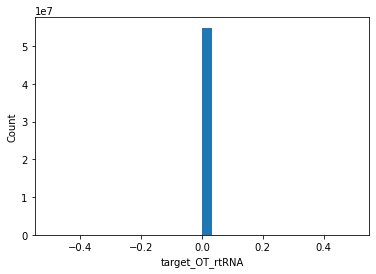

Wall time: 16min 8s


In [24]:
%%time
# Calculate and plot the off-targets to rRNA/tRNAs
ot.calc_OTs(probe_dict, ottable_rtRNAs, 'target_sequence', 'target_OT_rtRNA', 15)
plot.plot_hist(probe_dict, 'target_OT_rtRNA')
# Filter out probes that have any rRNA/tRNA off-targets
filters.filter_probe_dict_by_metric(probe_dict, 'target_OT_rtRNA', upper_bound=0.5)
plot.plot_hist(probe_dict, 'target_OT_rtRNA')

In [25]:
def shifts_to_targetable_length(shifts, K=30):
    s_shifts = sorted(shifts)
    targetable_length = 0
    for i in range(len(s_shifts) - 1):
        targetable_length += min(s_shifts[i + 1] - s_shifts[i], K)
    if len(s_shifts) > 0:
        targetable_length += K
    
    return targetable_length

In [26]:
%%time
# Calculate targetable length for all genes
gene_ids = list(transcriptome_unique['gene_id'])
transcript_ids = list(transcriptome_unique.index)
targetable_lengths = []

for i in range(len(gene_ids)):
    g = gene_ids[i]
    t = transcript_ids[i]
    shifts = list(probe_dict[g][t]['shift'])
    targetable_lengths.append(shifts_to_targetable_length(shifts, 30))
    
transcriptome_unique['targetable_length'] = targetable_lengths

Wall time: 28.3 s


In [38]:
probe_dict['ENSG00000000003']['ENST00000373020']

,gene_id,transcript_id,shift,target_sequence,target_GC,target_Tm,target_OT_rtRNA
0,ENSG00000000003,ENST00000373020,0,AGTTGTGGACGCTCGTAAGTTTTCGGCAGT,50.000000,55.585132,0
1,ENSG00000000003,ENST00000373020,1,GTTGTGGACGCTCGTAAGTTTTCGGCAGTT,50.000000,54.855769,0
2,ENSG00000000003,ENST00000373020,2,TTGTGGACGCTCGTAAGTTTTCGGCAGTTT,46.666667,54.535849,0
3,ENSG00000000003,ENST00000373020,3,TGTGGACGCTCGTAAGTTTTCGGCAGTTTC,50.000000,54.668089,0
4,ENSG00000000003,ENST00000373020,4,GTGGACGCTCGTAAGTTTTCGGCAGTTTCC,53.333333,55.510692,0
...,...,...,...,...,...,...,...
3699,ENSG00000000003,ENST00000373020,3699,CCAGGTGGGTTGTTGGGTTTATGTTGTAAG,46.666667,53.966296,0
3700,ENSG00000000003,ENST00000373020,3700,CAGGTGGGTTGTTGGGTTTATGTTGTAAGC,46.666667,53.859990,0
3701,ENSG00000000003,ENST00000373020,3701,AGGTGGGTTGTTGGGTTTATGTTGTAAGCA,43.333333,54.437719,0
3702,ENSG00000000003,ENST00000373020,3702,GGTGGGTTGTTGGGTTTATGTTGTAAGCAT,43.333333,53.558481,0


In [43]:
lib_path = r'\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\hM1_MERFISH'
import pickle
probe_dict_fname = os.path.join(lib_path, 'transcriptome_filtered_probe_dict.pkl')

pickle.dump(probe_dict, open(probe_dict_fname, 'wb'))

# 6. Save the result info into the 'transcriptome_unique' dataframe

In [27]:
# Save the results
transcriptome_unique.to_csv(gene_level_transcriptome_file)

In [28]:
transcriptome_unique

,seq_type,location,gene_id,gene_biotype,transcript_biotype,gene_symbol,description,seq_length,sequence,APPRIS,targetable_length
transcript_id,,,,,,,,,,,
ENST00000373020,cdna,chromosome:GRCh38:X:100627108:100636806:-1,ENSG00000000003,protein_coding,protein_coding,TSPAN6,tetraspanin 6 [Source:HGNC Symbol;Acc:HGNC:11858],3768,AGTTGTGGACGCTCGTAAGTTTTCGGCAGTTTCCGGGGAGACTCGG...,PRINCIPAL:1,2375
ENST00000373031,cdna,chromosome:GRCh38:X:100584936:100599885:1,ENSG00000000005,protein_coding,protein_coding,TNMD,tenomodulin [Source:HGNC Symbol;Acc:HGNC:17757],1205,AGCCGACTCACTTGCAACTCCACCTCAGCAGTGGTCTCTCAGTCCT...,PRINCIPAL:1,951
ENST00000371588,cdna,chromosome:GRCh38:20:50934870:50958532:-1,ENSG00000000419,protein_coding,protein_coding,DPM1,dolichyl-phosphate mannosyltransferase subunit...,1054,AGTTCCGCCATGGCCTCCTTGGAAGTCAGTCGTAGTCCTCGCAGGT...,PRINCIPAL:1,685
ENST00000367770,cdna,chromosome:GRCh38:1:169853074:169888888:-1,ENSG00000000457,protein_coding,protein_coding,SCYL3,SCY1 like pseudokinase 3 [Source:HGNC Symbol;A...,2916,CTGCTTGGCTTTGAGGAAGAGTGGCAGTACTGCCTCACTGCATAAG...,ALTERNATIVE:1,2395
ENST00000359326,cdna,chromosome:GRCh38:1:169795040:169854080:1,ENSG00000000460,protein_coding,protein_coding,C1orf112,chromosome 1 open reading frame 112 [Source:HG...,4011,ACTGCGAGTTTCCGGTCTGGGCTTTGGCGGGTCTGGTTTGAAGCTC...,PRINCIPAL:1,2981
...,...,...,...,...,...,...,...,...,...,...,...
ENST00000696746,cdna,chromosome:GRCh38:11:7950420:7950672:-1,ENSG00000289714,unprocessed_pseudogene,unprocessed_pseudogene,novel,eudogene,253,TTTTGCTATTGTGGCTGTAATGAAATTAATGGTCCCTATTGTGAAA...,NaN,114
ENST00000696766,cdna,chromosome:GRCh38:1:21547404:21554002:1,ENSG00000289715,protein_coding,protein_coding,novel,,144,ATGGCCCTCCTGTCCCCCATCCTGGATGTGGTCCTCACGGTGGCCC...,PRINCIPAL:1,142
ENST00000696864,cdna,chromosome:GRCh38:11:71806230:71928455:-1,ENSG00000289716,protein_coding,nonsense_mediated_decay,XNDC1N-ZNF705EP-ALG1L9P,XNDC1N-ZNF705EP-ALG1L9P readthrough [Source:HG...,2551,GGCGAAGGTCAGAAGGCCGAATTGGCGGGAGAATAGGTTTGGTGGT...,ALTERNATIVE:2,2309


In [30]:
%store -r alt_genes_of_interest
transcriptome_unique[transcriptome_unique['gene_symbol'].isin(alt_genes_of_interest)]

,seq_type,location,gene_id,gene_biotype,transcript_biotype,gene_symbol,description,seq_length,sequence,APPRIS,targetable_length
transcript_id,,,,,,,,,,,
ENST00000241001,cdna,chromosome:GRCh38:11:31789913:31817938:-1,ENSG00000007372,protein_coding,protein_coding,PAX6,paired box 6 [Source:HGNC Symbol;Acc:HGNC:8620],1736,TTTAAACTCTGGGGCAGGTCCTCGCGTAGAACGCGGCTGTCAGATC...,PRINCIPAL:1,1701
ENST00000371130,cdna,chromosome:GRCh38:X:124375903:124963817:-1,ENSG00000009694,protein_coding,protein_coding,TENM1,teneurin transmembrane protein 1 [Source:HGNC ...,12875,GACTGCTTGCATTAAAGGACTTCCTCATCCTTTTTTTCATGAAACT...,PRINCIPAL:4,9842
ENST00000552962,cdna,chromosome:GRCh38:12:91145736:91182824:-1,ENSG00000011465,protein_coding,protein_coding,DCN,decorin [Source:HGNC Symbol;Acc:HGNC:2705],1930,ATTTTTTAACTGTGCTATGGAGTAGAAGCAGGAGGTTTTCAACCTA...,PRINCIPAL:1,1526
ENST00000457544,cdna,chromosome:GRCh38:7:81702127:81770048:-1,ENSG00000019991,protein_coding,protein_coding,HGF,hepatocyte growth factor [Source:HGNC Symbol;A...,2703,TAGGCACTGACTCCGAACAGGATTCTTTCACCCAGGCATCTCCTCC...,ALTERNATIVE:1,2058
ENST00000061240,cdna,chromosome:GRCh38:4:165873237:166104457:1,ENSG00000038295,protein_coding,protein_coding,TLL1,tolloid like 1 [Source:HGNC Symbol;Acc:HGNC:11...,7291,CAAACAGTGCATCCCCAAATCCTCACACTTTTGCTCTCTTGCAGTC...,PRINCIPAL:1,4654
...,...,...,...,...,...,...,...,...,...,...,...
ENST00000604411,ncrna,chromosome:GRCh38:X:73792205:73829231:1,ENSG00000270641,lncRNA,lncRNA,TSIX,"TSIX transcript, XIST antisense RNA [Source:HG...",37027,TAAAAATGTAAAAGATCAGCTGGGTGTGGTGGCTCACACCTGTAAT...,NaN,27866
ENST00000630974,cdna,chromosome:GRCh38:CHR_HSCHR22_1_CTG5:36800767:...,ENSG00000274665,protein_coding,protein_coding,PVALB,parvalbumin [Source:HGNC Symbol;Acc:HGNC:9704],422,CCGGGCTCCCTCAGCCCTCCAATGGAGCTACCGACTCCTTCGACCA...,NaN,397
ENST00000631302,cdna,chromosome:GRCh38:CHR_HSCHR14_7_CTG1:94110739:...,ENSG00000275214,protein_coding,protein_coding,IFI27,interferon alpha inducible protein 27 [Source:...,227,ACATCCAAGCTTAAGACGGTGAGGCCACGGAATTAACCCGAGCAGG...,NaN,227


# 7. Append the total counts from scRNA into the dataframe 

In [45]:
# Load the preprocessed sequencing data
import scanpy as sc
scrna_path =r'L:\Shiwei\DNA_MERFISH_analysis\hM1_10x'

adata = sc.read_h5ad(os.path.join(scrna_path, r'hM1_10X_labeled.h5ad'))

In [46]:
adata_raw = adata.raw.to_adata()

In [48]:
adata_raw.var

,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,mt,ercc,n_cells,highly_variable,means,dispersions,dispersions_norm
WASH7P,1470,0.019416,98.079260,1486.0,False,False,1470,False,0.019958,0.580368,0.034970
LOC105379213,197,0.002587,99.742595,198.0,False,False,197,False,0.002256,0.022980,-1.112511
LOC729737,1727,0.023676,97.743457,1812.0,False,False,1727,False,0.019865,0.192002,-0.764549
LOC100996442,158,0.002064,99.793553,158.0,False,False,158,False,0.001886,0.326256,-0.488164
LOC102725121,17,0.000222,99.977787,17.0,False,False,17,False,0.000243,0.721231,0.324961
...,...,...,...,...,...,...,...,...,...,...,...
ND4,64061,7.890662,16.296238,603896.0,False,False,64061,True,2.185234,3.183974,2.178303
ND5,35581,1.151451,53.508944,88124.0,False,False,35581,True,0.780421,1.697862,2.005142
ND6,1950,0.027439,97.452079,2100.0,False,False,1950,True,0.030686,1.072957,1.049051
CYTB,65196,8.547908,14.813218,654197.0,False,False,65196,True,2.232725,3.177656,2.169804


In [51]:
list(transcriptome_unique.index)

['ENST00000373020',
 'ENST00000373031',
 'ENST00000371588',
 'ENST00000367770',
 'ENST00000359326',
 'ENST00000374003',
 'ENST00000367429',
 'ENST00000002165',
 'ENST00000650454',
 'ENST00000353205',
 'ENST00000337248',
 'ENST00000374399',
 'ENST00000677969',
 'ENST00000321037',
 'ENST00000434342',
 'ENST00000003084',
 'ENST00000265742',
 'ENST00000003100',
 'ENST00000412043',
 'ENST00000536177',
 'ENST00000429079',
 'ENST00000309032',
 'ENST00000618908',
 'ENST00000482405',
 'ENST00000002596',
 'ENST00000416793',
 'ENST00000222462',
 'ENST00000453890',
 'ENST00000265854',
 'ENST00000435347',
 'ENST00000393405',
 'ENST00000004103',
 'ENST00000000412',
 'ENST00000541812',
 'ENST00000001146',
 'ENST00000396675',
 'ENST00000002501',
 'ENST00000679516',
 'ENST00000286186',
 'ENST00000341582',
 'ENST00000392365',
 'ENST00000002125',
 'ENST00000347869',
 'ENST00000180173',
 'ENST00000522656',
 'ENST00000000233',
 'ENST00000585482',
 'ENST00000540200',
 'ENST00000324093',
 'ENST00000467905',


In [56]:
# the genes below from the MTG lib/scRNA used different names than the ones used for emsembl;
# correct these so they can be identified
_gene_alt_name_dict={'KIAA1024':'MINAR1', 'FAM179A':'TOGARAM2', 'PVRL3':'NECTIN3',
                     'CTGF':'CCN2','WBSCR17':'GALNT17','MGEA5':'OGA'}


# get alternative name for some gene to search
_all_genes_from_scrna = adata_raw.var.index
_all_genes_from_scrna_alt = []
for _gene in _all_genes_from_scrna:
    if _gene in _gene_alt_name_dict.keys():
        _gene_alt = _gene_alt_name_dict[_gene]
        _all_genes_from_scrna_alt.append(_gene_alt)
    else:
        _all_genes_from_scrna_alt.append(_gene)
        
print(len(_all_genes_from_scrna_alt))


# also get reverse _gene_alt_dict
_gene_alt_name_dict_rev = {v:k for k,v, in _gene_alt_name_dict.items()}
_gene_alt_name_dict_rev

32858


{'MINAR1': 'KIAA1024',
 'TOGARAM2': 'FAM179A',
 'NECTIN3': 'PVRL3',
 'CCN2': 'CTGF',
 'GALNT17': 'WBSCR17',
 'OGA': 'MGEA5'}

In [72]:

_count_list = []
for _gene in list(transcriptome_unique['gene_symbol']):
    if isinstance(_gene,str):
        if _gene in _all_genes_from_scrna_alt:
            if _gene in _gene_alt_name_dict_rev.keys():
                _gene = _gene_alt_name_dict_rev[_gene]
            _count =  adata_raw.var.loc[_gene]['total_counts']
        else:
            print (f'gene {_gene} not in scRNA dataset, append 1 as default.')
            _count =1
    else:
        print (f'gene {_gene} naming error, append 1 as default.')
        _count =1
    
    _count_list.append(_count)   

gene VPS50 not in scRNA dataset, append 1 as default.
gene MCUB not in scRNA dataset, append 1 as default.
gene HOXA11 not in scRNA dataset, append 1 as default.
gene REXO5 not in scRNA dataset, append 1 as default.
gene TSPOAP1 not in scRNA dataset, append 1 as default.
gene REX1BD not in scRNA dataset, append 1 as default.
gene CRAMP1 not in scRNA dataset, append 1 as default.
gene ELOA not in scRNA dataset, append 1 as default.
gene ANOS1 not in scRNA dataset, append 1 as default.
gene LDAF1 not in scRNA dataset, append 1 as default.
gene ACP3 not in scRNA dataset, append 1 as default.
gene ISL1 not in scRNA dataset, append 1 as default.
gene ZNF285CP not in scRNA dataset, append 1 as default.
gene STEEP1 not in scRNA dataset, append 1 as default.
gene CCT8L1P not in scRNA dataset, append 1 as default.
gene MRE11 not in scRNA dataset, append 1 as default.
gene RTF2 not in scRNA dataset, append 1 as default.
gene BTN3A1 not in scRNA dataset, append 1 as default.
gene SARS1 not in scR

gene VSIR not in scRNA dataset, append 1 as default.
gene TLX1 not in scRNA dataset, append 1 as default.
gene TWNK not in scRNA dataset, append 1 as default.
gene STN1 not in scRNA dataset, append 1 as default.
gene TASOR2 not in scRNA dataset, append 1 as default.
gene SEPTIN4 not in scRNA dataset, append 1 as default.
gene KRT37 not in scRNA dataset, append 1 as default.
gene TVP23BP2 not in scRNA dataset, append 1 as default.
gene ZNF29P not in scRNA dataset, append 1 as default.
gene HOXB6 not in scRNA dataset, append 1 as default.
gene tumor not in scRNA dataset, append 1 as default.
gene CCL8 not in scRNA dataset, append 1 as default.
gene HSD17B1P1 not in scRNA dataset, append 1 as default.
gene PPY not in scRNA dataset, append 1 as default.
gene succinate not in scRNA dataset, append 1 as default.
gene PHOX2B not in scRNA dataset, append 1 as default.
gene ODAM not in scRNA dataset, append 1 as default.
gene SMR3A not in scRNA dataset, append 1 as default.
gene CRACD not in sc

gene EEF1E1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MYRF-AS1 not in scRNA dataset, append 1 as default.
gene SCGB1D2 not in scRNA dataset, append 1 as default.
gene PHAF1 not in scRNA dataset, append 1 as default.
gene HROB not in scRNA dataset, append 1 as default.
gene SEPTIN6 not in scRNA dataset, append 1 as default.
gene DMAC2L not in scRNA dataset, append 1 as default.
gene RPL32P21 not in scRNA dataset, append 1 as default.
gene MIR9-1HG not in scRNA dataset, append 1 as default.
gene BARHL1 not in scRNA dataset, append 1 as default.
gene SRMS not in scRNA dataset, append 1 as default.
gene LINC00029 not in scRNA dataset, append 1 as default.
gene FNDC11 not in scRNA dataset, append 1 as default.
gene BHLHE23 not in scRNA dataset, append 1 as default.
gene HTR5BP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SDCBP2 not in scRNA dataset, append 1 as default.
gene 

gene PKD1L1-AS1 not in scRNA dataset, append 1 as default.
gene RNASE2CP not in scRNA dataset, append 1 as default.
gene MTHFS not in scRNA dataset, append 1 as default.
gene GH2 not in scRNA dataset, append 1 as default.
gene CSH1 not in scRNA dataset, append 1 as default.
gene MARCHF7 not in scRNA dataset, append 1 as default.
gene EPRS1 not in scRNA dataset, append 1 as default.
gene IL36RN not in scRNA dataset, append 1 as default.
gene IL1F10 not in scRNA dataset, append 1 as default.
gene ECPAS not in scRNA dataset, append 1 as default.
gene NIBAN2 not in scRNA dataset, append 1 as default.
gene TRMO not in scRNA dataset, append 1 as default.
gene CCN3 not in scRNA dataset, append 1 as default.
gene DMAC1 not in scRNA dataset, append 1 as default.
gene CCL21 not in scRNA dataset, append 1 as default.
gene SIT1 not in scRNA dataset, append 1 as default.
gene RANP1 not in scRNA dataset, append 1 as default.
gene FGFBP1 not in scRNA dataset, append 1 as default.
gene THAP12 not in s

gene TAFA4 not in scRNA dataset, append 1 as default.
gene NAXE not in scRNA dataset, append 1 as default.
gene TEX55 not in scRNA dataset, append 1 as default.
gene CIP2A not in scRNA dataset, append 1 as default.
gene RETNLB not in scRNA dataset, append 1 as default.
gene SGO2 not in scRNA dataset, append 1 as default.
gene NEPRO not in scRNA dataset, append 1 as default.
gene CCDC191 not in scRNA dataset, append 1 as default.
gene CFAP20DC not in scRNA dataset, append 1 as default.
gene PPBP not in scRNA dataset, append 1 as default.
gene PF4 not in scRNA dataset, append 1 as default.
gene TCF23 not in scRNA dataset, append 1 as default.
gene CFAP100 not in scRNA dataset, append 1 as default.
gene TASOR not in scRNA dataset, append 1 as default.
gene MELTF not in scRNA dataset, append 1 as default.
gene H2AZ1 not in scRNA dataset, append 1 as default.
gene CAMP not in scRNA dataset, append 1 as default.
gene ABHD18 not in scRNA dataset, append 1 as default.
gene SMIM43 not in scRNA 

gene VXN not in scRNA dataset, append 1 as default.
gene ODAD2 not in scRNA dataset, append 1 as default.
gene X not in scRNA dataset, append 1 as default.
gene NPIPB12 not in scRNA dataset, append 1 as default.
gene OR10G3 not in scRNA dataset, append 1 as default.
gene OR6F1 not in scRNA dataset, append 1 as default.
gene CXCL10 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene GUSBP12 not in scRNA dataset, append 1 as default.
gene OR5AU1 not in scRNA dataset, append 1 as default.
gene RNASE2 not in scRNA dataset, append 1 as default.
gene RNASE3 not in scRNA dataset, append 1 as default.
gene SPRR1B not in scRNA dataset, append 1 as default.
gene SPRR1A not in scRNA dataset, append 1 as default.
gene OR4K14 not in scRNA dataset, append 1 as default.
gene OR4K15 not in scRNA dataset, append 1 as default.
gene CRCT1 not in scRNA dataset, append 1 as default.
gene ZNF280A not in scRNA dataset, append 1 as default.
gene VPREB1 not

gene MICOS10 not in scRNA dataset, append 1 as default.
gene ZNRD2 not in scRNA dataset, append 1 as default.
gene FAM166C not in scRNA dataset, append 1 as default.
gene HES3 not in scRNA dataset, append 1 as default.
gene BCLAF3 not in scRNA dataset, append 1 as default.
gene Finkel-Biskis-Reilly not in scRNA dataset, append 1 as default.
gene PPIAP7 not in scRNA dataset, append 1 as default.
gene MARCHF10 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TUBB7P not in scRNA dataset, append 1 as default.
gene ATP5MK not in scRNA dataset, append 1 as default.
gene MARCHF3 not in scRNA dataset, append 1 as default.
gene SNURFL not in scRNA dataset, append 1 as default.
gene COMM not in scRNA dataset, append 1 as default.
gene CBY2 not in scRNA dataset, append 1 as default.
gene TENT5D not in scRNA dataset, append 1 as default.
gene FAM3C2P not in scRNA dataset, append 1 as default.

gene OR7A15P not in scRNA dataset, append 1 as default.
gene OR51F2 not in scRNA dataset, append 1 as default.
gene OR51N1P not in scRNA dataset, append 1 as default.
gene RPL7L1P11 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PHETA2 not in scRNA dataset, append 1 as default.
gene IRAG1-AS1 not in scRNA dataset, append 1 as default.
gene PRDM16-DT not in scRNA dataset, append 1 as default.
gene CETN1 not in scRNA dataset, append 1 as default.
gene NUDT4B not in scRNA dataset, append 1 as default.
gene OR2T35 not in scRNA dataset, append 1 as default.
gene NAP1L4P1 not in scRNA dataset, append 1 as default.
gene PCNPP5 not in scRNA dataset, append 1 as default.
gene OR2T12 not in scRNA dataset, append 1 as default.
gene SPACA4 not in scRNA dataset, append 1 as default.
gene GATD1 not in scRNA dataset, append 1 as default.
gene DEFB103B not in scRNA dataset, append 1 as default.
gene DEFB4B not in scRNA dataset, append 1 as default

gene HMGN2P9 not in scRNA dataset, append 1 as default.
gene XIAPP3 not in scRNA dataset, append 1 as default.
gene RPS12P23 not in scRNA dataset, append 1 as default.
gene HMGB1P14 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene TPT1P10 not in scRNA dataset, append 1 as default.
gene NACAP2 not in scRNA dataset, append 1 as default.
gene ZNF816 not in scRNA dataset, append 1 as default.
gene LINC01869 not in scRNA dataset, append 1 as default.
gene CNEP1R1P1 not in scRNA dataset, append 1 as default.
gene MEIOC not in scRNA dataset, append 1 as default.
gene ITPRID1 not in scRNA dataset, append 1 as default.
gene KRTAP9-7 not in scRNA dataset, append 1 as default.
gene ATP5F1EP2 not in scRNA dataset, append 1 as default.
gene OR10AA1P not in scRNA dataset, append 1 as default.
gene OR6K6 not in scRNA dataset, append 1 as default.
gene OR6K4P not in scRNA dataset, append 1 as default.
gene ARHGAP45 not in scRNA dataset, append 

gene ANKRD20A2P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene POM121L1P not in scRNA dataset, append 1 as default.
gene nucleolar not in scRNA dataset, append 1 as default.
gene HSP90AB3P not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene NF1P3 not in scRNA dataset, append 1 as default.
gene SELENOF not in scRNA dataset, append 1 as default.
gene PRSS40A not in scRNA dataset, append 1 as default.
gene RPSAP19 not in scRNA dataset, append 1 as default.
gene OR5P2 not in scRNA dataset, append 1 as default.
gene MAGEA2B not in scRNA dataset, append 1 as default.
gene TMEM121B not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2T34 not in scRNA dataset, append 1 as default.
gene OR52L1 not in scRNA dataset, append 1 as default.
gene CABCOCO1 not in scRNA dataset, append 1 as default.
gene TTTY8 not in scRNA dataset, append 1 as 

gene ZSWIM9 not in scRNA dataset, append 1 as default.
gene SEPTIN7P13 not in scRNA dataset, append 1 as default.
gene FAAP100 not in scRNA dataset, append 1 as default.
gene ACTBP7 not in scRNA dataset, append 1 as default.
gene INKA1 not in scRNA dataset, append 1 as default.
gene RPL14P6 not in scRNA dataset, append 1 as default.
gene FTH1P14 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene EP400P1 not in scRNA dataset, append 1 as default.
gene TTTY8B not in scRNA dataset, append 1 as default.
gene OR5M5P not in scRNA dataset, append 1 as default.
gene SMG1P4 not in scRNA dataset, append 1 as default.
gene MOSMO not in scRNA dataset, append 1 as default.
gene CLDN24 not in scRNA dataset, append 1 as default.
gene RPL12P4 not in scRNA dataset, append 1 as default.
gene HDHD5-AS1 not in scRNA dataset, append 1 as default.
gene adenylate not in scRNA dataset, append 1 as default.
gene CCDC190 not in scRNA dataset, append 1 as de

gene KRTAP10-6 not in scRNA dataset, append 1 as default.
gene TMPPE not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PP7080 not in scRNA dataset, append 1 as default.
gene OR7A5 not in scRNA dataset, append 1 as default.
gene FAM230G not in scRNA dataset, append 1 as default.
gene PEAK3 not in scRNA dataset, append 1 as default.
gene OR7D1P not in scRNA dataset, append 1 as default.
gene OR6C6 not in scRNA dataset, append 1 as default.
gene OR6N2 not in scRNA dataset, append 1 as default.
gene CIBAR1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene H3-5 not in scRNA dataset, append 1 as default.
gene GPAT2P2 not in scRNA dataset, append 1 as default.
gene PPP3R2 not in scRNA dataset, append 1 as default.
gene GPR21 not in scRNA dataset, append 1 as default.
gene DYNLT4 not in scRNA dataset, append 1 as default.
gene ANKRD36P1 not in scRNA dataset, append 1 as default.
gene IGHV1OR

gene SMIM10L2B not in scRNA dataset, append 1 as default.
gene GPRACR not in scRNA dataset, append 1 as default.
gene EOLA2 not in scRNA dataset, append 1 as default.
gene OR51A6P not in scRNA dataset, append 1 as default.
gene RBMY1A3P not in scRNA dataset, append 1 as default.
gene H4C3 not in scRNA dataset, append 1 as default.
gene OR2T32P not in scRNA dataset, append 1 as default.
gene LCE1C not in scRNA dataset, append 1 as default.
gene GOLGA6L16P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PCNX3 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene H3C12 not in scRNA dataset, append 1 as default.
gene OR4C4P not in scRNA dataset, append 1 as default.
gene olfactory not in scRNA dataset, append 1 as default.
gene MAGEA6 not in scRNA dataset, append 1 as default.
gene LINC02291 not in scRNA dataset, append 1 as default.
gene CH17-340M24.3 not in scRNA dataset, append 1 as

gene MT-ND4 not in scRNA dataset, append 1 as default.
gene MT-ND1 not in scRNA dataset, append 1 as default.
gene MT-ATP6 not in scRNA dataset, append 1 as default.
gene SPOUT1 not in scRNA dataset, append 1 as default.
gene CSAG1 not in scRNA dataset, append 1 as default.
gene GPRASP1 not in scRNA dataset, append 1 as default.
gene MT-CO3 not in scRNA dataset, append 1 as default.
gene KIFBP not in scRNA dataset, append 1 as default.
gene OR10R2 not in scRNA dataset, append 1 as default.
gene OR10Z1 not in scRNA dataset, append 1 as default.
gene MIRLET7E not in scRNA dataset, append 1 as default.
gene MIR375 not in scRNA dataset, append 1 as default.
gene MIR30E not in scRNA dataset, append 1 as default.
gene MIRLET7A2 not in scRNA dataset, append 1 as default.
gene MIR429 not in scRNA dataset, append 1 as default.
gene MIR380 not in scRNA dataset, append 1 as default.
gene MIR449A not in scRNA dataset, append 1 as default.
gene MIR345 not in scRNA dataset, append 1 as default.
gene

gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNA5SP195 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-545P not in scRNA dataset, append 1 as default.
gene SNORA63 not in scRNA dataset, append 1 as default.
gene RNA5SP361 not in scRNA dataset, append 1 as default.
gene RNU6-37P not in scRNA dataset, append 1 as default.
gene RNA5SP502 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-228P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNA5SP174 not in scRNA dataset, append 1 as default.
gene SNORD18C not in scRNA dataset, append 1 as default.
gene RNU6-822P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA

gene RN7SKP77 not in scRNA dataset, append 1 as default.
gene RNU6-1021P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNY1P10 not in scRNA dataset, append 1 as default.
gene RNU6-778P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-544P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RN7SKP231 not in scRNA dataset, append 1 as default.
gene RNU6-216P not in scRNA dataset, append 1 as default.
gene RNU6-23P not in scRNA dataset, append 1 as default.
gene RN7SKP145 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene SNORD115-18 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNA5SP350 not in scRNA dataset, append 1 as default.
gene RNU5D-1 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as d

gene RNY3P3 not in scRNA dataset, append 1 as default.
gene RNA5SP335 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene U3 not in scRNA dataset, append 1 as default.
gene RNU6-674P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-873P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RN7SKP93 not in scRNA dataset, append 1 as default.
gene RNA5SP27 not in scRNA dataset, append 1 as default.
gene RNA5SP28 not in scRNA dataset, append 1 as default.
gene RNU6-682P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RN7SKP103 not in scRNA dataset, append 1 as default.
gene RNA5SP260 not in scRNA dataset, append 1 as default.
gene RNU6-931P not in scRNA dataset, append 1 as default.
gene SNORD115-8 not in scRNA dataset, append 1 as default.
gene RNU6-271P not in scRNA dataset, append 1 as de

gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNA5SP524 not in scRNA dataset, append 1 as default.
gene RN7SKP171 not in scRNA dataset, append 1 as default.
gene RNU6-1047P not in scRNA dataset, append 1 as default.
gene RN7SKP76 not in scRNA dataset, append 1 as default.
gene RNU1-34P not in scRNA dataset, append 1 as default.
gene RNU6-153P not in scRNA dataset, append 1 as default.
gene RNU6-1019P not in scRNA dataset, append 1 as default.
gene RNU4-41P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-1164P not in scRNA dataset, append 1 as default.
gene SNORD115-27 not in scRNA dataset, append 1 as default.
gene RNA5SP130 not in scRNA dataset, append 1 as default.
gene SNORA65 not in scRNA dataset, append 1 as default.
gene RNU6-512P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA datase

gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-1071P not in scRNA dataset, append 1 as default.
gene RNA5SP189 not in scRNA dataset, append 1 as default.
gene SNORA63 not in scRNA dataset, append 1 as default.
gene RN7SKP9 not in scRNA dataset, append 1 as default.
gene RN7SKP130 not in scRNA dataset, append 1 as default.
gene RNU6-392P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU5E-4P not in scRNA dataset, append 1 as default.
gene RNU6-1180P not in scRNA dataset, append 1 as default.
gene RNU4-8P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene U8 not in scRNA dataset, append 1 as default.
gene U8 not in scRNA dataset, append 1 as default.
gene SNORA71 not in scRNA dataset, append 1 as default.
gene RNA5SP488 not in scRNA dataset, append 1 as default.
gene RNU6-915P not in scRNA dataset, append 1 as default.
ge

gene RN7SKP249 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene SNORA62 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene SNORD115-43 not in scRNA dataset, append 1 as default.
gene SNORA62 not in scRNA dataset, append 1 as default.
gene SNORA25B not in scRNA dataset, append 1 as default.
gene SNORA70 not in scRNA dataset, append 1 as default.
gene RNU1-55P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNA5SP279 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNA5SP211 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene SNORA70 not in scRNA dataset, append 1 as default.
gene RN7SKP292 not in scRNA dataset, append 1 as default.
gene RN7SKP1 not in scRNA dataset, append 1 as default.
gene RNU6-61P not in scRNA dataset, append 1

gene COL5A1-AS1 not in scRNA dataset, append 1 as default.
gene CT83 not in scRNA dataset, append 1 as default.
gene LIPN not in scRNA dataset, append 1 as default.
gene LCN1P2 not in scRNA dataset, append 1 as default.
gene SLC12A5-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MYCLP1 not in scRNA dataset, append 1 as default.
gene IER5L-AS1 not in scRNA dataset, append 1 as default.
gene ARMCX7P not in scRNA dataset, append 1 as default.
gene RPA4 not in scRNA dataset, append 1 as default.
gene LINC02520 not in scRNA dataset, append 1 as default.
gene BMP2KL not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NAP1L6P not in scRNA dataset, append 1 as default.
gene ECEL1P1 not in scRNA dataset, append 1 as default.
gene GGTA1 not in scRNA dataset, append 1 as default.
gene TMEM273 not in scRNA dataset, append 1 as default.
gene AGAP9 not in scRNA dataset, append 1 as default.
g

gene FAM99B not in scRNA dataset, append 1 as default.
gene FAM99A not in scRNA dataset, append 1 as default.
gene RPS3AP47 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR7E136P not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA dataset, append 1 as default.
gene PDPK2P not in scRNA dataset, append 1 as default.
gene PPP1R12BP2 not in scRNA dataset, append 1 as default.
gene HSP90AB2P not in scRNA dataset, append 1 as default.
gene DAZ2 not in scRNA dataset, append 1 as default.
gene USP17L6P not in scRNA dataset, append 1 as default.
gene HSP90AA5P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene lncRNA not in scRNA dataset, append 1 as default.
gene golgi not in scRNA dataset, append 1 as default.
gene DEFB109C not in scRNA dataset, append 1 as default.
gene IFITM5 not in scRNA dataset, append 1 as default.
gene OR7E161P not in scRNA dataset, append 1 as 

gene SNORD61 not in scRNA dataset, append 1 as default.
gene RNU6-662P not in scRNA dataset, append 1 as default.
gene RNU6-40P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-49P not in scRNA dataset, append 1 as default.
gene RNU6-198P not in scRNA dataset, append 1 as default.
gene U8 not in scRNA dataset, append 1 as default.
gene SNORD63 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-610P not in scRNA dataset, append 1 as default.
gene RNU6-574P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-842P not in scRNA dataset, append 1 as default.
gene RNU6-524P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-622P not in scRNA dataset, append 1 as default.
gene RNU6-820P not in scRNA dataset, append 1 as default.
gene SNORD116-2 not in scRNA dataset, appen

gene RNU6-140P not in scRNA dataset, append 1 as default.
gene SNORD7 not in scRNA dataset, append 1 as default.
gene RNU6-83P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-1152P not in scRNA dataset, append 1 as default.
gene RNU6-145P not in scRNA dataset, append 1 as default.
gene RNU6-878P not in scRNA dataset, append 1 as default.
gene RNU4-70P not in scRNA dataset, append 1 as default.
gene RNU6-1127P not in scRNA dataset, append 1 as default.
gene RNU6-429P not in scRNA dataset, append 1 as default.
gene SNORA2B not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-1184P not in scRNA dataset, append 1 as defaul

gene MIR570 not in scRNA dataset, append 1 as default.
gene MIR28 not in scRNA dataset, append 1 as default.
gene MIR621 not in scRNA dataset, append 1 as default.
gene MIR558 not in scRNA dataset, append 1 as default.
gene MIR128-1 not in scRNA dataset, append 1 as default.
gene MIR489 not in scRNA dataset, append 1 as default.
gene MIR548AA2 not in scRNA dataset, append 1 as default.
gene MIR548A2 not in scRNA dataset, append 1 as default.
gene MIR183 not in scRNA dataset, append 1 as default.
gene MIR592 not in scRNA dataset, append 1 as default.
gene MIR602 not in scRNA dataset, append 1 as default.
gene MIR184 not in scRNA dataset, append 1 as default.
gene MIR659 not in scRNA dataset, append 1 as default.
gene MIR32 not in scRNA dataset, append 1 as default.
gene MIR518A2 not in scRNA dataset, append 1 as default.
gene MIR597 not in scRNA dataset, append 1 as default.
gene MIR211 not in scRNA dataset, append 1 as default.
gene MIR7-2 not in scRNA dataset, append 1 as default.
gen

gene MT-TK not in scRNA dataset, append 1 as default.
gene MT-TG not in scRNA dataset, append 1 as default.
gene MT-TR not in scRNA dataset, append 1 as default.
gene MT-TH not in scRNA dataset, append 1 as default.
gene RNU6ATAC4P not in scRNA dataset, append 1 as default.
gene MT-TS2 not in scRNA dataset, append 1 as default.
gene MT-TL2 not in scRNA dataset, append 1 as default.
gene MT-TE not in scRNA dataset, append 1 as default.
gene MT-TT not in scRNA dataset, append 1 as default.
gene MT-TP not in scRNA dataset, append 1 as default.
gene RNU6ATAC2P not in scRNA dataset, append 1 as default.
gene RNU6ATAC3P not in scRNA dataset, append 1 as default.
gene MIR196A1 not in scRNA dataset, append 1 as default.
gene RNU6ATAC5P not in scRNA dataset, append 1 as default.
gene RNU6ATAC26P not in scRNA dataset, append 1 as default.
gene MIR190A not in scRNA dataset, append 1 as default.
gene SELENOH not in scRNA dataset, append 1 as default.
gene MT-RNR1 not in scRNA dataset, append 1 as 

gene TRAJ25 not in scRNA dataset, append 1 as default.
gene TRAJ24 not in scRNA dataset, append 1 as default.
gene TRAJ23 not in scRNA dataset, append 1 as default.
gene TRAJ22 not in scRNA dataset, append 1 as default.
gene TRAJ21 not in scRNA dataset, append 1 as default.
gene TRAJ20 not in scRNA dataset, append 1 as default.
gene TRAJ19 not in scRNA dataset, append 1 as default.
gene TRAJ18 not in scRNA dataset, append 1 as default.
gene TRAJ17 not in scRNA dataset, append 1 as default.
gene TRAJ16 not in scRNA dataset, append 1 as default.
gene TRAJ14 not in scRNA dataset, append 1 as default.
gene TRAJ13 not in scRNA dataset, append 1 as default.
gene TRAJ12 not in scRNA dataset, append 1 as default.
gene TRAJ11 not in scRNA dataset, append 1 as default.
gene TRAJ10 not in scRNA dataset, append 1 as default.
gene TRAJ9 not in scRNA dataset, append 1 as default.
gene TRAJ8 not in scRNA dataset, append 1 as default.
gene TRAJ7 not in scRNA dataset, append 1 as default.
gene TRAJ6 no

gene SNORA75 not in scRNA dataset, append 1 as default.
gene RNA5SP252 not in scRNA dataset, append 1 as default.
gene U3 not in scRNA dataset, append 1 as default.
gene SNORA75 not in scRNA dataset, append 1 as default.
gene RNU6-1269P not in scRNA dataset, append 1 as default.
gene RNU6-243P not in scRNA dataset, append 1 as default.
gene SNORA53 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU6-131P not in scRNA dataset, append 1 as default.
gene SNORD90 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-241P not in scRNA dataset, append 1 as default.
gene RNU11-4P not in scRNA dataset, append 1 as default.
gene SNORD69 not in scRNA dataset, append 1 as default.
gene RNA5SP286 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU6-644P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU6-695P n

gene OR10D5P not in scRNA dataset, append 1 as default.
gene RPS7P8 not in scRNA dataset, append 1 as default.
gene SUMO-1 not in scRNA dataset, append 1 as default.
gene FAM24B not in scRNA dataset, append 1 as default.
gene COPS5P1 not in scRNA dataset, append 1 as default.
gene YBX1P4 not in scRNA dataset, append 1 as default.
gene BTF3L4P2 not in scRNA dataset, append 1 as default.
gene CDK7P1 not in scRNA dataset, append 1 as default.
gene NUDCP1 not in scRNA dataset, append 1 as default.
gene FABP5P10 not in scRNA dataset, append 1 as default.
gene GIMAP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene STRADBP1 not in scRNA dataset, append 1 as default.
gene Huntingtin not in scRNA dataset, append 1 as default.
gene RPL32P17 not in scRNA dataset, append 1 as default.
gene KRT18P64 not in scRNA dataset, append 1 as default.
gene NCLP1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as de

gene small not in scRNA dataset, append 1 as default.
gene LDHBP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SEC14L1P1 not in scRNA dataset, append 1 as default.
gene RPS7P14 not in scRNA dataset, append 1 as default.
gene CTBP2P6 not in scRNA dataset, append 1 as default.
gene CAPZA1P3 not in scRNA dataset, append 1 as default.
gene RPL17P50 not in scRNA dataset, append 1 as default.
gene SETP22 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene EEF1A1P15 not in scRNA dataset, append 1 as default.
gene RHOG2P not in scRNA dataset, append 1 as default.
gene HMGB1P10 not in scRNA dataset, append 1 as default.
gene SLC16A14P1 not in scRNA dataset, append 1 as default.
gene PHBP7 not in scRNA dataset, append 1 as default.
gene PIGCP1 not in scRNA dataset, append 1 as default.
gene FABP5P5 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 

gene CTAGE14P not in scRNA dataset, append 1 as default.
gene IQCJ not in scRNA dataset, append 1 as default.
gene TUBBP2 not in scRNA dataset, append 1 as default.
gene MINDY4B not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene SETP21 not in scRNA dataset, append 1 as default.
gene PUDPP3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene AZGP1P2 not in scRNA dataset, append 1 as default.
gene dual not in scRNA dataset, append 1 as default.
gene RPS2P6 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RPSAP53 not in scRNA dataset, append 1 as default.
gene KCTD9P4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene STARP1 not in scRNA dataset, append 1 as default.
gene RPS3AP33 not in scRNA dataset, append 1 as default.
gene LGMNP1 not in scRNA dataset, append 1 as default.
g

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CRPPA not in scRNA dataset, append 1 as default.
gene NT5DC1P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CHCHD3P3 not in scRNA dataset, append 1 as default.
gene PPIAP29 not in scRNA dataset, append 1 as default.
gene VDAC2P1 not in scRNA dataset, append 1 as default.
gene GSG1L2 not in scRNA dataset, append 1 as default.
gene pleiomorphic not in scRNA dataset, append 1 as default.
gene RPL7AP26 not in scRNA dataset, append 1 as default.
gene AKAP17BP not in scRNA dataset, append 1 as default.
gene CCNB2P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene GAPDHP77 not in scRNA dataset, append 1 as default.
gene RPL23AP59 not in scRNA dataset, append 1 as default.
gene RPL15P20 not in scRNA dataset, append 1 as default.
gene MESTP4 not in scRNA dataset, append 1 as 

gene CFL1P6 not in scRNA dataset, append 1 as default.
gene SLC35E2A not in scRNA dataset, append 1 as default.
gene peroxisomal not in scRNA dataset, append 1 as default.
gene primase not in scRNA dataset, append 1 as default.
gene RSL24D1P4 not in scRNA dataset, append 1 as default.
gene RFKP1 not in scRNA dataset, append 1 as default.
gene 3-hydroxy-3-methylglutaryl-Coenzyme not in scRNA dataset, append 1 as default.
gene KRT18P65 not in scRNA dataset, append 1 as default.
gene ZNF847P not in scRNA dataset, append 1 as default.
gene ZC3H11B not in scRNA dataset, append 1 as default.
gene KRT18P12 not in scRNA dataset, append 1 as default.
gene QRSL1P1 not in scRNA dataset, append 1 as default.
gene Ewing not in scRNA dataset, append 1 as default.
gene carbonic not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MPTX1 not in scRNA dataset, append 1 as default.
gene RPTN not in 

gene FEM1AP3 not in scRNA dataset, append 1 as default.
gene 60S not in scRNA dataset, append 1 as default.
gene LDHAL6FP not in scRNA dataset, append 1 as default.
gene high not in scRNA dataset, append 1 as default.
gene ASS1P9 not in scRNA dataset, append 1 as default.
gene protein not in scRNA dataset, append 1 as default.
gene ubiquitin-conjugating not in scRNA dataset, append 1 as default.
gene FAT1P1 not in scRNA dataset, append 1 as default.
gene HNRNPDP2 not in scRNA dataset, append 1 as default.
gene SNRPEP6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RBMXP5 not in scRNA dataset, append 1 as default.
gene H4C10P not in scRNA dataset, append 1 as default.
gene OR4F7P not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene KRT18P48 not in scRNA dataset, append 1 as default.
gene ZNF839P1 not in scRNA dataset, append 1 as default.
gene HSPE1P8 not in scRNA dataset, append

gene novel not in scRNA dataset, append 1 as default.
gene RPL26P20 not in scRNA dataset, append 1 as default.
gene nucleoporin not in scRNA dataset, append 1 as default.
gene CD83P1 not in scRNA dataset, append 1 as default.
gene RPL32P16 not in scRNA dataset, append 1 as default.
gene 40S not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene VN1R11P not in scRNA dataset, append 1 as default.
gene RPSAP45 not in scRNA dataset, append 1 as default.
gene RPL21P67 not in scRNA dataset, append 1 as default.
gene transcription not in scRNA dataset, append 1 as default.
gene OSTCP6 not in scRNA dataset, append 1 as default.
gene PPIAP9 not in scRNA dataset, append 1 as default.
gene ATP5PBP6 not in scRNA dataset, append 1 as default.
gene ARF1P1 not in scRNA dataset, append 1 as default.
gene RPL23AP47 not in scRNA dataset, append 1 as default.
gene RPL31P28 not in scRNA dataset, a

gene RNU6ATAC40P not in scRNA dataset, append 1 as default.
gene SNORD111B not in scRNA dataset, append 1 as default.
gene RNU6ATAC16P not in scRNA dataset, append 1 as default.
gene MIR1285-1 not in scRNA dataset, append 1 as default.
gene MIR1185-1 not in scRNA dataset, append 1 as default.
gene RNU6ATAC41P not in scRNA dataset, append 1 as default.
gene MIR1184-1 not in scRNA dataset, append 1 as default.
gene MIR548H1 not in scRNA dataset, append 1 as default.
gene SNORD99 not in scRNA dataset, append 1 as default.
gene MIR1180 not in scRNA dataset, append 1 as default.
gene MIR1255B2 not in scRNA dataset, append 1 as default.
gene MIR1283-2 not in scRNA dataset, append 1 as default.
gene MIR1303 not in scRNA dataset, append 1 as default.
gene RNU6ATAC10P not in scRNA dataset, append 1 as default.
gene MIR1269A not in scRNA dataset, append 1 as default.
gene RNU6ATAC42P not in scRNA dataset, append 1 as default.
gene RNU6ATAC35P not in scRNA dataset, append 1 as default.
gene RNU6A

gene RNA5SP178 not in scRNA dataset, append 1 as default.
gene RN7SKP267 not in scRNA dataset, append 1 as default.
gene RNU6-1118P not in scRNA dataset, append 1 as default.
gene RNA5SP118 not in scRNA dataset, append 1 as default.
gene RNU6-1050P not in scRNA dataset, append 1 as default.
gene MIR1912 not in scRNA dataset, append 1 as default.
gene RNU6-855P not in scRNA dataset, append 1 as default.
gene RNU6-1076P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RN7SKP225 not in scRNA dataset, append 1 as default.
gene RNU6-174P not in scRNA dataset, append 1 as default.
gene RN7SKP139 not in scRNA dataset, append 1 as default.
gene RNU6-613P not in scRNA dataset, append 1 as default.
gene SNORD19C not in scRNA dataset, append 1 as default.
gene RNA5SP237 not in scRNA dataset, append 1 as default.
gene RNY1P15 not in scRNA dataset, append 1 as default.
gene RN7SKP221 not in scRNA dataset, append 1 as default.
gene RNU2-29P not in

gene RN7SKP68 not in scRNA dataset, append 1 as default.
gene RNU4-22P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RN7SKP259 not in scRNA dataset, append 1 as default.
gene RNU2-61P not in scRNA dataset, append 1 as default.
gene RNA5SP184 not in scRNA dataset, append 1 as default.
gene SNORD29 not in scRNA dataset, append 1 as default.
gene RN7SKP137 not in scRNA dataset, append 1 as default.
gene RN7SKP73 not in scRNA dataset, append 1 as default.
gene RN7SKP264 not in scRNA dataset, append 1 as default.
gene RNA5SP344 not in scRNA dataset, append 1 as default.
gene RNU6-1135P not in scRNA dataset, append 1 as default.
gene RNA5SP306 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-55P not in scRNA dataset, append 1 as default.
gene RN7SKP247 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU6-284P not in scRNA dataset, appe

gene nucleotide not in scRNA dataset, append 1 as default.
gene RPS15AP5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TCEAL4P1 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene ACSL6-AS1 not in scRNA dataset, append 1 as default.
gene MTND5P28 not in scRNA dataset, append 1 as default.
gene SNRPBP1 not in scRNA dataset, append 1 as default.
gene TMSB4XP4 not in scRNA dataset, append 1 as default.
gene CCR5AS not in scRNA dataset, append 1 as default.
gene SMPD4P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene USP9YP23 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TRIM60P17 not in scRNA dataset, append 1 as default.
gene exportin, not in scRNA dataset, append 1 as default.
gene UBQLN1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, appe

gene NIF3 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene PTMAP1 not in scRNA dataset, append 1 as default.
gene OR2H5P not in scRNA dataset, append 1 as default.
gene PDGFA-DT not in scRNA dataset, append 1 as default.
gene RAB9AP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MCCD1P1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene LINC01805 not in scRNA dataset, append 1 as default.
gene NPM1P19 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene translocase not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SAP18P2 not in scRNA dataset, append 1 

gene novel not in scRNA dataset, append 1 as default.
gene SDHDP6 not in scRNA dataset, append 1 as default.
gene MIR3681HG not in scRNA dataset, append 1 as default.
gene SNX18P9 not in scRNA dataset, append 1 as default.
gene PITX1-AS1 not in scRNA dataset, append 1 as default.
gene LINC01991 not in scRNA dataset, append 1 as default.
gene UBE2D3P4 not in scRNA dataset, append 1 as default.
gene LINC02667 not in scRNA dataset, append 1 as default.
gene SEZ6L-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-DQB3 not in scRNA dataset, append 1 as default.
gene RPS23P10 not in scRNA dataset, append 1 as default.
gene GSTT3P not in scRNA dataset, append 1 as default.
gene mannosidase, not in scRNA dataset, append 1 as default.
gene ZCRB1P1 not in scRNA dataset, append 1 as default.
gene TRIM60P5Y not in scRNA dataset, append 1 as default.
gene C10orf67-AS1 not in scRNA datas

gene MAPKAPK5P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HEXIM2-AS1 not in scRNA dataset, append 1 as default.
gene LINC02523 not in scRNA dataset, append 1 as default.
gene TSBP1-AS1 not in scRNA dataset, append 1 as default.
gene MDC1-AS1 not in scRNA dataset, append 1 as default.
gene MRPS9-AS2 not in scRNA dataset, append 1 as default.
gene POLR2KP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene cytochrome not in scRNA dataset, append 1 as default.
gene HMGN1P19 not in scRNA dataset, append 1 as default.
gene KRT8P45 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene CYCSP42 not in scRNA dataset, appe

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BTF3P4 not in scRNA dataset, append 1 as default.
gene THRB-IT1 not in scRNA dataset, append 1 as default.
gene USP21P1 not in scRNA dataset, append 1 as default.
gene LINC00265-2P not in scRNA dataset, append 1 as default.
gene TOMM20P1 not in scRNA dataset, append 1 as default.
gene OR2X1P not in scRNA dataset, append 1 as default.
gene TMEM183BP not in scRNA dataset, append 1 as default.
gene LINC01689 not in scRNA dataset, append 1 as default.
gene BTF3P9 not in scRNA dataset, append 1 as default.
gene C6orf47-AS1 not in scRNA dataset, append 1 as default.
gene DiGeorge not in scRNA dataset, append 1 as default.
gene GCSHP5 not in scRNA dataset, append 1 as default.
gene RPL12P17 not in scRNA dataset, append 1 as default.
gene LMX1B-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NQO2-AS1 not in scRNA dataset, appe

gene DYNC1I2P1 not in scRNA dataset, append 1 as default.
gene SLC9A3-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-S not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPS12P10 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2G1P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TUBAP9 not in scRNA dataset, append 1 as default.
gene TOMM22P5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HSPE1P24 not in scRNA dataset, append 1 as default.
gene NPM1P39 not in scRNA dataset, append 1 as default.
gene RTRAFP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.


gene tumor not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene riribosomal not in scRNA dataset, append 1 as default.
gene MTCO3P5 not in scRNA dataset, append 1 as default.
gene isocitrate not in scRNA dataset, append 1 as default.
gene MT-ND1 not in scRNA dataset, append 1 as default.
gene PLCB1-IT1 not in scRNA dataset, append 1 as default.
gene N-acetylated not in scRNA dataset, append 1 as default.
gene RPS6P14 not in scRNA dataset, append 1 as default.
gene RPL22P4 not in scRNA dataset, append 1 as default.
gene acid not in scRNA dataset, append 1 as default.
gene RPL35AP7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene UBE2Q2P4Y not in scRNA dataset, append 1 as default.
gene RTRAFP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL15P4 not in scRNA dataset, append 1 a

gene novel not in scRNA dataset, append 1 as default.
gene UBXN7-AS1 not in scRNA dataset, append 1 as default.
gene RPL7P45 not in scRNA dataset, append 1 as default.
gene IGHD6-25 not in scRNA dataset, append 1 as default.
gene SFTPA3P not in scRNA dataset, append 1 as default.
gene RPS18P1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TSBP1-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2P1P not in scRNA dataset, append 1 as default.
gene TRMT2B-AS1 not in scRNA dataset, append 1 as default.
gene RNA, not in scRNA dataset, append 1 as default.
gene GGCTP3 not in scRNA dataset, append 1 as default.
gene NIPA2P1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-S not in scRNA dataset, append 1 as defa

gene BAIAP2-DT not in scRNA dataset, append 1 as default.
gene ATPase, not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02654 not in scRNA dataset, append 1 as default.
gene similar not in scRNA dataset, append 1 as default.
gene RPL35P8 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPS27AP3 not in scRNA dataset, append 1 as default.
gene KRT16P6 not in scRNA dataset, append 1 as default.
gene TUBBP10 not in scRNA dataset, append 1 as default.
gene SLC25A39P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene CHP1P3 not in scRNA dataset, append 1 as default.
gene RPL23AP76 not in scRNA dataset, append 1 as default.
gene OR52E3P not in scRNA dataset, append 1 as default.
gene CLCP2 not in scRNA dataset, append 1 as default.
gene zinc not in scRNA dataset, append 1 as default

gene KRT18P1 not in scRNA dataset, append 1 as default.
gene OR2W1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPA2P2 not in scRNA dataset, append 1 as default.
gene phosphoribosyl not in scRNA dataset, append 1 as default.
gene ADAM1B not in scRNA dataset, append 1 as default.
gene RPS29P33 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene tetraspanin not in scRNA dataset, append 1 as default.
gene PPIAP62 not in scRNA dataset, append 1 as default.
gene nitric not in scRNA dataset, append 1 as default.
gene LINC01748 not in scRNA dataset, append 1 as default.
gene Ig not in scRNA dataset, append 1 as default.
gene UPF3AP1 not in scRNA dataset, append 1 as default.
gene OR7H1P not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RBM22P3 not in scRNA dataset, append 1 as de

gene novel not in scRNA dataset, append 1 as default.
gene zinc not in scRNA dataset, append 1 as default.
gene HIKESHIP1 not in scRNA dataset, append 1 as default.
gene KRTAP3-4P not in scRNA dataset, append 1 as default.
gene FAM30A not in scRNA dataset, append 1 as default.
gene AVPR1B-DT not in scRNA dataset, append 1 as default.
gene TBCAP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TLK1P1 not in scRNA dataset, append 1 as default.
gene WBP11P2 not in scRNA dataset, append 1 as default.
gene LINC02611 not in scRNA dataset, append 1 as default.
gene C13orf42 not in scRNA dataset, append 1 as default.
gene MTND1P20 not in scRNA dataset, append 1 as default.
gene SAR1AP1 not in scRNA dataset, append 1 as default.
gene OR2H5P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene putatitive not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as def

gene ribosomal not in scRNA dataset, append 1 as default.
gene LINC02798 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RBMX2P5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SLC6A17-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HMGB3P8 not in scRNA dataset, append 1 as default.
gene RPS28P7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-DRB7 not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2AS1P not in scRNA dataset, append 1 as default.
gene PIGQP1 not in scRNA dataset, append 1 as default.
gene PARP1P1 not in scRNA dataset, append 1 as default.
ge

gene novel not in scRNA dataset, append 1 as default.
gene SNF7 not in scRNA dataset, append 1 as default.
gene LINC01724 not in scRNA dataset, append 1 as default.
gene DDR1-DT not in scRNA dataset, append 1 as default.
gene OR10U1P not in scRNA dataset, append 1 as default.
gene MRPS21P2 not in scRNA dataset, append 1 as default.
gene VN1R33P not in scRNA dataset, append 1 as default.
gene MDH1P1 not in scRNA dataset, append 1 as default.
gene H3P9 not in scRNA dataset, append 1 as default.
gene CSE1L-DT not in scRNA dataset, append 1 as default.
gene ASIC4-AS1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RNF19BPX not in scRNA dataset, append 1 as default.
gene PPP1R2P1 not in scRNA dataset, append 1 as default.
gene FCF1P1 not in scRNA dataset, append 1 as default.
gene RPS8P4 not in scRNA dataset, append 1 as default.
gene COL6A2-DT not in scRNA dataset, append 1 as default.
gene TTTY17B not in scRNA dataset, append 1 as 

gene MTND6P5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CYCSP5 not in scRNA dataset, append 1 as default.
gene MTCO3P16 not in scRNA dataset, append 1 as default.
gene OR8B1P not in scRNA dataset, append 1 as default.
gene PSMD14P1 not in scRNA dataset, append 1 as default.
gene LINC02803 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CALR4P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01940 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HTATSF1P1 not in scRNA dataset, append 1 as default.
gene RCC2-AS1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as def

gene GRB2-related not in scRNA dataset, append 1 as default.
gene SIM1-AS1 not in scRNA dataset, append 1 as default.
gene IFNA14 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PNKDP1 not in scRNA dataset, append 1 as default.
gene MPIG6B not in scRNA dataset, append 1 as default.
gene COX6CP15 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTATP6P11 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RPL12P1 not in scRNA dataset, append 1 as default.
gene LINC01820 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01757 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SPTBN1-AS1 not in scRNA dataset, append

gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ELOCP24 not in scRNA dataset, append 1 as default.
gene CDY4P not in scRNA dataset, append 1 as default.
gene LNC-LBCS not in scRNA dataset, append 1 as default.
gene ADP-ribosylation not in scRNA dataset, append 1 as default.
gene REL-DT not in scRNA dataset, append 1 as default.
gene PTMAP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01768 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene serine not in scRNA dataset, append 1 as default.
gene ARL5AP3 not in scRNA dataset, append 1 as def

gene LINC02577 not in scRNA dataset, append 1 as default.
gene RPS3AP30 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01672 not in scRNA dataset, append 1 as default.
gene HERV-FRD not in scRNA dataset, append 1 as default.
gene EIF4BP2 not in scRNA dataset, append 1 as default.
gene RPL13AP19 not in scRNA dataset, append 1 as default.
gene PABPC1P8 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene FAF2P1 not in scRNA dataset, append 1 as default.
gene HCG20 not in scRNA dataset, append 1 as default.
gene LIMS1-AS1 not in scRNA dataset, append 1 as default.
gene ZNF885P not in scRNA dataset, append 1 as default.
gene ETF1P1 not in scRNA dataset, append 1 as default.
gene RPL7L1P8 not in scRNA dataset, append 1 as default.
gene KRT8P18 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ABCF2P2 not in scRNA dataset, append

gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene TMPOP1 not in scRNA dataset, append 1 as default.
gene OR2J4P not in scRNA dataset, append 1 as default.
gene HMGN2P24 not in scRNA dataset, append 1 as default.
gene HLA-DRB1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTCO3P30 not in scRNA dataset, append 1 as default.
gene LINC01165 not in scRNA dataset, append 1 as default.
gene OR5AW1P not in scRNA dataset, append 1 as default.
gene PSMA6P2 not in scRNA dataset, append 1 as default.
gene RPS26P18 not in scRNA dataset, append 1 as default.
gene MTND1P10 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HSPA8P8 not in scRNA dataset, append 1 as d

gene novel not in scRNA dataset, append 1 as default.
gene PRKAR1B-AS2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01015 not in scRNA dataset, append 1 as default.
gene HMGB1P16 not in scRNA dataset, append 1 as default.
gene CTNNA2-AS1 not in scRNA dataset, append 1 as default.
gene OR8B9P not in scRNA dataset, append 1 as default.
gene TAF12-DT not in scRNA dataset, append 1 as default.
gene tight not in scRNA dataset, append 1 as default.
gene MICD not in scRNA dataset, append 1 as default.
gene HLA-DRB6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ZNF70P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene prefoldin not in scRNA dataset, append 1 as default.
gene CNIH3-AS1 not in scRNA dataset, append 1 as default.
gene MIR5689HG not in scRNA dataset, append 1 as

gene novel not in scRNA dataset, append 1 as default.
gene LCEP2 not in scRNA dataset, append 1 as default.
gene ZNF90P2 not in scRNA dataset, append 1 as default.
gene RPL23AP19 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR194-2HG not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2AQ1P not in scRNA dataset, append 1 as default.
gene testis not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene zinc not in scRNA dataset, append 1 as default.
gene MAGE not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NADH not in scRNA dataset, append 1 as default.
gene FTLP16 not in scRNA dataset, append 1 as default.
gene TMEM183

gene testis not in scRNA dataset, append 1 as default.
gene dentatorubral-pallidoluysian not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CDY11P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGSF21-AS1 not in scRNA dataset, append 1 as default.
gene UBBP1 not in scRNA dataset, append 1 as default.
gene CCNYL5 not in scRNA dataset, append 1 as default.
gene AK3P3 not in scRNA dataset, append 1 as default.
gene TMSB4XP6 not in scRNA dataset, append 1 as default.
gene CDK8P1 not in scRNA dataset, append 1 as default.
gene FAM90A15P not in scRNA dataset, append 1 as default.
gene BIRC6-AS1 not in scRNA dataset, append 1 as default.
gene HIGD2AP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTND3P2 not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA datas

gene novel not in scRNA dataset, append 1 as default.
gene RPS21P2 not in scRNA dataset, append 1 as default.
gene STK19B not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NCAPD2P1 not in scRNA dataset, append 1 as default.
gene MCCD1P1 not in scRNA dataset, append 1 as default.
gene SPDYE21 not in scRNA dataset, append 1 as default.
gene DDX10P2 not in scRNA dataset, append 1 as default.
gene VN1R32P not in scRNA dataset, append 1 as default.
gene ACTG1P23 not in scRNA dataset, append 1 as default.
gene RPL4P3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL23AP52 not in scRNA dataset, append 1 as default.
gene KARS1P2 not in scRNA dataset, append 1 as default.
gene GSTA11P not in scRNA dataset, append 1 as default.
gene MEMO1P4 not in scRNA dataset, append 1 as default.
gene ELOCP7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.

gene ribosomal not in scRNA dataset, append 1 as default.
gene YY1P1 not in scRNA dataset, append 1 as default.
gene TNPO1P2 not in scRNA dataset, append 1 as default.
gene FAM224B not in scRNA dataset, append 1 as default.
gene THAP12P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NDUFS5P5 not in scRNA dataset, append 1 as default.
gene PABPC1P3 not in scRNA dataset, append 1 as default.
gene LINC01015 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CEACAMP4 not in scRNA dataset, append 1 as default.
gene GRPEL2P3 not in scRNA dataset, append 1 as default.
gene DDTP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
g

gene RPS17P1 not in scRNA dataset, append 1 as default.
gene CCNB1IP1P3 not in scRNA dataset, append 1 as default.
gene MPIG6B not in scRNA dataset, append 1 as default.
gene RPL39P39 not in scRNA dataset, append 1 as default.
gene RPL7P32 not in scRNA dataset, append 1 as default.
gene CDC20P1 not in scRNA dataset, append 1 as default.
gene CUBNP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene SCTR-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPS27P10 not in scRNA dataset, append 1 as default.
gene EIF4A1P3 not in scRNA dataset, append 1 as default.
gene LINC00373 not in scRNA dataset, append 1 as default.
gene proteolipid not in scRNA dataset, append 1 as default.
gene HLA-DRB4 not in scRNA dataset, append 1 as default.
gene RPS3AP9 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, appen

gene novel not in scRNA dataset, append 1 as default.
gene LINC02662 not in scRNA dataset, append 1 as default.
gene LINC01816 not in scRNA dataset, append 1 as default.
gene TPT1P7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene immunoglobulin not in scRNA dataset, append 1 as default.
gene OOEP-AS1 not in scRNA dataset, append 1 as default.
gene RPL34P6 not in scRNA dataset, append 1 as default.
gene EML6-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ACTG1P10 not in scRNA dataset, append 1 as default.
gene VDAC1P6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BEND3P1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene WBP1P1 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append

gene LINC01704 not in scRNA dataset, append 1 as default.
gene OR7E111P not in scRNA dataset, append 1 as default.
gene PPP2R2DP1 not in scRNA dataset, append 1 as default.
gene olfactory not in scRNA dataset, append 1 as default.
gene nuclear not in scRNA dataset, append 1 as default.
gene OR2J2 not in scRNA dataset, append 1 as default.
gene HLA-DQB1-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-DRB3 not in scRNA dataset, append 1 as default.
gene LINC02723 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01891 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EIF1P3 not in scRNA dataset, append 1 as default.
gene ANKRD11P2 not in scRNA dataset, append 1 as default.
gene RPL21P43 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene melanoma not in scRNA dataset, app

gene ZNF736P12Y not in scRNA dataset, append 1 as default.
gene CAP1P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene POLR2LP1 not in scRNA dataset, append 1 as default.
gene UBX not in scRNA dataset, append 1 as default.
gene DNMT3L-AS1 not in scRNA dataset, append 1 as default.
gene HLA-W not in scRNA dataset, append 1 as default.
gene HSPE1P25 not in scRNA dataset, append 1 as default.
gene ZNF90P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01807 not in scRNA dataset, append 1 as default.
gene LSM12P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene proteasome not in scRNA dataset, append 1 as default.
gene PRKD3-DT not in scRNA dataset, append 1 as default.
gene ELOCP15 not in scRNA dataset, append 1 as default.
gene MAGEB6B not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as de

gene novel not in scRNA dataset, append 1 as default.
gene HLA-K not in scRNA dataset, append 1 as default.
gene ARL5AP5 not in scRNA dataset, append 1 as default.
gene RPS27AP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene DEAD not in scRNA dataset, append 1 as default.
gene RPL4P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene MICD not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene YBX1P7 not in scRNA dataset, append 1 as default.
gene Ig not in scRNA dataset, append 1 as default.
gene HLA-DQB1-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudo

gene LINC01656 not in scRNA dataset, append 1 as default.
gene SLC44A3P1 not in scRNA dataset, append 1 as default.
gene ZDHHC20P2 not in scRNA dataset, append 1 as default.
gene CFTR-AS1 not in scRNA dataset, append 1 as default.
gene LDHBP1 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene LARP1BP3 not in scRNA dataset, append 1 as default.
gene PHBP10 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene keratin not in scRNA dataset, append 1 as default.
gene ZNF687-AS1 not in scRNA dataset, append 1 as default.
gene ACTG1P21 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ADH5P2 not in scRNA dataset, append 1 as default.
gene SPTLC1P4 not in scRNA dataset, append 1 as default.
gene LINC01705 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append

gene EIF4EP4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene POLHP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPS17P1 not in scRNA dataset, append 1 as default.
gene MTCO1P57 not in scRNA dataset, append 1 as default.
gene TRIM60P10Y not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene MTCO1P51 not in scRNA dataset, append 1 as default.
gene MTCO1P45 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01219 not in scRNA dataset, append 1 as default.
gene HLA-T not in scRNA dataset, append 1 as default.
gene POM not in scRNA dataset, append 1 as default.
gene MTATP6P7 not in scRNA dataset, append 1 as default.

gene RASA4DP not in scRNA dataset, append 1 as default.
gene HIGD1AP4 not in scRNA dataset, append 1 as default.
gene EIF4A1P1 not in scRNA dataset, append 1 as default.
gene OR4C14P not in scRNA dataset, append 1 as default.
gene XXYLT1-AS1 not in scRNA dataset, append 1 as default.
gene TRGV2 not in scRNA dataset, append 1 as default.
gene SRSF3P6 not in scRNA dataset, append 1 as default.
gene OSTN-AS1 not in scRNA dataset, append 1 as default.
gene RPS6P12 not in scRNA dataset, append 1 as default.
gene MTCO1P54 not in scRNA dataset, append 1 as default.
gene C4B_2 not in scRNA dataset, append 1 as default.
gene HMGA1P5 not in scRNA dataset, append 1 as default.
gene LINC02569 not in scRNA dataset, append 1 as default.
gene DSCR10 not in scRNA dataset, append 1 as default.
gene MTCO3P1 not in scRNA dataset, append 1 as default.
gene RPL31P45 not in scRNA dataset, append 1 as default.
gene PPIAP32 not in scRNA dataset, append 1 as default.
gene LINC02669 not in scRNA dataset, append

gene DHFRP2 not in scRNA dataset, append 1 as default.
gene LINC01851 not in scRNA dataset, append 1 as default.
gene OR6C66P not in scRNA dataset, append 1 as default.
gene RPL10P19 not in scRNA dataset, append 1 as default.
gene LINC00462 not in scRNA dataset, append 1 as default.
gene GBX2-AS1 not in scRNA dataset, append 1 as default.
gene DCUN1D2-AS not in scRNA dataset, append 1 as default.
gene DDX11L10 not in scRNA dataset, append 1 as default.
gene HNRNPA1P42 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene OR2J3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene USH2A-AS2 not in scRNA dataset, append 1 as default.
gene ZC3H12A-DT not in scRNA dataset, append 1 as default.
gene CYP2T1P not in scRNA dataset, append 1 as default.
gene PGAM1P11 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 

gene HLA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL27AP4 not in scRNA dataset, append 1 as default.
gene RPL12P45 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene small not in scRNA dataset, append 1 as default.
gene LINC00265-3P not in scRNA dataset, append 1 as default.
gene LINC02650 not in scRNA dataset, append 1 as default.
gene RPS29P4 not in scRNA dataset, append 1 as default.
gene ASS1P3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RCC2P3 not in scRNA dataset, append 1 as default.
gene FTLP15 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene AHCYP3 not in scRNA dataset, append 1 as default.
gene BTF3P6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene f

gene HTATSF1P1 not in scRNA dataset, append 1 as default.
gene RPL7P13 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PTCD2P2 not in scRNA dataset, append 1 as default.
gene SOD2P1 not in scRNA dataset, append 1 as default.
gene mitochondrial not in scRNA dataset, append 1 as default.
gene HLA-DPA2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene small not in scRNA dataset, append 1 as default.
gene MAP3K5-AS1 not in scRNA dataset, append 1 as default.
gene LINC01723 not in scRNA dataset, append 1 as default.
gene TULP3P1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene phosphoribosyl not in scRNA dataset, append 1 as default.
gene RPL36P20 not in scRNA dataset, append 1 as default.
gene transmembrane not in scRNA dataset, append 1 as default.
gene RPL30P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA d

gene Sjogren not in scRNA dataset, append 1 as default.
gene MRPL50P1 not in scRNA dataset, append 1 as default.
gene FABP5P14 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene GNG5P5 not in scRNA dataset, append 1 as default.
gene TJAP1P1 not in scRNA dataset, append 1 as default.
gene KAZN-AS1 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ATP not in scRNA dataset, append 1 as default.
gene PSORS1C2 not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA dataset, append 1 as default.
gene OR2AT2P not in scRNA dataset, append 1 as default.
gene H2AZP5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene C2CD4D-AS1 not in scRNA dataset, append 1 as default.
gene RPL7P11 not in scRNA dataset, append 1 a

gene novel not in scRNA dataset, append 1 as default.
gene TSEN15P3 not in scRNA dataset, append 1 as default.
gene ATP5PDP4 not in scRNA dataset, append 1 as default.
gene HMGN1P18 not in scRNA dataset, append 1 as default.
gene LINC01659 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MARK2P15 not in scRNA dataset, append 1 as default.
gene makorin, not in scRNA dataset, append 1 as default.
gene CDC42P1 not in scRNA dataset, append 1 as default.
gene MTND5P29 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene proteasome not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTND2P18 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02623 not in scRNA dataset, append 1

gene MSH5 not in scRNA dataset, append 1 as default.
gene TMPOP1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RPL31P17 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene VN1R38P not in scRNA dataset, append 1 as default.
gene major not in scRNA dataset, append 1 as default.
gene MRPS18BP2 not in scRNA dataset, append 1 as default.
gene IGKV1OR2-1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SUMO2P1 not in scRNA dataset, append 1 as default.
gene ACTRT1P1 not in scRNA dataset, append 1 as default.
gene microtubule not in scRNA dataset, append 1 as default.
gene cyclin-dependent not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene DANT2 not in scRNA dataset, 

gene RPL6P27 not in scRNA dataset, append 1 as default.
gene SRSF6P2 not in scRNA dataset, append 1 as default.
gene SUMO1P4 not in scRNA dataset, append 1 as default.
gene GUSBP17 not in scRNA dataset, append 1 as default.
gene NOP56P1 not in scRNA dataset, append 1 as default.
gene ZNF747-DT not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MSH5 not in scRNA dataset, append 1 as default.
gene LINC00533 not in scRNA dataset, append 1 as default.
gene SNX18P14 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene coiled-coil not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01871 not in scRNA dataset, append 1 as default.
gene major not in scRNA dataset, append 1 as defau

gene LINC01828 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02799 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PKMP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RNA not in scRNA dataset, append 1 as default.
gene LINC01564 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene proteasome not in scRNA dataset, append 1 as default.
gene RHOA-IT1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MRPS18CP7 not in scRNA dataset, append 1 as default.
gene MTCO2P11 not in scRNA dataset, append 1 as default.
gene THRAP3P3 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as defa

gene Ankyrin not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene GPC5-IT1 not in scRNA dataset, append 1 as default.
gene DEAD not in scRNA dataset, append 1 as default.
gene RPL6P29 not in scRNA dataset, append 1 as default.
gene SLC35F3-AS1 not in scRNA dataset, append 1 as default.
gene FAM166A, not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA dataset, append 1 as default.
gene tripartite not in scRNA dataset, append 1 as default.
gene SLC25A3P1 not in scRNA dataset, append 1 as default.
gene MTND4P14 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EI24P2 not in scRNA dataset, append 1 as default.
gene TIMM8BP1 not in scRNA dataset, append 1 as default.
gene PPIAP64 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene SHANK2-AS2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, a

gene novel not in scRNA dataset, append 1 as default.
gene VN2R9P not in scRNA dataset, append 1 as default.
gene MED28P7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EN2-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MYCL-AS1 not in scRNA dataset, append 1 as default.
gene RPL15P4 not in scRNA dataset, append 1 as default.
gene RPS27AP7 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene ASNSP3 not in scRNA dataset, append 1 as default.
gene axin not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BCL2L1-AS1 not in scRNA dataset, append 1 as default.
gene IFITM3P1 not in scRNA dataset, append 1 as default.
gene YWHAQP5 not in scRNA dataset, append 1 as default.
gene HNRNPA3P5 not in scRNA dataset, append 1 as default.
gene TCF3P1 not in scRNA dataset, append 1 as defau

gene novel not in scRNA dataset, append 1 as default.
gene TMSB4XP1 not in scRNA dataset, append 1 as default.
gene SETD6P1 not in scRNA dataset, append 1 as default.
gene MTATP6P26 not in scRNA dataset, append 1 as default.
gene RPS26P57 not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-DRB1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RPS20P5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ASS1P7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene

gene ribosomal not in scRNA dataset, append 1 as default.
gene DEFB131D not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01968 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR13K1P not in scRNA dataset, append 1 as default.
gene RPS3AP39 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene KRTAP2-5P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TRDD2 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene BMS1P10 not in scRNA dataset, append 1 as default.
gene BTF3P15 not in scRNA dataset, append 1 as default.
gene CREB3L2-AS1 not in scRNA dataset, append 1 as default.
gene MBD3L5 not in scRNA dataset, append 1 as default.
gene transmembrane not in scRNA dataset, appen

gene novel not in scRNA dataset, append 1 as default.
gene OR7E24 not in scRNA dataset, append 1 as default.
gene NONOP2 not in scRNA dataset, append 1 as default.
gene TEX51 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene UQCR10P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HTATSF1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL36AP36 not in scRNA dataset, append 1 as default.
gene MTCO3P17 not in scRNA dataset, append 1 as default.
gene MAS1LP1 not in scRNA dataset, append 1 as default.
gene POLR2LP1 not in scRNA dataset, append 1 as default.
gene XKRYP6 not in scRNA dataset, append 1 as default.
gene I

gene novel not in scRNA dataset, append 1 as default.
gene IRS4-AS1 not in scRNA dataset, append 1 as default.
gene LINC00322 not in scRNA dataset, append 1 as default.
gene SUCLA2P1 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-Z not in scRNA dataset, append 1 as default.
gene DLGAP5P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene AKR1B1P4 not in scRNA dataset, append 1 as default.
gene LINC01885 not in scRNA dataset, append 1 as default.
gene TSBP1 not in scRNA dataset, append 1 as default.
gene PPIAP13 not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NALT1 not in scRNA dataset, append 1 as default.
gene RPL23AP32 not in scRNA dataset, append 1 as def

gene RPL21P34 not in scRNA dataset, append 1 as default.
gene AHCYP2 not in scRNA dataset, append 1 as default.
gene RPS27P5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SPRING1P2 not in scRNA dataset, append 1 as default.
gene HMGB1P15 not in scRNA dataset, append 1 as default.
gene CLUHP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HADHBP1 not in scRNA dataset, append 1 as default.
gene PHACTR3-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LRIG2-DT not in scRNA dataset, append 1 as default.
gene UBE2V2P3 not in scRNA dataset, append 1 as default.
gene MGAT2P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ETDA not in scRNA dataset, append 1 as default.

gene SCARNA10 not in scRNA dataset, append 1 as default.
gene RNU7-88P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU7-95P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU7-74P not in scRNA dataset, append 1 as default.
gene SNORD108 not in scRNA dataset, append 1 as default.
gene RNA5SP246 not in scRNA dataset, append 1 as default.
gene RNU1-98P not in scRNA dataset, append 1 as default.
gene RNU6-956P not in scRNA dataset, append 1 as default.
gene SNORD13D not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene SNORD127 not in scRNA dataset, append 1 as default.
gene RNU7-138P not in scRNA dataset, append 1 as default.
gene MIR500B not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-274P not in scRNA dataset, append 1 as default.
gene RNU7-55P

gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene NME1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene RN7SL193P not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene PTGER4P3 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RPL17P46 not in scRNA dataset, append 1 as default.
gene RN7SL668P not in scRNA dataset, append 1 as default.
gene RPSAP38 not in scRNA dataset, append 1 as default.
gene zinc not in scRNA dataset, append 1 as default.
gene TNFSF12 not in scRNA dataset, append 1 as default.
gene HNRNPA3P8 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RN7SL507P not in scRNA dataset, append 

gene PSMC1P6 not in scRNA dataset, append 1 as default.
gene H1 not in scRNA dataset, append 1 as default.
gene MOXD2P not in scRNA dataset, append 1 as default.
gene RPL12P37 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene MEAF6P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SKP241 not in scRNA dataset, append 1 as default.
gene YME1-like not in scRNA dataset, append 1 as default.
gene RPL36AP40 not in scRNA dataset, append 1 as default.
gene RN7SL187P not in scRNA dataset, append 1 as default.
gene RN7SL717P not in scRNA dataset, append 1 as default.
gene ACAD11 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RN7SL100P not in scRNA dataset, append 1 as default.
gene MTCO1P6 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, a

gene prostate not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene G2/M-phase not in scRNA dataset, append 1 as default.
gene LINC02042 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene APOOP2 not in scRNA dataset, append 1 as default.
gene RN7SL798P not in scRNA dataset, append 1 as default.
gene H2BP3 not in scRNA dataset, append 1 as default.
gene RPL15P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RPS20P31 not in scRNA dataset, append 1 as default.
gene RN7SL209P not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RN7SL554P not in scRNA dataset, append 1 as default.
gene RN7SL591P not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset,

gene actin, not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HSPA8P9 not in scRNA dataset, append 1 as default.
gene MECOM-AS1 not in scRNA dataset, append 1 as default.
gene ARHGAP8 not in scRNA dataset, append 1 as default.
gene RN7SL586P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PSMC1P1 not in scRNA dataset, append 1 as default.
gene RPS15AP24 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL632P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1

gene IGKV1-33 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL318P not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene SLC5A4-AS1 not in scRNA dataset, append 1 as default.
gene RPL7AP31 not in scRNA dataset, append 1 as default.
gene RPS20P33 not in scRNA dataset, append 1 as default.
gene MUC20-OT1 not in scRNA dataset, append 1 as default.
gene RPL36AP41 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene FOXP1-IT1 not in scRNA dataset, append 1 as default.
gene UDP-N-acetyl-alpha-D-galactosamine:polypeptide not in scRNA dataset, append 1 as default.
gene RPL9P32 not in scRNA dataset, append 1 as default.
gene RN7SL416P not in scRNA dataset, append 1 as default.
gene RN7SL152P not in scRNA dataset, append 1 as default.
gene actin not in scRNA dataset, append 1 as default.
gene LINC02618 not in scRNA dataset, append 1 a

gene novel not in scRNA dataset, append 1 as default.
gene RPS24P16 not in scRNA dataset, append 1 as default.
gene RPS14P7 not in scRNA dataset, append 1 as default.
gene RPL21P129 not in scRNA dataset, append 1 as default.
gene RN7SL294P not in scRNA dataset, append 1 as default.
gene RPS29P11 not in scRNA dataset, append 1 as default.
gene RN7SL292P not in scRNA dataset, append 1 as default.
gene RN7SL862P not in scRNA dataset, append 1 as default.
gene RN7SL132P not in scRNA dataset, append 1 as default.
gene RPL32P14 not in scRNA dataset, append 1 as default.
gene RN7SL581P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RPS3AP43 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RN7SL317P not in scRNA dataset, append 1 as default.
gene RPL22P13 not in scRNA dataset, append 1 as default.
gene LINC02010 not in scRNA d

gene RPL23AP55 not in scRNA dataset, append 1 as default.
gene RN7SL614P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL571P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene HLA not in scRNA dataset, append 1 as default.
gene RPS17P14 not in scRNA dataset, append 1 as default.
gene AGAP13P not in scRNA dataset, append 1 as default.
gene IGKV1-12 not in scRNA dataset, append 1 as default.
gene CFAP20DC-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL31P61 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene POM121L6P not in scRNA dataset, append

gene HMGB1P38 not in scRNA dataset, append 1 as default.
gene RN7SL419P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene mitochondrial not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TRBV8-1 not in scRNA dataset, append 1 as default.
gene RPS3AP16 not in scRNA dataset, append 1 as default.
gene OR2A7 not in scRNA dataset, append 1 as default.
gene EGFL8 not in scRNA dataset, append 1 as default.
gene RN7SL320P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPSAP5 not in scRNA dataset, append 1 as default.
gene RN7SL679P not in scRNA dataset, append 1 as default.
gene RN7SL430P not in scRNA dataset, append 1 as default.
gene RPL5P14 not in scRNA dataset, append 1 as default.
gene THAP12P2 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 

gene RN7SL251P not in scRNA dataset, append 1 as default.
gene RPS4XP12 not in scRNA dataset, append 1 as default.
gene RN7SL314P not in scRNA dataset, append 1 as default.
gene RN7SL216P not in scRNA dataset, append 1 as default.
gene RPL23AP56 not in scRNA dataset, append 1 as default.
gene RPL38P3 not in scRNA dataset, append 1 as default.
gene RN7SL268P not in scRNA dataset, append 1 as default.
gene RPS3AP31 not in scRNA dataset, append 1 as default.
gene Sjogren not in scRNA dataset, append 1 as default.
gene RPL39P28 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene IGKV3-15 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene EGFL8 not in scRNA dataset, append 1 as default.
gene RPL34P21 not in scRNA dataset, append 1 as default.
gene SPECC1P2 not in scRNA dataset, append 1 as default.
gene ENO1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset

gene novel not in scRNA dataset, append 1 as default.
gene FZD4-DT not in scRNA dataset, append 1 as default.
gene LINC02481 not in scRNA dataset, append 1 as default.
gene SLCO5A1-AS1 not in scRNA dataset, append 1 as default.
gene SMARCAD1-DT not in scRNA dataset, append 1 as default.
gene LINC02288 not in scRNA dataset, append 1 as default.
gene UBE2D3-AS1 not in scRNA dataset, append 1 as default.
gene retinol not in scRNA dataset, append 1 as default.
gene TNFRSF10A-DT not in scRNA dataset, append 1 as default.
gene SUMO not in scRNA dataset, append 1 as default.
gene PICART1 not in scRNA dataset, append 1 as default.
gene CIBAR1-DT not in scRNA dataset, append 1 as default.
gene H2AJ not in scRNA dataset, append 1 as default.
gene COL25A1-DT not in scRNA dataset, append 1 as default.
gene DYNC1LI2-DT not in scRNA dataset, append 1 as default.
gene SORL1-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RIC3-DT not in scRNA d

gene MTCO3P28 not in scRNA dataset, append 1 as default.
gene TUB-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HMGN1P11 not in scRNA dataset, append 1 as default.
gene TAF11-like not in scRNA dataset, append 1 as default.
gene LINC02472 not in scRNA dataset, append 1 as default.
gene LINC02504 not in scRNA dataset, append 1 as default.
gene PIMREGP4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene POTE not in scRNA dataset, append 1 as default.
gene calcyphosine-like not in scRNA dataset, append 1 as default.
gene heat not in scRNA dataset, append 1 as default.
gene HSPD1P18 not in scRNA dataset, append 1 as default.
gene ARL2BPP6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 

gene ZNF652-AS1 not in scRNA dataset, append 1 as default.
gene neuroblastoma not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene LINC02222 not in scRNA dataset, append 1 as default.
gene PRDM8-AS1 not in scRNA dataset, append 1 as default.
gene RFPL4AP5 not in scRNA dataset, append 1 as default.
gene AK3P4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01948 not in scRNA dataset, append 1 as default.
gene MTCO1P30 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene R3HDM2P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene phosphoribosyl not in scRNA dataset, append 1 as default.
gene LINC02428 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset

gene pseudogene not in scRNA dataset, append 1 as default.
gene ankyrin not in scRNA dataset, append 1 as default.
gene OR5M14P not in scRNA dataset, append 1 as default.
gene EPIST not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TNPO1-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene AIG1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PPIAP77 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02362 not in scRNA dataset, append 1 as default.
gene cysteine not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene selenophosphate not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR12D1 not in scRNA dataset, append 1 as defa

gene RBMXP4 not in scRNA dataset, append 1 as default.
gene H2AL1Q not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene STK19B not in scRNA dataset, append 1 as default.
gene USP17L14P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RBBP4P1 not in scRNA dataset, append 1 as default.
gene NACAP5 not in scRNA dataset, append 1 as default.
gene GAPDHP70 not in scRNA dataset, append 1 as default.
gene LINC02146 not in scRNA dataset, append 1 as default.
gene EGFLAM-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ANKRD20A18P not in scRNA dataset, append 1 as default.
gene DMXL1-DT not in scRNA dataset, append 1 as d

gene novel not in scRNA dataset, append 1 as default.
gene LINC02372 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene DnaJ not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene actin, not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02501 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ARHGEF38-IT1 not in scRNA dataset, append 1 as default.
gene tetraspanin not in scRNA dataset, append 1 as default.
gene NADH not in scRNA dataset, append 1 as default.
gene ALG1L11P not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene KRT19P6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTND6P16 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as defa

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SEPHS2P1 not in scRNA dataset, append 1 as default.
gene ubiquitin-conjugating not in scRNA dataset, append 1 as default.
gene LINC02430 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene PTTG2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LDHAL6DP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CCDC74BP1 not in scRNA dataset, append 1 as default.
gene LINC02509 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01612 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene arylacetamide not in scRNA dataset,

gene NUDT16-DT not in scRNA dataset, append 1 as default.
gene WD not in scRNA dataset, append 1 as default.
gene high-mobility not in scRNA dataset, append 1 as default.
gene UDP not in scRNA dataset, append 1 as default.
gene dynein, not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene YPEL3-DT not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02515 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTCYBP43 not in scRNA dataset, append 1 as default.
gene melanoma not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TTC39CP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default

gene LINC02196 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene transient not in scRNA dataset, append 1 as default.
gene NSA2P6 not in scRNA dataset, append 1 as default.
gene MARCHF11-AS1 not in scRNA dataset, append 1 as default.
gene GAPDHP35 not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene cytochrome not in scRNA dataset, append 1 as default.
gene LINC02600 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TMEM30BP1 not in scRNA dataset, append 1 as default.
gene v-myb not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as 

gene LINC02475 not in scRNA dataset, append 1 as default.
gene coiled-coil not in scRNA dataset, append 1 as default.
gene MTND3P5 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RAB5CP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02315 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02236 not in scRNA dataset, append 1 as default.
gene DBIP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene S-phase not in scRNA dataset, append 1 as default.
gene SEMA5A-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 

gene UGT2B27P not in scRNA dataset, append 1 as default.
gene OR10J8P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02507 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene UDP not in scRNA dataset, append 1 as default.
gene PTX4 not in scRNA dataset, append 1 as default.
gene USP17L9P not in scRNA dataset, append 1 as default.
gene RN7SKP24 not in scRNA dataset, append 1 as default.
gene RNA5SP445 not in scRNA dataset, append 1 as default.
gene RNU6-857P not in scRNA dataset, append 1 as default.
gene RNU6-998P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNA5-8SP6 not in scRNA dataset, append 1 as default.
gene RNU7-61P not in scRNA dataset, append 1 as default.
gene RNU7-37P not in scRNA dataset, append 1 as default.
gene RNU6-632P not in scRNA dataset, append 1 as default.
gene RNU7-20P not in scRNA dataset, append 1 as defau

gene RNU6-947P not in scRNA dataset, append 1 as default.
gene RNU6-416P not in scRNA dataset, append 1 as default.
gene RN7SKP196 not in scRNA dataset, append 1 as default.
gene RNU6-327P not in scRNA dataset, append 1 as default.
gene RNU7-99P not in scRNA dataset, append 1 as default.
gene RNU6-277P not in scRNA dataset, append 1 as default.
gene RNU6-547P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RN7SKP12 not in scRNA dataset, append 1 as default.
gene RNA5SP76 not in scRNA dataset, append 1 as default.
gene RN7SKP248 not in scRNA dataset, append 1 as default.
gene RNU4ATAC7P not in scRNA dataset, append 1 as default.
gene RNU6-1146P not in scRNA dataset, append 1 as default.
gene RNA5SP410 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU6-346P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-758P not in scRNA dataset, append 1

gene RNU1-142P not in scRNA dataset, append 1 as default.
gene RNU6-126P not in scRNA dataset, append 1 as default.
gene RNA5SP33 not in scRNA dataset, append 1 as default.
gene RPPH1-2P not in scRNA dataset, append 1 as default.
gene RNU6-1016P not in scRNA dataset, append 1 as default.
gene RNU6-63P not in scRNA dataset, append 1 as default.
gene RNU4-77P not in scRNA dataset, append 1 as default.
gene RNU6-531P not in scRNA dataset, append 1 as default.
gene SNORA70 not in scRNA dataset, append 1 as default.
gene RNU6-180P not in scRNA dataset, append 1 as default.
gene RNU7-81P not in scRNA dataset, append 1 as default.
gene RNU4ATAC3P not in scRNA dataset, append 1 as default.
gene RNA5SP271 not in scRNA dataset, append 1 as default.
gene RNA5SP55 not in scRNA dataset, append 1 as default.
gene RNA5SP206 not in scRNA dataset, append 1 as default.
gene RNU1-128P not in scRNA dataset, append 1 as default.
gene RNU7-53P not in scRNA dataset, append 1 as default.
gene RNU6-1171P not i

gene RNA5SP342 not in scRNA dataset, append 1 as default.
gene RNU6-894P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNA5SP330 not in scRNA dataset, append 1 as default.
gene SCARNA3 not in scRNA dataset, append 1 as default.
gene RNU6-1003P not in scRNA dataset, append 1 as default.
gene RNU6-201P not in scRNA dataset, append 1 as default.
gene RNU6-158P not in scRNA dataset, append 1 as default.
gene RNU6-789P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene RNU6-762P not in scRNA dataset, append 1 as default.
gene SNORA74 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNU6-365P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RNA5SP404 not in scRNA dataset, append 1 as default.
gene RNU6-64P not in scRNA dataset, append 1 as default.
gene RN

gene novel not in scRNA dataset, append 1 as default.
gene IGLVI-70 not in scRNA dataset, append 1 as default.
gene IGHV3-36 not in scRNA dataset, append 1 as default.
gene IGHV3-50 not in scRNA dataset, append 1 as default.
gene IGLVIV-64 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTND1P36 not in scRNA dataset, append 1 as default.
gene IGHV3-76 not in scRNA dataset, append 1 as default.
gene SHLD3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTND4P7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene cytochrome not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default

gene MIR3142HG not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CPP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ORM1-like not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TRBV6-8 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene sterol not in scRNA dataset, append 1 as default.
gene PCDHGA7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SEPTIN10P1 not in scRNA dataset, append 1 as default.
gene zinc not in scRNA dataset, append 1 as default.
gene C1GALT1P3 not in scRNA dataset, append 1 as default.
gene IGHV

gene DnaJ not in scRNA dataset, append 1 as default.
gene SIRLNT not in scRNA dataset, append 1 as default.
gene similar not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGHVII-46-1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PSAT1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene COX6B1P4 not in scRNA dataset, append 1 as default.
gene MRPS36P3 not in scRNA dataset, append 1 as default.
gene GUSBP14 not in scRNA dataset, append 1 as default.
gene pre-B not in scRNA dataset, append 1 as default.
gene IGLV1-41 not in scRNA dataset, append 1 as default.
gene IGHVII-67-1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGLV3-24 not in scRNA dataset, append 1 as default.
gene IGLV1-62 not in scRNA dataset, append 1 as defa

gene LINC01591 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SLC2A3P4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTND2P32 not in scRNA dataset, append 1 as default.
gene ubiquitin-conjugating not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGKV3D-25 not in scRNA dataset, append 1 as default.
gene IGKV2-26 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02055 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PPIAP85 not in scRNA dataset, append 1 as default.
gene ring not in scRNA dataset, append 1 as default.
gene VENTXP6 not in scRNA dataset, append 1 

gene hect not in scRNA dataset, append 1 as default.
gene GLYATL1P4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02752 not in scRNA dataset, append 1 as default.
gene OR10Y1P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PHBP17 not in scRNA dataset, append 1 as default.
gene OR4A1P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ubiquitin not in scRNA dataset, append 1 as default.
gene Cdon not in scRNA dataset, append 1 as default.
gene LINC02732 not in scRNA dataset, append 1 as default.
gene LINC02584 not in scRNA dataset, append 1 as default.
gene SPON1-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ubiquitin not in scRNA dataset, append 1 as default

gene novel not in scRNA dataset, append 1 as default.
gene SNRPCP6 not in scRNA dataset, append 1 as default.
gene FPGT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02235 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene COPS8P3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02695 not in scRNA dataset, append 1 as default.
gene DEFB131C not in scRNA dataset, append 1 as default.
gene glucuronidase, not in scRNA dataset, append 1 as default.
gene 

gene OR4A19P not in scRNA dataset, append 1 as default.
gene ring not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ATP5PBP5 not in scRNA dataset, append 1 as default.
gene LINC02751 not in scRNA dataset, append 1 as default.
gene OR8K4P not in scRNA dataset, append 1 as default.
gene OR7E158P not in scRNA dataset, append 1 as default.
gene GNG5P3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02705 not in scRNA dataset, append 1 as default.
gene SLC2A13P1 not in scRNA dataset, append 1 as default.
gene activating not in scRNA dataset, append 1 as default.
gene INMT-MINDY4 not in scRNA dataset, append 1 as default.
gene TUBB4BP4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene C1DP5 not in scRNA dataset, append 1 as de

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MRPS36P4 not in scRNA dataset, append 1 as default.
gene Acyl-CoA-binding not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CCDC90B-AS1 not in scRNA dataset, append 1 as default.
gene folate not in scRNA dataset, append 1 as default.
gene CHKA-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RFPL4AP1 not in scRNA dataset, append 1 as default.
gene TREHP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NECTIN1-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PRR23D1 not in scRNA dataset, append 1 as de

gene tripartite not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene high-mobility not in scRNA dataset, append 1 as default.
gene EIF4A2P5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene H3P33 not in scRNA dataset, append 1 as default.
gene OR4A10P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene coiled-coil not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Tripartite not in scRNA dataset, append 1 as default.
gene pantothenate not in scRNA dataset, append 1 as default.
gene LINC02713 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene myotubularin not in scRNA dataset, append 1 as default.
gene sex not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, appe

gene chromosome not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ARAP1-AS1 not in scRNA dataset, append 1 as default.
gene CABP1-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TAS2R63P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ELOCP31 not in scRNA dataset, append 1 as default.
gene LINC02411 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CBX3P4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene casein not in scRNA dataset, append 1 as default.
gene MRPL40P1 not in scRNA dataset, append 1 as default.
gene LINC02446 not in scRNA dataset, append 1 as default.
gene pituitary not in scRNA dataset, append 1 as def

gene LINC02393 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene AK6P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene G not in scRNA dataset, append 1 as default.
gene liprin-beta-1-like not in scRNA dataset, append 1 as default.
gene C-type not in scRNA dataset, append 1 as default.
gene mitchondrial not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PDE2A-AS2 not in scRNA dataset, append 1 as default.
gene LINC01965 not in scRNA dataset, append 1 as default.
gene Enoyl-CoA not in scRNA dataset, append 1 as default.
gene LINC00273 not in scRNA dataset, append 1 as default.
gene LINC02441 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RERG-IT1 not in scRNA dataset, a

gene HOXA10-HOXA9 not in scRNA dataset, append 1 as default.
gene LINC02293 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02385 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HNRNPA1P50 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NACAP8 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene LNCOG not in scRNA dataset, append 1 as default.
gene PRXL2AP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene nitric not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC024

gene METTL7AP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene DnaJ not in scRNA dataset, append 1 as default.
gene ADCY6-DT not in scRNA dataset, append 1 as default.
gene EIF4A1P12 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RSL24D1P5 not in scRNA dataset, append 1 as default.
gene CBX3P5 not in scRNA dataset, append 1 as default.
gene suppression not in scRNA dataset, append 1 as default.
gene KRT7-AS not in scRNA dataset, append 1 as default.
gene fatty not in scRNA dataset, append 1 as default.
gene insulin-like not in scRNA dataset, append 1 as default.
gene BTBD10P1 not in scRNA dataset, append 1 as default.
gene LINC02464 not in scRNA dataset, append 1 as default.
gene methionyl not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1

gene novel not in scRNA dataset, append 1 as default.
gene PPIAP45 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PPIAP44 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene KRT128P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02444 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene coiled-coil not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ADP-ribosylation not in scRNA dataset, append 1 as default.
gene WW not in scRNA dataset, append 1 as default.
gene LINC02396 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.


gene LINC02287 not in scRNA dataset, append 1 as default.
gene high not in scRNA dataset, append 1 as default.
gene EIF3LP1 not in scRNA dataset, append 1 as default.
gene LINC02290 not in scRNA dataset, append 1 as default.
gene NADH not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene leucine-rich not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ATP-binding not in scRNA dataset, append 1 as default.
gene LINC02295 not in scRNA dataset, append 1 as default.
gene SMT3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene 40S not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
ge

gene novel not in scRNA dataset, append 1 as default.
gene GRAM not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RAP1AP not in scRNA dataset, append 1 as default.
gene LINC02330 not in scRNA dataset, append 1 as default.
gene BCAR1P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NANOGP7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EIF2S2P1 not in scRNA dataset, append 1 as default.
gene BMS1P15 not in scRNA dataset, append 1 as default.
gene CDRT15P13 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene KRT18P6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SEPHS1P2 not in scRNA dataset, append 1 as default.
gene CKS1BP1 not in scRNA dataset, append 1 as default.
gene

gene novel not in scRNA dataset, append 1 as default.
gene BRD7P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTCO1P2 not in scRNA dataset, append 1 as default.
gene RRAGAP1 not in scRNA dataset, append 1 as default.
gene UDP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CHORDC2P not in scRNA dataset, append 1 as default.
gene HNRNPUP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02332 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene DUXAP1 not in scRNA dataset, append 1 as default.
gene THRAP3P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PEBP1P1 not in scRNA dataset, append 1 as default.
gene nove

gene PLCB2-AS1 not in scRNA dataset, append 1 as default.
gene FABP5P8 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SNW not in scRNA dataset, append 1 as default.
gene HMGN1P1 not in scRNA dataset, append 1 as default.
gene JDP2-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR11K1BP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene intercellular not in scRNA dataset, append 1 as default.
gene LINC00596 not in scRNA dataset, append 1 as default.
gene

gene novel not in scRNA dataset, append 1 as default.
gene mitochondrially not in scRNA dataset, append 1 as default.
gene DEAD not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ADP-ribosylation not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene EEF1A1P22 not in scRNA dataset, append 1 as default.
gene TUBAP12 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene intraflagellar not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as d

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene COMM not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HNRNPLP2 not in scRNA dataset, append 1 as default.
gene NDUFA5P11 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene DnaJ not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in 

gene KDM7A-DT not in scRNA dataset, append 1 as default.
gene PWRN4 not in scRNA dataset, append 1 as default.
gene ZNRD2-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PTPN23-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02533 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SUB1P4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene zinc not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not

gene COSMOC not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BNIP3P5 not in scRNA dataset, append 1 as default.
gene PPM1L-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EIF5A2P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in s

gene novel not in scRNA dataset, append 1 as default.
gene HCCAT5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene VN1R65P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CKBP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ARLNC1 not in scRNA dataset, append 1 as default.
gene DNM1P30 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene integrator not in scRNA dataset, append 1 as default.
gene LINC02011 not in scRNA dataset, append 1 as default.
gene LINC02890 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene phospholipase not in scRNA dataset, append 1 as default.
g

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BCAP31P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ST3GAL1-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02133 not in scRNA dataset, append 1 as default.
gene high not in scRNA dataset, append 1 as default.
gene ABCD1P3 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel 

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HLA-P not in scRNA dataset, append 1 as default.
gene capping not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene vomeronasal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EEF1A1P38 not in scRNA dataset, append 1 as default.
gene LINC01859 not in scRNA dataset, append 1 as default.
gene FSCN1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene choli

gene novel not in scRNA dataset, append 1 as default.
gene GOSR2-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR5T3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MTND5P33 not in scRNA dataset, append 1 as default.
gene metaxin not in scRNA dataset, append 1 as default.
gene RPL23AP84 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PCDHGA9 not in scRNA dataset, append 1 as default.
gene TAS2R45 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LARP7P2 not in scRNA dataset, append 1 as default.
gene OR9G1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ISCA1

gene OR5G5P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene dead not in scRNA dataset, append 1 as default.
gene KRTAP29-1 not in scRNA dataset, append 1 as default.
gene SMIM28 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene mitochondrial not in scRNA dataset, append 1 as default.
gene endogenous not in scRNA dataset, append 1 as default.
gene KRTAP9-2 not in scRNA dataset, append 1 as default.
gene PCDHGA4 not in scRNA dataset, append 1 as default.
gene U6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TMEM231P1 not in scRNA dataset, append 1 as default.
gene LINC01979 not in scRNA dataset, append 1 as default.
gene leucine not in scRNA dataset, append 1 as default.
gene TBC1D3P7 not in scRNA dataset, append 1 as default.
gene LRIG3-DT not in scRNA dataset, append 1 as d

gene novel not in scRNA dataset, append 1 as default.
gene KRTAP9-6 not in scRNA dataset, append 1 as default.
gene RPS7P1 not in scRNA dataset, append 1 as default.
gene RPH3AL-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EFCAB13-DT not in scRNA dataset, append 1 as default.
gene KRTAP3-2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RSL1D1-DT not in scRNA dataset, append 1 as default.
gene co

gene MIR548AS not in scRNA dataset, append 1 as default.
gene MIR3165 not in scRNA dataset, append 1 as default.
gene MIR3664 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR4277 not in scRNA dataset, append 1 as default.
gene EXOGP1 not in scRNA dataset, append 1 as default.
gene OOSP1P2 not in scRNA dataset, append 1 as default.
gene MIR548AV not in scRNA dataset, append 1 as default.
gene MIR3133 not in scRNA dataset, append 1 as default.
gene RN7SL498P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene GDF2 not in scRNA dataset, append 1 as default.
gene MIR4286 not in scRNA dataset, append 1 as default.
gene MIR3686 not in scRNA dataset, append 1 as default.
gene SNORD43 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene KPNB1-DT not in scRNA dataset, append 1 as default.
gene golgi not in scRNA dataset, append 1 as default.

gene novel not in scRNA dataset, append 1 as default.
gene MIR4716 not in scRNA dataset, append 1 as default.
gene MIR4492 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL35AP23 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene MIR3168 not in scRNA dataset, append 1 as default.
gene LINC01916 not in scRNA dataset, append 1 as default.
gene MIR4456 not in scRNA dataset, append 1 as default.
gene MYL12-AS1 not in scRNA dataset, append 1 as default.
gene aminoacylase not in scRNA dataset, append 1 as default.
gene CPDP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA dataset, append 1 as default.
gene ZNF407-AS1 not in scRNA dataset, append 1 as default.
gene MIR3912 not in scRNA dataset, append 1 

gene U1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL217P not in scRNA dataset, append 1 as default.
gene MIR4504 not in scRNA dataset, append 1 as default.
gene KIAA0895LP1 not in scRNA dataset, append 1 as default.
gene NPY4R2 not in scRNA dataset, append 1 as default.
gene MIR3117 not in scRNA dataset, append 1 as default.
gene MIR3670-2 not in scRNA dataset, append 1 as default.
gene MIR3129 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR4638 not in scRNA dataset, append 1 as default.
gene MIR4718 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BDP1P not in scRNA dataset, append 1 as default.
gene MIR4511 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR4486 not in scRNA dataset, append 1 as default.
gene MIR3684 not in scRNA dataset, append 1 as default.
gene MIR4283-2 not in scRNA dataset, append 1 as default.
gene MIR4269 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RNU1-79P not in scRNA dataset, append 1 as default.
gene MIR548AI not in scRNA dataset, append 1 as default.
gene MIR4699 not in scRNA dataset, append 1 as default.
gene Bartter not in scRNA dataset, append 1 as default.
gene SNORD84 not in scRNA dataset, append 1 as default.
gene MIR3142 not in scRNA dataset, append 1 as default.
gene myotubularin not in scRNA dataset, append 1 as default.
gene IGLJCOR18 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as de

gene MIR4681 not in scRNA dataset, append 1 as default.
gene MIR4284 not in scRNA dataset, append 1 as default.
gene MIR3144 not in scRNA dataset, append 1 as default.
gene RN7SL648P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SNORD48 not in scRNA dataset, append 1 as default.
gene SNORA74C-1 not in scRNA dataset, append 1 as default.
gene MIR4438 not in scRNA dataset, append 1 as default.
gene RN7SL5P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL339P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR4427 not in scRNA dataset, append 1 as default.
gene RN7SL375P not in scRNA dataset, append 1 as default.
gene KYNUP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as defau

gene EIF4A3P1 not in scRNA dataset, append 1 as default.
gene ubiquitin not in scRNA dataset, append 1 as default.
gene RN7SL804P not in scRNA dataset, append 1 as default.
gene RN7SL480P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene MIR3186 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene MIR1260B not in scRNA dataset, append 1 as default.
gene MIR4661 not in scRNA dataset, append 1 as default.
gene RN7SL163P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SS18L2P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR5585 not in scRNA dataset, append 1 as default.
gene MIR5589 not in scRNA dataset, append 1 as default.
gene MIR3926-1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as

gene MIR3169 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR4739 not in scRNA dataset, append 1 as default.
gene MIR4325 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR5692C2 not in scRNA dataset, append 1 as default.
gene SNORD32B not in scRNA dataset, append 1 as default.
gene ribonuclease not in scRNA dataset, append 1 as default.
gene MIR4297 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene U1 not in scRNA dataset, append 1 as default.
gene MIR4274 not in scRNA dataset, append 1 as default.
gene fermitin not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene OR4K8P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR3945

gene LINC01905 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PTGES3L not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02080 not in scRNA dataset, append 1 as default.
gene pleckstrin not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIX23P3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel 

gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene EIF5AP3 not in scRNA dataset, append 1 as default.
gene GEMIN7-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SH3GL1P3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL9P29 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SEC24AP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene nove

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene capicua not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BNIP3P16 not in scRNA dataset, append 1 as default.
gene ASXL3-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MAP1LC3P not in scRNA dataset, append 1 as default.
gene DTW not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NPM1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in 

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PCGF7P not in scRNA dataset, append 1 as default.
gene NIFKP6 not in scRNA dataset, append 1 as default.
gene VN1R91P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene lectin, not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BNIP3P22 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ZNF114-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene nov

gene novel not in scRNA dataset, append 1 as default.
gene VN1R92P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene proline-rich not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01711 not in scRNA dataset, append 1 as default.
gene CKS1BP3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MRPS17P1 not in scRNA dataset, append 1 as default.
gene CDRT15P7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene sialic not in scRNA dataset, append 1 as default.
gene NADH not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIA-RAB4B not in scRNA dataset, append 1 as default.
gen

gene novel not in scRNA dataset, append 1 as default.
gene OSTCP3 not in scRNA dataset, append 1 as default.
gene C10orf95-AS1 not in scRNA dataset, append 1 as default.
gene MTDHP2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TP53TG3HP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPL12P41 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene asparagine-linked not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NOP53-AS1 not in scRNA dataset, append 1 as default.
gene BNIP3P39 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR7A18P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene carcinoembryonic not in scRNA dataset, a

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PPP2CA-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGHD1OR15-1B not in scRNA dataset, append 1 as default.
gene IGKV1OR2-11 not in scRNA dataset, append 1 as default.
gene MTRNR2L11 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BNIP3P31 not in scRNA dataset, append 1 as default.
gene MRPS35P3 not in scRNA dataset, append 1 as default.
gene cAMP not in scRNA dataset, append 1 as default.
gene GOLGA4-AS1 not in scRNA dataset, append 1 as default.
gene GTF3C6P3 not in scRNA dataset, append 1 as default.
gene PEST not in scRNA dataset, append 1 as default.
gene phospholipase not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1

gene chromosome not in scRNA dataset, append 1 as default.
gene PRAMEF5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PPIAP52 not in scRNA dataset, append 1 as default.
gene NAV2-AS6 not in scRNA dataset, append 1 as default.
gene Sin3A-associated not in scRNA dataset, append 1 as default.
gene eukaryotic not in scRNA dataset, append 1 as default.
gene small not in scRNA dataset, append 1 as default.
gene UBX not in scRNA dataset, append 1 as default.
gene SGO1P1 not in scRNA dataset, append 1 as default.
gene suppressor not in scRNA dataset, append 1 as default.
gene bromodomain not in scRNA dataset, append 1 as default.
gene cytochrome not in scRNA dataset, append 1 as default.
gene SPCS2P2 not in scRNA dataset, append 1 as default.
gene NUDT19P6 not in scRNA dataset, append 1 as default.
gene CTAGE not in scRNA dataset, append 1 as default.
gene tetraspanin not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene WD not in scRNA dataset, append 1 as default.
gene T, not in scRNA dataset, append 1 as default.
gene developmental not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene VAMP not in scRNA dataset, append 1 as default.
gene IGKV1OR2-118 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene CTHRC1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LRRC37A9P not in scRNA dataset, append 1 as default.
gene NADH not in scRNA dataset, append 1 as default.
gene IGKV2OR2-7D not in scRNA dataset, append 1 as default.
gene mitochondrial not in scRNA dataset, append 1 as default.
gene UDP-GlcNAc:betaGal not in scRNA dataset, append 1 as default.
gene programmed not in scRNA dataset, append 1 as default.
gene HSPE1P19 not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene immunoglobulin not in scRNA dataset, append 1 as default.
gene NADH not in scRNA dataset, append 1 as default.
gene adaptor-related not in scRNA dataset, append 1 as default.
gene NANOGP3 not in scRNA dataset, append 1 as default.
gene immunoglobulin not in scRNA dataset, append 1 as default.
gene IFITM3P8 not in scRNA dataset, append 1 as default.
gene RBISP2 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene REXO1L9P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene transmembrane not in scRNA dataset, append 1 as default.
gene SRGNP1 not in scRNA dataset, append 1 as default.
gene C1orf21-DT not in scRNA dataset, append 1 as default.
gene OSBPL9P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TP53RK-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SNORA51 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SKP290 not in scRNA dataset, append 1 as default.
gene U3 not in scRNA dataset, append 1 as default.
gene RN7SKP4 not in scRNA dataset, append 1 as default.
gene RNU6-94P not i

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RNA5SP386 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01749 not in scRNA dataset, append 1 as default.
gene RNU6-89P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NUP153-AS1 not in scRNA dataset, append 1 as default.
gene IER3-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene nove

gene novel not in scRNA dataset, append 1 as default.
gene TIMMDC1-DT not in scRNA dataset, append 1 as default.
gene PPP1R21-DT not in scRNA dataset, append 1 as default.
gene OR51C4P not in scRNA dataset, append 1 as default.
gene KLHDC7B-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PCDHB16 not in scRNA dataset, append 1 as default.
gene OR5AO1P not in scRNA dataset, append 1 as default.
gene HNRNPD-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene FAM223B not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR9I3P not in scRNA dataset, append 1 as default.
gene WASL-DT not in scRNA dataset, append 1 as default

gene OR51F4P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CDC37L1-DT not in scRNA dataset, append 1 as default.
gene RALGPS2-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LARGE1-AS1 not in scRNA dataset, append 1 as default.
gene NOP56P1 not in scRNA dataset, append 1 as default.
gene nov

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene methionyl not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TAS2R13 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRN

gene developmental not in scRNA dataset, append 1 as default.
gene H2BC8 not in scRNA dataset, append 1 as default.
gene phospholipase not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene mastermind-like not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL673P not in scRNA dataset, append 1 as default.
gene ENPP7P7 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene otopetrin not in scRNA dataset, append 1 as default.
gene OR2T5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene MIR7843 not in scRNA dataset, a

gene pre-mRNA not in scRNA dataset, append 1 as default.
gene protein not in scRNA dataset, append 1 as default.
gene FADS2B not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene calponin not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SNX18P1Y not in scRNA dataset, append 1 as default.
gene KIR3DP1 not in scRNA dataset, append 1 as default.
gene RNA5SP439 not in scRNA dataset, append 1 as default.
gene solute not in scRNA dataset, append 1 as default.
gene RN7SL585P not in scRNA dataset, append 1 as default.
gene RN7SL301P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene MIR8071-1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene 

gene IGHG2 not in scRNA dataset, append 1 as default.
gene KIR3DP1 not in scRNA dataset, append 1 as default.
gene coxsackie not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ANKRD20A6P not in scRNA dataset, append 1 as default.
gene transmembrane not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene sterol not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene FAM74A6 not in scRNA dataset, append 1 as default.
gene killer not in scRNA dataset, append 1 as default.
gene KIR2DS2 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gen

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Ig not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene heat not in scRNA dataset, append 1 as default.
gene MIR6788 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene LILRP2 not in scRNA dataset, append 1 as default.
gene SUMO1/sentrin not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene olfactory not in scRNA dataset, append 1 as default.
gene MAFIP not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene KIR2DP1 not in scRNA dataset, append 1 as default.
gene RN7SL422P not in scRNA dataset, append 1 as default.
gene IGLV1-44 not in scRNA dataset, append 1 as default.
gene NAD(P)H n

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02197 not in scRNA dataset, append 1 as default.
gene MYL6P5 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene U1 not in scRNA dataset, append 1 as default.
gene tumor not in scRNA dataset, append 1 as default.
gene MIR6740 not in scRNA dataset, append 1 as default.
gene MIR6745 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02826 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene RNA5-8SN3 not in scRNA dataset, append 1 as default.
gene no

gene MIR6718 not in scRNA dataset, append 1 as default.
gene MIR6804 not in scRNA dataset, append 1 as default.
gene FAM236A not in scRNA dataset, append 1 as default.
gene MIR6508 not in scRNA dataset, append 1 as default.
gene SNORD115-26 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CCL15 not in scRNA dataset, append 1 as default.
gene SNORD116-4 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RNVU1-19 not in scRNA dataset, append 1 as default.
gene ubiquitin not in scRNA dataset, append 1 as default.
gene KIR2DL2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene STPG3-AS1 not in scRNA dataset, append 1 as default.
gene immediate not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 

gene ribosomal not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene LILRA3 not in scRNA dataset, append 1 as default.
gene MIR941-5 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01742 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene M-phase not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR6720 not in scRNA dataset, append 1 as default.
gene tumor not in scRNA dataset, append 1 as default.
gene TBC1D3I not in scRNA dataset, append 1 as default.
gene heterogeneous not in scRNA dataset, append 1 as default.
gene MIR7975 not in scRNA dataset, append 1 as default.
gene testis not in scRNA dataset, append 1 as defau

gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene CRHR1 not in scRNA dataset, append 1 as default.
gene IGHE not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RN7SL820P not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene ANKRD20A3P not in scRNA dataset, append 1 as default.
gene calcium-sensing not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene heterogeneous not in scRNA dataset, append 1 as default.
gene exosome not in scRNA dataset, append 1 as default.
gene LINC00226 not in scRNA dataset, append 1 as default.
gene KIR3DP1 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene endogenous not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 a

gene LILRP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene SNX19P4 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene KIR3DS1 not in scRNA dataset, append 1 as default.
gene arginine/serine-rich not in scRNA dataset, append 1 as default.
gene dipeptidyl-peptidase not in scRNA dataset, append 1 as default.
gene PLPPR1 not in scRNA dataset, append 1 as default.
gene REXO1L10P not in scRNA dataset, append 1 as default.
gene TAS2R14 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL453P not in scRNA dataset, append 1 as default.
gene PCDHGB9P not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as 

gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene RN7SL238P not in scRNA dataset, append 1 as default.
gene ring not in scRNA dataset, append 1 as default.
gene RAB28P4 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene GOLGA8F not in scRNA dataset, append 1 as default.
gene X not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene H2AC16 not in scRNA dataset, append 1 as default.
gene DUX4L14 not in scRNA dataset, append 1 as default.
gene vomeronasal not in scRNA dataset, append 1 as default.
gene MIR7106 not in scRNA dataset, append 1 as default.
gene cadherin not in scRNA dataset, append 1 as default.
gene KIR3DP1 not in scRNA dataset, append 1 as default.
gene CEP20 not in scRNA dataset, append 1 as default.
gene fibroblast not in scRNA dataset, append 1 as d

gene GTSE1-DT not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene RNU1-5P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CCL14 not in scRNA dataset, append 1 as default.
gene LILRP1 not in scRNA dataset, append 1 as default.
gene fibroblast not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene MIR3118-3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene U2 not in scRNA dataset, append 1 as default.
gene MIR6784 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene KIR2DL2 not in scRNA dataset, append 1 as default.
gene TBC1 not in scRNA dataset, append 1 as default.
gene CICP28 not in scRNA dataset, append 1 as default.


gene novel not in scRNA dataset, append 1 as default.
gene RN7SL428P not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene 5S_rRNA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR6806 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RN7SL575P not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene lymphocyte-specific not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene glucuronidase, not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.

gene novel not in scRNA dataset, append 1 as default.
gene SENP3-EIF4A1 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene leukocyte not in scRNA dataset, append 1 as default.
gene LILRP2 not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene <NA> naming error, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene TBC1D3H not in scRNA dataset, append 1 as default.
gene CSTP2 not in scRNA dataset, append 1 as default.
gene KRT18P40 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA d

gene RFPL4AP6 not in scRNA dataset, append 1 as default.
gene IGLV7-43 not in scRNA dataset, append 1 as default.
gene 5_8S_rRNA not in scRNA dataset, append 1 as default.
gene U6 not in scRNA dataset, append 1 as default.
gene KIR2DS2 not in scRNA dataset, append 1 as default.
gene GRAMD4P3 not in scRNA dataset, append 1 as default.
gene KIR2DS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene KIR2DS3 not in scRNA dataset, append 1 as default.
gene TAS2R19 not in scRNA dataset, append 1 as default.
gene GOLGA8F not in scRNA dataset, append 1 as default.
gene H3P46 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene LILRP1 not in scRNA dataset, append 1 as default.
gene KIR2DL3 not in scRNA dataset, append 1 as default.
gene MIR6802 not in scRNA dataset, append 1 as default.
gene KIR2DP

gene H4C1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene DUX4L15 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CDK2AP2P1 not in scRNA dataset, append 1 as default.
gene adenosine not in scRNA dataset, append 1 as default.
gene IQ not in scRNA dataset, append 1 as default.
gene rhabdoid not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR6826 not in scRNA dataset, append 1 as default.
gene OR2T6 not in scRNA dataset, append 1 as default.
gene TRAJ37 not in scRNA dataset, append 1 as default.
gene DUX4L10 not in scRNA dataset, append 1 as default.
gene SLX1 not in scRNA dataset, append 1 as default.
gene THO not in scRNA dataset, append 1 as default.
gene chromosome not 

gene CRIM1-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SLX1 not in scRNA dataset, append 1 as default.
gene lysine not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene par-3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC02736 not in scRNA dataset, append 1 as default.
gene FAM223A not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2L8 not in scRNA dataset, append 1 as default.
gene OR52R1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CCNYL6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2T11 n

gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene UDP not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene protein not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MUC20-OT1 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene TMEM42 not in scRNA dataset, append 1 as default.
gene NLR not in scRNA dataset, append 1 as default.
gene speckle-type not in scRNA dataset, append 1 as default.
gene RASA3-IT1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene FTCD-AS1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ASAP1-IT2 not in scRNA dataset, append 1 as default.
gene pregnancy-specific not in scRNA dataset, append 1 as d

gene VPS11-DT not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene G not in scRNA dataset, append 1 as default.
gene CENATAC not in scRNA dataset, append 1 as default.
gene CEP72-DT not in scRNA dataset, append 1 as default.
gene LINC01880 not in scRNA dataset, append 1 as default.
gene olfactory not in scRNA dataset, append 1 as default.
gene cadherin not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01659 not in scRNA dataset, append 1 as default.
gene heterogeneous not in scRNA dataset, append 1 as default.
gene MUC20-OT1 not in scRNA dataset, append 1 as default.
gene olfactory not in scRNA dataset, append 1 as default.
gene SNORD3D not in scRNA dataset, append 1 as default.
gene CYP2D8P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default

gene OR2T7 not in scRNA dataset, append 1 as default.
gene CICP14 not in scRNA dataset, append 1 as default.
gene DNAJB5-DT not in scRNA dataset, append 1 as default.
gene IGLV3-31 not in scRNA dataset, append 1 as default.
gene general not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RNU5A-8P not in scRNA dataset, append 1 as default.
gene ASH2LP1 not in scRNA dataset, append 1 as default.
gene tubulin, not in scRNA dataset, append 1 as default.
gene DNAJC19P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene pseudogene not in scRNA dataset, append 1 as default.
gene MTCO2P32 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene F-box not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LI

gene IGHV3-6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene IGHEP1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TRBV8-1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene chromodomain not in scRNA dataset, append 1 as default.
gene IGHVII-44-2 not in scRNA dataset, append 1 as default.
gene TRBJ1-6 not in scRNA dataset, append 1 as default.
gene TRBJ1-4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGHV3-23 not in scRNA dataset, append 1 as default.
gene TRBV25-1 not in scRNA dataset, append 1 as default.

gene IGKV6-21 not in scRNA dataset, append 1 as default.
gene IGHV3-7 not in scRNA dataset, append 1 as default.
gene PRAMEF18 not in scRNA dataset, append 1 as default.
gene IGHV1-3 not in scRNA dataset, append 1 as default.
gene TRBJ1-5 not in scRNA dataset, append 1 as default.
gene PRAMEF32P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ELK2BP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene chromodomain not in scRNA dataset, append 1 as default.
gene IGHV4-4 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene TRBV7-1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGHD4-4 not in scRNA dataset, append 1 as default.
gene PAM16 not in scRNA dataset, append 1 as defaul

gene IGHV4-61 not in scRNA dataset, append 1 as default.
gene IGHVII-26-2 not in scRNA dataset, append 1 as default.
gene IGHV2-70 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene IGHD7-27 not in scRNA dataset, append 1 as default.
gene LINC02210-CRHR1 not in scRNA dataset, append 1 as default.
gene CSPG4P10 not in scRNA dataset, append 1 as default.
gene TRBV6-6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TRBV21-1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene artifact not in scRNA dataset, append 1 as default.
gene IGHVII-49-1 not in scRNA dataset, append 1 as default.
gene TRBV5-4 not in scRNA dataset, append 1 as default.
gene proteasome not in scRNA dataset, append 1 as default.
gene PRAMEF36P not in scRNA dataset, append 1 as default.
gene TRBV6-7 not in scRNA dataset, append 1 as default.
gene IGHJ3 not in scRNA

gene chromosome not in scRNA dataset, append 1 as default.
gene IGHD1-1 not in scRNA dataset, append 1 as default.
gene IGHV1-18 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TRBV6-2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CCL3-AS1 not in scRNA dataset, append 1 as default.
gene MAPK8IP1P1 not in scRNA dataset, append 1 as default.
gene IGHD6-25 not in scRNA dataset, append 1 as default.
gene CORO7 not in scRNA dataset, append 1 as default.
gene IGHV4-28 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene PGR-AS1 not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene TRBV24-1 not in scRNA dataset, append 1 as default.
gene family not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as defau

gene novel not in scRNA dataset, append 1 as default.
gene ATP5MC1P2 not in scRNA dataset, append 1 as default.
gene methylenetetrahydrofolate not in scRNA dataset, append 1 as default.
gene DUX4L37 not in scRNA dataset, append 1 as default.
gene FRG1GP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OLA1P1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01988 not in scRNA dataset, append 1 as default.
gene KLF18 not in scRNA dataset, append 1 as default.
gene FAM166A, not in scRNA dataset, append 1 as default.
gene eukaryotic not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene FRG1FP not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, appe

gene U6 not in scRNA dataset, append 1 as default.
gene LINC02357 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene MIR103B2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene snoZ196 not in scRNA dataset, append 1 as default.
gene CTXND2 not in scRNA dataset, append 1 as default.
gene MIR6860 not in scRNA dataset, append 1 as default.
gene MIR6841 not in scRNA dataset, append 1 as default.
gene FAM240B not in scRNA dataset, append 1 as default.
gene MIR518D not in scRNA dataset, append 1 as default.
gene MIR7977 not in scRNA dataset, append 1 as default.
gene MIR4536-1 not in scRNA dataset, append 1 as default.
gene MIR219B not in scRNA dataset, append 1 as default.
gene U6 not in scRNA dataset, append 1 as default.
gene mitochondrially not in scRNA dataset, append 1 as default

gene novel not in scRNA dataset, append 1 as default.
gene transmembrane not in scRNA dataset, append 1 as default.
gene MTATP6P10 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CYP2D8P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR3155B not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Metazoa_SRP not in scRNA dataset, append 1 as default.
gene MIR4776-2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR9500 not in scRNA dataset, append 1 as default.
gene LINC02688 not in scRNA dataset, append 1 as default.
gene RPL27P8 not in scRNA dataset, append 1 as default.
gene ETDC not in scRNA dataset, append 1 as default.
gene MIR5583-2 not in scRNA dataset, append 1 as

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR1229 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene killer not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MRNIP not in scRNA dataset, append 1 as default.
gene KIR3DP1 not in scRNA dataset, append 1 as default.
gene MIR6743 not in scRNA dataset, append 1 as default.
gene MIR1302-9 not in scRNA dataset, append 1 as default.
gene MIR6132 not in scRNA dataset, append 1 as default.
gene TNPO1P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR192 not in scRNA dataset, append 1 as default.
gene MIR133A1 not in scRNA dataset, append 1 as default.
gene MIR637 not in scRNA dataset, append 1 as default.
gene MIR5010 not in scRNA dataset, append 1 as default.
gene P

gene MIR137 not in scRNA dataset, append 1 as default.
gene MIR29B2 not in scRNA dataset, append 1 as default.
gene MIR19A not in scRNA dataset, append 1 as default.
gene tyrosine not in scRNA dataset, append 1 as default.
gene HMGB3P22 not in scRNA dataset, append 1 as default.
gene cyclin not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene LILRP1 not in scRNA dataset, append 1 as default.
gene RPL7AP65 not in scRNA dataset, append 1 as default.
gene MIR29C not in scRNA dataset, append 1 as default.
gene MIR1909 not in scRNA dataset, append 1 as default.
gene KIR2DS5 not in scRNA dataset, append 1 as default.
gene MIR202 not in scRNA dataset, append 1 as default.
gene mitochondrially not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR937 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene MIR6848 not in scRNA dataset, append 1 as default.
gene <NA> na

gene MIR1292 not in scRNA dataset, append 1 as default.
gene MIR4680 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR205 not in scRNA dataset, append 1 as default.
gene MOSMO not in scRNA dataset, append 1 as default.
gene MIR6890 not in scRNA dataset, append 1 as default.
gene MIR6751 not in scRNA dataset, append 1 as default.
gene acyl-CoA not in scRNA dataset, append 1 as default.
gene THSD8 not in scRNA dataset, append 1 as default.
gene MIR6778 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene KIR2DP1 not in scRNA dataset, append 1 as default.
gene MIR564 not in scRNA dataset, append 1 as default.
gene MIR363 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene MIR3652 not in scRNA dataset, ap

gene novel not in scRNA dataset, append 1 as default.
gene RPS3AP35 not in scRNA dataset, append 1 as default.
gene EEF1AKMT4 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene RNA not in scRNA dataset, append 1 as default.
gene Y_RNA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CARMIL3 not in scRNA dataset, append 1 as default.
gene RNU6-267P not in scRNA dataset, append 1 as default.
gene MIR3649 not in scRNA dataset, append 1 as default.
gene RNU7-116P not in scRNA dataset, append 1 as default.
gene SNRPCP6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene CACNA1C-IT3 not in scRNA dataset, append 1 as default.

gene RNA5SP340 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SLC7A14-AS1 not in scRNA dataset, append 1 as default.
gene ribosomal not in scRNA dataset, append 1 as default.
gene TAS2R62P not in scRNA dataset, append 1 as default.
gene RPL9P14 not in scRNA dataset, append 1 as default.
gene MIR598 not in scRNA dataset, append 1 as default.
gene neighbor not in scRNA dataset, append 1 as default.
gene CRYGEP not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene RPS2P6 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene poly(ADP-ribose) not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene HSPD1P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene OR2A2 not in scRNA dataset, append 1 as default.

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene TAS2R60 not in scRNA dataset, append 1 as default.
gene RNA5SP116 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RNA not in scRNA dataset, append 1 as default.
gene chymotrypsinogen not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene MTRF1LP2 not in scRNA dataset, append 1 as default.
gene MIR4286 not in scRNA dataset, append 1 as default.
gene novel not in scRNA da

gene 5S_rRNA not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene DEFB106A not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Novel not in scRNA dataset, append 1 as default.
gene FAM90A16P not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene 5S_rRNA not in scRNA dataset, append 1 as default.
gene novel not in

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SCYGR9 not in scRNA dataset, append 1 as default.
gene KCNQ5-DT not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA 

gene novel not in scRNA dataset, append 1 as default.
gene SLAM not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA datas

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LINC01622 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene poly(ADP-ribose) no

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ras not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA datase

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene exocyst not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA da

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene tigger not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dat

gene novel not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene <NA> naming error, append 1 as default.
gene NCOA4P4 not in scRNA dataset, append 1 as default.
gene small not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene ABCD1P2 not in scRNA dataset, append 1 as default.
gene sorting not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene <NA> naming error, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene BRME1 not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA dataset, append 1 as default.
gene CDGSH not in scRNA dataset, append 1 as default.
gene SLC9B1P3 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene NPY4R2 not in scRNA dataset, append 1 as default.
gene ankyrin not in scRNA dataset, append 1 as de

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene SMIM42 not in scRNA dataset, append 1 as default.
gene MIR23A not in scRNA dataset, append 1 as default.
gene chromosome not in scRNA dataset, append 1 as default.
gene FAM138E not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene CT47B1 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene MIR1302-10 not in scRNA dataset, append 1 as default.
gene <NA> naming error, append 1 as default.
gene LINC02429 not in scRNA dataset, append 1 as default.
gene ENPP7P2 not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene RPS3AP15 not in scRNA dataset, append 1 as default.
gene CT47A4 not in scRNA dataset, append 1 as default.
gene RNA5SP334 not in scRNA dataset, append 1 as default.
gene <NA> naming 

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA data

gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene Novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene protein not in scRNA dataset, append 1 as default.
gene patatin not in scRNA dataset, append 1 as default.
gene novel not in scRNA dataset, append 1 as default.
gene LanC not in scRNA d

In [75]:
_count_list

[1669.0,
 124.0,
 66046.0,
 28934.0,
 18936.0,
 312.0,
 1433.0,
 18332.0,
 48523.0,
 9062.0,
 18656.0,
 57522.0,
 36461.0,
 48344.0,
 1493.0,
 3974.0,
 374857.0,
 68156.0,
 155832.0,
 78742.0,
 1779.0,
 18541.0,
 14406.0,
 1996.0,
 37144.0,
 173.0,
 3545.0,
 852257.0,
 41413.0,
 31030.0,
 7810.0,
 118.0,
 51323.0,
 26371.0,
 7950.0,
 254924.0,
 10458.0,
 164042.0,
 599.0,
 17453.0,
 1141.0,
 56861.0,
 195605.0,
 169791.0,
 10373.0,
 86065.0,
 46881.0,
 24689.0,
 14864.0,
 33065.0,
 1007.0,
 25802.0,
 96569.0,
 387401.0,
 80154.0,
 26572.0,
 1,
 462.0,
 22523.0,
 26088.0,
 1981.0,
 241.0,
 948.0,
 1843.0,
 25374.0,
 66399.0,
 356258.0,
 229165.0,
 406.0,
 808.0,
 7627.0,
 20503.0,
 19.0,
 18604.0,
 125603.0,
 37005.0,
 1,
 1,
 10958.0,
 28133.0,
 1307.0,
 275410.0,
 9533.0,
 28276.0,
 556.0,
 1,
 30848.0,
 51767.0,
 11063.0,
 2924.0,
 240202.0,
 18748.0,
 169593.0,
 1,
 552.0,
 387.0,
 111820.0,
 9846.0,
 43678.0,
 1601.0,
 300043.0,
 52810.0,
 7907.0,
 195648.0,
 40547.0,
 829650.0,
 5

In [82]:
print(len(_count_list))

count_df = pd.DataFrame(_count_list)
count_df.index = transcriptome_unique.index
count_df

transcriptome_unique['total_counts'] = count_df[0]
transcriptome_unique

66902


,seq_type,location,gene_id,gene_biotype,transcript_biotype,gene_symbol,description,seq_length,sequence,APPRIS,targetable_length,total_counts
transcript_id,,,,,,,,,,,,
ENST00000373020,cdna,chromosome:GRCh38:X:100627108:100636806:-1,ENSG00000000003,protein_coding,protein_coding,TSPAN6,tetraspanin 6 [Source:HGNC Symbol;Acc:HGNC:11858],3768,AGTTGTGGACGCTCGTAAGTTTTCGGCAGTTTCCGGGGAGACTCGG...,PRINCIPAL:1,2375,1669.0
ENST00000373031,cdna,chromosome:GRCh38:X:100584936:100599885:1,ENSG00000000005,protein_coding,protein_coding,TNMD,tenomodulin [Source:HGNC Symbol;Acc:HGNC:17757],1205,AGCCGACTCACTTGCAACTCCACCTCAGCAGTGGTCTCTCAGTCCT...,PRINCIPAL:1,951,124.0
ENST00000371588,cdna,chromosome:GRCh38:20:50934870:50958532:-1,ENSG00000000419,protein_coding,protein_coding,DPM1,dolichyl-phosphate mannosyltransferase subunit...,1054,AGTTCCGCCATGGCCTCCTTGGAAGTCAGTCGTAGTCCTCGCAGGT...,PRINCIPAL:1,685,66046.0
ENST00000367770,cdna,chromosome:GRCh38:1:169853074:169888888:-1,ENSG00000000457,protein_coding,protein_coding,SCYL3,SCY1 like pseudokinase 3 [Source:HGNC Symbol;A...,2916,CTGCTTGGCTTTGAGGAAGAGTGGCAGTACTGCCTCACTGCATAAG...,ALTERNATIVE:1,2395,28934.0
ENST00000359326,cdna,chromosome:GRCh38:1:169795040:169854080:1,ENSG00000000460,protein_coding,protein_coding,C1orf112,chromosome 1 open reading frame 112 [Source:HG...,4011,ACTGCGAGTTTCCGGTCTGGGCTTTGGCGGGTCTGGTTTGAAGCTC...,PRINCIPAL:1,2981,18936.0
...,...,...,...,...,...,...,...,...,...,...,...,...
ENST00000696746,cdna,chromosome:GRCh38:11:7950420:7950672:-1,ENSG00000289714,unprocessed_pseudogene,unprocessed_pseudogene,novel,eudogene,253,TTTTGCTATTGTGGCTGTAATGAAATTAATGGTCCCTATTGTGAAA...,NaN,114,1.0
ENST00000696766,cdna,chromosome:GRCh38:1:21547404:21554002:1,ENSG00000289715,protein_coding,protein_coding,novel,,144,ATGGCCCTCCTGTCCCCCATCCTGGATGTGGTCCTCACGGTGGCCC...,PRINCIPAL:1,142,1.0
ENST00000696864,cdna,chromosome:GRCh38:11:71806230:71928455:-1,ENSG00000289716,protein_coding,nonsense_mediated_decay,XNDC1N-ZNF705EP-ALG1L9P,XNDC1N-ZNF705EP-ALG1L9P readthrough [Source:HG...,2551,GGCGAAGGTCAGAAGGCCGAATTGGCGGGAGAATAGGTTTGGTGGT...,ALTERNATIVE:2,2309,1.0


In [84]:
gene_level_transcriptome_file_w_counts = gene_level_transcriptome_file.replace('gene_level_transcriptome',
                                                                               'gene_level_transcriptome_w_counts')

gene_level_transcriptome_file_w_counts

'\\\\10.245.74.212\\Chromatin_NAS_2\\Chromatin_Libraries\\Genomes\\human\\hg38\\Transcriptome\\Ensembl_release-106\\gene_level_transcriptome_w_counts.csv'

In [85]:
# Save the results
transcriptome_unique.to_csv(gene_level_transcriptome_file_w_counts)